In [0]:
'''
Durch Eingeben eines der folgenden selbsterklärenden Kurzsätze in die Suchleiste des Browsers
wird ein Sprung zu entsprechenden Stelle ermöglicht

"Beginn Training Split-Mengen A"
"Beginn Training Split-Mengen B"
"Beginn Training Split-Mengen C"
'''

In [0]:
import tensorflow as tf
print(tf.test.gpu_device_name())

/device:GPU:0


In [0]:
from keras import backend as K

if 'tensorflow' == K.backend():
  import tensorflow as tf
  from keras.backend.tensorflow_backend import set_session
  config = tf.ConfigProto()
  config.gpu_options.allow_growth = True
  config.gpu_options.visible_device_list = "0"
  set_session(tf.Session(config=config))

In [0]:
# PyDrive Wrapper installieren, Bibliotheken importieren.
# Muß nur einmal pro Notebook durchgeführt werden
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticate and create the PyDrive client.
# This only needs to be done once per notebook.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [0]:
# Ältere Version von Matplotlib installieren, da die neueste Version Bugs enthält
!pip install matplotlib==3.0.2
import matplotlib
from matplotlib import pyplot as plt
matplotlib.__version__

'3.0.2'

In [0]:
# choose a local (colab) directory to store the data.
import os
local_root_path = os.path.expanduser("~/data/data")
try:
  os.makedirs(local_root_path, exist_ok=True)    
except: pass

def ListFolder(google_drive_id, destination):
  file_list = drive.ListFile({'q': "'%s' in parents and trashed=false" % google_drive_id}).GetList()
  counter = 0
  for f in file_list:
    # If it is a directory then, create the dicrectory and upload the file inside it
    if f['mimeType']=='application/vnd.google-apps.folder': 
      folder_path = os.path.join(destination, f['title'])
      os.makedirs(folder_path, exist_ok=True)
      print('creating directory {}'.format(folder_path))
      ListFolder(f['id'], folder_path)
    else:
      fname = os.path.join(destination, f['title'])
      f_ = drive.CreateFile({'id': f['id']})
      f_.GetContentFile(fname)
      counter += 1
  print('{} files were uploaded in {}'.format(counter, destination))
ListFolder("1DyM_D2ZJ5UHIXmXq4uHzKqXSkLTH-lSo", local_root_path)

creating directory /root/data/data/310 - Bilderkennung (Autos)
creating directory /root/data/data/310 - Bilderkennung (Autos)/.ipynb_checkpoints
6 files were uploaded in /root/data/data/310 - Bilderkennung (Autos)/.ipynb_checkpoints
8 files were uploaded in /root/data/data/310 - Bilderkennung (Autos)
creating directory /root/data/data/data
creating directory /root/data/data/data/GTSRB
11 files were uploaded in /root/data/data/data/GTSRB
creating directory /root/data/data/data/fashion
creating directory /root/data/data/data/fashion/VGG16
creating directory /root/data/data/data/fashion/VGG16/RGB
0 files were uploaded in /root/data/data/data/fashion/VGG16/RGB
creating directory /root/data/data/data/fashion/VGG16/LinearSVC
creating directory /root/data/data/data/fashion/VGG16/LinearSVC/60000
creating directory /root/data/data/data/fashion/VGG16/LinearSVC/60000/without_scaler
0 files were uploaded in /root/data/data/data/fashion/VGG16/LinearSVC/60000/without_scaler
0 files were uploaded in 

In [0]:
import glob
import h5py
import gzip

import time
import timeit
from timeit import default_timer as timer

from keras.preprocessing.image import ImageDataGenerator
from keras.models import model_from_json

from keras.utils import np_utils,to_categorical

from keras.callbacks import LearningRateScheduler, ModelCheckpoint, TensorBoard, ReduceLROnPlateau
from keras.regularizers import l2

from keras.models import Sequential
from keras.layers import Activation
from keras.layers import Conv2D, Convolution2D, MaxPooling2D, AveragePooling2D, Dropout, SpatialDropout2D, BatchNormalization, Dense, Flatten
from keras.layers.advanced_activations import LeakyReLU, ELU
from keras.optimizers import SGD, Adam, RMSprop, Adagrad

from keras.wrappers.scikit_learn import KerasClassifier

from keras.callbacks import EarlyStopping
from keras.callbacks import ModelCheckpoint
from keras.models import load_model

#from matplotlib import pyplot as plt
#%matplotlib inline

import numpy as np
from numpy import mean, std

#from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.utils import class_weight
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.metrics import average_precision_score, cohen_kappa_score, precision_recall_fscore_support
from sklearn.metrics import roc_curve, auc, precision_recall_curve

from sklearn.preprocessing import LabelBinarizer

import seaborn as sns
import pickle as pkl
import csv
#from imblearn.pipeline import Pipeline

from skimage import transform, color, exposure
from skimage.exposure import equalize_hist

from sklearn.utils import shuffle

from google.colab import files

# Modell visualisieren
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from keras.utils import plot_model

In [0]:
import skimage
skimage.__version__

'0.15.0'

In [0]:
from skimage import feature
feature.hog?

In [0]:
# Bilder auf eine Größe von 48x48 ändern, welche auf der verwendeten Größe in Paper
# Traffic Sign Recognition based on Synthesised Training Data
# von Alexandros Stergiou, Grigorios Kalliatakis und Chrstos Chrysoulas veröffentlicht 27.07.2018
# https://github.com/alexandrosstergiou/Traffic-Sign-Recognition-based-on-Synthesised-Training-Data
# entspricht

def resize_images_48_x_48(X):
  X_resized = []
  for i in range(0,len(X)):    
    img = transform.resize(X[i], (48,48))
    X_resized.append(img)
  return X_resized

In [0]:
# Histogrammausgleich durch normalisieren des v-Kanals im HSV-Farbraum - dient zur Anpassung des Kontrastes
# und Bilder werden auf eine Größe von 48x48 skaliert

def histo_equal_v_channel(X):
  X_prepro = []
  for i in range(0, len(X)):
    hsv = color.rgb2hsv(X[i])
    hsv[:,:,2]=exposure.equalize_hist(hsv[:,:,2])
    img = color.hsv2rgb(hsv)
    img = transform.resize(img, (48,48))
    X_prepro.append(img)   
  
  return X_prepro

In [0]:
#def plot_and_save_model(model, name):
 # SVG(model_to_dot(model, show_shapes=True).create(prog='dot', format='svg'))
  ## speichern
  #plot_model(model, show_shapes=True, to_file=name)

#plot_and_save_model(model_cnn_Stergiou(), "model_stergiou.png")  

In [0]:

'''
erstellen unterschiedlicher Trainingsmengen aus 39.209 Trainingsdaten Datensätze werden zufällig aber 
reproduzierbar durch setzen auf Seed=0 und unter Berücksichtigung der prozentualen Anteile der Daten in den
einzelnen Klassen, erstellt. Tracks werden nicht berücksichtigt
'''
def make_training_subsets_A(X_tr, y_tr):
    # Trainingsdaten mischen, da diese ursprünglich sortiert vorliegen
    X_tr, y_tr = shuffle(X_tr, y_tr, random_state=42)    
    # Trainingsmenge mit 20.000 Bilder erzeugen
    X_tr_20000, X_te_2, y_tr_20000, y_te_2 = train_test_split(
        X_tr, y_tr, random_state = 0, train_size=20000/39209, stratify=y_tr)
    # Trainingsmenge mit 10.000 Bilder erzeugen
    X_tr_10000, X_te_3, y_tr_10000, y_te_3 = train_test_split(
        X_tr_20000, y_tr_20000, random_state = 0, train_size=1/2, stratify=y_tr_20000)
    # Trainingsmenge mit 5.000 Bilder erzeugen   
    X_tr_5000, X_te_4, y_tr_5000, y_te_4 = train_test_split(
        X_tr_10000, y_tr_10000, random_state = 0, train_size=1/2, stratify=y_tr_10000)
    # Trainingsmenge mit 2.000 Bilder erzeugen   
    X_tr_2000, X_te_5, y_tr_2000, y_te_5 = train_test_split(
        X_tr_5000, y_tr_5000, random_state = 0, train_size=2/5, stratify=y_tr_5000)
    # Trainingsmenge mit 1.000 Bilder erzeugen   
    X_tr_1000, X_te_6, y_tr_1000, y_te_6 = train_test_split(
        X_tr_2000, y_tr_2000, random_state = 0, train_size=1/2, stratify=y_tr_2000)
    # Trainingsmenge mit 500 Bilder erzeugen   
    X_tr_500, X_te_7, y_tr_500, y_te_7 = train_test_split(
        X_tr_1000, y_tr_1000, random_state = 0, train_size=1/2, stratify=y_tr_1000)
    # Trainingsmenge mit 200 Bilder erzeugen   
    X_tr_200, X_te_8, y_tr_200, y_te_8 = train_test_split(
        X_tr_500, y_tr_500, random_state = 0, train_size=2/5, stratify=y_tr_500)
    return X_tr,y_tr,X_tr_20000,y_tr_20000,X_tr_10000,y_tr_10000,X_tr_5000,y_tr_5000,X_tr_2000,y_tr_2000,X_tr_1000,y_tr_1000,X_tr_500,y_tr_500,X_tr_200,y_tr_200


'''
erstellen unterschiedlicher Trainingsmengen aus 39.209 Trainingsdaten Datensätze werden zufällig aber 
reproduzierbar durch setzen verschiedener Seeds, unter Berücksichtigung der prozentualen Anteile der 
Daten in den einzelnen Klassen, erstellt. Tracks werden nicht berücksichtigt
'''
def make_training_subsets_B(X_tr, y_tr):
    # Trainingsdaten mischen, da diese ursprünglich sortiert vorliegen
    X_tr, y_tr = shuffle(X_tr, y_tr, random_state=17)    
    # Trainingsmenge mit 20.000 Bilder erzeugen
    X_tr_20000, X_te_2, y_tr_20000, y_te_2 = train_test_split(
        X_tr, y_tr, random_state = 7, train_size=20000/39209, stratify=y_tr)
    # Trainingsmenge mit 10.000 Bilder erzeugen
    X_tr_10000, X_te_3, y_tr_10000, y_te_3 = train_test_split(
        X_tr_20000, y_tr_20000, random_state = 6, train_size=1/2, stratify=y_tr_20000)
    # Trainingsmenge mit 5.000 Bilder erzeugen   
    X_tr_5000, X_te_4, y_tr_5000, y_te_4 = train_test_split(
        X_tr_10000, y_tr_10000, random_state = 5, train_size=1/2, stratify=y_tr_10000)
     #Trainingsmenge mit 2.000 Bilder erzeugen   
    X_tr_2000, X_te_5, y_tr_2000, y_te_5 = train_test_split(
        X_tr_5000, y_tr_5000, random_state = 4, train_size=2/5, stratify=y_tr_5000)
     #Trainingsmenge mit 1.000 Bilder erzeugen   
    X_tr_1000, X_te_6, y_tr_1000, y_te_6 = train_test_split(
        X_tr_2000, y_tr_2000, random_state = 3, train_size=1/2, stratify=y_tr_2000)
    # Trainingsmenge mit 500 Bilder erzeugen   
    X_tr_500, X_te_7, y_tr_500, y_te_7 = train_test_split(
        X_tr_1000, y_tr_1000, random_state = 2, train_size=1/2, stratify=y_tr_1000)
    # Trainingsmenge mit 200 Bilder erzeugen   
    X_tr_200, X_te_8, y_tr_200, y_te_8 = train_test_split(
        X_tr_500, y_tr_500, random_state = 1, train_size=2/5, stratify=y_tr_500)
    return X_tr,y_tr,X_tr_20000,y_tr_20000,X_tr_10000,y_tr_10000,X_tr_5000,y_tr_5000,X_tr_2000,y_tr_2000,X_tr_1000,y_tr_1000,X_tr_500,y_tr_500,X_tr_200,y_tr_200

'''
erstellen unterschiedlicher Trainingsmengen aus 39.209 Trainingsdaten Datensätze werden zufällig aber 
reproduzierbar durch setzen verschiedener Seeds, unter Berücksichtigung der prozentualen Anteile der 
Daten in den einzelnen Klassen, erstellt. Tracks werden nicht berücksichtigt
'''
def make_training_subsets_C(X_tr, y_tr):
    # Trainingsdaten mischen, da diese ursprünglich sortiert vorliegen
    X_tr, y_tr = shuffle(X_tr, y_tr, random_state=12)    
    # Trainingsmenge mit 20.000 Bilder erzeugen
    X_tr_20000, X_te_2, y_tr_20000, y_te_2 = train_test_split(
        X_tr, y_tr, random_state = 13, train_size=20000/39209, stratify=y_tr)
    # Trainingsmenge mit 10.000 Bilder erzeugen
    X_tr_10000, X_te_3, y_tr_10000, y_te_3 = train_test_split(
        X_tr_20000, y_tr_20000, random_state = 14, train_size=1/2, stratify=y_tr_20000)
    # Trainingsmenge mit 5.000 Bilder erzeugen   
    X_tr_5000, X_te_4, y_tr_5000, y_te_4 = train_test_split(
        X_tr_10000, y_tr_10000, random_state = 19, train_size=1/2, stratify=y_tr_10000)
     #Trainingsmenge mit 2.000 Bilder erzeugen   
    X_tr_2000, X_te_5, y_tr_2000, y_te_5 = train_test_split(
        X_tr_5000, y_tr_5000, random_state = 20, train_size=2/5, stratify=y_tr_5000)
     #Trainingsmenge mit 1.000 Bilder erzeugen   
    X_tr_1000, X_te_6, y_tr_1000, y_te_6 = train_test_split(
        X_tr_2000, y_tr_2000, random_state = 30, train_size=1/2, stratify=y_tr_2000)
    # Trainingsmenge mit 500 Bilder erzeugen   
    X_tr_500, X_te_7, y_tr_500, y_te_7 = train_test_split(
        X_tr_1000, y_tr_1000, random_state = 50, train_size=1/2, stratify=y_tr_1000)
    # Trainingsmenge mit 200 Bilder erzeugen   
    X_tr_200, X_te_8, y_tr_200, y_te_8 = train_test_split(
        X_tr_500, y_tr_500, random_state = 770, train_size=2/5, stratify=y_tr_500)
    return X_tr,y_tr,X_tr_20000,y_tr_20000,X_tr_10000,y_tr_10000,X_tr_5000,y_tr_5000,X_tr_2000,y_tr_2000,X_tr_1000,y_tr_1000,X_tr_500,y_tr_500,X_tr_200,y_tr_200

In [0]:
# CNN-Modell aus Article    Traffic Sign Recognition based on Synthesised Training Data
# von Alexandros Stergiou, Grigorios Kalliatakis und Chrstos Chrysoulas veröffentlicht 27.07.2018
# hier wird das folgende Modell wird jedoch mit alpha 1.0 und nicht mit 0.001 gesetzt
# spat=False, d.h. normales Dropout und kein SpatialDropout
# extra_max = False, d.h. nur nach jeder 2. ELU-Funktion einen Pooling-Layer2D oder SpatialDropout2D einfügen
# wenn extra_max = True, dann nach jeder ELU-Funktion einen Pooling-Layer einfügen 
# drop_conv=0.2, d.h. alle Dropout-Layer nach einem Convolution-Layer wird Dropout-Rate 0.2 zugewiesen
# drop_dense=0.5, d.h. der Dropout-Layer nach dem Dense-Layer wird Dropout-Rate 0.5 zugewiesen
# numb_conv=2, d.h. 
def model_cnn_Stergiou(spat=False, extra_pool = False, avg_pool=False, cw=False, numb_conv = 6, drop_conv=0.2, drop_dense=0.5):  
  model = Sequential() 
  model.add(Conv2D(32, kernel_size=(3,3), input_shape=(48,48,3),padding='same'))
  model.add(BatchNormalization())
  model.add(ELU(alpha=1.0))  
  model.add(Conv2D(32, kernel_size=(3,3), padding='same'))
  model.add(BatchNormalization())
  model.add(ELU(alpha=1.0)) 
  model.add(MaxPooling2D(pool_size=(2,2)))
  model.add(Dropout(0.2))
  
  model.add(Conv2D(64, kernel_size=(3,3), padding='same'))
  model.add(BatchNormalization())
  model.add(ELU(alpha=1.0))  
  model.add(Conv2D(64, kernel_size=(3,3), padding='same'))
  model.add(BatchNormalization())
  model.add(ELU(alpha=1.0)) 
  model.add(MaxPooling2D(pool_size=(2,2)))
  model.add(Dropout(0.2))
  
  model.add(Conv2D(128, kernel_size=(3,3), padding='same'))
  model.add(BatchNormalization())
  model.add(ELU(alpha=1.0))  
  model.add(Conv2D(128, kernel_size=(3,3), padding='same'))
  model.add(BatchNormalization())
  model.add(ELU(alpha=1.0)) 
  model.add(MaxPooling2D(pool_size=(2,2)))
  model.add(Dropout(0.2))  
  model.add(Flatten())   
  model.add(Dense(512))
  model.add(BatchNormalization()) 
  model.add(ELU(alpha=1.0))
  model.add(Dropout(0.5))  
  model.add(Dense(43, activation='softmax'))  
  # Lernrate 0.001 für Optimizer Adam
  if cw == True:
    print("sparse categorical crossentropy")
    model.compile(loss="sparse_categorical_crossentropy", optimizer=Adam(lr=0.001), metrics=['accuracy'])
  else:
    print("categorical crossentropy")
    model.compile(loss="categorical_crossentropy", optimizer=Adam(lr=0.001), metrics=['accuracy'])
  return model

In [0]:
def save_as_csv(list,name):    
    with open(name, "w") as file:
        csv_wr = csv.writer(file)
        csv_wr.writerows(list)

In [0]:
# data_sets = A, B oder C, Kurzbezeichnung welche Aufteilung der Trainingsdaten durchgeführt wurde
#     
def runningModels(start, end, params, split_sets, X_train, y_train, X_test, y_test, epochs, number):
  for i in range(start, (end+1)):
    print("***************************************************************************** ")
    print(i,"._Modell trainieren mit "+str(epochs)+" Epochen und "+str(number)+" Trainingsmuster" )
    print(" ")
    X_train, y_train = shuffle(X_train, y_train)
    if params[3] == True:
      print("Klassengewichte gesetzt!")
      cnn_GTSRB = train_model_CW(model_cnn_Stergiou(params[0],params[1],params[2],params[3],params[4],params[5],params[6]), X_train, y_train, X_test, y_test, epochs, number, i)
      name1 = str(i)+"._DL_"+str(number)+"_CNN_gtsrb_v_channel_CW_"+str(epochs)+ "_Epochen"+split_sets+".hdf5"
      cnn_GTSRB.save(name1)
      name2 = str(i)+"._DL_"+str(number)+"_CNN_gtsrb_v_channel_CW_"+str(epochs)+ "_Epochen"+split_sets+"_weights.hdf5"
      cnn_GTSRB.save_weights(name2)
    else:
      print("Normales Training beginnt")
      cnn_GTSRB = train_model(model_cnn_Stergiou(params[0],params[1],params[2],params[3],params[4],params[5],params[6]), X_train, y_train, X_test, y_test, epochs, number, i)
      name1 = str(i)+"._DL_"+str(number)+"_CNN_gtsrb_v_channel_"+str(epochs)+ "_Epochen"+split_sets+".hdf5"
      cnn_GTSRB.save(name1)
      name2 = str(i)+"._DL_"+str(number)+"_CNN_gtsrb_v_channel_"+str(epochs)+ "_Epochen"+split_sets+"_weights.hdf5"
      cnn_GTSRB.save_weights(name2)

In [0]:
'''
Modell trainieren
'''
def train_model(model, X, y, X_test, y_test, epochs, number, dl):
  print("Training ohne Klassengewichte beginnt")
  start = time.time() 
  start2 = time.process_time()
  start3 = time.perf_counter()

  history = model.fit(X, y, batch_size=32,
                      epochs=epochs, verbose=1, validation_data=(X_test, y_test)) 
  #cnn_train_time = time.time()-start
  #cnn_train_time2 = time.process_time()-start2
  #cnn_train_time3 = time.perf_counter()-start3
  ## Trainingszeiten speichern
  #time_list = []
  #time_list.append([cnn_train_time, cnn_train_time2, cnn_train_time3])
  #cnn_train_time_per_sample = cnn_train_time/int(number)
  #cnn_train_time2_per_sample = cnn_train_time2/int(number)
  #cnn_train_time3_per_sample = cnn_train_time3/int(number)
  #time_list.append([cnn_train_time_per_sample, cnn_train_time2_per_sample, cnn_train_time3_per_sample])
  #save_as_csv(time_list, str(dl)+"._DL_"+str(number)+"_Trainingszeiten.csv")
  #print("Trainingszeit beträgt {0:2f} Minuten".format(cnn_train_time/60.0))
  #print("Trainingszeit in Sekunden: ", cnn_train_time)
  save_train_time(start, start2, start3, number, dl)  
  # Evaluation
  print("Evaluierung beginnt")
  evaluate_model(model, history, X, y, X_test, y_test, number, dl) 
  return model


def train_model_CW(model, X, y, X_test, y_test, epochs, number, dl):
  print("Training mit Klassengewichten beginnt")
  start = time.time()
  start2 = time.process_time()
  start3 = time.perf_counter()
  y = np.argmax(y, axis=1)
  y_test = np.argmax(y_test, axis=1)
  class_weights = class_weight.compute_class_weight('balanced', np.unique(y), y)
  class_weights = dict(enumerate(class_weights))
  history = model.fit(X, y, class_weight=class_weights, batch_size=32,epochs=epochs, verbose=1, 
                      validation_data=(X_test, y_test))
  save_train_time(start, start2, start3, number, dl) 
  # Evaluation
  print("Evaluierung beginnt")
  evaluate_model(model, history, X, y, X_test, y_test, number, dl)
  return model

def save_train_time(start, start2, start3, number, dl):
  print("Trainingszeit speichern")
  cnn_train_time = time.time()-start
  cnn_train_time2 = time.process_time()-start2
  cnn_train_time3 = time.perf_counter()-start3
  # Trainingszeiten speichern
  time_list = []
  time_list.append([cnn_train_time, cnn_train_time2, cnn_train_time3])
  cnn_train_time_per_sample = cnn_train_time/int(number)
  cnn_train_time2_per_sample = cnn_train_time2/int(number)
  cnn_train_time3_per_sample = cnn_train_time3/int(number)
  time_list.append([cnn_train_time_per_sample, cnn_train_time2_per_sample, cnn_train_time3_per_sample])
  save_as_csv(time_list, str(dl)+"._DL_"+str(number)+"_Trainingszeiten.csv")
  print("Trainingszeit beträgt {0:2f} Minuten".format(cnn_train_time/60.0))
  print("Trainingszeit in Sekunden: ", cnn_train_time)  



'''
Durchführung mehrerer Trainingsläufe
'''
def earlyStoppingRuns(start, end, X_train, y_train, drop_rate, learn_rate, conv_blocks, epochs, number):
  epoch_list = []
  for i in range(start, (end+1)):
    print("***************************************************************************** ")
    print(i,"._Trainingsdurchlauf mit EarlyStopping")
    print(" ")
    X_tr, X_val, y_tr, y_val = split_train_val_data(X_train, y_train, i)
    X_tr, y_tr = shuffle(X_tr, y_tr)
    cnn_FM_opt_ES, best_ep = fm_model_opt_es(X_tr, y_tr, X_val, y_val, drop_rate, learn_rate, conv_blocks, epochs, number, i)
    epoch_list.append(best_ep)
  # Durchschnittliche Epochenanzahl bestimmen
  sum = 0
  for i in range(0, len(epoch_list)):
    sum = sum + epoch_list[i]
  print("Die durchschnittliche Epochenanzahl beträgt: ", (sum/len(epoch_list)))


def fullDataRuns(start, end, X_train, y_train, X_test, y_test, drop_rate, learn_rate, conv_blocks, epochs, number):
    for i in range(start, (end+1)):
      print("***************************************************************************** ")
      print(i,"._Trainingsdurchlauf")
      print(" ")
      X_train, y_train = shuffle(X_train, y_train)
      cnn_FM_opt = fm_model_opt(X_train, y_train, X_test, y_test, drop_rate, learn_rate, conv_blocks, epochs, number, i)


In [0]:
'''
dieser ImageDataGenerator wurde Keras Tutorial - Traffic Sign Recognition 
https://chsasank.github.io/keras-tutorial.html     verwendet
'''
def gen_Image_data_A():
  datagen = ImageDataGenerator( 
      featurewise_center=False,
      featurewise_std_normalization=False,
      width_shift_range=0.1,
      height_shift_range=0.1,
      zoom_range=0.2,
      shear_range=0.1,
      rotation_range=10.)    
  return datagen


'''
ImageDataGenerator für Validierungsdaten
'''
def gen_Image_data_A_test():
  datagen = ImageDataGenerator()    
  return datagen

In [0]:
'''
Trainingsverlauf plotten
'''
def plot_training_progress(hist, number, dl):
 acc = hist.history['acc']
 acc_val = hist.history['val_acc']
 loss = hist.history['loss']
 loss_val = hist.history['val_loss']
 epochs = range(len(acc))
 plt.plot(epochs, acc, 'b', label='Trainingsgenauigkeit')
 plt.plot(epochs, acc_val, 'r', label='Validierungsgenauigkeit')
 plt.title('Lernkurven')
 plt.legend()
 name1 = str(dl)+"._"+str(number)+"_Lernkurve_GTSRB_Stergiou_acc.png"
 plt.savefig(name1)
 plt.figure()
 plt.plot(epochs, loss, 'b', label='Trainingsfehler')
 plt.plot(epochs, loss_val, 'r', label='Validierungsfehler')
 plt.title('Trainings- und Validierungsfehler')
 plt.legend()
 name2 = str(dl)+"._"+str(number)+'_Lernkurve_GTSRB_Stergiou_loss.png'
 plt.savefig(name2)
 plt.show()

In [0]:
def downloader(number_trainingdata):
  for i in range(1, 6):
    file_name = str(i)+"._"+str(number_trainingdata)+"_"
    file_name2 = str(i)+"._DL_"+str(number_trainingdata)+"_"
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_acc.png")
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_loss.png")

    files.download(file_name2+"Confusion_matrix.png")
    files.download(file_name2+"Testzeiten.csv")
    files.download(file_name2+"Trainingszeiten.csv")
    files.download(file_name2+"CNN_gtsrb_v_channel_50_EpochenA.hdf5")
    files.download(file_name2+"CNN_gtsrb_v_channel_50_EpochenA_weights.hdf5")
    #files.download(file_name2+"beste_Epoche_full.csv")
    files.download(file_name2+"metrics.csv")
    files.download(file_name2+"precision_recall_fscore.csv")
    files.download(file_name2+"roc_auc_score_single_class.npy")
    files.download(file_name2+"y_pred_label.npy")


def downloader_B(number_trainingdata):
  for i in range(1, 6):
    file_name = str(i)+"._"+str(number_trainingdata)+"_"
    file_name2 = str(i)+"._DL_"+str(number_trainingdata)+"_"
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_acc.png")
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_loss.png")

    files.download(file_name2+"Confusion_matrix.png")
    files.download(file_name2+"Testzeiten.csv")
    files.download(file_name2+"Trainingszeiten.csv")
    files.download(file_name2+"CNN_gtsrb_v_channel_50_EpochenB.hdf5")
    files.download(file_name2+"CNN_gtsrb_v_channel_50_EpochenB_weights.hdf5")
    #files.download(file_name2+"beste_Epoche_full.csv")
    files.download(file_name2+"metrics.csv")
    files.download(file_name2+"precision_recall_fscore.csv")
    files.download(file_name2+"roc_auc_score_single_class.npy")
    files.download(file_name2+"y_pred_label.npy")


def downloader_C(number_trainingdata):
  for i in range(1, 6):
    file_name = str(i)+"._"+str(number_trainingdata)+"_"
    file_name2 = str(i)+"._DL_"+str(number_trainingdata)+"_"
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_acc.png")
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_loss.png")

    files.download(file_name2+"Confusion_matrix.png")
    files.download(file_name2+"Testzeiten.csv")
    files.download(file_name2+"Trainingszeiten.csv")
    files.download(file_name2+"CNN_gtsrb_v_channel_50_EpochenC.hdf5")
    files.download(file_name2+"CNN_gtsrb_v_channel_50_EpochenC_weights.hdf5")
    #files.download(file_name2+"beste_Epoche_full.csv")
    files.download(file_name2+"metrics.csv")
    files.download(file_name2+"precision_recall_fscore.csv")
    files.download(file_name2+"roc_auc_score_single_class.npy")
    files.download(file_name2+"y_pred_label.npy")

def downloaderCW(number_trainingdata):
  for i in range(1, 6):
    file_name = str(i)+"._"+str(number_trainingdata)+"_"
    file_name2 = str(i)+"._DL_"+str(number_trainingdata)+"_"
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_acc.png")
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_loss.png")

    files.download(file_name2+"Confusion_matrix.png")
    files.download(file_name2+"Testzeiten.csv")
    files.download(file_name2+"Trainingszeiten.csv")
    files.download(file_name2+"CNN_gtsrb_v_channel_CW_50_EpochenA.hdf5")
    files.download(file_name2+"CNN_gtsrb_v_channel_CW_50_EpochenA_weights.hdf5")
    #files.download(file_name2+"beste_Epoche_full.csv")
    files.download(file_name2+"metrics.csv")
    files.download(file_name2+"precision_recall_fscore.csv")
    files.download(file_name2+"roc_auc_score_single_class.npy")
    files.download(file_name2+"y_pred_label.npy")



def downloaderCW_B(number_trainingdata):
  for i in range(1, 6):
    file_name = str(i)+"._"+str(number_trainingdata)+"_"
    file_name2 = str(i)+"._DL_"+str(number_trainingdata)+"_"
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_acc.png")
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_loss.png")

    files.download(file_name2+"Confusion_matrix.png")
    files.download(file_name2+"Testzeiten.csv")
    files.download(file_name2+"Trainingszeiten.csv")
    files.download(file_name2+"CNN_gtsrb_v_channel_CW_50_EpochenB.hdf5")
    files.download(file_name2+"CNN_gtsrb_v_channel_CW_50_EpochenB_weights.hdf5")
    #files.download(file_name2+"beste_Epoche_full.csv")
    files.download(file_name2+"metrics.csv")
    files.download(file_name2+"precision_recall_fscore.csv")
    files.download(file_name2+"roc_auc_score_single_class.npy")
    files.download(file_name2+"y_pred_label.npy")

def downloaderCW_C(number_trainingdata):
  for i in range(1, 6):
    file_name = str(i)+"._"+str(number_trainingdata)+"_"
    file_name2 = str(i)+"._DL_"+str(number_trainingdata)+"_"
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_acc.png")
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_loss.png")

    files.download(file_name2+"Confusion_matrix.png")
    files.download(file_name2+"Testzeiten.csv")
    files.download(file_name2+"Trainingszeiten.csv")
    files.download(file_name2+"CNN_gtsrb_v_channel_CW_50_EpochenC.hdf5")
    files.download(file_name2+"CNN_gtsrb_v_channel_CW_50_EpochenC_weights.hdf5")
    #files.download(file_name2+"beste_Epoche_full.csv")
    files.download(file_name2+"metrics.csv")
    files.download(file_name2+"precision_recall_fscore.csv")
    files.download(file_name2+"roc_auc_score_single_class.npy")
    files.download(file_name2+"y_pred_label.npy")

In [0]:
'''
Roc-Auc-Score Mehrklassenfall mit average='macro'
'''
# https://medium.com/@plog397/auc-roc-curve-scoring-function-for-multi-class-classification-9822871a6659
def roc_auc_score_multiclass(y_te, y_pr, average='macro'):
    labelBinarizer = LabelBinarizer()
    labelBinarizer.fit(y_te)    
    y_test = labelBinarizer.transform(y_te)
    y_pred = labelBinarizer.transform(y_pr)
    return roc_auc_score(y_test, y_pred, average=average)


'''
Roc-Auc score der einzelnen Klassen berechnen
'''
def roc_auc_score_single_class(y_te, y_pr, average='macro'):
  # Menge der einzelnen Klassen erstellen
  single_classes = set(y_te)
  roc_aucs = {}
  for cl in single_classes:
    # Liste der restlichen Klassen erstellen 
    remain_classes = [x for x in single_classes if x != cl]

    # aktuelle Klasse mit 1 markieren und alle anderen Klassen mit 0
    y_test_roc = [0 if x in remain_classes else 1 for x in y_te]
    y_pred_roc = [0 if x in remain_classes else 1 for x in y_pr]

    # roc_auc_score berechnen
    roc_auc = roc_auc_score(y_test_roc, y_pred_roc, average = average)
    roc_aucs[cl] = roc_auc
  return roc_aucs


'''
Modell evaluieren, scores bestimmen
'''
def evaluate_model(model, history, X, y, X_test, y_test, number, dl):  
  metrics=[]  # zum speichern der scores 
  time_list_test=[]
  start4 = time.time()
  start5 = time.process_time()
  start6 = time.perf_counter()

  # Modell testen mit Testdatensatz
  eva1 = model.evaluate(X_test, y_test, verbose=0)
  print("Evaluierung beendet")
  end4 = time.time()-start4
  end5 = time.process_time()-start5
  end6 = time.perf_counter()-start6
  end4_per_sample = end4/int(number)
  end5_per_sample = end5/int(number)
  end6_per_sample = end6/int(number)  
  time_list_test.append([end4, end5,end6])
  time_list_test.append([end4_per_sample, end5_per_sample, end6_per_sample])
  # Testzeit speichern
  save_as_csv(time_list_test, str(dl)+"._DL_" +str(number)+"_Testzeiten.csv")
  
  print("Testgenauigkeit: ", eva1[1], '  ', 'Testfehler: ', eva1[0])
  eva2 = model.evaluate(X, y, verbose=0)
  print('Trainingsgenauigkeit: ', eva2[1], '  ', 'Trainingsfehler: ', eva2[0])
  #eva3 = model.evaluate(X_train, y_train, verbose=0)
  #print('Genauigkeit aller Trainingsdaten: ', eva3[1], '  ', 'Fehler aller Trainingsdaten: ', eva3[0]) 
  
  # Trainingsverlauf anzeigen
  plot_training_progress(history, number, dl)
  print("PLOTTEN")
  # Klassen der Testmenge vorhersagen und speichern
  y_pred = model.predict(X_test) 
  #print("VORHERGESAGT")
  np.save(str(dl)+"._DL_"+str(number)+"_y_pred_label.npy", np.argmax(y_pred, axis=1))
  #print("SCORES")
  # Klassifikationsreport zeigen
  if model.loss == 'sparse_categorical_crossentropy':
    y_pred = np.argmax(y_pred, axis=1)
    #print("Ja ist sparse")
    #classifi_report(y_test, np.argmax(y_pred, axis=1))
    #print("Ende classifi")
  else:
    y_pred = np.argmax(y_pred, axis=1)
    y_test = np.argmax(y_test, axis=1)
    #classifi_report(np.argmax(y_test, axis=1), np.argmax(y_pred, axis=1))
  #print("Classificationreport erstellt")
  # Scores berechnen und speichern 
  classifi_report(y_test, y_pred)
  #if model.loss == 'categorical_crossentropy':
   # y_test = np.argmax(y_test, axis=1)
    #y_pred = np.argmax(y_pred, axis=1)
  #print("Scores werden bestimmt")
  acc = accuracy_score(y_test, y_pred)
  prec = precision_score(y_test, y_pred, average='macro')
  rec = recall_score(y_test, y_pred, average='macro')
  f1 = f1_score(y_test, y_pred, average='macro')
  roc_auc_multi = roc_auc_score_multiclass(y_test, y_pred)
  kappa = cohen_kappa_score(y_test, y_pred)
  #print("Scores wurden bestimmt")
  metrics.append([acc,prec,rec,f1,roc_auc_multi,kappa])
  save_as_csv(metrics, str(dl)+"._DL_"+str(number)+'_metrics.csv')

  # Scores pro Klasse berechnen und speichern
  prec_rec_f1 = precision_recall_fscore_support(y_test, y_pred)
  save_as_csv(prec_rec_f1, str(dl)+"._DL_"+str(number)+'_precision_recall_fscore.csv')    
  roc_auc_single = roc_auc_score_single_class(y_test, y_pred)  
  np.save(str(dl)+"._DL_"+str(number)+'_roc_auc_score_single_class.npy', roc_auc_single)

  
  print("Konfusionsmatrix wird erstellt")
  # Konfusionsmatrix bestimmen und anzeigen
  title = '(CNN GTSRB ' + str(number) + " "+str(dl) + "._DL_"+')'
  cm = plot_confusion_matrix_norm(y_test, y_pred, number, title,dl)
  cm.savefig(str(dl)+"._DL_"+str(number)+"_Confusion_matrix.png")  


'''
Trainingsverlauf plotten
'''
'''
def plot_training_progress(hist, number, dl):
 acc = hist.history['acc']
 acc_val = hist.history['val_acc']
 loss = hist.history['loss']
 loss_val = hist.history['val_loss']
 epochs = range(len(acc))
 plt.plot(epochs, acc, 'b', label='Trainingsgenauigkeit')
 plt.plot(epochs, acc_val, 'r', label='Validierungsgenauigkeit')
 plt.title('Lernkurven')
 plt.legend()
 name1 = str(dl)+"._"+str(number)+"_Lernkurve_GTSRB_acc.png"
 plt.savefig(name1)
 plt.figure()
 plt.plot(epochs, loss, 'b', label='Trainingsfehler')
 plt.plot(epochs, loss_val, 'r', label='Validierungsfehler')
 plt.title('Trainings- und Validierungsfehler')
 plt.legend()
 name2 = str(dl)+"._"+str(number)+'Lernkurve_GTSRB_loss.png'
 plt.savefig(name2)
 plt.show()
 '''


def plot_confusion_matrix_norm(y_test, y_pred, number, title,dl):   
    #y_pred_labels = np.argmax(y_pred, axis=1)
    #y_test_labels = np.argmax(y_test, axis=1)    
    #print("Konfusions")
    classes = ['0','1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18',
              '19','20','21','22','23','24','25','26','27','28','29','30','31','32','33','34','35',
              '36','37','38','39','40','41','42']
    cm = confusion_matrix(y_test, y_pred)    
    np.set_printoptions(precision=3)
       
    plt.figure(figsize=(18*2, 10*2))
    
    normalize=True
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    title = ' Confusion Matrix \n (Model Stergiou Default with Hist equal v-channel, 50 epochs, ' + str(number) + " samples, "+ " "+str(dl) + "._DL_"+')'
    #plt.title('confusion matrix')
    plt.title(title, fontsize=20, fontweight='medium')
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 1.5
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):   
   
            plt.text(j, i, format(cm[i, j], fmt),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    plt.savefig(str(dl)+"._DL_"+str(number)+"_Confusion_matrix.png")
    plt.show()
    return plt 


def classifi_report(y_test, y_pred):
  #print("Classifi_report")
  labels = ['0','1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21',
            '22','23','24','25','26','27','28','29','30','31','32','33','34','35','36','37','38',
            '39','40','41','42']
  print("Label erstellt")
  print(y_pred.dtype)
  print(y_test.dtype)
  #targets = ["Class {}".format(i) for i in range(10)]
  #print(classification_report(y_test.argmax(axis=1), predictions.argmax(axis=1), target_names=labels))
  print(classification_report(y_test, y_pred, target_names=labels))

In [0]:
# Trainingsdatensatz laden
with open(os.path.expanduser("~/data/data/data/GTSRB/GTSRB_train_boundBox.pkl"), "rb") as f:
  X_train, y_train = pkl.load(f)

In [0]:
#Testdatensatz laden
with open(os.path.expanduser("~/data/data/data/GTSRB/GTSRB_test_boundBox.pkl"), "rb") as f:
  X_test, y_test = pkl.load(f)

In [0]:
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

In [0]:
X_train = histo_equal_v_channel(X_train)

In [0]:
X_test = histo_equal_v_channel(X_test)

In [0]:
X_train = np.array(X_train)

In [0]:
X_test = np.array(X_test)

In [0]:
# Einmalige Messung der Zeit für Histogramausgleich 
'''
time_list_test=[]
start4 = time.time()
start5 = time.process_time()
start6 = time.perf_counter()

X_train = histo_equal_v_channel(X_train)
X_test = histo_equal_v_channel(X_test)

end4 = time.time()-start4
end5 = time.process_time()-start5
end6 = time.perf_counter()-start6
end4_per_sample = end4/51839
end5_per_sample = end5/51839
end6_per_sample = end6/51839  
time_list_test.append([end4, end5,end6])
time_list_test.append([end4_per_sample, end5_per_sample, end6_per_sample])
# Testzeit speichern
save_as_csv(time_list_test, "Zeit_Histogrammausgleich_51839_GTSRB.csv")
'''

In [0]:
##############################################################################################
###   "Beginn Training Split-Mengen A"
###    1. Aufteilung !!!
###    Trainingsdatensätze unterschiedlicher Größe erstellen
##############################################################################################

X_tr,y_tr,X_tr_20000,y_tr_20000,X_tr_10000,y_tr_10000,X_tr_5000,y_tr_5000,X_tr_2000,y_tr_2000,X_tr_1000,y_tr_1000,X_tr_500,y_tr_500,X_tr_200,y_tr_200 = make_training_subsets_A(X_train, y_train)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 4s 8ms/step - loss: 3.3829 - acc: 0.2380 - val_loss: 2.2483 - val_acc: 0.4417
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.4156 - acc: 0.5760 - val_loss: 1.3642 - val_acc: 0.6331
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.7256 - acc: 0.7740 - val_loss: 1.0904 - val_acc: 0.6994
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4689 - acc: 0.8540 - val_loss: 0.9121 - val_acc: 0.7419
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2416 - acc: 0.9460 - val_loss: 0.8879 - val_acc: 0.7512
Epoch 6/50
500/500 [==============================] - 2s 4ms/step - loss: 0.1490 - acc: 0.9600 - val_loss: 0.7714 - val_acc: 0.7960
Epoch 7/50
500/500

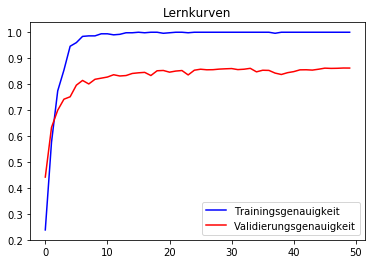

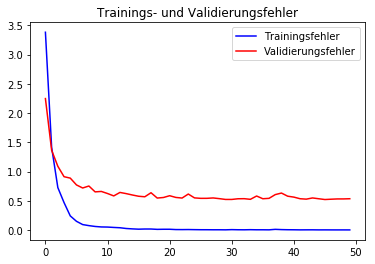

              precision    recall  f1-score   support

           0       0.42      0.17      0.24        60
           1       0.86      0.93      0.89       720
           2       0.94      0.89      0.92       750
           3       0.89      0.91      0.90       450
           4       0.82      0.90      0.86       660
           5       0.82      0.89      0.85       630
           6       0.97      0.57      0.72       150
           7       0.69      0.91      0.79       450
           8       0.85      0.65      0.73       450
           9       0.96      0.97      0.96       480
          10       0.96      0.91      0.94       660
          11       0.78      0.78      0.78       420
          12       0.99      0.95      0.97       690
          13       0.97      0.99      0.98       720
          14       1.00      0.97      0.98       270
          15       0.86      0.98      0.92       210
          16       0.94      0.94      0.94       150
          17       0.97    

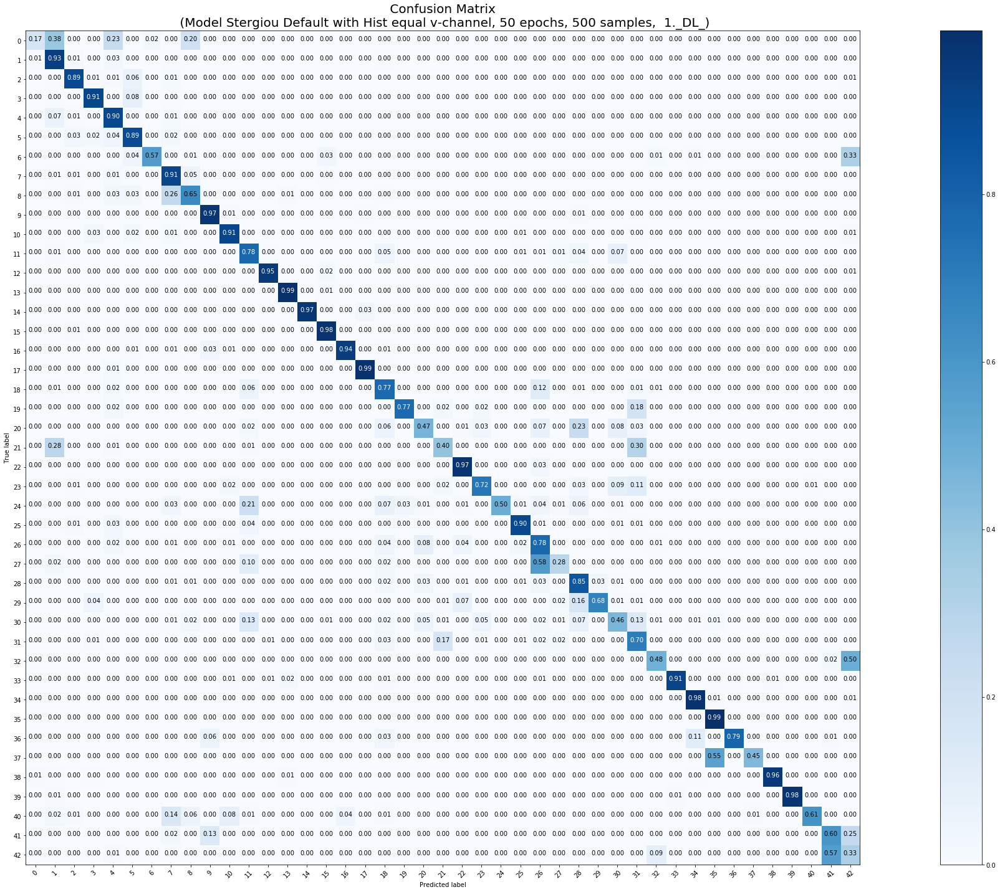

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 5s 9ms/step - loss: 3.1965 - acc: 0.2740 - val_loss: 2.2548 - val_acc: 0.4420
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.3836 - acc: 0.6280 - val_loss: 1.1740 - val_acc: 0.6451
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.7462 - acc: 0.7580 - val_loss: 0.8771 - val_acc: 0.7484
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4341 - acc: 0.8700 - val_loss: 1.0870 - val_acc: 0.6965
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2915 - acc: 0.9060 - val_loss: 0.8960 - val_acc: 0.7627
Epoch 6/50
500/500 [==============================] - 2s 4ms/step - loss: 0.1711 - acc: 0.9620 - val_loss: 0.6994 - val_acc: 0.8086
Epoch 7/50
500/500

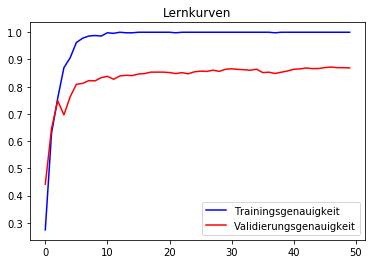

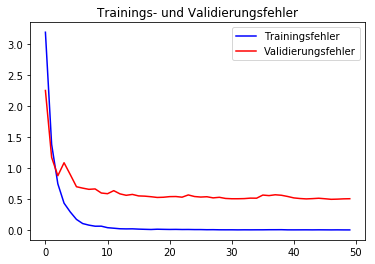

              precision    recall  f1-score   support

           0       0.60      0.20      0.30        60
           1       0.87      0.92      0.89       720
           2       0.93      0.91      0.92       750
           3       0.88      0.86      0.87       450
           4       0.82      0.91      0.86       660
           5       0.77      0.83      0.80       630
           6       0.76      0.63      0.69       150
           7       0.83      0.80      0.81       450
           8       0.78      0.79      0.78       450
           9       0.95      0.97      0.96       480
          10       0.97      0.92      0.95       660
          11       0.81      0.84      0.83       420
          12       0.97      0.98      0.98       690
          13       0.96      1.00      0.98       720
          14       1.00      0.98      0.99       270
          15       0.91      1.00      0.95       210
          16       0.99      0.93      0.96       150
          17       0.98    

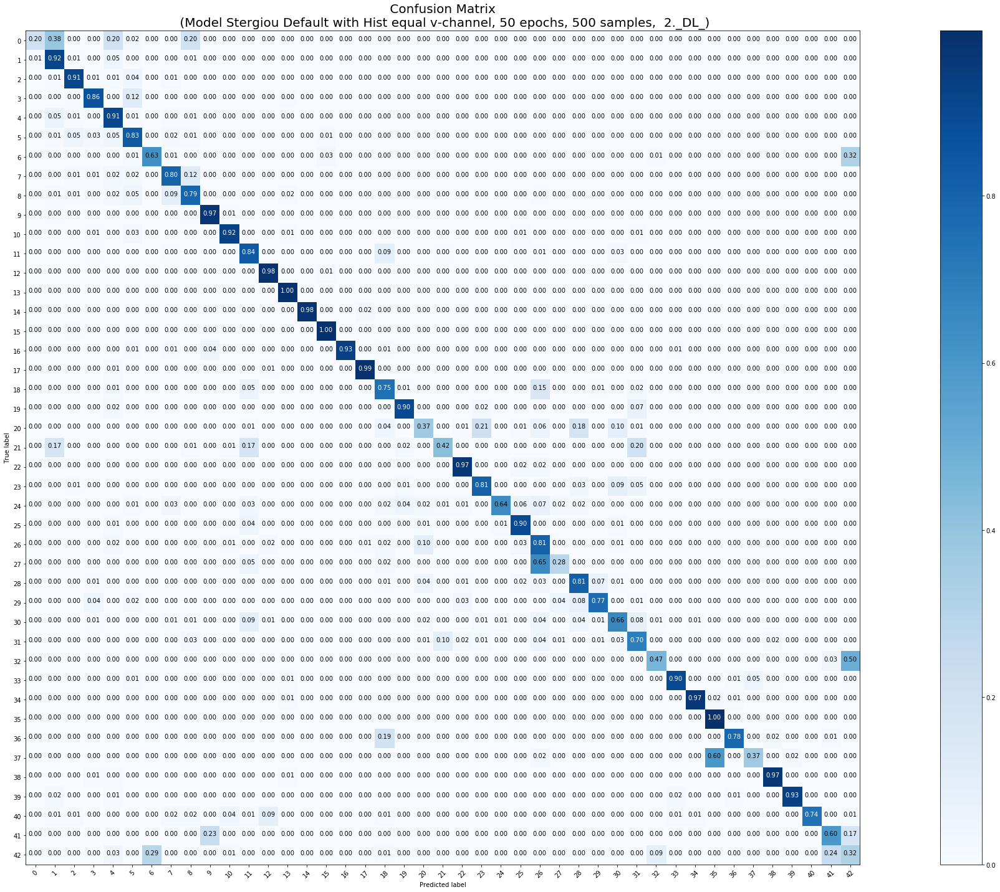

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 5s 10ms/step - loss: 3.3354 - acc: 0.2580 - val_loss: 2.3792 - val_acc: 0.4356
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.2993 - acc: 0.6360 - val_loss: 1.4514 - val_acc: 0.6293
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.7602 - acc: 0.7720 - val_loss: 0.9495 - val_acc: 0.7192
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.3490 - acc: 0.9000 - val_loss: 0.8264 - val_acc: 0.7641
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2492 - acc: 0.9400 - val_loss: 0.7526 - val_acc: 0.7945
Epoch 6/50
500/500 [==============================] - 2s 4ms/step - loss: 0.1293 - acc: 0.9680 - val_loss: 0.8207 - val_acc: 0.7802
Epoch 7/50
500/50

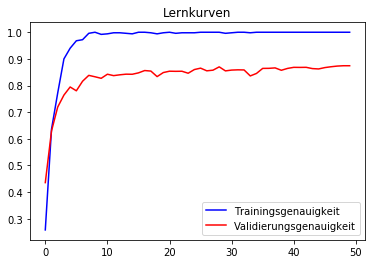

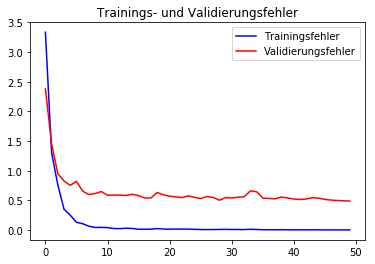

              precision    recall  f1-score   support

           0       0.47      0.30      0.37        60
           1       0.89      0.92      0.90       720
           2       0.93      0.94      0.93       750
           3       0.89      0.88      0.89       450
           4       0.86      0.93      0.89       660
           5       0.82      0.89      0.85       630
           6       0.70      0.59      0.64       150
           7       0.83      0.81      0.82       450
           8       0.79      0.81      0.80       450
           9       0.93      0.96      0.94       480
          10       0.94      0.92      0.93       660
          11       0.77      0.86      0.82       420
          12       0.97      0.97      0.97       690
          13       0.98      1.00      0.99       720
          14       1.00      0.97      0.99       270
          15       0.85      0.97      0.90       210
          16       0.91      0.90      0.90       150
          17       0.96    

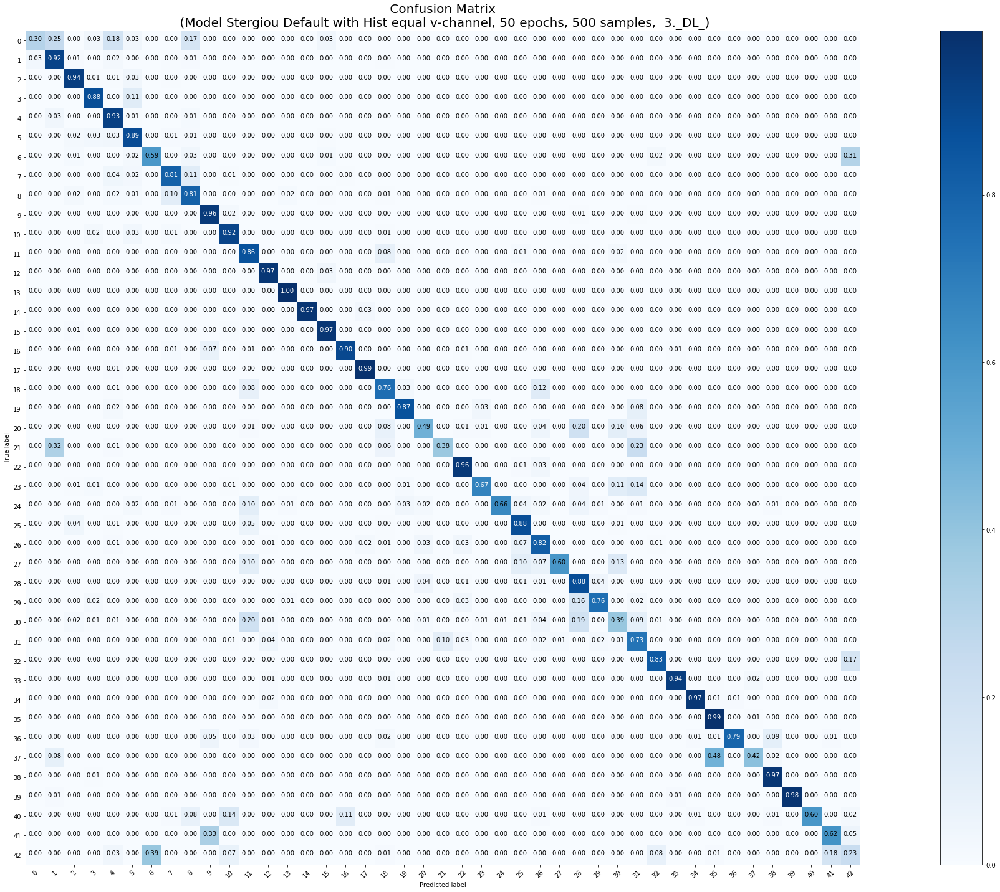

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 5s 11ms/step - loss: 3.3266 - acc: 0.2520 - val_loss: 2.3475 - val_acc: 0.4344
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.3888 - acc: 0.5820 - val_loss: 1.3580 - val_acc: 0.6226
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.6825 - acc: 0.7920 - val_loss: 1.1658 - val_acc: 0.6954
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4455 - acc: 0.8680 - val_loss: 0.9581 - val_acc: 0.7411
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2443 - acc: 0.9440 - val_loss: 0.7396 - val_acc: 0.7956
Epoch 6/50
500/500 [==============================] - 2s 4ms/step - loss: 0.1328 - acc: 0.9740 - val_loss: 0.6663 - val_acc: 0.8187
Epoch 7/50
500/50

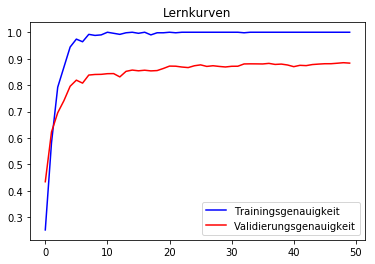

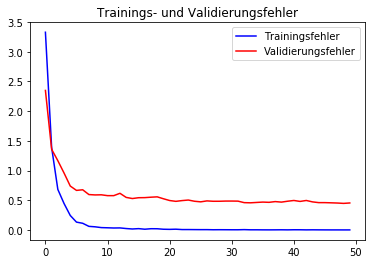

              precision    recall  f1-score   support

           0       0.55      0.43      0.49        60
           1       0.91      0.93      0.92       720
           2       0.95      0.93      0.94       750
           3       0.92      0.92      0.92       450
           4       0.84      0.93      0.89       660
           5       0.85      0.85      0.85       630
           6       0.95      0.63      0.76       150
           7       0.84      0.88      0.86       450
           8       0.83      0.87      0.85       450
           9       0.91      0.97      0.94       480
          10       0.96      0.93      0.94       660
          11       0.77      0.80      0.79       420
          12       0.97      0.98      0.98       690
          13       0.99      0.99      0.99       720
          14       1.00      0.99      1.00       270
          15       0.82      0.97      0.89       210
          16       0.95      0.93      0.94       150
          17       0.98    

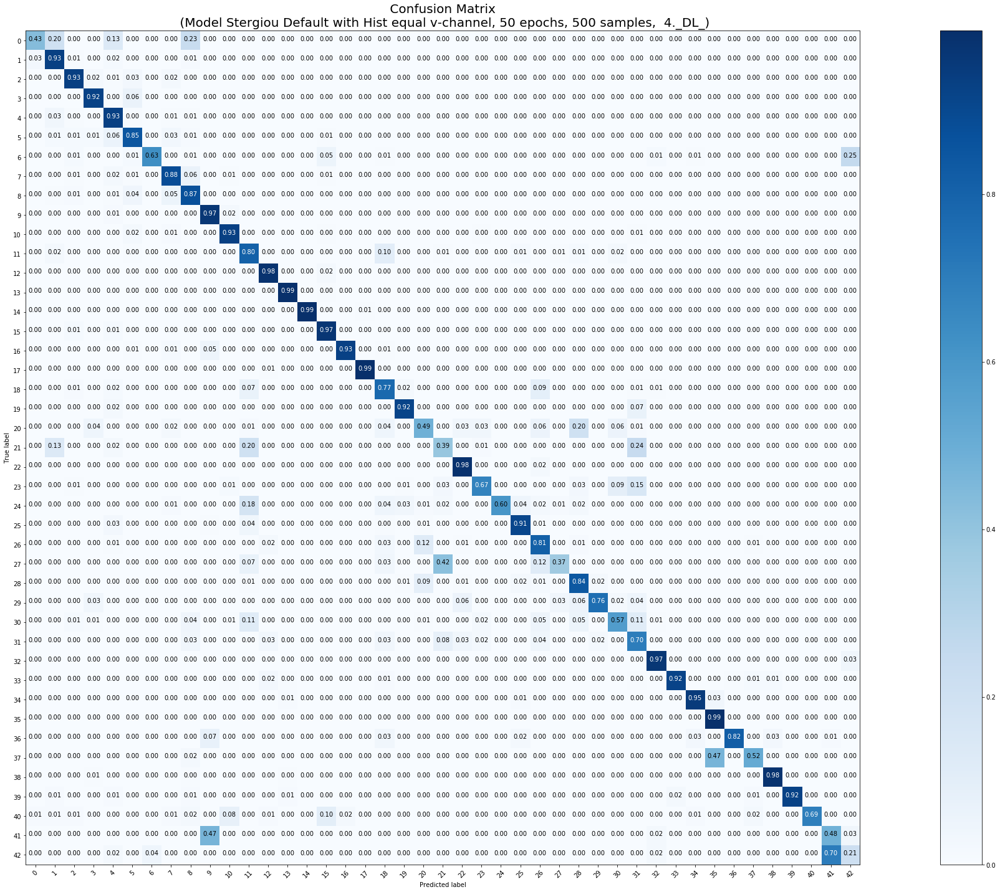

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 6s 12ms/step - loss: 3.4417 - acc: 0.2440 - val_loss: 2.5950 - val_acc: 0.3875
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.5228 - acc: 0.5600 - val_loss: 2.2479 - val_acc: 0.5331
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.8806 - acc: 0.7420 - val_loss: 1.1799 - val_acc: 0.7048
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4400 - acc: 0.8640 - val_loss: 0.8863 - val_acc: 0.7587
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2917 - acc: 0.9240 - val_loss: 0.7652 - val_acc: 0.7743
Epoch 6/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2051 - acc: 0.9460 - val_loss: 0.7850 - val_acc: 0.7744
Epoch 7/50
500/50

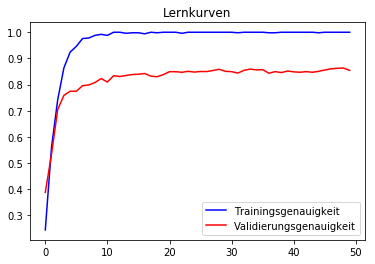

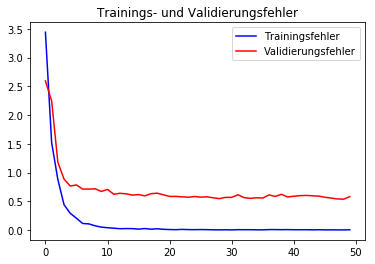

              precision    recall  f1-score   support

           0       0.45      0.28      0.35        60
           1       0.91      0.92      0.92       720
           2       0.81      0.95      0.88       750
           3       0.85      0.90      0.88       450
           4       0.88      0.91      0.89       660
           5       0.84      0.85      0.85       630
           6       0.63      0.67      0.65       150
           7       0.82      0.85      0.84       450
           8       0.82      0.76      0.79       450
           9       0.91      0.97      0.94       480
          10       0.98      0.88      0.92       660
          11       0.72      0.76      0.74       420
          12       0.97      0.98      0.98       690
          13       0.96      1.00      0.98       720
          14       1.00      0.98      0.99       270
          15       0.94      0.82      0.88       210
          16       0.92      0.89      0.90       150
          17       0.98    

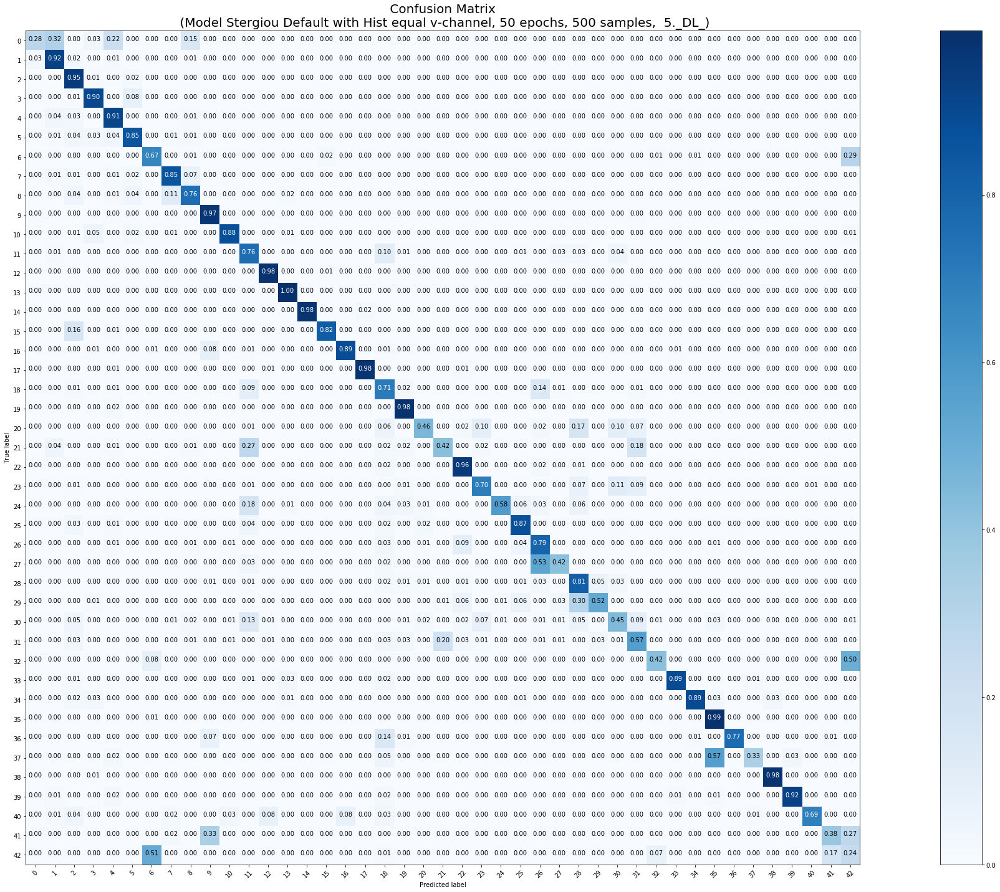

<Figure size 432x288 with 0 Axes>

In [0]:
### 500, A, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_500, y_tr_500, X_test, y_test, 50, 500)

In [0]:
downloader(500)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 20s 39ms/step - loss: 3.9997 - acc: 0.1200 - val_loss: 2.7822 - val_acc: 0.2804
Epoch 2/50
500/500 [==============================] - 3s 6ms/step - loss: 1.9620 - acc: 0.4600 - val_loss: 1.7130 - val_acc: 0.5250
Epoch 3/50
500/500 [==============================] - 3s 6ms/step - loss: 1.0745 - acc: 0.6440 - val_loss: 1.2517 - val_acc: 0.6395
Epoch 4/50
500/500 [==============================] - 3s 6ms/step - loss: 0.6734 - acc: 0.7640 - val_loss: 1.1784 - val_acc: 0.6749
Epoch 5/50
500/500 [==============================] - 3s 6ms/step - loss: 0.3873 - acc: 0.8680 - val_loss: 0.9096 - val_acc: 0.7414
Epoch 6/50
500/500 [==============================] -

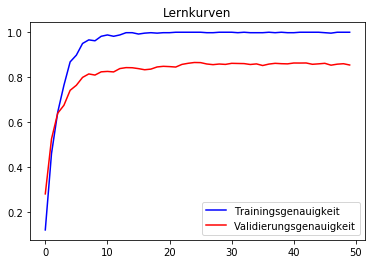

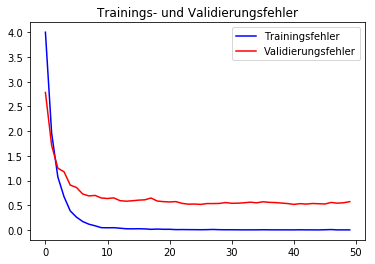

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.53      0.13      0.21        60
           1       0.92      0.85      0.89       720
           2       0.91      0.95      0.93       750
           3       0.83      0.92      0.87       450
           4       0.84      0.93      0.88       660
           5       0.83      0.82      0.82       630
           6       0.94      0.65      0.77       150
           7       0.73      0.87      0.79       450
           8       0.85      0.70      0.77       450
           9       0.92      0.96      0.94       480
          10       0.99      0.87      0.92       660
          11       0.82      0.70      0.76       420
          12       0.93      0.98      0.96       690
          13       0.98      0.99      0.98       720
          14       1.00      0.97      0.98       270
          15       0.77      0.99      0.87       210
          16       0.95      0.93      0.94   

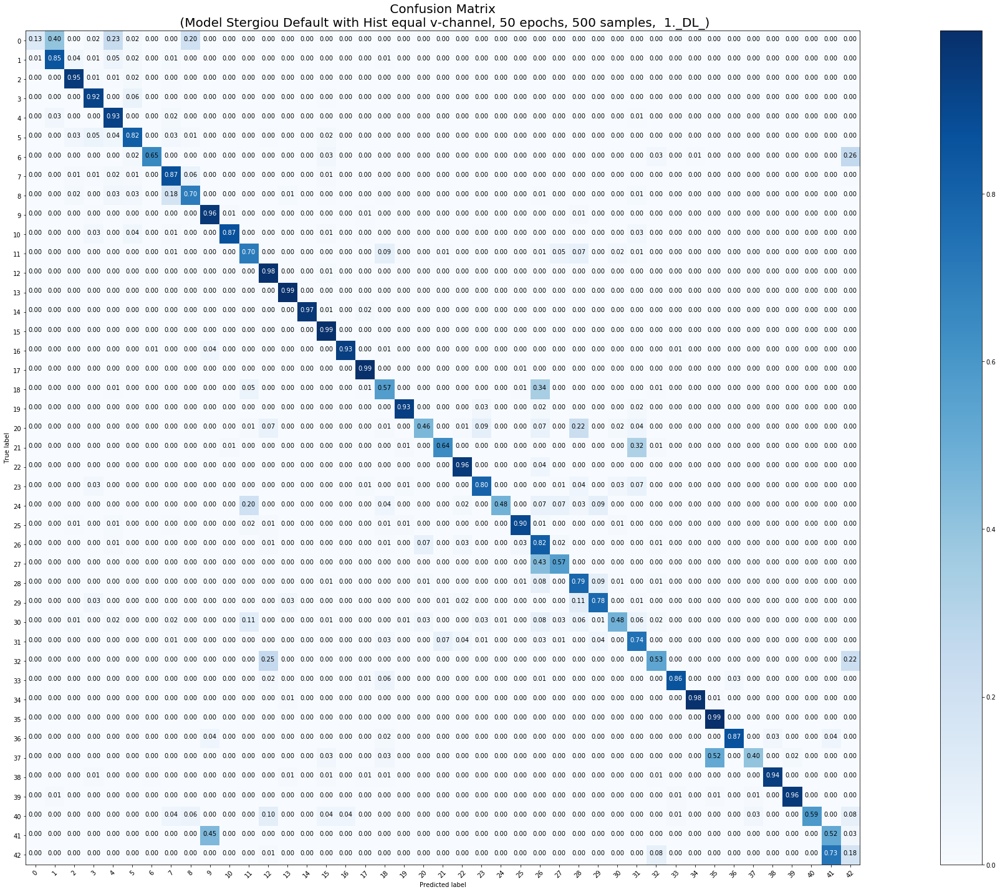

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 20s 40ms/step - loss: 4.1769 - acc: 0.1360 - val_loss: 2.9180 - val_acc: 0.2458
Epoch 2/50
500/500 [==============================] - 3s 6ms/step - loss: 2.0567 - acc: 0.3980 - val_loss: 2.1814 - val_acc: 0.4454
Epoch 3/50
500/500 [==============================] - 3s 6ms/step - loss: 1.2196 - acc: 0.6100 - val_loss: 1.3574 - val_acc: 0.6118
Epoch 4/50
500/500 [==============================] - 3s 6ms/step - loss: 0.7879 - acc: 0.7320 - val_loss: 1.2989 - val_acc: 0.6490
Epoch 5/50
500/500 [==============================] - 3s 6ms/step - loss: 0.4350 - acc: 0.8320 - val_loss: 1.0362 - val_acc: 0.7132
Epoch 6/50
500/500 [==============================] -

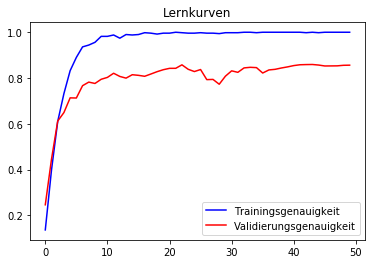

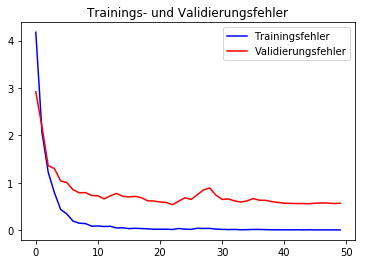

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.47      0.25      0.33        60
           1       0.86      0.91      0.88       720
           2       0.92      0.82      0.87       750
           3       0.89      0.90      0.90       450
           4       0.84      0.85      0.85       660
           5       0.76      0.85      0.81       630
           6       0.88      0.67      0.76       150
           7       0.85      0.83      0.84       450
           8       0.80      0.83      0.82       450
           9       0.97      0.96      0.96       480
          10       0.94      0.93      0.94       660
          11       0.77      0.76      0.76       420
          12       0.96      0.98      0.97       690
          13       0.99      0.99      0.99       720
          14       0.99      0.96      0.98       270
          15       0.83      0.98      0.90       210
          16       0.96      0.93      0.95   

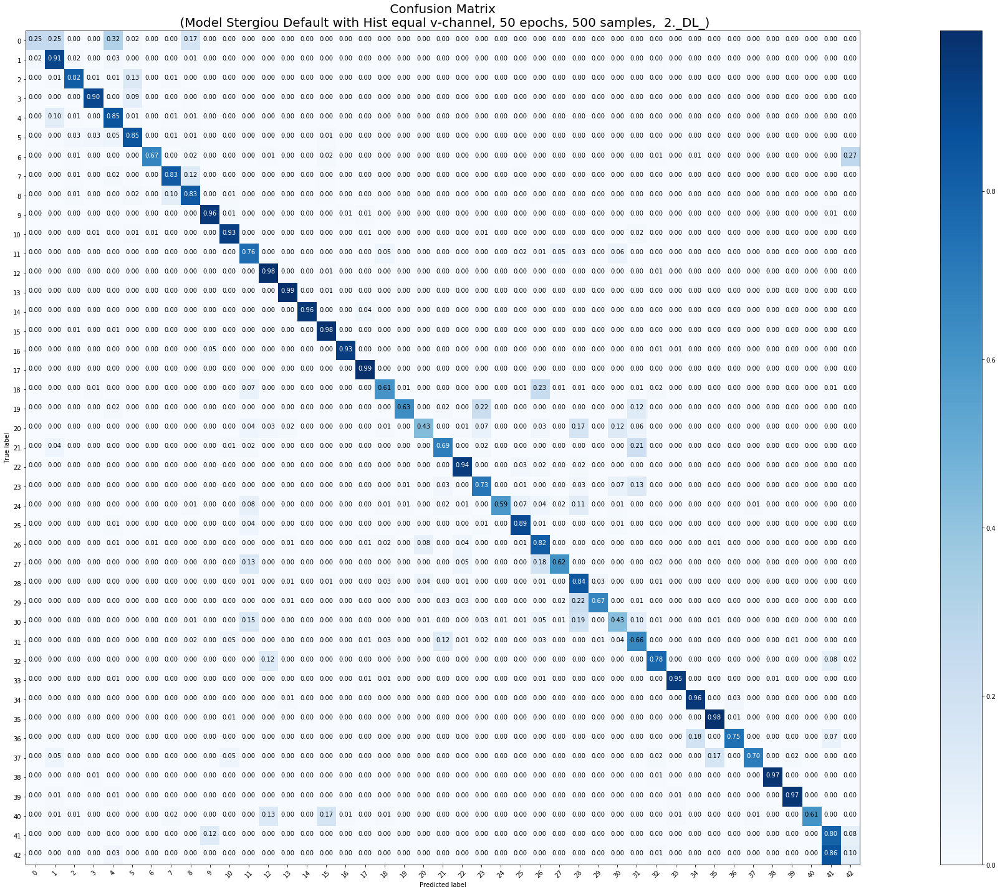

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 20s 40ms/step - loss: 3.9021 - acc: 0.1340 - val_loss: 2.9153 - val_acc: 0.2937
Epoch 2/50
500/500 [==============================] - 3s 6ms/step - loss: 2.2520 - acc: 0.4320 - val_loss: 2.0750 - val_acc: 0.4399
Epoch 3/50
500/500 [==============================] - 3s 6ms/step - loss: 1.2867 - acc: 0.5860 - val_loss: 1.6552 - val_acc: 0.5635
Epoch 4/50
500/500 [==============================] - 3s 6ms/step - loss: 0.7879 - acc: 0.7120 - val_loss: 1.1427 - val_acc: 0.6865
Epoch 5/50
500/500 [==============================] - 3s 6ms/step - loss: 0.4506 - acc: 0.8220 - val_loss: 1.0143 - val_acc: 0.7234
Epoch 6/50
500/500 [==============================] -

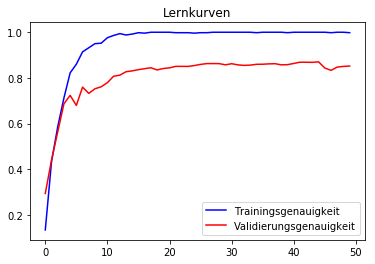

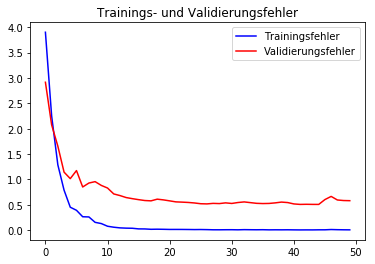

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.74      0.28      0.41        60
           1       0.80      0.96      0.87       720
           2       0.92      0.87      0.89       750
           3       0.94      0.83      0.88       450
           4       0.84      0.87      0.85       660
           5       0.81      0.81      0.81       630
           6       0.99      0.64      0.78       150
           7       0.67      0.93      0.78       450
           8       0.96      0.65      0.77       450
           9       0.92      0.96      0.94       480
          10       0.95      0.95      0.95       660
          11       0.72      0.68      0.70       420
          12       0.97      0.99      0.98       690
          13       0.99      0.98      0.99       720
          14       0.99      0.98      0.99       270
          15       0.85      0.97      0.91       210
          16       0.92      0.95      0.93   

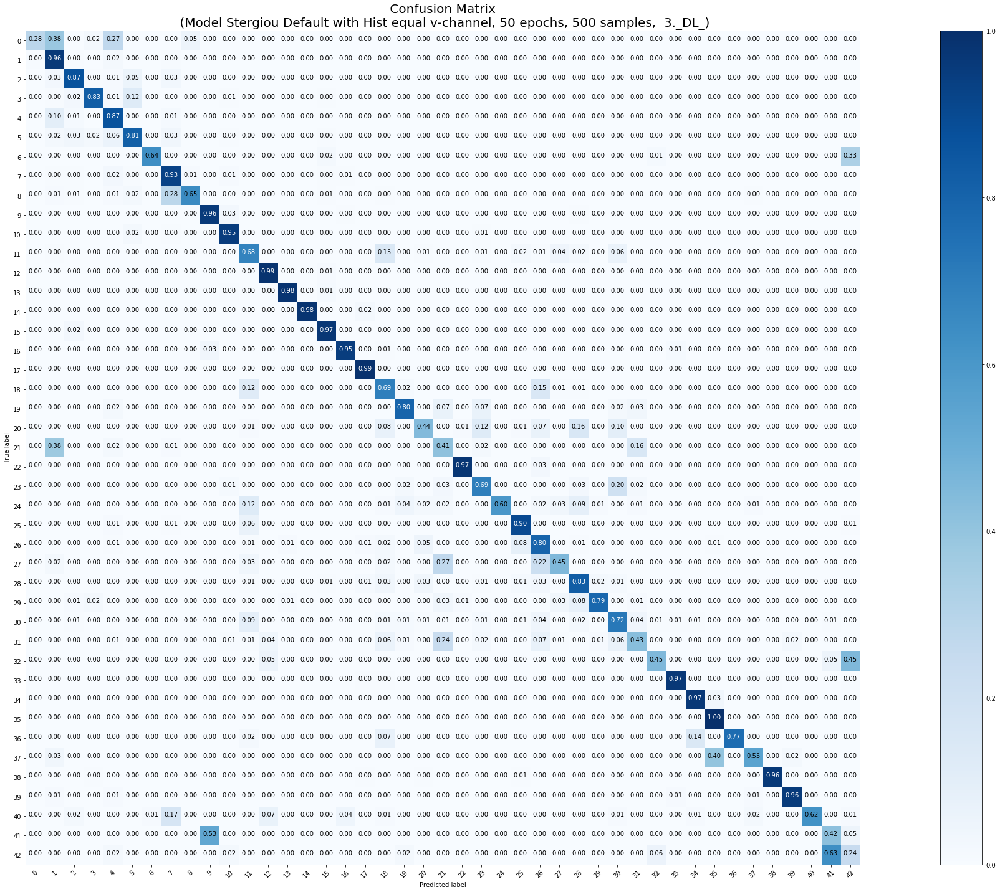

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 21s 41ms/step - loss: 4.1130 - acc: 0.1120 - val_loss: 3.0471 - val_acc: 0.2955
Epoch 2/50
500/500 [==============================] - 3s 6ms/step - loss: 2.1738 - acc: 0.4400 - val_loss: 1.9251 - val_acc: 0.4790
Epoch 3/50
500/500 [==============================] - 3s 6ms/step - loss: 1.1466 - acc: 0.6140 - val_loss: 1.2299 - val_acc: 0.6443
Epoch 4/50
500/500 [==============================] - 3s 6ms/step - loss: 0.6172 - acc: 0.7480 - val_loss: 1.2937 - val_acc: 0.6365
Epoch 5/50
500/500 [==============================] - 3s 6ms/step - loss: 0.4369 - acc: 0.8660 - val_loss: 1.1038 - val_acc: 0.6702
Epoch 6/50
500/500 [==============================] -

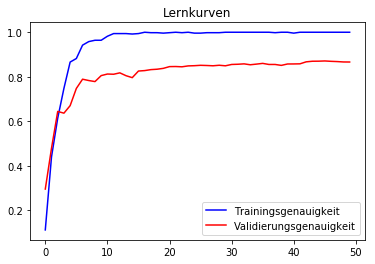

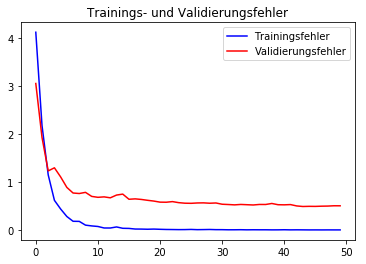

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.55      0.43      0.49        60
           1       0.93      0.85      0.89       720
           2       0.91      0.92      0.92       750
           3       0.85      0.92      0.88       450
           4       0.80      0.92      0.86       660
           5       0.82      0.85      0.83       630
           6       0.92      0.63      0.75       150
           7       0.85      0.82      0.84       450
           8       0.84      0.80      0.82       450
           9       0.94      0.97      0.95       480
          10       0.97      0.93      0.95       660
          11       0.76      0.71      0.73       420
          12       0.98      0.98      0.98       690
          13       0.97      0.99      0.98       720
          14       1.00      0.97      0.99       270
          15       0.90      0.99      0.94       210
          16       0.97      0.93      0.95   

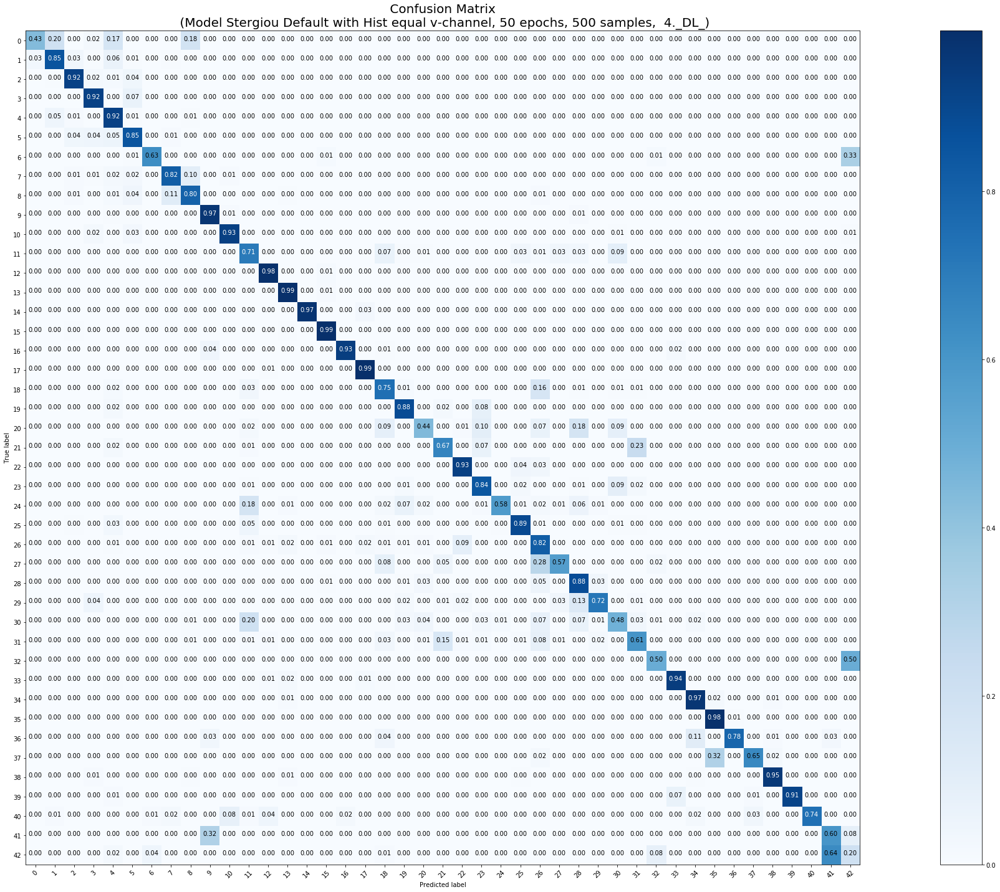

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 21s 42ms/step - loss: 4.0369 - acc: 0.1460 - val_loss: 2.6128 - val_acc: 0.3362
Epoch 2/50
500/500 [==============================] - 3s 6ms/step - loss: 1.8022 - acc: 0.4720 - val_loss: 1.7385 - val_acc: 0.5350
Epoch 3/50
500/500 [==============================] - 3s 6ms/step - loss: 1.0257 - acc: 0.6580 - val_loss: 1.4324 - val_acc: 0.6143
Epoch 4/50
500/500 [==============================] - 3s 6ms/step - loss: 0.7700 - acc: 0.7120 - val_loss: 1.8706 - val_acc: 0.5117
Epoch 5/50
500/500 [==============================] - 3s 6ms/step - loss: 0.4888 - acc: 0.8100 - val_loss: 1.4707 - val_acc: 0.6159
Epoch 6/50
500/500 [==============================] -

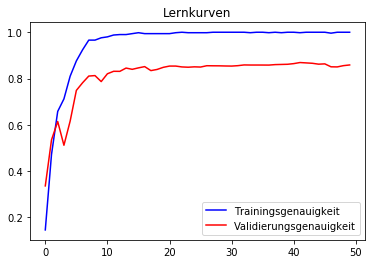

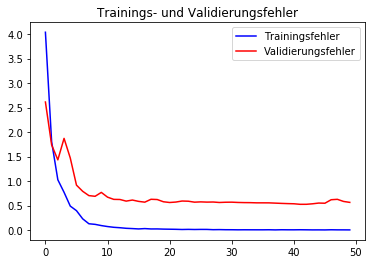

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.46      0.42      0.44        60
           1       0.87      0.91      0.89       720
           2       0.95      0.89      0.92       750
           3       0.82      0.94      0.88       450
           4       0.84      0.89      0.87       660
           5       0.85      0.87      0.86       630
           6       0.87      0.61      0.71       150
           7       0.72      0.89      0.79       450
           8       0.87      0.62      0.73       450
           9       0.94      0.97      0.95       480
          10       0.98      0.94      0.96       660
          11       0.74      0.83      0.78       420
          12       0.97      0.96      0.97       690
          13       0.99      0.99      0.99       720
          14       1.00      1.00      1.00       270
          15       0.79      0.99      0.88       210
          16       0.94      0.93      0.94   

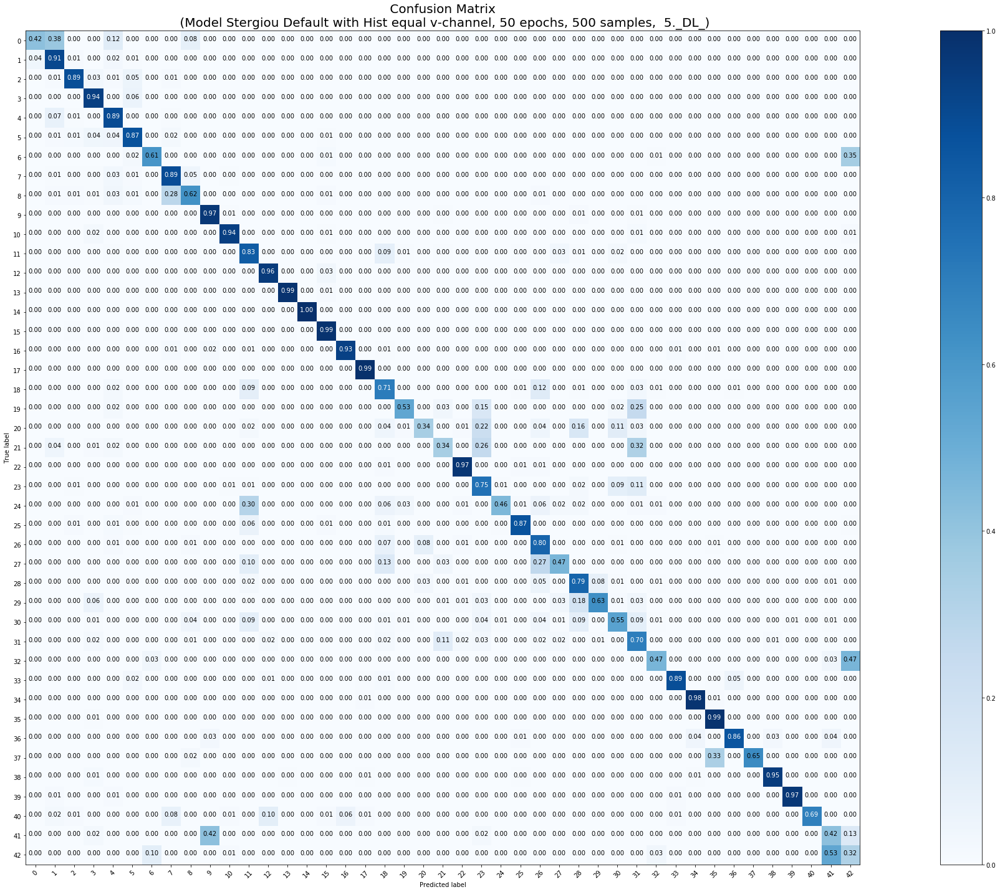

<Figure size 432x288 with 0 Axes>

In [0]:
### 500, A, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_500, y_tr_500, X_test, y_test, 50, 500)

In [0]:
downloaderCW(500)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 7s 7ms/step - loss: 2.4728 - acc: 0.4020 - val_loss: 1.5488 - val_acc: 0.5966
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.8935 - acc: 0.7300 - val_loss: 0.9892 - val_acc: 0.7215
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.4369 - acc: 0.8690 - val_loss: 0.8541 - val_acc: 0.7489
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2423 - acc: 0.9350 - val_loss: 0.4803 - val_acc: 0.8607
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1546 - acc: 0.9560 - val_loss: 0.4571 - val_acc: 0.8658
Epoch 6/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1241 - acc: 0.9680 - val_loss: 0.4

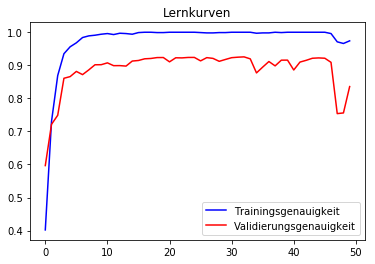

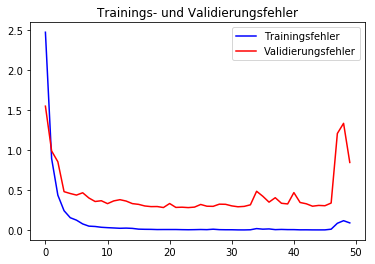

              precision    recall  f1-score   support

           0       1.00      0.48      0.65        60
           1       0.56      0.97      0.71       720
           2       0.84      0.94      0.89       750
           3       0.95      0.86      0.90       450
           4       0.98      0.82      0.89       660
           5       0.94      0.57      0.71       630
           6       0.71      0.78      0.74       150
           7       0.96      0.66      0.79       450
           8       0.78      0.94      0.86       450
           9       0.87      0.98      0.92       480
          10       0.99      0.90      0.94       660
          11       0.93      0.49      0.64       420
          12       0.99      0.93      0.96       690
          13       0.99      0.99      0.99       720
          14       0.99      0.93      0.96       270
          15       0.84      0.98      0.90       210
          16       1.00      0.89      0.94       150
          17       0.94    

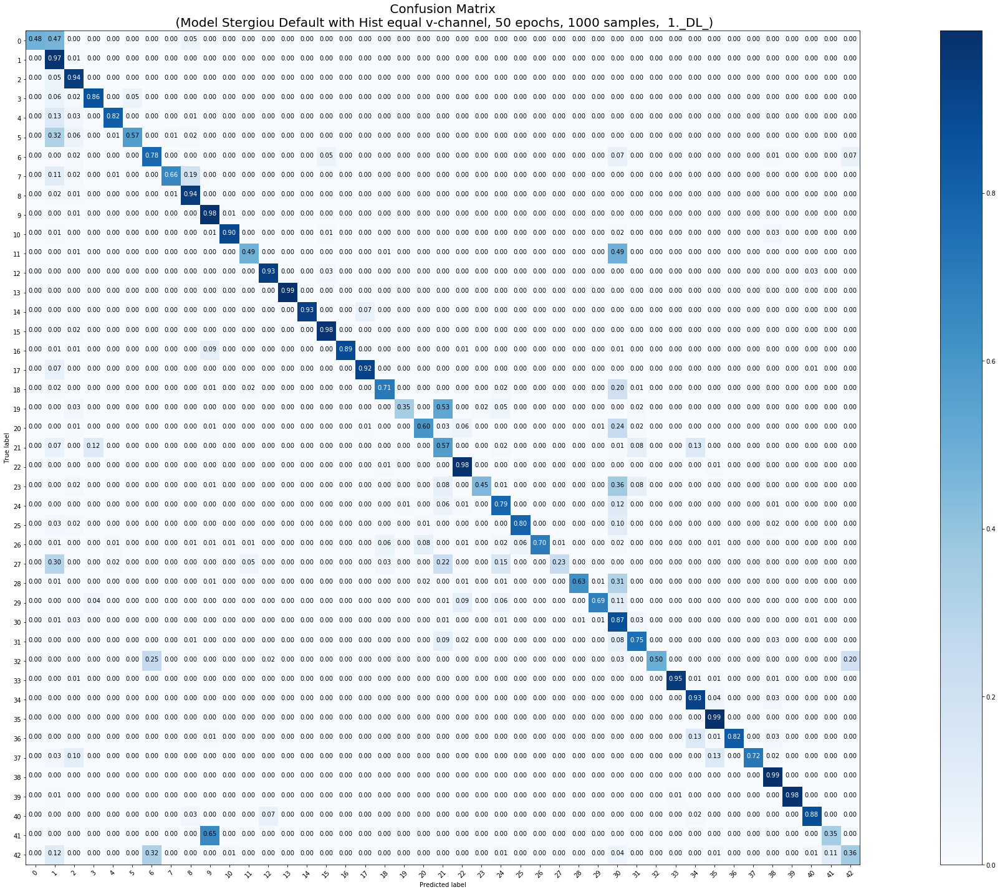

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 7s 7ms/step - loss: 2.3826 - acc: 0.4200 - val_loss: 1.6655 - val_acc: 0.5850
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.8387 - acc: 0.7570 - val_loss: 0.8438 - val_acc: 0.7816
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.3656 - acc: 0.8990 - val_loss: 0.7165 - val_acc: 0.7998
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2469 - acc: 0.9290 - val_loss: 0.4537 - val_acc: 0.8679
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1718 - acc: 0.9540 - val_loss: 0.4111 - val_acc: 0.8857
Epoch 6/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1167 - acc: 0.9660 - val_loss: 0.4

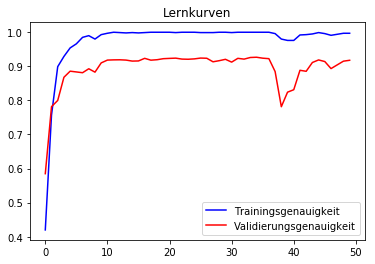

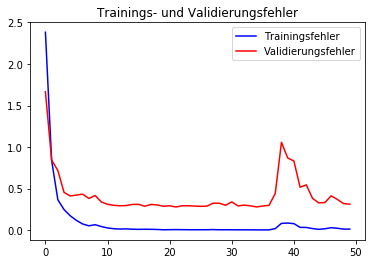

              precision    recall  f1-score   support

           0       1.00      0.33      0.50        60
           1       0.97      0.93      0.95       720
           2       0.89      0.99      0.94       750
           3       0.93      0.93      0.93       450
           4       0.90      0.96      0.93       660
           5       0.91      0.92      0.91       630
           6       0.99      0.61      0.75       150
           7       0.91      0.90      0.91       450
           8       0.94      0.88      0.91       450
           9       0.93      0.98      0.95       480
          10       0.95      0.96      0.96       660
          11       0.81      0.82      0.82       420
          12       0.98      1.00      0.99       690
          13       0.97      1.00      0.98       720
          14       1.00      0.99      0.99       270
          15       0.88      1.00      0.93       210
          16       0.94      0.94      0.94       150
          17       0.99    

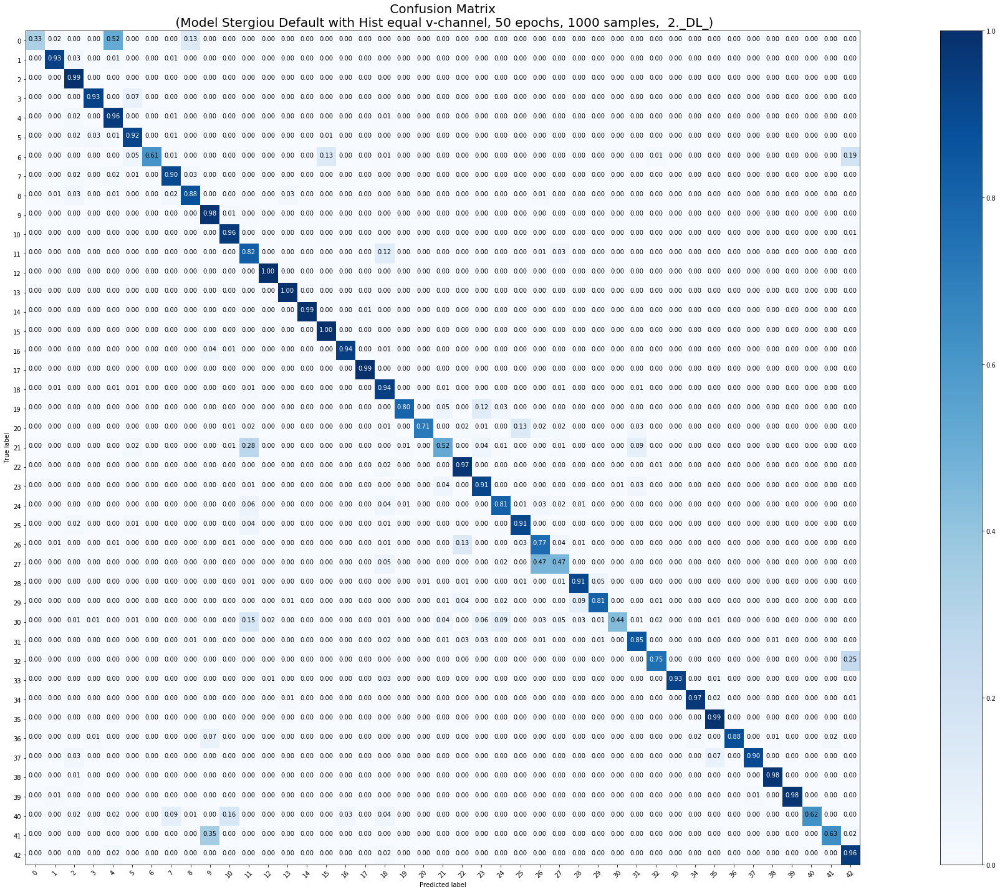

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 7s 7ms/step - loss: 2.5825 - acc: 0.4030 - val_loss: 1.6753 - val_acc: 0.5692
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.9950 - acc: 0.7040 - val_loss: 0.9290 - val_acc: 0.7241
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.5030 - acc: 0.8550 - val_loss: 0.7052 - val_acc: 0.8088
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2802 - acc: 0.9110 - val_loss: 0.6236 - val_acc: 0.8117
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2029 - acc: 0.9390 - val_loss: 0.6261 - val_acc: 0.8327
Epoch 6/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1246 - acc: 0.9690 - val_loss: 0.4

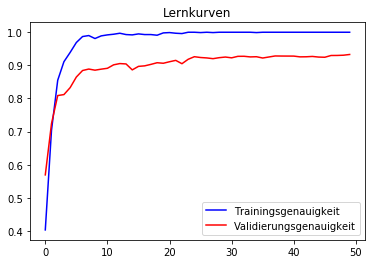

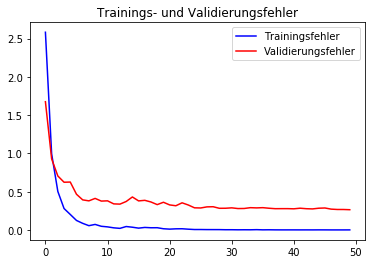

              precision    recall  f1-score   support

           0       0.80      0.92      0.85        60
           1       0.94      0.95      0.94       720
           2       0.96      0.98      0.97       750
           3       0.92      0.91      0.92       450
           4       0.94      0.96      0.95       660
           5       0.92      0.92      0.92       630
           6       0.97      0.61      0.75       150
           7       0.95      0.93      0.94       450
           8       0.95      0.92      0.93       450
           9       0.93      0.98      0.96       480
          10       0.95      0.97      0.96       660
          11       0.83      0.91      0.87       420
          12       1.00      0.98      0.99       690
          13       0.97      1.00      0.98       720
          14       0.99      1.00      0.99       270
          15       0.90      1.00      0.94       210
          16       0.93      0.95      0.94       150
          17       0.99    

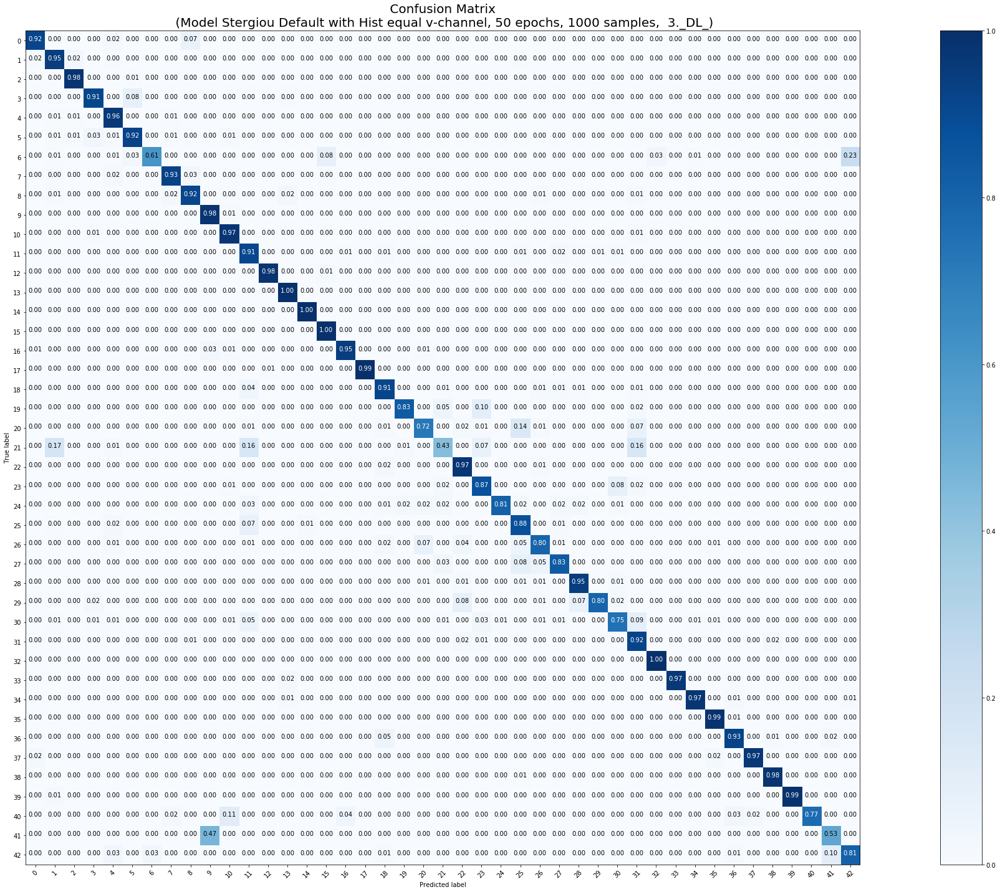

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 8s 8ms/step - loss: 2.6760 - acc: 0.3770 - val_loss: 1.2361 - val_acc: 0.6392
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.9638 - acc: 0.7140 - val_loss: 0.9182 - val_acc: 0.7440
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.4984 - acc: 0.8410 - val_loss: 0.6641 - val_acc: 0.8013
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2935 - acc: 0.9120 - val_loss: 0.5770 - val_acc: 0.8403
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1858 - acc: 0.9440 - val_loss: 0.4779 - val_acc: 0.8611
Epoch 6/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1173 - acc: 0.9730 - val_loss: 0.4

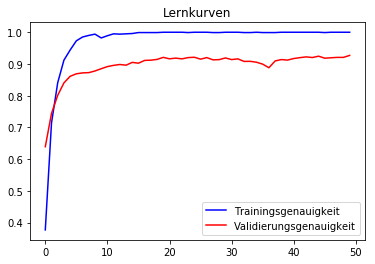

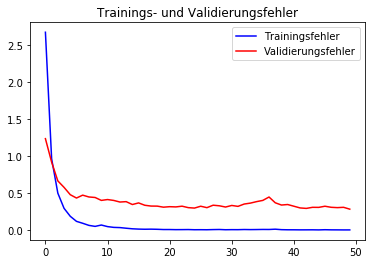

              precision    recall  f1-score   support

           0       0.88      0.48      0.62        60
           1       0.94      0.96      0.95       720
           2       0.91      0.98      0.95       750
           3       0.97      0.91      0.94       450
           4       0.92      0.97      0.95       660
           5       0.91      0.92      0.92       630
           6       0.94      0.67      0.79       150
           7       0.94      0.90      0.92       450
           8       0.92      0.93      0.93       450
           9       0.94      0.97      0.95       480
          10       0.96      0.98      0.97       660
          11       0.86      0.86      0.86       420
          12       1.00      0.98      0.99       690
          13       0.96      1.00      0.98       720
          14       1.00      0.96      0.98       270
          15       0.89      1.00      0.94       210
          16       0.94      0.95      0.94       150
          17       0.95    

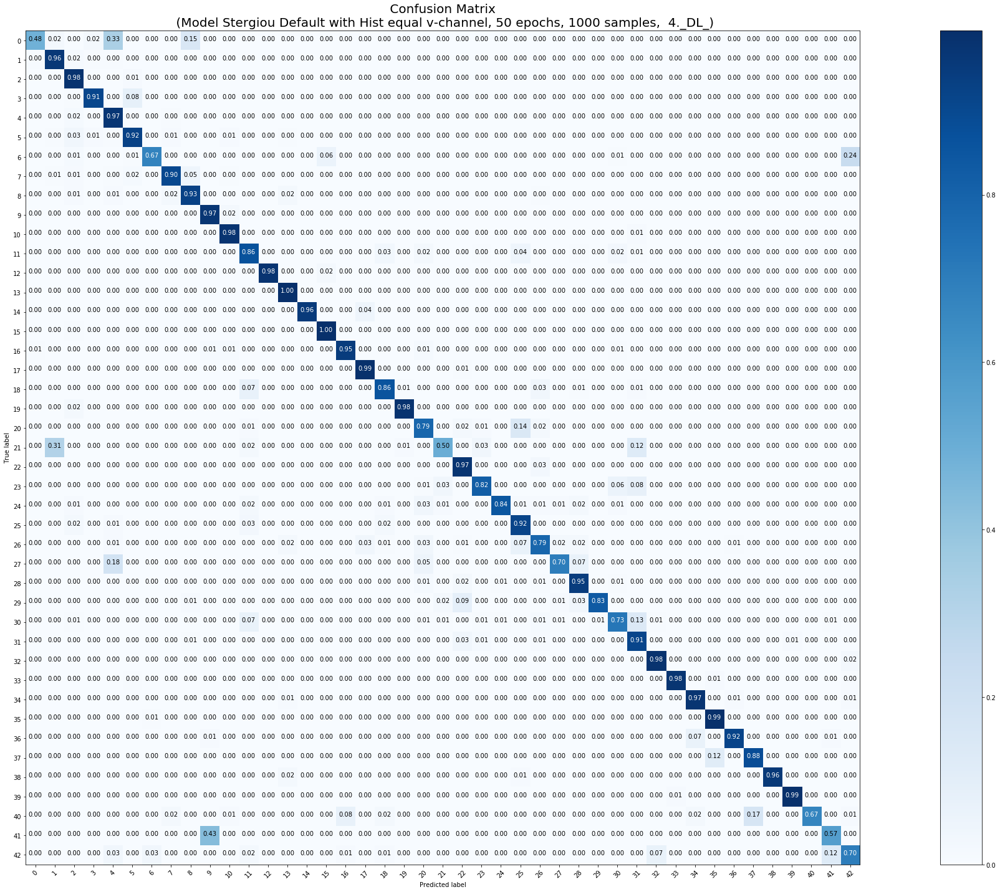

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 8s 8ms/step - loss: 2.4977 - acc: 0.4220 - val_loss: 1.3104 - val_acc: 0.6496
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.8912 - acc: 0.7300 - val_loss: 0.8686 - val_acc: 0.7551
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.4053 - acc: 0.8850 - val_loss: 0.6246 - val_acc: 0.8204
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2533 - acc: 0.9290 - val_loss: 0.6054 - val_acc: 0.8382
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1816 - acc: 0.9510 - val_loss: 0.5257 - val_acc: 0.8576
Epoch 6/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1110 - acc: 0.9740 - val_loss: 0.4

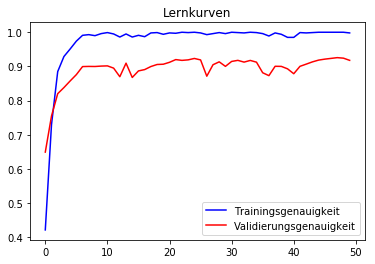

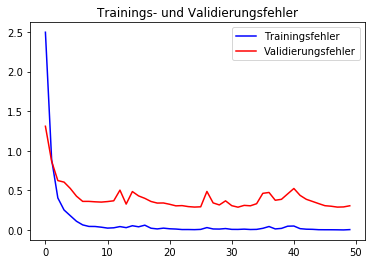

              precision    recall  f1-score   support

           0       0.96      0.90      0.93        60
           1       0.94      0.96      0.95       720
           2       0.92      0.98      0.95       750
           3       0.86      0.96      0.91       450
           4       0.94      0.96      0.95       660
           5       0.96      0.81      0.88       630
           6       0.99      0.65      0.78       150
           7       0.97      0.80      0.88       450
           8       0.83      0.92      0.88       450
           9       0.96      0.98      0.97       480
          10       0.97      0.98      0.97       660
          11       0.87      0.79      0.83       420
          12       0.98      0.99      0.98       690
          13       0.96      1.00      0.98       720
          14       1.00      0.99      1.00       270
          15       0.89      1.00      0.94       210
          16       0.99      0.96      0.97       150
          17       0.98    

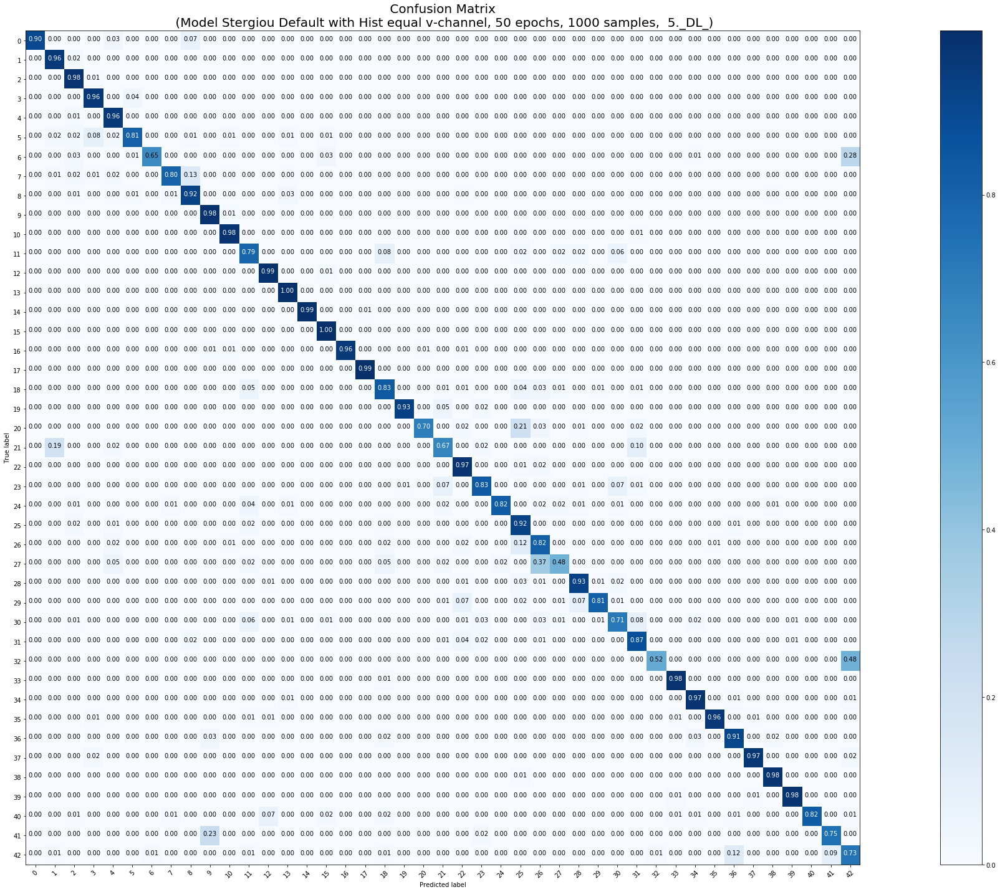

<Figure size 432x288 with 0 Axes>

In [0]:
### 1000, A, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_1000, y_tr_1000, X_test, y_test, 50, 1000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 23s 23ms/step - loss: 3.3212 - acc: 0.2290 - val_loss: 1.8968 - val_acc: 0.5226
Epoch 2/50
1000/1000 [==============================] - 4s 4ms/step - loss: 1.4368 - acc: 0.5590 - val_loss: 1.2244 - val_acc: 0.6673
Epoch 3/50
1000/1000 [==============================] - 4s 4ms/step - loss: 0.7726 - acc: 0.7570 - val_loss: 0.8431 - val_acc: 0.7468
Epoch 4/50
1000/1000 [==============================] - 4s 4ms/step - loss: 0.3955 - acc: 0.8580 - val_loss: 0.6038 - val_acc: 0.8265
Epoch 5/50
1000/1000 [==============================] - 4s 4ms/step - loss: 0.2487 - acc: 0.9050 - val_loss: 0.5322 - val_acc: 0.8487
Epoch 6/50
1000/1000 [===================

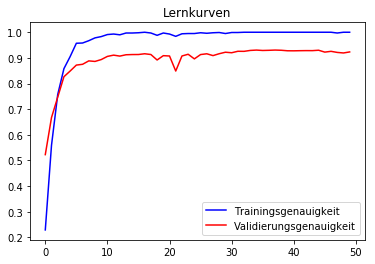

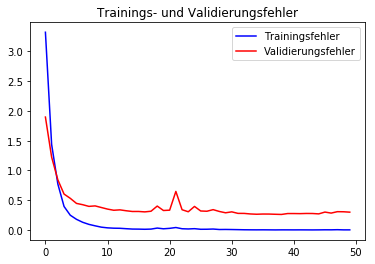

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.88      0.48      0.62        60
           1       0.96      0.94      0.95       720
           2       0.91      0.99      0.95       750
           3       0.95      0.94      0.94       450
           4       0.88      0.97      0.93       660
           5       0.92      0.87      0.90       630
           6       1.00      0.63      0.77       150
           7       0.96      0.89      0.92       450
           8       0.92      0.92      0.92       450
           9       0.92      0.98      0.95       480
          10       0.96      0.97      0.97       660
          11       0.94      0.82      0.88       420
          12       0.99      0.98      0.99       690
          13       0.98      0.99      0.99       720
          14       1.00      0.99      0.99       270
          15       0.87      1.00      0.93       210
          16       0.90      0.94      0.92   

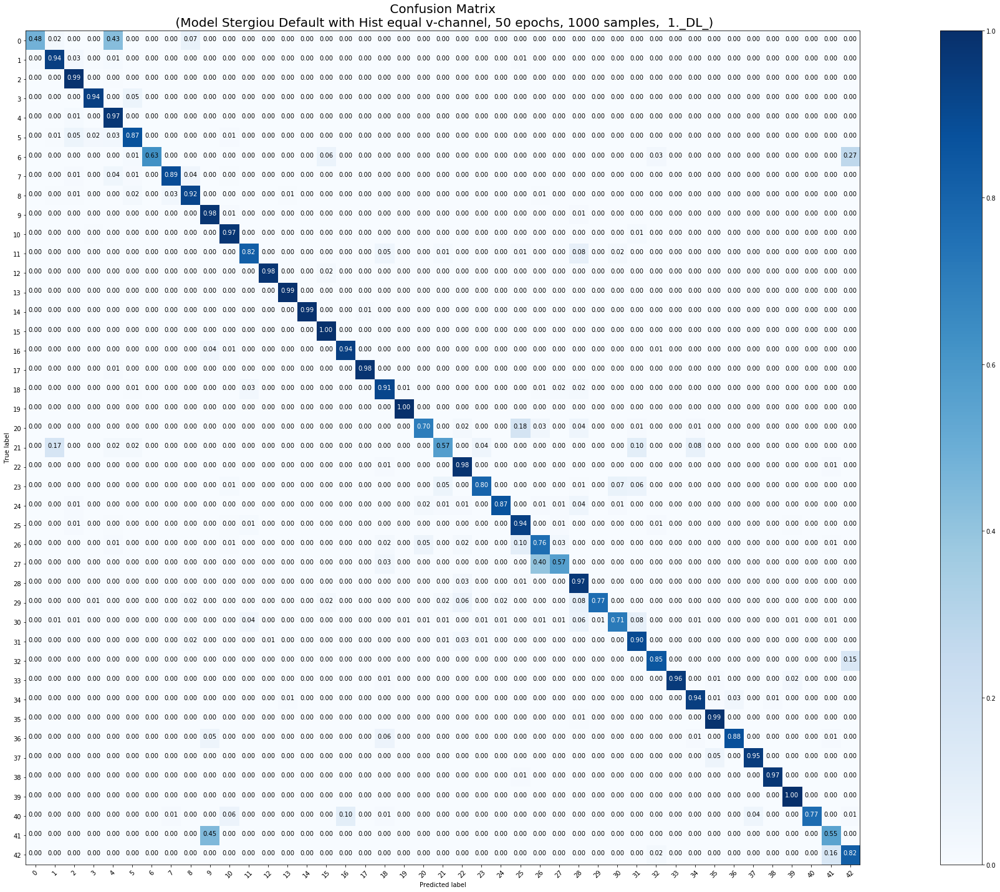

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 22s 22ms/step - loss: 3.2527 - acc: 0.2700 - val_loss: 2.6708 - val_acc: 0.3976
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.5175 - acc: 0.5620 - val_loss: 1.5564 - val_acc: 0.5561
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.8211 - acc: 0.7370 - val_loss: 0.8345 - val_acc: 0.7644
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.4121 - acc: 0.8570 - val_loss: 0.7098 - val_acc: 0.7945
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.3877 - acc: 0.8680 - val_loss: 0.5883 - val_acc: 0.8241
Epoch 6/50
1000/1000 [===================

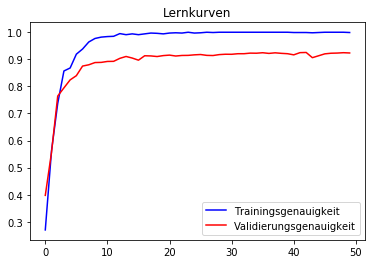

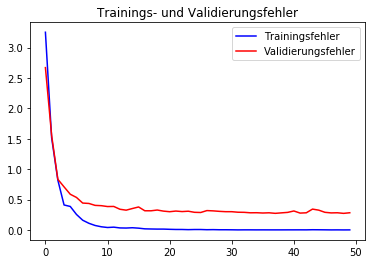

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.88      0.83      0.85        60
           1       0.97      0.91      0.94       720
           2       0.91      0.98      0.94       750
           3       0.90      0.92      0.91       450
           4       0.97      0.97      0.97       660
           5       0.91      0.90      0.91       630
           6       0.98      0.65      0.78       150
           7       0.95      0.87      0.91       450
           8       0.87      0.93      0.90       450
           9       0.93      0.97      0.95       480
          10       0.96      0.98      0.97       660
          11       0.86      0.86      0.86       420
          12       0.98      0.98      0.98       690
          13       0.98      0.99      0.99       720
          14       1.00      0.99      0.99       270
          15       0.88      1.00      0.94       210
          16       0.95      0.95      0.95   

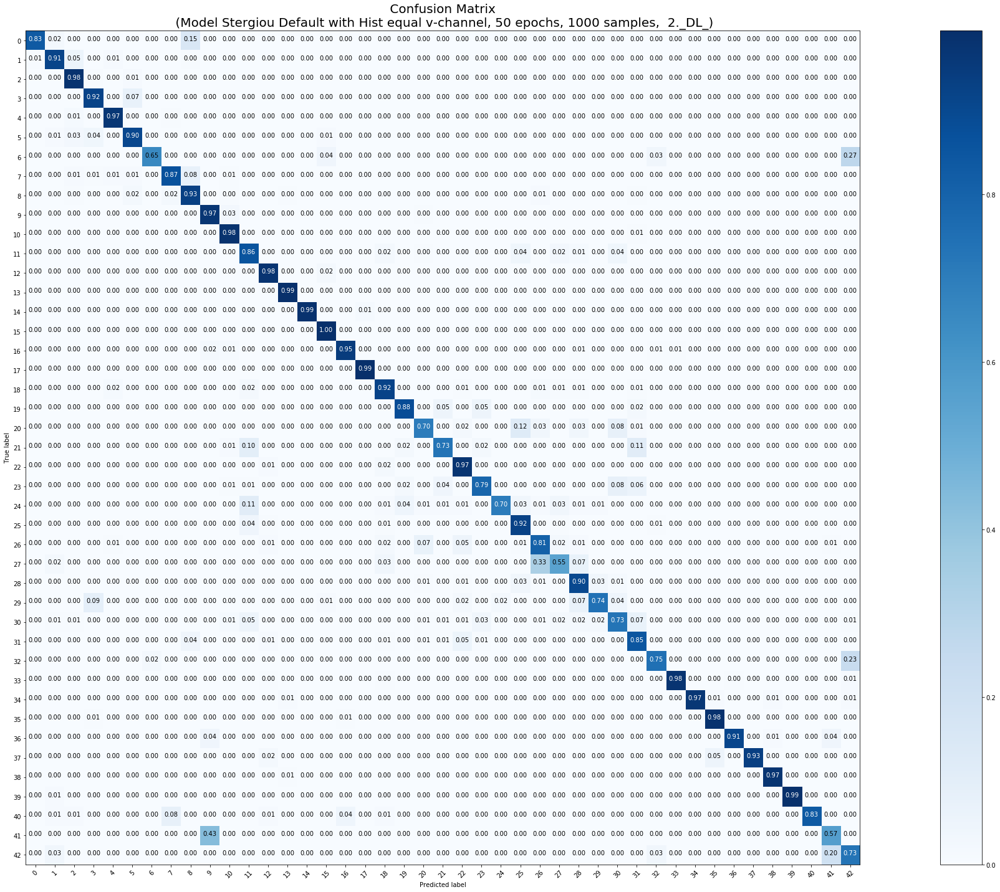

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 23s 23ms/step - loss: 3.4057 - acc: 0.2300 - val_loss: 2.1527 - val_acc: 0.4286
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.5881 - acc: 0.5440 - val_loss: 1.3042 - val_acc: 0.6033
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.8007 - acc: 0.7210 - val_loss: 1.4033 - val_acc: 0.5859
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.4298 - acc: 0.8370 - val_loss: 0.6708 - val_acc: 0.8066
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.2828 - acc: 0.9050 - val_loss: 0.6060 - val_acc: 0.8323
Epoch 6/50
1000/1000 [===================

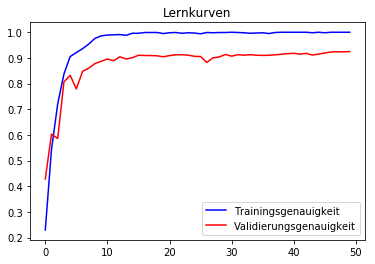

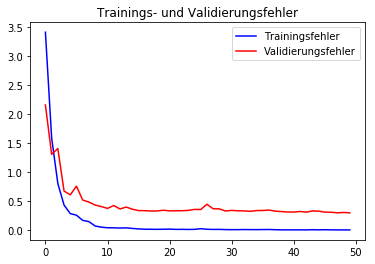

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.90      0.58      0.71        60
           1       0.98      0.93      0.95       720
           2       0.93      0.98      0.95       750
           3       0.94      0.93      0.94       450
           4       0.95      0.95      0.95       660
           5       0.92      0.94      0.93       630
           6       0.99      0.61      0.75       150
           7       0.94      0.89      0.91       450
           8       0.88      0.92      0.90       450
           9       0.93      0.97      0.95       480
          10       0.95      0.98      0.97       660
          11       0.89      0.75      0.81       420
          12       0.98      0.98      0.98       690
          13       0.98      0.99      0.99       720
          14       1.00      0.99      0.99       270
          15       0.93      0.99      0.96       210
          16       0.95      0.95      0.95   

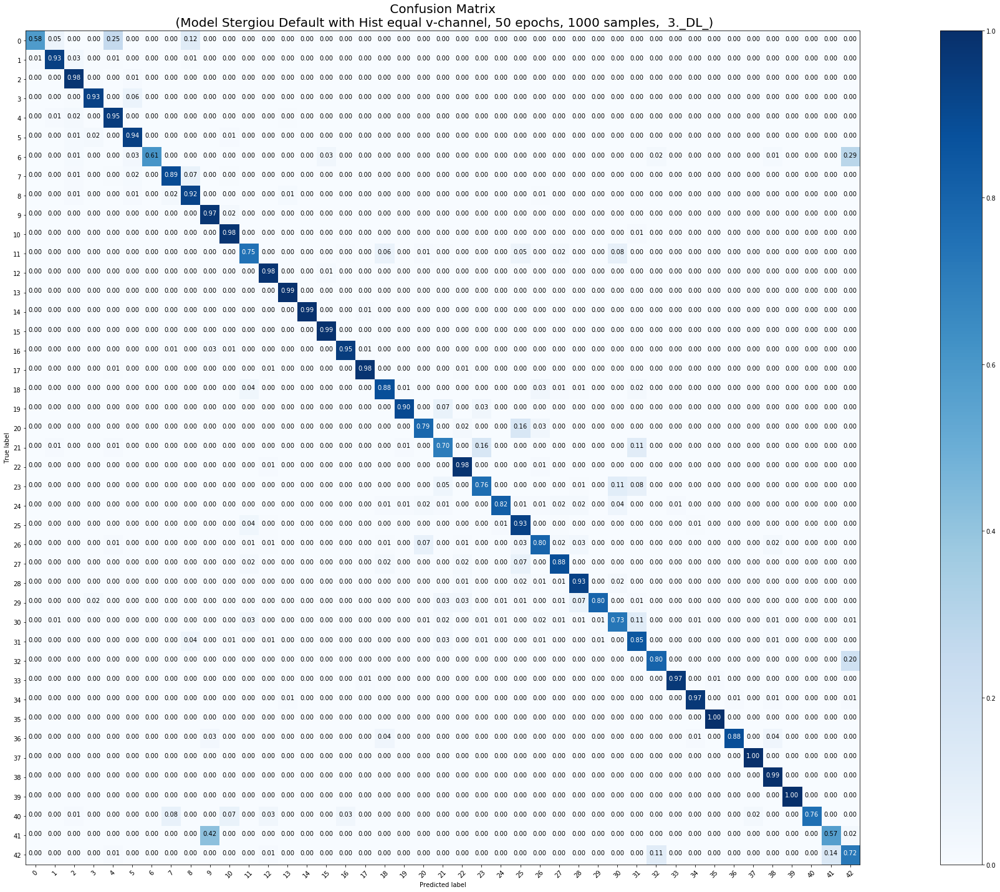

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 23s 23ms/step - loss: 3.2112 - acc: 0.2810 - val_loss: 1.8608 - val_acc: 0.4828
Epoch 2/50
1000/1000 [==============================] - 4s 4ms/step - loss: 1.3053 - acc: 0.5940 - val_loss: 0.9380 - val_acc: 0.7124
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.5701 - acc: 0.7950 - val_loss: 0.7462 - val_acc: 0.7817
Epoch 4/50
1000/1000 [==============================] - 4s 4ms/step - loss: 0.4026 - acc: 0.8430 - val_loss: 0.6118 - val_acc: 0.8241
Epoch 5/50
1000/1000 [==============================] - 4s 4ms/step - loss: 0.2614 - acc: 0.9240 - val_loss: 0.4997 - val_acc: 0.8596
Epoch 6/50
1000/1000 [===================

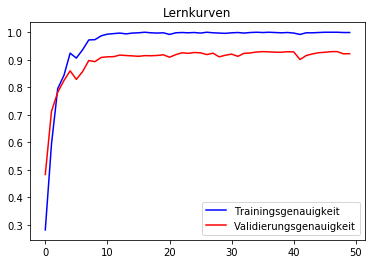

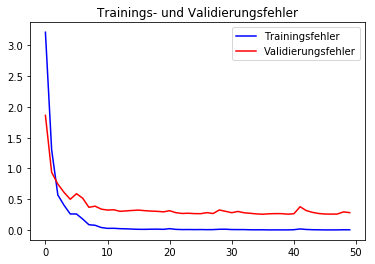

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.72      0.98      0.83        60
           1       0.98      0.90      0.94       720
           2       0.91      0.99      0.95       750
           3       0.91      0.90      0.91       450
           4       0.97      0.98      0.97       660
           5       0.89      0.93      0.91       630
           6       1.00      0.61      0.76       150
           7       0.93      0.87      0.90       450
           8       0.91      0.89      0.90       450
           9       0.95      0.97      0.96       480
          10       0.94      0.96      0.95       660
          11       0.91      0.80      0.85       420
          12       0.97      0.99      0.98       690
          13       0.96      0.99      0.98       720
          14       1.00      0.99      1.00       270
          15       0.93      1.00      0.96       210
          16       0.95      0.95      0.95   

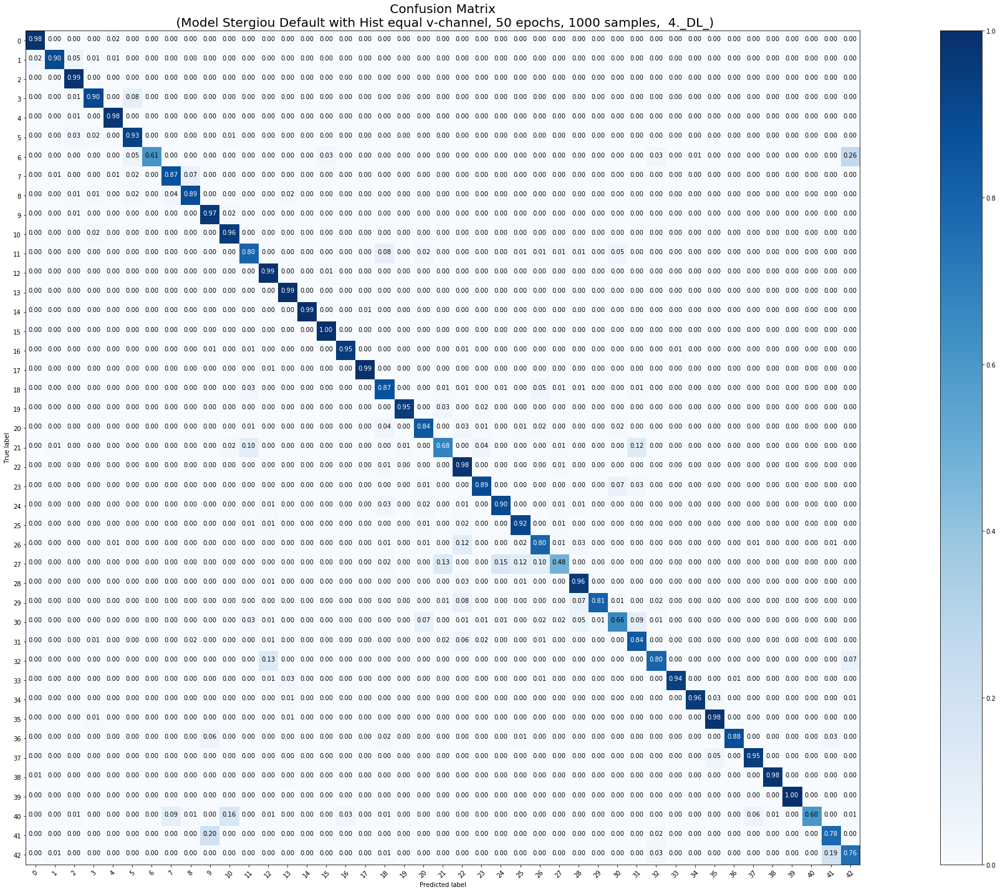

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 24s 24ms/step - loss: 3.2691 - acc: 0.2470 - val_loss: 2.5898 - val_acc: 0.3181
Epoch 2/50
1000/1000 [==============================] - 4s 4ms/step - loss: 1.3866 - acc: 0.5620 - val_loss: 1.2028 - val_acc: 0.6477
Epoch 3/50
1000/1000 [==============================] - 4s 4ms/step - loss: 0.8814 - acc: 0.7110 - val_loss: 0.9180 - val_acc: 0.7280
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.4201 - acc: 0.8390 - val_loss: 0.6112 - val_acc: 0.8252
Epoch 5/50
1000/1000 [==============================] - 4s 4ms/step - loss: 0.2102 - acc: 0.9260 - val_loss: 0.5417 - val_acc: 0.8407
Epoch 6/50
1000/1000 [===================

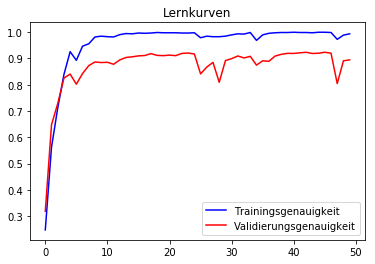

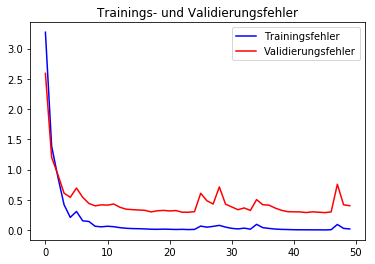

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.89      0.53      0.67        60
           1       0.96      0.92      0.94       720
           2       0.88      0.98      0.93       750
           3       0.92      0.91      0.91       450
           4       0.91      0.95      0.93       660
           5       0.92      0.81      0.86       630
           6       0.88      0.65      0.75       150
           7       0.83      0.91      0.87       450
           8       0.93      0.76      0.84       450
           9       0.96      0.95      0.96       480
          10       0.97      0.92      0.94       660
          11       0.92      0.70      0.79       420
          12       0.96      1.00      0.98       690
          13       0.96      0.99      0.97       720
          14       1.00      0.90      0.95       270
          15       0.72      0.99      0.84       210
          16       0.95      0.94      0.95   

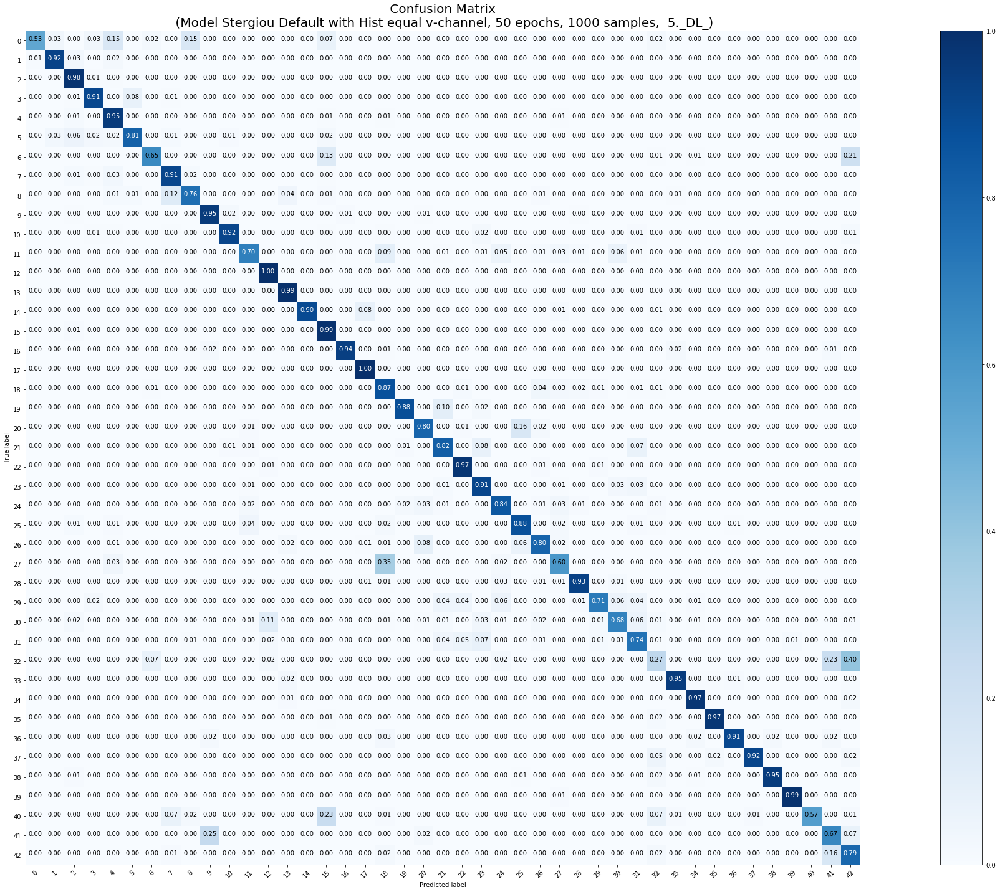

<Figure size 432x288 with 0 Axes>

In [0]:
### 1000, A, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_1000, y_tr_1000, X_test, y_test, 50, 1000)

In [0]:
downloaderCW(1000)

In [0]:
downloader(1000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 9s 5ms/step - loss: 1.8356 - acc: 0.5325 - val_loss: 0.9682 - val_acc: 0.7519
Epoch 2/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.4829 - acc: 0.8515 - val_loss: 0.4581 - val_acc: 0.8614
Epoch 3/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.2250 - acc: 0.9355 - val_loss: 0.3328 - val_acc: 0.9050
Epoch 4/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1248 - acc: 0.9640 - val_loss: 0.2825 - val_acc: 0.9219
Epoch 5/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.0706 - acc: 0.9850 - val_loss: 0.2297 - val_acc: 0.9361
Epoch 6/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.0596 - acc: 0.9850 - val_loss: 0.2

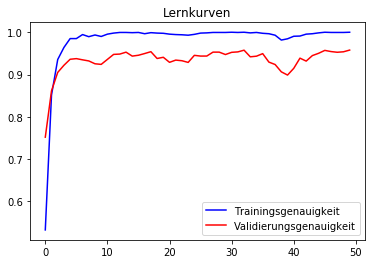

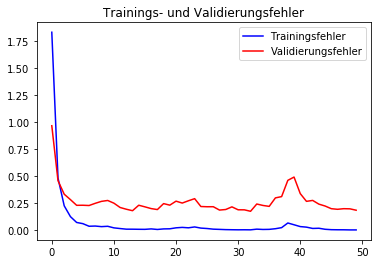

              precision    recall  f1-score   support

           0       0.95      0.95      0.95        60
           1       0.97      0.97      0.97       720
           2       0.97      0.99      0.98       750
           3       0.93      0.93      0.93       450
           4       0.98      0.96      0.97       660
           5       0.90      0.95      0.92       630
           6       1.00      0.61      0.76       150
           7       0.97      0.92      0.95       450
           8       0.92      0.94      0.93       450
           9       0.96      0.99      0.97       480
          10       0.97      0.96      0.96       660
          11       0.97      0.96      0.97       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.99      1.00       270
          15       1.00      1.00      1.00       210
          16       0.98      0.95      0.97       150
          17       0.99    

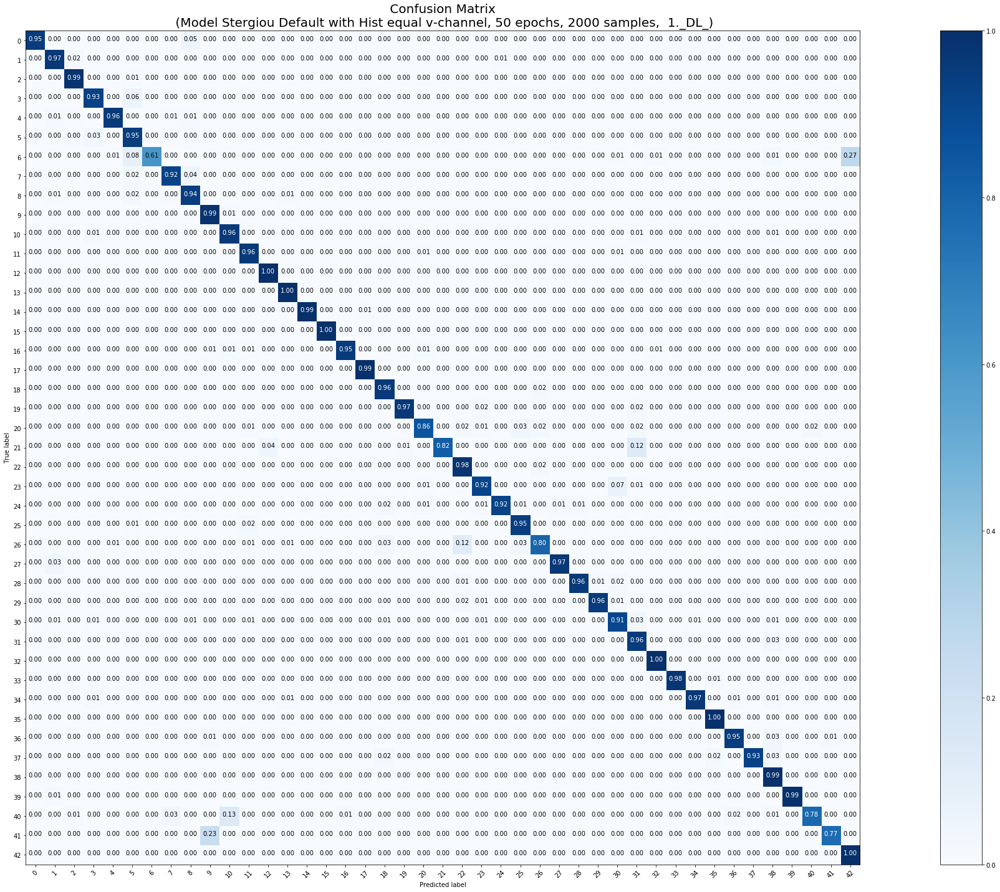

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 10s 5ms/step - loss: 1.8500 - acc: 0.5280 - val_loss: 0.9074 - val_acc: 0.7254
Epoch 2/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.4642 - acc: 0.8655 - val_loss: 0.5285 - val_acc: 0.8527
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.2029 - acc: 0.9435 - val_loss: 0.3213 - val_acc: 0.9079
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1293 - acc: 0.9625 - val_loss: 0.3041 - val_acc: 0.9108
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0880 - acc: 0.9760 - val_loss: 0.2634 - val_acc: 0.9267
Epoch 6/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0562 - acc: 0.9865 - val_loss: 0.

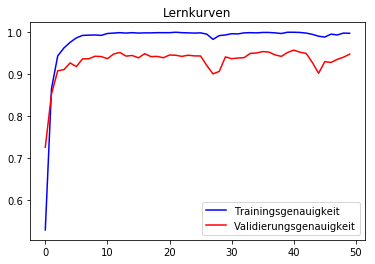

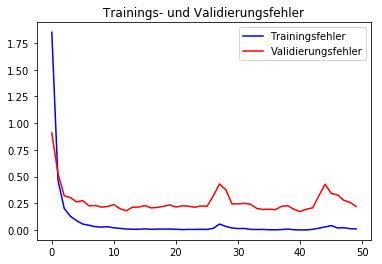

              precision    recall  f1-score   support

           0       0.95      0.97      0.96        60
           1       0.95      0.97      0.96       720
           2       0.99      0.98      0.98       750
           3       0.91      0.94      0.93       450
           4       0.98      0.95      0.96       660
           5       0.89      0.96      0.92       630
           6       0.93      0.67      0.78       150
           7       0.97      0.88      0.92       450
           8       0.91      0.92      0.92       450
           9       0.96      0.97      0.97       480
          10       0.98      0.93      0.96       660
          11       0.96      0.87      0.92       420
          12       1.00      1.00      1.00       690
          13       0.98      1.00      0.99       720
          14       0.97      0.96      0.97       270
          15       1.00      0.98      0.99       210
          16       0.97      0.97      0.97       150
          17       0.91    

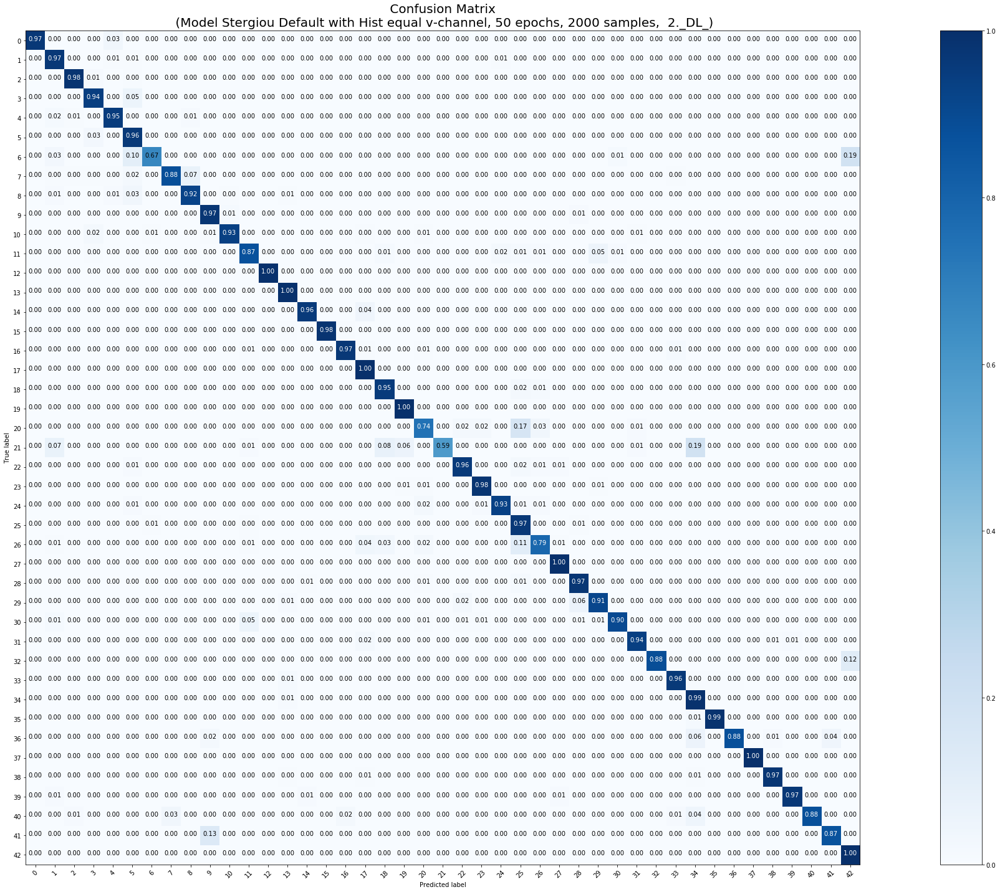

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 10s 5ms/step - loss: 1.9025 - acc: 0.5175 - val_loss: 0.9395 - val_acc: 0.7320
Epoch 2/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.4442 - acc: 0.8775 - val_loss: 0.4277 - val_acc: 0.8663
Epoch 3/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1973 - acc: 0.9500 - val_loss: 0.3014 - val_acc: 0.9199
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1128 - acc: 0.9705 - val_loss: 0.3263 - val_acc: 0.9083
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0988 - acc: 0.9715 - val_loss: 0.2965 - val_acc: 0.9216
Epoch 6/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0602 - acc: 0.9865 - val_loss: 0.

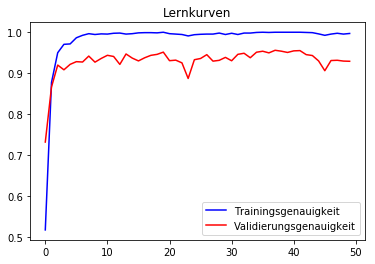

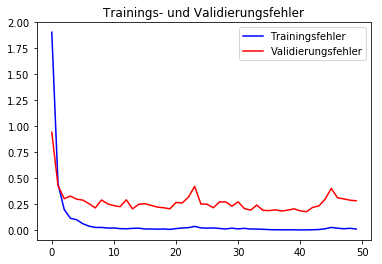

              precision    recall  f1-score   support

           0       1.00      0.80      0.89        60
           1       0.90      0.93      0.91       720
           2       0.99      0.96      0.97       750
           3       0.89      0.94      0.91       450
           4       0.87      0.97      0.92       660
           5       0.93      0.91      0.92       630
           6       1.00      0.71      0.83       150
           7       0.93      0.89      0.91       450
           8       0.95      0.88      0.91       450
           9       0.98      0.95      0.97       480
          10       0.88      0.99      0.93       660
          11       0.94      0.81      0.87       420
          12       1.00      0.98      0.99       690
          13       0.98      0.98      0.98       720
          14       0.99      0.98      0.99       270
          15       0.96      0.99      0.97       210
          16       0.99      0.95      0.97       150
          17       0.92    

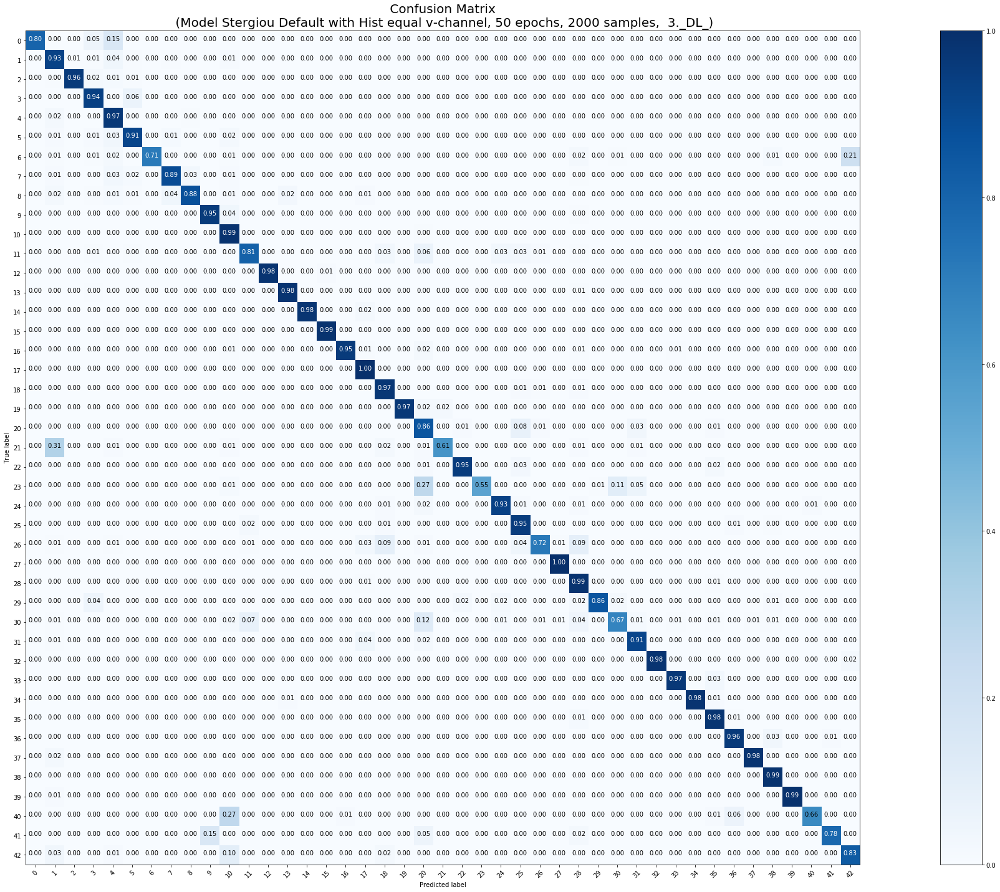

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 10s 5ms/step - loss: 1.8980 - acc: 0.5205 - val_loss: 0.6579 - val_acc: 0.8043
Epoch 2/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.5200 - acc: 0.8475 - val_loss: 0.5647 - val_acc: 0.8272
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.2148 - acc: 0.9385 - val_loss: 0.2870 - val_acc: 0.9119
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1256 - acc: 0.9695 - val_loss: 0.2649 - val_acc: 0.9256
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0839 - acc: 0.9770 - val_loss: 0.2589 - val_acc: 0.9235
Epoch 6/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.0574 - acc: 0.9895 - val_loss: 0.

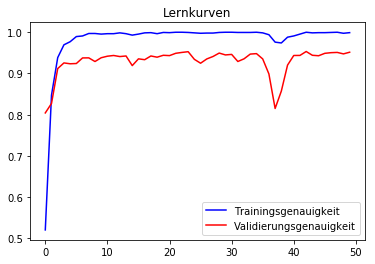

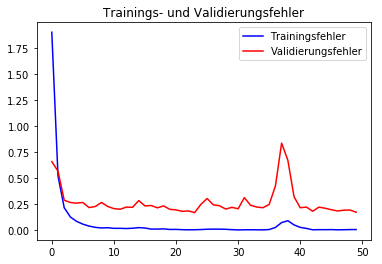

              precision    recall  f1-score   support

           0       0.94      0.97      0.95        60
           1       0.98      0.92      0.94       720
           2       0.95      0.99      0.97       750
           3       0.94      0.97      0.95       450
           4       0.98      0.98      0.98       660
           5       0.97      0.95      0.96       630
           6       0.97      0.74      0.84       150
           7       0.97      0.94      0.96       450
           8       0.91      0.96      0.93       450
           9       0.95      0.99      0.97       480
          10       0.98      0.99      0.98       660
          11       0.83      0.96      0.89       420
          12       0.97      0.99      0.98       690
          13       0.98      1.00      0.99       720
          14       0.99      0.99      0.99       270
          15       0.97      1.00      0.98       210
          16       0.97      0.94      0.96       150
          17       0.98    

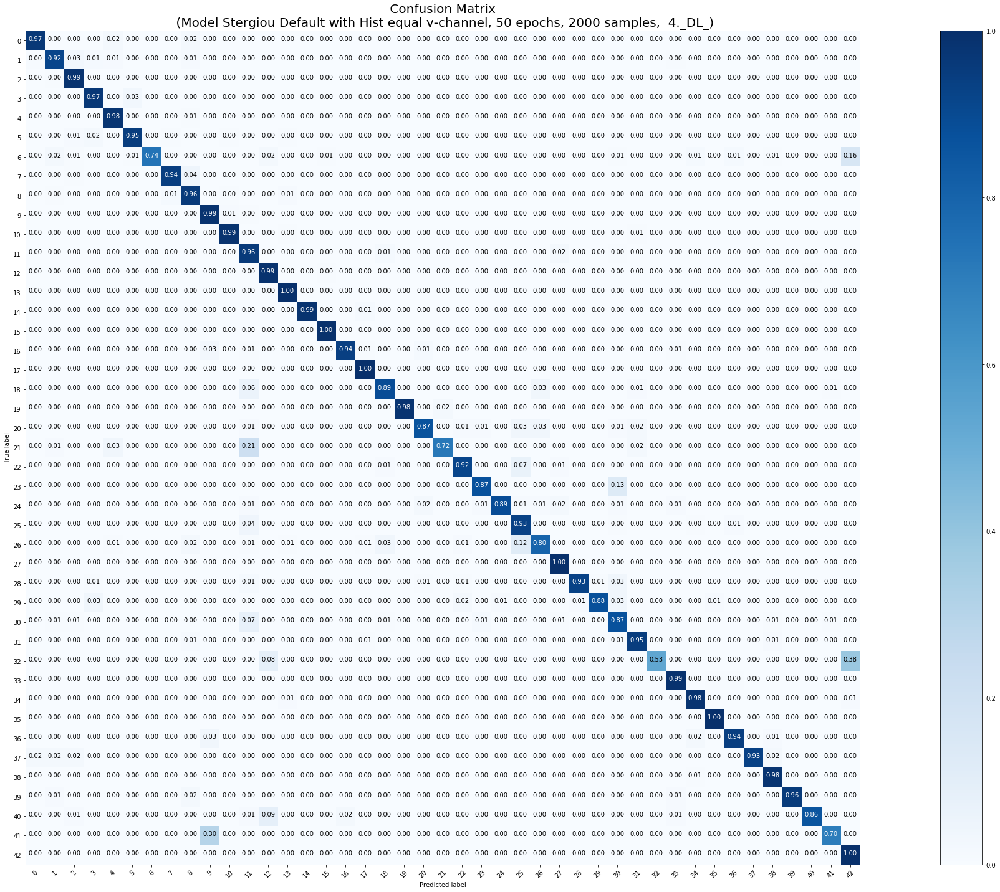

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 11s 5ms/step - loss: 1.9690 - acc: 0.5065 - val_loss: 1.0584 - val_acc: 0.7104
Epoch 2/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.5257 - acc: 0.8450 - val_loss: 0.4639 - val_acc: 0.8608
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.2333 - acc: 0.9340 - val_loss: 0.3360 - val_acc: 0.9047
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1224 - acc: 0.9720 - val_loss: 0.2915 - val_acc: 0.9203
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0694 - acc: 0.9840 - val_loss: 0.2359 - val_acc: 0.9322
Epoch 6/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0551 - acc: 0.9910 - val_loss: 0.

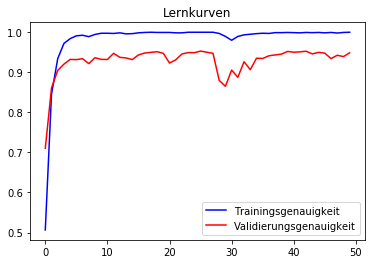

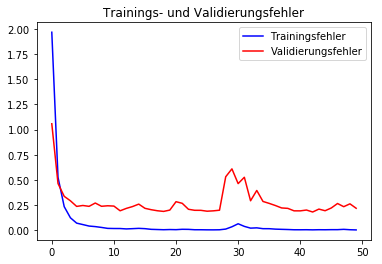

              precision    recall  f1-score   support

           0       0.97      0.97      0.97        60
           1       0.97      0.96      0.97       720
           2       0.97      0.99      0.98       750
           3       0.97      0.92      0.95       450
           4       0.97      0.98      0.98       660
           5       0.93      0.93      0.93       630
           6       1.00      0.73      0.84       150
           7       0.95      0.93      0.94       450
           8       0.96      0.95      0.95       450
           9       0.91      0.98      0.95       480
          10       0.95      0.98      0.96       660
          11       0.87      0.97      0.92       420
          12       0.98      0.98      0.98       690
          13       0.99      1.00      0.99       720
          14       0.98      0.96      0.97       270
          15       0.93      1.00      0.97       210
          16       0.97      0.95      0.96       150
          17       0.95    

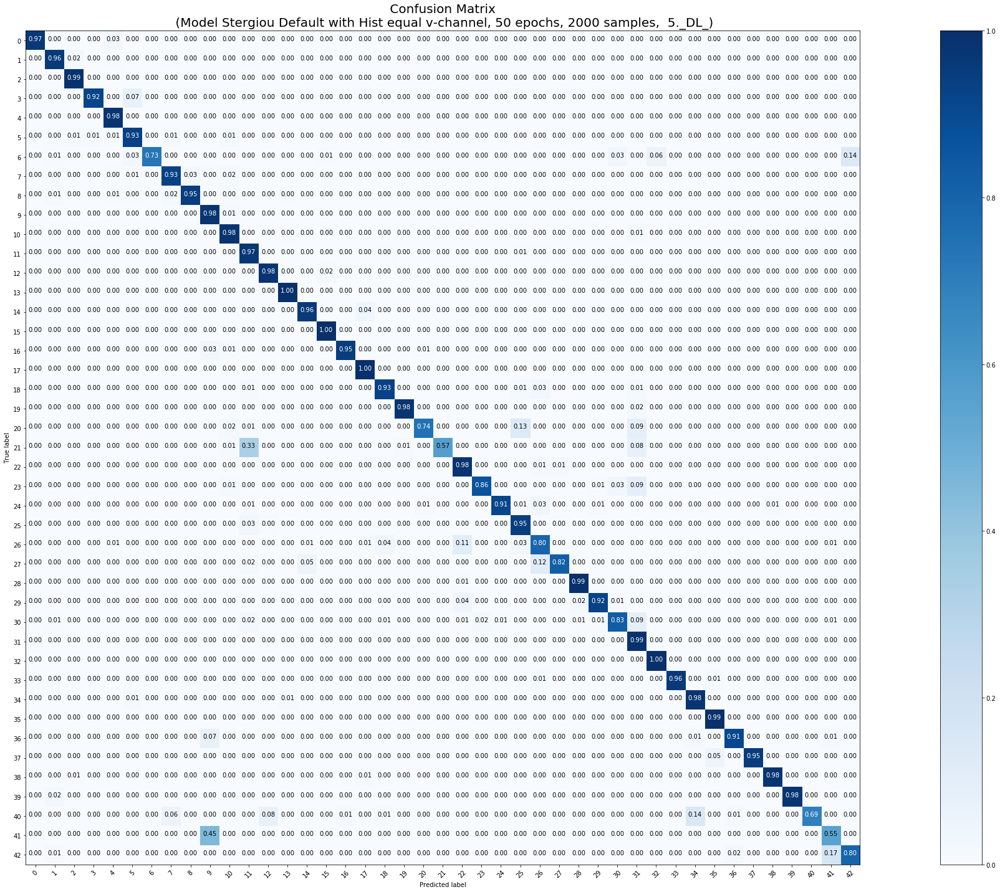

<Figure size 432x288 with 0 Axes>

In [0]:
### 2000, A, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_2000, y_tr_2000, X_test, y_test, 50, 2000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 25s 13ms/step - loss: 2.4468 - acc: 0.3745 - val_loss: 1.2997 - val_acc: 0.6383
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.7190 - acc: 0.7700 - val_loss: 0.6001 - val_acc: 0.8342
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.3317 - acc: 0.8920 - val_loss: 0.4346 - val_acc: 0.8766
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1877 - acc: 0.9430 - val_loss: 0.3976 - val_acc: 0.8877
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1096 - acc: 0.9630 - val_loss: 0.2716 - val_acc: 0.9242
Epoch 6/50
2000/2000 [===================

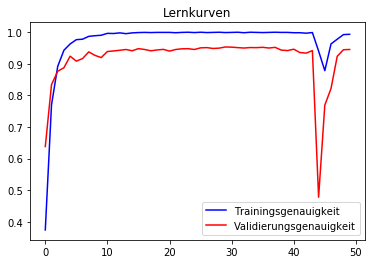

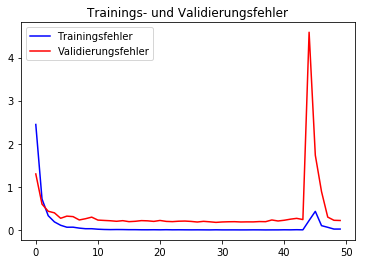

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.81      0.98      0.89        60
           1       0.92      0.97      0.94       720
           2       0.96      0.98      0.97       750
           3       0.94      0.94      0.94       450
           4       0.94      0.94      0.94       660
           5       0.96      0.87      0.91       630
           6       0.94      0.72      0.82       150
           7       0.92      0.93      0.93       450
           8       0.96      0.91      0.93       450
           9       0.96      0.97      0.96       480
          10       0.96      0.95      0.95       660
          11       0.93      0.93      0.93       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.97      0.99       270
          15       0.94      1.00      0.97       210
          16       0.97      0.95      0.96   

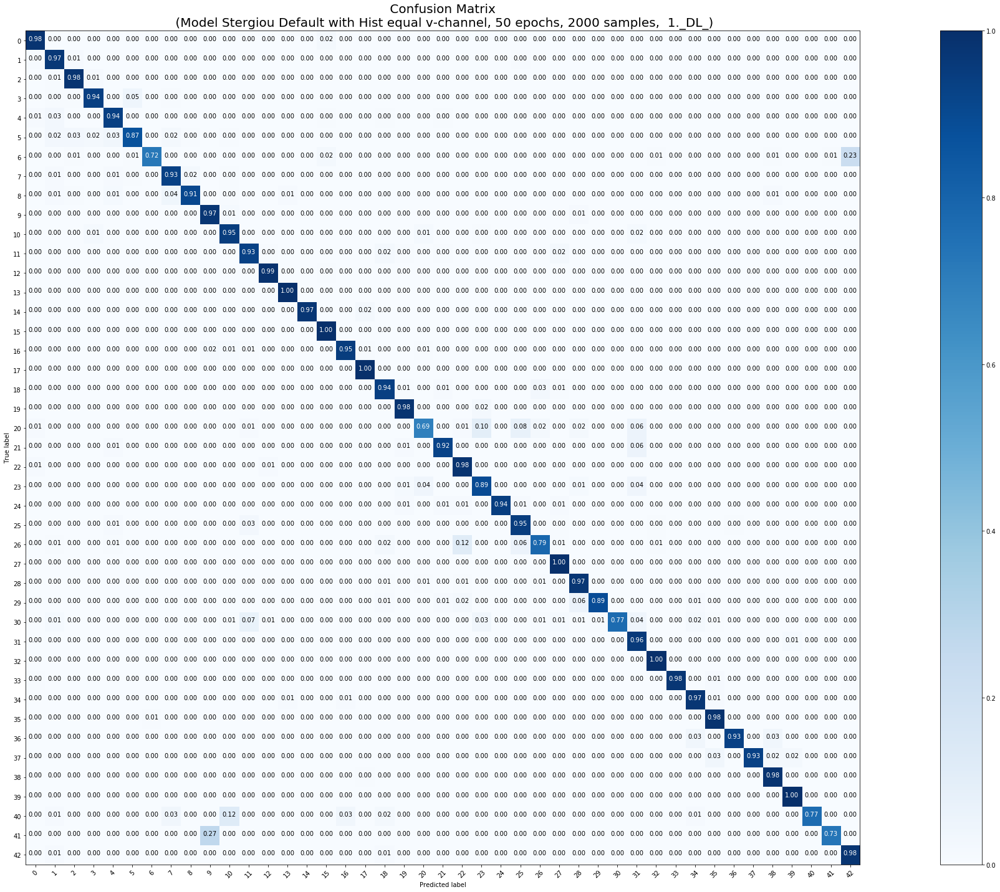

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 25s 13ms/step - loss: 2.5267 - acc: 0.3595 - val_loss: 1.7182 - val_acc: 0.5354
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.6919 - acc: 0.7800 - val_loss: 0.6147 - val_acc: 0.8214
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.3245 - acc: 0.8930 - val_loss: 0.4919 - val_acc: 0.8571
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.2040 - acc: 0.9280 - val_loss: 0.3315 - val_acc: 0.9063
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1096 - acc: 0.9635 - val_loss: 0.3236 - val_acc: 0.9121
Epoch 6/50
2000/2000 [===================

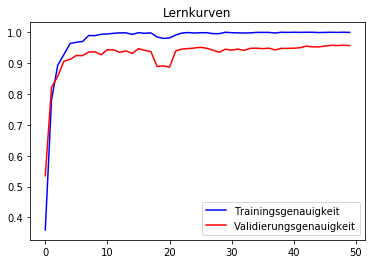

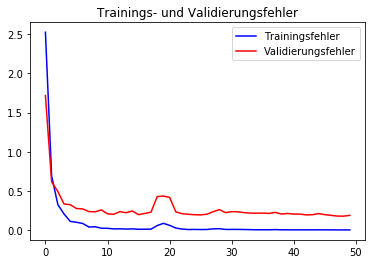

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.94      0.98      0.96        60
           1       0.98      0.96      0.97       720
           2       0.97      0.98      0.98       750
           3       0.95      0.94      0.95       450
           4       0.98      0.97      0.98       660
           5       0.89      0.96      0.93       630
           6       0.99      0.63      0.77       150
           7       0.98      0.90      0.94       450
           8       0.93      0.95      0.94       450
           9       0.95      0.99      0.97       480
          10       0.99      0.97      0.98       660
          11       0.94      0.92      0.93       420
          12       1.00      0.97      0.98       690
          13       0.98      1.00      0.99       720
          14       1.00      0.98      0.99       270
          15       0.85      1.00      0.92       210
          16       0.97      0.95      0.96   

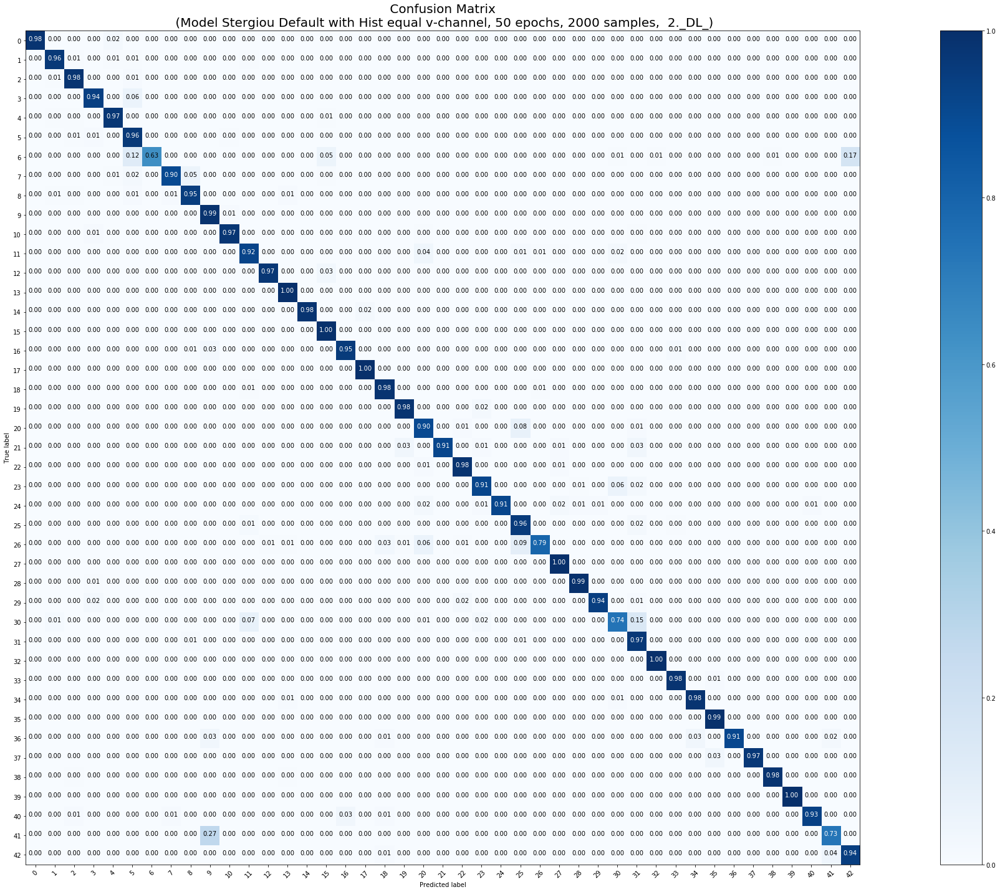

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 26s 13ms/step - loss: 2.4642 - acc: 0.3960 - val_loss: 1.0595 - val_acc: 0.6847
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.6851 - acc: 0.7715 - val_loss: 0.4973 - val_acc: 0.8505
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.3068 - acc: 0.8965 - val_loss: 0.4434 - val_acc: 0.8740
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1491 - acc: 0.9450 - val_loss: 0.3580 - val_acc: 0.8938
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.0947 - acc: 0.9705 - val_loss: 0.2723 - val_acc: 0.9230
Epoch 6/50
2000/2000 [===================

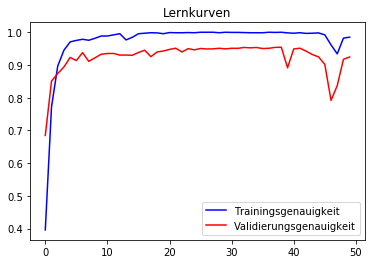

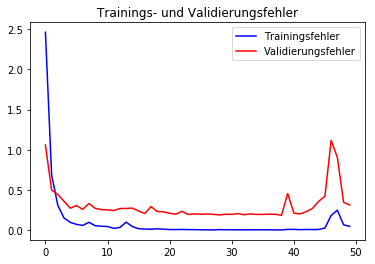

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.76      1.00      0.86        60
           1       0.95      0.93      0.94       720
           2       0.95      0.98      0.97       750
           3       0.91      0.94      0.92       450
           4       0.98      0.92      0.95       660
           5       0.94      0.85      0.89       630
           6       0.64      0.73      0.68       150
           7       0.97      0.89      0.93       450
           8       0.91      0.95      0.93       450
           9       0.91      0.98      0.95       480
          10       0.97      0.92      0.94       660
          11       0.97      0.60      0.74       420
          12       1.00      0.98      0.99       690
          13       0.98      0.99      0.99       720
          14       1.00      0.95      0.98       270
          15       0.89      0.99      0.94       210
          16       0.94      0.96      0.95   

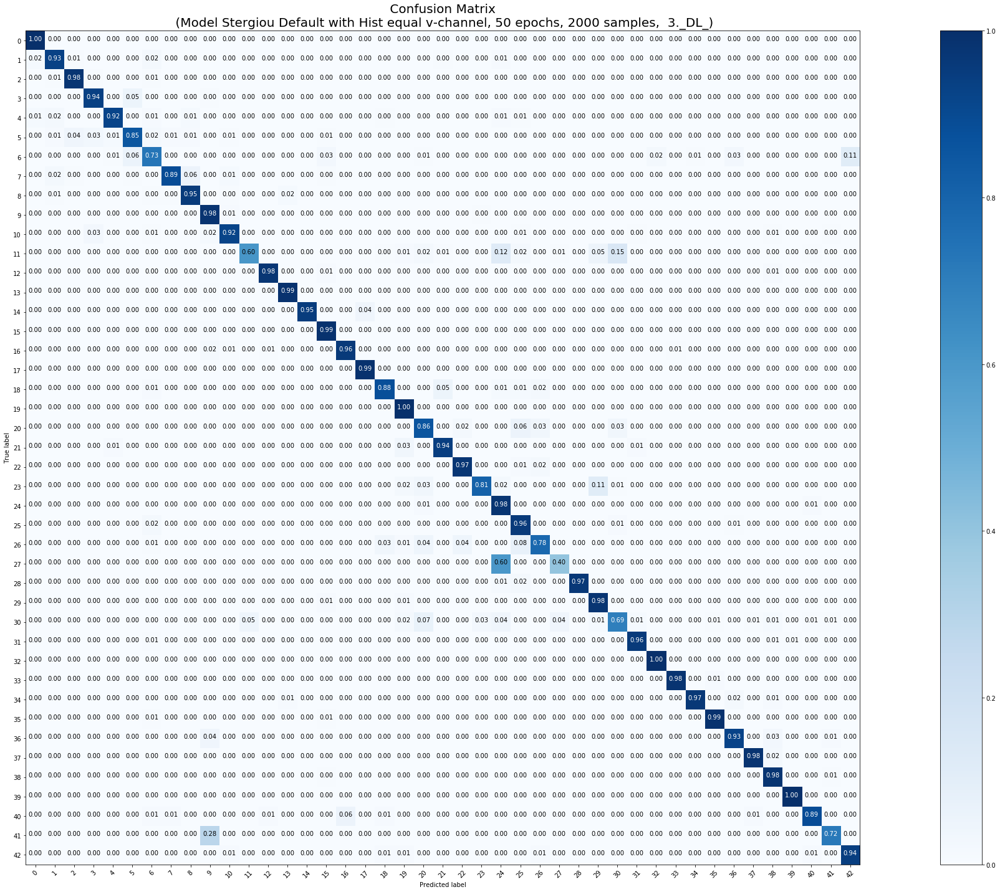

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 27s 13ms/step - loss: 2.6030 - acc: 0.3650 - val_loss: 1.3366 - val_acc: 0.6107
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.8073 - acc: 0.7485 - val_loss: 0.6952 - val_acc: 0.8006
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.3210 - acc: 0.8935 - val_loss: 0.3643 - val_acc: 0.8941
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1723 - acc: 0.9380 - val_loss: 0.4322 - val_acc: 0.8689
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1077 - acc: 0.9630 - val_loss: 0.3153 - val_acc: 0.9057
Epoch 6/50
2000/2000 [===================

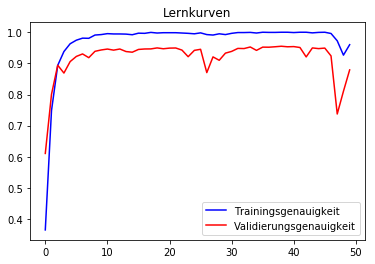

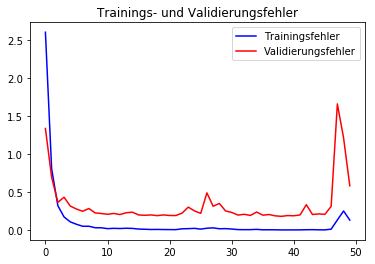

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.89      0.90      0.89        60
           1       0.67      0.98      0.80       720
           2       0.93      0.98      0.95       750
           3       0.98      0.87      0.92       450
           4       0.97      0.94      0.96       660
           5       0.93      0.47      0.63       630
           6       0.97      0.65      0.78       150
           7       0.94      0.82      0.87       450
           8       0.81      0.95      0.87       450
           9       0.87      0.98      0.92       480
          10       0.95      0.96      0.95       660
          11       0.89      0.89      0.89       420
          12       1.00      0.89      0.94       690
          13       1.00      0.97      0.98       720
          14       1.00      0.99      0.99       270
          15       0.85      0.99      0.91       210
          16       0.99      0.92      0.96   

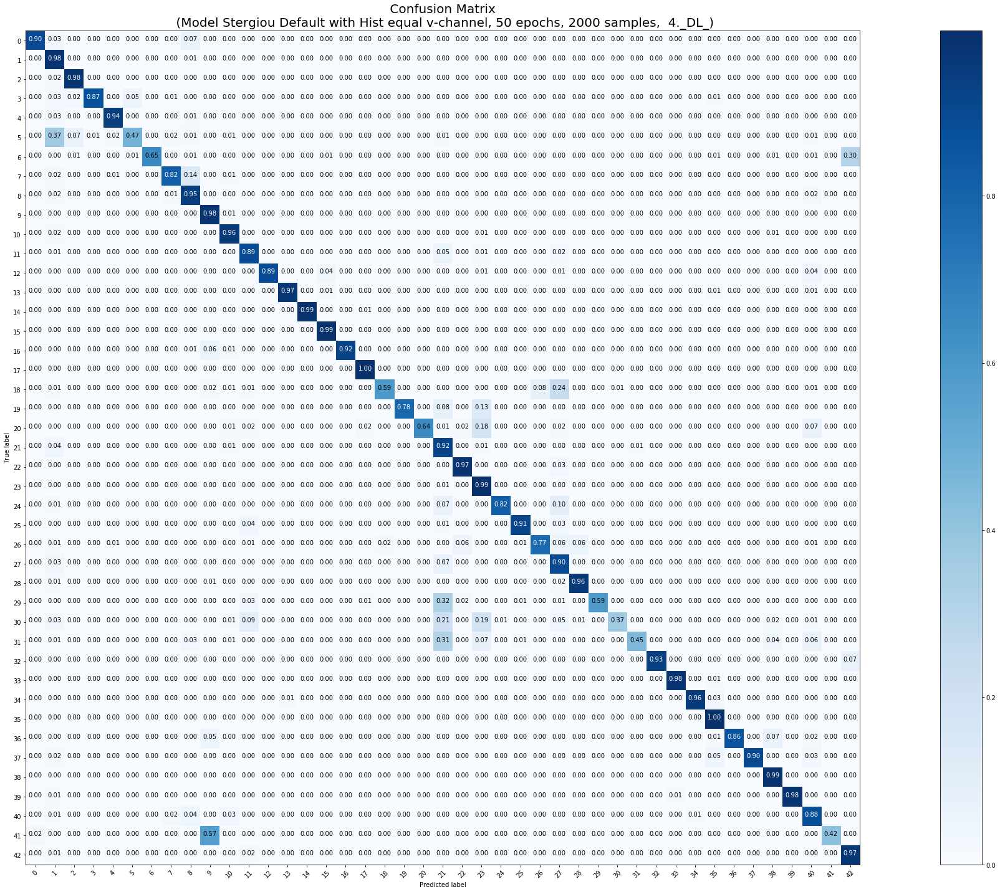

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 26s 13ms/step - loss: 2.6461 - acc: 0.3665 - val_loss: 1.3393 - val_acc: 0.5884
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.7996 - acc: 0.7490 - val_loss: 0.6394 - val_acc: 0.8140
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.3221 - acc: 0.8900 - val_loss: 0.4006 - val_acc: 0.8857
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1971 - acc: 0.9320 - val_loss: 0.3453 - val_acc: 0.9017
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1010 - acc: 0.9630 - val_loss: 0.3333 - val_acc: 0.9031
Epoch 6/50
2000/2000 [===================

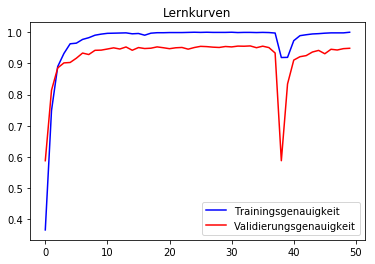

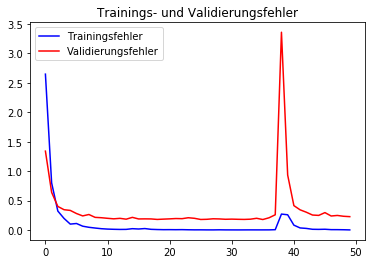

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.90      0.92      0.91        60
           1       0.98      0.94      0.96       720
           2       0.97      0.98      0.97       750
           3       0.90      0.93      0.92       450
           4       0.99      0.97      0.98       660
           5       0.91      0.96      0.93       630
           6       1.00      0.61      0.76       150
           7       0.97      0.91      0.94       450
           8       0.92      0.95      0.94       450
           9       0.96      0.98      0.97       480
          10       0.97      0.95      0.96       660
          11       0.94      0.88      0.91       420
          12       0.99      1.00      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      0.97      0.98       270
          15       0.99      0.99      0.99       210
          16       0.99      0.95      0.97   

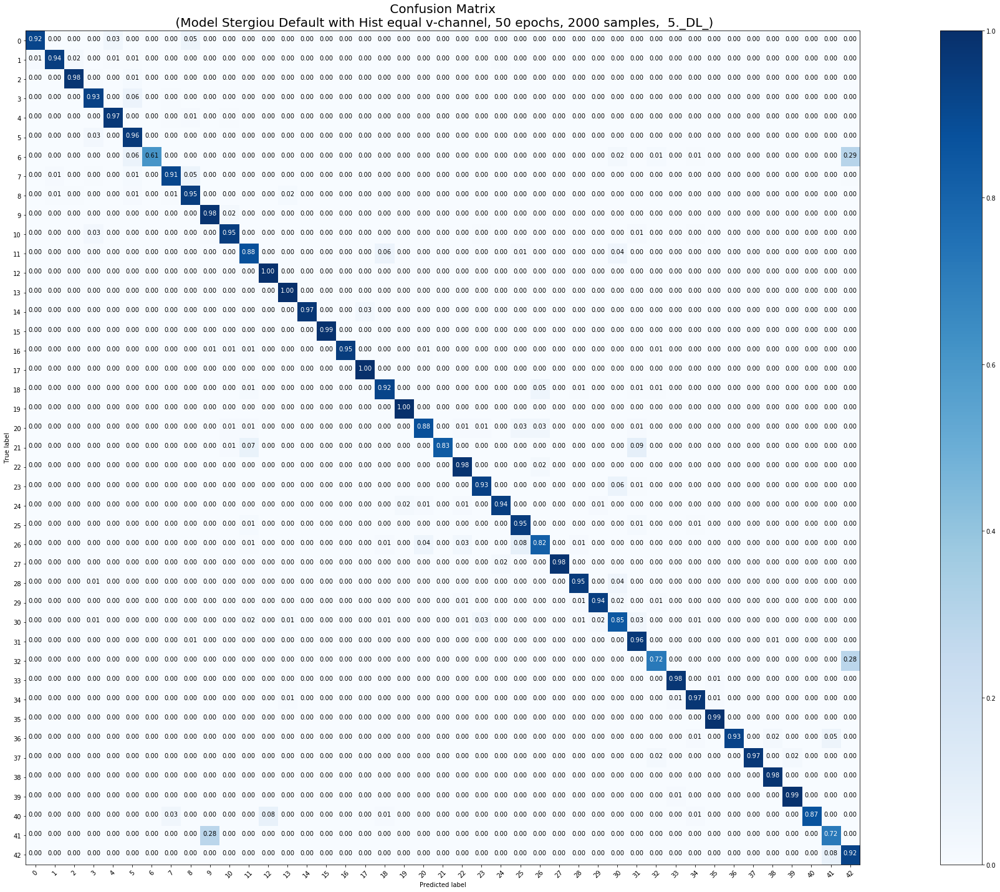

<Figure size 432x288 with 0 Axes>

In [0]:
### 2000, A, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_2000, y_tr_2000, X_test, y_test, 50, 2000)

In [0]:
downloaderCW(2000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 13s 3ms/step - loss: 1.0649 - acc: 0.7198 - val_loss: 0.4142 - val_acc: 0.8807
Epoch 2/50
5000/5000 [==============================] - 5s 929us/step - loss: 0.2273 - acc: 0.9330 - val_loss: 0.3263 - val_acc: 0.9066
Epoch 3/50
5000/5000 [==============================] - 5s 931us/step - loss: 0.1322 - acc: 0.9632 - val_loss: 0.1882 - val_acc: 0.9492
Epoch 4/50
5000/5000 [==============================] - 5s 935us/step - loss: 0.0746 - acc: 0.9812 - val_loss: 0.1819 - val_acc: 0.9509
Epoch 5/50
5000/5000 [==============================] - 5s 935us/step - loss: 0.0519 - acc: 0.9866 - val_loss: 0.1787 - val_acc: 0.9532
Epoch 6/50
5000/5000 [==============================] - 5s 934us/step - loss: 0.0392 - acc: 0.9890 - va

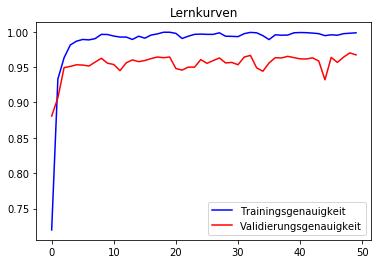

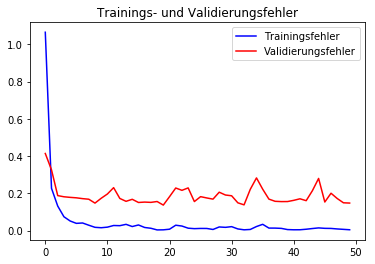

              precision    recall  f1-score   support

           0       0.97      0.97      0.97        60
           1       0.98      0.98      0.98       720
           2       0.99      0.97      0.98       750
           3       0.88      0.98      0.93       450
           4       0.99      0.97      0.98       660
           5       0.96      0.90      0.93       630
           6       1.00      0.78      0.88       150
           7       0.97      0.95      0.96       450
           8       0.96      0.94      0.95       450
           9       0.97      0.99      0.98       480
          10       0.98      0.98      0.98       660
          11       0.97      0.98      0.98       420
          12       0.98      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.99      0.99       270
          15       0.98      0.99      0.98       210
          16       0.99      0.99      0.99       150
          17       0.98    

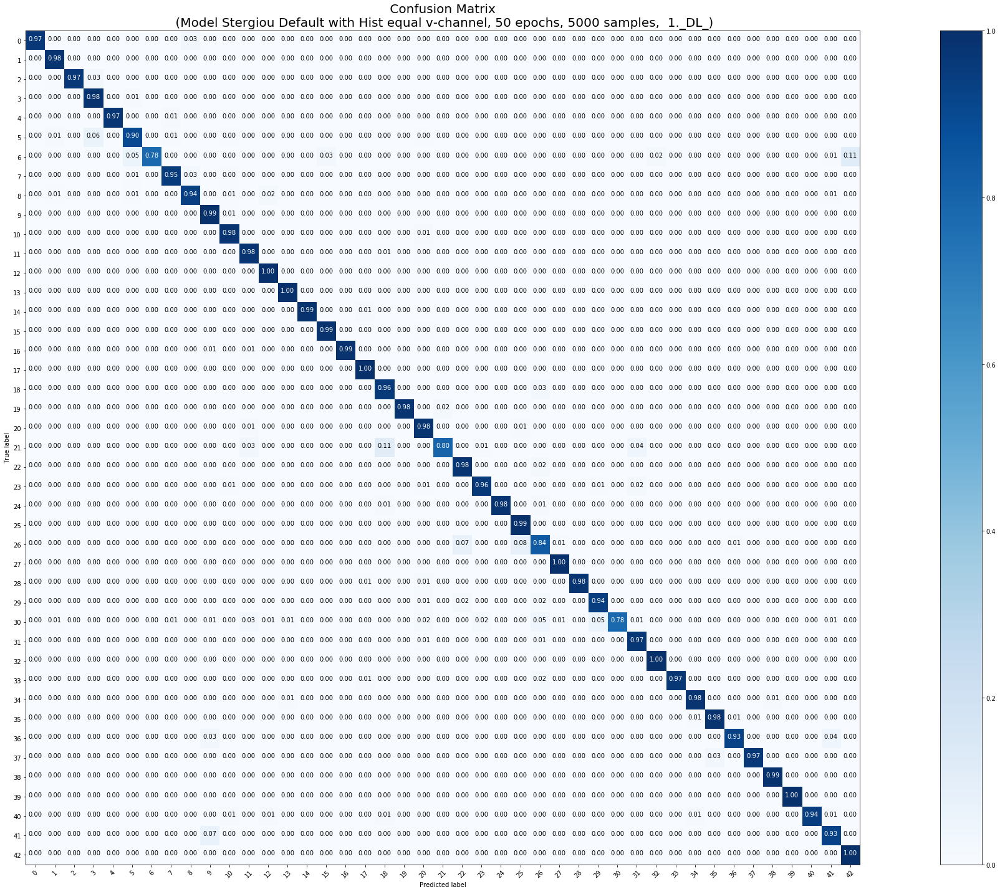

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 13s 3ms/step - loss: 0.9987 - acc: 0.7374 - val_loss: 0.3316 - val_acc: 0.8991
Epoch 2/50
5000/5000 [==============================] - 5s 934us/step - loss: 0.2052 - acc: 0.9382 - val_loss: 0.2196 - val_acc: 0.9370
Epoch 3/50
5000/5000 [==============================] - 5s 932us/step - loss: 0.0949 - acc: 0.9750 - val_loss: 0.1885 - val_acc: 0.9462
Epoch 4/50
5000/5000 [==============================] - 5s 930us/step - loss: 0.0521 - acc: 0.9864 - val_loss: 0.2062 - val_acc: 0.9401
Epoch 5/50
5000/5000 [==============================] - 5s 940us/step - loss: 0.0424 - acc: 0.9890 - val_loss: 0.1839 - val_acc: 0.9469
Epoch 6/50
5000/5000 [==============================] - 5s 950us/step - loss: 0.0388 - acc: 0.9896 - va

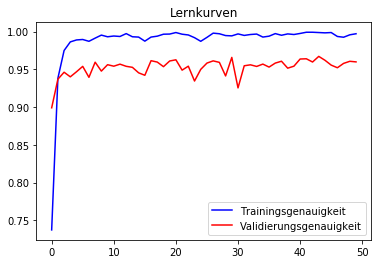

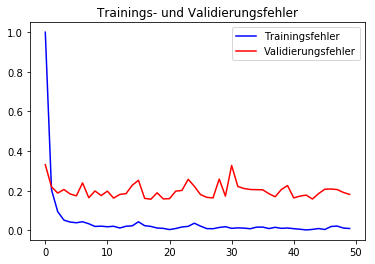

              precision    recall  f1-score   support

           0       0.90      1.00      0.94        60
           1       0.98      0.96      0.97       720
           2       0.97      0.99      0.98       750
           3       0.99      0.94      0.96       450
           4       0.98      0.98      0.98       660
           5       0.94      0.92      0.93       630
           6       0.99      0.65      0.79       150
           7       0.95      0.96      0.95       450
           8       0.96      0.95      0.95       450
           9       0.96      0.98      0.97       480
          10       0.98      0.98      0.98       660
          11       0.96      0.96      0.96       420
          12       0.99      0.96      0.97       690
          13       0.98      1.00      0.99       720
          14       1.00      0.99      0.99       270
          15       0.84      1.00      0.91       210
          16       1.00      0.97      0.99       150
          17       0.99    

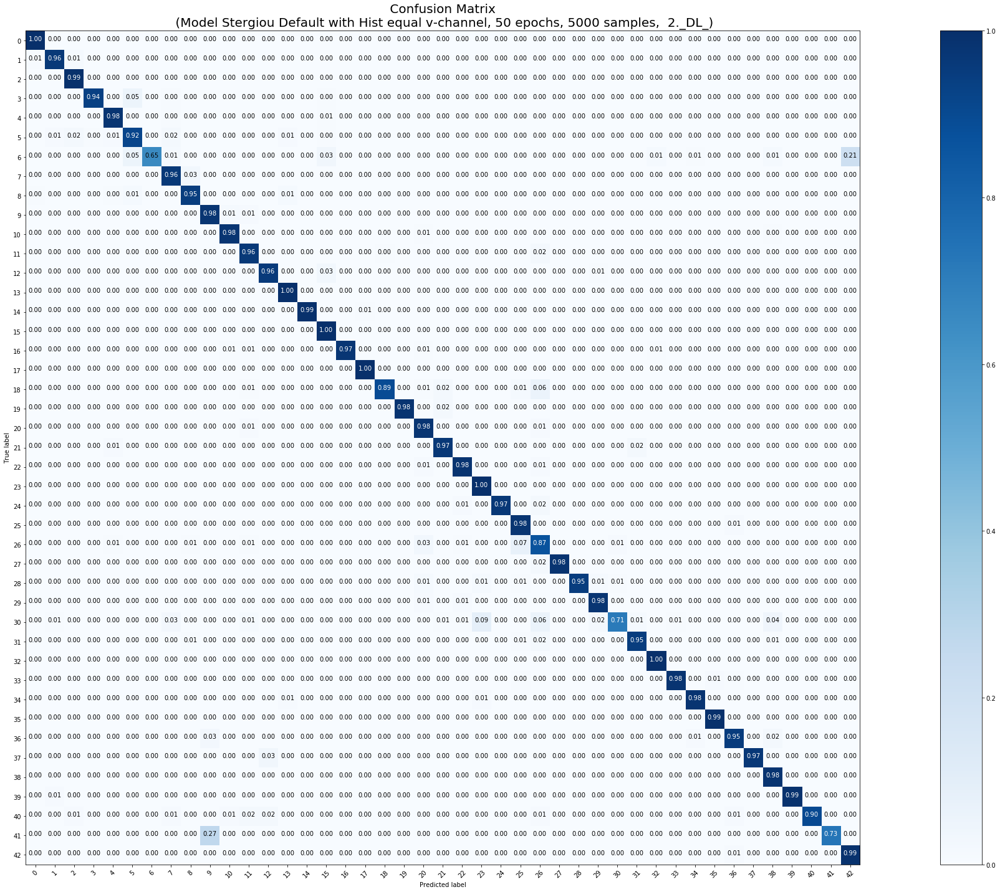

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 14s 3ms/step - loss: 1.1000 - acc: 0.7060 - val_loss: 0.6965 - val_acc: 0.8337
Epoch 2/50
5000/5000 [==============================] - 5s 947us/step - loss: 0.2105 - acc: 0.9392 - val_loss: 0.3228 - val_acc: 0.9127
Epoch 3/50
5000/5000 [==============================] - 5s 928us/step - loss: 0.1040 - acc: 0.9730 - val_loss: 0.1989 - val_acc: 0.9448
Epoch 4/50
5000/5000 [==============================] - 5s 929us/step - loss: 0.0595 - acc: 0.9844 - val_loss: 0.2090 - val_acc: 0.9430
Epoch 5/50
5000/5000 [==============================] - 5s 932us/step - loss: 0.0470 - acc: 0.9890 - val_loss: 0.1755 - val_acc: 0.9544
Epoch 6/50
5000/5000 [==============================] - 5s 925us/step - loss: 0.0376 - acc: 0.9896 - va

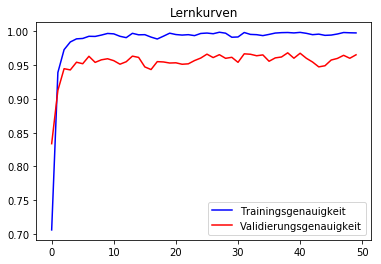

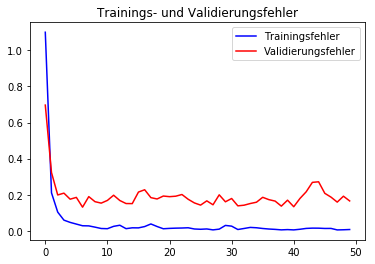

              precision    recall  f1-score   support

           0       0.91      1.00      0.95        60
           1       0.97      0.97      0.97       720
           2       0.98      0.99      0.99       750
           3       0.99      0.93      0.96       450
           4       1.00      0.98      0.99       660
           5       0.94      0.97      0.95       630
           6       1.00      0.71      0.83       150
           7       0.98      0.94      0.96       450
           8       0.91      0.97      0.94       450
           9       0.99      0.99      0.99       480
          10       0.97      0.97      0.97       660
          11       0.93      0.99      0.96       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      0.99       210
          16       0.98      0.99      0.98       150
          17       0.99    

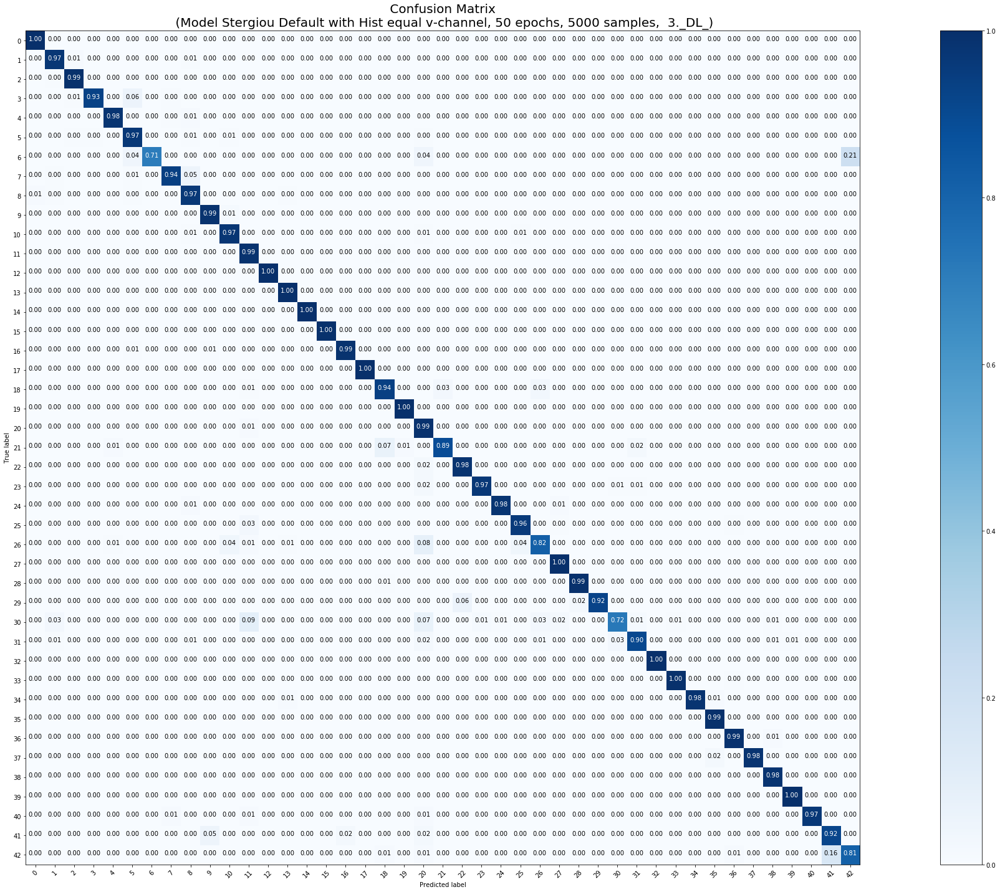

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 14s 3ms/step - loss: 1.0256 - acc: 0.7228 - val_loss: 0.4228 - val_acc: 0.8759
Epoch 2/50
5000/5000 [==============================] - 5s 940us/step - loss: 0.2123 - acc: 0.9404 - val_loss: 0.2836 - val_acc: 0.9224
Epoch 3/50
5000/5000 [==============================] - 5s 943us/step - loss: 0.1054 - acc: 0.9712 - val_loss: 0.1773 - val_acc: 0.9495
Epoch 4/50
5000/5000 [==============================] - 5s 984us/step - loss: 0.0659 - acc: 0.9844 - val_loss: 0.1708 - val_acc: 0.9530
Epoch 5/50
5000/5000 [==============================] - 5s 972us/step - loss: 0.0409 - acc: 0.9912 - val_loss: 0.1632 - val_acc: 0.9549
Epoch 6/50
5000/5000 [==============================] - 5s 956us/step - loss: 0.0316 - acc: 0.9932 - va

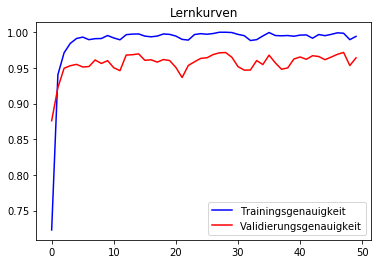

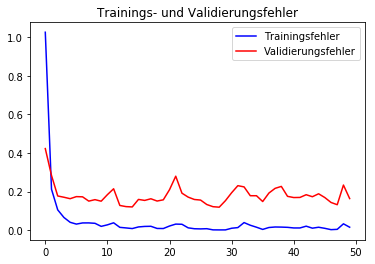

              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.98      0.97      0.98       720
           2       0.96      1.00      0.98       750
           3       0.98      0.98      0.98       450
           4       0.99      0.97      0.98       660
           5       0.92      0.97      0.94       630
           6       0.99      0.77      0.87       150
           7       0.98      0.94      0.96       450
           8       0.97      0.92      0.95       450
           9       0.96      0.99      0.97       480
          10       0.99      0.96      0.98       660
          11       1.00      0.96      0.98       420
          12       0.99      0.99      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      0.97      0.98       270
          15       1.00      0.97      0.98       210
          16       0.99      0.99      0.99       150
          17       0.97    

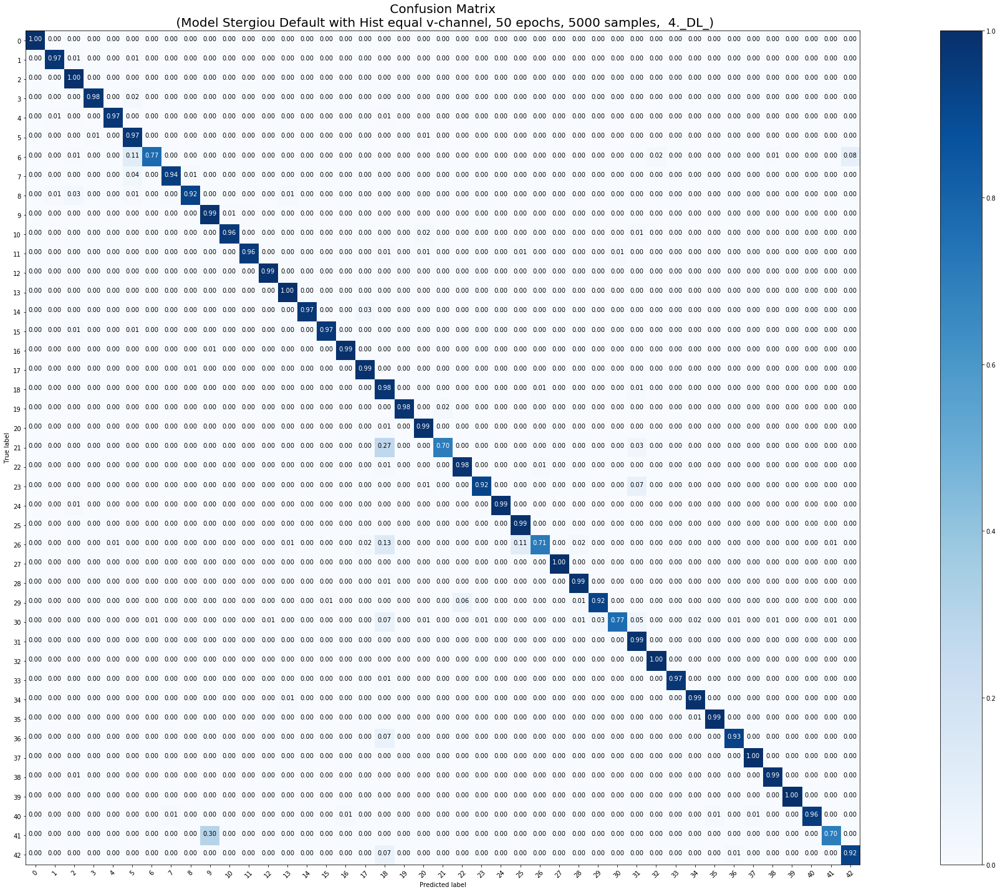

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 14s 3ms/step - loss: 1.0417 - acc: 0.7224 - val_loss: 0.4122 - val_acc: 0.8752
Epoch 2/50
5000/5000 [==============================] - 5s 945us/step - loss: 0.2011 - acc: 0.9410 - val_loss: 0.2743 - val_acc: 0.9219
Epoch 3/50
5000/5000 [==============================] - 5s 939us/step - loss: 0.0983 - acc: 0.9732 - val_loss: 0.2005 - val_acc: 0.9423
Epoch 4/50
5000/5000 [==============================] - 5s 962us/step - loss: 0.0708 - acc: 0.9806 - val_loss: 0.2100 - val_acc: 0.9433
Epoch 5/50
5000/5000 [==============================] - 5s 941us/step - loss: 0.0489 - acc: 0.9864 - val_loss: 0.2059 - val_acc: 0.9408
Epoch 6/50
5000/5000 [==============================] - 5s 939us/step - loss: 0.0370 - acc: 0.9908 - va

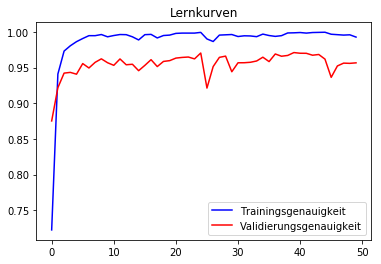

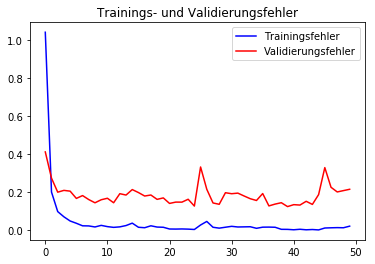

              precision    recall  f1-score   support

           0       1.00      0.98      0.99        60
           1       0.98      0.98      0.98       720
           2       0.96      1.00      0.98       750
           3       0.92      0.92      0.92       450
           4       1.00      0.96      0.98       660
           5       0.88      0.97      0.92       630
           6       0.97      0.67      0.80       150
           7       0.97      0.95      0.96       450
           8       0.94      0.95      0.94       450
           9       0.96      0.94      0.95       480
          10       0.99      0.92      0.96       660
          11       0.96      0.96      0.96       420
          12       0.97      1.00      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      0.99      1.00       270
          15       1.00      1.00      1.00       210
          16       0.88      0.99      0.93       150
          17       0.99    

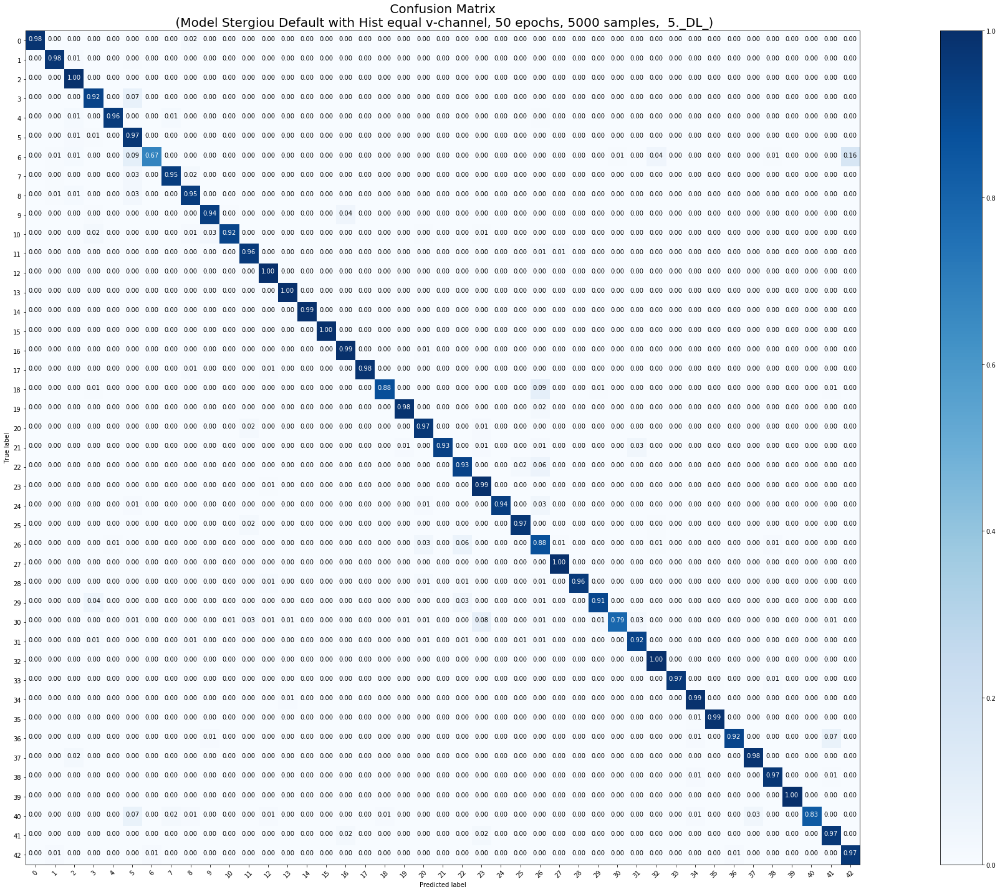

<Figure size 432x288 with 0 Axes>

In [0]:
### 5000, A, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_5000, y_tr_5000, X_test, y_test, 50, 5000)

In [0]:
downloader(5000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 29s 6ms/step - loss: 1.4643 - acc: 0.6102 - val_loss: 0.5716 - val_acc: 0.8355
Epoch 2/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.2758 - acc: 0.9078 - val_loss: 0.3042 - val_acc: 0.9082
Epoch 3/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.1666 - acc: 0.9492 - val_loss: 0.2388 - val_acc: 0.9296
Epoch 4/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0936 - acc: 0.9652 - val_loss: 0.2146 - val_acc: 0.9443
Epoch 5/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0535 - acc: 0.9814 - val_loss: 0.1649 - val_acc: 0.9557
Epoch 6/50
5000/5000 [====================

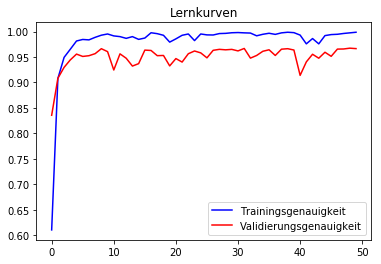

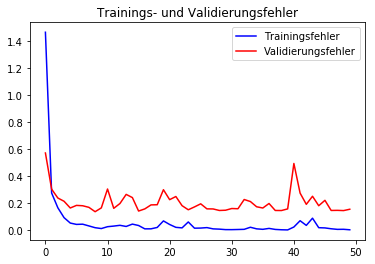

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      0.98      0.97        60
           1       0.98      0.99      0.98       720
           2       0.99      0.99      0.99       750
           3       0.97      0.94      0.96       450
           4       1.00      0.97      0.99       660
           5       0.94      0.97      0.96       630
           6       1.00      0.67      0.80       150
           7       0.98      0.96      0.97       450
           8       0.96      0.93      0.95       450
           9       0.98      0.98      0.98       480
          10       0.97      0.98      0.97       660
          11       0.94      0.97      0.95       420
          12       0.97      0.99      0.98       690
          13       0.98      1.00      0.99       720
          14       1.00      0.98      0.99       270
          15       0.95      1.00      0.97       210
          16       0.99      0.97      0.98   

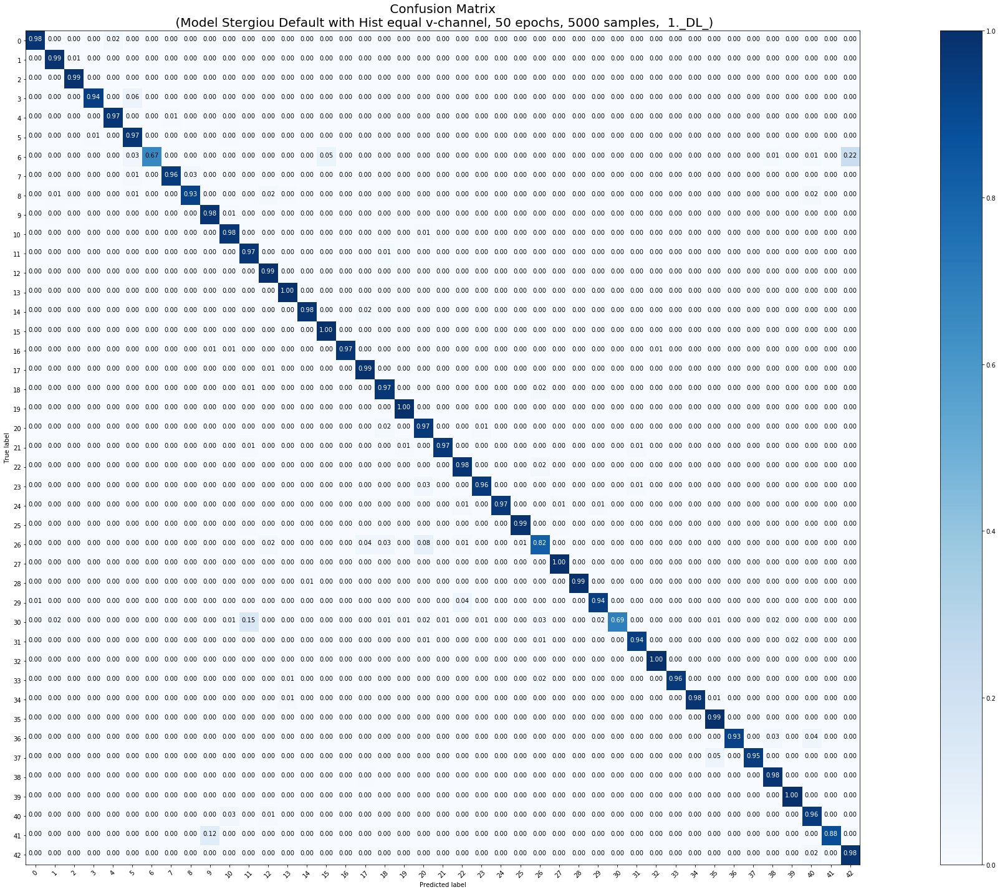

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 29s 6ms/step - loss: 1.5534 - acc: 0.5870 - val_loss: 0.5175 - val_acc: 0.8316
Epoch 2/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.2900 - acc: 0.9042 - val_loss: 0.2259 - val_acc: 0.9398
Epoch 3/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.1388 - acc: 0.9538 - val_loss: 0.2049 - val_acc: 0.9441
Epoch 4/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0702 - acc: 0.9764 - val_loss: 0.1615 - val_acc: 0.9561
Epoch 5/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0776 - acc: 0.9756 - val_loss: 0.1893 - val_acc: 0.9465
Epoch 6/50
5000/5000 [====================

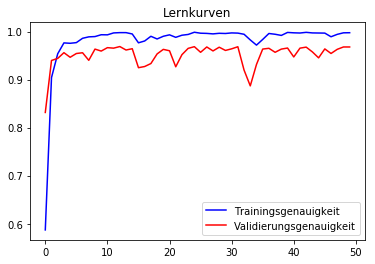

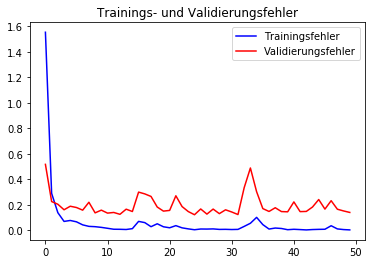

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      0.97      0.97        60
           1       0.98      0.98      0.98       720
           2       0.96      0.99      0.98       750
           3       0.98      0.94      0.96       450
           4       1.00      0.96      0.98       660
           5       0.94      0.97      0.95       630
           6       1.00      0.75      0.85       150
           7       0.97      0.94      0.96       450
           8       0.93      0.96      0.94       450
           9       0.98      0.97      0.98       480
          10       0.96      0.97      0.97       660
          11       0.95      0.96      0.96       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.98      0.99      0.98       210
          16       0.98      0.99      0.98   

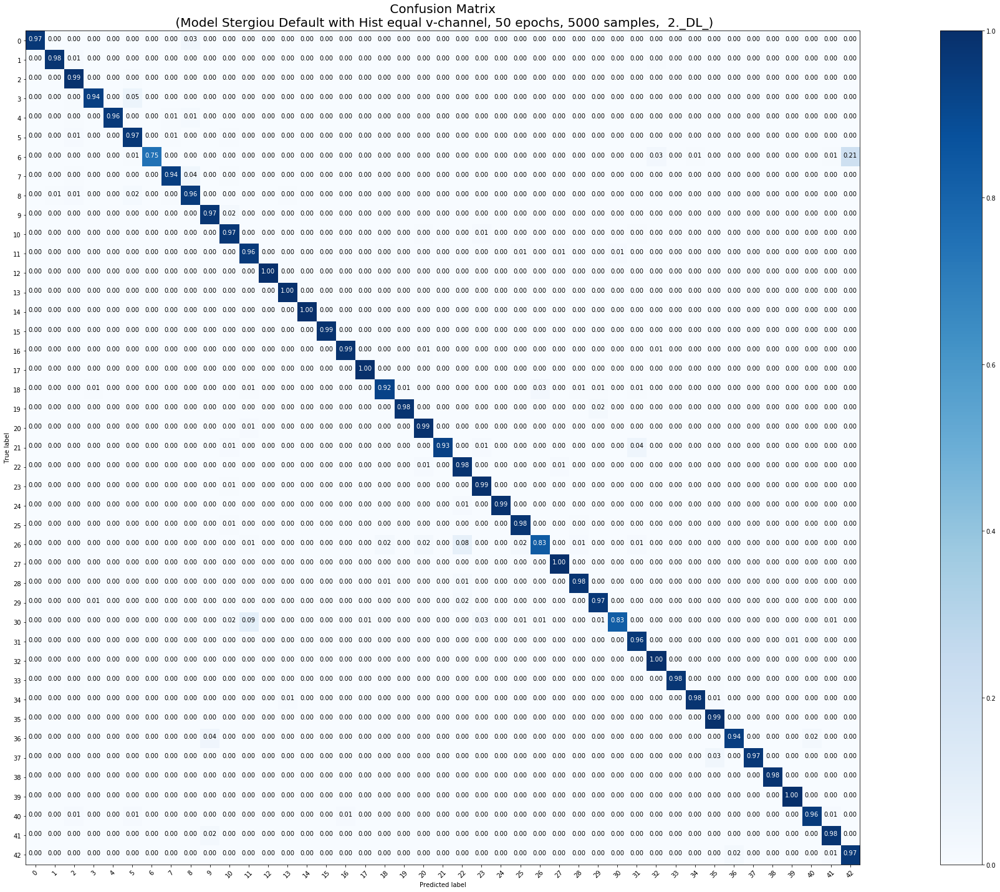

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 30s 6ms/step - loss: 1.5462 - acc: 0.6030 - val_loss: 0.5613 - val_acc: 0.8317
Epoch 2/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.2962 - acc: 0.9080 - val_loss: 0.3561 - val_acc: 0.8987
Epoch 3/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.1526 - acc: 0.9520 - val_loss: 0.1903 - val_acc: 0.9492
Epoch 4/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0690 - acc: 0.9750 - val_loss: 0.1690 - val_acc: 0.9532
Epoch 5/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0599 - acc: 0.9812 - val_loss: 0.1857 - val_acc: 0.9508
Epoch 6/50
5000/5000 [====================

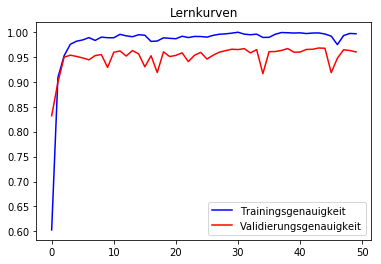

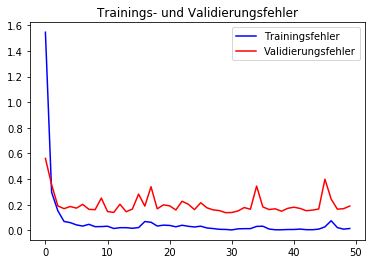

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      0.93      0.95        60
           1       0.98      0.96      0.97       720
           2       0.93      1.00      0.96       750
           3       0.97      0.96      0.97       450
           4       1.00      0.97      0.98       660
           5       0.97      0.93      0.95       630
           6       0.93      0.73      0.82       150
           7       0.96      0.96      0.96       450
           8       0.96      0.93      0.94       450
           9       0.99      0.97      0.98       480
          10       0.98      0.96      0.97       660
          11       0.90      0.97      0.94       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      0.98      0.99       270
          15       0.98      1.00      0.99       210
          16       0.97      0.97      0.97   

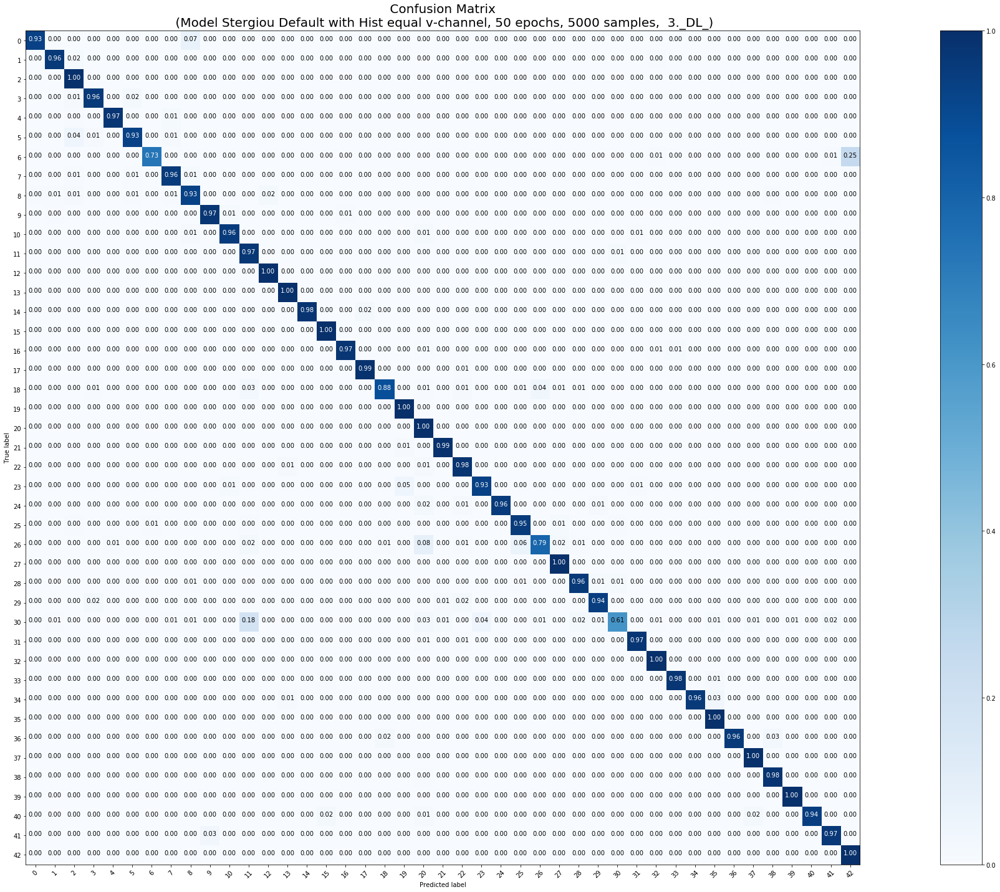

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 30s 6ms/step - loss: 1.5470 - acc: 0.6014 - val_loss: 0.5355 - val_acc: 0.8235
Epoch 2/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.2985 - acc: 0.9034 - val_loss: 0.2860 - val_acc: 0.9213
Epoch 3/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.1778 - acc: 0.9444 - val_loss: 0.2222 - val_acc: 0.9358
Epoch 4/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0973 - acc: 0.9672 - val_loss: 0.2582 - val_acc: 0.9245
Epoch 5/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0516 - acc: 0.9802 - val_loss: 0.1723 - val_acc: 0.9563
Epoch 6/50
5000/5000 [====================

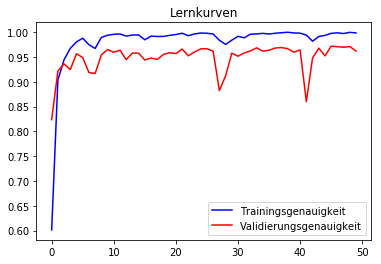

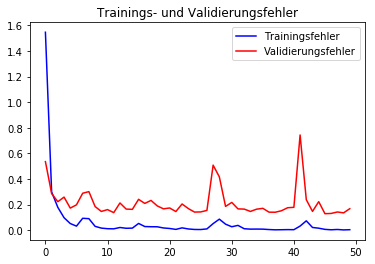

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.96      0.96      0.96       720
           2       0.94      1.00      0.97       750
           3       0.99      0.92      0.95       450
           4       1.00      0.93      0.96       660
           5       0.91      0.95      0.93       630
           6       1.00      0.72      0.84       150
           7       0.92      0.95      0.94       450
           8       0.87      0.96      0.91       450
           9       0.98      0.98      0.98       480
          10       0.95      0.97      0.96       660
          11       0.95      0.96      0.96       420
          12       1.00      0.99      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      0.99      1.00       270
          15       0.98      1.00      0.99       210
          16       0.99      0.97      0.98   

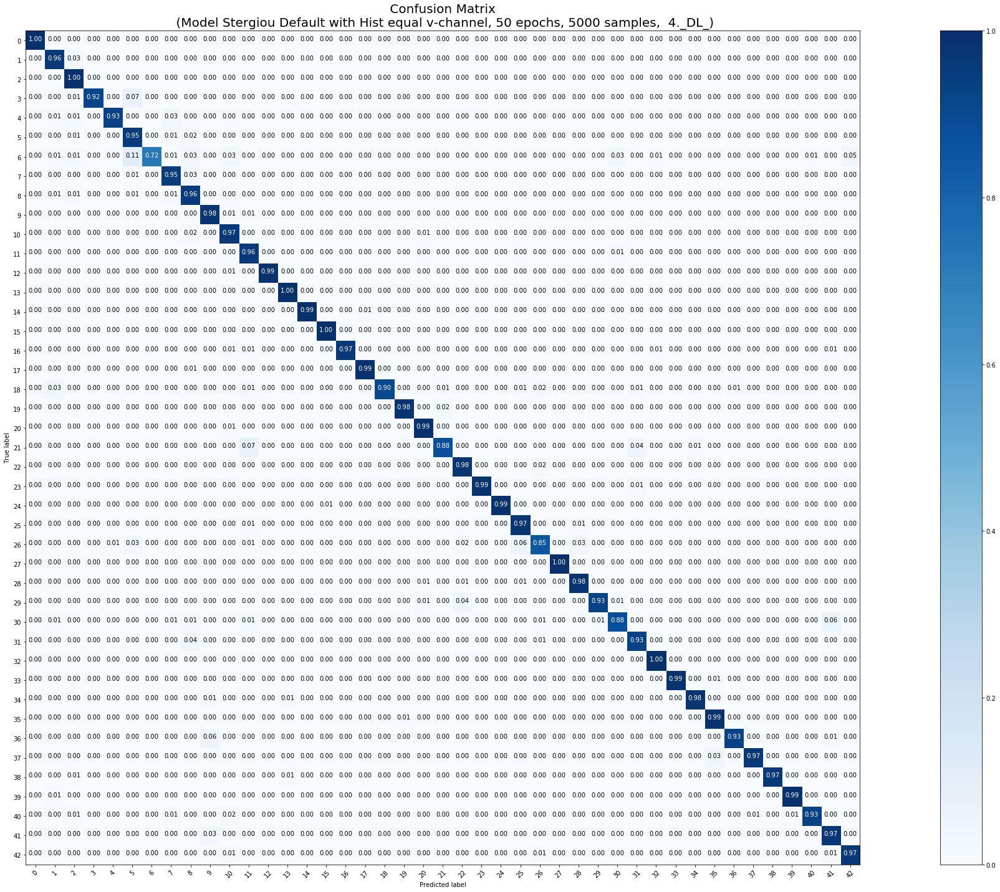

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 32s 6ms/step - loss: 1.4388 - acc: 0.6096 - val_loss: 0.6192 - val_acc: 0.8037
Epoch 2/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.3479 - acc: 0.8878 - val_loss: 0.3102 - val_acc: 0.9083
Epoch 3/50
5000/5000 [==============================] - 7s 1ms/step - loss: 0.1679 - acc: 0.9454 - val_loss: 0.2432 - val_acc: 0.9329
Epoch 4/50
5000/5000 [==============================] - 7s 1ms/step - loss: 0.0716 - acc: 0.9726 - val_loss: 0.2133 - val_acc: 0.9405
Epoch 5/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0668 - acc: 0.9794 - val_loss: 0.2173 - val_acc: 0.9403
Epoch 6/50
5000/5000 [====================

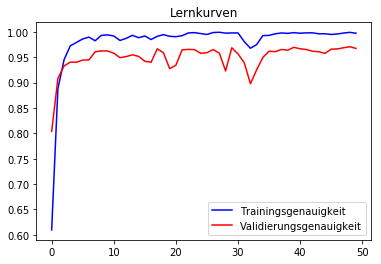

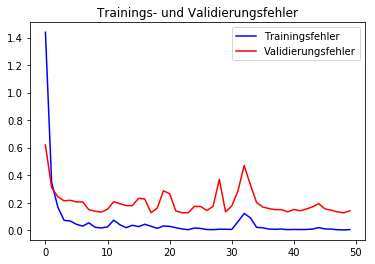

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      1.00      0.98        60
           1       0.99      0.97      0.98       720
           2       0.99      0.99      0.99       750
           3       0.98      0.94      0.96       450
           4       0.98      0.98      0.98       660
           5       0.92      0.97      0.94       630
           6       1.00      0.79      0.88       150
           7       0.98      0.96      0.97       450
           8       0.96      0.94      0.95       450
           9       0.98      0.99      0.98       480
          10       0.97      0.98      0.97       660
          11       0.99      0.94      0.96       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.98      0.97      0.98   

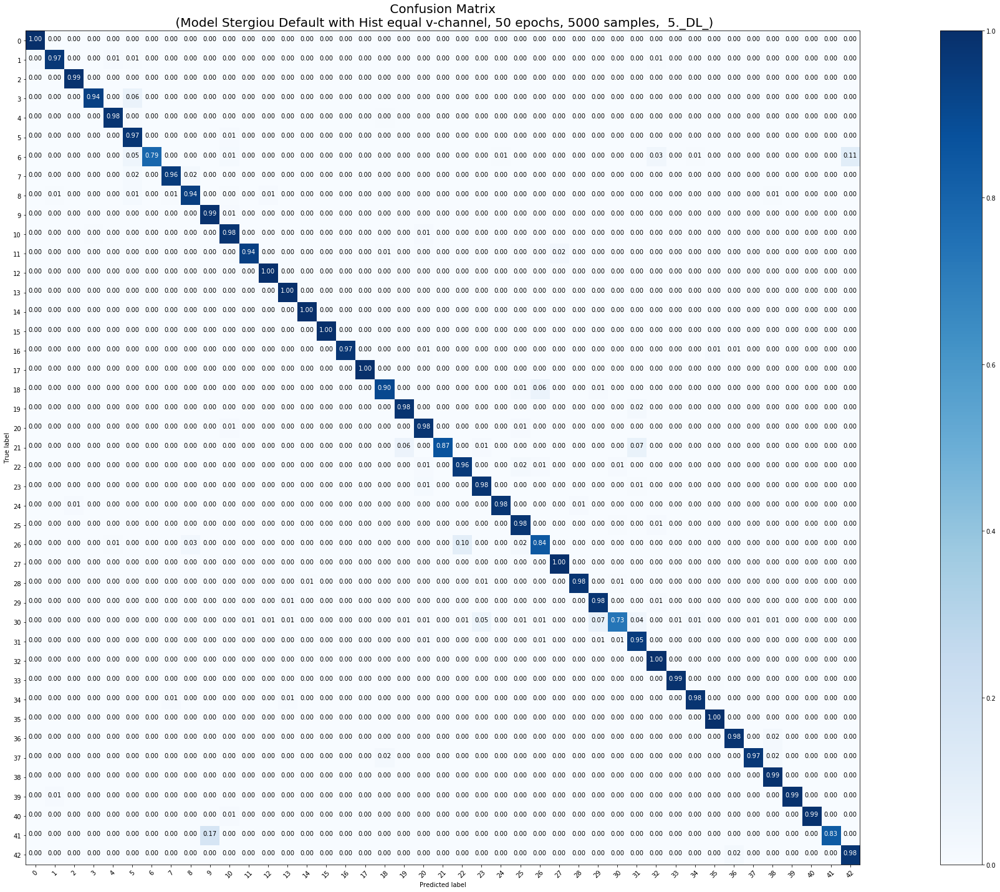

<Figure size 432x288 with 0 Axes>

In [0]:
### 5000, A, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_5000, y_tr_5000, X_test, y_test, 50, 5000)

In [0]:
downloaderCW(5000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
categorical crossentropy


Training ohne Klassengewichte beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 16s 2ms/step - loss: 0.6673 - acc: 0.8206 - val_loss: 0.1738 - val_acc: 0.9486
Epoch 2/50
10000/10000 [==============================] - 7s 741us/step - loss: 0.1213 - acc: 0.9680 - val_loss: 0.1780 - val_acc: 0.9485
Epoch 3/50
10000/10000 [==============================] - 7s 729us/step - loss: 0.0658 - acc: 0.9807 - val_loss: 0.1808 - val_acc: 0.9470
Epoch 4/50
10000/10000 [==============================] - 7s 721us/step - loss: 0

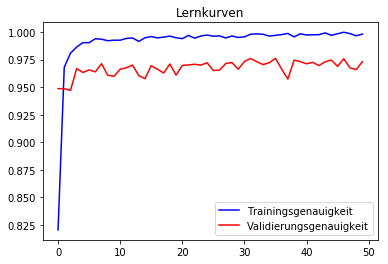

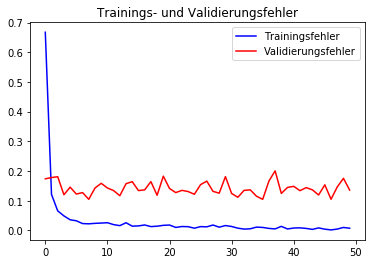

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.93      0.97        60
           1       0.99      0.99      0.99       720
           2       0.99      0.99      0.99       750
           3       0.98      0.94      0.96       450
           4       1.00      0.98      0.99       660
           5       0.90      0.97      0.94       630
           6       1.00      0.71      0.83       150
           7       0.98      0.98      0.98       450
           8       0.95      0.97      0.96       450
           9       0.98      1.00      0.99       480
          10       0.99      0.99      0.99       660
          11       0.97      0.99      0.98       420
          12       1.00      0.99      1.00       690
          13       0.99      1.00      1.00       720
          14       0.99      1.00      0.99       270
          15       1.00      0.99      1.00       210
          16       0.97      0.99      0.98   

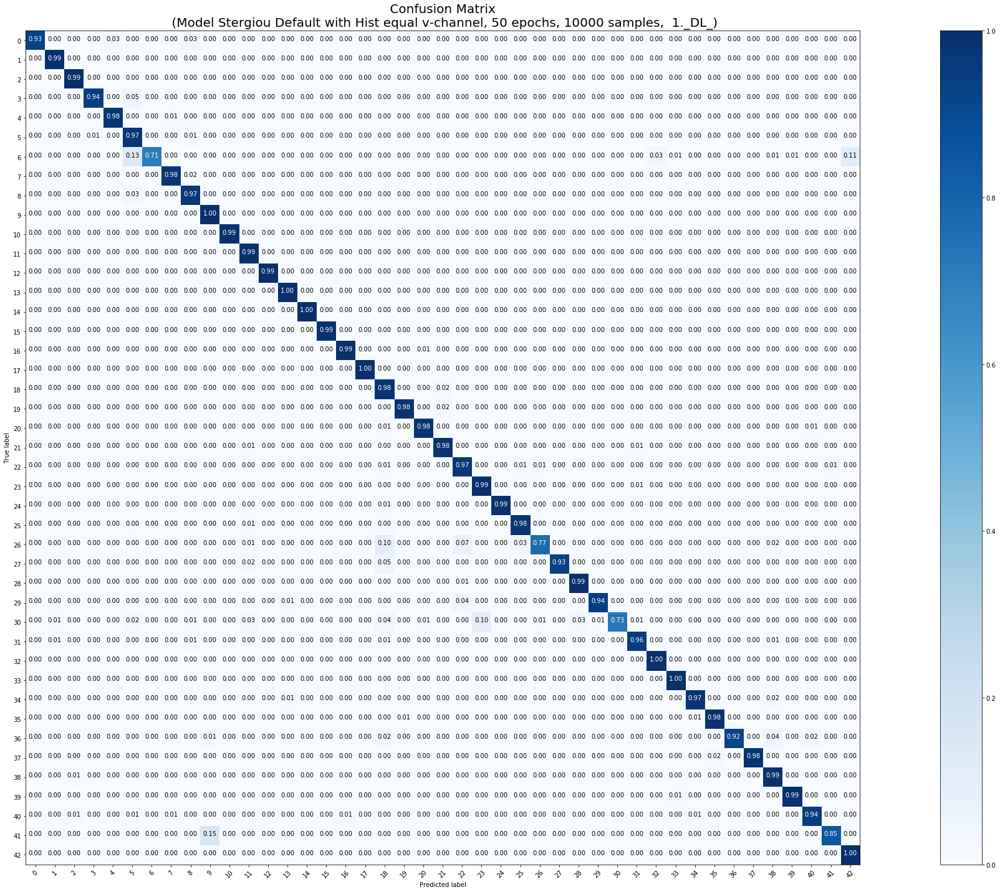

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 10s 973us/step - loss: 0.6774 - acc: 0.8161 - val_loss: 0.2040 - val_acc: 0.9459
Epoch 2/50
10000/10000 [==============================] - 7s 742us/step - loss: 0.1263 - acc: 0.9655 - val_loss: 0.1675 - val_acc: 0.9517
Epoch 3/50
10000/10000 [==============================] - 7s 749us/step - loss: 0.0696 - acc: 0.9805 - val_loss: 0.1531 - val_acc: 0.9595
Epoch 4/50
10000/10000 [==============================] - 7s 744us/step - loss: 0.0417 - acc: 0.9889 - val_loss: 0.1976 - val_acc: 0.9447
Epoch 5/50
10000/10000 [==============================] - 7s 746us/step - loss: 0.0352 - acc: 0.9886 - val_loss: 0.1334 - val_acc: 0.9637
Epoch 6/50
10000/10000 [==

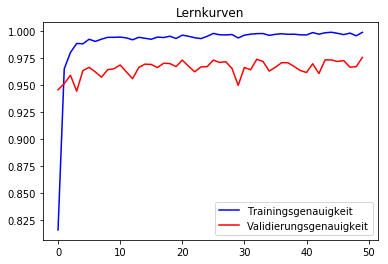

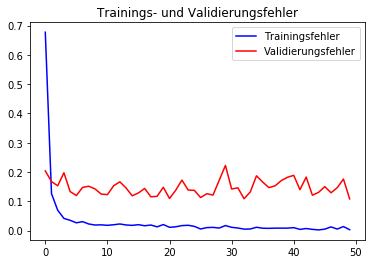

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.95      0.97        60
           1       0.96      0.99      0.98       720
           2       0.99      0.99      0.99       750
           3       0.98      0.95      0.97       450
           4       0.99      0.98      0.99       660
           5       0.94      0.97      0.96       630
           6       0.98      0.77      0.87       150
           7       0.98      0.96      0.97       450
           8       0.94      0.98      0.96       450
           9       0.97      0.99      0.98       480
          10       1.00      0.98      0.99       660
          11       0.99      0.99      0.99       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.99      0.99      0.99   

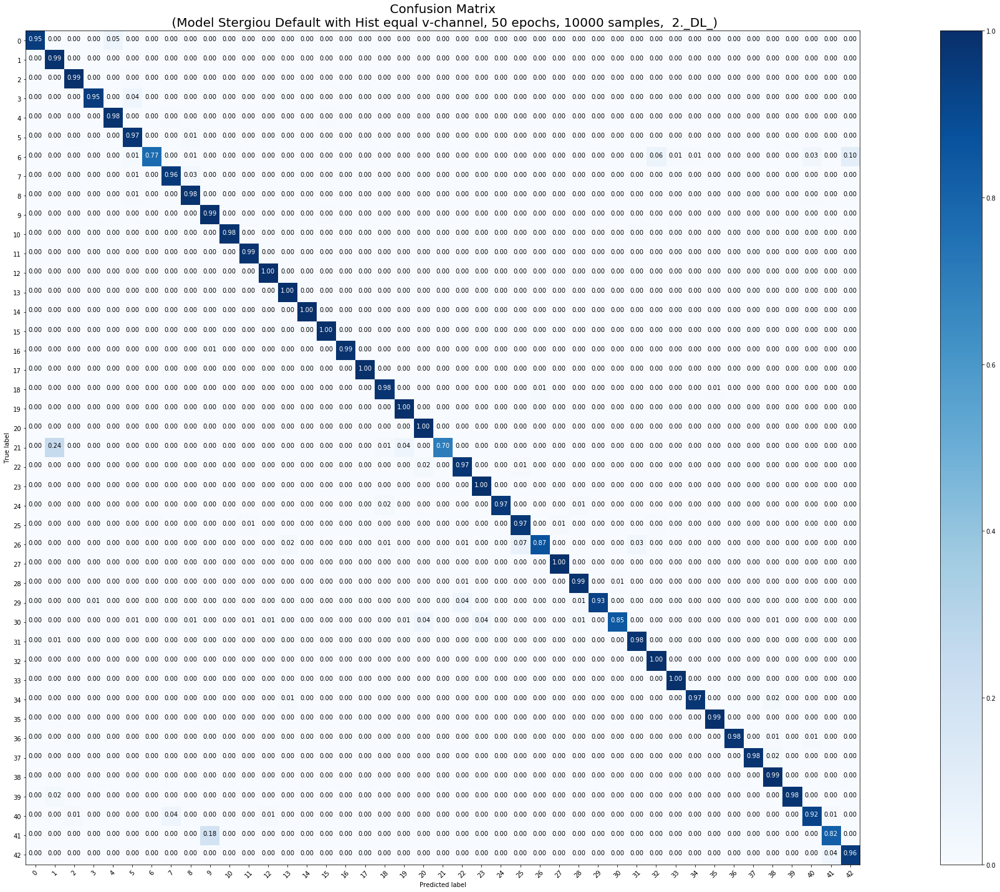

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 10s 993us/step - loss: 0.6466 - acc: 0.8230 - val_loss: 0.2136 - val_acc: 0.9399
Epoch 2/50
10000/10000 [==============================] - 7s 736us/step - loss: 0.1342 - acc: 0.9605 - val_loss: 0.1713 - val_acc: 0.9520
Epoch 3/50
10000/10000 [==============================] - 7s 735us/step - loss: 0.0735 - acc: 0.9776 - val_loss: 0.2063 - val_acc: 0.9404
Epoch 4/50
10000/10000 [==============================] - 8s 766us/step - loss: 0.0450 - acc: 0.9869 - val_loss: 0.1266 - val_acc: 0.9671
Epoch 5/50
10000/10000 [==============================] - 7s 739us/step - loss: 0.0255 - acc: 0.9928 - val_loss: 0.1360 - val_acc: 0.9642
Epoch 6/50
10000/10000 [==

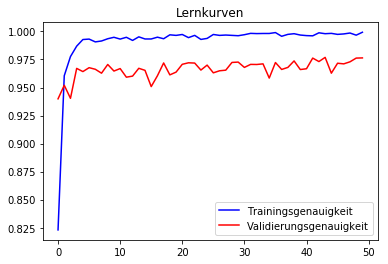

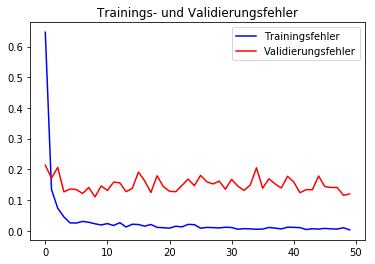

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.98      0.98        60
           1       0.98      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       0.98      0.97      0.97       450
           4       1.00      0.99      0.99       660
           5       0.97      0.96      0.96       630
           6       0.99      0.87      0.93       150
           7       0.99      0.97      0.98       450
           8       0.98      0.98      0.98       450
           9       0.97      1.00      0.98       480
          10       0.99      0.99      0.99       660
          11       0.96      0.97      0.96       420
          12       0.98      0.99      0.98       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.96      0.99      0.98       210
          16       0.99      0.99      0.99   

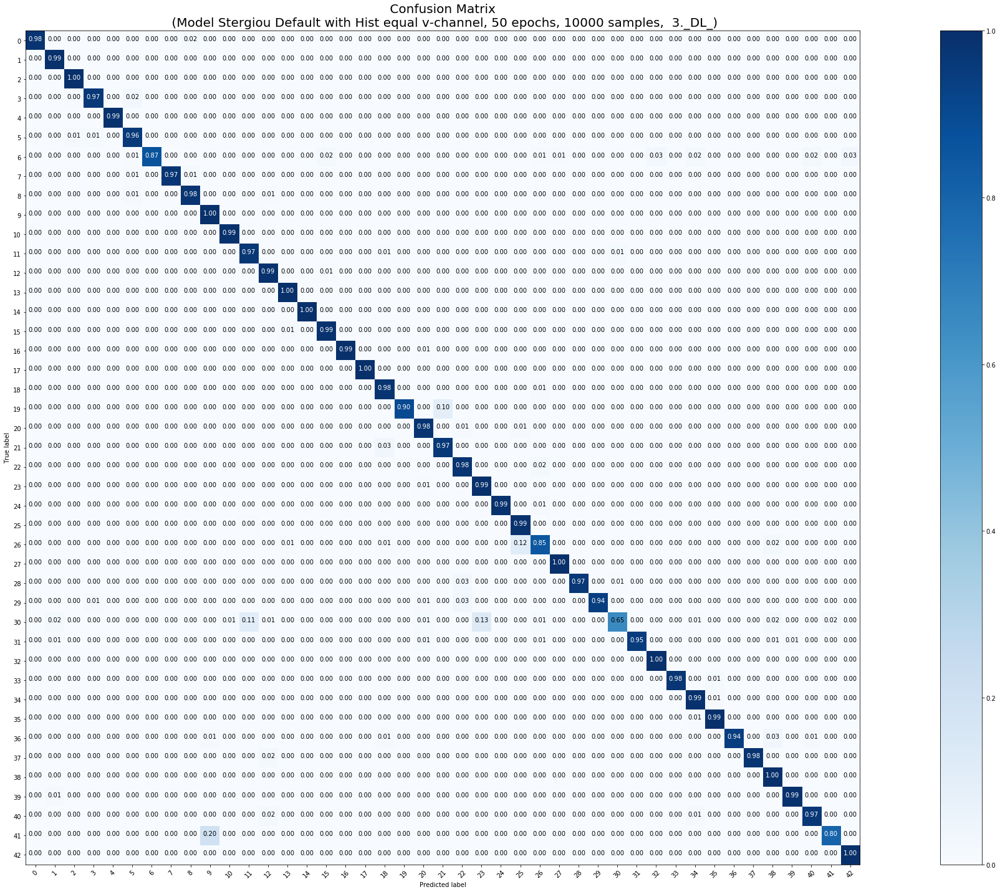

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 10s 1ms/step - loss: 0.6581 - acc: 0.8242 - val_loss: 0.2357 - val_acc: 0.9323
Epoch 2/50
10000/10000 [==============================] - 7s 732us/step - loss: 0.1069 - acc: 0.9719 - val_loss: 0.1980 - val_acc: 0.9433
Epoch 3/50
10000/10000 [==============================] - 7s 736us/step - loss: 0.0657 - acc: 0.9811 - val_loss: 0.2130 - val_acc: 0.9413
Epoch 4/50
10000/10000 [==============================] - 8s 751us/step - loss: 0.0478 - acc: 0.9857 - val_loss: 0.1467 - val_acc: 0.9580
Epoch 5/50
10000/10000 [==============================] - 7s 731us/step - loss: 0.0304 - acc: 0.9921 - val_loss: 0.1240 - val_acc: 0.9668
Epoch 6/50
10000/10000 [====

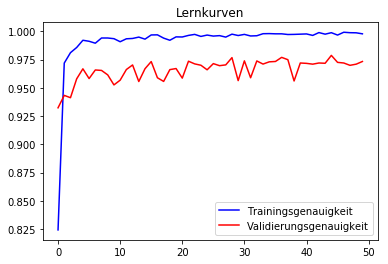

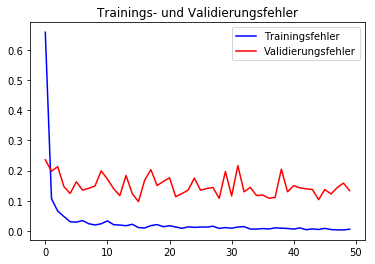

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       1.00      0.98      0.99       720
           2       0.99      1.00      0.99       750
           3       0.98      0.98      0.98       450
           4       0.99      0.98      0.98       660
           5       0.94      0.97      0.96       630
           6       0.99      0.81      0.89       150
           7       0.99      0.98      0.98       450
           8       0.98      0.97      0.97       450
           9       0.95      1.00      0.97       480
          10       0.99      0.99      0.99       660
          11       0.98      0.97      0.97       420
          12       1.00      1.00      1.00       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      0.99       210
          16       0.98      0.97      0.97   

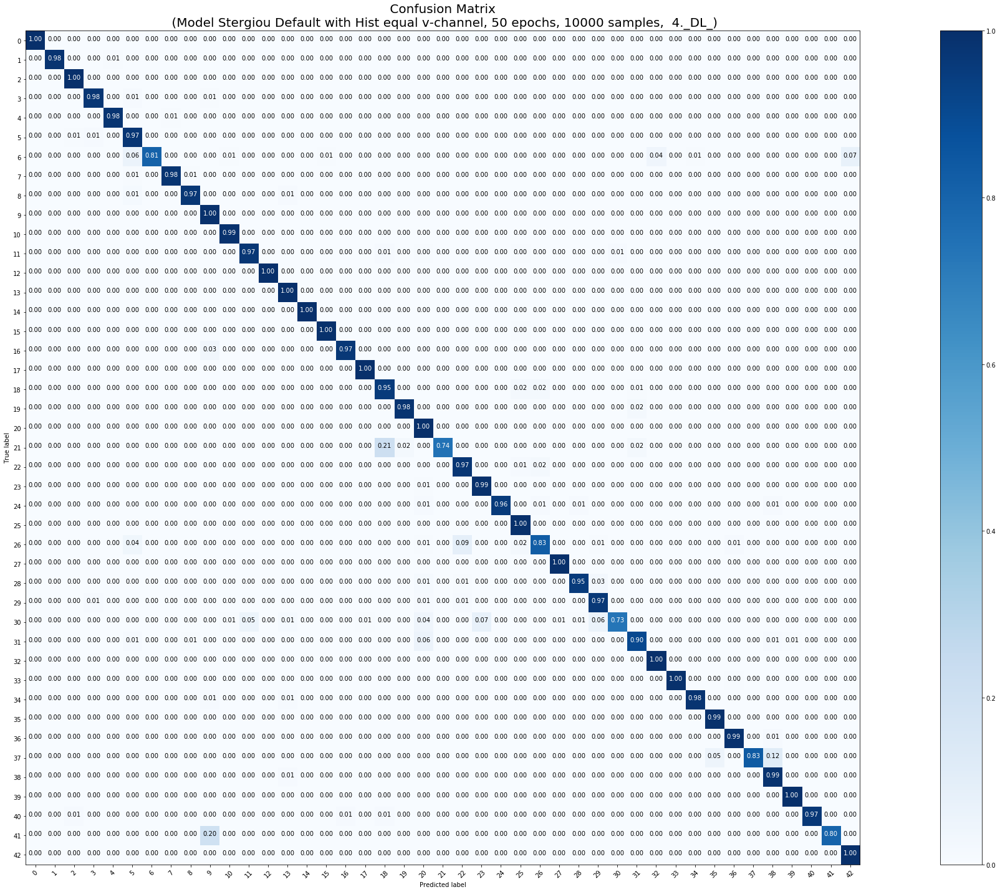

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 11s 1ms/step - loss: 0.6443 - acc: 0.8217 - val_loss: 0.1799 - val_acc: 0.9504
Epoch 2/50
10000/10000 [==============================] - 8s 752us/step - loss: 0.1185 - acc: 0.9654 - val_loss: 0.1991 - val_acc: 0.9477
Epoch 3/50
10000/10000 [==============================] - 7s 743us/step - loss: 0.0628 - acc: 0.9828 - val_loss: 0.1589 - val_acc: 0.9601
Epoch 4/50
10000/10000 [==============================] - 8s 752us/step - loss: 0.0489 - acc: 0.9845 - val_loss: 0.2417 - val_acc: 0.9437
Epoch 5/50
10000/10000 [==============================] - 8s 753us/step - loss: 0.0358 - acc: 0.9904 - val_loss: 0.1164 - val_acc: 0.9700
Epoch 6/50
10000/10000 [====

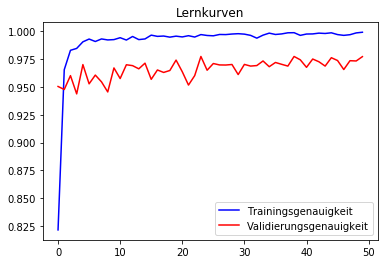

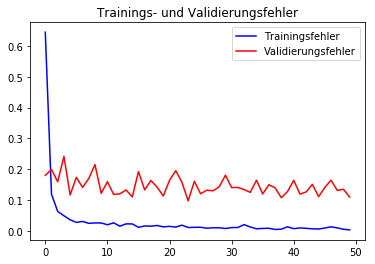

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.97      0.98        60
           1       0.98      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       0.98      0.98      0.98       450
           4       1.00      0.98      0.99       660
           5       0.93      0.98      0.95       630
           6       1.00      0.69      0.82       150
           7       1.00      0.96      0.98       450
           8       0.98      0.95      0.96       450
           9       0.98      1.00      0.99       480
          10       1.00      0.99      0.99       660
          11       0.98      0.98      0.98       420
          12       0.98      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       1.00      0.99      0.99   

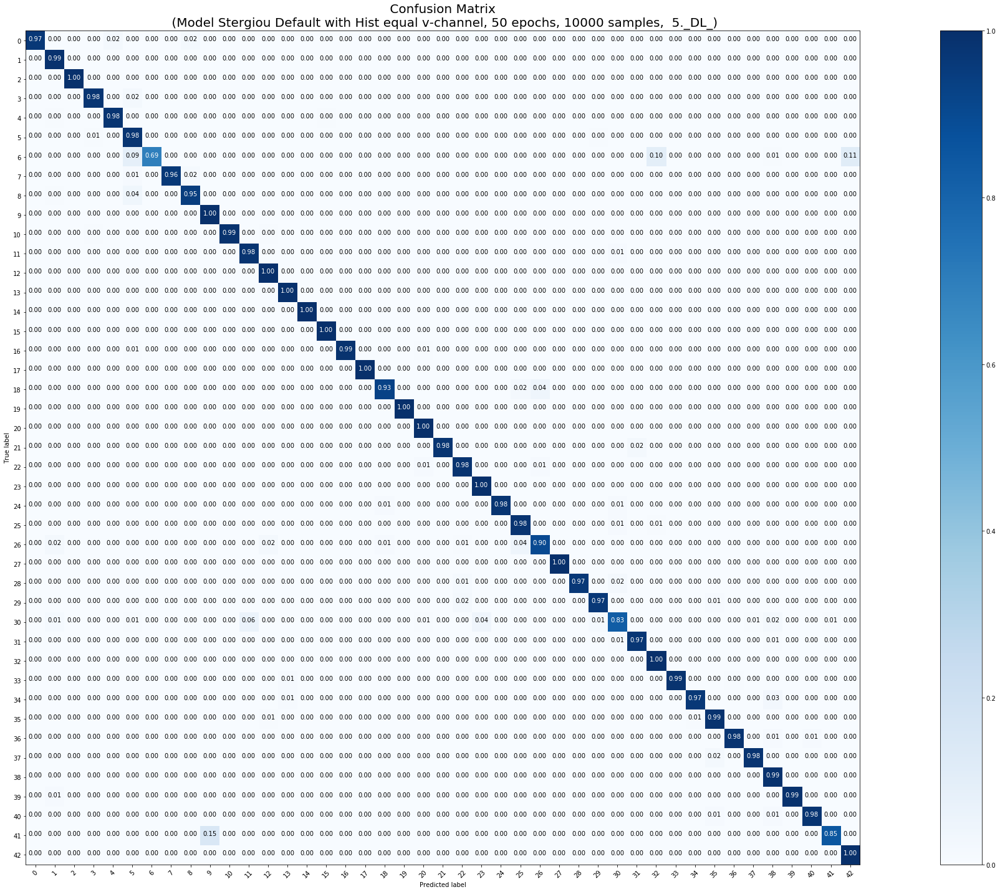

<Figure size 432x288 with 0 Axes>

In [0]:
### 10000, A, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_10000, y_tr_10000, X_test, y_test, 50, 10000)

In [0]:
downloader(10000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
sparse categorical crossentropy


Training mit Klassengewichten beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 14s 1ms/step - loss: 0.9395 - acc: 0.7443 - val_loss: 0.2508 - val_acc: 0.9283
Epoch 2/50
10000/10000 [==============================] - 6s 617us/step - loss: 0.1551 - acc: 0.9530 - val_loss: 0.2700 - val_acc: 0.9249
Epoch 3/50
10000/10000 [==============================] - 6s 612us/step - loss: 0.0784 - acc: 0.9729 - val_loss: 0.1671 - val_acc: 0.9550
Epoch 4/50
10000/10000 [==============================] - 6s 613us/step - l

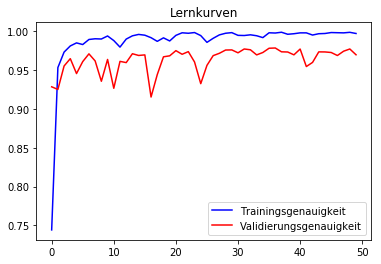

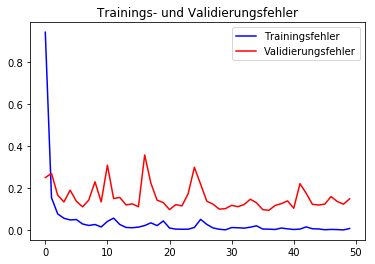

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.98      0.99      0.99       720
           2       0.98      1.00      0.99       750
           3       0.97      0.95      0.96       450
           4       1.00      0.98      0.99       660
           5       0.88      0.98      0.93       630
           6       1.00      0.68      0.81       150
           7       0.96      0.97      0.97       450
           8       0.99      0.90      0.94       450
           9       0.97      1.00      0.98       480
          10       0.99      0.99      0.99       660
          11       0.96      0.97      0.97       420
          12       0.99      0.99      0.99       690
          13       0.99      0.99      0.99       720
          14       0.99      1.00      1.00       270
          15       0.94      1.00      0.97       210
          16       0.99      0.99      0.99   

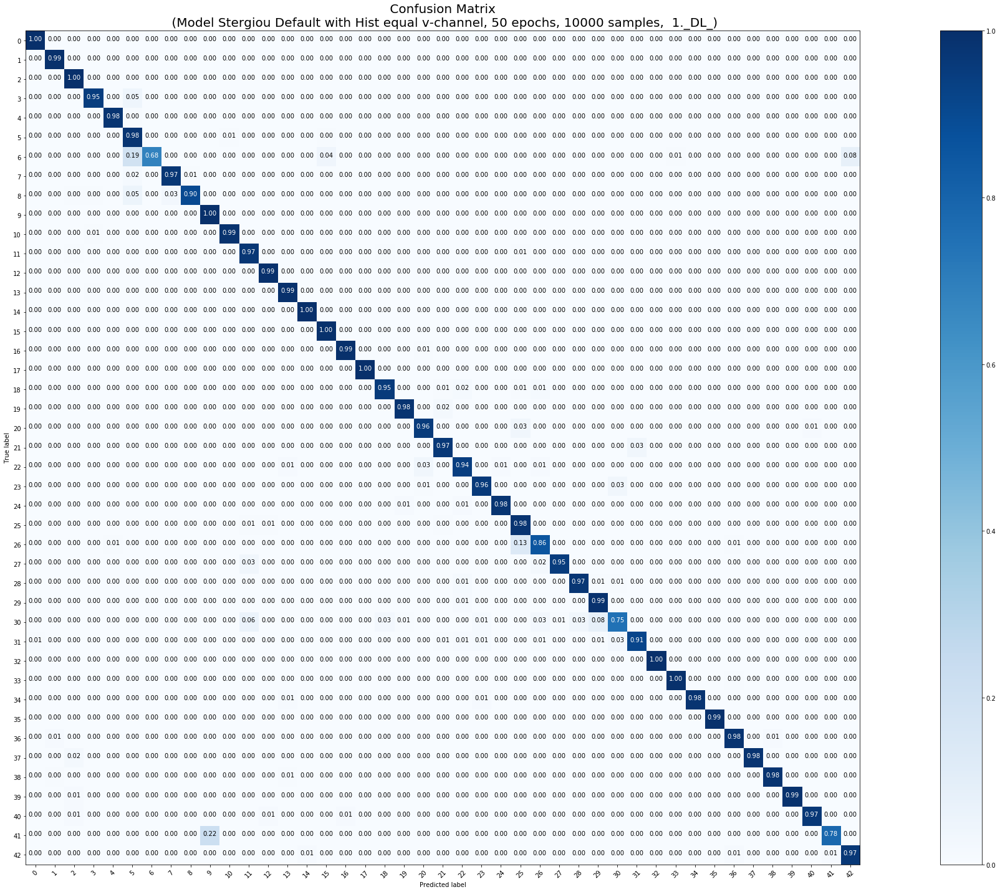

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 8s 804us/step - loss: 0.9817 - acc: 0.7320 - val_loss: 0.3249 - val_acc: 0.9087
Epoch 2/50
10000/10000 [==============================] - 6s 619us/step - loss: 0.1503 - acc: 0.9497 - val_loss: 0.2346 - val_acc: 0.9296
Epoch 3/50
10000/10000 [==============================] - 6s 622us/step - loss: 0.0833 - acc: 0.9708 - val_loss: 0.1571 - val_acc: 0.9582
Epoch 4/50
10000/10000 [==============================] - 6s 627us/step - loss: 0.0572 - acc: 0.9807 - val_loss: 0.1511 - val_acc: 0.9609
Epoch 5/50
10000/10000 [==============================] - 6s 622us/step - loss: 0.0542 - acc: 0.9798 - val_loss: 0.1762 - val_acc: 0.9480
Epoch 6/50
10000/1000

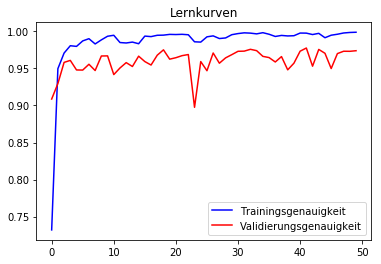

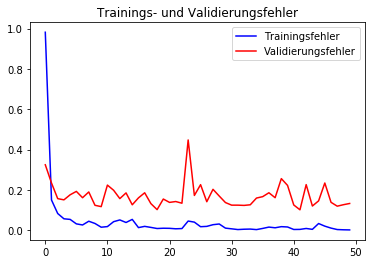

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.98      0.99       720
           2       0.99      0.99      0.99       750
           3       0.97      0.98      0.98       450
           4       1.00      0.99      0.99       660
           5       0.90      0.98      0.94       630
           6       0.99      0.67      0.80       150
           7       1.00      0.96      0.98       450
           8       0.97      0.94      0.95       450
           9       0.99      0.98      0.98       480
          10       1.00      0.98      0.99       660
          11       0.95      0.97      0.96       420
          12       1.00      0.99      1.00       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       1.00      0.99      0.99       210
          16       0.97      0.99      0.98   

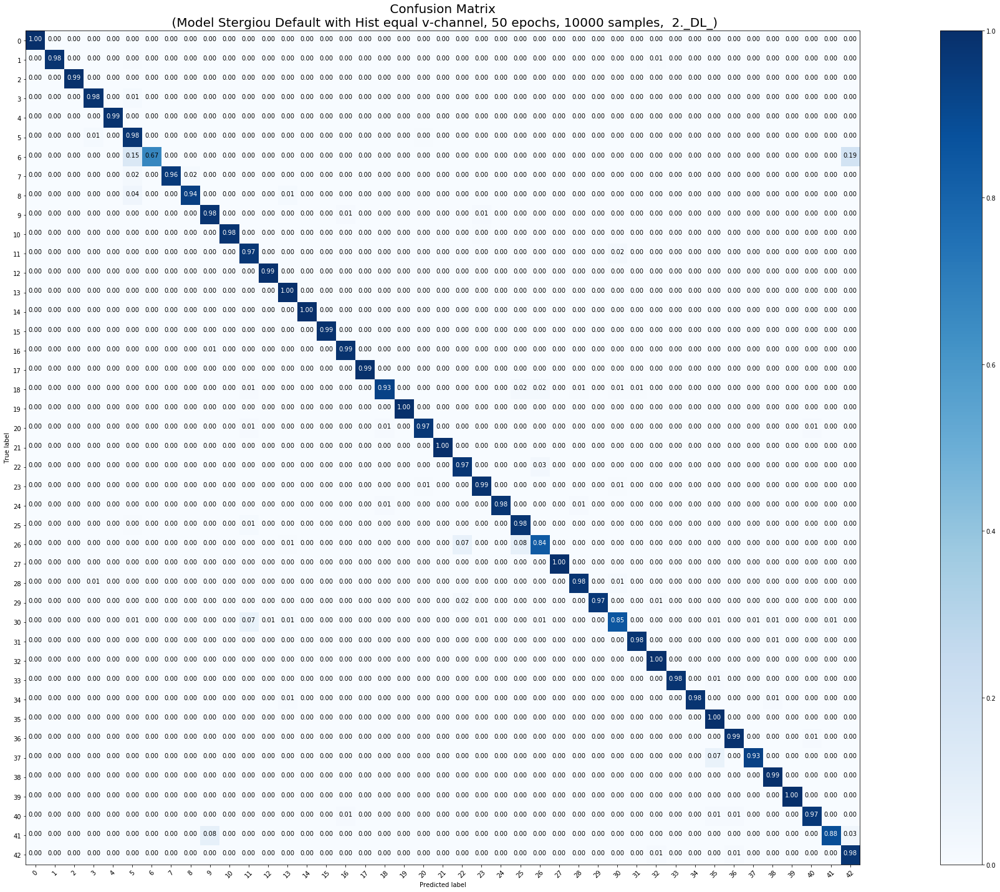

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 8s 820us/step - loss: 1.0048 - acc: 0.7307 - val_loss: 0.3855 - val_acc: 0.8890
Epoch 2/50
10000/10000 [==============================] - 6s 625us/step - loss: 0.1573 - acc: 0.9463 - val_loss: 0.2765 - val_acc: 0.9247
Epoch 3/50
10000/10000 [==============================] - 6s 621us/step - loss: 0.0928 - acc: 0.9682 - val_loss: 0.1655 - val_acc: 0.9512
Epoch 4/50
10000/10000 [==============================] - 6s 631us/step - loss: 0.0464 - acc: 0.9823 - val_loss: 0.1471 - val_acc: 0.9569
Epoch 5/50
10000/10000 [==============================] - 6s 616us/step - loss: 0.0383 - acc: 0.9869 - val_loss: 0.1396 - val_acc: 0.9614
Epoch 6/50
10000/1000

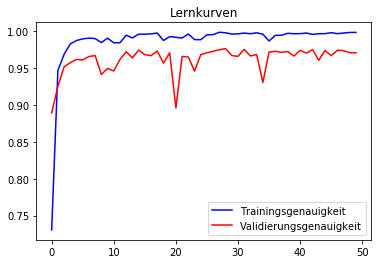

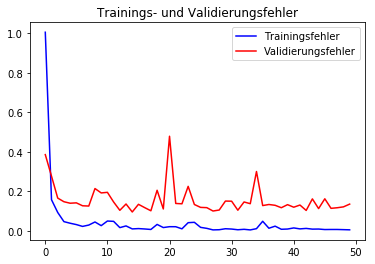

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.98      0.98      0.98       720
           2       0.94      0.99      0.97       750
           3       0.99      0.94      0.96       450
           4       1.00      0.97      0.99       660
           5       0.96      0.94      0.95       630
           6       1.00      0.77      0.87       150
           7       0.97      0.96      0.97       450
           8       0.96      0.98      0.97       450
           9       0.95      0.99      0.97       480
          10       0.98      0.98      0.98       660
          11       0.98      0.97      0.97       420
          12       1.00      0.98      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.89      1.00      0.94       210
          16       0.99      0.99      0.99   

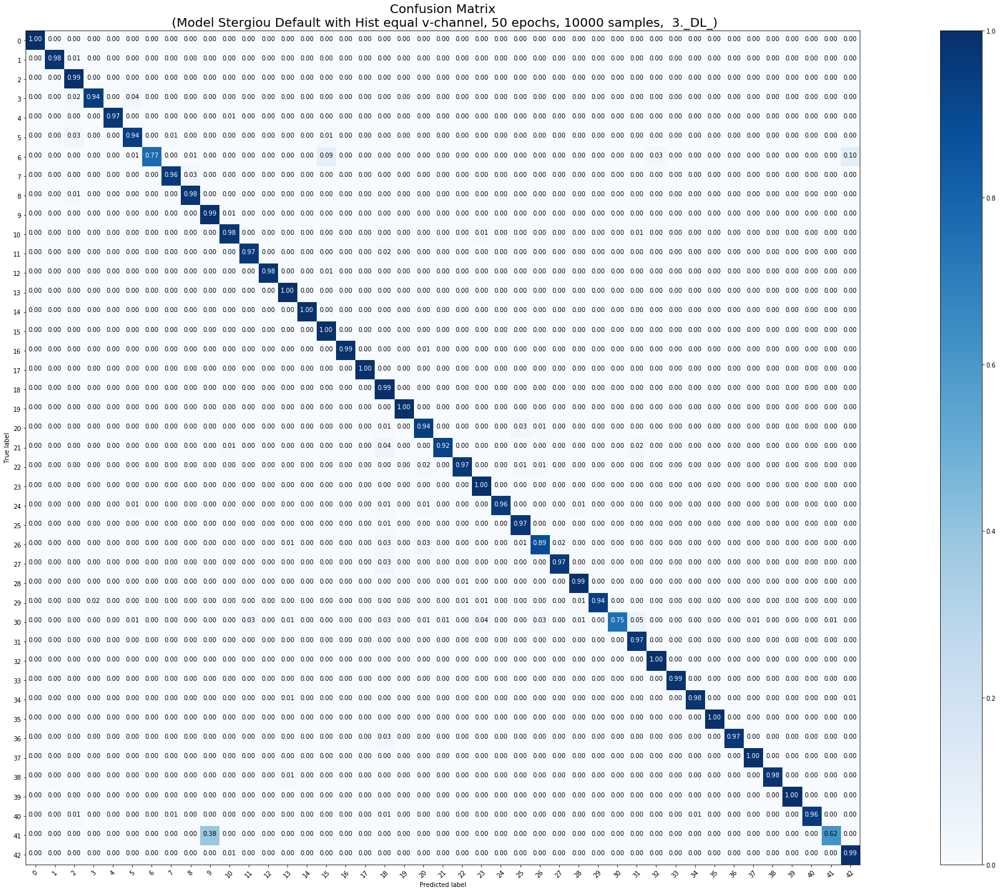

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 9s 867us/step - loss: 1.0157 - acc: 0.7403 - val_loss: 0.3023 - val_acc: 0.9169
Epoch 2/50
10000/10000 [==============================] - 6s 632us/step - loss: 0.1472 - acc: 0.9550 - val_loss: 0.1507 - val_acc: 0.9569
Epoch 3/50
10000/10000 [==============================] - 6s 626us/step - loss: 0.0871 - acc: 0.9703 - val_loss: 0.1628 - val_acc: 0.9522
Epoch 4/50
10000/10000 [==============================] - 6s 629us/step - loss: 0.0621 - acc: 0.9794 - val_loss: 0.1649 - val_acc: 0.9521
Epoch 5/50
10000/10000 [==============================] - 6s 625us/step - loss: 0.0386 - acc: 0.9859 - val_loss: 0.2133 - val_acc: 0.9381
Epoch 6/50
10000/1000

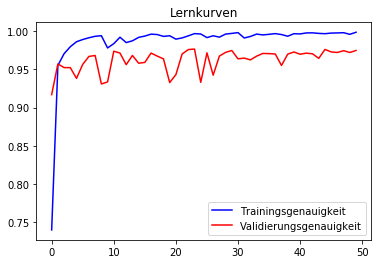

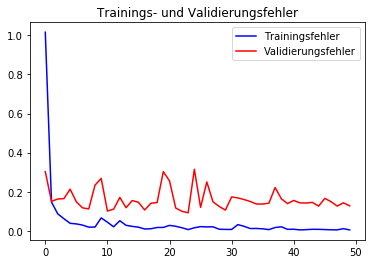

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.99      0.98      0.99       720
           2       0.98      0.99      0.99       750
           3       0.96      0.96      0.96       450
           4       0.99      0.99      0.99       660
           5       0.96      0.97      0.97       630
           6       0.98      0.86      0.92       150
           7       0.99      0.98      0.98       450
           8       0.99      0.93      0.96       450
           9       0.99      0.99      0.99       480
          10       0.99      0.98      0.99       660
          11       0.97      0.96      0.96       420
          12       0.97      0.98      0.97       690
          13       0.99      1.00      0.99       720
          14       0.99      1.00      1.00       270
          15       0.93      1.00      0.96       210
          16       0.99      0.98      0.98   

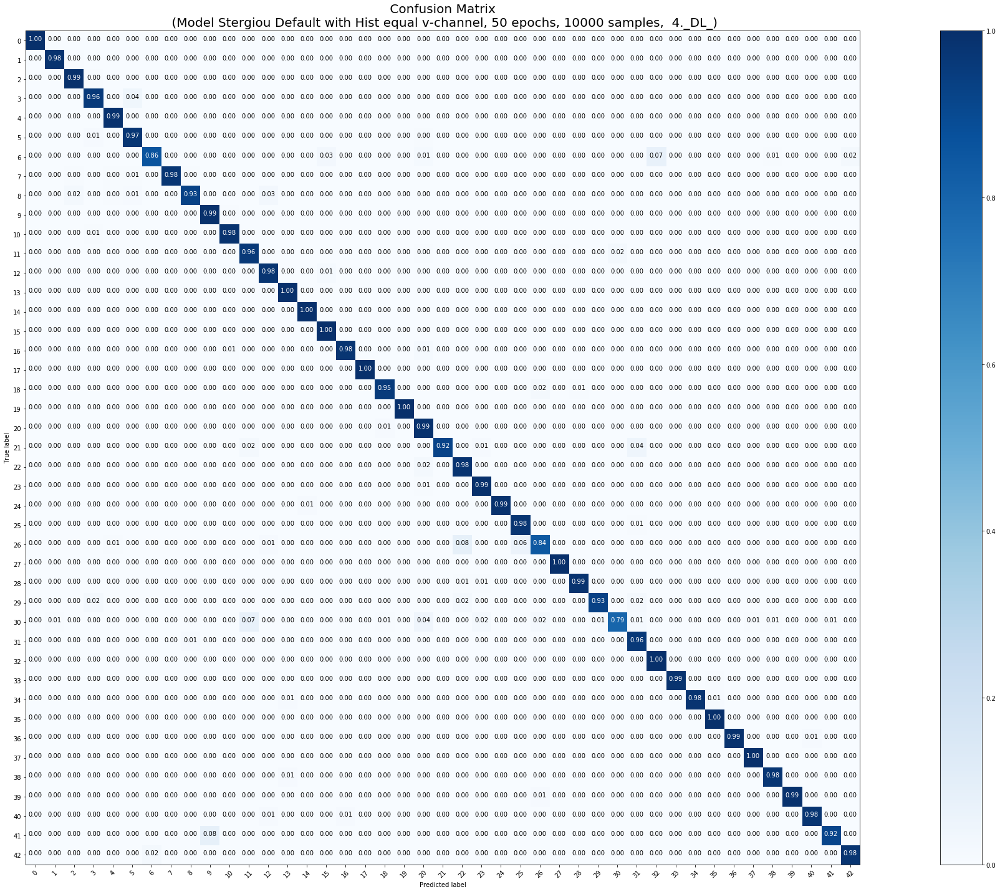

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 9s 889us/step - loss: 1.0066 - acc: 0.7295 - val_loss: 0.3824 - val_acc: 0.8915
Epoch 2/50
10000/10000 [==============================] - 6s 626us/step - loss: 0.1690 - acc: 0.9465 - val_loss: 0.2483 - val_acc: 0.9257
Epoch 3/50
10000/10000 [==============================] - 6s 625us/step - loss: 0.0867 - acc: 0.9721 - val_loss: 0.1690 - val_acc: 0.9532
Epoch 4/50
10000/10000 [==============================] - 6s 626us/step - loss: 0.0689 - acc: 0.9760 - val_loss: 0.1466 - val_acc: 0.9617
Epoch 5/50
10000/10000 [==============================] - 6s 623us/step - loss: 0.0407 - acc: 0.9851 - val_loss: 0.1840 - val_acc: 0.9505
Epoch 6/50
10000/1000

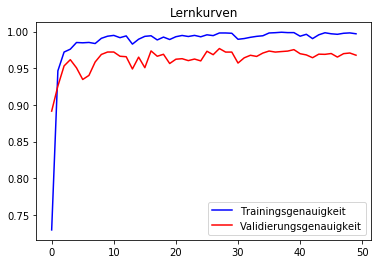

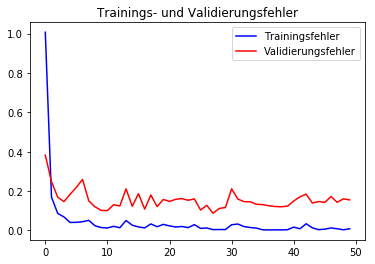

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.98      0.98        60
           1       0.98      0.98      0.98       720
           2       0.99      0.99      0.99       750
           3       0.95      0.98      0.96       450
           4       0.99      0.98      0.99       660
           5       0.92      0.95      0.93       630
           6       0.99      0.71      0.83       150
           7       0.98      0.97      0.98       450
           8       0.96      0.94      0.95       450
           9       0.93      1.00      0.96       480
          10       1.00      0.93      0.96       660
          11       0.96      0.98      0.97       420
          12       0.99      0.98      0.98       690
          13       0.98      1.00      0.99       720
          14       0.97      1.00      0.98       270
          15       0.89      1.00      0.94       210
          16       1.00      0.99      0.99   

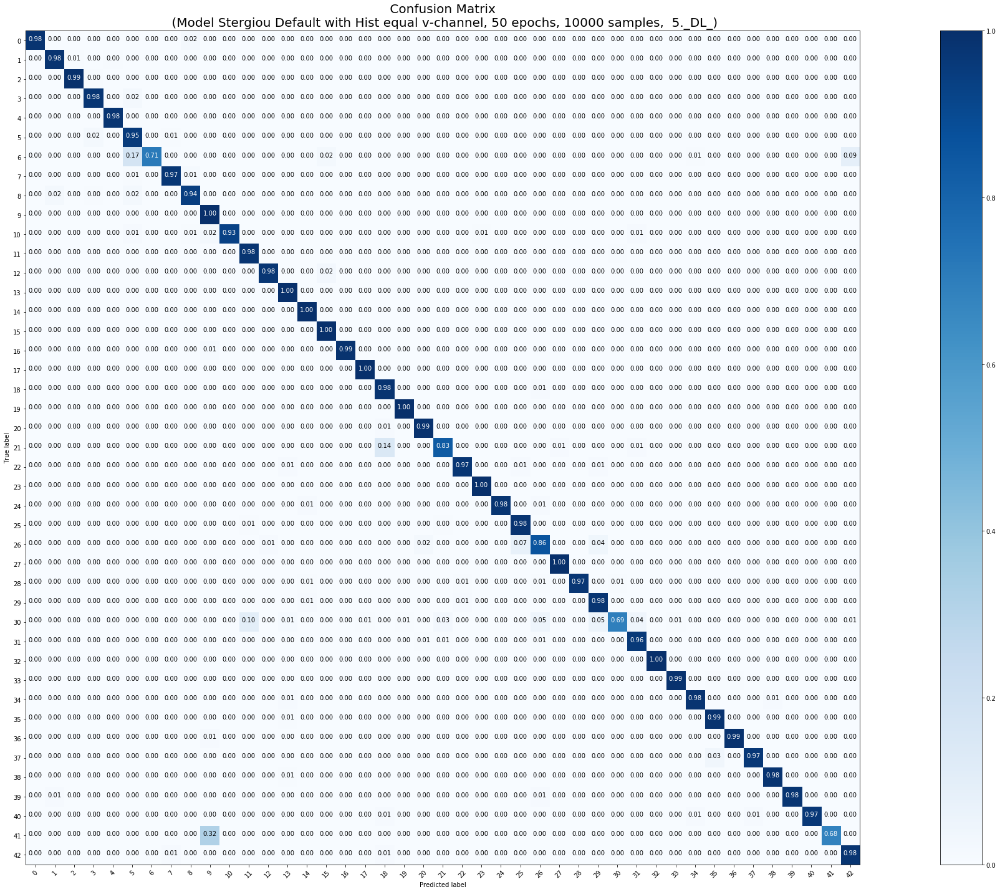

<Figure size 432x288 with 0 Axes>

In [0]:
### 10000, A, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_10000, y_tr_10000, X_test, y_test, 50, 10000)

In [0]:
downloaderCW(10000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 17s 831us/step - loss: 0.4168 - acc: 0.8880 - val_loss: 0.1399 - val_acc: 0.9599
Epoch 2/50
20000/20000 [==============================] - 13s 648us/step - loss: 0.0761 - acc: 0.9787 - val_loss: 0.1305 - val_acc: 0.9637
Epoch 3/50
20000/20000 [==============================] - 13s 649us/step - loss: 0.0502 - acc: 0.9865 - val_loss: 0.1016 - val_acc: 0.9717
Epoch 4/50
20000/20000 [==============================] - 13s 659us/step - loss: 0.0365 - acc: 0.9895 - val_loss: 0.1202 - val_acc: 0.9693
Epoch 5/50
20000/20000 [==============================] - 13s 647us/step - loss: 0.0337 - acc: 0.9896 - val_loss: 0.1185 - val_acc: 0.9687
Epoch 6/50
20000/20000

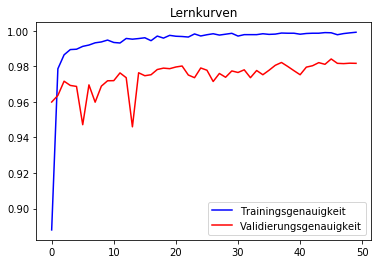

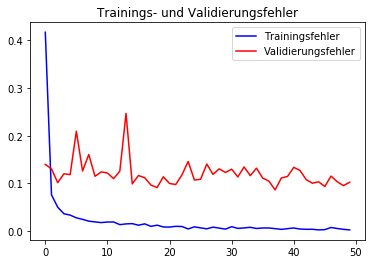

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.99      0.99       720
           2       1.00      0.99      1.00       750
           3       0.99      0.96      0.98       450
           4       0.99      0.99      0.99       660
           5       0.92      0.99      0.96       630
           6       0.99      0.77      0.87       150
           7       1.00      0.95      0.97       450
           8       0.96      0.97      0.97       450
           9       0.99      1.00      0.99       480
          10       1.00      1.00      1.00       660
          11       1.00      0.99      0.99       420
          12       1.00      0.98      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.99      0.99       270
          15       0.95      1.00      0.97       210
          16       1.00      0.99      1.00   

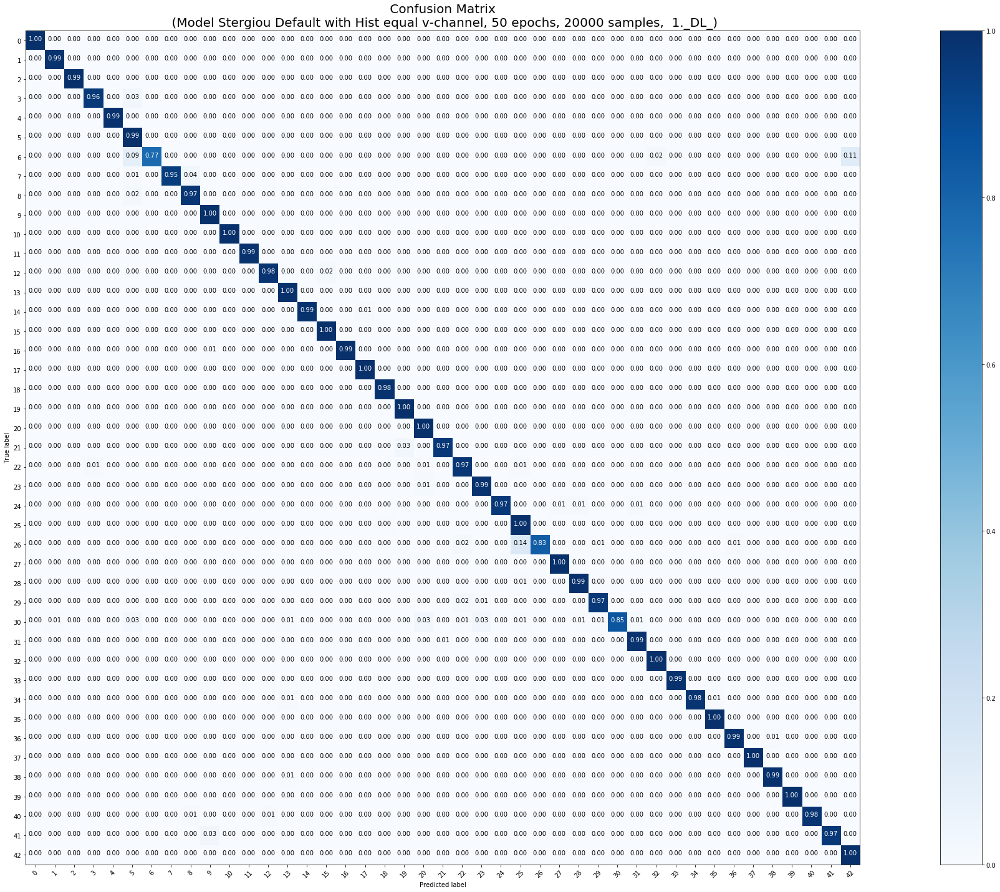

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 17s 854us/step - loss: 0.4081 - acc: 0.8903 - val_loss: 0.1611 - val_acc: 0.9553
Epoch 2/50
20000/20000 [==============================] - 13s 641us/step - loss: 0.0773 - acc: 0.9793 - val_loss: 0.1298 - val_acc: 0.9659
Epoch 3/50
20000/20000 [==============================] - 13s 641us/step - loss: 0.0446 - acc: 0.9868 - val_loss: 0.1486 - val_acc: 0.9622
Epoch 4/50
20000/20000 [==============================] - 13s 652us/step - loss: 0.0349 - acc: 0.9893 - val_loss: 0.1411 - val_acc: 0.9638
Epoch 5/50
20000/20000 [==============================] - 13s 640us/step - loss: 0.0307 - acc: 0.9897 - val_loss: 0.1066 - val_acc: 0.9701
Epoch 6/50
20000/20000

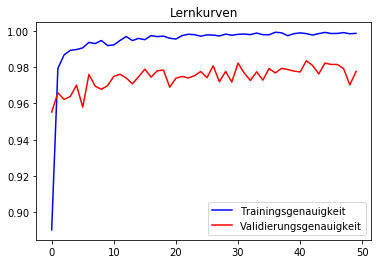

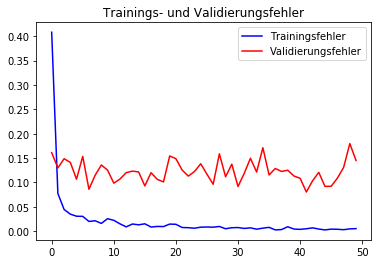

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      0.99      0.99       720
           2       0.98      1.00      0.99       750
           3       0.99      0.94      0.97       450
           4       1.00      0.98      0.99       660
           5       0.89      0.99      0.94       630
           6       1.00      0.82      0.90       150
           7       1.00      0.96      0.98       450
           8       0.97      0.95      0.96       450
           9       0.97      1.00      0.99       480
          10       1.00      0.99      1.00       660
          11       0.97      0.99      0.98       420
          12       0.99      1.00      1.00       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.96      1.00      0.98       210
          16       0.99      0.99      0.99   

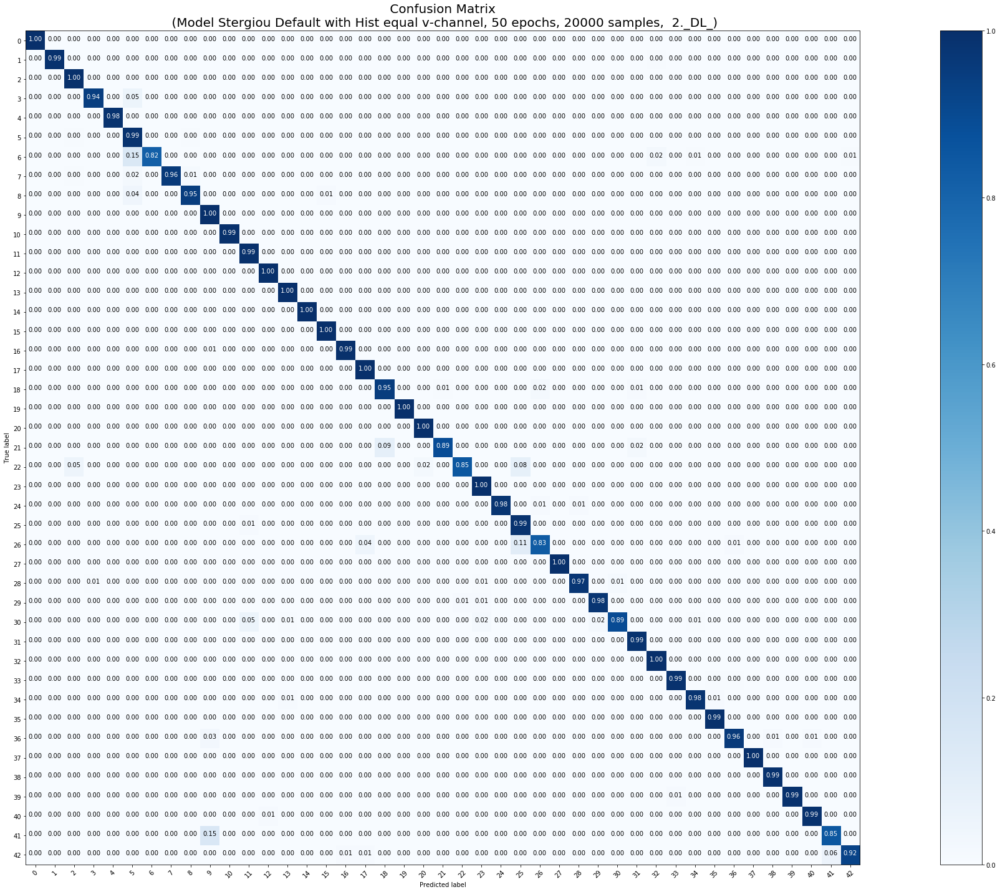

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 18s 881us/step - loss: 0.3811 - acc: 0.8966 - val_loss: 0.1985 - val_acc: 0.9427
Epoch 2/50
20000/20000 [==============================] - 13s 654us/step - loss: 0.0781 - acc: 0.9776 - val_loss: 0.1810 - val_acc: 0.9517
Epoch 3/50
20000/20000 [==============================] - 13s 646us/step - loss: 0.0384 - acc: 0.9891 - val_loss: 0.1281 - val_acc: 0.9645
Epoch 4/50
20000/20000 [==============================] - 13s 659us/step - loss: 0.0386 - acc: 0.9886 - val_loss: 0.1595 - val_acc: 0.9558
Epoch 5/50
20000/20000 [==============================] - 13s 653us/step - loss: 0.0363 - acc: 0.9888 - val_loss: 0.1152 - val_acc: 0.9686
Epoch 6/50
20000/20000

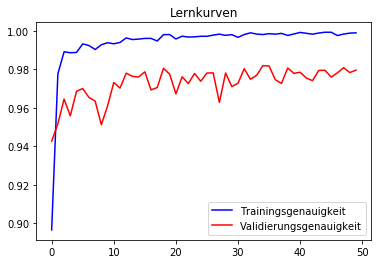

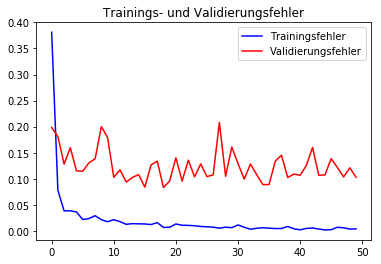

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.98      0.98        60
           1       0.99      0.99      0.99       720
           2       0.98      1.00      0.99       750
           3       0.98      0.96      0.97       450
           4       0.99      0.99      0.99       660
           5       0.94      0.99      0.96       630
           6       1.00      0.80      0.89       150
           7       0.99      0.99      0.99       450
           8       0.99      0.96      0.98       450
           9       0.97      0.99      0.98       480
          10       0.99      1.00      0.99       660
          11       0.97      0.99      0.98       420
          12       1.00      1.00      1.00       690
          13       0.98      1.00      0.99       720
          14       0.98      1.00      0.99       270
          15       1.00      0.99      0.99       210
          16       0.97      0.99      0.98   

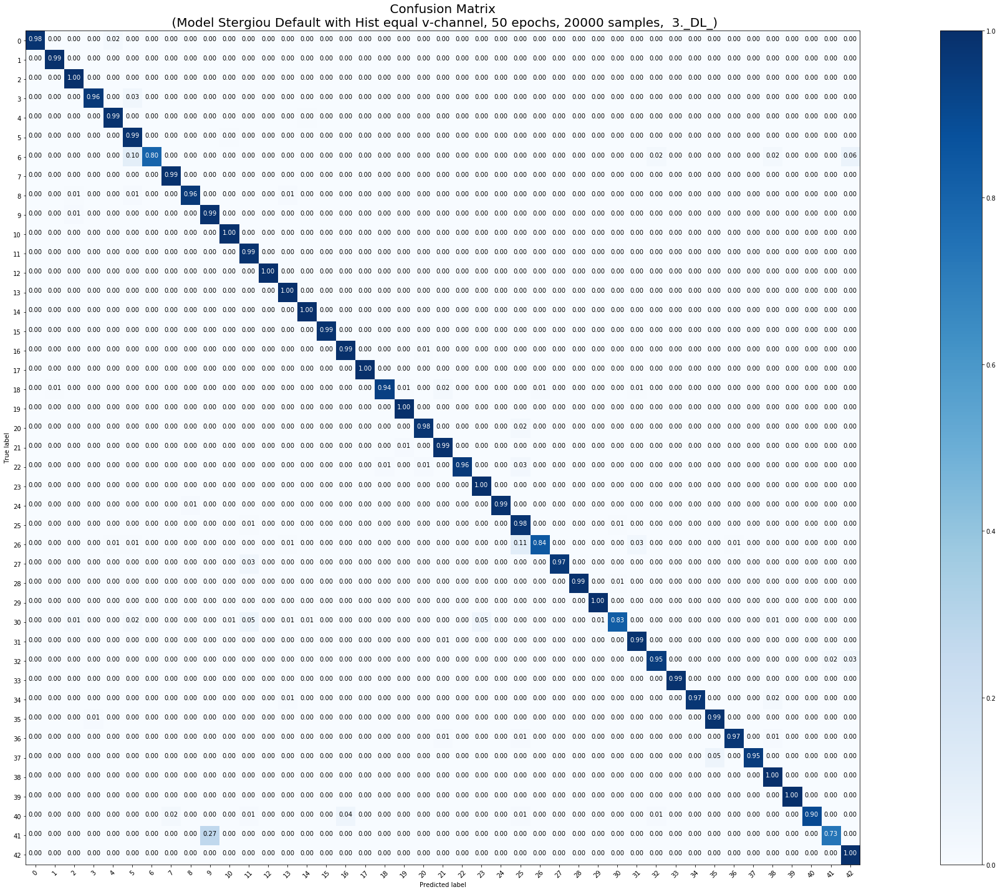

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 18s 919us/step - loss: 0.4172 - acc: 0.8887 - val_loss: 0.2018 - val_acc: 0.9427
Epoch 2/50
20000/20000 [==============================] - 13s 660us/step - loss: 0.0760 - acc: 0.9782 - val_loss: 0.1767 - val_acc: 0.9530
Epoch 3/50
20000/20000 [==============================] - 13s 647us/step - loss: 0.0440 - acc: 0.9876 - val_loss: 0.1657 - val_acc: 0.9576
Epoch 4/50
20000/20000 [==============================] - 13s 656us/step - loss: 0.0400 - acc: 0.9873 - val_loss: 0.1846 - val_acc: 0.9522
Epoch 5/50
20000/20000 [==============================] - 13s 656us/step - loss: 0.0328 - acc: 0.9898 - val_loss: 0.1335 - val_acc: 0.9651
Epoch 6/50
20000/20000

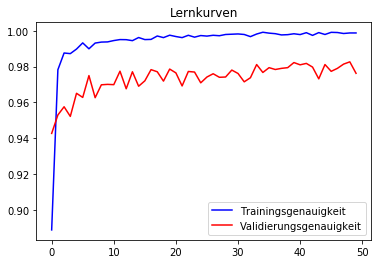

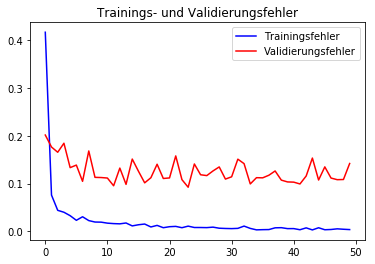

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       1.00      0.99      1.00       720
           2       0.99      1.00      0.99       750
           3       0.99      0.94      0.97       450
           4       0.99      0.99      0.99       660
           5       0.91      1.00      0.95       630
           6       1.00      0.76      0.86       150
           7       1.00      0.98      0.99       450
           8       1.00      0.94      0.97       450
           9       0.95      1.00      0.97       480
          10       1.00      0.98      0.99       660
          11       0.96      1.00      0.98       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.94      1.00      0.97       210
          16       0.96      0.99      0.97   

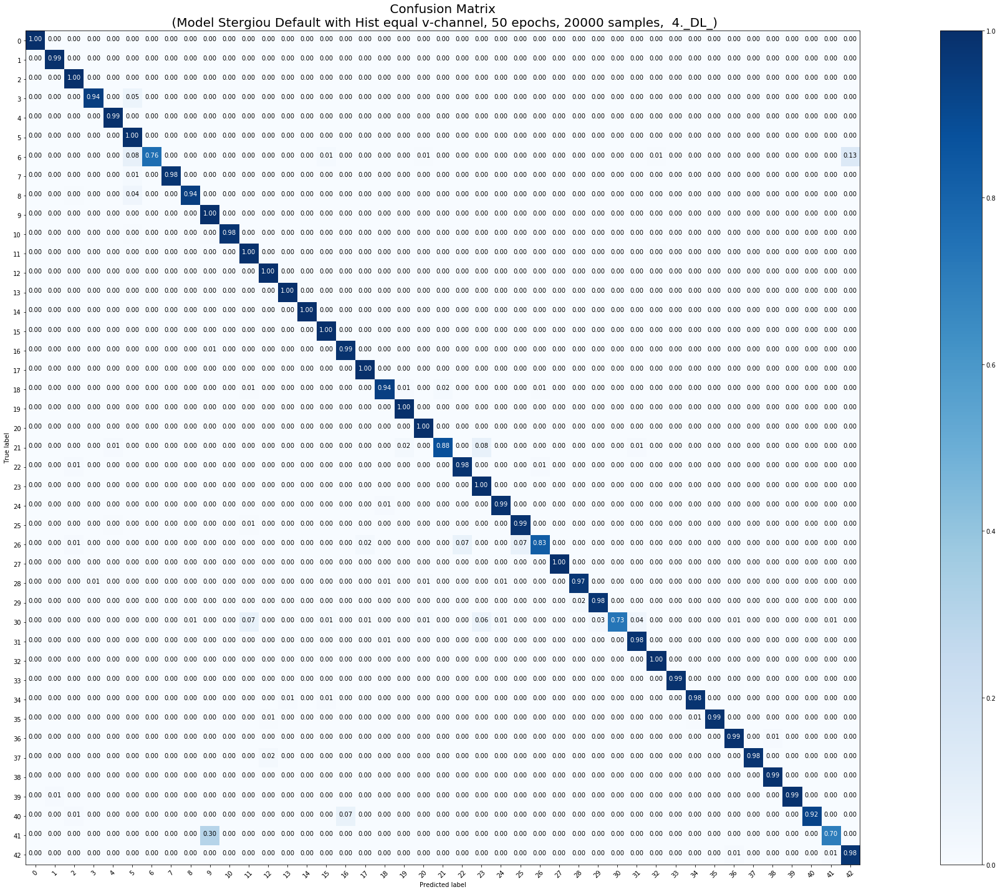

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 19s 934us/step - loss: 0.4185 - acc: 0.8862 - val_loss: 0.1605 - val_acc: 0.9587
Epoch 2/50
20000/20000 [==============================] - 13s 660us/step - loss: 0.0804 - acc: 0.9777 - val_loss: 0.1355 - val_acc: 0.9633
Epoch 3/50
20000/20000 [==============================] - 13s 671us/step - loss: 0.0485 - acc: 0.9864 - val_loss: 0.1180 - val_acc: 0.9683
Epoch 4/50
20000/20000 [==============================] - 13s 652us/step - loss: 0.0331 - acc: 0.9904 - val_loss: 0.1980 - val_acc: 0.9462
Epoch 5/50
20000/20000 [==============================] - 13s 662us/step - loss: 0.0337 - acc: 0.9899 - val_loss: 0.1582 - val_acc: 0.9605
Epoch 6/50
20000/20000

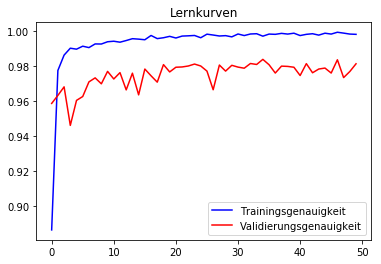

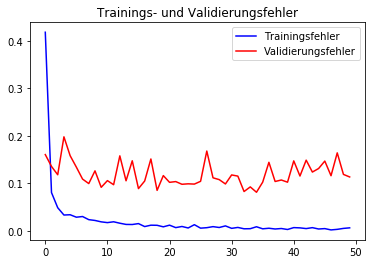

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       1.00      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       1.00      0.92      0.96       450
           4       1.00      0.99      0.99       660
           5       0.89      1.00      0.94       630
           6       1.00      0.77      0.87       150
           7       0.99      0.99      0.99       450
           8       0.97      0.97      0.97       450
           9       0.99      0.99      0.99       480
          10       1.00      0.99      1.00       660
          11       0.97      0.99      0.98       420
          12       0.99      1.00      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       1.00      1.00      1.00       210
          16       0.99      0.99      0.99   

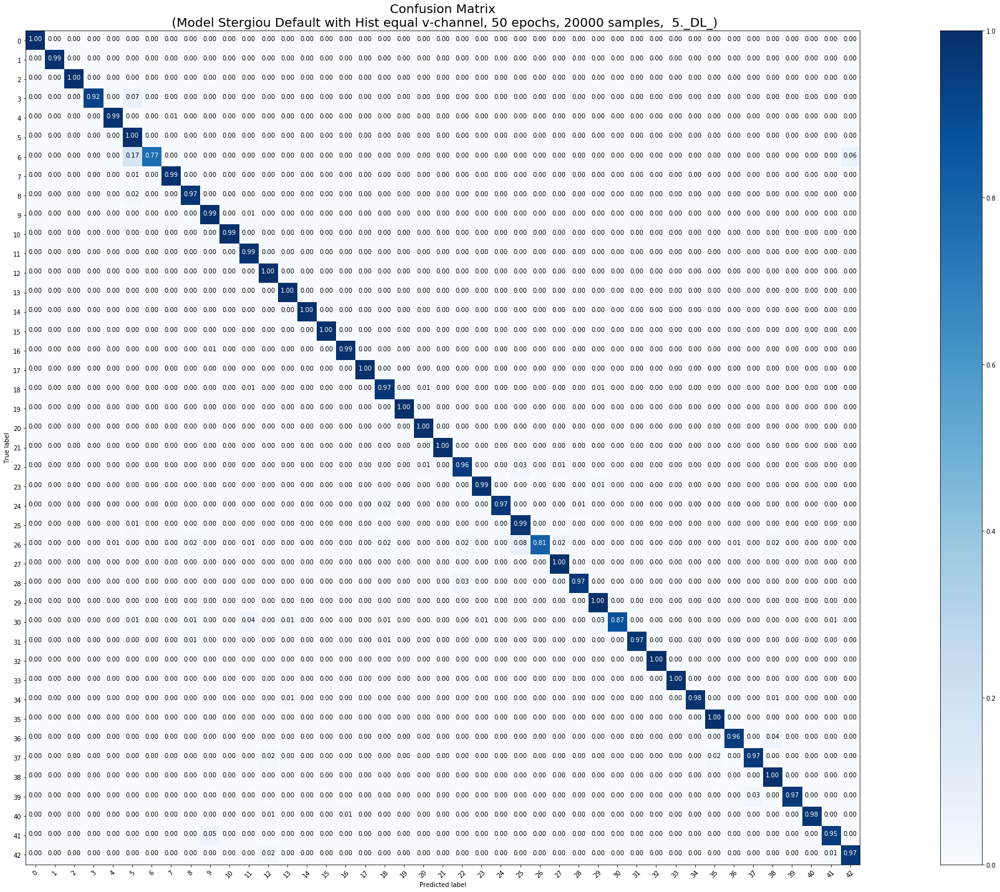

<Figure size 432x288 with 0 Axes>

In [0]:
### 20000, A, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_20000, y_tr_20000, X_test, y_test, 50, 20000)

In [0]:
downloader(20000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 14s 695us/step - loss: 0.5915 - acc: 0.8384 - val_loss: 0.1989 - val_acc: 0.9457
Epoch 2/50
20000/20000 [==============================] - 11s 540us/step - loss: 0.0960 - acc: 0.9692 - val_loss: 0.1667 - val_acc: 0.9564
Epoch 3/50
20000/20000 [==============================] - 11s 547us/step - loss: 0.0493 - acc: 0.9816 - val_loss: 0.1437 - val_acc: 0.9604
Epoch 4/50
20000/20000 [==============================] - 11s 550us/step - loss: 0.0564 - acc: 0.9810 - val_loss: 0.1023 - val_acc: 0.9720
Epoch 5/50
20000/20000 [==============================] - 11s 544us/step - loss: 0.0411 - acc: 0.9856 - val_loss: 0.1654 - val_acc: 0.9565
Epoch 6/50
20000

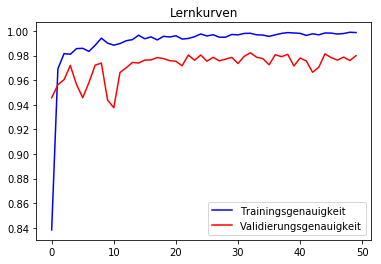

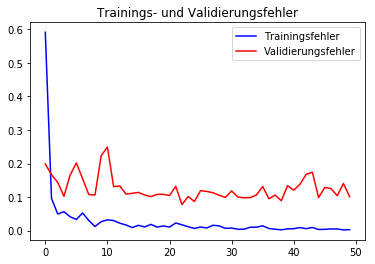

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       1.00      0.98      0.99       720
           2       1.00      0.99      0.99       750
           3       0.97      0.95      0.96       450
           4       1.00      0.99      0.99       660
           5       0.92      0.98      0.95       630
           6       1.00      0.86      0.92       150
           7       0.99      0.99      0.99       450
           8       0.99      0.96      0.98       450
           9       0.99      1.00      1.00       480
          10       1.00      0.99      0.99       660
          11       0.97      0.99      0.98       420
          12       0.98      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.96      1.00      0.98       210
          16       1.00      0.99      1.00   

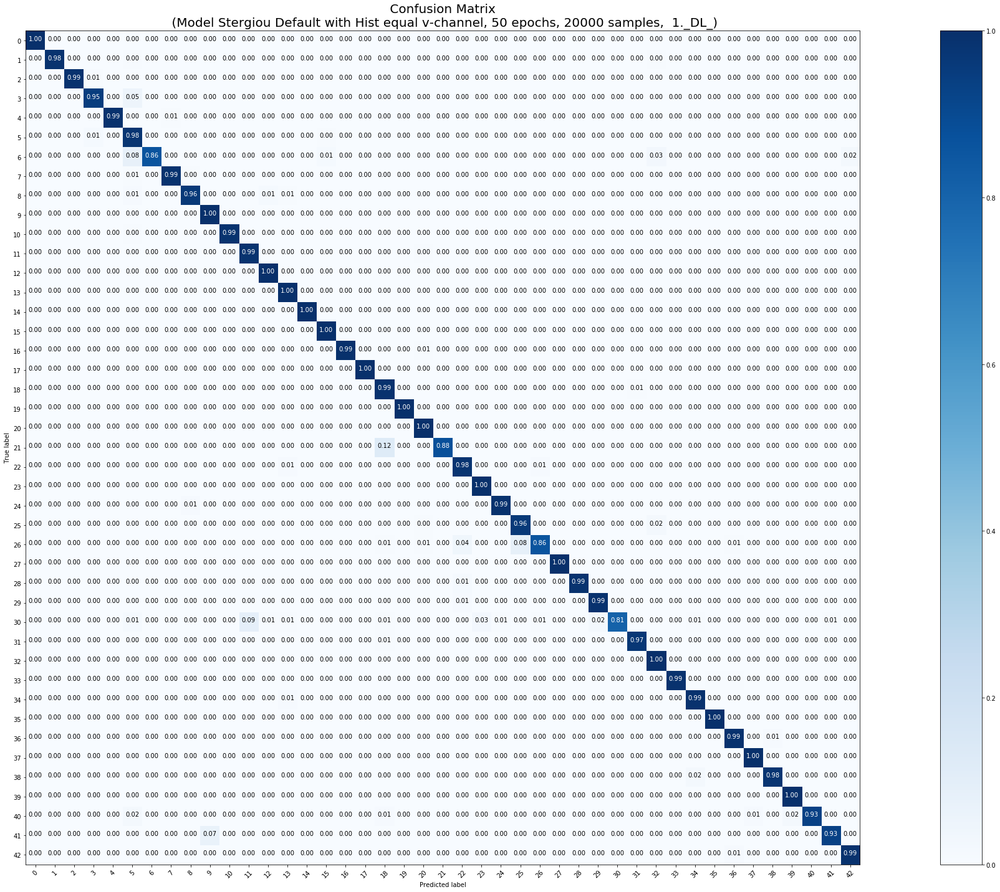

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 15s 749us/step - loss: 0.5978 - acc: 0.8386 - val_loss: 0.2803 - val_acc: 0.9215
Epoch 2/50
20000/20000 [==============================] - 11s 553us/step - loss: 0.0927 - acc: 0.9702 - val_loss: 0.1547 - val_acc: 0.9568
Epoch 3/50
20000/20000 [==============================] - 11s 562us/step - loss: 0.0548 - acc: 0.9801 - val_loss: 0.1224 - val_acc: 0.9679
Epoch 4/50
20000/20000 [==============================] - 11s 556us/step - loss: 0.0475 - acc: 0.9832 - val_loss: 0.1245 - val_acc: 0.9656
Epoch 5/50
20000/20000 [==============================] - 11s 547us/step - loss: 0.0503 - acc: 0.9812 - val_loss: 0.1039 - val_acc: 0.9708
Epoch 6/50
20000

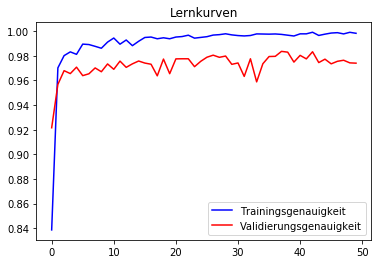

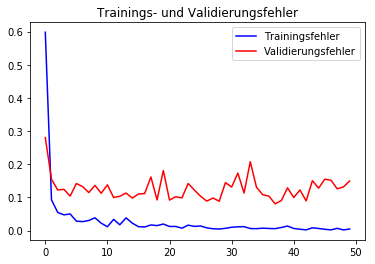

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       0.97      0.96      0.97       450
           4       0.99      0.99      0.99       660
           5       0.96      0.97      0.97       630
           6       1.00      0.68      0.81       150
           7       1.00      0.98      0.99       450
           8       0.97      0.96      0.96       450
           9       0.99      1.00      1.00       480
          10       1.00      0.98      0.99       660
          11       0.93      0.99      0.96       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       0.98      1.00      0.99       270
          15       0.95      1.00      0.97       210
          16       0.99      0.99      0.99   

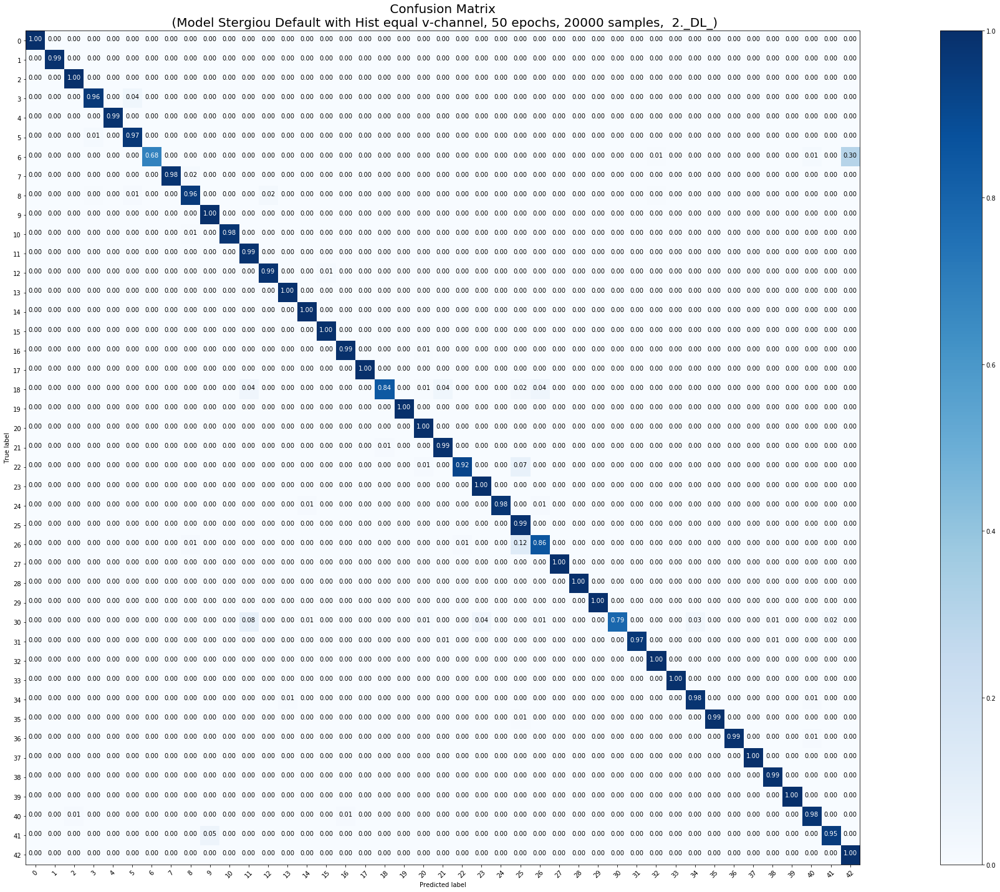

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 16s 783us/step - loss: 0.5520 - acc: 0.8480 - val_loss: 0.2364 - val_acc: 0.9363
Epoch 2/50
20000/20000 [==============================] - 11s 567us/step - loss: 0.0891 - acc: 0.9714 - val_loss: 0.1959 - val_acc: 0.9495
Epoch 3/50
20000/20000 [==============================] - 12s 582us/step - loss: 0.0628 - acc: 0.9778 - val_loss: 0.1686 - val_acc: 0.9565
Epoch 4/50
20000/20000 [==============================] - 12s 579us/step - loss: 0.0439 - acc: 0.9824 - val_loss: 0.1452 - val_acc: 0.9644
Epoch 5/50
20000/20000 [==============================] - 11s 573us/step - loss: 0.0493 - acc: 0.9829 - val_loss: 0.1207 - val_acc: 0.9713
Epoch 6/50
20000

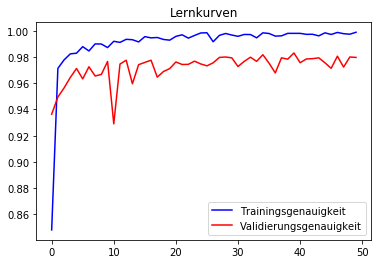

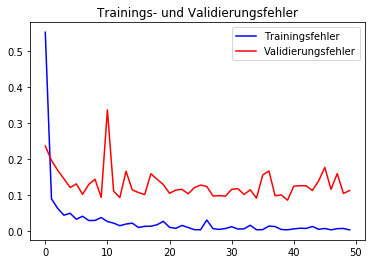

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.97      0.98       720
           2       0.99      1.00      1.00       750
           3       0.99      0.95      0.97       450
           4       0.98      0.99      0.99       660
           5       0.93      0.98      0.96       630
           6       1.00      0.83      0.91       150
           7       0.99      0.98      0.98       450
           8       0.98      0.96      0.97       450
           9       0.98      0.98      0.98       480
          10       0.99      0.99      0.99       660
          11       1.00      0.98      0.99       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       1.00      0.99      0.99       270
          15       0.99      0.99      0.99       210
          16       0.91      0.99      0.95   

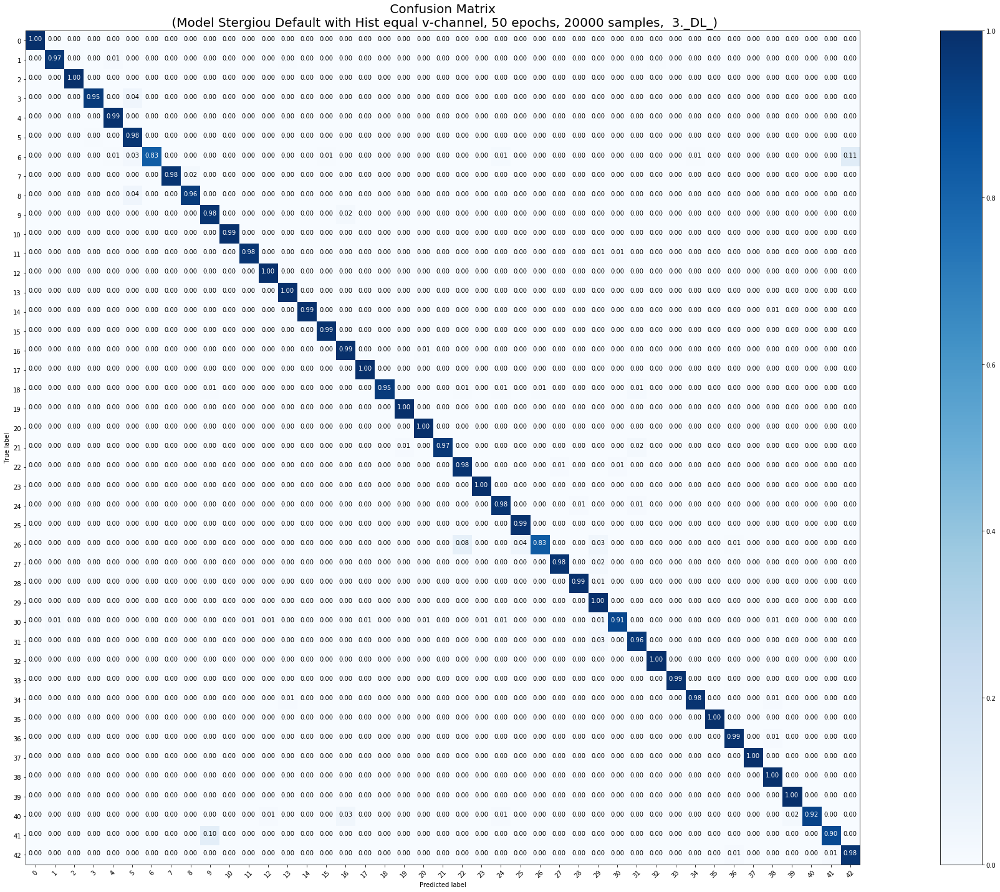

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 16s 800us/step - loss: 0.5709 - acc: 0.8429 - val_loss: 0.1739 - val_acc: 0.9516
Epoch 2/50
20000/20000 [==============================] - 11s 569us/step - loss: 0.0904 - acc: 0.9713 - val_loss: 0.1655 - val_acc: 0.9568
Epoch 3/50
20000/20000 [==============================] - 12s 585us/step - loss: 0.0511 - acc: 0.9823 - val_loss: 0.1361 - val_acc: 0.9622
Epoch 4/50
20000/20000 [==============================] - 12s 581us/step - loss: 0.0530 - acc: 0.9823 - val_loss: 0.1757 - val_acc: 0.9531
Epoch 5/50
20000/20000 [==============================] - 12s 585us/step - loss: 0.0410 - acc: 0.9847 - val_loss: 0.5966 - val_acc: 0.8437
Epoch 6/50
20000

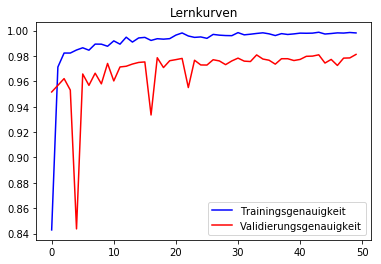

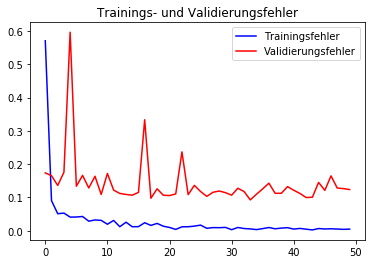

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.98      0.99        60
           1       0.99      0.99      0.99       720
           2       0.98      1.00      0.99       750
           3       1.00      0.93      0.96       450
           4       0.99      0.99      0.99       660
           5       0.89      0.99      0.94       630
           6       1.00      0.79      0.88       150
           7       1.00      0.99      1.00       450
           8       0.98      0.94      0.96       450
           9       0.98      0.99      0.99       480
          10       1.00      0.99      1.00       660
          11       0.99      0.99      0.99       420
          12       1.00      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.96      1.00      0.98       210
          16       1.00      0.99      1.00   

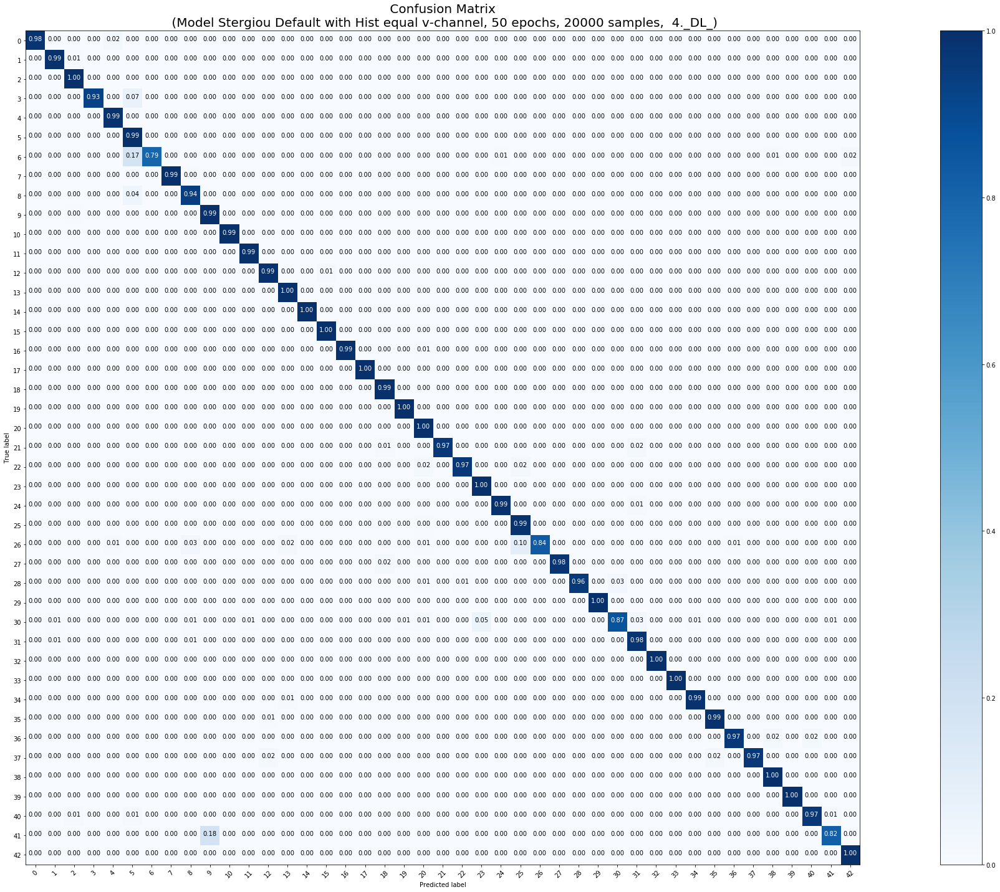

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 17s 837us/step - loss: 0.5880 - acc: 0.8413 - val_loss: 0.1789 - val_acc: 0.9511
Epoch 2/50
20000/20000 [==============================] - 12s 586us/step - loss: 0.0962 - acc: 0.9687 - val_loss: 0.1453 - val_acc: 0.9613
Epoch 3/50
20000/20000 [==============================] - 12s 590us/step - loss: 0.0490 - acc: 0.9830 - val_loss: 0.1494 - val_acc: 0.9579
Epoch 4/50
20000/20000 [==============================] - 12s 591us/step - loss: 0.0445 - acc: 0.9838 - val_loss: 0.1550 - val_acc: 0.9585
Epoch 5/50
20000/20000 [==============================] - 12s 605us/step - loss: 0.0396 - acc: 0.9855 - val_loss: 0.1006 - val_acc: 0.9723
Epoch 6/50
20000

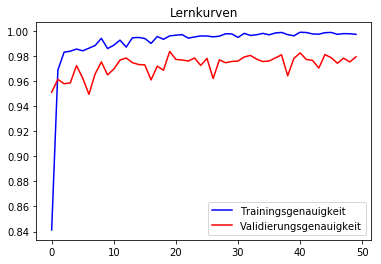

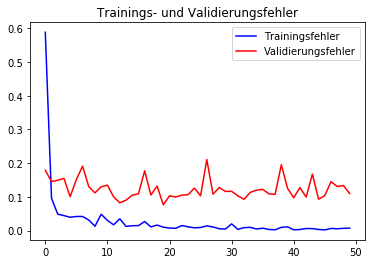

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       1.00      0.98      0.99       720
           2       0.99      1.00      0.99       750
           3       0.99      0.94      0.96       450
           4       0.99      0.99      0.99       660
           5       0.94      0.97      0.96       630
           6       1.00      0.88      0.94       150
           7       0.99      0.98      0.99       450
           8       0.98      0.96      0.97       450
           9       1.00      0.99      0.99       480
          10       1.00      0.99      0.99       660
          11       0.99      0.99      0.99       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       0.99      1.00      1.00       270
          15       0.96      1.00      0.98       210
          16       0.93      1.00      0.96   

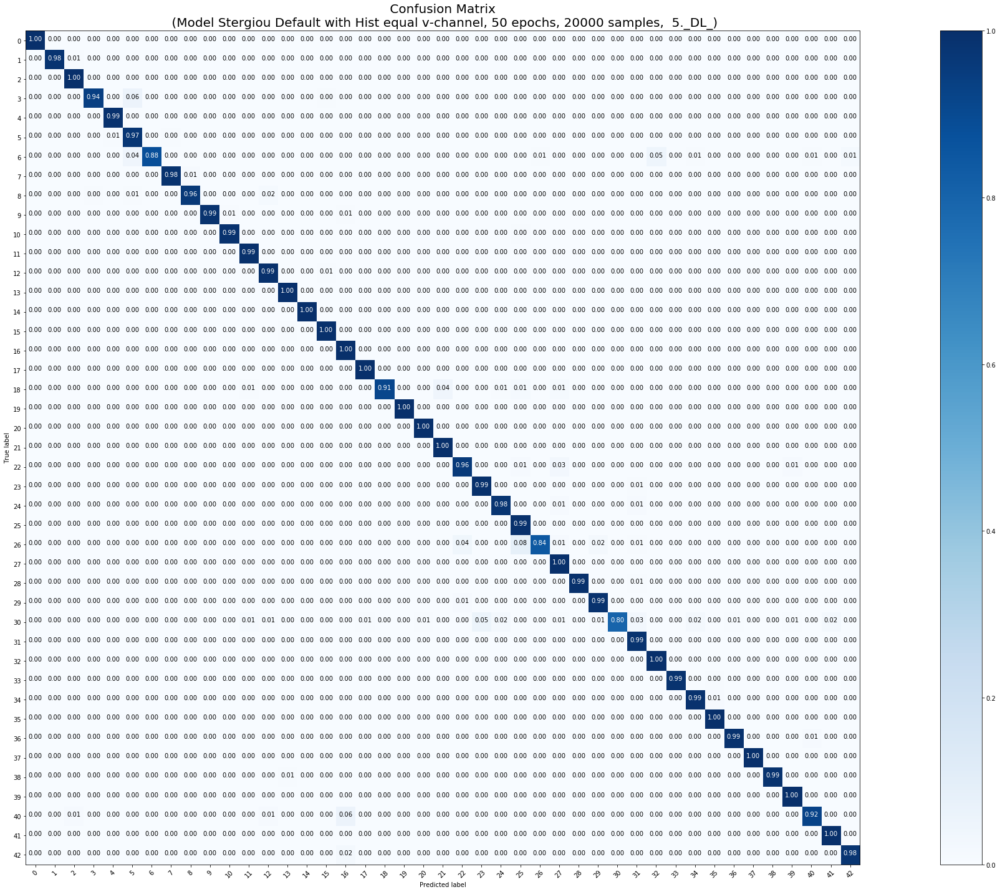

<Figure size 432x288 with 0 Axes>

In [0]:
### 20000, A, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr_20000, y_tr_20000, X_test, y_test, 50, 20000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Normales Training beginnt










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
categorical crossentropy


Training ohne Klassengewichte beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 30s 757us/step - loss: 0.2556 - acc: 0.9293 - val_loss: 0.1233 - val_acc: 0.9661
Epoch 2/50
39209/39209 [==============================] - 22s 564us/step - loss: 0.0506 - acc: 0.9858 - val_loss: 0.1411 - val_acc: 0.9618
Epoch 3/50
39209/39209 [==============================] - 22s 552us/step - loss: 0.0372 - acc: 0.9887 - val_loss: 0.1182 - val_acc: 0.9668
Epoch 4/50
39209/39209 [==============================] - 22s 552us/step - lo

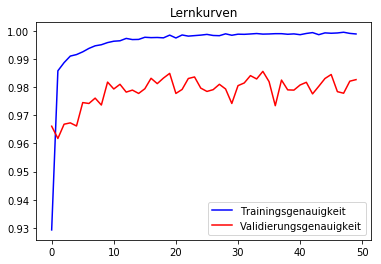

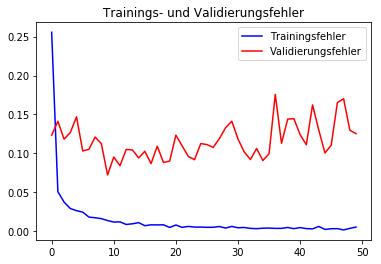

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.98      1.00      0.99       720
           2       1.00      1.00      1.00       750
           3       0.98      0.97      0.98       450
           4       0.99      0.99      0.99       660
           5       0.92      0.99      0.96       630
           6       1.00      0.83      0.91       150
           7       1.00      0.98      0.99       450
           8       1.00      0.92      0.96       450
           9       0.98      1.00      0.99       480
          10       1.00      0.99      0.99       660
          11       0.99      0.99      0.99       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      0.99       210
          16       0.99      0.99      0.99   

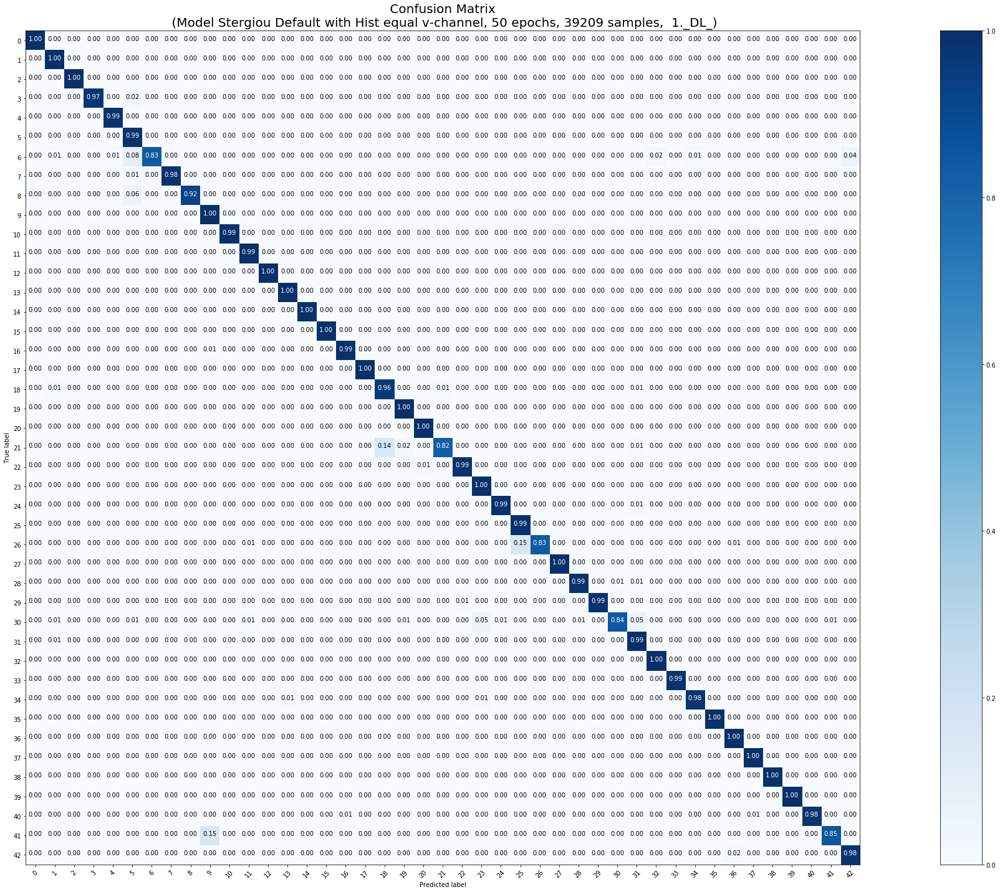

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 24s 604us/step - loss: 0.2562 - acc: 0.9310 - val_loss: 0.1809 - val_acc: 0.9550
Epoch 2/50
39209/39209 [==============================] - 22s 560us/step - loss: 0.0531 - acc: 0.9848 - val_loss: 0.1184 - val_acc: 0.9695
Epoch 3/50
39209/39209 [==============================] - 22s 553us/step - loss: 0.0374 - acc: 0.9893 - val_loss: 0.1239 - val_acc: 0.9701
Epoch 4/50
39209/39209 [==============================] - 21s 547us/step - loss: 0.0324 - acc: 0.9898 - val_loss: 0.1990 - val_acc: 0.9558
Epoch 5/50
39209/39209 [==============================] - 22s 550us/step - loss: 0.0254 - acc: 0.9919 - val_loss: 0.1267 - val_acc: 0.9722
Epoch 6/50
39209/39209

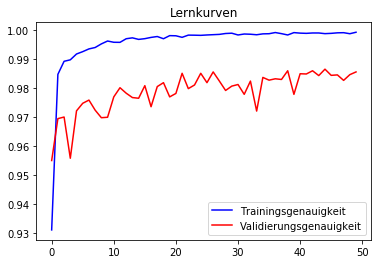

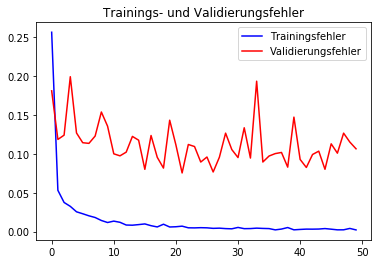

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.98      1.00      0.99       720
           2       1.00      1.00      1.00       750
           3       0.99      0.96      0.98       450
           4       0.99      0.99      0.99       660
           5       0.96      0.99      0.97       630
           6       0.99      0.75      0.86       150
           7       0.99      1.00      0.99       450
           8       0.99      0.97      0.98       450
           9       0.99      1.00      1.00       480
          10       1.00      0.99      1.00       660
          11       1.00      0.99      1.00       420
          12       0.99      1.00      1.00       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.97      1.00      0.98       210
          16       1.00      0.99      1.00   

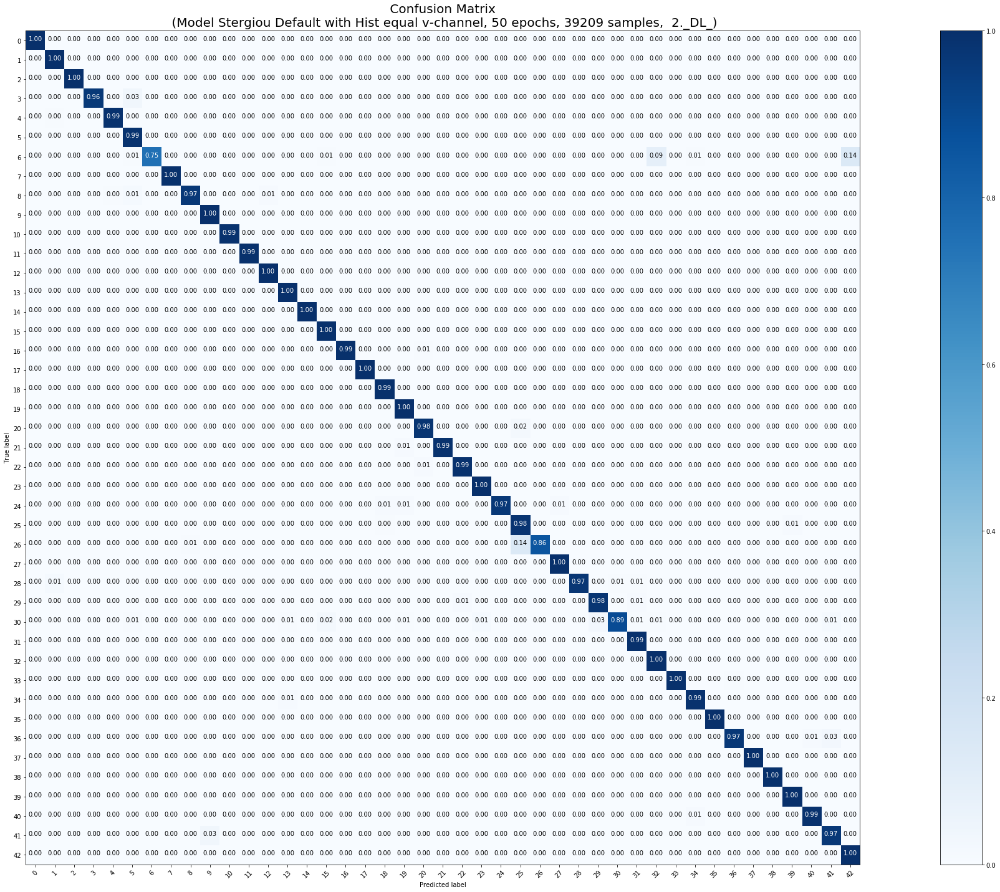

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 24s 621us/step - loss: 0.2504 - acc: 0.9312 - val_loss: 0.1355 - val_acc: 0.9627
Epoch 2/50
39209/39209 [==============================] - 22s 557us/step - loss: 0.0552 - acc: 0.9844 - val_loss: 0.1407 - val_acc: 0.9634
Epoch 3/50
39209/39209 [==============================] - 22s 559us/step - loss: 0.0379 - acc: 0.9887 - val_loss: 0.1093 - val_acc: 0.9716
Epoch 4/50
39209/39209 [==============================] - 22s 559us/step - loss: 0.0305 - acc: 0.9906 - val_loss: 0.0943 - val_acc: 0.9747
Epoch 5/50
39209/39209 [==============================] - 22s 558us/step - loss: 0.0263 - acc: 0.9912 - val_loss: 0.1162 - val_acc: 0.9706
Epoch 6/50
39209/39209

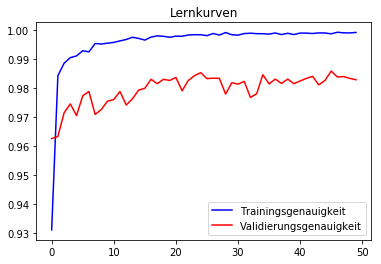

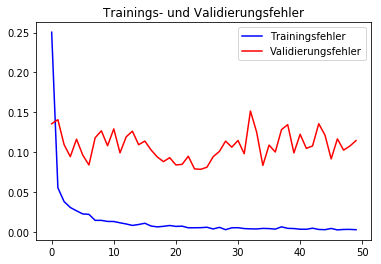

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.97      1.00      0.98       720
           2       1.00      1.00      1.00       750
           3       1.00      0.98      0.99       450
           4       1.00      0.99      0.99       660
           5       0.95      0.99      0.97       630
           6       1.00      0.84      0.91       150
           7       1.00      0.97      0.99       450
           8       0.97      0.98      0.97       450
           9       0.99      1.00      1.00       480
          10       1.00      0.99      1.00       660
          11       0.96      1.00      0.98       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.99      0.99      0.99       210
          16       0.99      0.99      0.99   

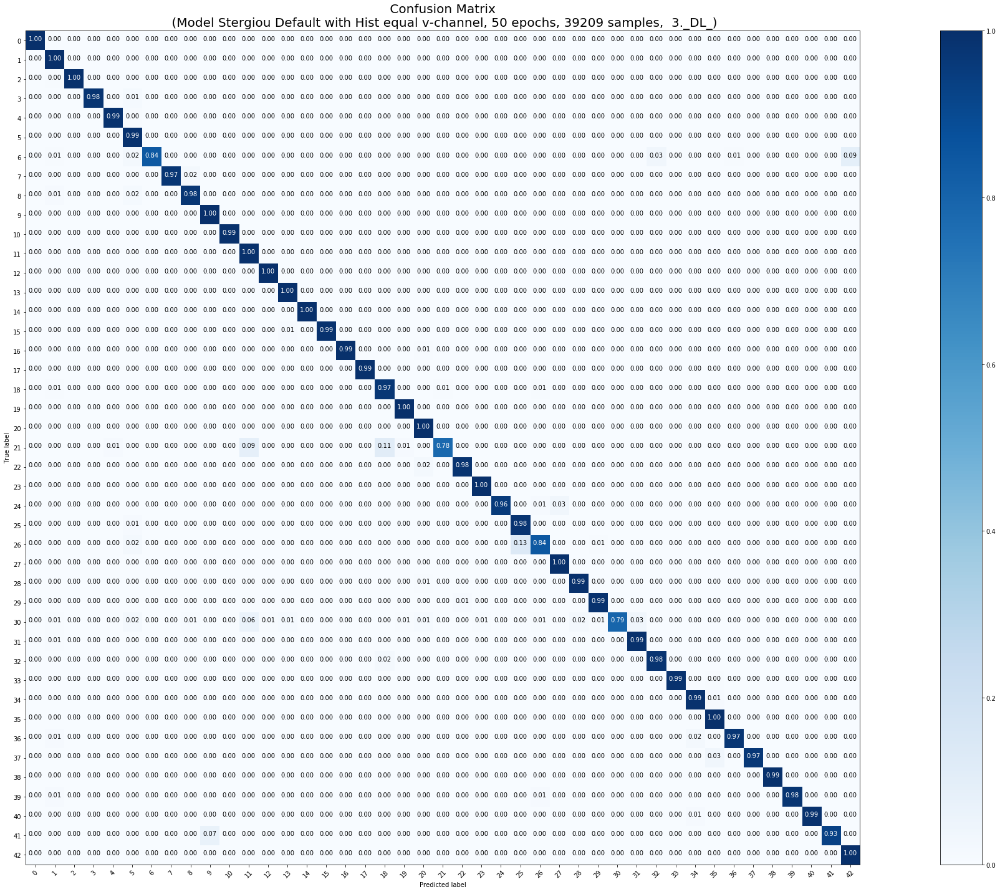

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 25s 644us/step - loss: 0.2374 - acc: 0.9358 - val_loss: 0.1411 - val_acc: 0.9620
Epoch 2/50
39209/39209 [==============================] - 22s 569us/step - loss: 0.0543 - acc: 0.9842 - val_loss: 0.1191 - val_acc: 0.9660
Epoch 3/50
39209/39209 [==============================] - 22s 569us/step - loss: 0.0401 - acc: 0.9878 - val_loss: 0.1053 - val_acc: 0.9686
Epoch 4/50
39209/39209 [==============================] - 22s 574us/step - loss: 0.0285 - acc: 0.9912 - val_loss: 0.1107 - val_acc: 0.9713
Epoch 5/50
39209/39209 [==============================] - 22s 574us/step - loss: 0.0264 - acc: 0.9919 - val_loss: 0.1195 - val_acc: 0.9717
Epoch 6/50
39209/39209

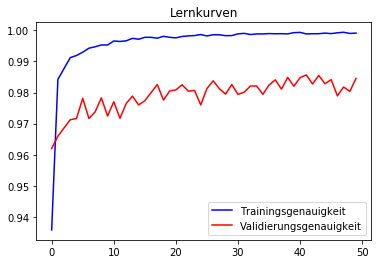

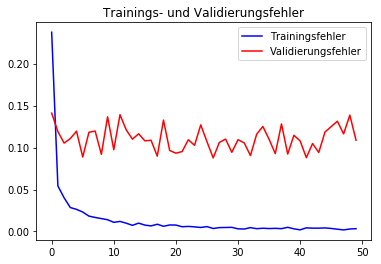

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       0.99      0.96      0.98       450
           4       1.00      0.99      0.99       660
           5       0.95      0.99      0.97       630
           6       1.00      0.89      0.94       150
           7       0.99      0.99      0.99       450
           8       0.99      0.96      0.98       450
           9       1.00      0.99      0.99       480
          10       0.99      1.00      0.99       660
          11       0.97      0.99      0.98       420
          12       1.00      1.00      1.00       690
          13       0.99      0.99      0.99       720
          14       1.00      1.00      1.00       270
          15       1.00      0.99      0.99       210
          16       0.99      0.99      0.99   

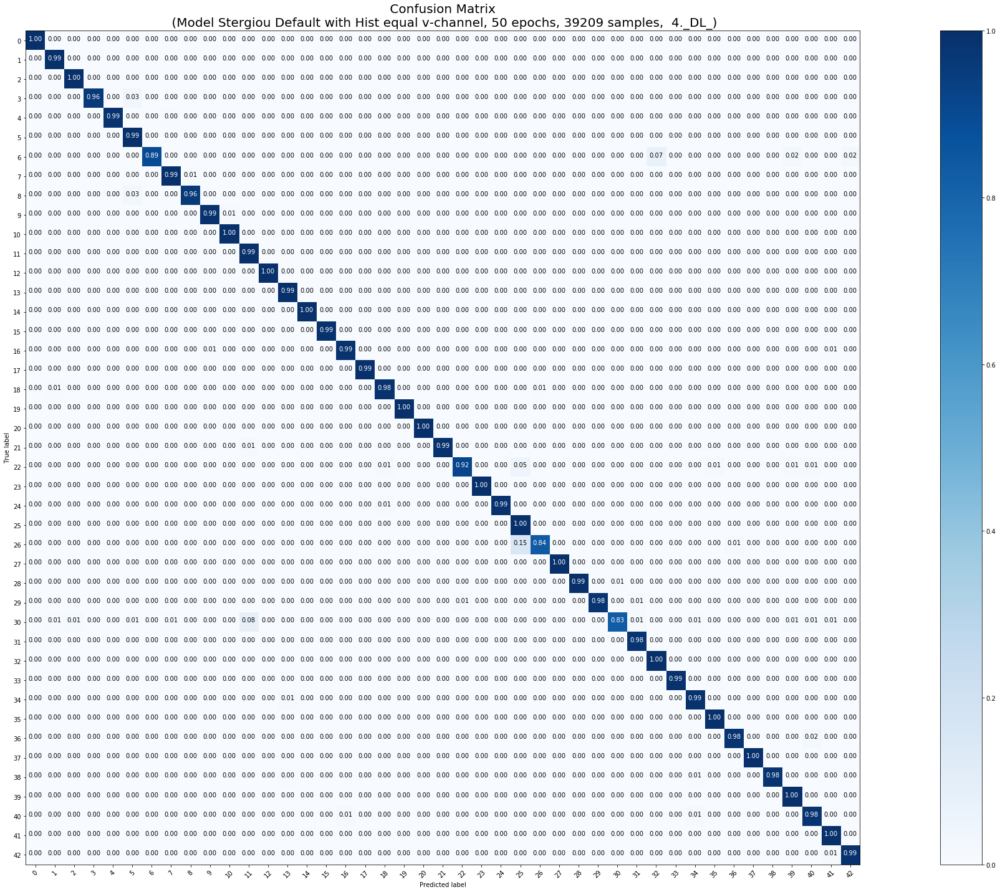

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 26s 657us/step - loss: 0.2402 - acc: 0.9336 - val_loss: 0.1226 - val_acc: 0.9669
Epoch 2/50
39209/39209 [==============================] - 22s 569us/step - loss: 0.0582 - acc: 0.9831 - val_loss: 0.1042 - val_acc: 0.9736
Epoch 3/50
39209/39209 [==============================] - 22s 570us/step - loss: 0.0368 - acc: 0.9888 - val_loss: 0.1622 - val_acc: 0.9563
Epoch 4/50
39209/39209 [==============================] - 22s 568us/step - loss: 0.0308 - acc: 0.9905 - val_loss: 0.1131 - val_acc: 0.9713
Epoch 5/50
39209/39209 [==============================] - 22s 569us/step - loss: 0.0239 - acc: 0.9926 - val_loss: 0.0685 - val_acc: 0.9807
Epoch 6/50
39209/39209

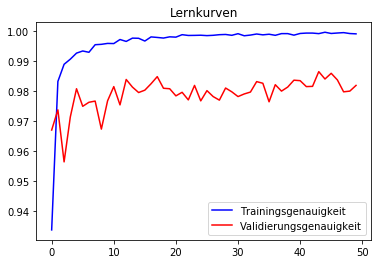

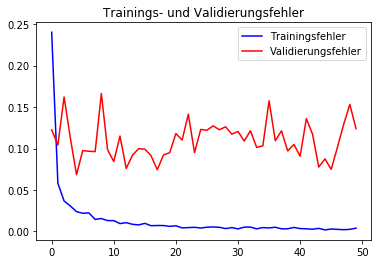

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      1.00      1.00       720
           2       1.00      1.00      1.00       750
           3       1.00      0.93      0.96       450
           4       0.99      0.98      0.99       660
           5       0.89      1.00      0.94       630
           6       1.00      0.73      0.85       150
           7       1.00      0.99      0.99       450
           8       1.00      0.94      0.97       450
           9       0.99      0.99      0.99       480
          10       1.00      1.00      1.00       660
          11       0.98      0.99      0.98       420
          12       0.99      1.00      1.00       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      1.00       210
          16       0.96      0.99      0.97   

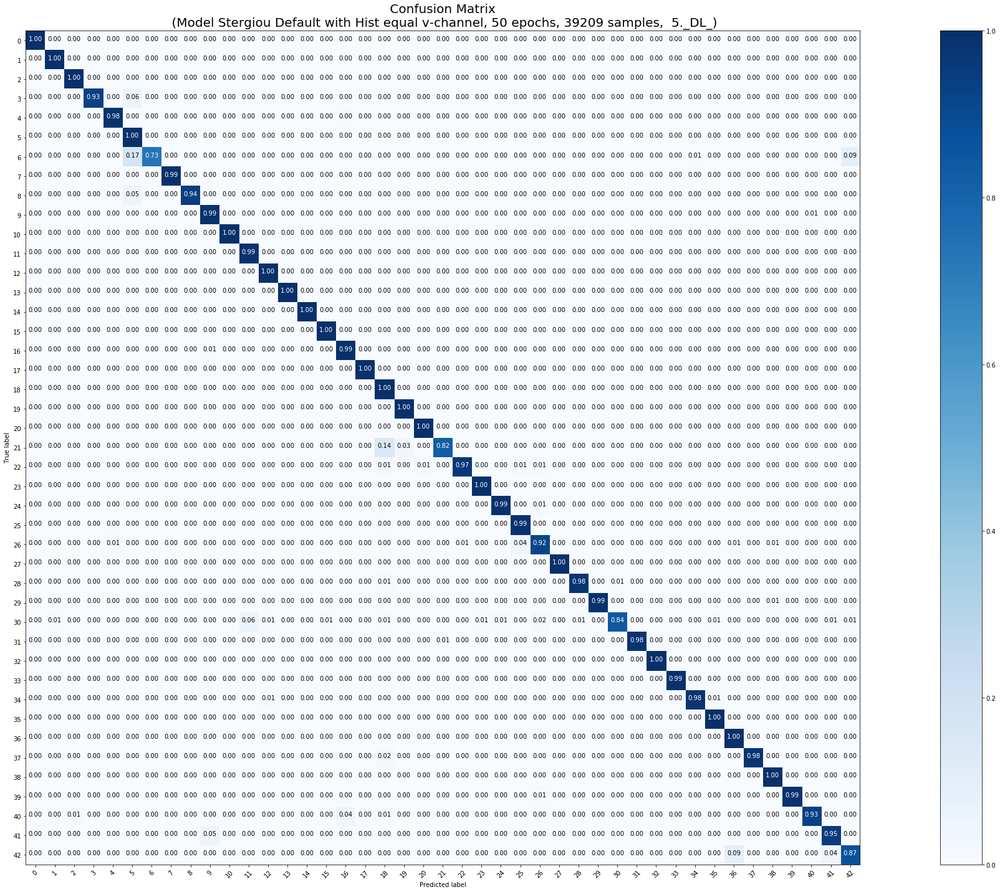

<Figure size 432x288 with 0 Axes>

In [0]:
### 39209, A, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr, y_tr, X_test, y_test, 50, 39209)

In [0]:
downloader(39209)

In [0]:
downloaderCW(20000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
sparse categorical crossentropy


Training mit Klassengewichten beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 25s 647us/step - loss: 0.3373 - acc: 0.9058 - val_loss: 0.1853 - val_acc: 0.9522
Epoch 2/50
39209/39209 [==============================] - 18s 450us/step - loss: 0.0690 - acc: 0.9783 - val_loss: 0.2013 - val_acc: 0.9481
Epoch 3/50
39209/39209 [==============================] - 18s 451us/step - loss: 0.0456 - acc: 0.9838 - val_loss: 0.1231 - val_acc: 0.9663
Epoch 4/50
39209/39209 [==============================] - 18s 451us/ste

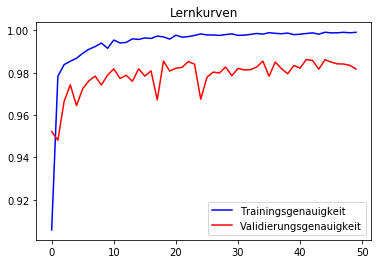

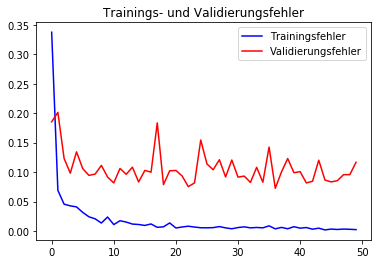

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.98      0.99      0.99       720
           2       0.99      0.99      0.99       750
           3       0.99      0.96      0.98       450
           4       1.00      0.98      0.99       660
           5       0.96      0.99      0.97       630
           6       0.99      0.89      0.94       150
           7       0.99      0.98      0.98       450
           8       0.97      0.98      0.97       450
           9       0.99      1.00      0.99       480
          10       0.99      0.98      0.98       660
          11       0.98      1.00      0.99       420
          12       0.99      1.00      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.97      1.00      0.98       210
          16       0.99      0.99      0.99   

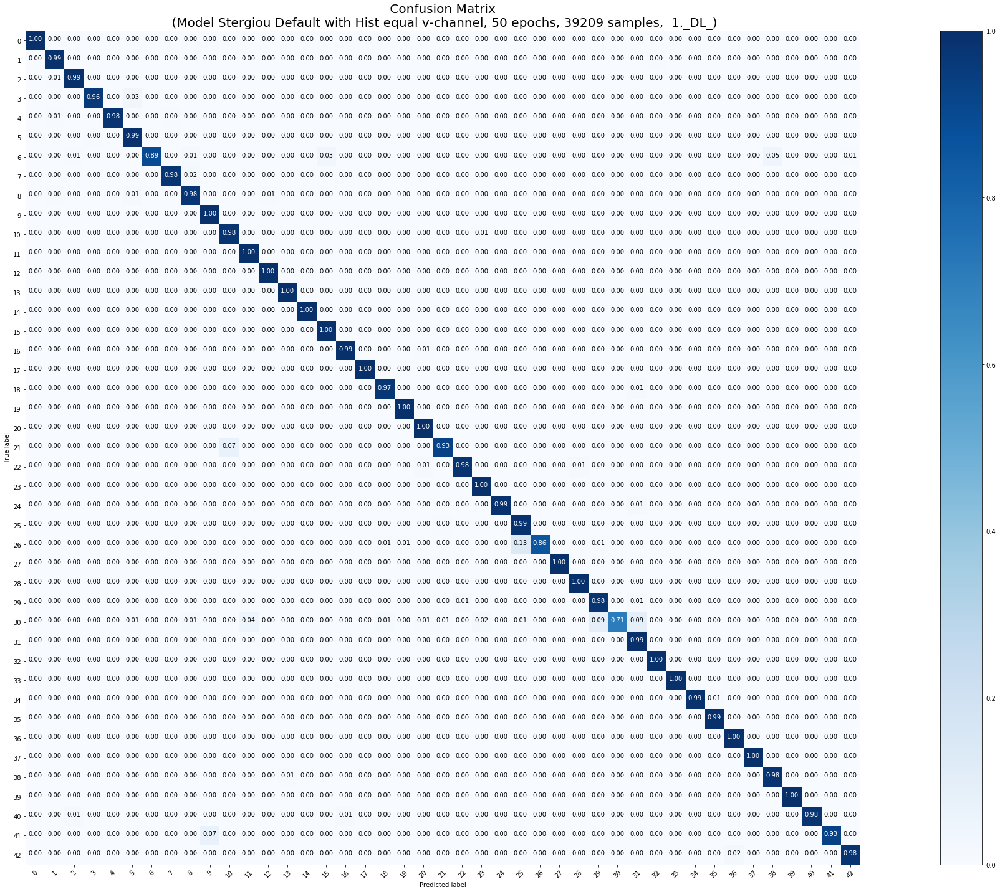

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 19s 487us/step - loss: 0.3528 - acc: 0.9000 - val_loss: 0.1309 - val_acc: 0.9619
Epoch 2/50
39209/39209 [==============================] - 17s 444us/step - loss: 0.0663 - acc: 0.9789 - val_loss: 0.1611 - val_acc: 0.9547
Epoch 3/50
39209/39209 [==============================] - 17s 437us/step - loss: 0.0583 - acc: 0.9805 - val_loss: 0.1130 - val_acc: 0.9675
Epoch 4/50
39209/39209 [==============================] - 17s 439us/step - loss: 0.0357 - acc: 0.9868 - val_loss: 0.1205 - val_acc: 0.9698
Epoch 5/50
39209/39209 [==============================] - 17s 435us/step - loss: 0.0445 - acc: 0.9852 - val_loss: 0.1111 - val_acc: 0.9725
Epoch 6/50
39209

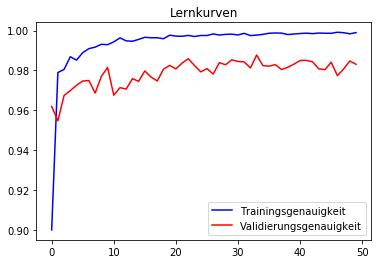

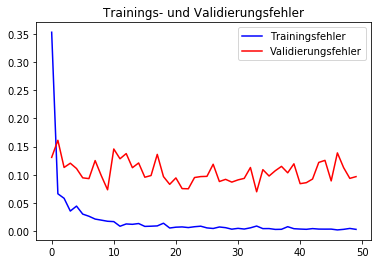

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.98      1.00      0.99       720
           2       0.99      1.00      0.99       750
           3       1.00      0.95      0.97       450
           4       1.00      0.99      0.99       660
           5       0.92      1.00      0.96       630
           6       0.99      0.80      0.89       150
           7       0.98      0.99      0.98       450
           8       1.00      0.96      0.98       450
           9       0.99      1.00      1.00       480
          10       1.00      0.99      0.99       660
          11       0.97      1.00      0.98       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.99      0.99      0.99       210
          16       0.99      0.99      0.99   

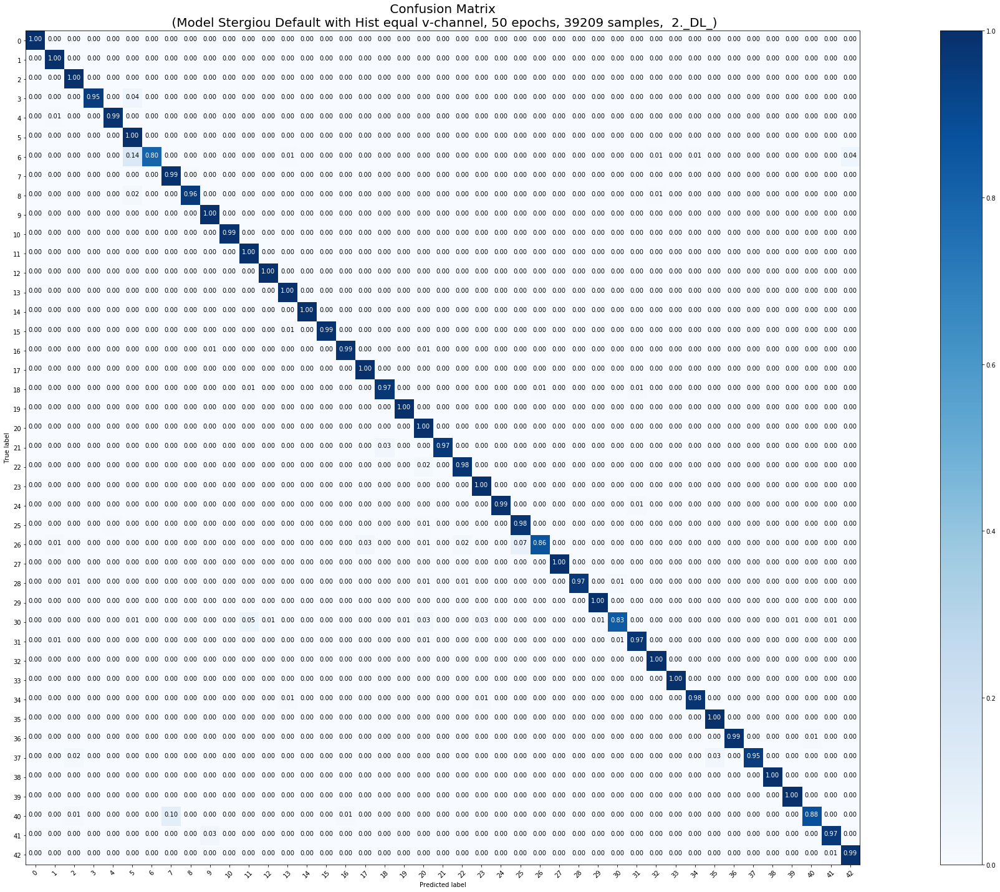

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 20s 499us/step - loss: 0.3367 - acc: 0.9036 - val_loss: 0.1728 - val_acc: 0.9509
Epoch 2/50
39209/39209 [==============================] - 17s 443us/step - loss: 0.0649 - acc: 0.9782 - val_loss: 0.1164 - val_acc: 0.9689
Epoch 3/50
39209/39209 [==============================] - 17s 442us/step - loss: 0.0483 - acc: 0.9834 - val_loss: 0.1152 - val_acc: 0.9702
Epoch 4/50
39209/39209 [==============================] - 17s 445us/step - loss: 0.0429 - acc: 0.9850 - val_loss: 0.1029 - val_acc: 0.9755
Epoch 5/50
39209/39209 [==============================] - 17s 442us/step - loss: 0.0398 - acc: 0.9859 - val_loss: 0.1187 - val_acc: 0.9679
Epoch 6/50
39209

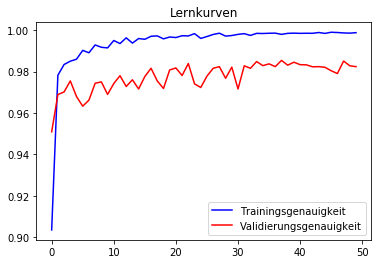

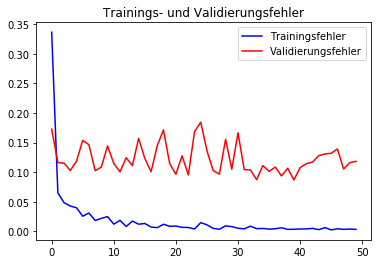

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       1.00      0.96      0.98       450
           4       1.00      0.98      0.99       660
           5       0.93      1.00      0.96       630
           6       0.99      0.81      0.89       150
           7       0.99      0.99      0.99       450
           8       0.98      0.96      0.97       450
           9       0.98      1.00      0.99       480
          10       1.00      0.99      1.00       660
          11       1.00      1.00      1.00       420
          12       1.00      1.00      1.00       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.95      1.00      0.98       210
          16       0.99      0.99      0.99   

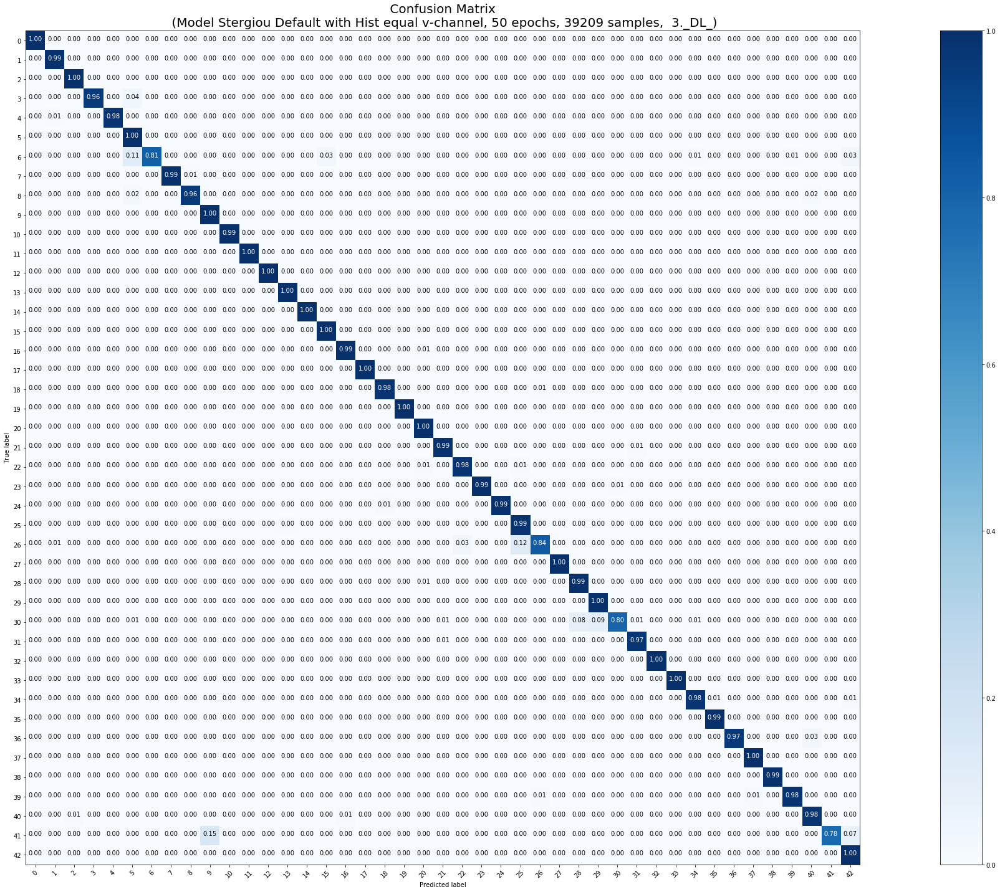

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 19s 495us/step - loss: 0.3587 - acc: 0.9008 - val_loss: 0.1529 - val_acc: 0.9610
Epoch 2/50
39209/39209 [==============================] - 17s 436us/step - loss: 0.0754 - acc: 0.9752 - val_loss: 0.1718 - val_acc: 0.9523
Epoch 3/50
39209/39209 [==============================] - 17s 438us/step - loss: 0.0437 - acc: 0.9846 - val_loss: 0.1154 - val_acc: 0.9718
Epoch 4/50
39209/39209 [==============================] - 17s 438us/step - loss: 0.0447 - acc: 0.9842 - val_loss: 0.1134 - val_acc: 0.9740
Epoch 5/50
39209/39209 [==============================] - 17s 439us/step - loss: 0.0299 - acc: 0.9894 - val_loss: 0.1048 - val_acc: 0.9759
Epoch 6/50
39209

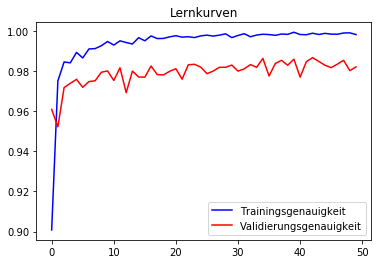

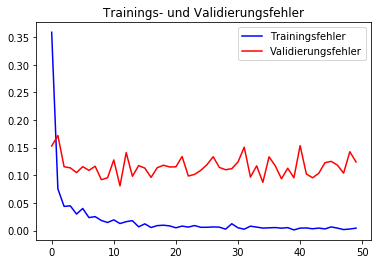

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      1.00      0.99       720
           2       0.99      1.00      0.99       750
           3       1.00      0.93      0.96       450
           4       0.99      0.99      0.99       660
           5       0.92      0.99      0.95       630
           6       0.99      0.84      0.91       150
           7       0.98      0.99      0.99       450
           8       0.99      0.96      0.98       450
           9       1.00      1.00      1.00       480
          10       1.00      0.99      1.00       660
          11       0.98      0.99      0.99       420
          12       0.99      1.00      1.00       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.99      0.99      0.99       210
          16       0.99      0.99      0.99   

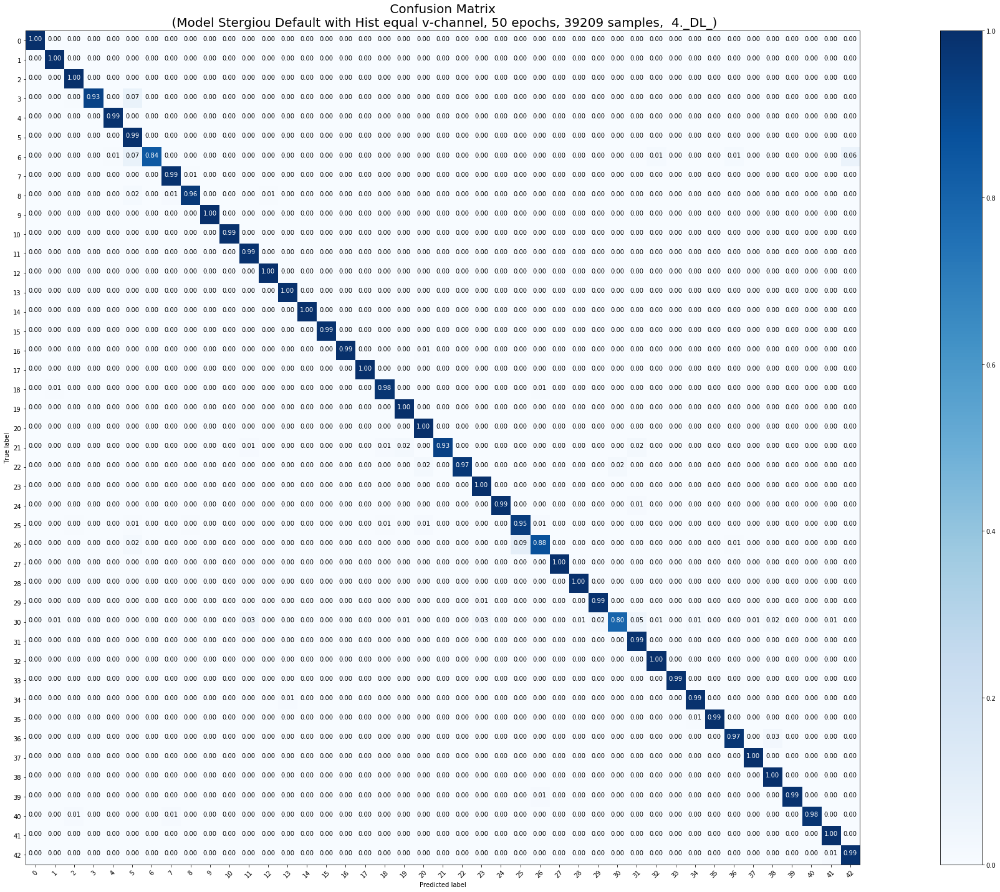

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 20s 507us/step - loss: 0.3737 - acc: 0.8958 - val_loss: 0.2036 - val_acc: 0.9454
Epoch 2/50
39209/39209 [==============================] - 17s 443us/step - loss: 0.0767 - acc: 0.9764 - val_loss: 0.1329 - val_acc: 0.9626
Epoch 3/50
39209/39209 [==============================] - 17s 441us/step - loss: 0.0437 - acc: 0.9850 - val_loss: 0.1250 - val_acc: 0.9660
Epoch 4/50
39209/39209 [==============================] - 17s 444us/step - loss: 0.0352 - acc: 0.9870 - val_loss: 0.2485 - val_acc: 0.9324
Epoch 5/50
39209/39209 [==============================] - 17s 441us/step - loss: 0.0446 - acc: 0.9845 - val_loss: 0.0652 - val_acc: 0.9825
Epoch 6/50
39209

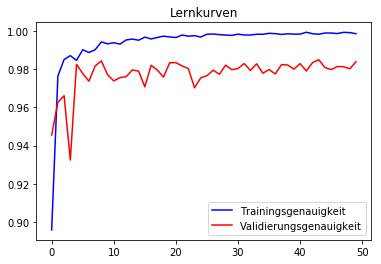

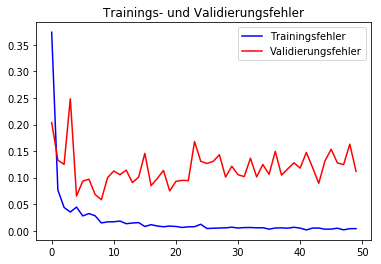

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.99      1.00      1.00       720
           2       0.99      1.00      1.00       750
           3       1.00      0.97      0.98       450
           4       1.00      0.99      0.99       660
           5       0.94      0.99      0.97       630
           6       1.00      0.85      0.92       150
           7       0.99      0.99      0.99       450
           8       0.99      0.97      0.98       450
           9       0.99      1.00      0.99       480
          10       1.00      0.98      0.99       660
          11       0.96      0.99      0.97       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       1.00      0.99      0.99       210
          16       0.99      0.99      0.99   

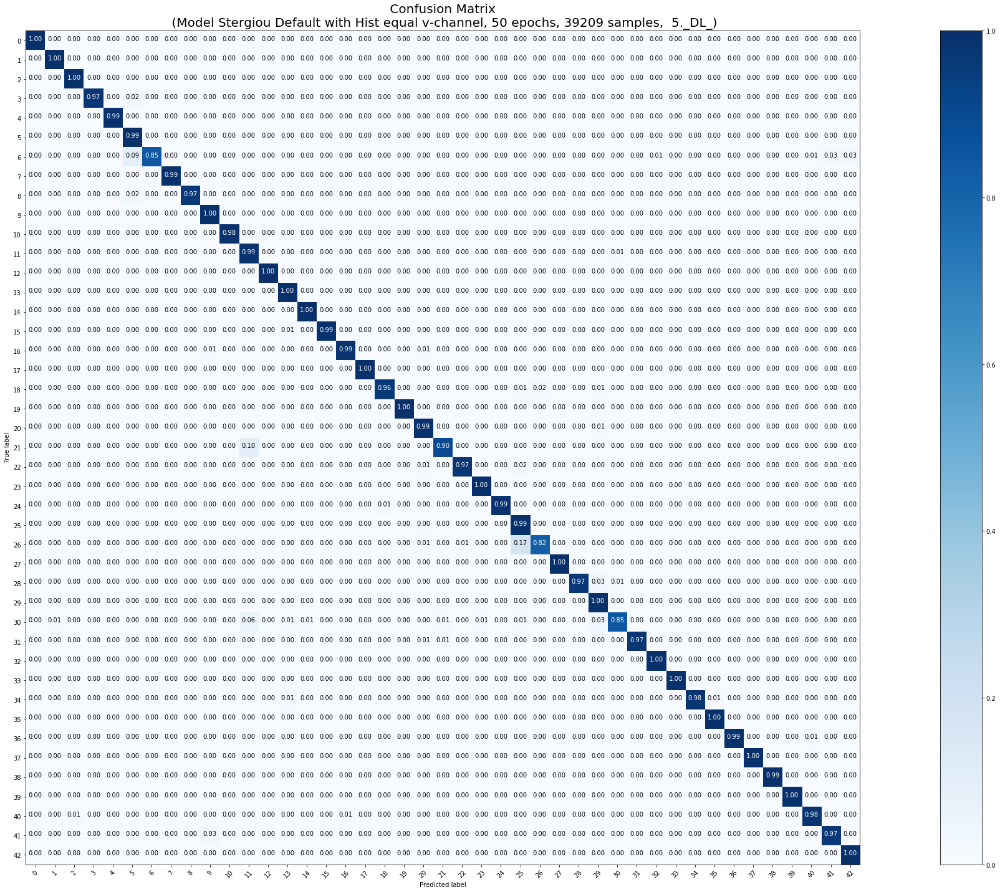

<Figure size 432x288 with 0 Axes>

In [0]:
### 39209, A, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'A', X_tr, y_tr, X_test, y_test, 50, 39209)

In [0]:
downloaderCW(39209)

In [0]:
#files.download("1._2000Lernkurve_GTSRB_loss.png")
files.download("2._500Lernkurve_GTSRB_loss.png")
files.download("3._500Lernkurve_GTSRB_loss.png")
files.download("4._500Lernkurve_GTSRB_loss.png")
files.download("5._500Lernkurve_GTSRB_loss.png")

In [0]:
##############################################################################################
###   "Beginn Training Split-Mengen B"
###    2. Aufteilung !!!
###    Trainingsdatensätze unterschiedlicher Größe erstellen
#################################################################################################
X_tr,y_tr,X_tr_20000,y_tr_20000,X_tr_10000,y_tr_10000,X_tr_5000,y_tr_5000,X_tr_2000,y_tr_2000,X_tr_1000,y_tr_1000,X_tr_500,y_tr_500,X_tr_200,y_tr_200 = make_training_subsets_B(X_train, y_train)


***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 4s 8ms/step - loss: 3.5386 - acc: 0.2580 - val_loss: 2.2044 - val_acc: 0.4546
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.3938 - acc: 0.5980 - val_loss: 1.6364 - val_acc: 0.5905
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.7818 - acc: 0.7620 - val_loss: 0.9982 - val_acc: 0.7255
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4507 - acc: 0.8600 - val_loss: 0.9246 - val_acc: 0.7421
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2547 - acc: 0.9320 - val_loss: 0.6400 - val_acc: 0.8143
Epoch 6/50
500/500 [==============================] - 2s 4ms/

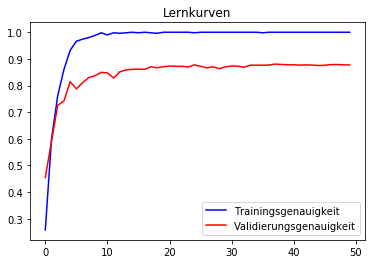

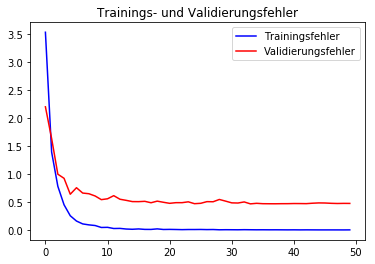

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.92      0.18      0.31        60
           1       0.96      0.86      0.91       720
           2       0.95      0.90      0.92       750
           3       0.78      0.93      0.85       450
           4       0.80      0.94      0.87       660
           5       0.75      0.89      0.82       630
           6       0.98      0.63      0.77       150
           7       0.88      0.89      0.89       450
           8       0.84      0.84      0.84       450
           9       0.91      0.99      0.95       480
          10       1.00      0.81      0.90       660
          11       0.90      0.72      0.80       420
          12       1.00      0.96      0.98       690
          13       0.94      0.99      0.97       720
          14       0.98      0.97      0.98       270
          15       0.81      0.95      0.87       210
          16       0.99      0.91      0.95   

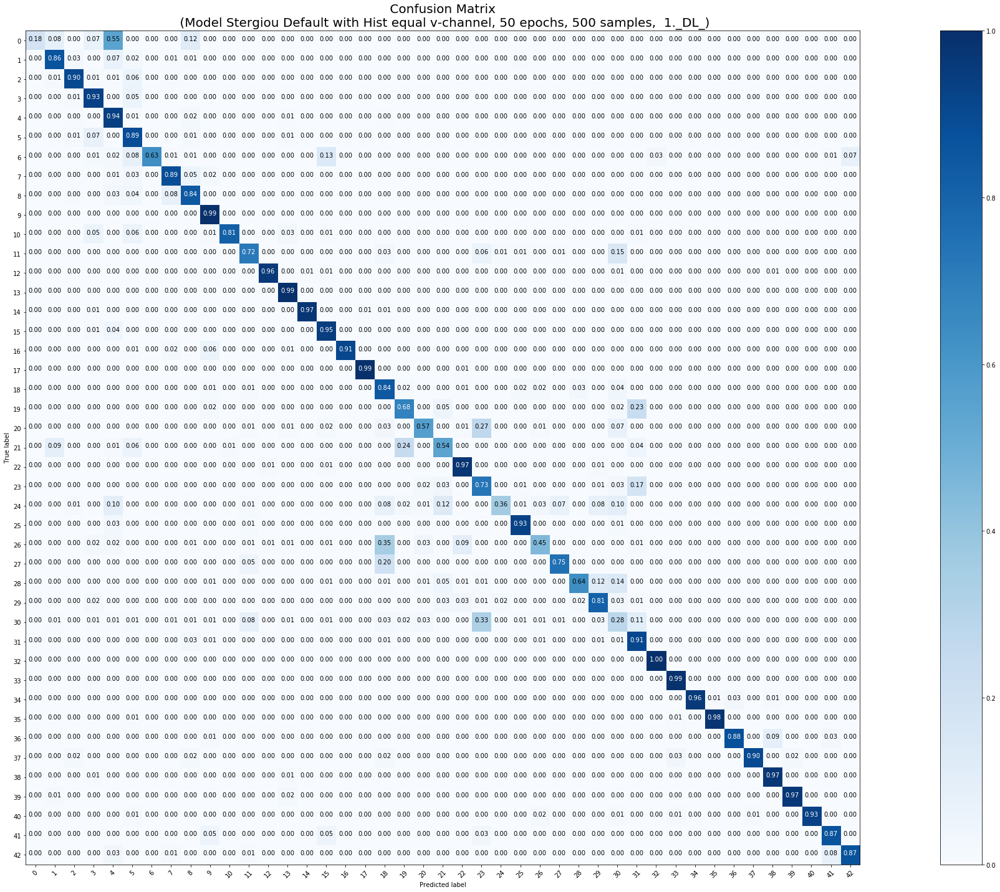

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 4s 8ms/step - loss: 3.4063 - acc: 0.2360 - val_loss: 2.5064 - val_acc: 0.3999
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.3669 - acc: 0.5980 - val_loss: 1.5786 - val_acc: 0.5789
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.7675 - acc: 0.7780 - val_loss: 1.0696 - val_acc: 0.7063
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4018 - acc: 0.8900 - val_loss: 0.8572 - val_acc: 0.7476
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2435 - acc: 0.9380 - val_loss: 0.7295 - val_acc: 0.7928
Epoch 6/50
500/500 [==============================] - 2s 4ms/

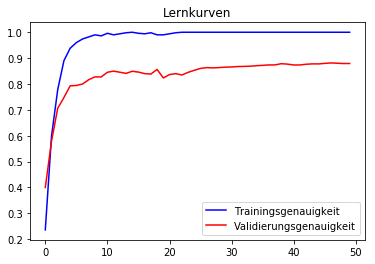

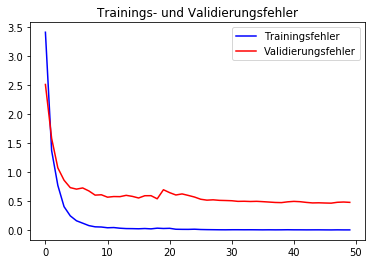

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.94      0.28      0.44        60
           1       0.92      0.87      0.89       720
           2       0.87      0.96      0.91       750
           3       0.80      0.96      0.87       450
           4       0.87      0.92      0.90       660
           5       0.81      0.84      0.83       630
           6       1.00      0.67      0.80       150
           7       0.94      0.80      0.87       450
           8       0.74      0.87      0.80       450
           9       0.91      1.00      0.95       480
          10       0.99      0.84      0.91       660
          11       0.86      0.68      0.76       420
          12       1.00      0.96      0.98       690
          13       0.97      1.00      0.98       720
          14       0.99      0.99      0.99       270
          15       0.90      0.99      0.94       210
          16       1.00      0.89      0.94   

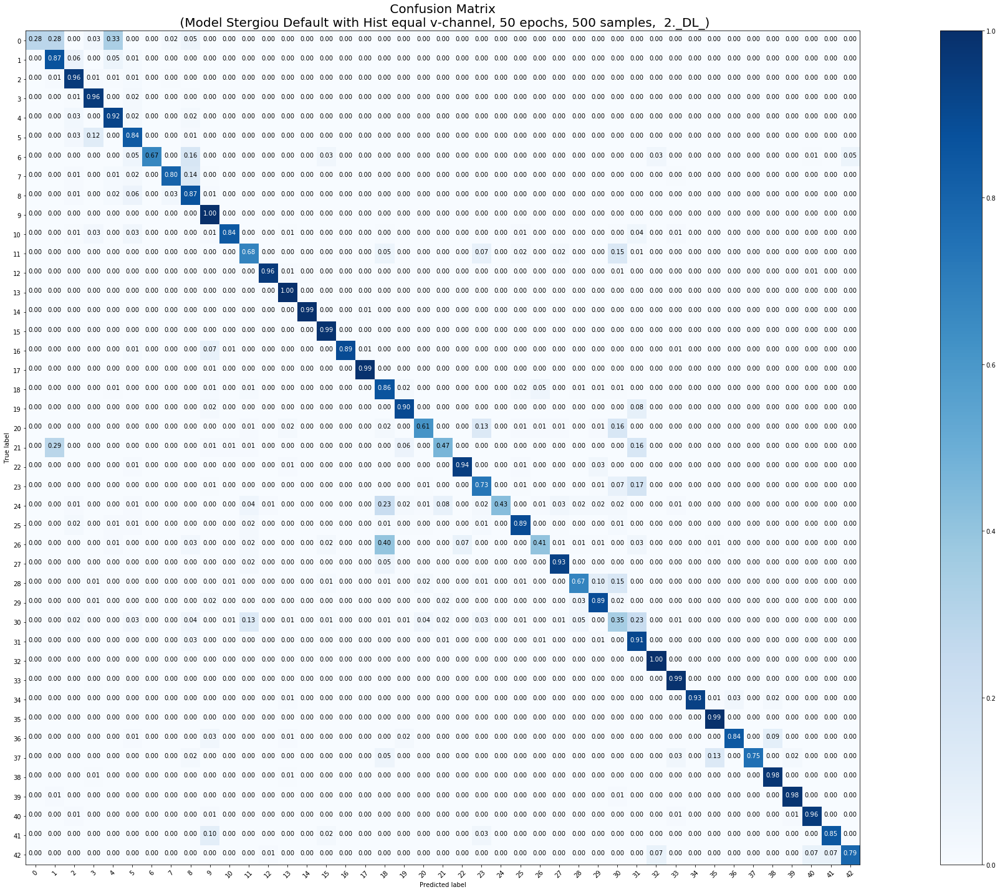

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 5s 9ms/step - loss: 3.2073 - acc: 0.2880 - val_loss: 2.2275 - val_acc: 0.4203
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.4289 - acc: 0.5920 - val_loss: 1.6305 - val_acc: 0.5861
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.7581 - acc: 0.7600 - val_loss: 0.9999 - val_acc: 0.7182
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4505 - acc: 0.8680 - val_loss: 0.9222 - val_acc: 0.7470
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.3015 - acc: 0.9280 - val_loss: 0.7359 - val_acc: 0.7989
Epoch 6/50
500/500 [==============================] - 2s 4ms/

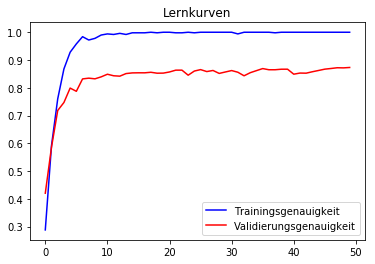

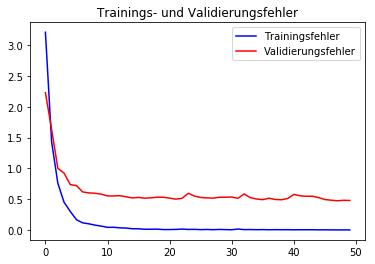

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.96      0.38      0.55        60
           1       0.87      0.90      0.88       720
           2       0.85      0.95      0.90       750
           3       0.84      0.96      0.90       450
           4       0.91      0.90      0.91       660
           5       0.86      0.83      0.84       630
           6       1.00      0.62      0.77       150
           7       0.93      0.77      0.84       450
           8       0.70      0.86      0.77       450
           9       0.86      0.99      0.92       480
          10       1.00      0.84      0.91       660
          11       0.80      0.79      0.79       420
          12       0.96      0.97      0.97       690
          13       0.95      0.99      0.97       720
          14       0.98      1.00      0.99       270
          15       0.91      0.96      0.93       210
          16       1.00      0.83      0.91   

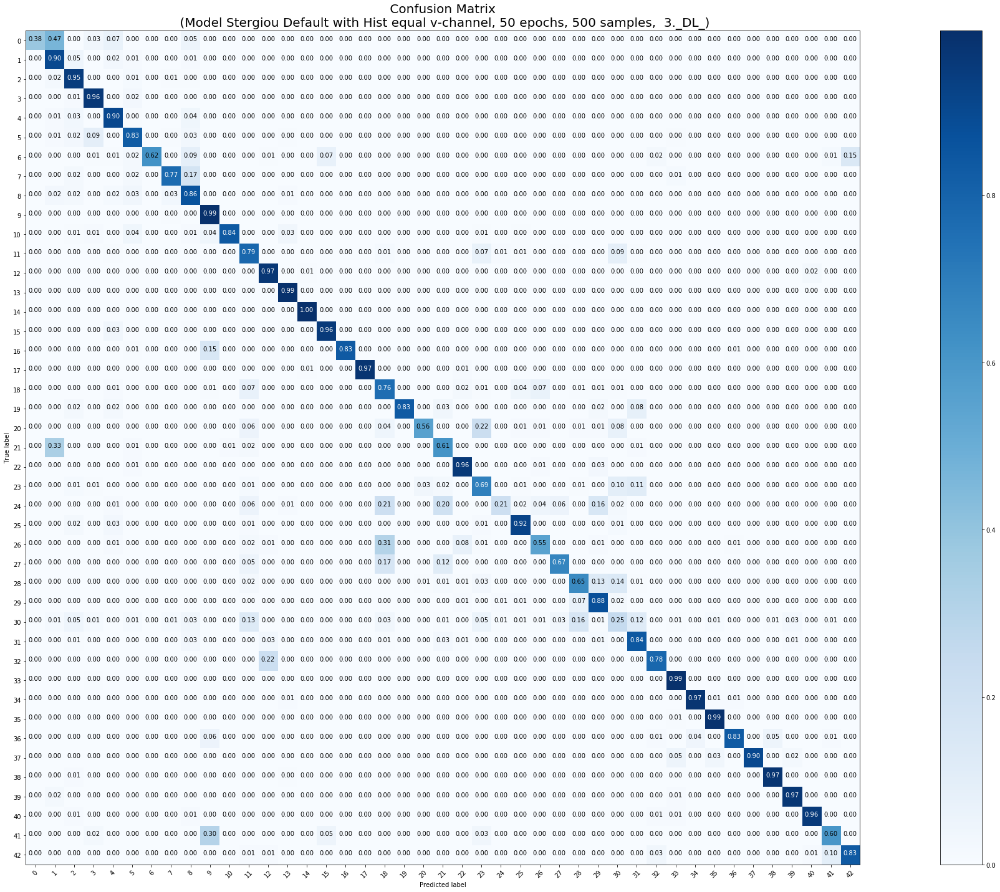

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 5s 10ms/step - loss: 3.4750 - acc: 0.2300 - val_loss: 2.8210 - val_acc: 0.4058
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.4368 - acc: 0.6280 - val_loss: 1.3308 - val_acc: 0.6088
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.8396 - acc: 0.7640 - val_loss: 1.0093 - val_acc: 0.7048
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4369 - acc: 0.8980 - val_loss: 0.7682 - val_acc: 0.7857
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2609 - acc: 0.9300 - val_loss: 0.8283 - val_acc: 0.7756
Epoch 6/50
500/500 [==============================] - 2s 4ms

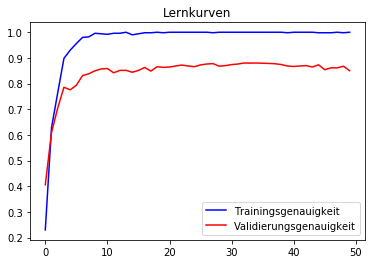

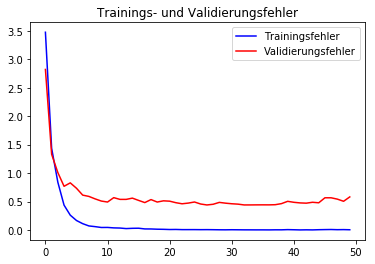

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.53      0.15      0.23        60
           1       0.97      0.70      0.81       720
           2       0.82      0.93      0.87       750
           3       0.90      0.88      0.89       450
           4       0.86      0.89      0.88       660
           5       0.71      0.86      0.78       630
           6       1.00      0.62      0.77       150
           7       1.00      0.46      0.63       450
           8       0.55      0.96      0.70       450
           9       0.83      1.00      0.91       480
          10       0.97      0.81      0.88       660
          11       0.80      0.88      0.84       420
          12       1.00      0.91      0.95       690
          13       0.93      0.99      0.96       720
          14       0.97      1.00      0.98       270
          15       0.88      0.97      0.92       210
          16       1.00      0.88      0.94   

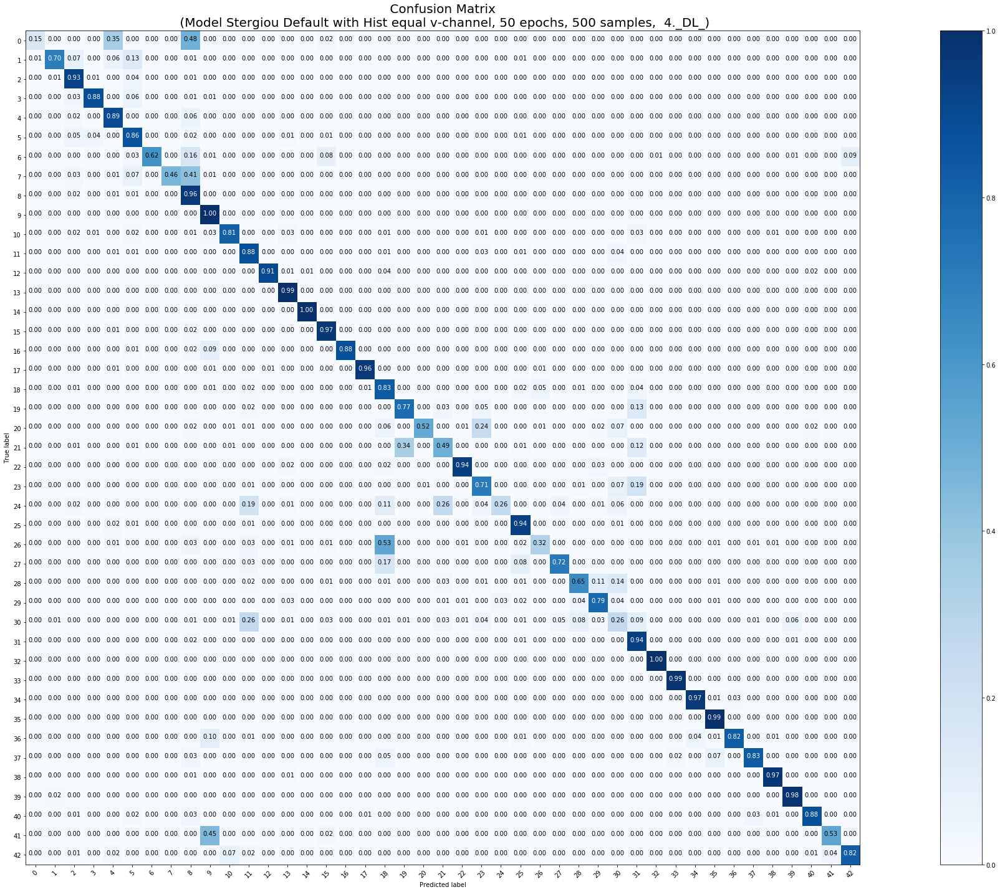

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 6s 11ms/step - loss: 3.2399 - acc: 0.2660 - val_loss: 2.0985 - val_acc: 0.4822
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.4177 - acc: 0.6240 - val_loss: 1.3281 - val_acc: 0.6413
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.7609 - acc: 0.7660 - val_loss: 1.0907 - val_acc: 0.6962
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4643 - acc: 0.8680 - val_loss: 0.7798 - val_acc: 0.7736
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.3206 - acc: 0.9080 - val_loss: 0.7086 - val_acc: 0.8047
Epoch 6/50
500/500 [==============================] - 2s 4ms

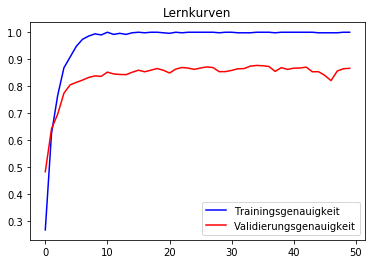

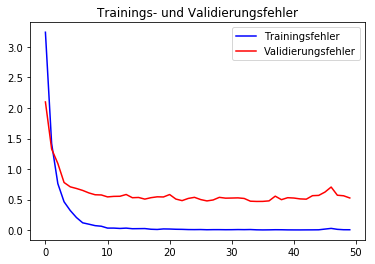

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.67      0.48      0.56        60
           1       0.81      0.93      0.86       720
           2       0.92      0.87      0.89       750
           3       0.92      0.85      0.89       450
           4       0.95      0.89      0.92       660
           5       0.78      0.84      0.81       630
           6       0.95      0.62      0.75       150
           7       0.93      0.81      0.87       450
           8       0.86      0.81      0.83       450
           9       0.95      0.98      0.97       480
          10       0.98      0.87      0.92       660
          11       0.75      0.80      0.78       420
          12       0.99      0.92      0.95       690
          13       0.87      1.00      0.93       720
          14       0.96      1.00      0.98       270
          15       0.77      0.99      0.87       210
          16       0.99      0.86      0.92   

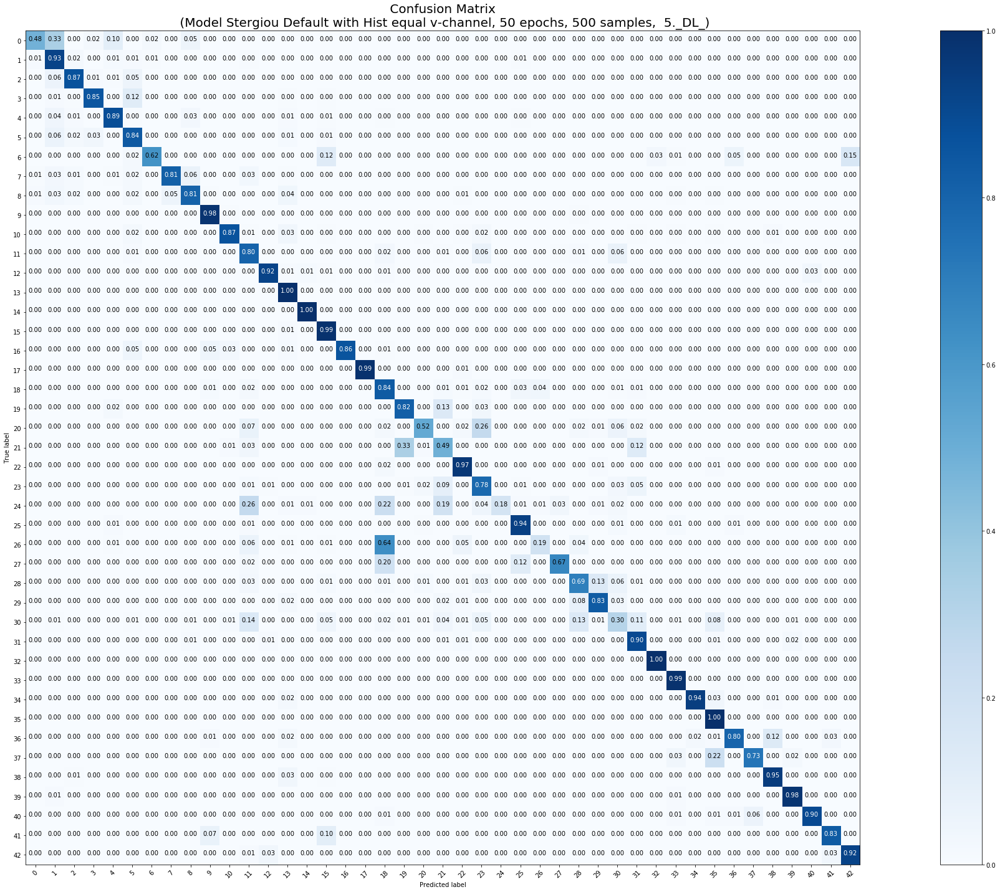

<Figure size 432x288 with 0 Axes>

In [0]:
### 500, B, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_500, y_tr_500, X_test, y_test, 50, 500)

In [0]:
downloader_B(500)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 12s 24ms/step - loss: 4.0015 - acc: 0.1280 - val_loss: 2.8533 - val_acc: 0.3263
Epoch 2/50
500/500 [==============================] - 3s 5ms/step - loss: 2.1658 - acc: 0.4200 - val_loss: 2.2767 - val_acc: 0.4349
Epoch 3/50
500/500 [==============================] - 3s 5ms/step - loss: 1.0809 - acc: 0.6280 - val_loss: 1.8531 - val_acc: 0.4930
Epoch 4/50
500/500 [==============================] - 3s 5ms/step - loss: 0.8165 - acc: 0.7220 - val_loss: 1.5195 - val_acc: 0.6082
Epoch 5/50
500/500 [==============================] - 3s 5ms/step - loss: 0.5495 - acc: 0.8160 - val_loss: 1.0002 - val_acc: 0.7152
Epoch 6/50
500/500 [==============================] -

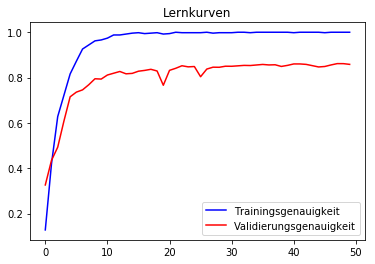

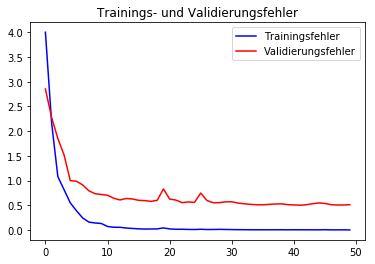

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.70      0.23      0.35        60
           1       0.92      0.84      0.88       720
           2       0.88      0.87      0.88       750
           3       0.76      0.94      0.84       450
           4       0.84      0.91      0.87       660
           5       0.76      0.76      0.76       630
           6       0.90      0.61      0.73       150
           7       0.79      0.83      0.81       450
           8       0.75      0.78      0.76       450
           9       0.92      1.00      0.96       480
          10       0.99      0.84      0.91       660
          11       0.85      0.75      0.80       420
          12       0.98      0.90      0.94       690
          13       0.98      0.99      0.99       720
          14       0.98      0.99      0.99       270
          15       0.80      1.00      0.89       210
          16       0.99      0.89      0.94   

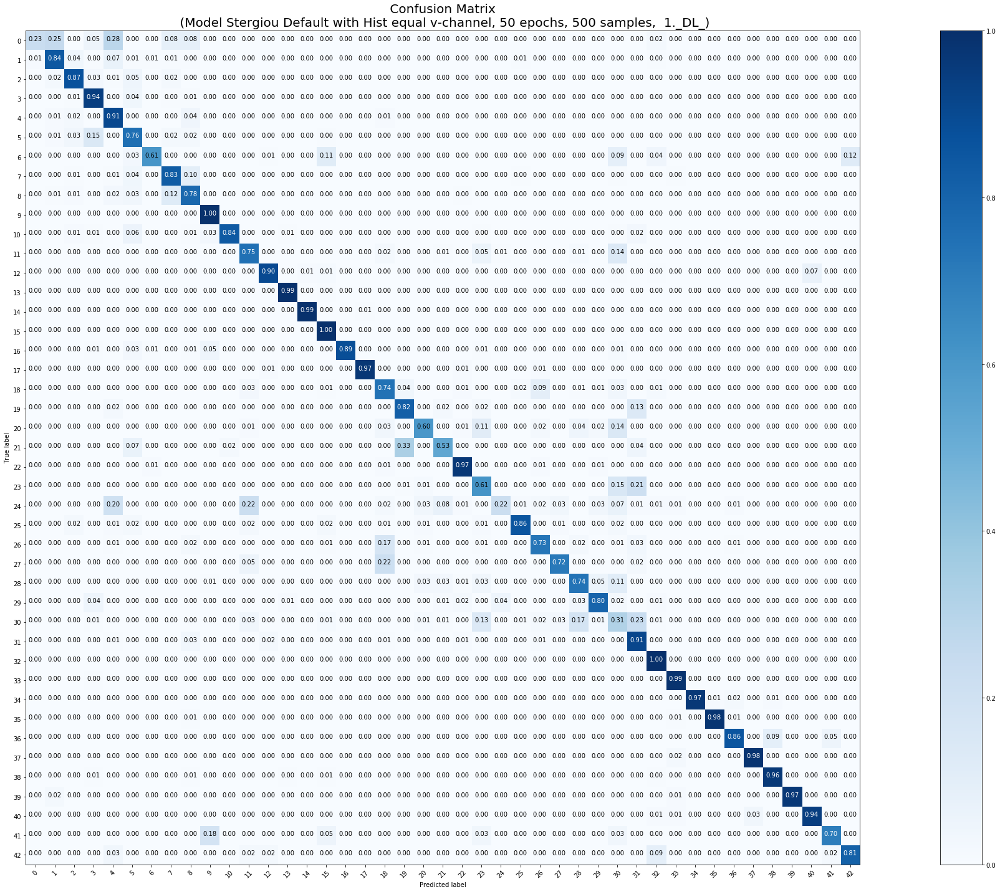

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 13s 25ms/step - loss: 4.1878 - acc: 0.1160 - val_loss: 3.1553 - val_acc: 0.2565
Epoch 2/50
500/500 [==============================] - 3s 5ms/step - loss: 1.9262 - acc: 0.4480 - val_loss: 2.0331 - val_acc: 0.5059
Epoch 3/50
500/500 [==============================] - 3s 5ms/step - loss: 1.1987 - acc: 0.6300 - val_loss: 1.4620 - val_acc: 0.5905
Epoch 4/50
500/500 [==============================] - 3s 5ms/step - loss: 0.9063 - acc: 0.7380 - val_loss: 1.1345 - val_acc: 0.6686
Epoch 5/50
500/500 [==============================] - 3s 5ms/step - loss: 0.4735 - acc: 0.8240 - val_loss: 1.0595 - val_acc: 0.7006
Epoch 6/50
500/500 [==============================] -

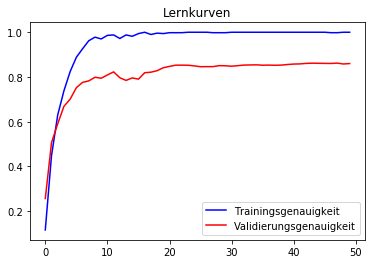

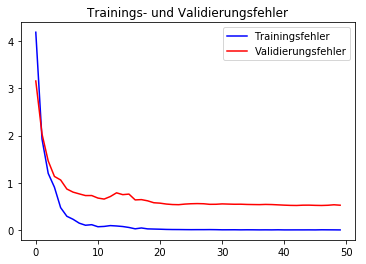

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.85      0.18      0.30        60
           1       0.91      0.87      0.89       720
           2       0.85      0.90      0.87       750
           3       0.83      0.90      0.86       450
           4       0.92      0.90      0.91       660
           5       0.78      0.83      0.80       630
           6       0.98      0.65      0.78       150
           7       0.88      0.70      0.78       450
           8       0.66      0.84      0.74       450
           9       0.92      1.00      0.96       480
          10       1.00      0.82      0.90       660
          11       0.95      0.73      0.82       420
          12       0.98      0.93      0.96       690
          13       0.99      1.00      0.99       720
          14       0.98      0.98      0.98       270
          15       0.83      1.00      0.91       210
          16       1.00      0.90      0.95   

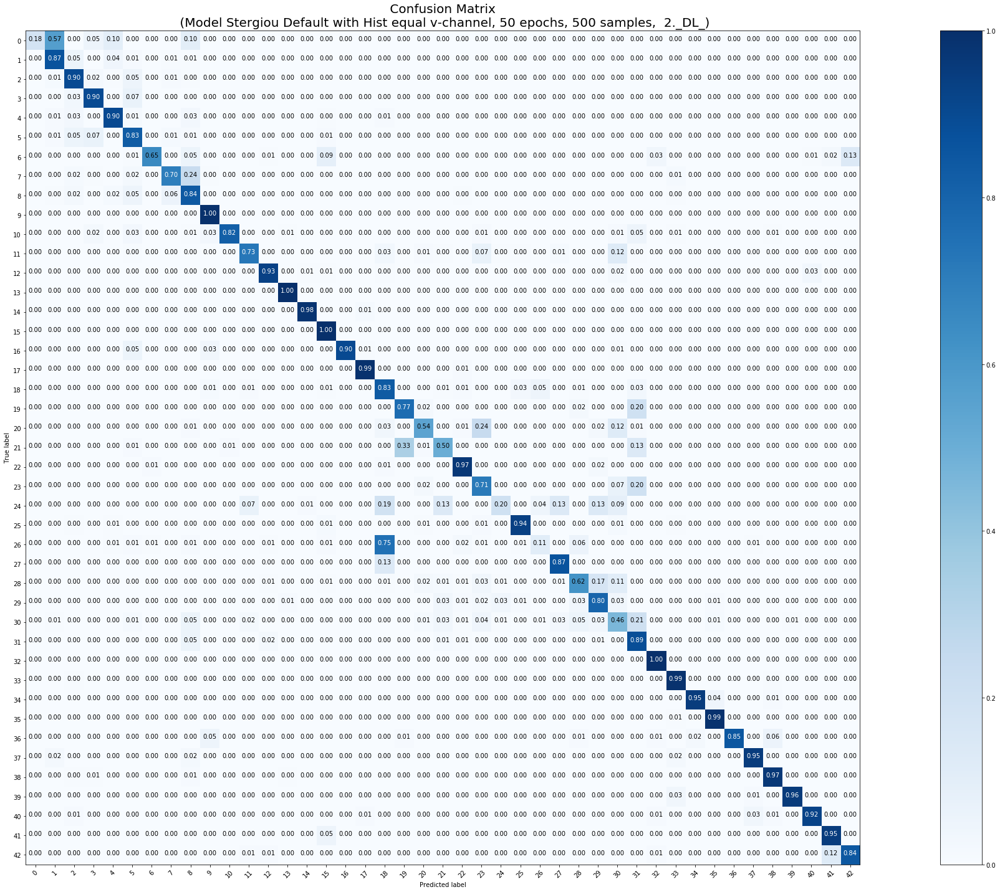

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 13s 26ms/step - loss: 3.9906 - acc: 0.1620 - val_loss: 3.2632 - val_acc: 0.2503
Epoch 2/50
500/500 [==============================] - 3s 5ms/step - loss: 2.1250 - acc: 0.4160 - val_loss: 2.0185 - val_acc: 0.4755
Epoch 3/50
500/500 [==============================] - 3s 5ms/step - loss: 1.1078 - acc: 0.5960 - val_loss: 1.6147 - val_acc: 0.5727
Epoch 4/50
500/500 [==============================] - 3s 5ms/step - loss: 0.7337 - acc: 0.7420 - val_loss: 1.0463 - val_acc: 0.6970
Epoch 5/50
500/500 [==============================] - 3s 5ms/step - loss: 0.4635 - acc: 0.8380 - val_loss: 0.9370 - val_acc: 0.7231
Epoch 6/50
500/500 [==============================] -

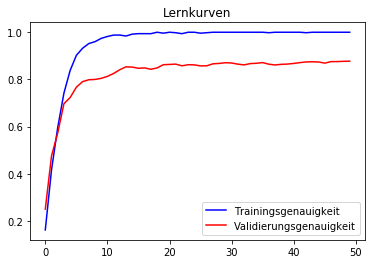

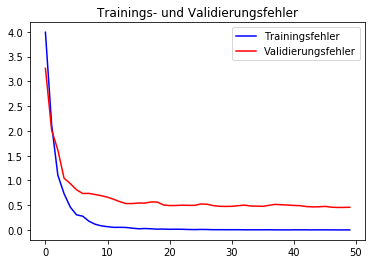

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.88      0.12      0.21        60
           1       0.91      0.87      0.89       720
           2       0.89      0.90      0.90       750
           3       0.86      0.90      0.88       450
           4       0.91      0.91      0.91       660
           5       0.78      0.87      0.82       630
           6       0.83      0.67      0.74       150
           7       0.86      0.84      0.85       450
           8       0.72      0.88      0.79       450
           9       0.94      0.99      0.97       480
          10       0.99      0.83      0.91       660
          11       0.89      0.81      0.84       420
          12       0.98      0.95      0.97       690
          13       0.98      1.00      0.99       720
          14       0.97      0.99      0.98       270
          15       0.98      1.00      0.99       210
          16       0.99      0.95      0.97   

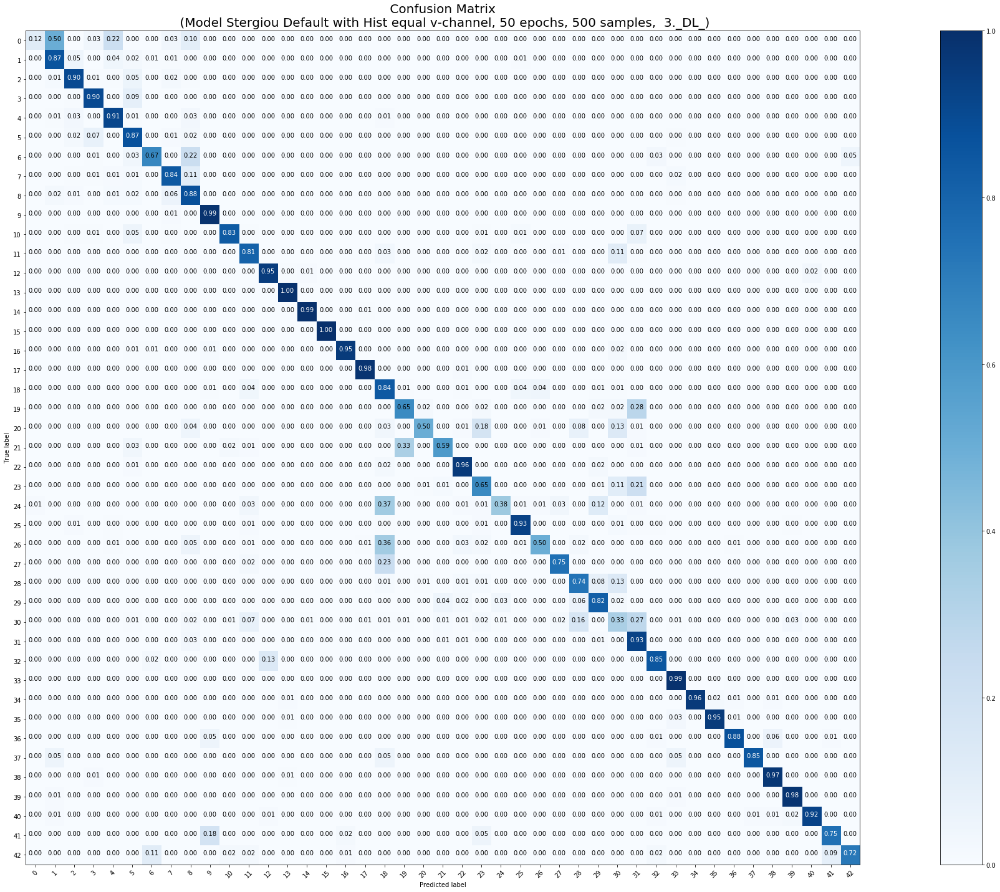

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 13s 27ms/step - loss: 4.0677 - acc: 0.1220 - val_loss: 2.8451 - val_acc: 0.3404
Epoch 2/50
500/500 [==============================] - 3s 5ms/step - loss: 2.0014 - acc: 0.4440 - val_loss: 2.0129 - val_acc: 0.4836
Epoch 3/50
500/500 [==============================] - 3s 5ms/step - loss: 1.2463 - acc: 0.5760 - val_loss: 1.4866 - val_acc: 0.5853
Epoch 4/50
500/500 [==============================] - 3s 5ms/step - loss: 0.8999 - acc: 0.7440 - val_loss: 1.1660 - val_acc: 0.6732
Epoch 5/50
500/500 [==============================] - 3s 5ms/step - loss: 0.4762 - acc: 0.8440 - val_loss: 1.0378 - val_acc: 0.7125
Epoch 6/50
500/500 [==============================] -

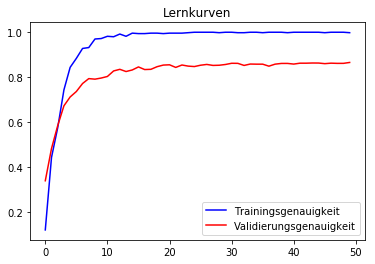

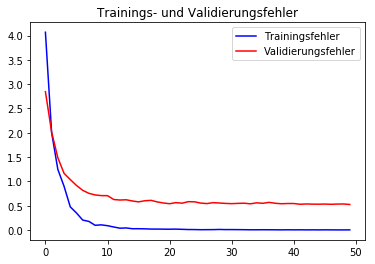

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.81      0.22      0.34        60
           1       0.92      0.89      0.90       720
           2       0.87      0.92      0.90       750
           3       0.85      0.90      0.88       450
           4       0.93      0.90      0.91       660
           5       0.76      0.89      0.82       630
           6       0.94      0.61      0.74       150
           7       0.92      0.81      0.86       450
           8       0.77      0.91      0.84       450
           9       0.86      0.98      0.92       480
          10       1.00      0.80      0.89       660
          11       0.86      0.65      0.75       420
          12       0.98      0.95      0.97       690
          13       0.98      1.00      0.99       720
          14       0.93      1.00      0.96       270
          15       0.89      0.96      0.92       210
          16       0.98      0.93      0.96   

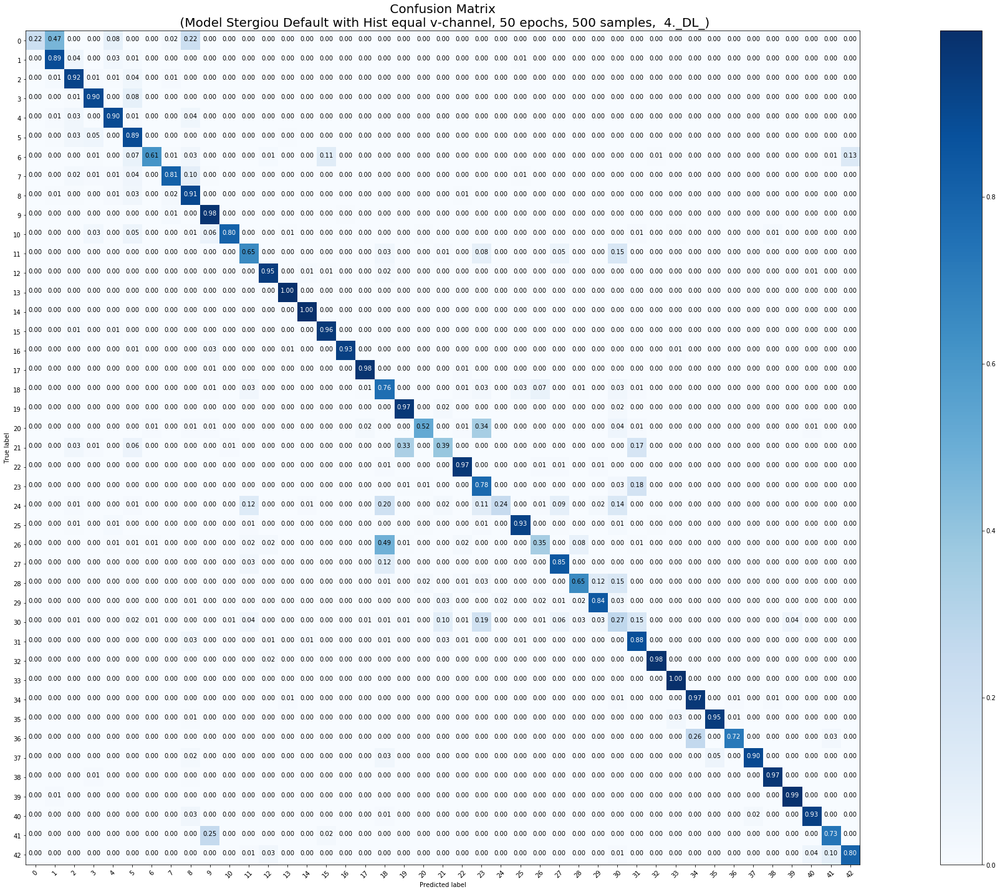

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 14s 29ms/step - loss: 4.1680 - acc: 0.1120 - val_loss: 3.5431 - val_acc: 0.2393
Epoch 2/50
500/500 [==============================] - 3s 5ms/step - loss: 2.2220 - acc: 0.3980 - val_loss: 2.1791 - val_acc: 0.4597
Epoch 3/50
500/500 [==============================] - 3s 5ms/step - loss: 1.2415 - acc: 0.6020 - val_loss: 1.5787 - val_acc: 0.5671
Epoch 4/50
500/500 [==============================] - 3s 5ms/step - loss: 0.8047 - acc: 0.7300 - val_loss: 1.2145 - val_acc: 0.6625
Epoch 5/50
500/500 [==============================] - 3s 5ms/step - loss: 0.4694 - acc: 0.8300 - val_loss: 0.9391 - val_acc: 0.7439
Epoch 6/50
500/500 [==============================] -

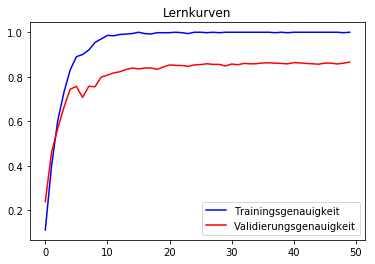

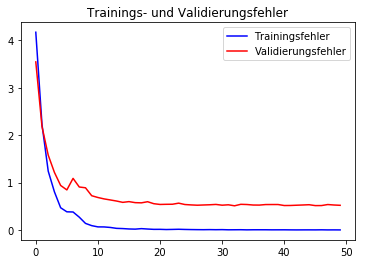

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.67      0.13      0.22        60
           1       0.86      0.89      0.88       720
           2       0.90      0.91      0.90       750
           3       0.85      0.95      0.90       450
           4       0.88      0.92      0.90       660
           5       0.81      0.81      0.81       630
           6       0.97      0.55      0.70       150
           7       0.86      0.85      0.85       450
           8       0.77      0.83      0.80       450
           9       0.93      0.97      0.95       480
          10       0.99      0.81      0.89       660
          11       0.90      0.67      0.77       420
          12       0.99      0.94      0.96       690
          13       0.99      1.00      0.99       720
          14       0.97      0.98      0.98       270
          15       0.90      1.00      0.94       210
          16       1.00      0.91      0.95   

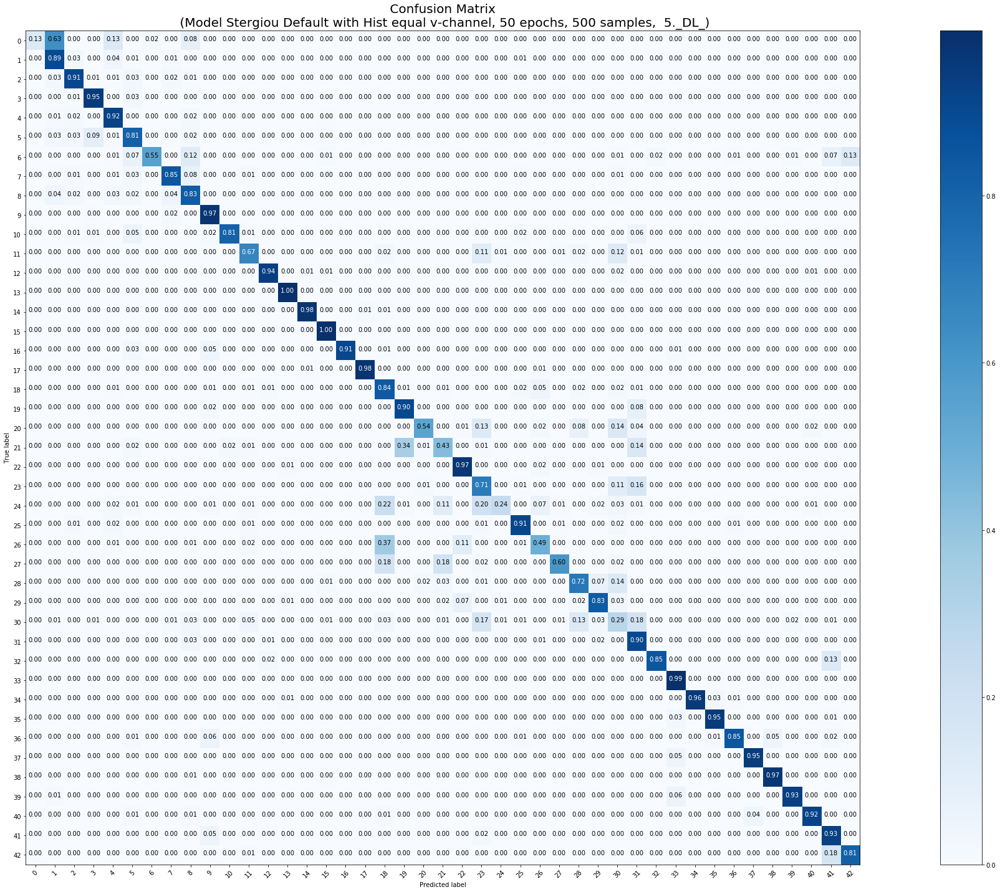

<Figure size 432x288 with 0 Axes>

In [0]:
### 500, B, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_500, y_tr_500, X_test, y_test, 50, 500)

In [0]:
downloaderCW_B(500)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 6s 6ms/step - loss: 2.7036 - acc: 0.3450 - val_loss: 1.7145 - val_acc: 0.5675
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 1.0459 - acc: 0.6830 - val_loss: 0.8819 - val_acc: 0.7361
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.5193 - acc: 0.8510 - val_loss: 0.6459 - val_acc: 0.8022
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2773 - acc: 0.9190 - val_loss: 0.5007 - val_acc: 0.8469
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1718 - acc: 0.9530 - val_loss: 0.4915 - val_acc: 0.8565
Epoch 6/50
1000/1000 [===========================

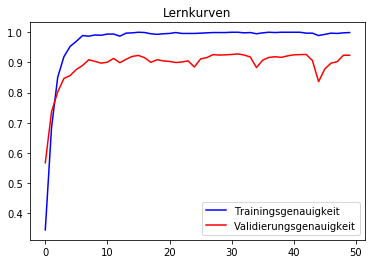

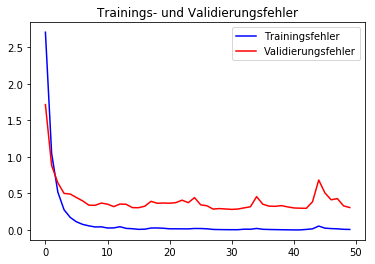

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      0.95      0.95        60
           1       0.92      0.96      0.94       720
           2       0.97      0.98      0.98       750
           3       0.99      0.92      0.96       450
           4       0.94      0.97      0.96       660
           5       0.90      0.92      0.91       630
           6       1.00      0.61      0.76       150
           7       0.97      0.90      0.93       450
           8       0.82      0.93      0.87       450
           9       0.91      1.00      0.95       480
          10       0.99      0.92      0.95       660
          11       0.77      0.85      0.81       420
          12       0.98      0.99      0.98       690
          13       0.98      1.00      0.99       720
          14       1.00      0.93      0.96       270
          15       0.95      0.99      0.97       210
          16       0.99      0.95      0.97   

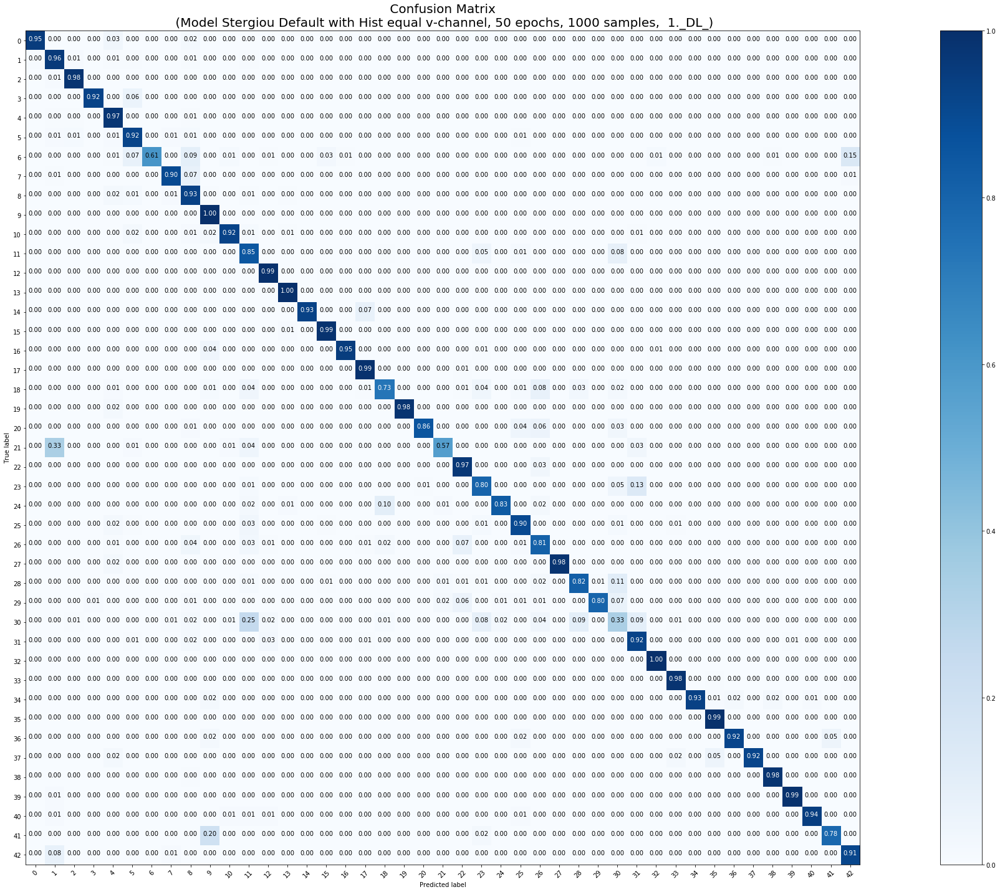

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 7s 7ms/step - loss: 2.6462 - acc: 0.3540 - val_loss: 1.4471 - val_acc: 0.6060
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.9785 - acc: 0.7230 - val_loss: 0.9178 - val_acc: 0.7211
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.5102 - acc: 0.8480 - val_loss: 0.6629 - val_acc: 0.8131
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2573 - acc: 0.9300 - val_loss: 0.5333 - val_acc: 0.8513
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1582 - acc: 0.9620 - val_loss: 0.4592 - val_acc: 0.8708
Epoch 6/50
1000/1000 [===========================

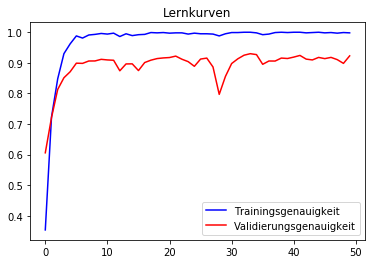

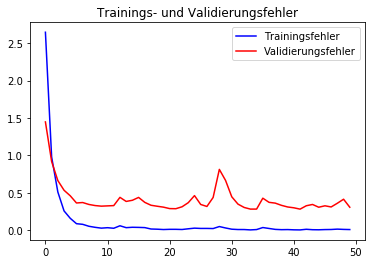

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.94      0.85      0.89        60
           1       0.78      0.97      0.87       720
           2       0.95      0.97      0.96       750
           3       0.99      0.93      0.96       450
           4       0.96      0.97      0.96       660
           5       0.81      0.94      0.87       630
           6       0.99      0.59      0.74       150
           7       0.96      0.91      0.93       450
           8       0.94      0.89      0.91       450
           9       0.92      0.99      0.95       480
          10       0.97      0.94      0.95       660
          11       0.89      0.92      0.91       420
          12       1.00      0.99      0.99       690
          13       0.97      1.00      0.98       720
          14       0.99      0.98      0.99       270
          15       1.00      1.00      1.00       210
          16       1.00      0.94      0.97   

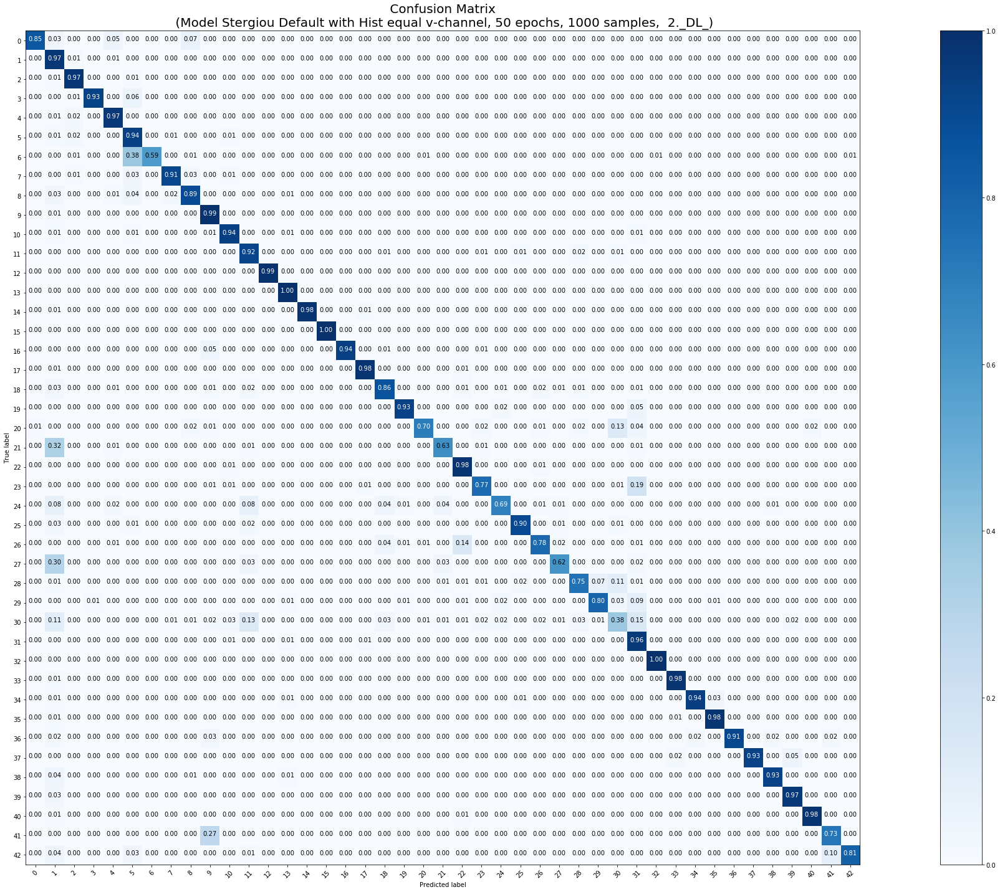

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 7s 7ms/step - loss: 2.4622 - acc: 0.3980 - val_loss: 1.5835 - val_acc: 0.5755
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.8890 - acc: 0.7380 - val_loss: 0.7554 - val_acc: 0.7757
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.4597 - acc: 0.8540 - val_loss: 0.5172 - val_acc: 0.8463
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2380 - acc: 0.9390 - val_loss: 0.4275 - val_acc: 0.8751
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.1909 - acc: 0.9540 - val_loss: 0.3752 - val_acc: 0.8949
Epoch 6/50
1000/1000 [===========================

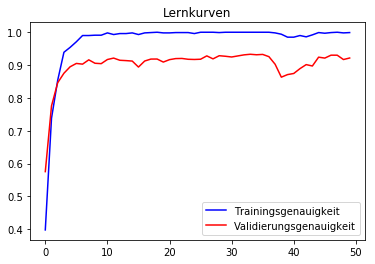

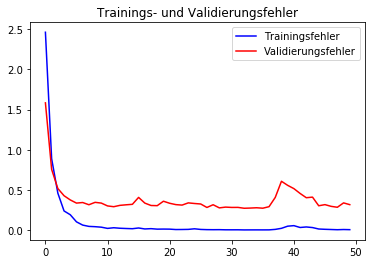

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.92      0.78      0.85        60
           1       0.98      0.89      0.93       720
           2       0.84      0.99      0.91       750
           3       0.99      0.88      0.93       450
           4       0.85      0.97      0.91       660
           5       0.89      0.82      0.85       630
           6       0.98      0.62      0.76       150
           7       0.97      0.87      0.92       450
           8       0.85      0.94      0.89       450
           9       0.90      1.00      0.95       480
          10       0.99      0.93      0.96       660
          11       0.87      0.92      0.90       420
          12       0.98      0.98      0.98       690
          13       0.98      1.00      0.99       720
          14       1.00      0.99      0.99       270
          15       0.87      0.99      0.92       210
          16       1.00      0.94      0.97   

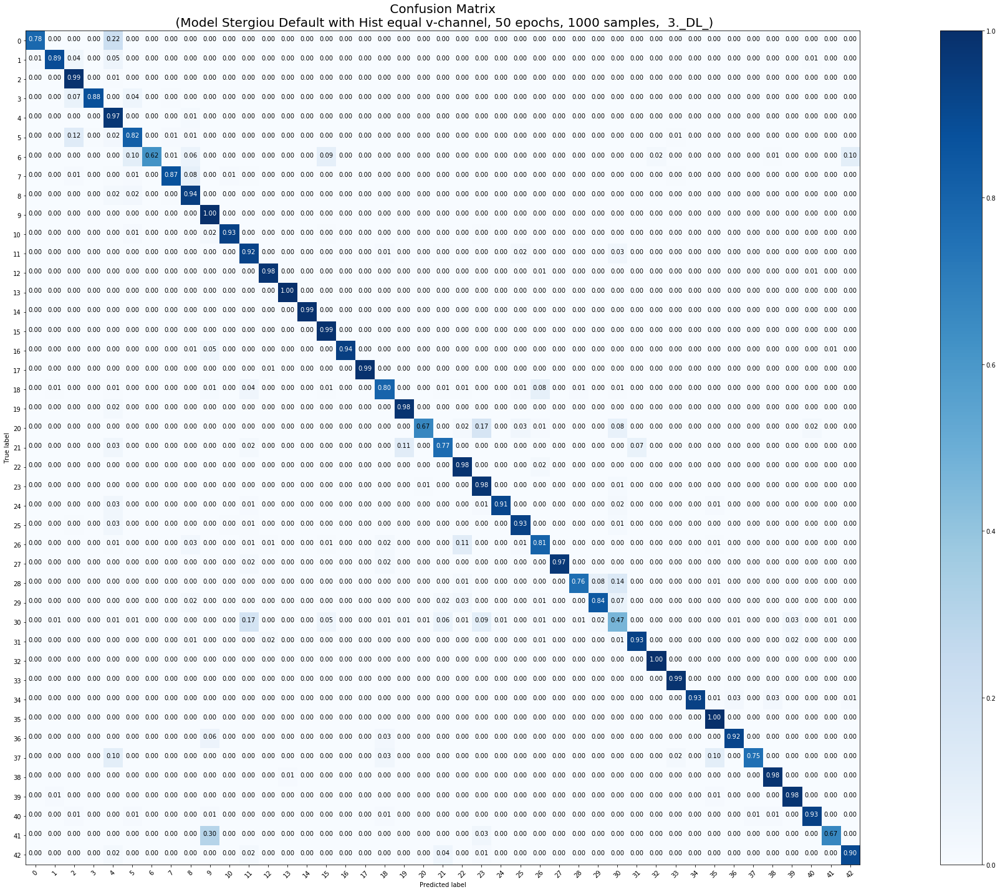

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 7s 7ms/step - loss: 2.6099 - acc: 0.3610 - val_loss: 2.0991 - val_acc: 0.5412
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.9768 - acc: 0.7050 - val_loss: 0.8320 - val_acc: 0.7511
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.5090 - acc: 0.8420 - val_loss: 0.7349 - val_acc: 0.7744
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2807 - acc: 0.9160 - val_loss: 0.4774 - val_acc: 0.8602
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1678 - acc: 0.9490 - val_loss: 0.4289 - val_acc: 0.8654
Epoch 6/50
1000/1000 [===========================

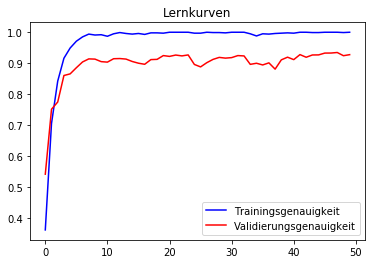

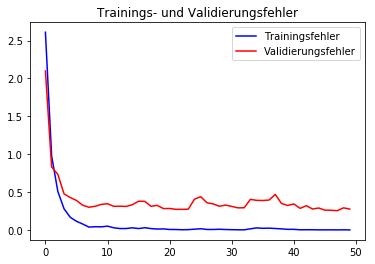

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.82      0.89        60
           1       0.96      0.92      0.94       720
           2       0.95      0.96      0.95       750
           3       0.92      0.95      0.94       450
           4       0.90      0.97      0.94       660
           5       0.85      0.91      0.88       630
           6       0.98      0.61      0.75       150
           7       0.95      0.91      0.93       450
           8       0.89      0.92      0.90       450
           9       0.94      1.00      0.97       480
          10       0.99      0.89      0.94       660
          11       0.93      0.84      0.88       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      1.00       210
          16       1.00      0.93      0.97   

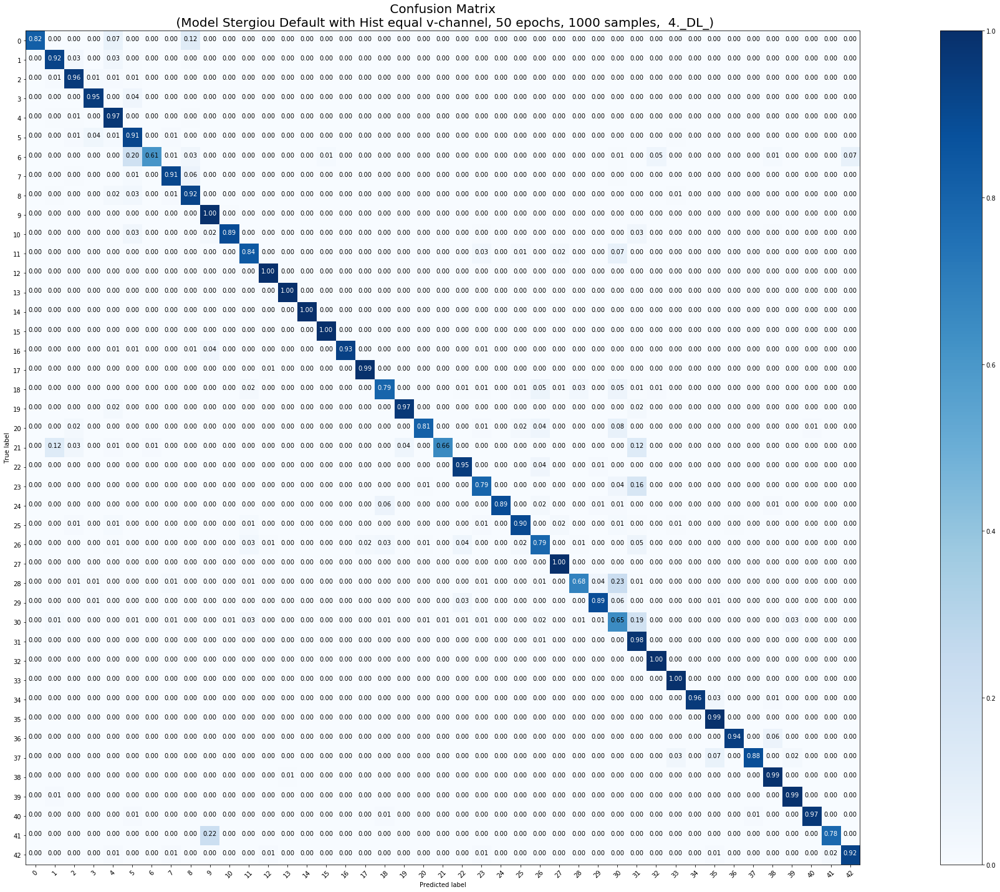

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 8s 8ms/step - loss: 2.5596 - acc: 0.3790 - val_loss: 1.4317 - val_acc: 0.6180
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.9457 - acc: 0.7210 - val_loss: 0.8230 - val_acc: 0.7511
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.4795 - acc: 0.8640 - val_loss: 0.5780 - val_acc: 0.8319
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.2839 - acc: 0.9180 - val_loss: 0.4891 - val_acc: 0.8565
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.1646 - acc: 0.9630 - val_loss: 0.4485 - val_acc: 0.8697
Epoch 6/50
1000/1000 [===========================

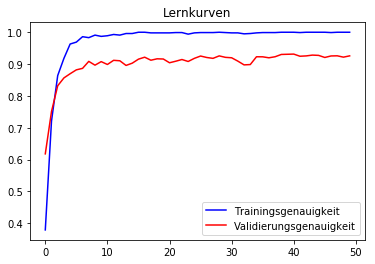

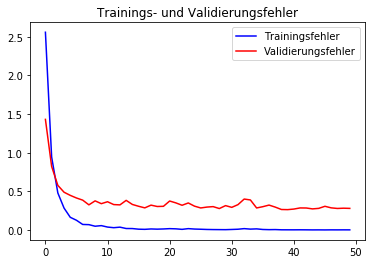

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      0.55      0.70        60
           1       0.93      0.94      0.94       720
           2       0.92      0.99      0.95       750
           3       0.96      0.93      0.95       450
           4       0.94      0.96      0.95       660
           5       0.83      0.92      0.88       630
           6       0.98      0.65      0.78       150
           7       0.98      0.86      0.92       450
           8       0.84      0.91      0.87       450
           9       0.88      1.00      0.93       480
          10       0.98      0.92      0.95       660
          11       0.95      0.87      0.91       420
          12       0.99      0.99      0.99       690
          13       0.98      1.00      0.99       720
          14       0.99      0.92      0.96       270
          15       0.95      0.99      0.97       210
          16       1.00      0.94      0.97   

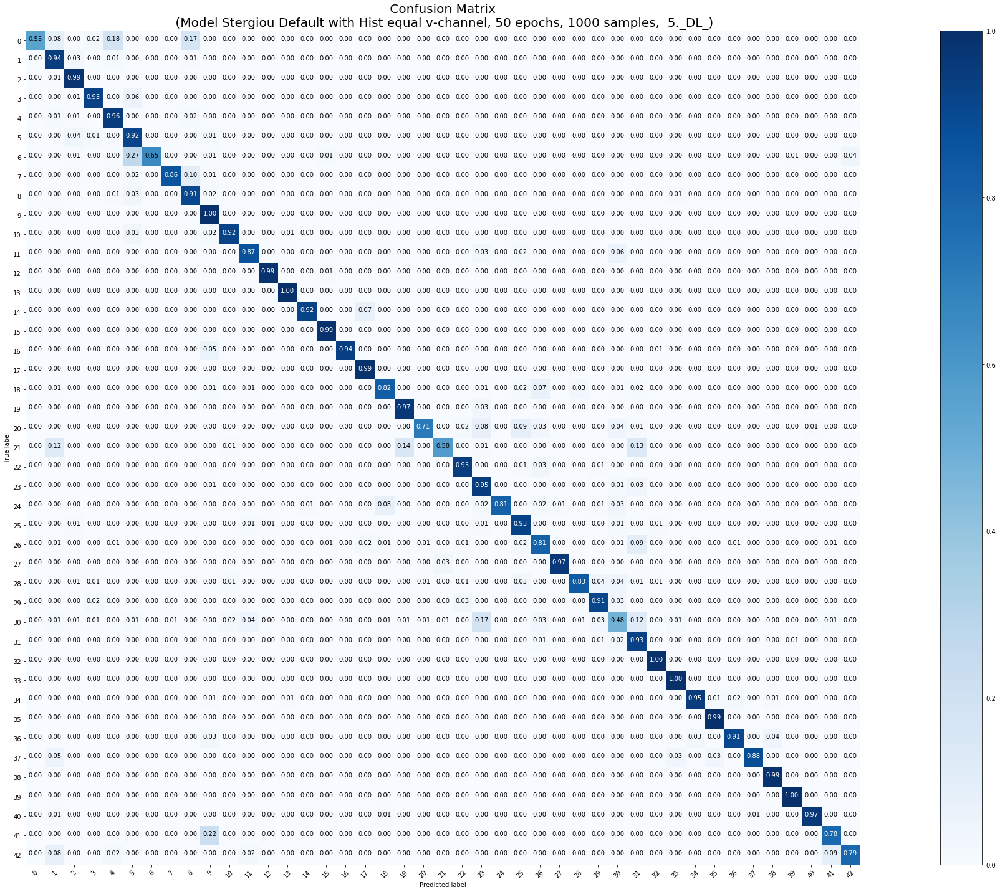

<Figure size 432x288 with 0 Axes>

In [0]:
### 1000, B, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_1000, y_tr_1000, X_test, y_test, 50, 1000)

In [0]:
downloader_B(1000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 15s 15ms/step - loss: 3.6598 - acc: 0.1960 - val_loss: 2.5131 - val_acc: 0.3928
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.4405 - acc: 0.5780 - val_loss: 1.7754 - val_acc: 0.5222
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.6956 - acc: 0.7640 - val_loss: 0.8176 - val_acc: 0.7797
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.3897 - acc: 0.8550 - val_loss: 0.8151 - val_acc: 0.7759
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.2380 - acc: 0.9160 - val_loss: 0.4776 - val_acc: 0.8723
Epoch 6/50
1000/1000 [===================

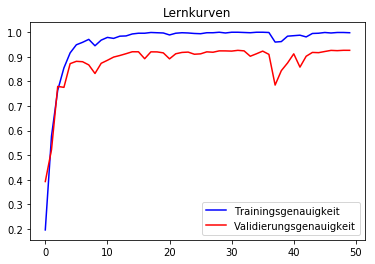

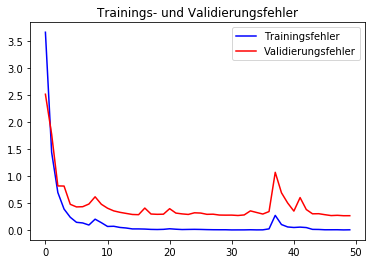

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      0.87      0.90        60
           1       0.93      0.96      0.94       720
           2       0.90      0.98      0.94       750
           3       0.97      0.92      0.95       450
           4       0.98      0.93      0.95       660
           5       0.82      0.91      0.86       630
           6       0.96      0.61      0.74       150
           7       0.95      0.89      0.92       450
           8       0.88      0.88      0.88       450
           9       0.96      0.99      0.97       480
          10       0.98      0.90      0.94       660
          11       0.90      0.89      0.90       420
          12       0.99      0.99      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      0.93      0.96       270
          15       0.95      1.00      0.97       210
          16       1.00      0.95      0.98   

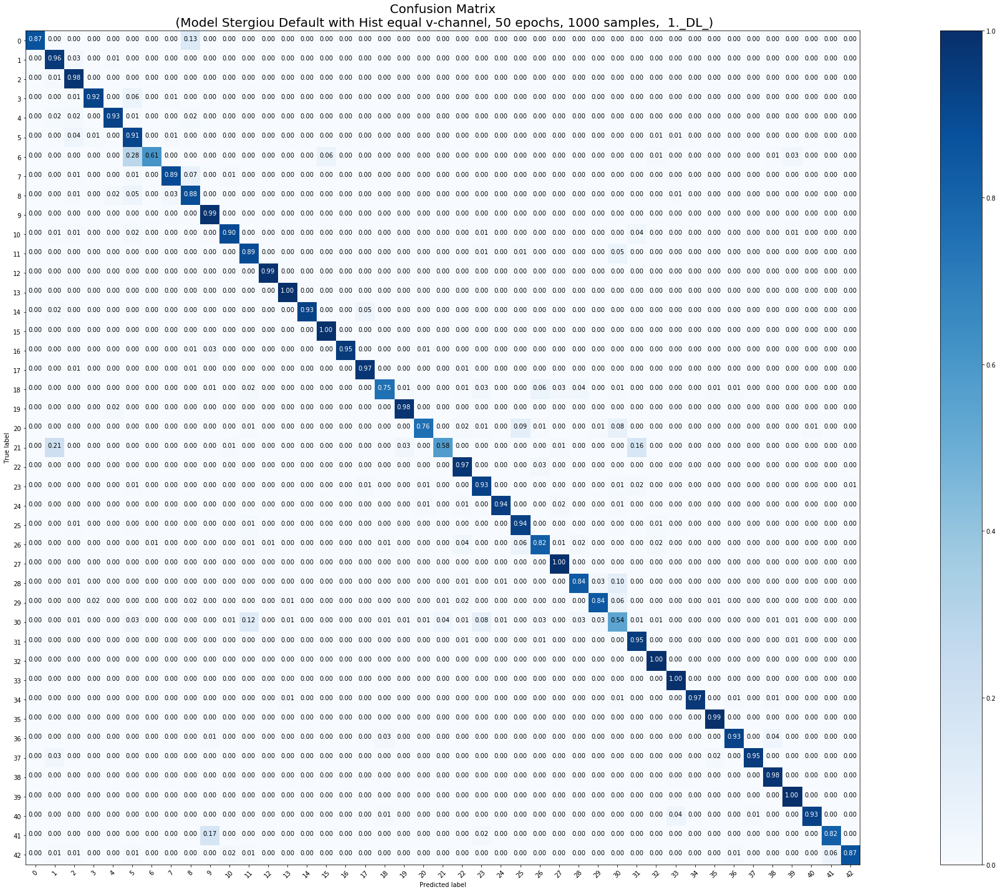

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 15s 15ms/step - loss: 3.3568 - acc: 0.2600 - val_loss: 1.8824 - val_acc: 0.4725
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.3814 - acc: 0.5830 - val_loss: 1.4842 - val_acc: 0.6220
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.7822 - acc: 0.7370 - val_loss: 1.4283 - val_acc: 0.6470
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.4426 - acc: 0.8470 - val_loss: 0.6761 - val_acc: 0.8139
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.2300 - acc: 0.9100 - val_loss: 0.6664 - val_acc: 0.7979
Epoch 6/50
1000/1000 [===================

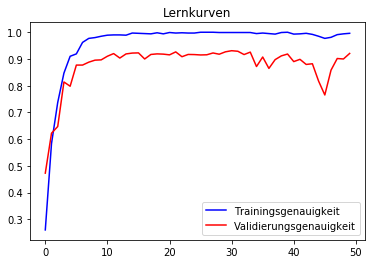

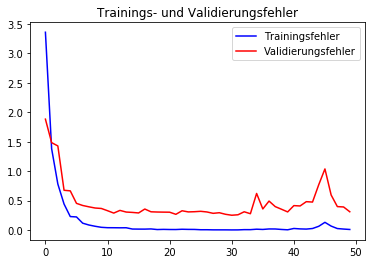

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.87      0.88      0.88        60
           1       0.97      0.92      0.94       720
           2       0.86      0.98      0.92       750
           3       0.84      0.99      0.91       450
           4       0.91      0.96      0.94       660
           5       0.98      0.77      0.86       630
           6       0.99      0.64      0.78       150
           7       0.94      0.87      0.90       450
           8       0.85      0.91      0.88       450
           9       0.95      0.99      0.97       480
          10       0.98      0.90      0.94       660
          11       0.83      0.97      0.89       420
          12       1.00      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       0.98      1.00      0.99       270
          15       0.93      0.98      0.95       210
          16       0.99      0.95      0.97   

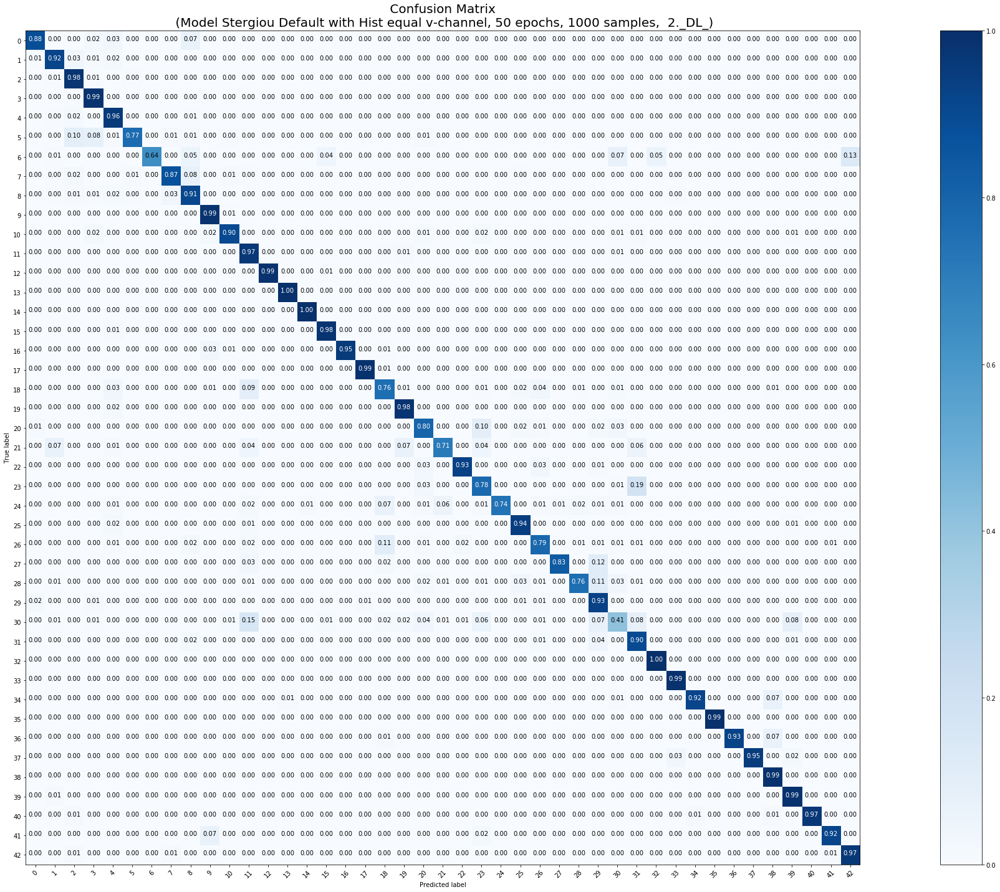

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 15s 15ms/step - loss: 3.3221 - acc: 0.2420 - val_loss: 1.8417 - val_acc: 0.5081
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.3658 - acc: 0.5880 - val_loss: 1.2662 - val_acc: 0.6470
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.6146 - acc: 0.7680 - val_loss: 0.6792 - val_acc: 0.8159
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.3921 - acc: 0.8770 - val_loss: 0.7212 - val_acc: 0.8010
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.2737 - acc: 0.9030 - val_loss: 0.5373 - val_acc: 0.8499
Epoch 6/50
1000/1000 [===================

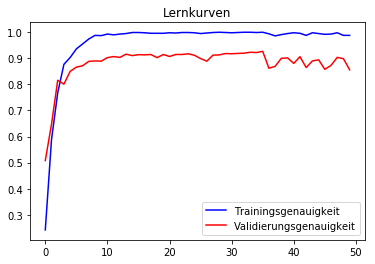

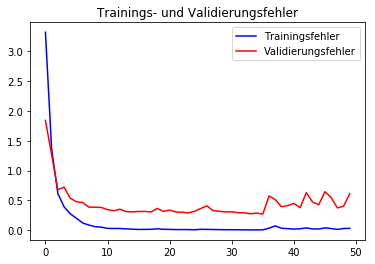

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.86      0.83      0.85        60
           1       0.99      0.76      0.86       720
           2       0.68      0.98      0.80       750
           3       0.99      0.82      0.90       450
           4       0.92      0.94      0.93       660
           5       0.86      0.69      0.76       630
           6       1.00      0.61      0.76       150
           7       0.90      0.84      0.87       450
           8       0.90      0.84      0.87       450
           9       0.94      0.99      0.96       480
          10       0.97      0.88      0.93       660
          11       0.98      0.76      0.85       420
          12       0.56      1.00      0.72       690
          13       0.93      0.99      0.96       720
          14       1.00      0.98      0.99       270
          15       0.97      0.98      0.97       210
          16       0.99      0.89      0.94   

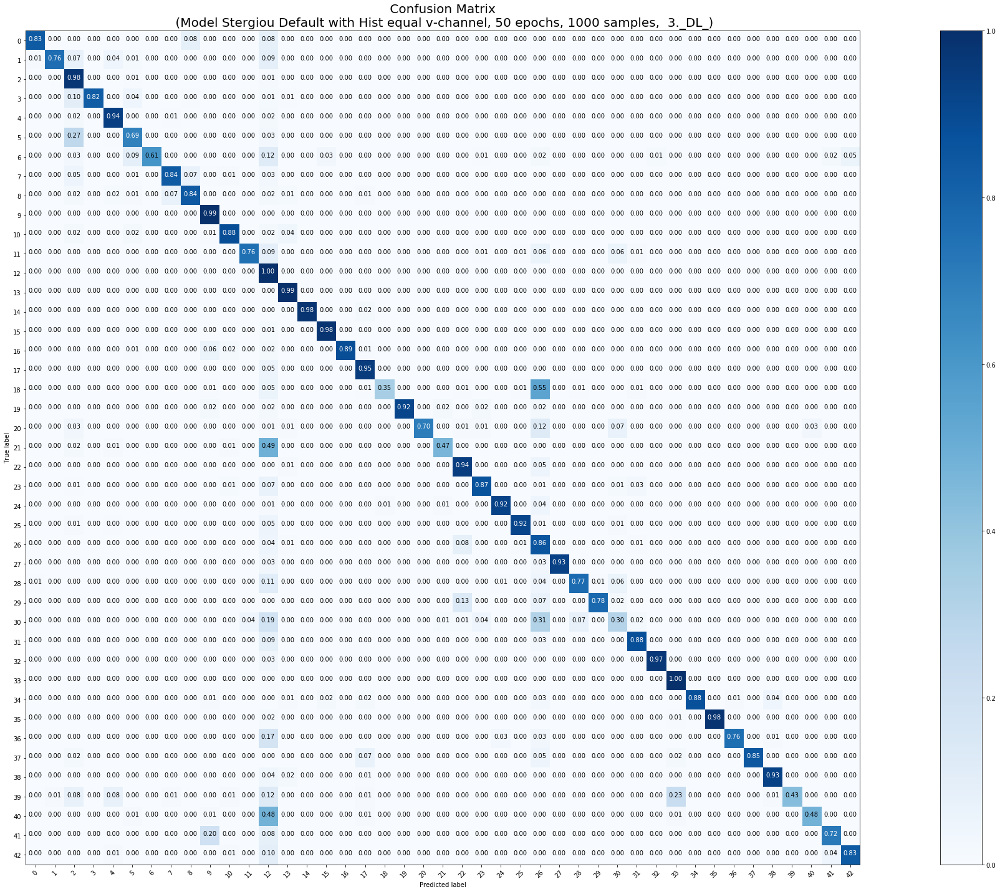

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 16s 16ms/step - loss: 3.3176 - acc: 0.2310 - val_loss: 1.9841 - val_acc: 0.4793
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.3577 - acc: 0.6000 - val_loss: 1.0858 - val_acc: 0.6704
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.7162 - acc: 0.7570 - val_loss: 0.8448 - val_acc: 0.7653
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.5314 - acc: 0.8360 - val_loss: 0.9421 - val_acc: 0.7546
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.2782 - acc: 0.8990 - val_loss: 0.5628 - val_acc: 0.8499
Epoch 6/50
1000/1000 [===================

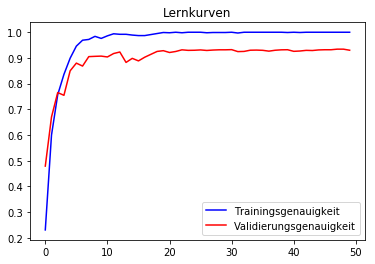

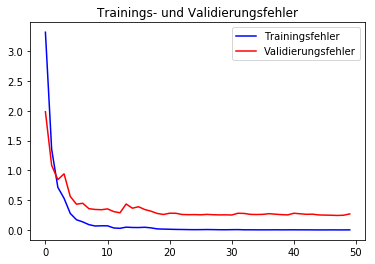

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.84      0.82      0.83        60
           1       0.97      0.92      0.94       720
           2       0.96      0.98      0.97       750
           3       0.97      0.94      0.95       450
           4       0.92      0.96      0.94       660
           5       0.78      0.96      0.86       630
           6       0.98      0.61      0.75       150
           7       0.93      0.91      0.92       450
           8       0.88      0.88      0.88       450
           9       0.92      0.99      0.95       480
          10       0.97      0.91      0.94       660
          11       0.92      0.84      0.88       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.99      1.00       270
          15       0.93      1.00      0.96       210
          16       0.99      0.95      0.97   

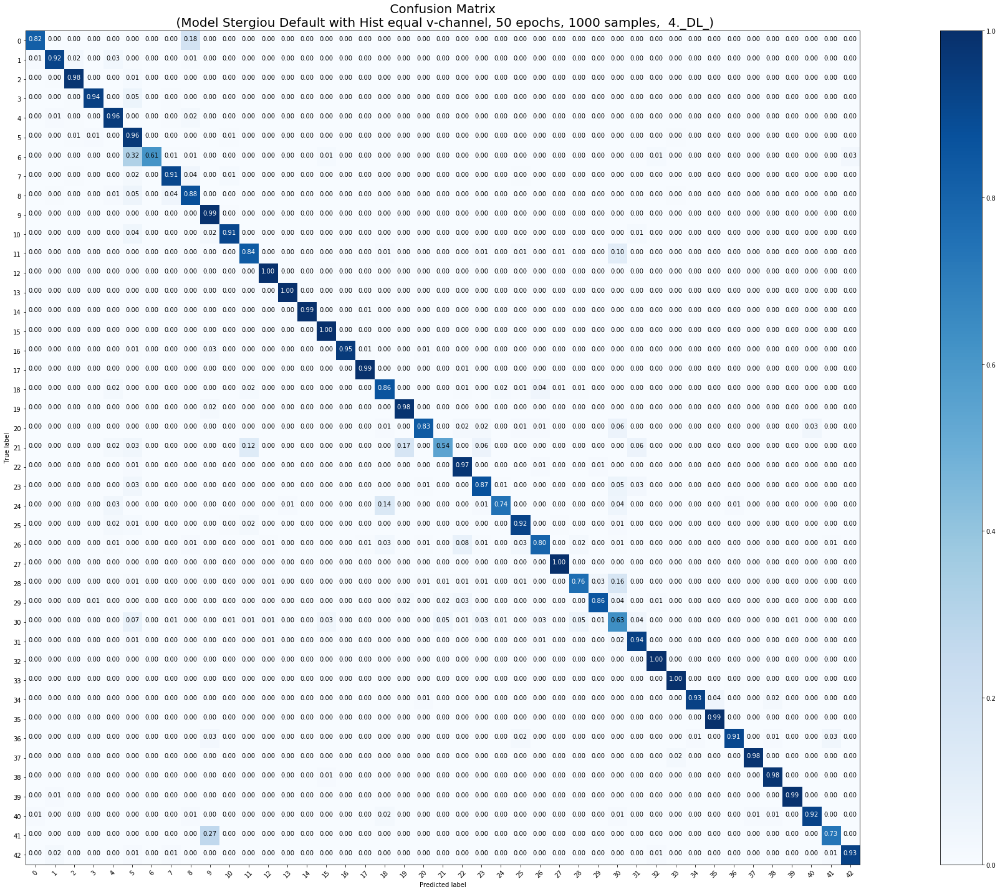

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 16s 16ms/step - loss: 3.2667 - acc: 0.2670 - val_loss: 2.1013 - val_acc: 0.4799
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.2567 - acc: 0.6120 - val_loss: 1.0856 - val_acc: 0.6806
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.6720 - acc: 0.7750 - val_loss: 0.7553 - val_acc: 0.7919
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.3980 - acc: 0.8690 - val_loss: 0.6138 - val_acc: 0.8241
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.2502 - acc: 0.9150 - val_loss: 0.4323 - val_acc: 0.8839
Epoch 6/50
1000/1000 [===================

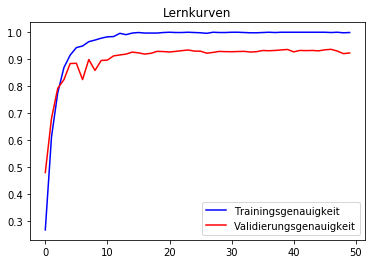

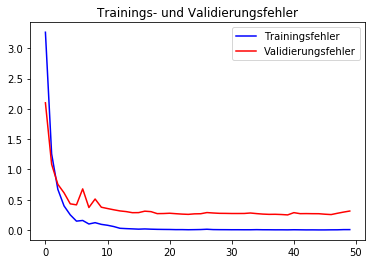

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.75      0.85        60
           1       0.98      0.87      0.92       720
           2       0.84      0.99      0.91       750
           3       0.93      0.96      0.94       450
           4       0.93      0.95      0.94       660
           5       0.84      0.89      0.86       630
           6       0.97      0.64      0.77       150
           7       0.97      0.87      0.92       450
           8       0.86      0.89      0.87       450
           9       0.94      1.00      0.97       480
          10       0.97      0.93      0.95       660
          11       0.96      0.90      0.92       420
          12       0.97      1.00      0.98       690
          13       0.98      1.00      0.99       720
          14       0.95      1.00      0.98       270
          15       0.78      0.99      0.88       210
          16       0.99      0.95      0.97   

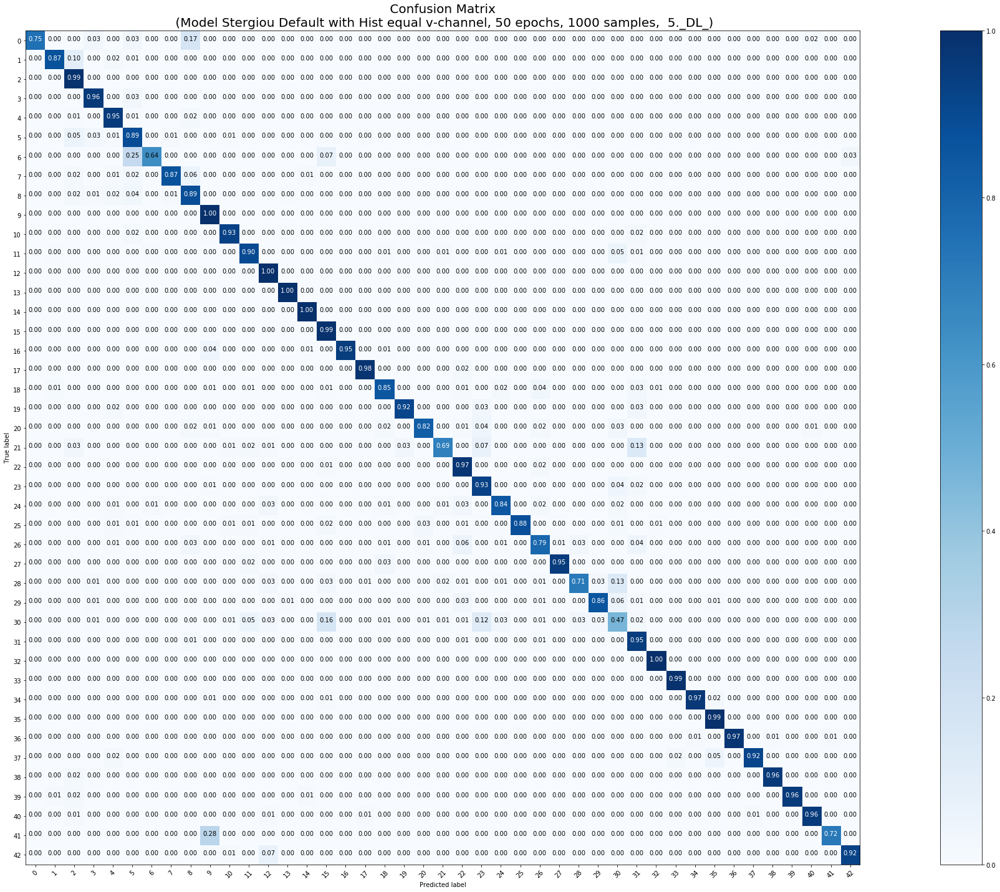

<Figure size 432x288 with 0 Axes>

In [0]:
### 1000, B, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_1000, y_tr_1000, X_test, y_test, 50, 1000)

In [0]:
downloaderCW_B(1000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 8s 4ms/step - loss: 1.8920 - acc: 0.5105 - val_loss: 1.0434 - val_acc: 0.6958
Epoch 2/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.5089 - acc: 0.8460 - val_loss: 0.3974 - val_acc: 0.8818
Epoch 3/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.2112 - acc: 0.9400 - val_loss: 0.3737 - val_acc: 0.8922
Epoch 4/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1286 - acc: 0.9665 - val_loss: 0.3019 - val_acc: 0.9109
Epoch 5/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.0913 - acc: 0.9745 - val_loss: 0.2607 - val_acc: 0.9267
Epoch 6/50
2000/2000 [===========================

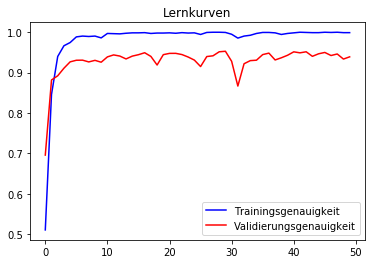

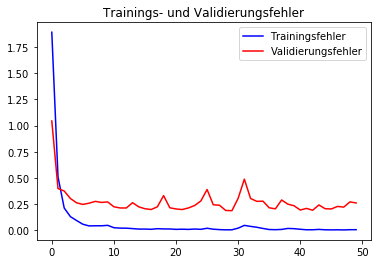

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      0.97      0.96        60
           1       0.94      0.96      0.95       720
           2       0.97      0.99      0.98       750
           3       0.93      0.97      0.95       450
           4       0.97      0.98      0.97       660
           5       0.89      0.93      0.91       630
           6       0.99      0.57      0.73       150
           7       0.99      0.94      0.97       450
           8       0.97      0.92      0.95       450
           9       0.96      0.98      0.97       480
          10       0.98      0.97      0.97       660
          11       0.96      0.86      0.91       420
          12       0.99      1.00      0.99       690
          13       0.97      1.00      0.98       720
          14       1.00      1.00      1.00       270
          15       0.88      1.00      0.93       210
          16       1.00      0.95      0.98   

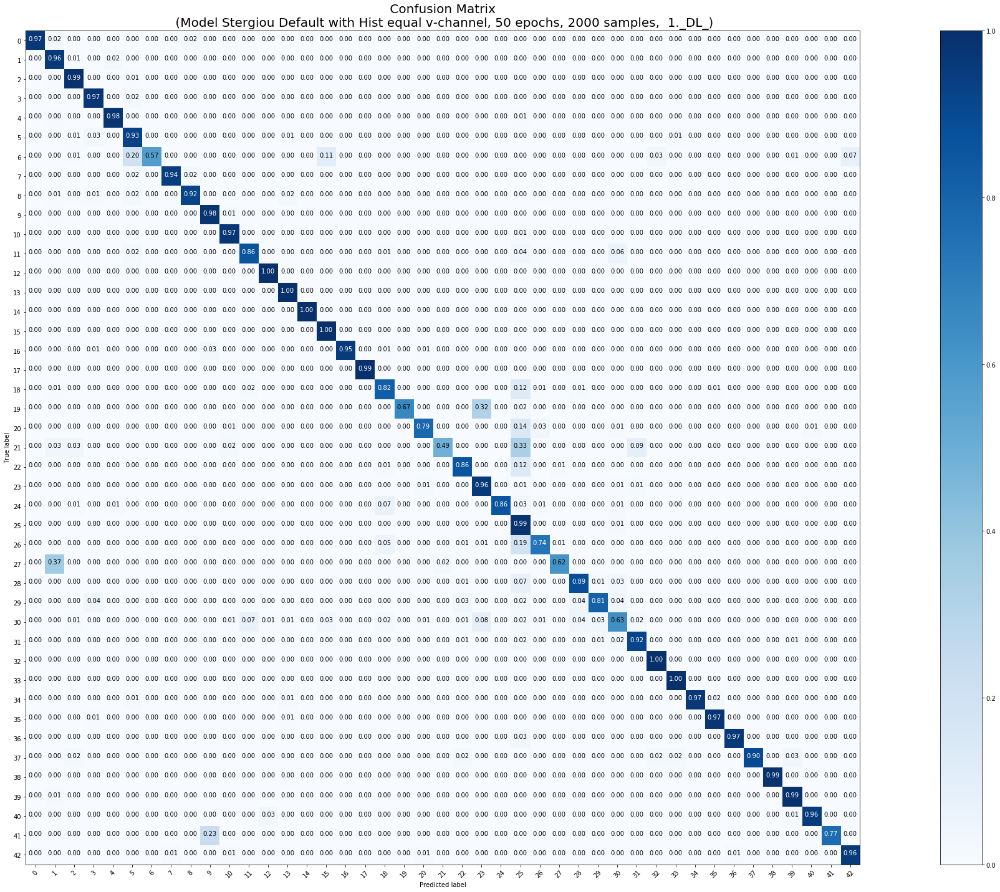

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 9s 4ms/step - loss: 1.7675 - acc: 0.5540 - val_loss: 0.7244 - val_acc: 0.7827
Epoch 2/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.4732 - acc: 0.8560 - val_loss: 0.3972 - val_acc: 0.8854
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.2302 - acc: 0.9315 - val_loss: 0.3303 - val_acc: 0.9038
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1255 - acc: 0.9675 - val_loss: 0.3698 - val_acc: 0.8929
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0865 - acc: 0.9785 - val_loss: 0.2598 - val_acc: 0.9337
Epoch 6/50
2000/2000 [===========================

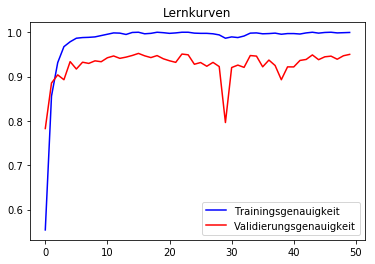

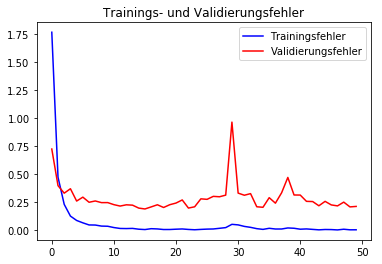

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      0.97      0.97        60
           1       0.99      0.95      0.97       720
           2       0.97      1.00      0.98       750
           3       0.97      0.94      0.96       450
           4       0.96      0.98      0.97       660
           5       0.86      0.96      0.91       630
           6       1.00      0.63      0.78       150
           7       0.96      0.96      0.96       450
           8       0.96      0.91      0.93       450
           9       0.96      1.00      0.98       480
          10       0.99      0.97      0.98       660
          11       0.86      0.90      0.88       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.98      0.99       270
          15       0.96      1.00      0.98       210
          16       1.00      0.94      0.97   

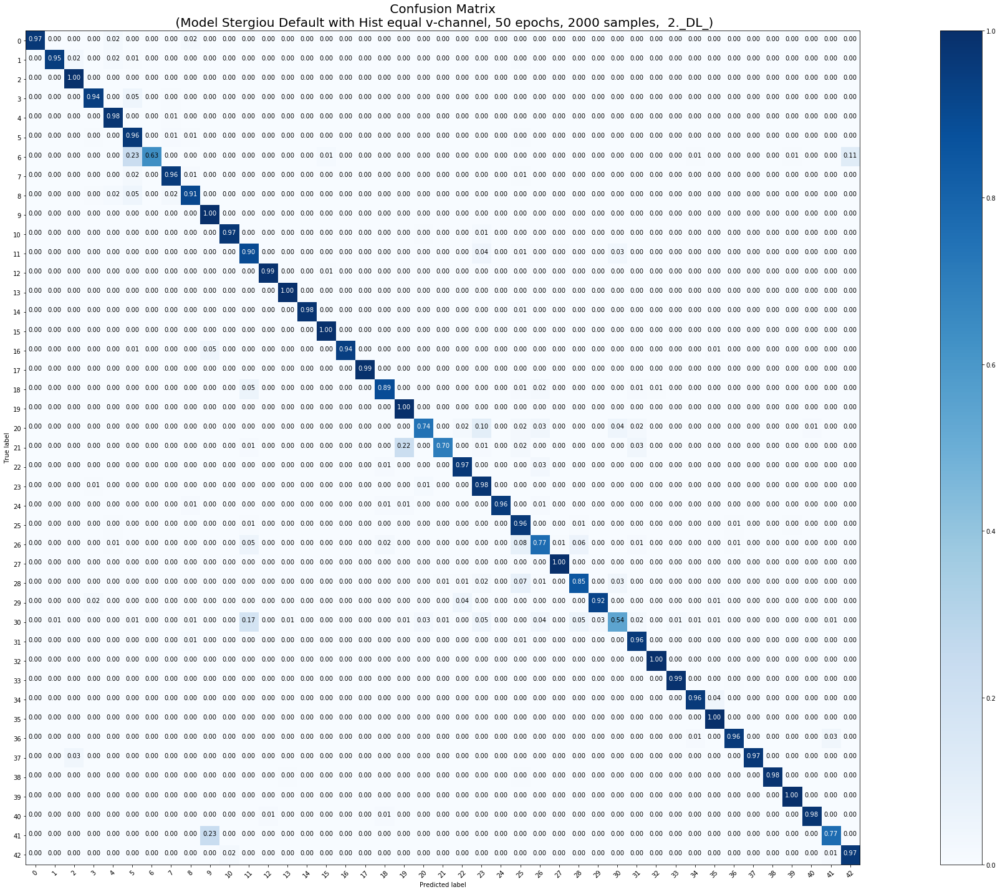

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 10s 5ms/step - loss: 1.9050 - acc: 0.5170 - val_loss: 0.7827 - val_acc: 0.7584
Epoch 2/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.5309 - acc: 0.8350 - val_loss: 0.5221 - val_acc: 0.8432
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.2299 - acc: 0.9320 - val_loss: 0.4200 - val_acc: 0.8792
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1334 - acc: 0.9640 - val_loss: 0.3317 - val_acc: 0.9027
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0812 - acc: 0.9740 - val_loss: 0.2738 - val_acc: 0.9234
Epoch 6/50
2000/2000 [==========================

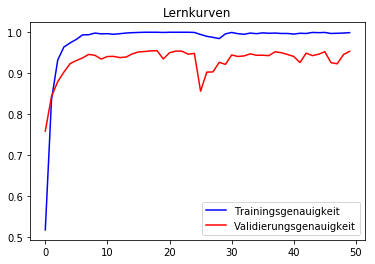

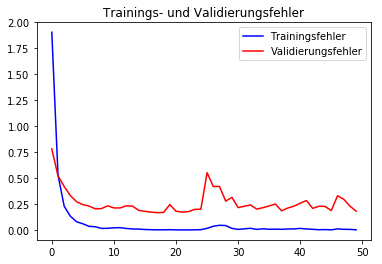

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.97      0.98      0.97       720
           2       0.96      0.99      0.98       750
           3       0.97      0.94      0.95       450
           4       0.98      0.98      0.98       660
           5       0.91      0.93      0.92       630
           6       0.97      0.67      0.80       150
           7       0.96      0.98      0.97       450
           8       0.99      0.93      0.96       450
           9       0.94      1.00      0.97       480
          10       0.99      0.97      0.98       660
          11       0.86      0.97      0.91       420
          12       0.98      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.99      0.99       270
          15       0.98      0.98      0.98       210
          16       1.00      0.95      0.97   

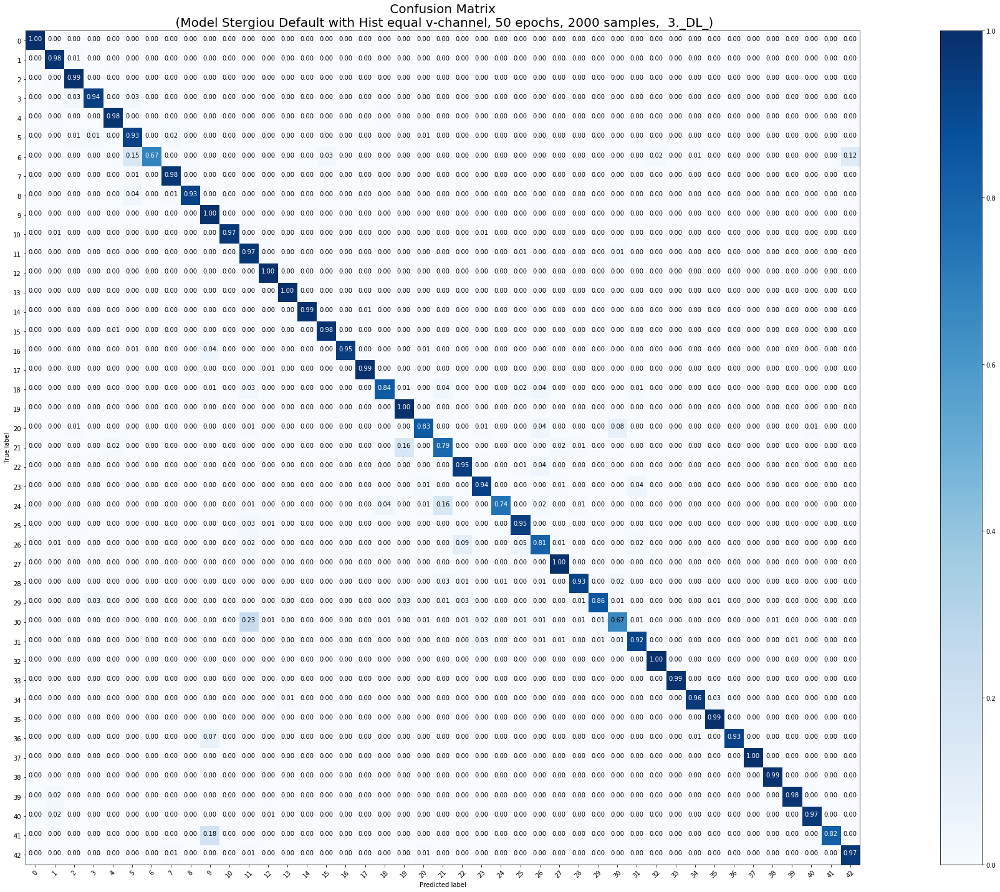

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 10s 5ms/step - loss: 1.8644 - acc: 0.5225 - val_loss: 0.7848 - val_acc: 0.7716
Epoch 2/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.4504 - acc: 0.8700 - val_loss: 0.4796 - val_acc: 0.8628
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.2358 - acc: 0.9285 - val_loss: 0.3652 - val_acc: 0.8974
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1330 - acc: 0.9605 - val_loss: 0.2804 - val_acc: 0.9195
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0864 - acc: 0.9780 - val_loss: 0.2474 - val_acc: 0.9302
Epoch 6/50
2000/2000 [==========================

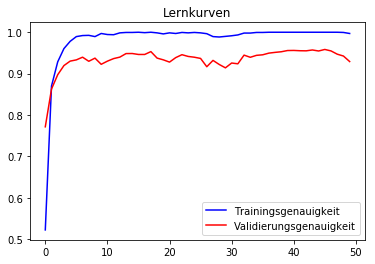

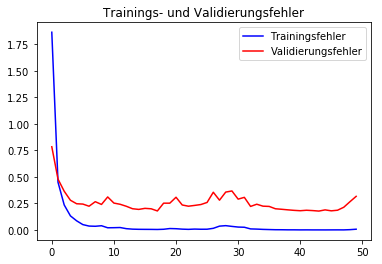

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      0.93      0.95        60
           1       0.98      0.94      0.96       720
           2       0.97      0.96      0.97       750
           3       0.92      0.93      0.92       450
           4       0.90      0.97      0.93       660
           5       0.85      0.93      0.89       630
           6       0.93      0.65      0.76       150
           7       0.89      0.96      0.92       450
           8       0.97      0.84      0.90       450
           9       0.94      1.00      0.97       480
          10       1.00      0.84      0.91       660
          11       0.87      0.93      0.90       420
          12       0.98      0.99      0.99       690
          13       0.96      0.99      0.98       720
          14       1.00      0.99      0.99       270
          15       0.79      0.99      0.88       210
          16       0.99      0.95      0.97   

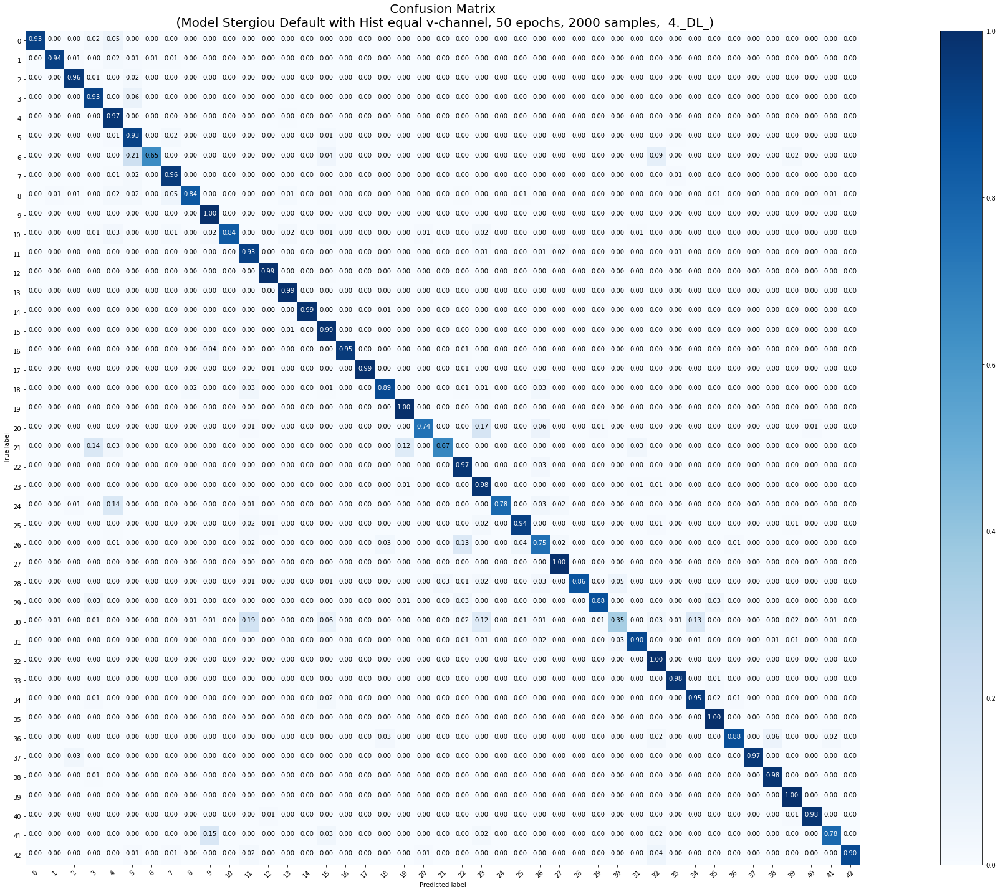

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 10s 5ms/step - loss: 1.8314 - acc: 0.5515 - val_loss: 0.7406 - val_acc: 0.7923
Epoch 2/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.4531 - acc: 0.8600 - val_loss: 0.3794 - val_acc: 0.8945
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.2009 - acc: 0.9405 - val_loss: 0.3008 - val_acc: 0.9147
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1117 - acc: 0.9715 - val_loss: 0.3275 - val_acc: 0.9042
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0636 - acc: 0.9890 - val_loss: 0.2702 - val_acc: 0.9250
Epoch 6/50
2000/2000 [==========================

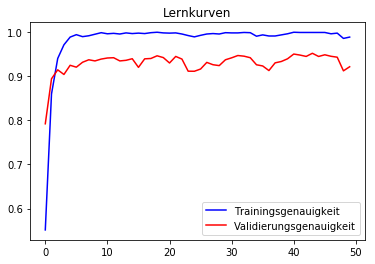

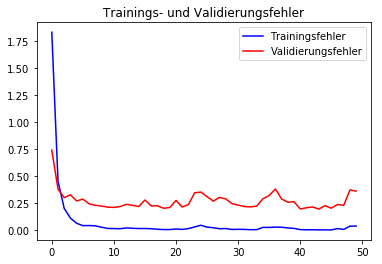

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.96      0.45      0.61        60
           1       0.98      0.94      0.96       720
           2       0.96      0.99      0.97       750
           3       0.97      0.87      0.92       450
           4       0.96      0.98      0.97       660
           5       0.87      0.90      0.89       630
           6       0.57      0.66      0.61       150
           7       0.80      0.90      0.85       450
           8       0.73      0.94      0.82       450
           9       0.97      0.96      0.96       480
          10       0.99      0.89      0.94       660
          11       0.88      0.97      0.92       420
          12       1.00      0.97      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      0.98      0.99       270
          15       0.94      0.98      0.96       210
          16       0.97      0.97      0.97   

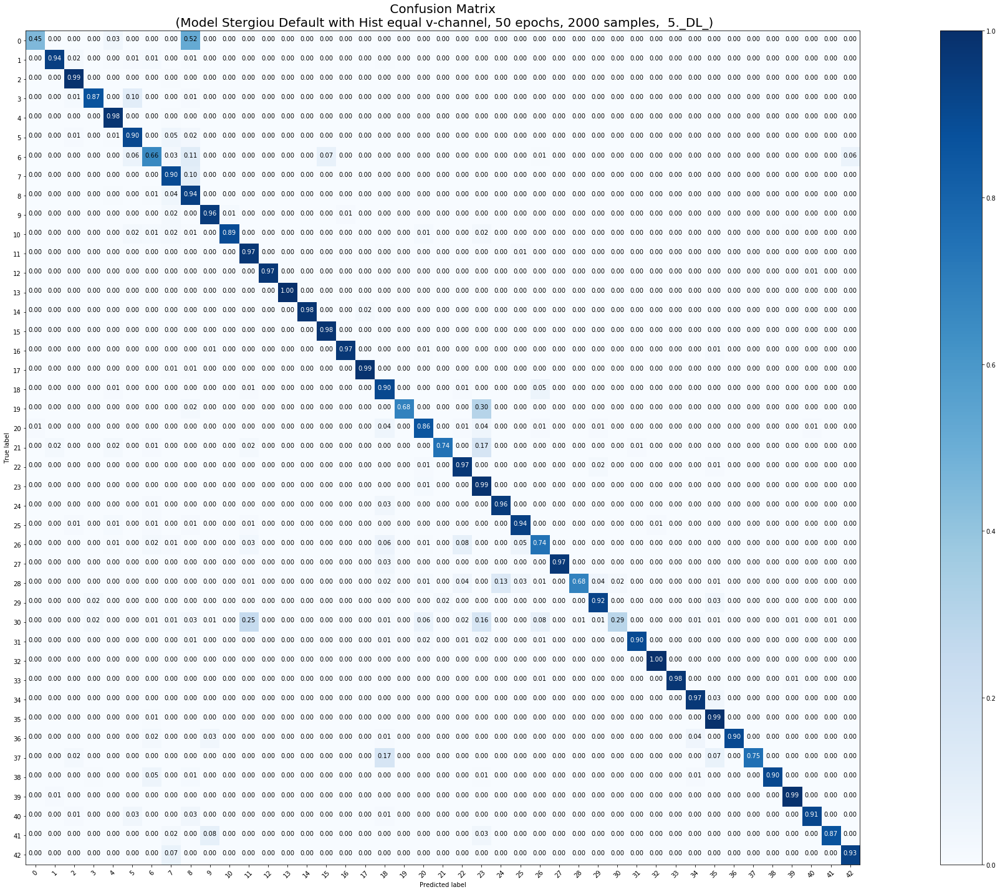

<Figure size 432x288 with 0 Axes>

In [0]:
### 2000, B, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_2000, y_tr_2000, X_test, y_test, 50, 2000)

In [0]:
downloader_B(2000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 17s 9ms/step - loss: 2.7263 - acc: 0.3455 - val_loss: 1.2305 - val_acc: 0.6392
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.8013 - acc: 0.7360 - val_loss: 0.7162 - val_acc: 0.7778
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.3806 - acc: 0.8725 - val_loss: 0.4525 - val_acc: 0.8728
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1964 - acc: 0.9295 - val_loss: 0.4187 - val_acc: 0.8859
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1031 - acc: 0.9675 - val_loss: 0.3442 - val_acc: 0.8999
Epoch 6/50
2000/2000 [====================

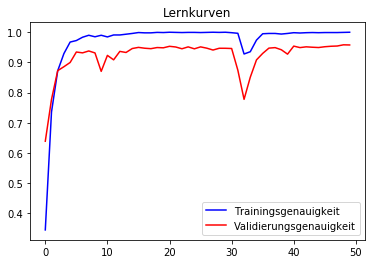

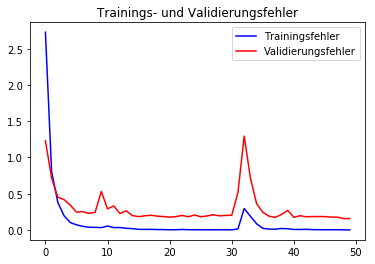

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      0.95      0.96        60
           1       0.98      0.97      0.98       720
           2       0.97      0.99      0.98       750
           3       0.98      0.98      0.98       450
           4       0.98      0.98      0.98       660
           5       0.90      0.95      0.93       630
           6       0.93      0.67      0.78       150
           7       0.94      0.95      0.94       450
           8       0.93      0.94      0.94       450
           9       0.98      0.99      0.98       480
          10       0.98      0.95      0.96       660
          11       0.93      0.93      0.93       420
          12       1.00      0.98      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      0.99      0.99       270
          15       0.96      1.00      0.98       210
          16       0.99      0.94      0.96   

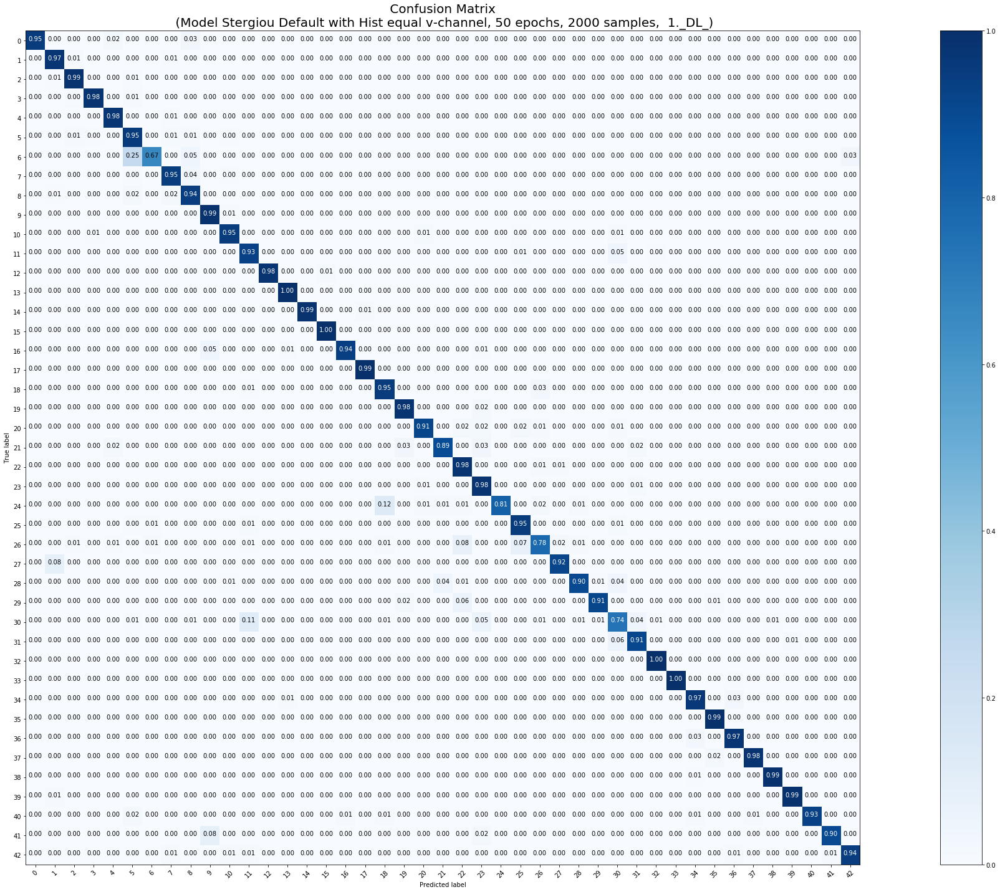

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 18s 9ms/step - loss: 2.4438 - acc: 0.3980 - val_loss: 1.3500 - val_acc: 0.6076
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.6758 - acc: 0.7800 - val_loss: 0.5709 - val_acc: 0.8406
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.3026 - acc: 0.8890 - val_loss: 0.4920 - val_acc: 0.8532
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1448 - acc: 0.9530 - val_loss: 0.3100 - val_acc: 0.9183
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.0959 - acc: 0.9570 - val_loss: 0.2857 - val_acc: 0.9207
Epoch 6/50
2000/2000 [====================

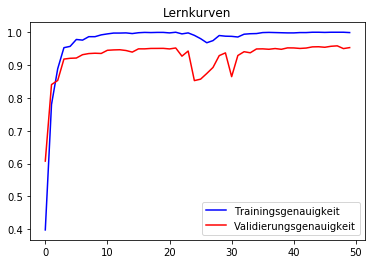

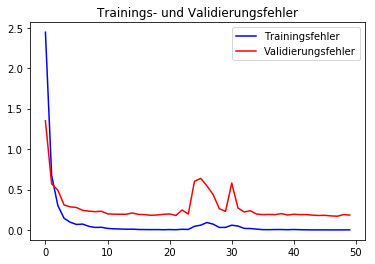

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.86      1.00      0.92        60
           1       0.98      0.95      0.97       720
           2       0.97      0.99      0.98       750
           3       0.98      0.96      0.97       450
           4       0.96      0.99      0.98       660
           5       0.89      0.95      0.92       630
           6       1.00      0.67      0.80       150
           7       0.97      0.97      0.97       450
           8       0.97      0.92      0.94       450
           9       0.91      0.99      0.95       480
          10       0.96      0.94      0.95       660
          11       0.94      0.96      0.95       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.97      0.99       270
          15       0.96      0.98      0.97       210
          16       0.99      0.95      0.97   

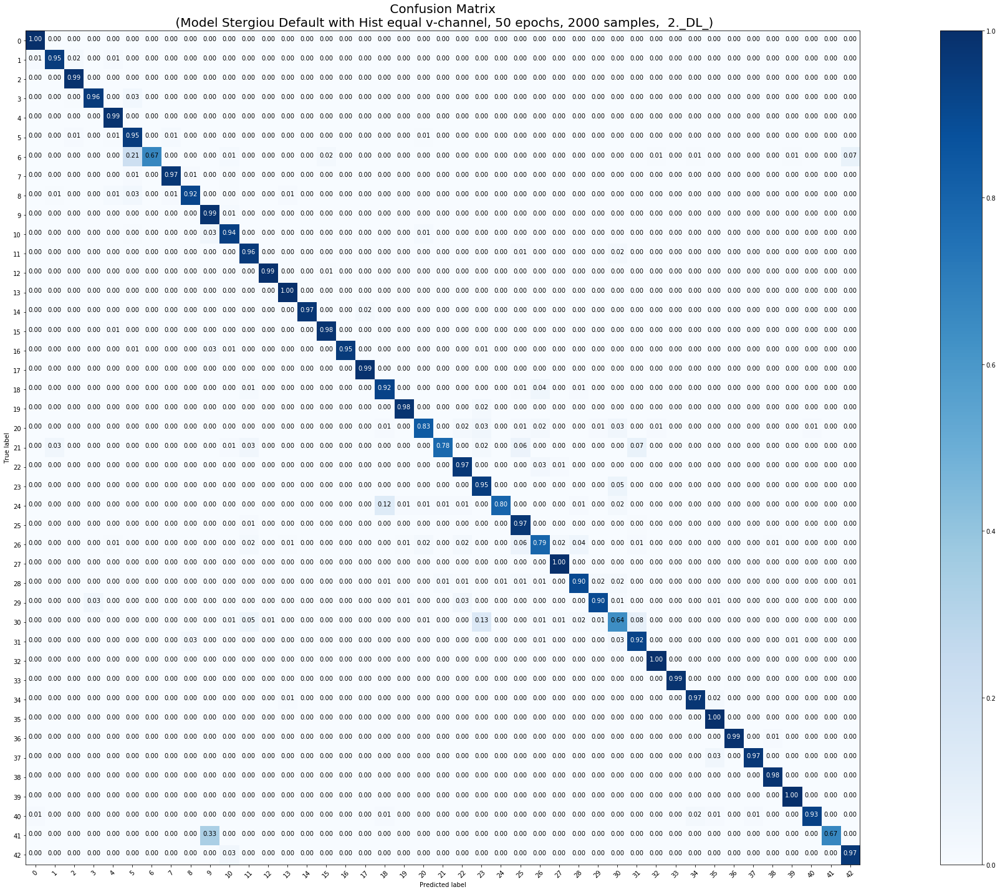

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 18s 9ms/step - loss: 2.4158 - acc: 0.3995 - val_loss: 0.9280 - val_acc: 0.7212
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.6913 - acc: 0.7780 - val_loss: 0.8544 - val_acc: 0.7717
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.2733 - acc: 0.9065 - val_loss: 0.4476 - val_acc: 0.8727
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1654 - acc: 0.9425 - val_loss: 0.3811 - val_acc: 0.8868
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1071 - acc: 0.9680 - val_loss: 0.3210 - val_acc: 0.9164
Epoch 6/50
2000/2000 [====================

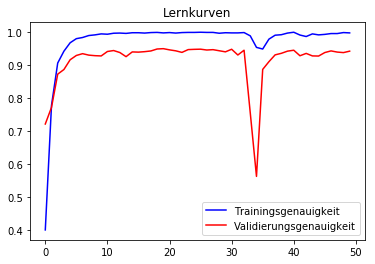

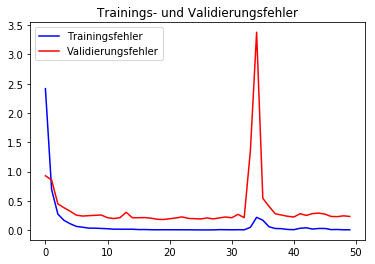

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.83      0.98      0.90        60
           1       0.96      0.97      0.97       720
           2       0.96      0.99      0.97       750
           3       0.98      0.92      0.95       450
           4       1.00      0.93      0.96       660
           5       0.86      0.95      0.90       630
           6       0.99      0.64      0.78       150
           7       0.96      0.90      0.93       450
           8       0.91      0.90      0.91       450
           9       0.96      0.99      0.97       480
          10       0.97      0.94      0.96       660
          11       0.97      0.84      0.90       420
          12       0.99      0.99      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      0.97      0.98       270
          15       0.94      1.00      0.97       210
          16       0.96      0.95      0.95   

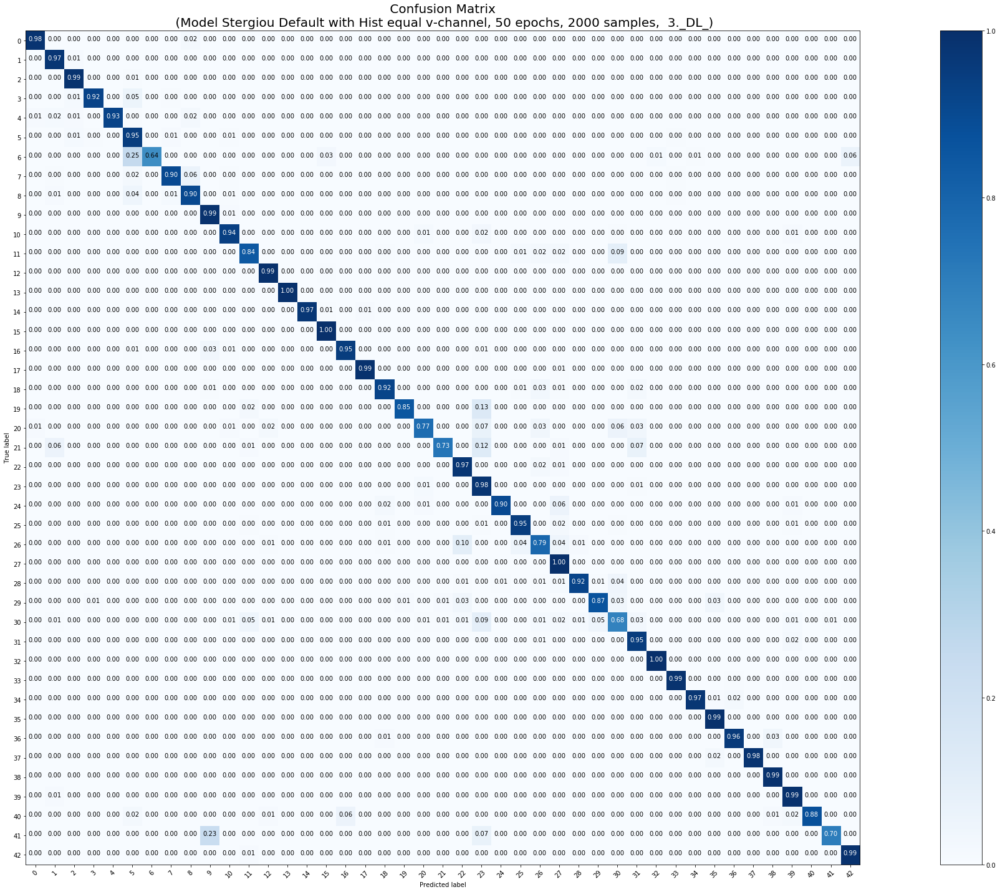

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 19s 10ms/step - loss: 2.4359 - acc: 0.3785 - val_loss: 1.1520 - val_acc: 0.6702
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.6853 - acc: 0.7720 - val_loss: 0.5504 - val_acc: 0.8304
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.2738 - acc: 0.9035 - val_loss: 0.4522 - val_acc: 0.8750
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.2041 - acc: 0.9360 - val_loss: 0.3386 - val_acc: 0.9018
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1261 - acc: 0.9545 - val_loss: 0.2556 - val_acc: 0.9306
Epoch 6/50
2000/2000 [===================

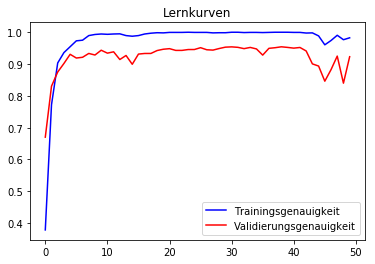

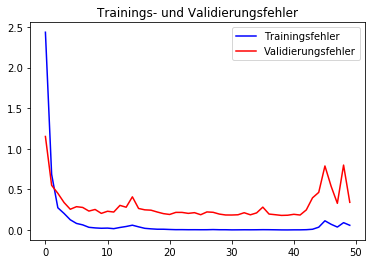

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.90      0.93      0.92        60
           1       0.95      0.95      0.95       720
           2       0.91      0.98      0.95       750
           3       0.97      0.94      0.95       450
           4       0.98      0.94      0.96       660
           5       0.94      0.86      0.90       630
           6       0.90      0.61      0.73       150
           7       0.83      0.94      0.88       450
           8       0.95      0.81      0.87       450
           9       0.92      0.99      0.95       480
          10       0.99      0.91      0.95       660
          11       0.91      0.96      0.93       420
          12       1.00      0.97      0.98       690
          13       0.99      0.99      0.99       720
          14       1.00      1.00      1.00       270
          15       0.84      0.99      0.91       210
          16       0.98      0.95      0.97   

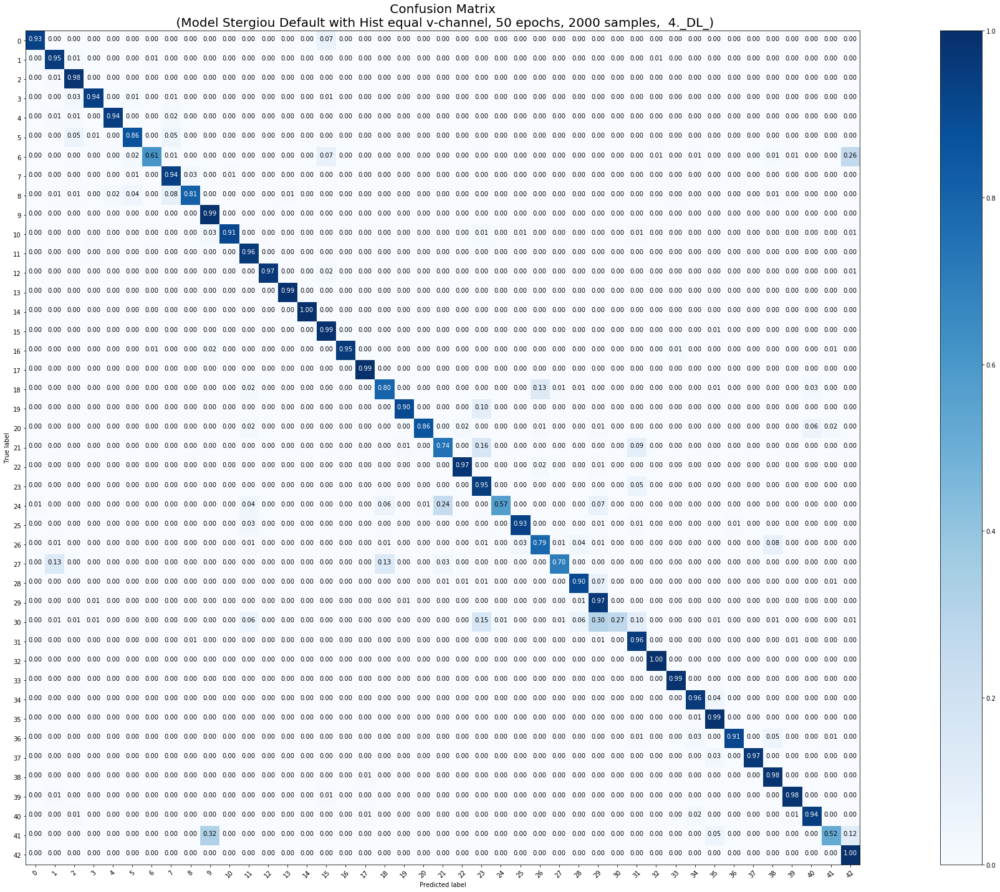

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 19s 9ms/step - loss: 2.6587 - acc: 0.3640 - val_loss: 1.8747 - val_acc: 0.5256
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.8289 - acc: 0.7240 - val_loss: 0.6918 - val_acc: 0.8005
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.3518 - acc: 0.8800 - val_loss: 0.4878 - val_acc: 0.8628
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.2137 - acc: 0.9225 - val_loss: 0.3591 - val_acc: 0.9032
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1329 - acc: 0.9550 - val_loss: 0.2960 - val_acc: 0.9158
Epoch 6/50
2000/2000 [====================

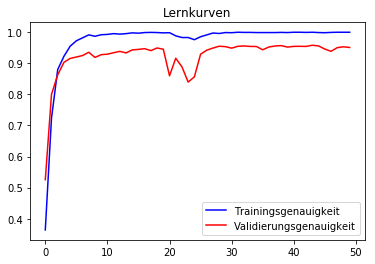

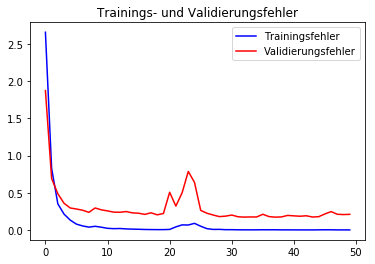

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.90      0.95      0.93        60
           1       0.98      0.95      0.96       720
           2       0.96      0.99      0.98       750
           3       0.94      0.98      0.96       450
           4       0.95      0.98      0.96       660
           5       0.90      0.90      0.90       630
           6       0.98      0.65      0.78       150
           7       0.95      0.94      0.95       450
           8       0.96      0.92      0.94       450
           9       0.95      1.00      0.97       480
          10       0.98      0.94      0.96       660
          11       0.94      0.95      0.94       420
          12       0.97      1.00      0.98       690
          13       0.99      1.00      0.99       720
          14       1.00      0.99      0.99       270
          15       0.90      0.99      0.94       210
          16       0.99      0.95      0.97   

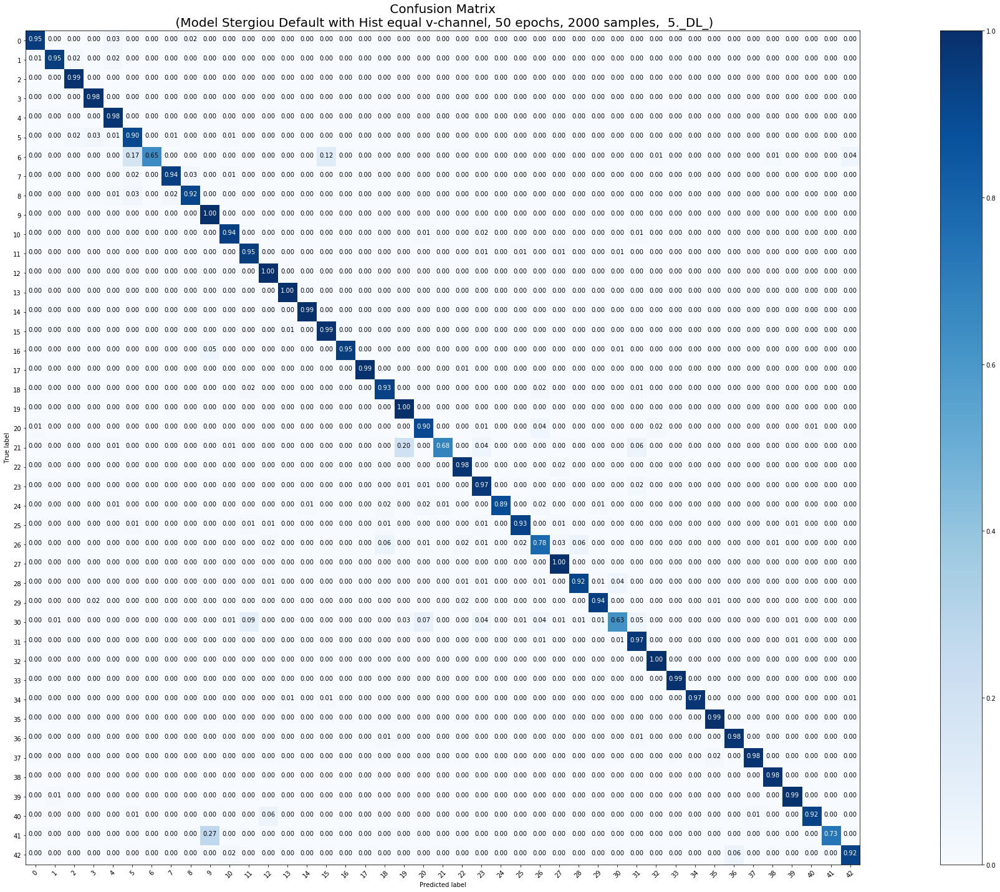

<Figure size 432x288 with 0 Axes>

In [0]:
### 2000, B, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_2000, y_tr_2000, X_test, y_test, 50, 2000)

In [0]:
downloaderCW_B(2000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 12s 2ms/step - loss: 0.9861 - acc: 0.7356 - val_loss: 0.2937 - val_acc: 0.9146
Epoch 2/50
5000/5000 [==============================] - 5s 916us/step - loss: 0.2163 - acc: 0.9374 - val_loss: 0.1953 - val_acc: 0.9435
Epoch 3/50
5000/5000 [==============================] - 5s 922us/step - loss: 0.0968 - acc: 0.9734 - val_loss: 0.2002 - val_acc: 0.9426
Epoch 4/50
5000/5000 [==============================] - 5s 924us/step - loss: 0.0655 - acc: 0.9836 - val_loss: 0.2131 - val_acc: 0.9379
Epoch 5/50
5000/5000 [==============================] - 5s 927us/step - loss: 0.0409 - acc: 0.9902 - val_loss: 0.2107 - val_acc: 0.9405
Epoch 6/50
5000/5000 [==================

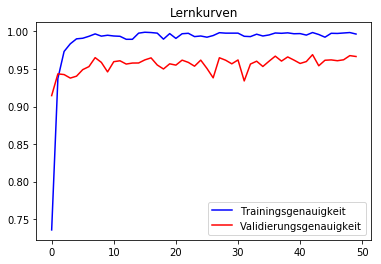

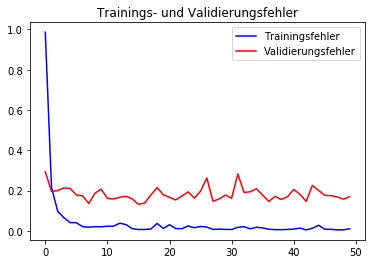

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.98      0.98       720
           2       0.97      1.00      0.98       750
           3       1.00      0.93      0.96       450
           4       0.98      0.98      0.98       660
           5       0.95      0.96      0.95       630
           6       0.96      0.71      0.82       150
           7       0.99      0.98      0.98       450
           8       0.97      0.94      0.96       450
           9       0.95      0.99      0.97       480
          10       0.95      0.97      0.96       660
          11       0.91      0.98      0.94       420
          12       0.99      1.00      1.00       690
          13       0.97      1.00      0.98       720
          14       1.00      1.00      1.00       270
          15       1.00      0.98      0.99       210
          16       0.99      0.96      0.98   

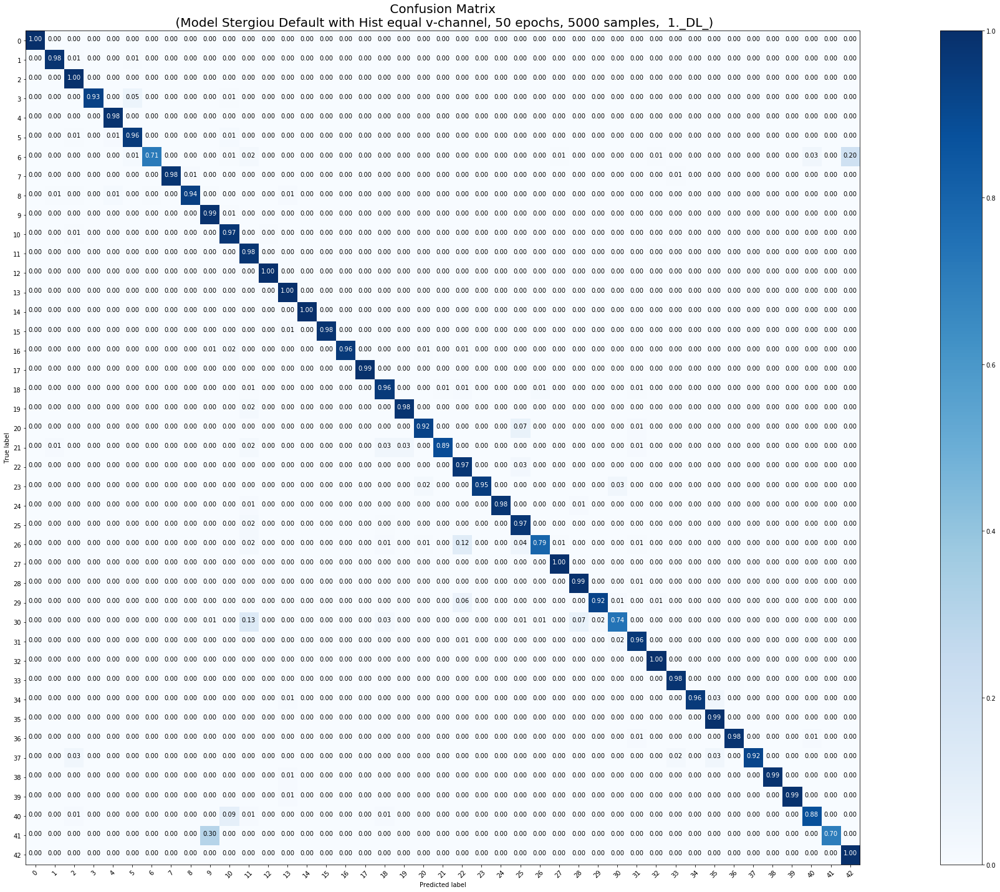

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 13s 3ms/step - loss: 1.1167 - acc: 0.7058 - val_loss: 0.3833 - val_acc: 0.8956
Epoch 2/50
5000/5000 [==============================] - 5s 955us/step - loss: 0.2268 - acc: 0.9328 - val_loss: 0.2836 - val_acc: 0.9185
Epoch 3/50
5000/5000 [==============================] - 5s 947us/step - loss: 0.1050 - acc: 0.9718 - val_loss: 0.2046 - val_acc: 0.9404
Epoch 4/50
5000/5000 [==============================] - 5s 951us/step - loss: 0.0682 - acc: 0.9824 - val_loss: 0.2226 - val_acc: 0.9403
Epoch 5/50
5000/5000 [==============================] - 5s 958us/step - loss: 0.0414 - acc: 0.9900 - val_loss: 0.1748 - val_acc: 0.9538
Epoch 6/50
5000/5000 [==================

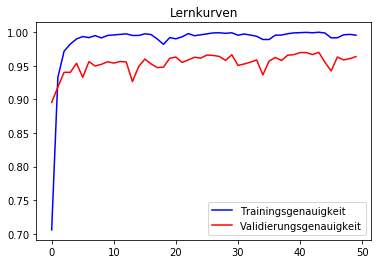

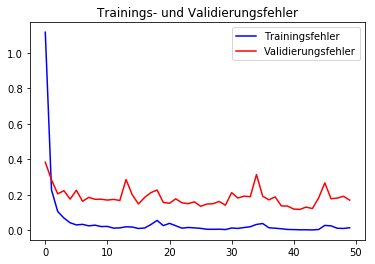

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.94      1.00      0.97        60
           1       0.96      0.99      0.97       720
           2       0.99      0.99      0.99       750
           3       1.00      0.93      0.96       450
           4       0.99      0.97      0.98       660
           5       0.91      0.98      0.94       630
           6       0.99      0.75      0.86       150
           7       0.99      0.97      0.98       450
           8       0.86      0.94      0.90       450
           9       0.98      0.99      0.98       480
          10       0.99      0.98      0.99       660
          11       0.88      0.97      0.92       420
          12       1.00      0.99      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      0.98      0.99       270
          15       0.98      1.00      0.99       210
          16       0.99      0.97      0.98   

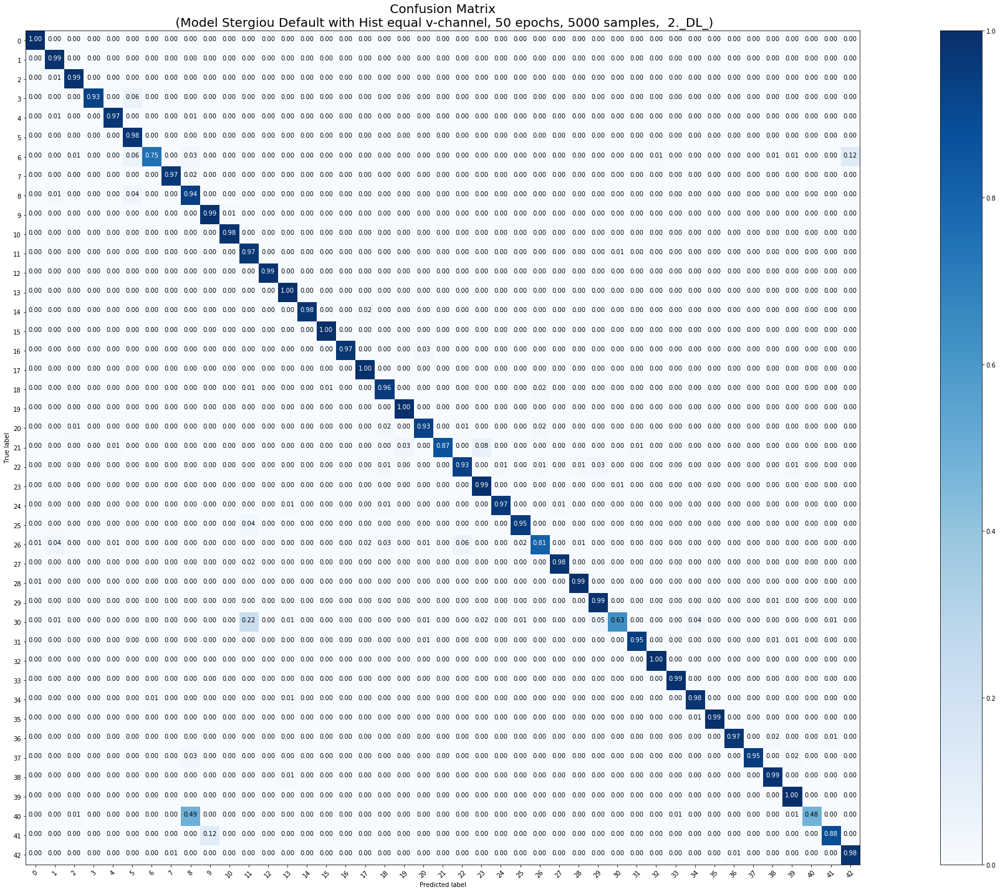

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 13s 3ms/step - loss: 1.0482 - acc: 0.7234 - val_loss: 0.3257 - val_acc: 0.9055
Epoch 2/50
5000/5000 [==============================] - 5s 951us/step - loss: 0.2072 - acc: 0.9428 - val_loss: 0.2271 - val_acc: 0.9371
Epoch 3/50
5000/5000 [==============================] - 5s 962us/step - loss: 0.0972 - acc: 0.9730 - val_loss: 0.2097 - val_acc: 0.9439
Epoch 4/50
5000/5000 [==============================] - 5s 956us/step - loss: 0.0690 - acc: 0.9796 - val_loss: 0.2084 - val_acc: 0.9416
Epoch 5/50
5000/5000 [==============================] - 5s 969us/step - loss: 0.0444 - acc: 0.9880 - val_loss: 0.1874 - val_acc: 0.9480
Epoch 6/50
5000/5000 [==================

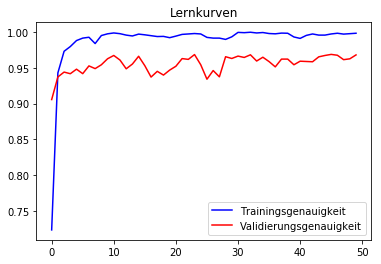

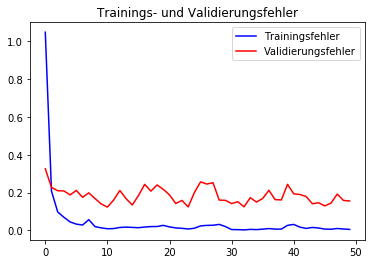

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       0.99      0.97      0.98       450
           4       0.99      0.98      0.98       660
           5       0.95      0.97      0.96       630
           6       1.00      0.71      0.83       150
           7       0.99      0.98      0.98       450
           8       0.98      0.94      0.96       450
           9       0.98      1.00      0.99       480
          10       0.98      0.97      0.98       660
          11       0.93      0.98      0.96       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.97      0.99      0.98       210
          16       0.99      0.95      0.97   

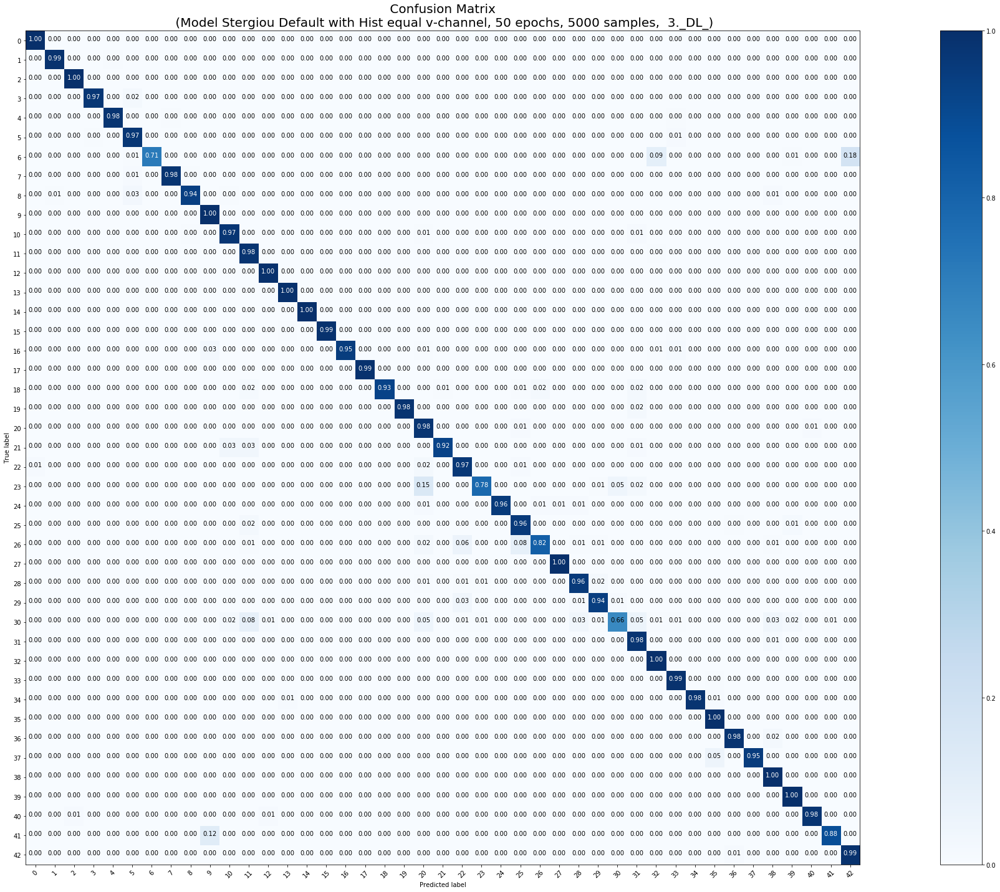

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 14s 3ms/step - loss: 1.0148 - acc: 0.7300 - val_loss: 0.3328 - val_acc: 0.9077
Epoch 2/50
5000/5000 [==============================] - 5s 963us/step - loss: 0.2062 - acc: 0.9442 - val_loss: 0.3607 - val_acc: 0.8977
Epoch 3/50
5000/5000 [==============================] - 5s 961us/step - loss: 0.1158 - acc: 0.9684 - val_loss: 0.2420 - val_acc: 0.9306
Epoch 4/50
5000/5000 [==============================] - 5s 959us/step - loss: 0.0667 - acc: 0.9834 - val_loss: 0.2154 - val_acc: 0.9408
Epoch 5/50
5000/5000 [==============================] - 5s 947us/step - loss: 0.0373 - acc: 0.9908 - val_loss: 0.1616 - val_acc: 0.9594
Epoch 6/50
5000/5000 [==================

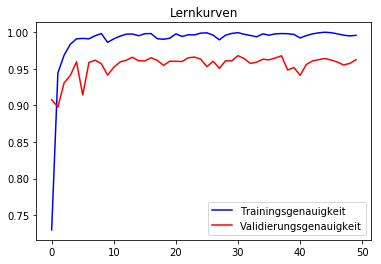

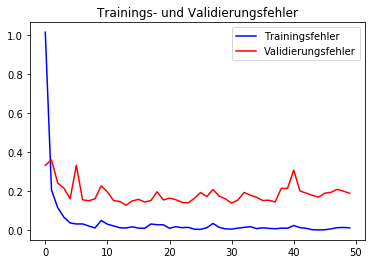

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.93      0.98      0.95       720
           2       0.97      1.00      0.98       750
           3       1.00      0.90      0.95       450
           4       0.98      0.97      0.98       660
           5       0.83      0.98      0.90       630
           6       1.00      0.70      0.82       150
           7       0.97      0.96      0.97       450
           8       0.99      0.91      0.95       450
           9       1.00      0.99      0.99       480
          10       0.99      0.95      0.97       660
          11       0.93      0.95      0.94       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      0.99       210
          16       0.99      0.97      0.98   

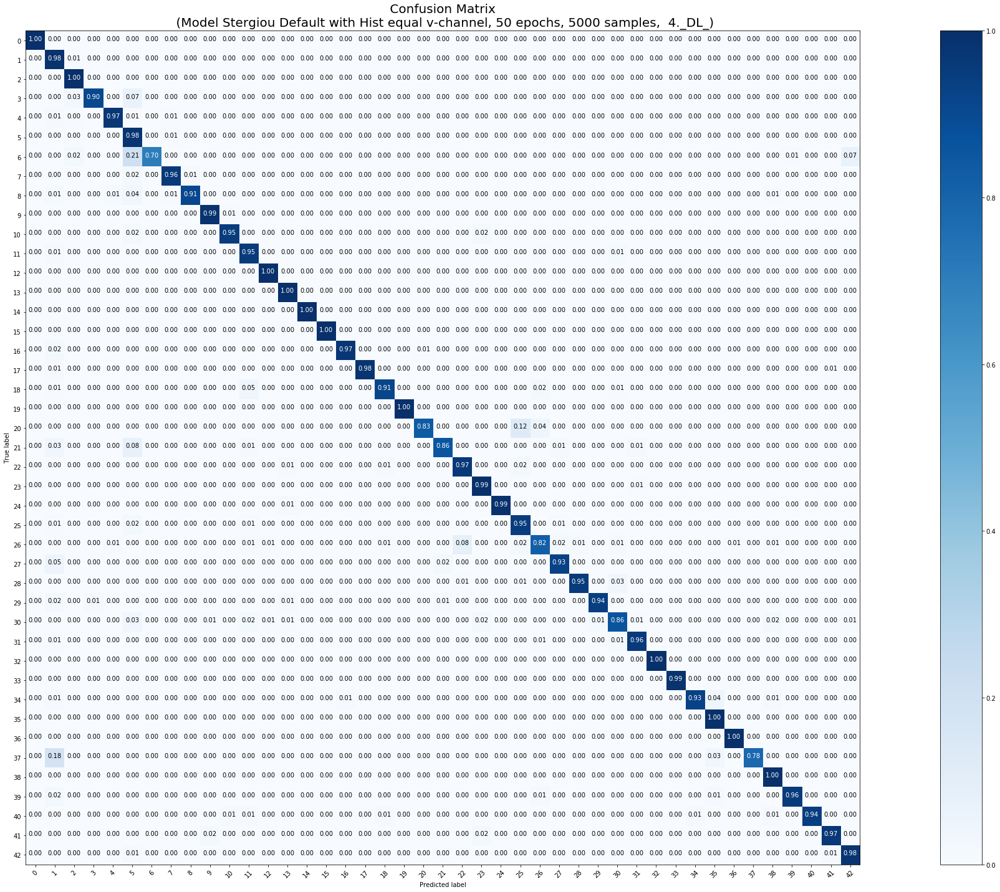

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 14s 3ms/step - loss: 0.9985 - acc: 0.7338 - val_loss: 0.3072 - val_acc: 0.9192
Epoch 2/50
5000/5000 [==============================] - 5s 970us/step - loss: 0.2099 - acc: 0.9390 - val_loss: 0.2912 - val_acc: 0.9221
Epoch 3/50
5000/5000 [==============================] - 5s 976us/step - loss: 0.1010 - acc: 0.9692 - val_loss: 0.1953 - val_acc: 0.9436
Epoch 4/50
5000/5000 [==============================] - 5s 968us/step - loss: 0.0581 - acc: 0.9838 - val_loss: 0.2239 - val_acc: 0.9342
Epoch 5/50
5000/5000 [==============================] - 5s 966us/step - loss: 0.0325 - acc: 0.9936 - val_loss: 0.1649 - val_acc: 0.9553
Epoch 6/50
5000/5000 [==================

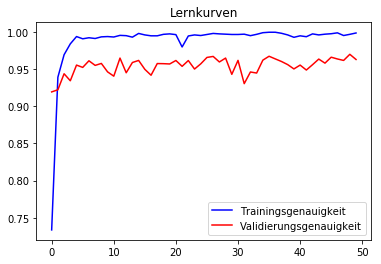

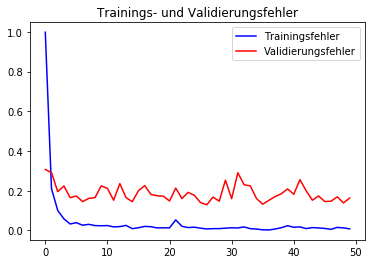

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.96      0.99      0.98       720
           2       1.00      0.97      0.98       750
           3       0.95      0.94      0.95       450
           4       0.98      0.97      0.97       660
           5       0.88      0.96      0.92       630
           6       0.99      0.73      0.84       150
           7       0.96      0.95      0.96       450
           8       0.97      0.91      0.94       450
           9       0.96      1.00      0.98       480
          10       1.00      0.99      0.99       660
          11       0.84      0.97      0.90       420
          12       0.99      1.00      1.00       690
          13       1.00      1.00      1.00       720
          14       1.00      0.97      0.98       270
          15       1.00      0.99      0.99       210
          16       1.00      0.95      0.97   

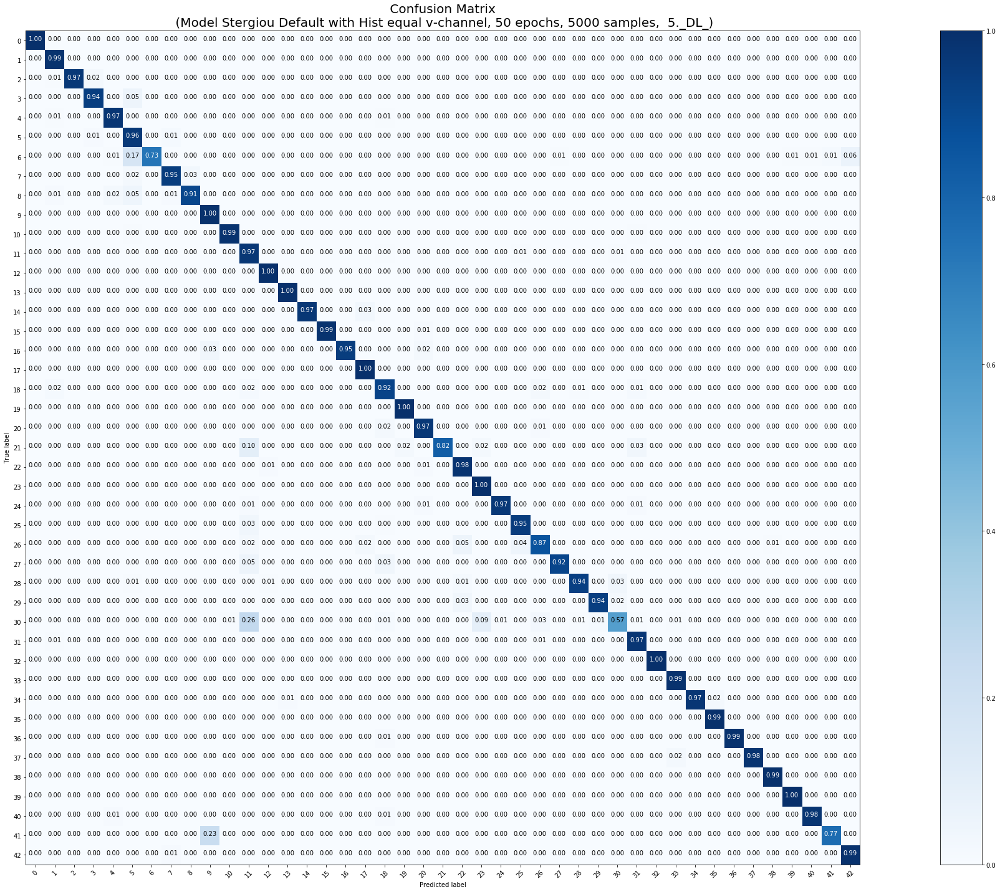

<Figure size 432x288 with 0 Axes>

In [0]:
### 5000, B, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_5000, y_tr_5000, X_test, y_test, 50, 5000)

In [0]:
downloader_B(5000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
sparse categorical crossentropy


Training mit Klassengewichten beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 12s 2ms/step - loss: 1.6008 - acc: 0.5772 - val_loss: 0.6250 - val_acc: 0.8165
Epoch 2/50
5000/5000 [==============================] - 4s 763us/step - loss: 0.2950 - acc: 0.9056 - val_loss: 0.2948 - val_acc: 0.9191
Epoch 3/50
5000/5000 [==============================] - 4s 757us/step - loss: 0.1222 - acc: 0.9544 - val_loss: 0.2245 - val_acc: 0.9341
Epoch 4/50
5000/5000 [==============================] - 4s 764us/step - loss: 0.082

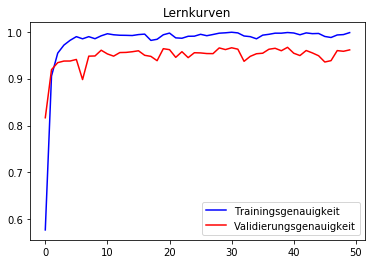

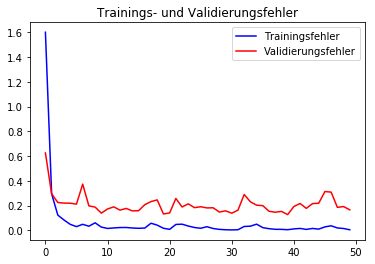

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.98      0.98      0.98       720
           2       0.97      0.99      0.98       750
           3       0.98      0.93      0.96       450
           4       0.99      0.98      0.98       660
           5       0.90      0.95      0.93       630
           6       0.99      0.81      0.89       150
           7       0.97      0.96      0.96       450
           8       0.92      0.92      0.92       450
           9       0.96      0.99      0.97       480
          10       0.98      0.97      0.97       660
          11       0.98      0.91      0.95       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       0.99      0.99      0.99       270
          15       0.98      1.00      0.99       210
          16       0.99      0.95      0.97   

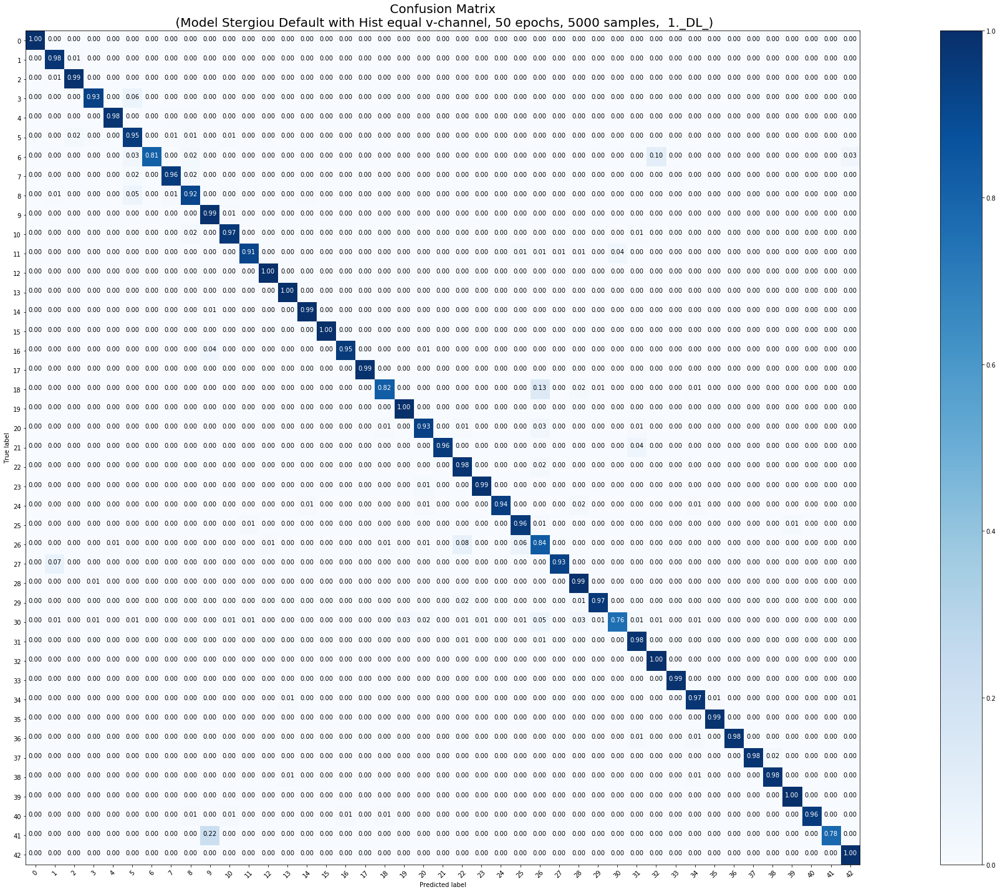

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 6s 1ms/step - loss: 1.5183 - acc: 0.5984 - val_loss: 0.5711 - val_acc: 0.8201
Epoch 2/50
5000/5000 [==============================] - 4s 779us/step - loss: 0.3202 - acc: 0.8934 - val_loss: 0.2758 - val_acc: 0.9255
Epoch 3/50
5000/5000 [==============================] - 4s 786us/step - loss: 0.1444 - acc: 0.9542 - val_loss: 0.2142 - val_acc: 0.9399
Epoch 4/50
5000/5000 [==============================] - 4s 775us/step - loss: 0.0791 - acc: 0.9762 - val_loss: 0.1915 - val_acc: 0.9447
Epoch 5/50
5000/5000 [==============================] - 4s 774us/step - loss: 0.0462 - acc: 0.9830 - val_loss: 0.1520 - val_acc: 0.9564
Epoch 6/50
5000/5000 [=============

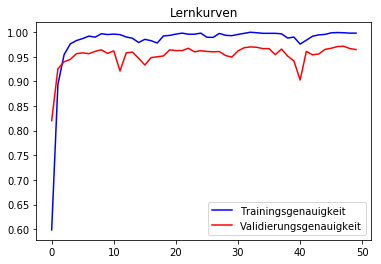

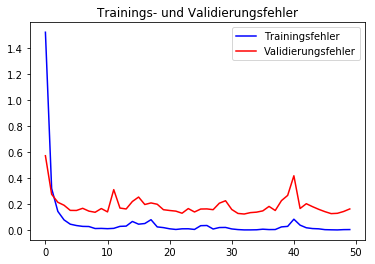

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.95      0.97        60
           1       0.99      0.97      0.98       720
           2       0.99      0.99      0.99       750
           3       0.96      0.96      0.96       450
           4       0.98      0.98      0.98       660
           5       0.92      0.96      0.94       630
           6       0.97      0.66      0.79       150
           7       1.00      0.98      0.99       450
           8       0.99      0.94      0.97       450
           9       0.98      1.00      0.99       480
          10       1.00      0.98      0.99       660
          11       0.94      0.97      0.96       420
          12       0.98      1.00      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      0.98      0.99       270
          15       0.99      1.00      0.99       210
          16       0.98      0.97      0.98   

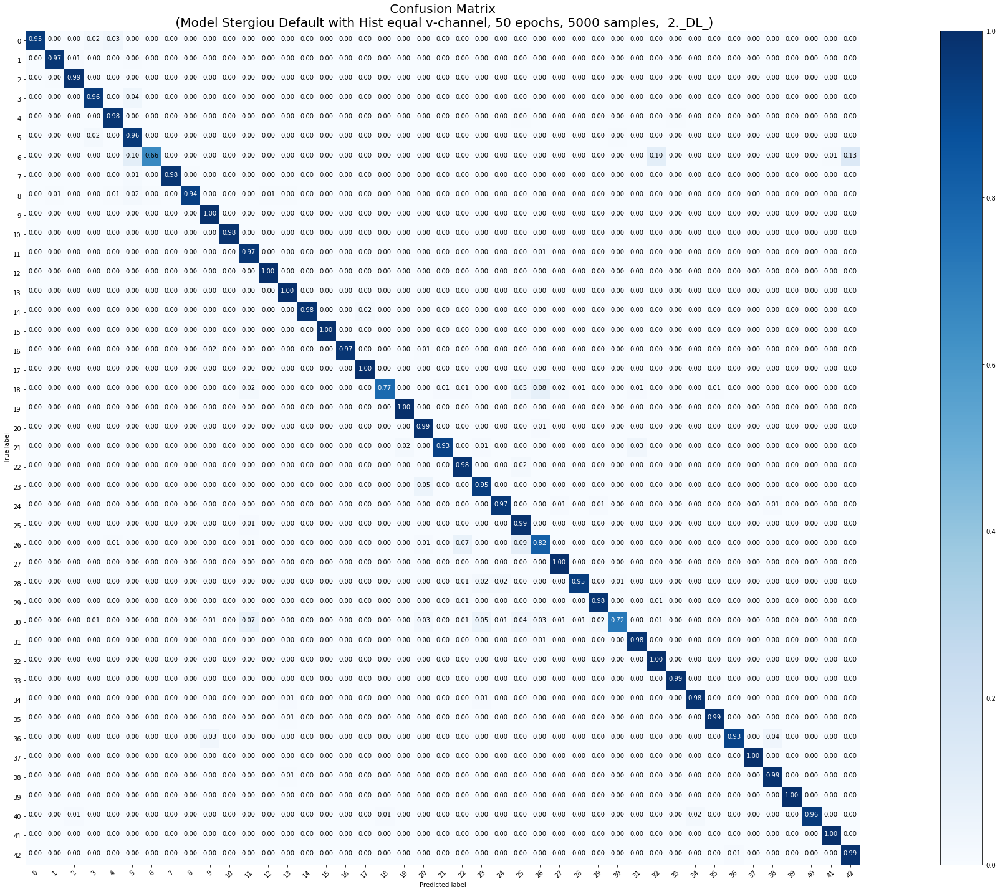

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 6s 1ms/step - loss: 1.5454 - acc: 0.5926 - val_loss: 0.6502 - val_acc: 0.7816
Epoch 2/50
5000/5000 [==============================] - 4s 778us/step - loss: 0.3449 - acc: 0.8972 - val_loss: 0.2962 - val_acc: 0.9194
Epoch 3/50
5000/5000 [==============================] - 4s 780us/step - loss: 0.1564 - acc: 0.9514 - val_loss: 0.2722 - val_acc: 0.9260
Epoch 4/50
5000/5000 [==============================] - 4s 790us/step - loss: 0.0840 - acc: 0.9724 - val_loss: 0.1688 - val_acc: 0.9535
Epoch 5/50
5000/5000 [==============================] - 4s 775us/step - loss: 0.0477 - acc: 0.9820 - val_loss: 0.2212 - val_acc: 0.9377
Epoch 6/50
5000/5000 [=============

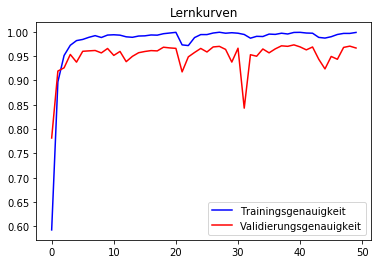

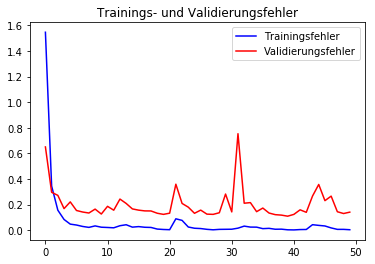

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.67      1.00      0.81        60
           1       0.98      0.99      0.98       720
           2       0.99      0.99      0.99       750
           3       0.96      0.97      0.97       450
           4       0.99      0.93      0.96       660
           5       0.97      0.97      0.97       630
           6       0.97      0.78      0.87       150
           7       0.99      0.93      0.96       450
           8       0.95      0.94      0.95       450
           9       0.98      0.99      0.98       480
          10       0.98      0.97      0.98       660
          11       0.95      0.95      0.95       420
          12       1.00      1.00      1.00       690
          13       0.97      1.00      0.98       720
          14       1.00      0.99      0.99       270
          15       0.97      1.00      0.99       210
          16       0.97      0.97      0.97   

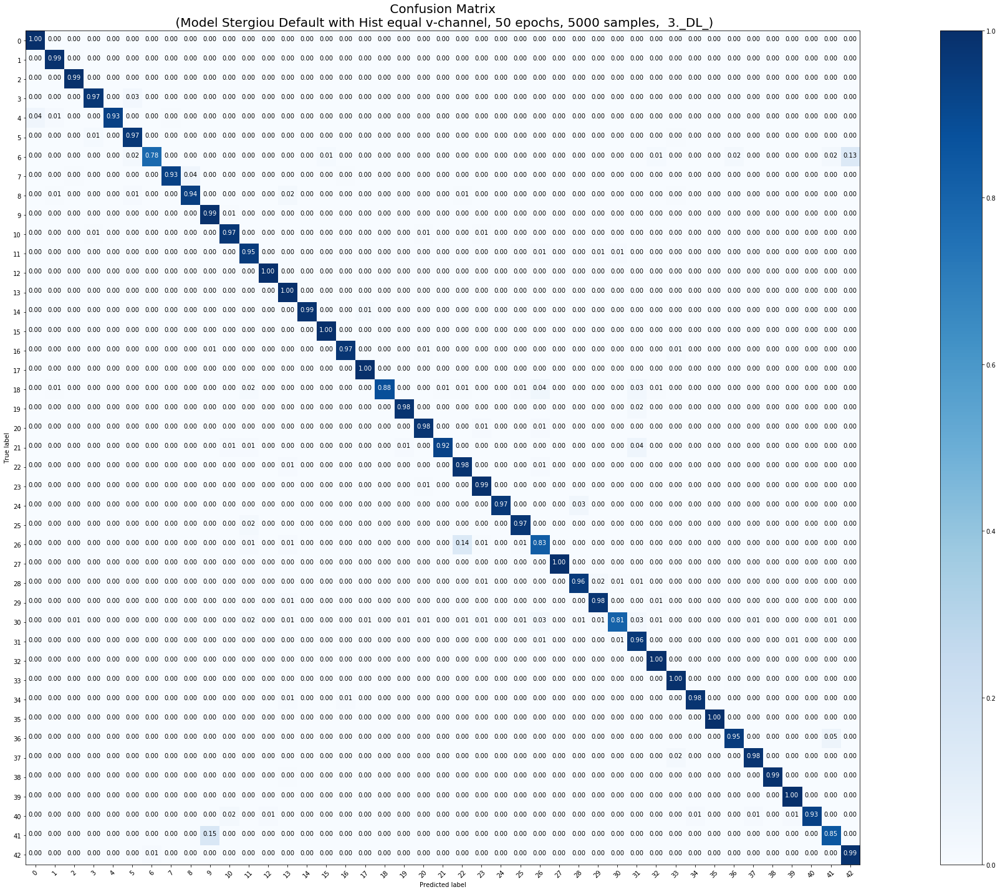

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 6s 1ms/step - loss: 1.4500 - acc: 0.6204 - val_loss: 0.5712 - val_acc: 0.8327
Epoch 2/50
5000/5000 [==============================] - 4s 783us/step - loss: 0.2802 - acc: 0.9118 - val_loss: 0.3744 - val_acc: 0.8915
Epoch 3/50
5000/5000 [==============================] - 4s 780us/step - loss: 0.1643 - acc: 0.9520 - val_loss: 0.3393 - val_acc: 0.8949
Epoch 4/50
5000/5000 [==============================] - 4s 782us/step - loss: 0.1070 - acc: 0.9664 - val_loss: 0.1863 - val_acc: 0.9481
Epoch 5/50
5000/5000 [==============================] - 4s 799us/step - loss: 0.0520 - acc: 0.9818 - val_loss: 0.1462 - val_acc: 0.9606
Epoch 6/50
5000/5000 [=============

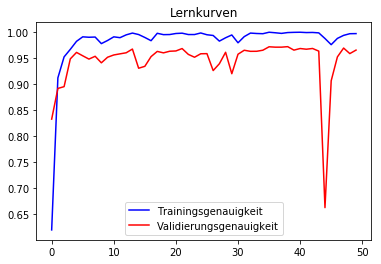

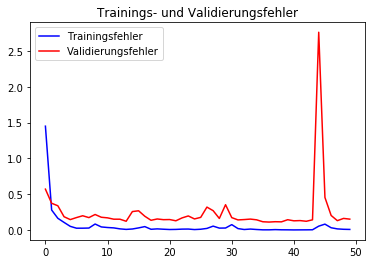

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      0.97      0.98       720
           2       0.99      1.00      0.99       750
           3       0.98      0.97      0.98       450
           4       0.98      0.98      0.98       660
           5       0.97      0.96      0.97       630
           6       0.97      0.76      0.85       150
           7       0.98      0.98      0.98       450
           8       0.97      0.95      0.96       450
           9       0.95      0.99      0.97       480
          10       0.97      0.97      0.97       660
          11       0.92      0.96      0.94       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.99      1.00       270
          15       0.96      1.00      0.98       210
          16       0.99      0.95      0.97   

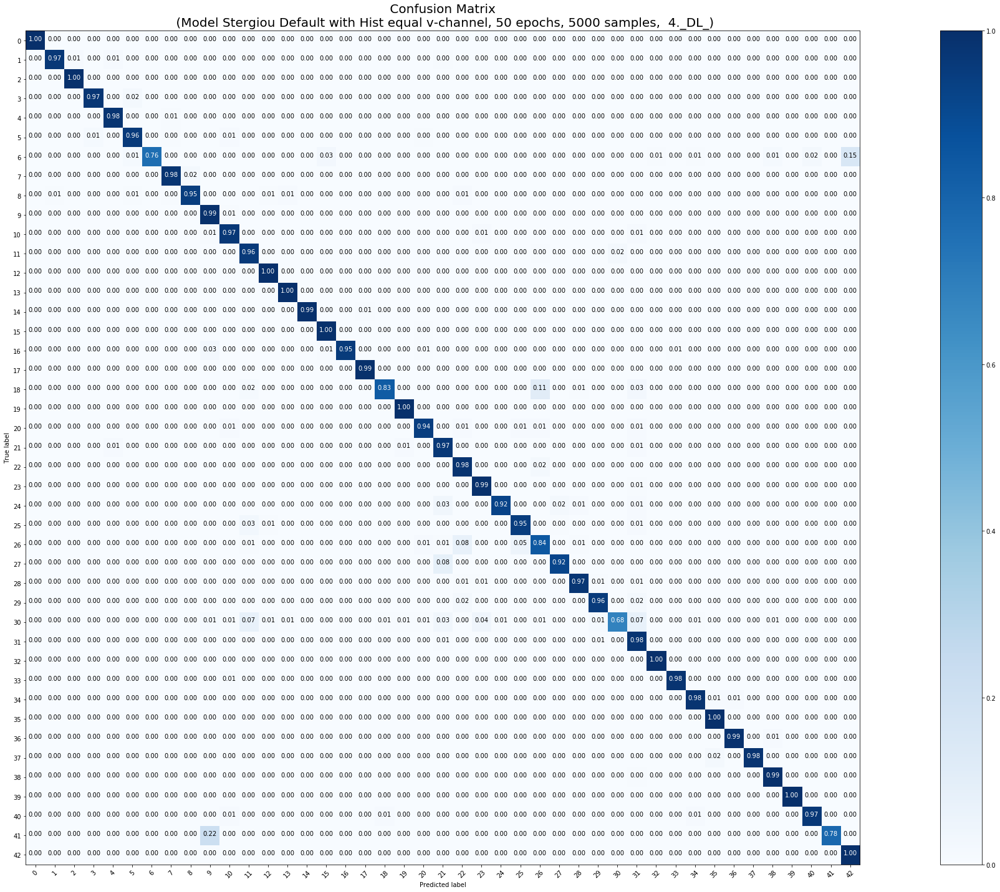

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 7s 1ms/step - loss: 1.5444 - acc: 0.5926 - val_loss: 0.4517 - val_acc: 0.8726
Epoch 2/50
5000/5000 [==============================] - 4s 819us/step - loss: 0.2790 - acc: 0.9098 - val_loss: 0.2533 - val_acc: 0.9350
Epoch 3/50
5000/5000 [==============================] - 4s 799us/step - loss: 0.1204 - acc: 0.9616 - val_loss: 0.2856 - val_acc: 0.9186
Epoch 4/50
5000/5000 [==============================] - 4s 811us/step - loss: 0.0702 - acc: 0.9734 - val_loss: 0.2778 - val_acc: 0.9200
Epoch 5/50
5000/5000 [==============================] - 4s 813us/step - loss: 0.0550 - acc: 0.9780 - val_loss: 0.1512 - val_acc: 0.9597
Epoch 6/50
5000/5000 [=============

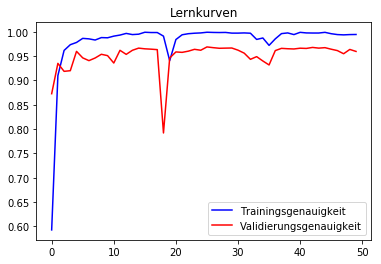

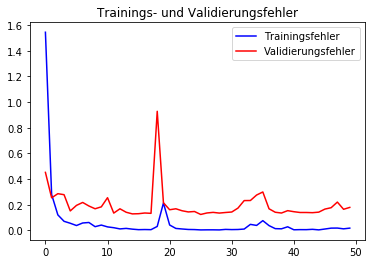

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       1.00      0.91      0.95       720
           2       0.96      1.00      0.98       750
           3       0.98      0.98      0.98       450
           4       0.97      0.97      0.97       660
           5       0.95      0.92      0.94       630
           6       0.97      0.85      0.91       150
           7       0.93      0.98      0.95       450
           8       0.98      0.90      0.94       450
           9       0.96      1.00      0.98       480
          10       1.00      0.96      0.98       660
          11       0.94      0.98      0.96       420
          12       0.95      1.00      0.98       690
          13       1.00      0.99      0.99       720
          14       1.00      1.00      1.00       270
          15       0.97      1.00      0.98       210
          16       0.99      0.97      0.98   

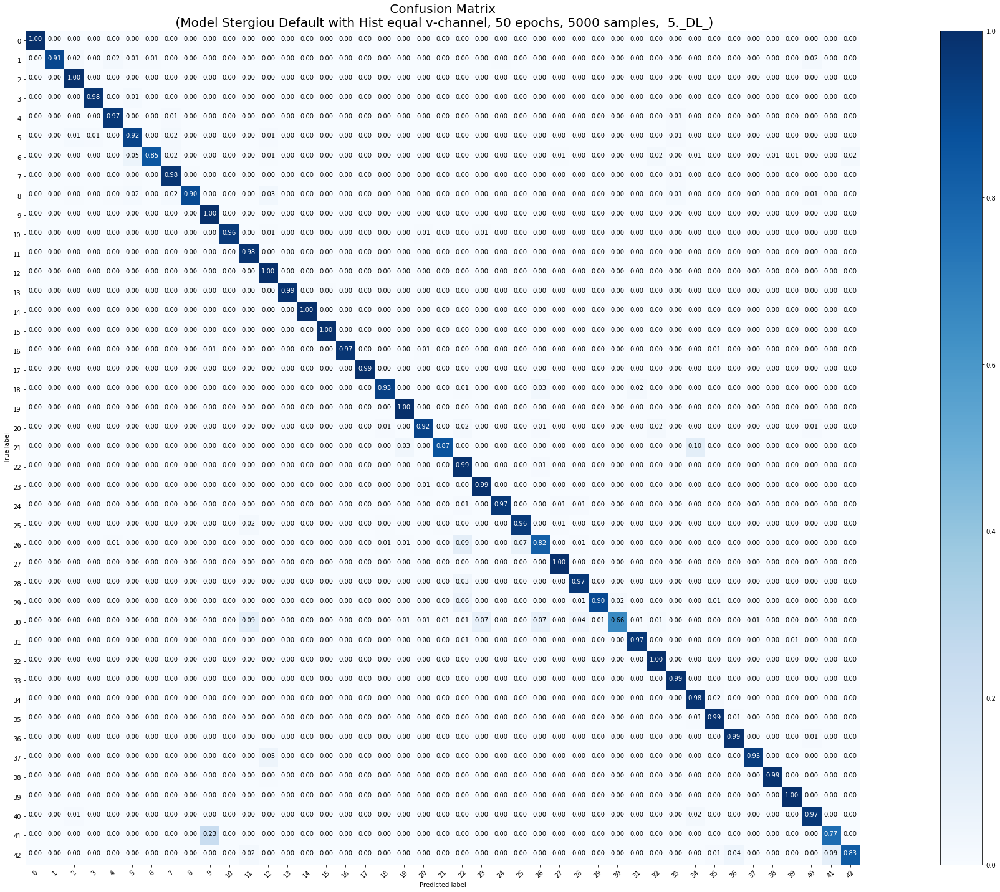

<Figure size 432x288 with 0 Axes>

In [0]:
### 5000, B, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_5000, y_tr_5000, X_test, y_test, 50, 5000)

In [0]:
downloaderCW_B(5000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 14s 1ms/step - loss: 0.6560 - acc: 0.8264 - val_loss: 0.2384 - val_acc: 0.9345
Epoch 2/50
10000/10000 [==============================] - 8s 765us/step - loss: 0.1286 - acc: 0.9641 - val_loss: 0.1763 - val_acc: 0.9511
Epoch 3/50
10000/10000 [==============================] - 8s 775us/step - loss: 0.0546 - acc: 0.9836 - val_loss: 0.1913 - val_acc: 0.9438
Epoch 4/50
10000/10000 [==============================] - 8s 775us/step - loss: 0.0508 - acc: 0.9855 - val_loss: 0.1475 - val_acc: 0.9603
Epoch 5/50
10000/10000 [==============================] - 8s 762us/step - loss: 0.0406 - acc: 0.9879 - val_loss: 0.1874 - val_acc: 0.9535
Epoch 6/50
10000/10000 [====

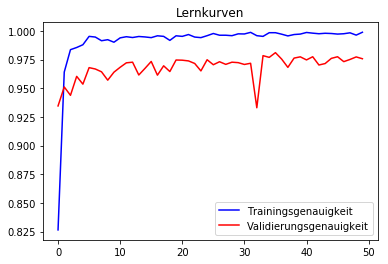

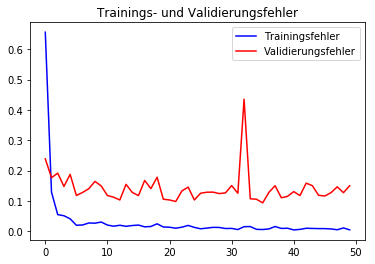

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.98      0.99      0.99       720
           2       0.95      0.99      0.97       750
           3       0.99      0.94      0.96       450
           4       0.99      0.99      0.99       660
           5       0.95      0.96      0.96       630
           6       1.00      0.70      0.82       150
           7       0.99      0.98      0.99       450
           8       1.00      0.95      0.97       450
           9       1.00      0.99      1.00       480
          10       0.99      0.99      0.99       660
          11       0.99      0.97      0.98       420
          12       0.98      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.99      1.00       270
          15       1.00      0.99      0.99       210
          16       1.00      0.99      0.99   

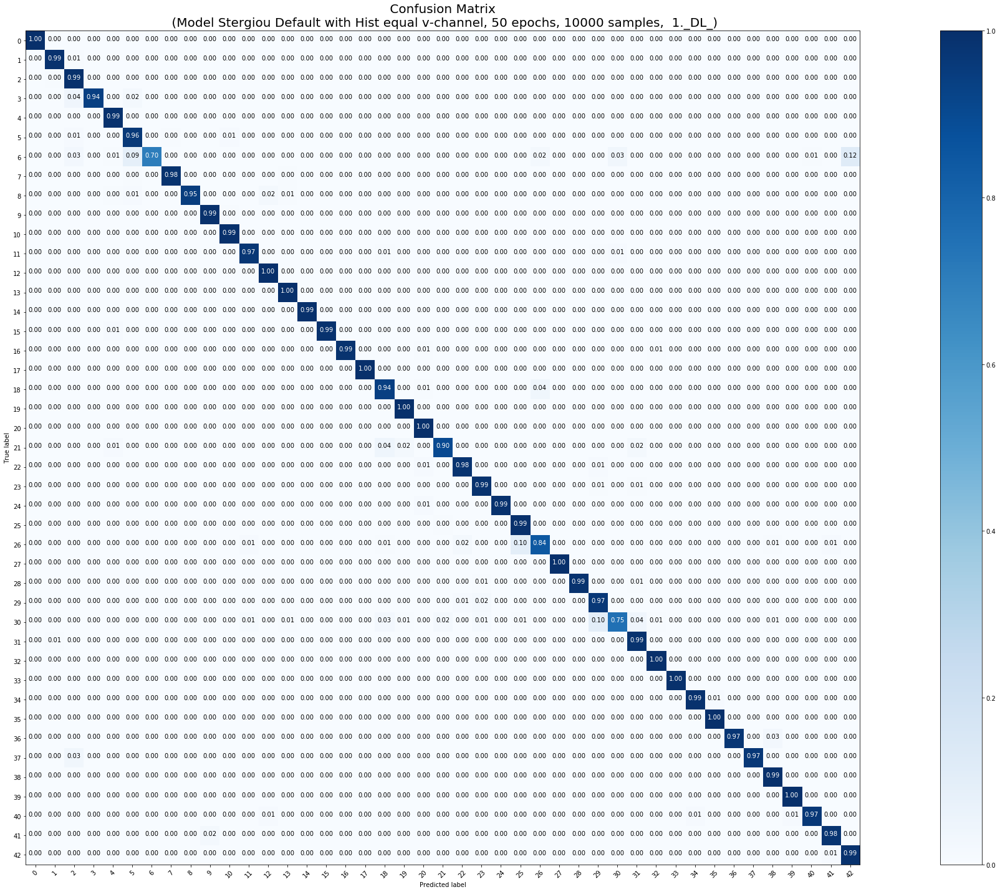

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 14s 1ms/step - loss: 0.6359 - acc: 0.8274 - val_loss: 0.2036 - val_acc: 0.9452
Epoch 2/50
10000/10000 [==============================] - 8s 773us/step - loss: 0.1138 - acc: 0.9692 - val_loss: 0.1863 - val_acc: 0.9467
Epoch 3/50
10000/10000 [==============================] - 8s 782us/step - loss: 0.0729 - acc: 0.9787 - val_loss: 0.1680 - val_acc: 0.9525
Epoch 4/50
10000/10000 [==============================] - 8s 808us/step - loss: 0.0478 - acc: 0.9869 - val_loss: 0.2197 - val_acc: 0.9424
Epoch 5/50
10000/10000 [==============================] - 8s 770us/step - loss: 0.0300 - acc: 0.9924 - val_loss: 0.1369 - val_acc: 0.9621
Epoch 6/50
10000/10000 [====

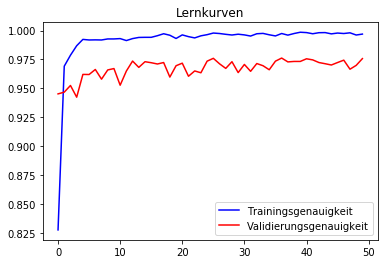

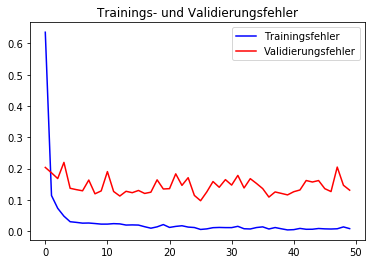

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.96      0.99      0.98       720
           2       0.99      1.00      1.00       750
           3       0.99      0.94      0.96       450
           4       1.00      0.99      0.99       660
           5       0.92      0.98      0.95       630
           6       1.00      0.72      0.84       150
           7       0.97      0.99      0.98       450
           8       0.99      0.96      0.97       450
           9       0.98      0.99      0.99       480
          10       0.98      0.99      0.99       660
          11       0.99      0.97      0.98       420
          12       0.99      1.00      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       1.00      1.00      1.00       210
          16       0.99      0.99      0.99   

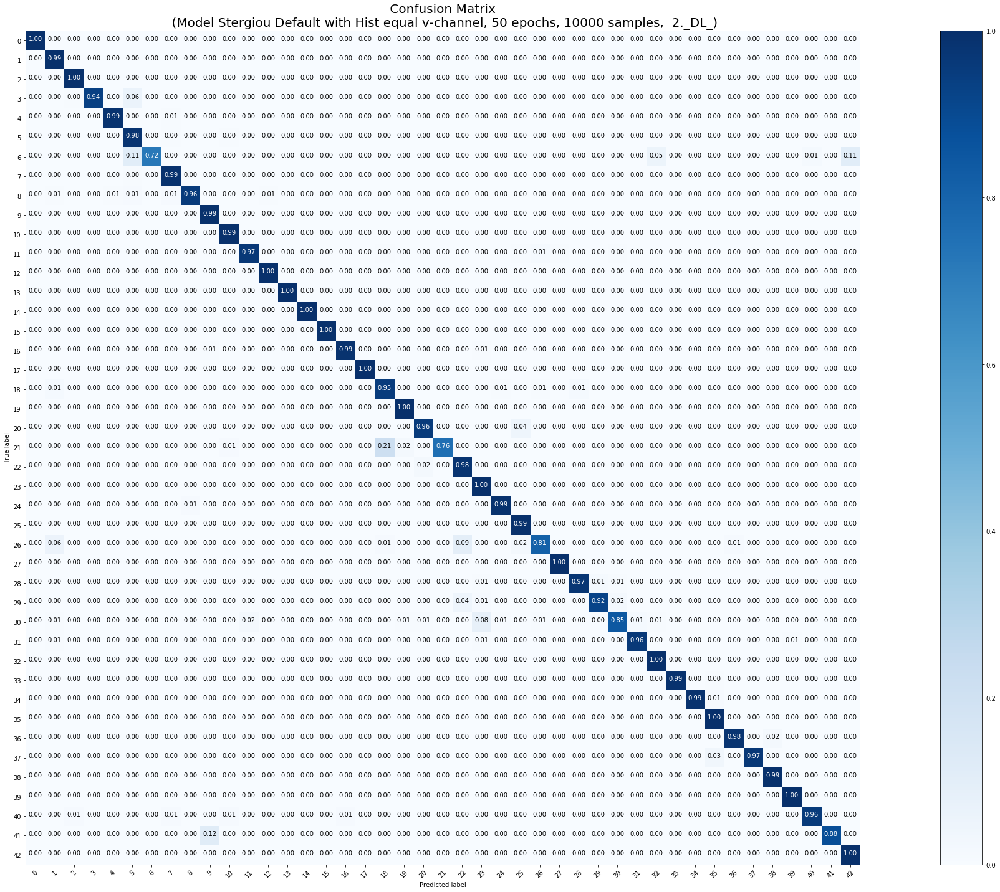

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 15s 2ms/step - loss: 0.6670 - acc: 0.8221 - val_loss: 0.2583 - val_acc: 0.9226
Epoch 2/50
10000/10000 [==============================] - 8s 804us/step - loss: 0.1208 - acc: 0.9665 - val_loss: 0.2264 - val_acc: 0.9374
Epoch 3/50
10000/10000 [==============================] - 8s 797us/step - loss: 0.0711 - acc: 0.9802 - val_loss: 0.1446 - val_acc: 0.9595
Epoch 4/50
10000/10000 [==============================] - 8s 784us/step - loss: 0.0408 - acc: 0.9886 - val_loss: 0.1367 - val_acc: 0.9618
Epoch 5/50
10000/10000 [==============================] - 8s 784us/step - loss: 0.0311 - acc: 0.9911 - val_loss: 0.1209 - val_acc: 0.9653
Epoch 6/50
10000/10000 [====

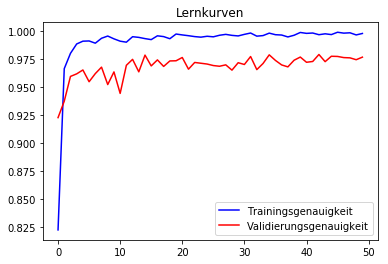

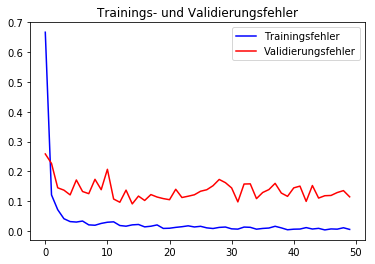

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.89      0.98      0.94        60
           1       0.98      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       1.00      0.96      0.98       450
           4       0.99      0.99      0.99       660
           5       0.95      0.98      0.96       630
           6       1.00      0.80      0.89       150
           7       0.99      0.99      0.99       450
           8       0.98      0.96      0.97       450
           9       0.97      1.00      0.98       480
          10       1.00      0.99      0.99       660
          11       0.96      0.96      0.96       420
          12       0.99      0.99      0.99       690
          13       0.98      1.00      0.99       720
          14       0.99      1.00      1.00       270
          15       0.97      1.00      0.98       210
          16       0.99      0.98      0.99   

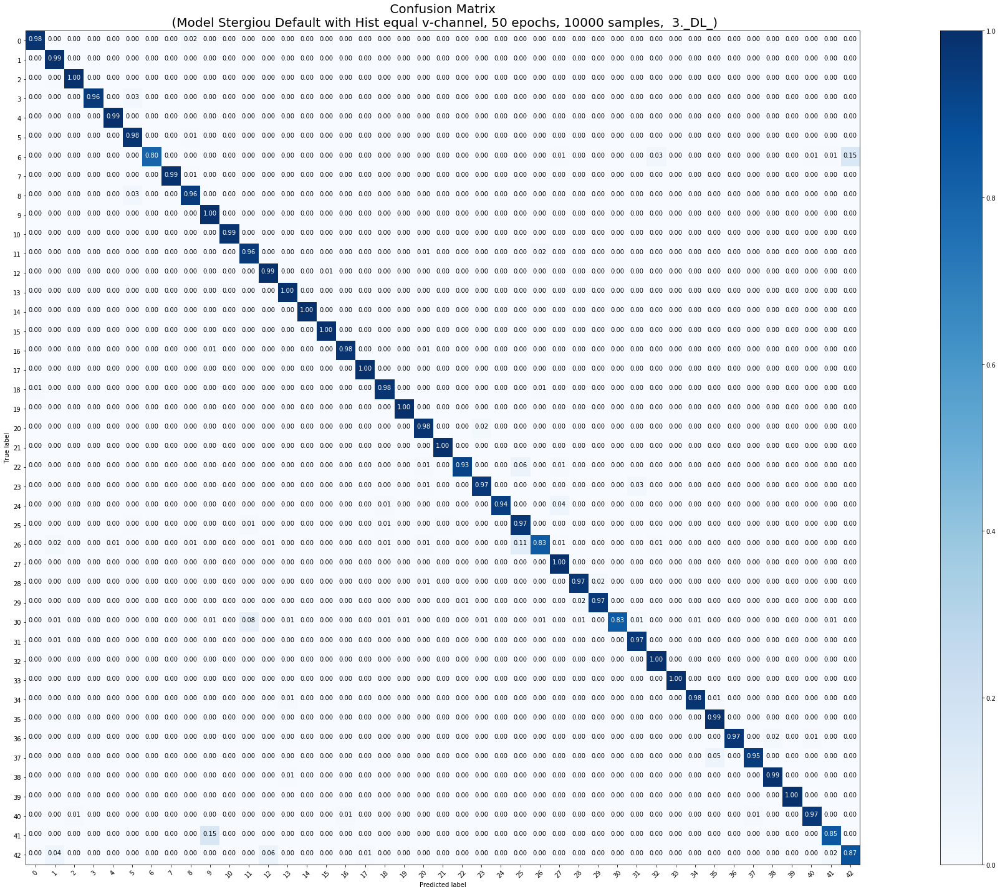

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 16s 2ms/step - loss: 0.6619 - acc: 0.8187 - val_loss: 0.1901 - val_acc: 0.9447
Epoch 2/50
10000/10000 [==============================] - 8s 797us/step - loss: 0.1173 - acc: 0.9663 - val_loss: 0.1612 - val_acc: 0.9528
Epoch 3/50
10000/10000 [==============================] - 8s 788us/step - loss: 0.0660 - acc: 0.9831 - val_loss: 0.1282 - val_acc: 0.9661
Epoch 4/50
10000/10000 [==============================] - 8s 795us/step - loss: 0.0505 - acc: 0.9860 - val_loss: 0.1825 - val_acc: 0.9458
Epoch 5/50
10000/10000 [==============================] - 8s 785us/step - loss: 0.0373 - acc: 0.9889 - val_loss: 0.1083 - val_acc: 0.9709
Epoch 6/50
10000/10000 [====

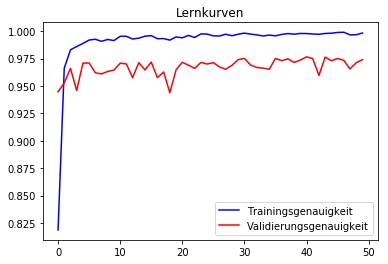

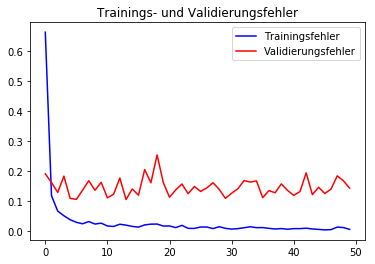

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      0.98      0.99       720
           2       0.98      1.00      0.99       750
           3       1.00      0.95      0.97       450
           4       0.99      0.98      0.99       660
           5       0.93      0.97      0.95       630
           6       0.98      0.85      0.91       150
           7       0.98      0.97      0.98       450
           8       0.98      0.92      0.95       450
           9       0.97      1.00      0.98       480
          10       0.99      0.99      0.99       660
          11       0.90      0.99      0.94       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       0.99      1.00      1.00       270
          15       0.95      0.99      0.97       210
          16       0.99      0.99      0.99   

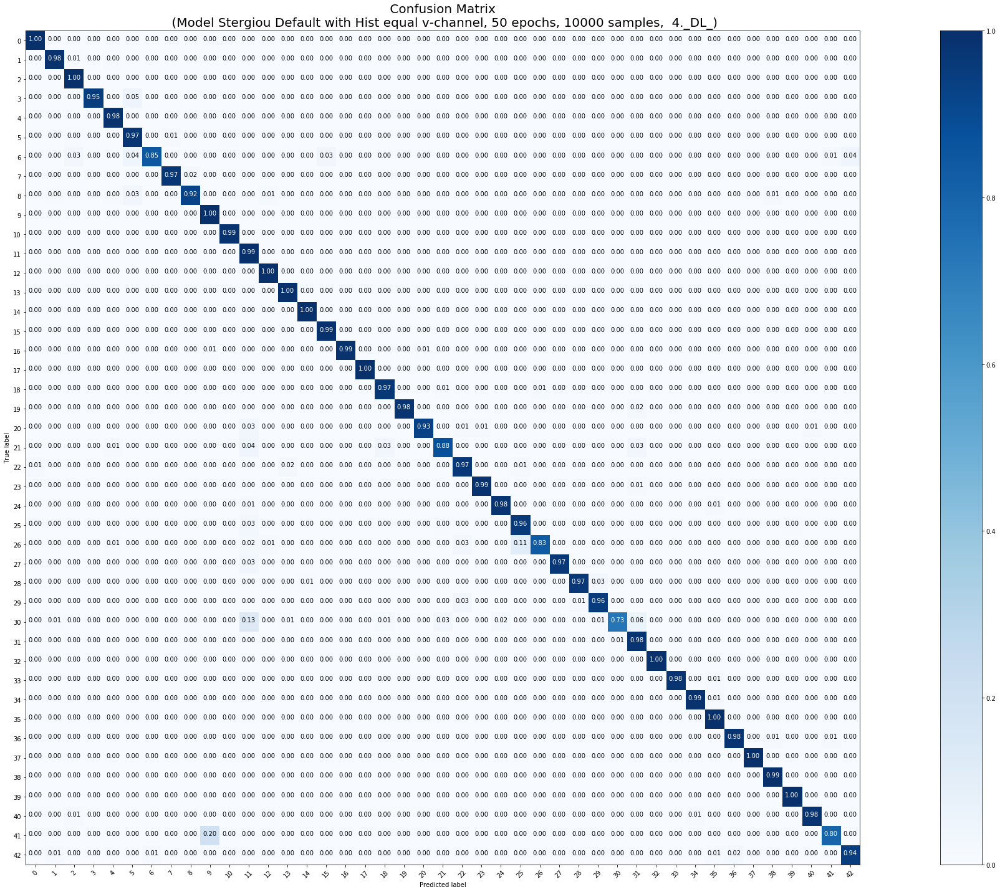

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 16s 2ms/step - loss: 0.6665 - acc: 0.8211 - val_loss: 0.2473 - val_acc: 0.9276
Epoch 2/50
10000/10000 [==============================] - 8s 773us/step - loss: 0.1179 - acc: 0.9665 - val_loss: 0.1560 - val_acc: 0.9540
Epoch 3/50
10000/10000 [==============================] - 8s 775us/step - loss: 0.0562 - acc: 0.9854 - val_loss: 0.1303 - val_acc: 0.9604
Epoch 4/50
10000/10000 [==============================] - 8s 799us/step - loss: 0.0406 - acc: 0.9895 - val_loss: 0.1603 - val_acc: 0.9583
Epoch 5/50
10000/10000 [==============================] - 8s 802us/step - loss: 0.0322 - acc: 0.9894 - val_loss: 0.1838 - val_acc: 0.9514
Epoch 6/50
10000/10000 [====

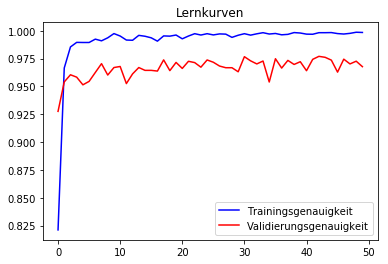

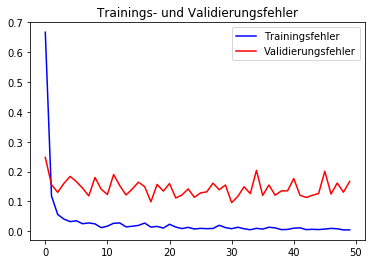

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.98      0.97      0.98       720
           2       0.94      1.00      0.97       750
           3       0.99      0.95      0.97       450
           4       1.00      0.98      0.99       660
           5       0.91      0.97      0.94       630
           6       1.00      0.79      0.88       150
           7       0.98      0.98      0.98       450
           8       0.97      0.95      0.96       450
           9       0.98      0.98      0.98       480
          10       0.99      0.98      0.98       660
          11       0.93      0.98      0.95       420
          12       1.00      1.00      1.00       690
          13       1.00      1.00      1.00       720
          14       0.99      1.00      0.99       270
          15       0.99      1.00      0.99       210
          16       0.99      0.99      0.99   

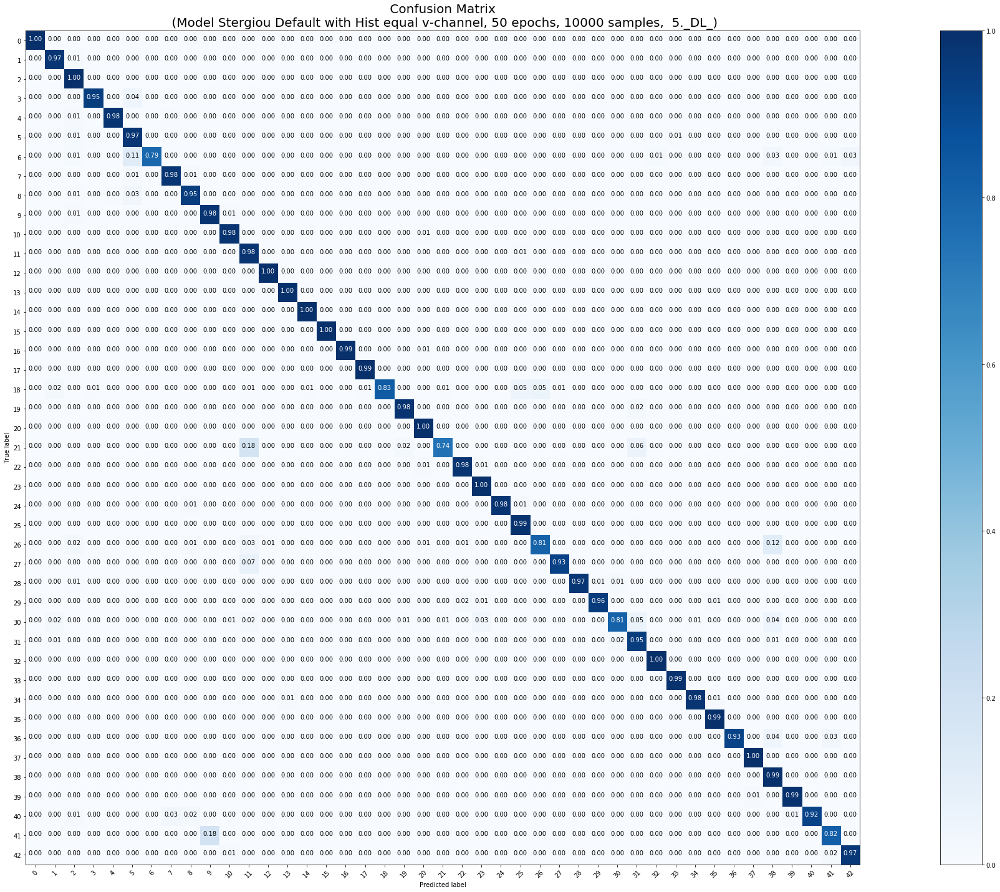

<Figure size 432x288 with 0 Axes>

In [0]:
### 10000, B, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_10000, y_tr_10000, X_test, y_test, 50, 10000)

In [0]:
downloader_B(10000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 9s 902us/step - loss: 0.9362 - acc: 0.7478 - val_loss: 0.4809 - val_acc: 0.8603
Epoch 2/50
10000/10000 [==============================] - 6s 585us/step - loss: 0.1584 - acc: 0.9498 - val_loss: 0.1938 - val_acc: 0.9470
Epoch 3/50
10000/10000 [==============================] - 6s 583us/step - loss: 0.0753 - acc: 0.9756 - val_loss: 0.2936 - val_acc: 0.9135
Epoch 4/50
10000/10000 [==============================] - 6s 585us/step - loss: 0.0471 - acc: 0.9819 - val_loss: 0.1422 - val_acc: 0.9581
Epoch 5/50
10000/10000 [==============================] - 6s 596us/step - loss: 0.0617 - acc: 0.9801 - val_loss: 0.1532 - val_acc: 0.9600
Epoch 6/50
10000/1000

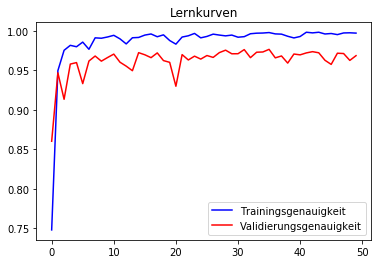

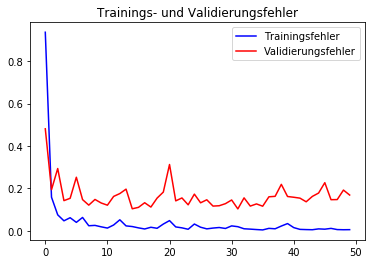

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      0.98      0.98       720
           2       0.99      0.99      0.99       750
           3       0.98      0.98      0.98       450
           4       0.99      0.98      0.99       660
           5       0.88      0.98      0.92       630
           6       0.99      0.71      0.82       150
           7       0.99      0.97      0.98       450
           8       0.99      0.93      0.96       450
           9       0.98      1.00      0.99       480
          10       0.99      0.97      0.98       660
          11       0.95      0.97      0.96       420
          12       1.00      0.98      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      0.99      0.99       270
          15       0.96      1.00      0.98       210
          16       1.00      0.99      1.00   

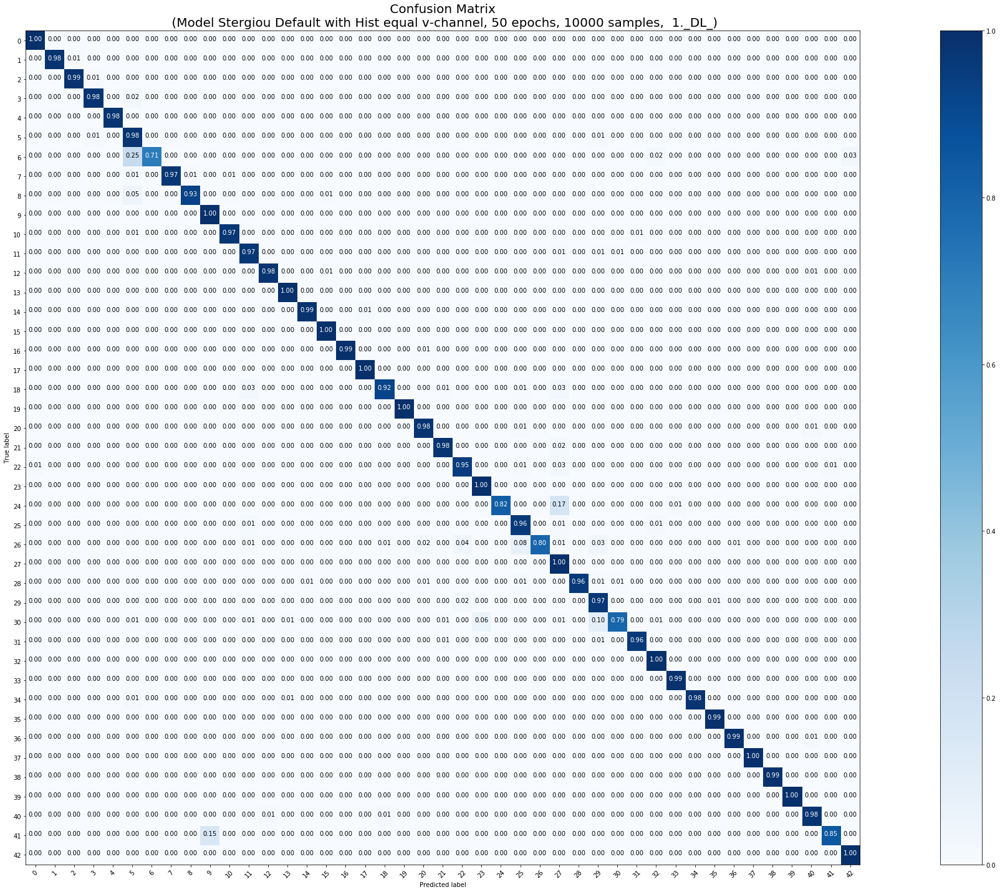

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 9s 928us/step - loss: 0.9772 - acc: 0.7388 - val_loss: 0.2476 - val_acc: 0.9302
Epoch 2/50
10000/10000 [==============================] - 6s 598us/step - loss: 0.1433 - acc: 0.9528 - val_loss: 0.2204 - val_acc: 0.9407
Epoch 3/50
10000/10000 [==============================] - 6s 596us/step - loss: 0.0858 - acc: 0.9713 - val_loss: 0.1822 - val_acc: 0.9508
Epoch 4/50
10000/10000 [==============================] - 6s 585us/step - loss: 0.0611 - acc: 0.9807 - val_loss: 0.1508 - val_acc: 0.9572
Epoch 5/50
10000/10000 [==============================] - 6s 585us/step - loss: 0.0397 - acc: 0.9850 - val_loss: 0.1393 - val_acc: 0.9606
Epoch 6/50
10000/1000

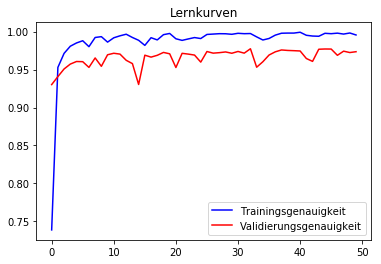

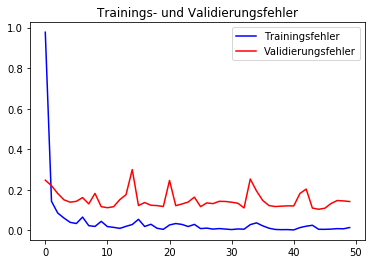

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.98      0.97      0.98       720
           2       0.98      1.00      0.99       750
           3       0.99      0.94      0.96       450
           4       1.00      0.97      0.98       660
           5       0.92      0.98      0.95       630
           6       1.00      0.77      0.87       150
           7       0.97      0.99      0.98       450
           8       0.99      0.93      0.96       450
           9       0.98      0.99      0.98       480
          10       0.98      0.98      0.98       660
          11       0.98      0.98      0.98       420
          12       0.99      1.00      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       1.00      0.99      0.99       210
          16       0.99      0.98      0.98   

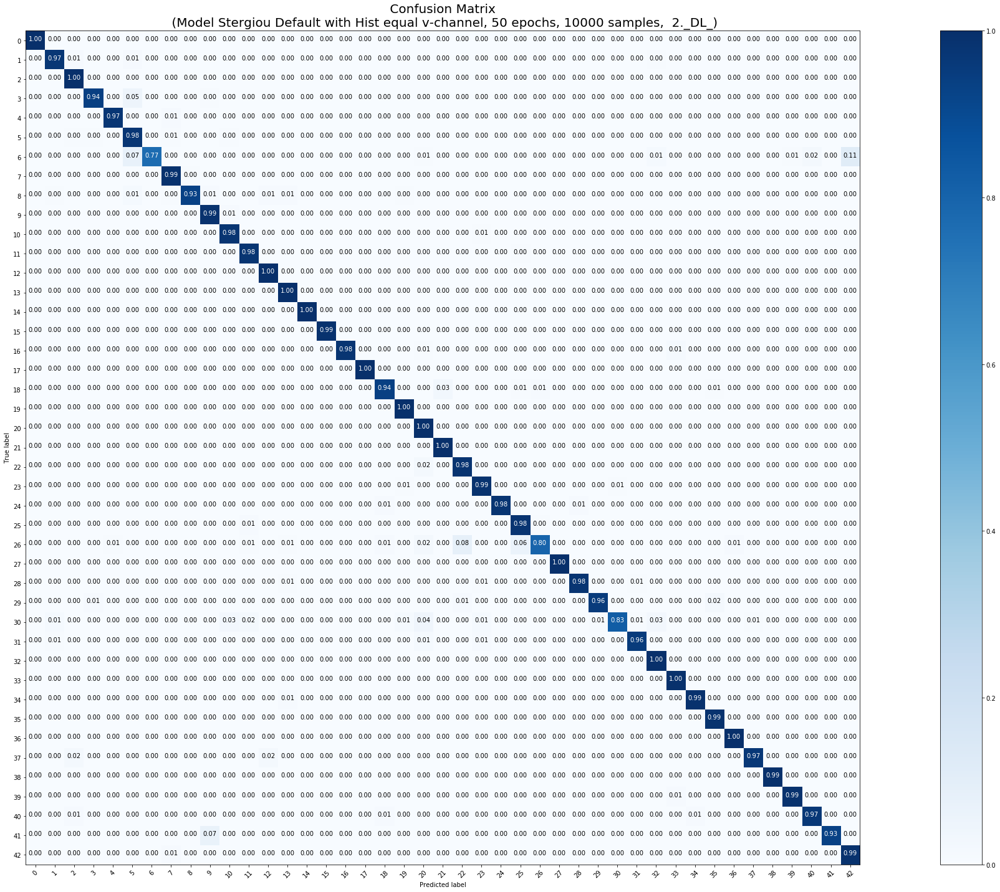

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 10s 977us/step - loss: 0.9273 - acc: 0.7528 - val_loss: 0.2870 - val_acc: 0.9155
Epoch 2/50
10000/10000 [==============================] - 6s 589us/step - loss: 0.1437 - acc: 0.9519 - val_loss: 0.1758 - val_acc: 0.9499
Epoch 3/50
10000/10000 [==============================] - 6s 585us/step - loss: 0.0690 - acc: 0.9760 - val_loss: 0.1581 - val_acc: 0.9546
Epoch 4/50
10000/10000 [==============================] - 6s 582us/step - loss: 0.0413 - acc: 0.9850 - val_loss: 0.1109 - val_acc: 0.9698
Epoch 5/50
10000/10000 [==============================] - 6s 585us/step - loss: 0.0575 - acc: 0.9814 - val_loss: 0.1585 - val_acc: 0.9573
Epoch 6/50
10000/100

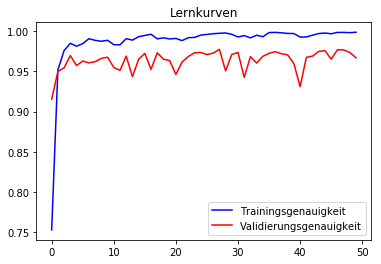

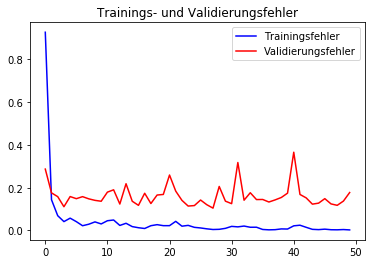

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.98      0.98       720
           2       0.97      1.00      0.99       750
           3       0.99      0.94      0.97       450
           4       1.00      0.91      0.95       660
           5       0.87      0.99      0.93       630
           6       0.99      0.74      0.85       150
           7       0.92      0.97      0.95       450
           8       0.97      0.90      0.93       450
           9       0.97      0.99      0.98       480
          10       1.00      0.99      0.99       660
          11       0.95      0.96      0.95       420
          12       1.00      0.98      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.96      1.00      0.98       210
          16       1.00      0.99      1.00   

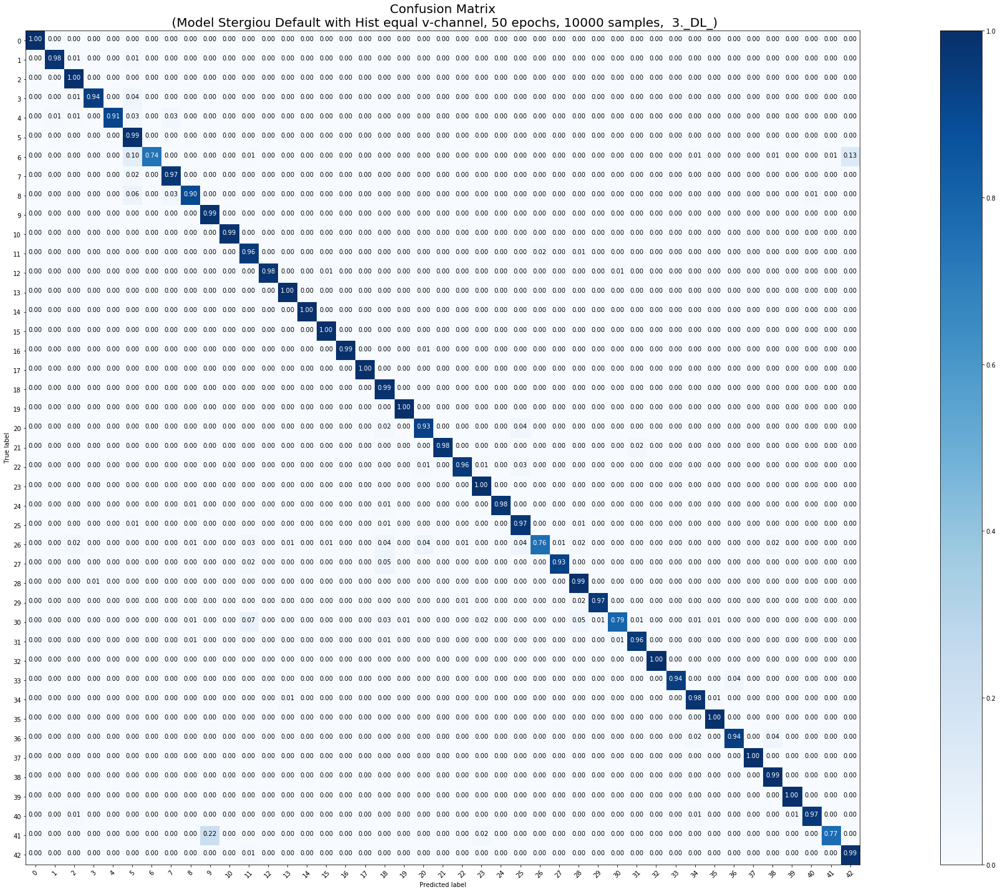

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 10s 1ms/step - loss: 0.9612 - acc: 0.7417 - val_loss: 0.3626 - val_acc: 0.8971
Epoch 2/50
10000/10000 [==============================] - 6s 591us/step - loss: 0.1665 - acc: 0.9463 - val_loss: 0.1927 - val_acc: 0.9489
Epoch 3/50
10000/10000 [==============================] - 6s 592us/step - loss: 0.0923 - acc: 0.9664 - val_loss: 0.1434 - val_acc: 0.9597
Epoch 4/50
10000/10000 [==============================] - 6s 589us/step - loss: 0.0382 - acc: 0.9857 - val_loss: 0.1622 - val_acc: 0.9563
Epoch 5/50
10000/10000 [==============================] - 6s 594us/step - loss: 0.0586 - acc: 0.9799 - val_loss: 0.1394 - val_acc: 0.9591
Epoch 6/50
10000/10000

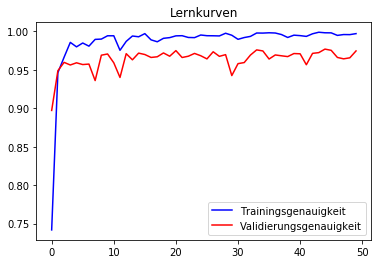

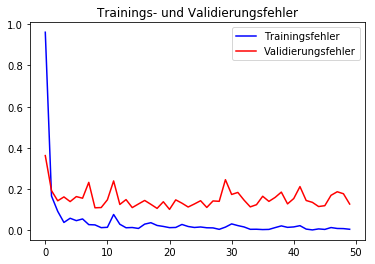

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.97      0.98       720
           2       0.98      1.00      0.99       750
           3       1.00      0.95      0.97       450
           4       0.99      0.99      0.99       660
           5       0.93      0.98      0.96       630
           6       1.00      0.73      0.85       150
           7       0.98      0.98      0.98       450
           8       0.99      0.96      0.97       450
           9       0.98      1.00      0.99       480
          10       0.99      0.99      0.99       660
          11       0.97      0.97      0.97       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       0.98      1.00      0.99       270
          15       0.95      1.00      0.98       210
          16       0.99      0.99      0.99   

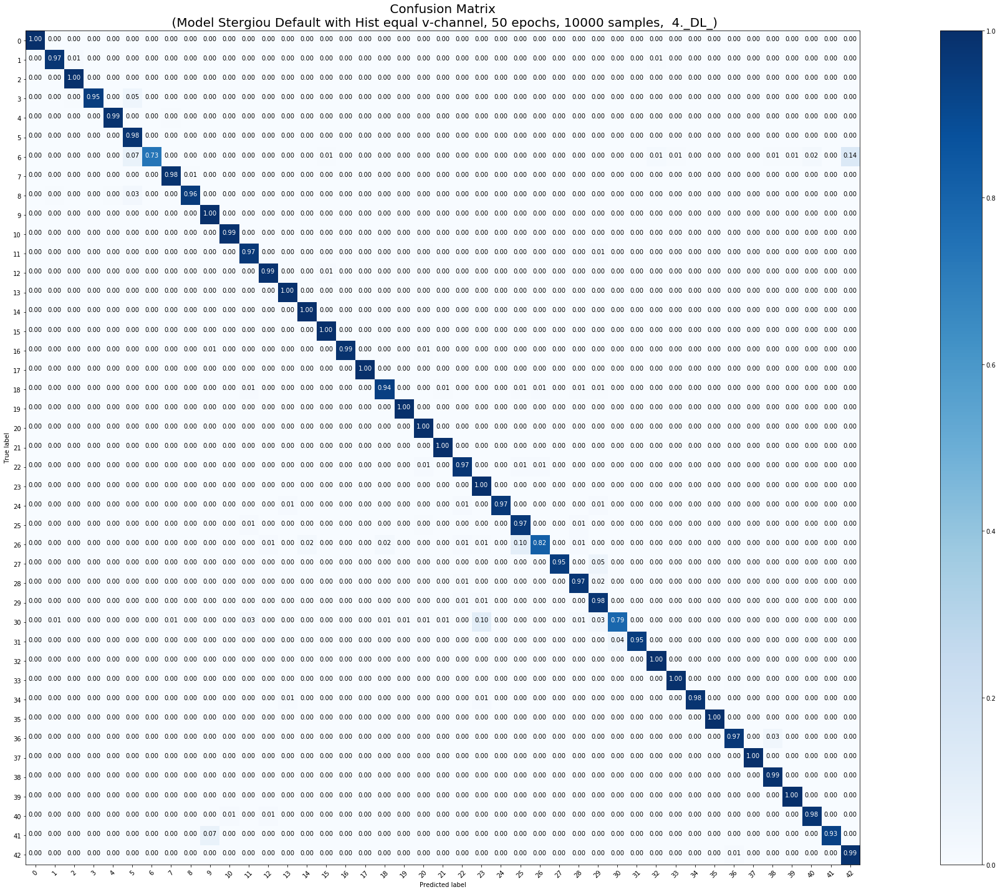

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 11s 1ms/step - loss: 0.9270 - acc: 0.7387 - val_loss: 0.2597 - val_acc: 0.9277
Epoch 2/50
10000/10000 [==============================] - 6s 603us/step - loss: 0.1493 - acc: 0.9517 - val_loss: 0.1850 - val_acc: 0.9478
Epoch 3/50
10000/10000 [==============================] - 6s 613us/step - loss: 0.0976 - acc: 0.9692 - val_loss: 0.2215 - val_acc: 0.9454
Epoch 4/50
10000/10000 [==============================] - 6s 612us/step - loss: 0.0538 - acc: 0.9804 - val_loss: 0.1900 - val_acc: 0.9477
Epoch 5/50
10000/10000 [==============================] - 6s 589us/step - loss: 0.0694 - acc: 0.9807 - val_loss: 0.2683 - val_acc: 0.9247
Epoch 6/50
10000/10000

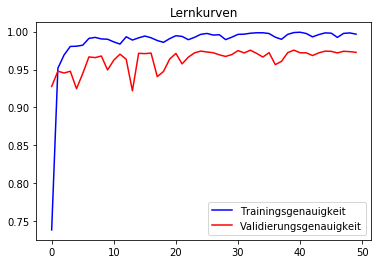

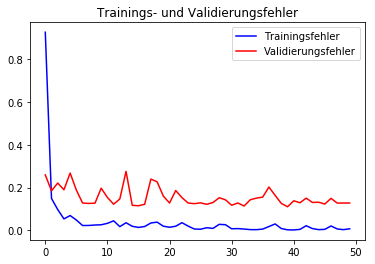

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.95      0.97        60
           1       0.99      0.98      0.98       720
           2       0.98      0.99      0.99       750
           3       0.98      0.95      0.97       450
           4       0.98      0.99      0.99       660
           5       0.94      0.96      0.95       630
           6       0.97      0.81      0.88       150
           7       0.98      0.98      0.98       450
           8       0.97      0.95      0.96       450
           9       0.99      1.00      0.99       480
          10       1.00      0.98      0.99       660
          11       0.98      0.98      0.98       420
          12       1.00      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.99      0.99      0.99   

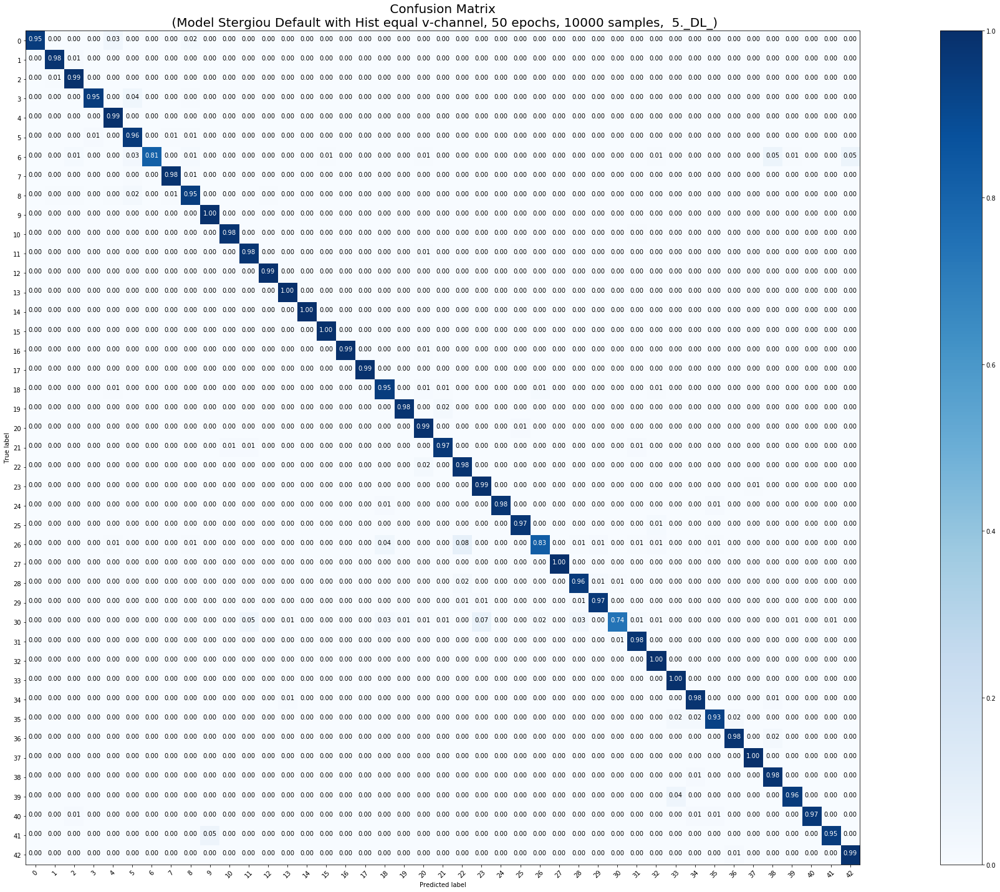

<Figure size 432x288 with 0 Axes>

In [0]:
### 10000, B, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_10000, y_tr_10000, X_test, y_test, 50, 10000)

In [0]:
downloaderCW_B(10000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 22s 1ms/step - loss: 0.4082 - acc: 0.8911 - val_loss: 0.1728 - val_acc: 0.9533
Epoch 2/50
20000/20000 [==============================] - 14s 682us/step - loss: 0.0738 - acc: 0.9806 - val_loss: 0.1304 - val_acc: 0.9621
Epoch 3/50
20000/20000 [==============================] - 14s 688us/step - loss: 0.0434 - acc: 0.9884 - val_loss: 0.1441 - val_acc: 0.9606
Epoch 4/50
20000/20000 [==============================] - 14s 684us/step - loss: 0.0344 - acc: 0.9898 - val_loss: 0.1239 - val_acc: 0.9682
Epoch 5/50
20000/20000 [==============================] - 14s 685us/step - loss: 0.0291 - acc: 0.9910 - val_loss: 0.1073 - val_acc: 0.9705
Epoch 6/50
20000/20000 [

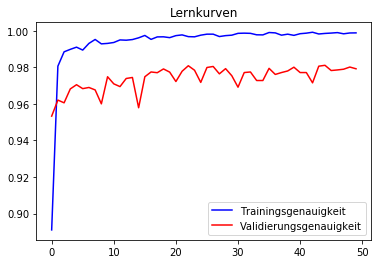

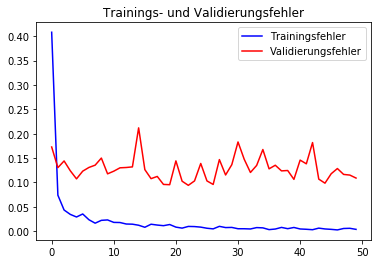

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.98      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       1.00      0.96      0.98       450
           4       0.99      0.99      0.99       660
           5       0.97      0.97      0.97       630
           6       0.98      0.87      0.92       150
           7       0.96      0.98      0.97       450
           8       0.95      0.97      0.96       450
           9       0.98      1.00      0.99       480
          10       1.00      0.99      0.99       660
          11       0.98      0.98      0.98       420
          12       0.99      1.00      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      0.99      1.00       270
          15       0.99      0.99      0.99       210
          16       0.99      0.99      0.99   

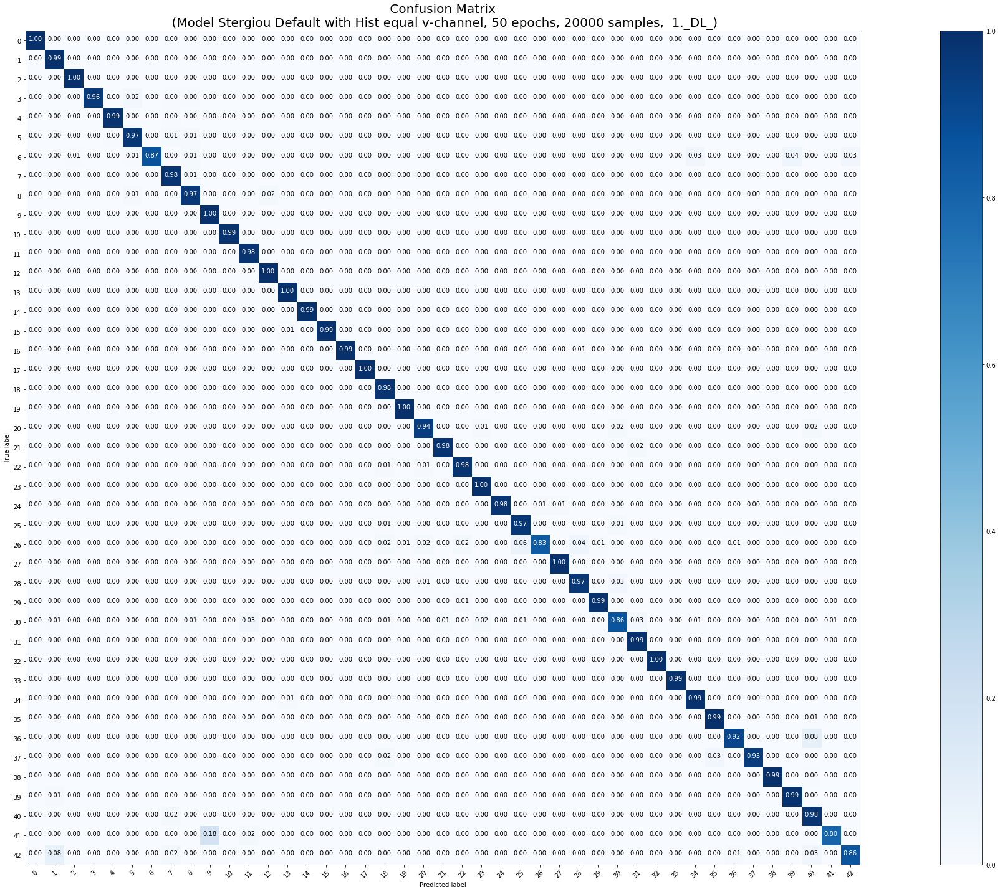

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 22s 1ms/step - loss: 0.4105 - acc: 0.8881 - val_loss: 0.1394 - val_acc: 0.9633
Epoch 2/50
20000/20000 [==============================] - 14s 676us/step - loss: 0.0835 - acc: 0.9755 - val_loss: 0.1143 - val_acc: 0.9664
Epoch 3/50
20000/20000 [==============================] - 13s 665us/step - loss: 0.0484 - acc: 0.9858 - val_loss: 0.1204 - val_acc: 0.9676
Epoch 4/50
20000/20000 [==============================] - 13s 668us/step - loss: 0.0345 - acc: 0.9901 - val_loss: 0.1405 - val_acc: 0.9671
Epoch 5/50
20000/20000 [==============================] - 13s 671us/step - loss: 0.0285 - acc: 0.9919 - val_loss: 0.1621 - val_acc: 0.9576
Epoch 6/50
20000/20000 [

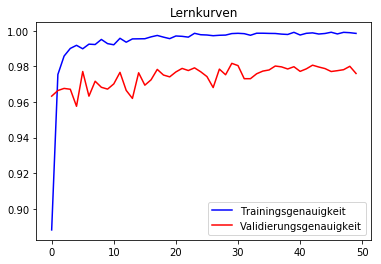

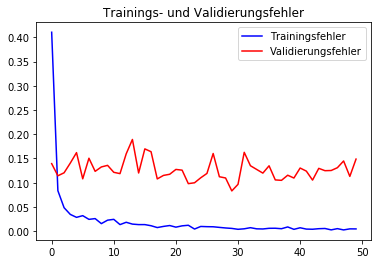

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      1.00      0.99       720
           2       0.99      1.00      0.99       750
           3       0.99      0.93      0.96       450
           4       1.00      0.98      0.99       660
           5       0.88      0.99      0.93       630
           6       1.00      0.76      0.86       150
           7       0.99      0.98      0.98       450
           8       0.99      0.95      0.97       450
           9       0.98      1.00      0.99       480
          10       1.00      1.00      1.00       660
          11       0.98      0.99      0.98       420
          12       1.00      0.98      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.93      1.00      0.96       210
          16       1.00      0.99      0.99   

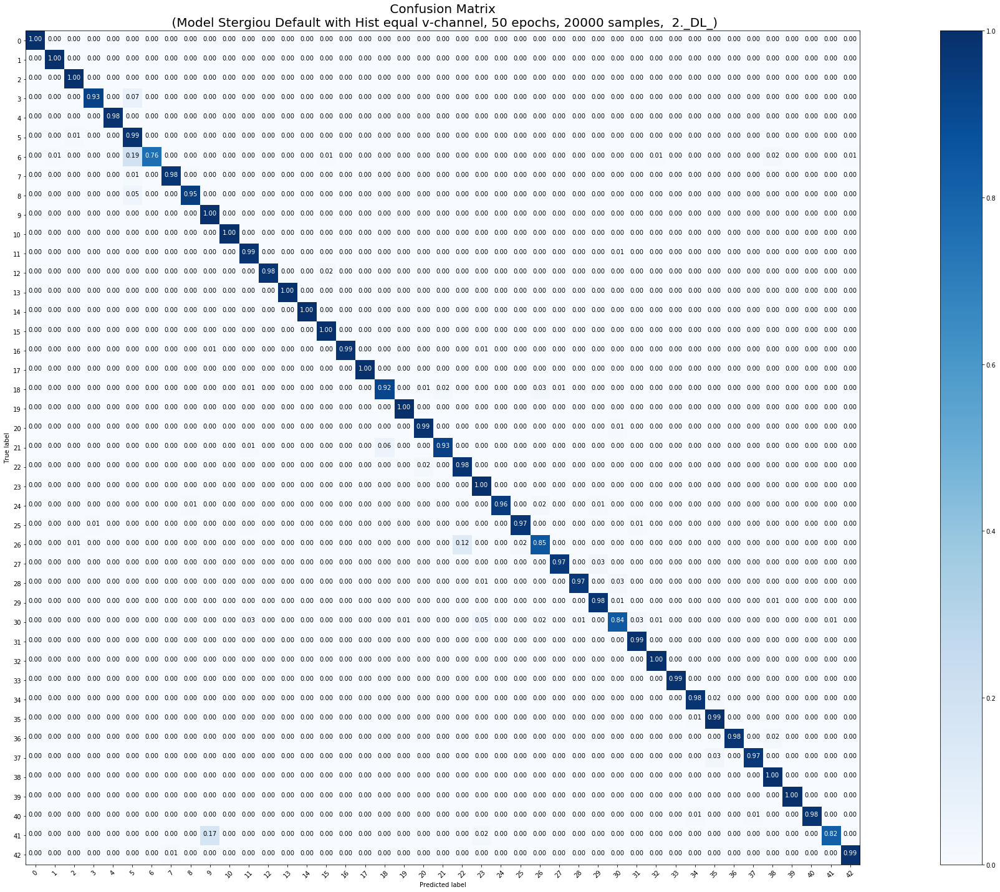

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 23s 1ms/step - loss: 0.4029 - acc: 0.8931 - val_loss: 0.1639 - val_acc: 0.9517
Epoch 2/50
20000/20000 [==============================] - 14s 700us/step - loss: 0.0759 - acc: 0.9794 - val_loss: 0.1353 - val_acc: 0.9621
Epoch 3/50
20000/20000 [==============================] - 14s 691us/step - loss: 0.0476 - acc: 0.9855 - val_loss: 0.1534 - val_acc: 0.9621
Epoch 4/50
20000/20000 [==============================] - 14s 689us/step - loss: 0.0296 - acc: 0.9911 - val_loss: 0.1230 - val_acc: 0.9663
Epoch 5/50
20000/20000 [==============================] - 14s 684us/step - loss: 0.0314 - acc: 0.9910 - val_loss: 0.1307 - val_acc: 0.9672
Epoch 6/50
20000/20000 [

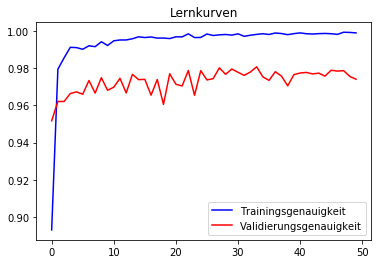

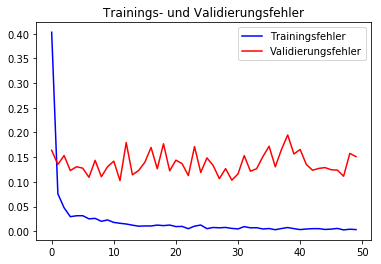

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.82      1.00      0.90        60
           1       0.98      1.00      0.99       720
           2       0.99      1.00      0.99       750
           3       1.00      0.96      0.98       450
           4       1.00      0.99      0.99       660
           5       0.94      0.99      0.97       630
           6       0.93      0.84      0.88       150
           7       0.99      0.99      0.99       450
           8       0.98      0.96      0.97       450
           9       0.98      1.00      0.99       480
          10       1.00      0.99      1.00       660
          11       0.96      0.98      0.97       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.99      0.99      0.99   

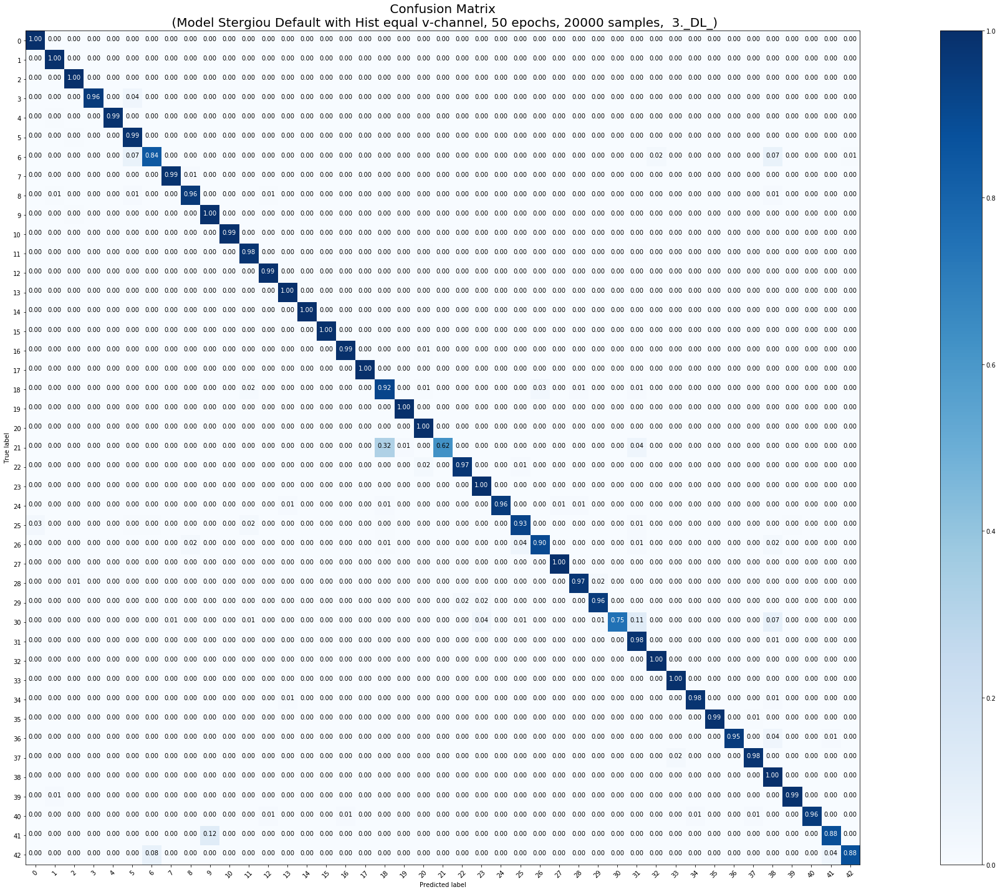

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 24s 1ms/step - loss: 0.3872 - acc: 0.8945 - val_loss: 0.1654 - val_acc: 0.9535
Epoch 2/50
20000/20000 [==============================] - 14s 693us/step - loss: 0.0755 - acc: 0.9781 - val_loss: 0.1731 - val_acc: 0.9531
Epoch 3/50
20000/20000 [==============================] - 14s 689us/step - loss: 0.0496 - acc: 0.9859 - val_loss: 0.1518 - val_acc: 0.9572
Epoch 4/50
20000/20000 [==============================] - 14s 691us/step - loss: 0.0376 - acc: 0.9888 - val_loss: 0.1301 - val_acc: 0.9659
Epoch 5/50
20000/20000 [==============================] - 14s 689us/step - loss: 0.0337 - acc: 0.9892 - val_loss: 0.1136 - val_acc: 0.9705
Epoch 6/50
20000/20000 [

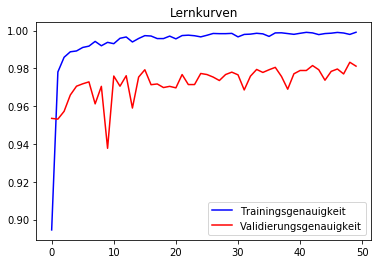

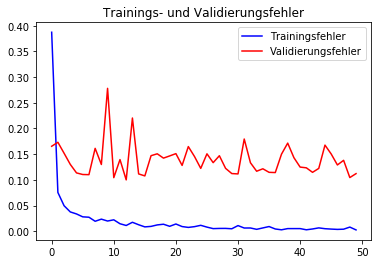

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       0.99      0.94      0.97       450
           4       0.99      0.99      0.99       660
           5       0.91      0.99      0.95       630
           6       1.00      0.86      0.92       150
           7       1.00      0.99      1.00       450
           8       1.00      0.93      0.96       450
           9       0.97      1.00      0.99       480
          10       1.00      0.99      0.99       660
          11       0.99      0.99      0.99       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       0.99      1.00      1.00       270
          15       0.97      1.00      0.98       210
          16       0.98      0.99      0.99   

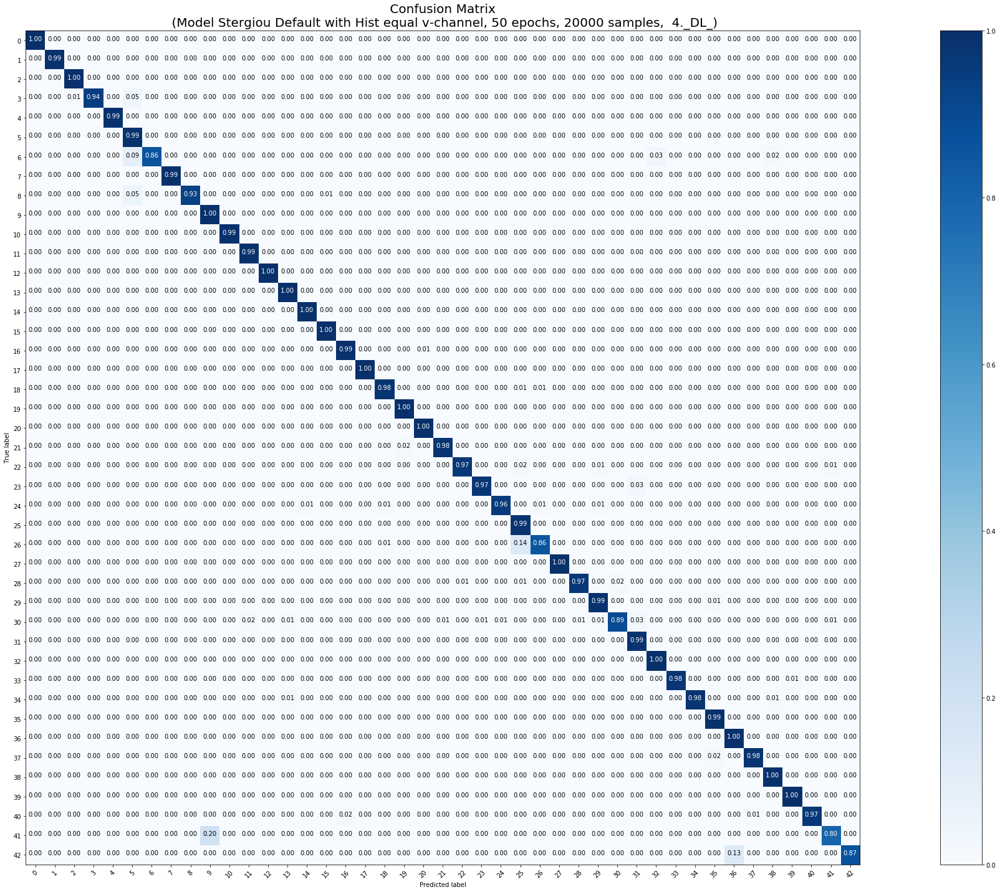

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 25s 1ms/step - loss: 0.4015 - acc: 0.8927 - val_loss: 0.2529 - val_acc: 0.9298
Epoch 2/50
20000/20000 [==============================] - 14s 694us/step - loss: 0.0755 - acc: 0.9793 - val_loss: 0.1185 - val_acc: 0.9660
Epoch 3/50
20000/20000 [==============================] - 14s 693us/step - loss: 0.0475 - acc: 0.9862 - val_loss: 0.1205 - val_acc: 0.9679
Epoch 4/50
20000/20000 [==============================] - 14s 689us/step - loss: 0.0376 - acc: 0.9884 - val_loss: 0.1685 - val_acc: 0.9553
Epoch 5/50
20000/20000 [==============================] - 14s 691us/step - loss: 0.0343 - acc: 0.9901 - val_loss: 0.1517 - val_acc: 0.9577
Epoch 6/50
20000/20000 [

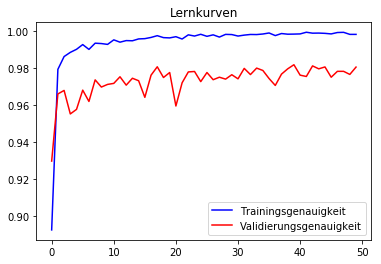

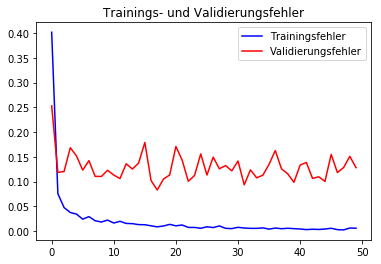

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.97      1.00      0.98       720
           2       0.99      0.99      0.99       750
           3       0.99      0.98      0.98       450
           4       1.00      0.98      0.99       660
           5       0.96      0.99      0.97       630
           6       1.00      0.94      0.97       150
           7       1.00      0.99      0.99       450
           8       0.97      0.94      0.96       450
           9       1.00      1.00      1.00       480
          10       0.99      1.00      1.00       660
          11       0.91      0.98      0.94       420
          12       0.99      1.00      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       1.00      0.99      1.00   

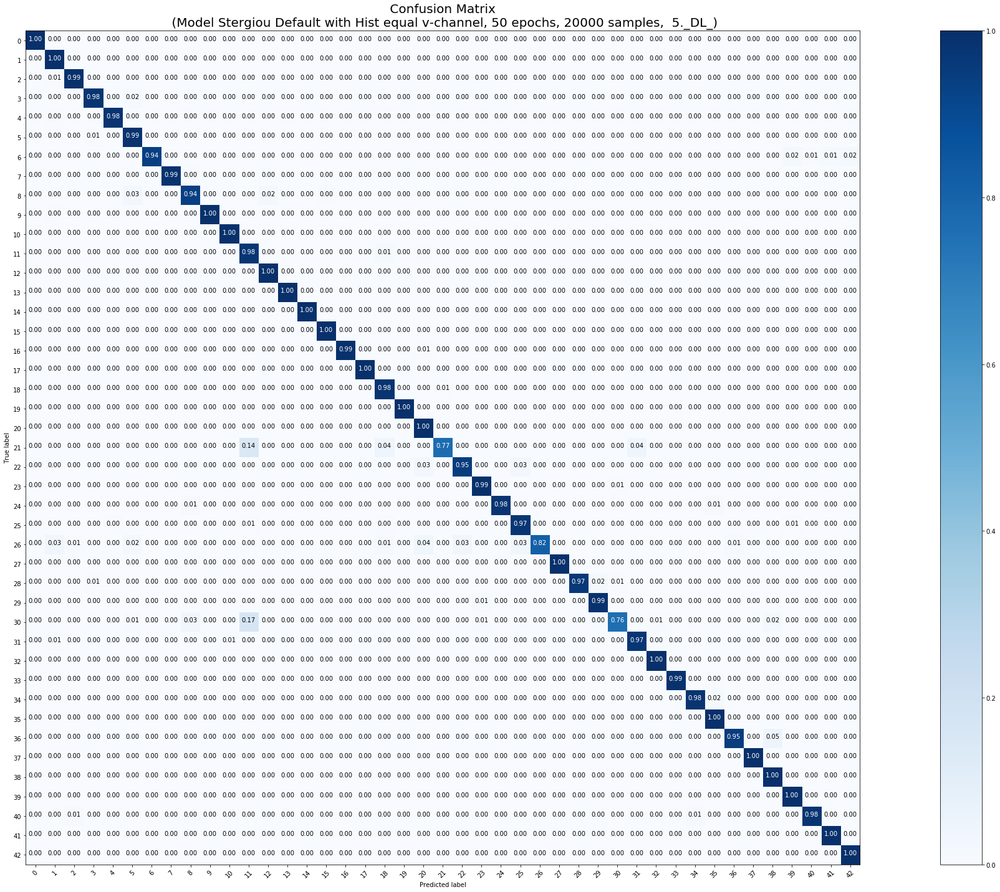

<Figure size 432x288 with 0 Axes>

In [0]:
### 20000, B, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_20000, y_tr_20000, X_test, y_test, 50, 20000)

In [0]:
downloader_B(20000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 15s 766us/step - loss: 0.5792 - acc: 0.8410 - val_loss: 0.2430 - val_acc: 0.9289
Epoch 2/50
20000/20000 [==============================] - 10s 521us/step - loss: 0.0842 - acc: 0.9725 - val_loss: 0.1763 - val_acc: 0.9492
Epoch 3/50
20000/20000 [==============================] - 10s 516us/step - loss: 0.0703 - acc: 0.9779 - val_loss: 0.1865 - val_acc: 0.9470
Epoch 4/50
20000/20000 [==============================] - 10s 514us/step - loss: 0.0387 - acc: 0.9852 - val_loss: 0.1129 - val_acc: 0.9680
Epoch 5/50
20000/20000 [==============================] - 10s 516us/step - loss: 0.0304 - acc: 0.9879 - val_loss: 0.1157 - val_acc: 0.9701
Epoch 6/50
20000

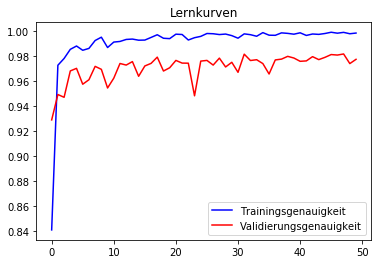

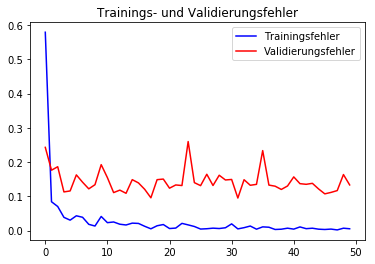

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.94      1.00      0.97        60
           1       0.98      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       1.00      0.94      0.97       450
           4       1.00      0.98      0.99       660
           5       0.92      1.00      0.95       630
           6       1.00      0.83      0.91       150
           7       1.00      0.96      0.98       450
           8       0.98      0.96      0.97       450
           9       1.00      1.00      1.00       480
          10       0.99      0.99      0.99       660
          11       0.97      0.99      0.98       420
          12       0.98      0.98      0.98       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.94      1.00      0.97       210
          16       0.97      0.99      0.98   

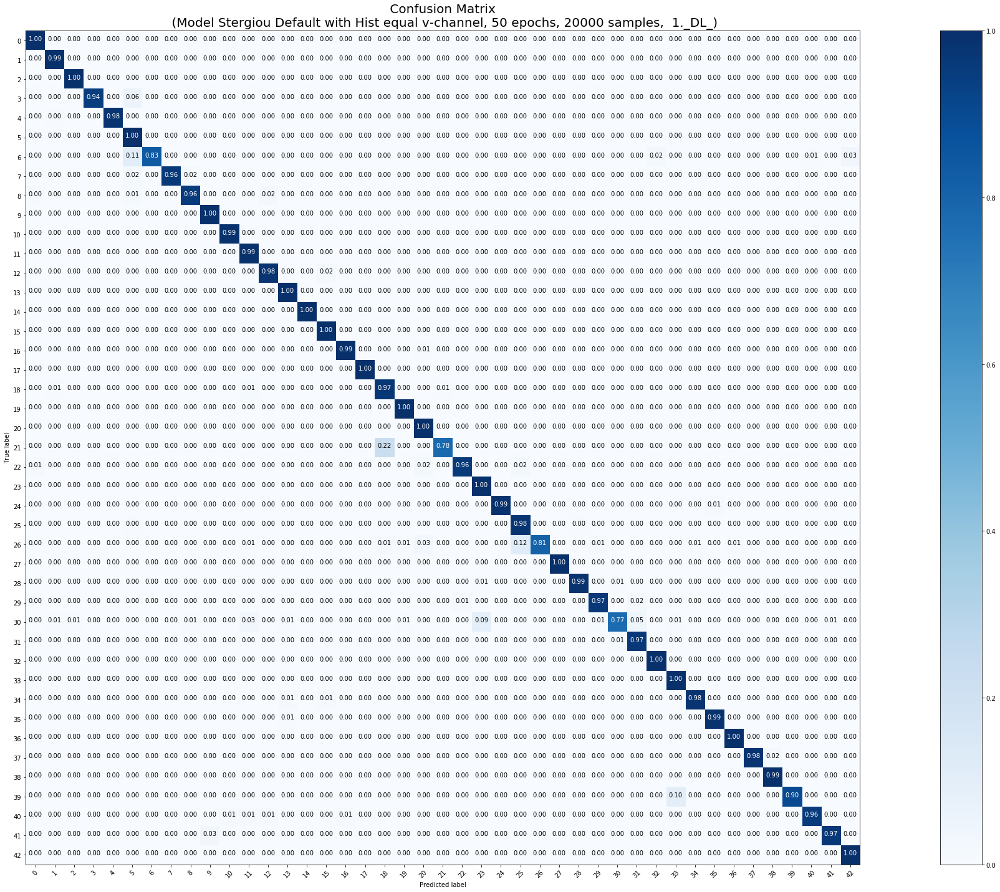

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 16s 775us/step - loss: 0.5801 - acc: 0.8384 - val_loss: 0.1967 - val_acc: 0.9477
Epoch 2/50
20000/20000 [==============================] - 10s 515us/step - loss: 0.0950 - acc: 0.9656 - val_loss: 0.1616 - val_acc: 0.9596
Epoch 3/50
20000/20000 [==============================] - 10s 517us/step - loss: 0.0646 - acc: 0.9788 - val_loss: 0.1424 - val_acc: 0.9641
Epoch 4/50
20000/20000 [==============================] - 10s 512us/step - loss: 0.0579 - acc: 0.9806 - val_loss: 0.1282 - val_acc: 0.9683
Epoch 5/50
20000/20000 [==============================] - 10s 510us/step - loss: 0.0359 - acc: 0.9869 - val_loss: 0.1644 - val_acc: 0.9588
Epoch 6/50
20000

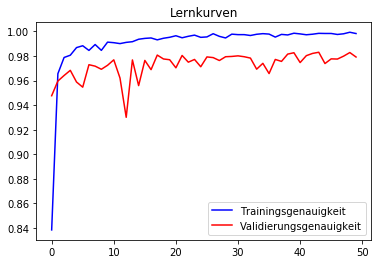

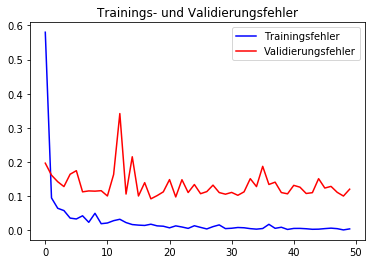

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.98      1.00      0.99       720
           2       1.00      1.00      1.00       750
           3       1.00      0.97      0.99       450
           4       1.00      0.98      0.99       660
           5       0.89      1.00      0.94       630
           6       1.00      0.76      0.86       150
           7       0.98      0.98      0.98       450
           8       1.00      0.93      0.96       450
           9       1.00      0.98      0.99       480
          10       0.99      0.99      0.99       660
          11       0.98      0.99      0.98       420
          12       1.00      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.93      1.00      0.96       210
          16       0.98      0.99      0.98   

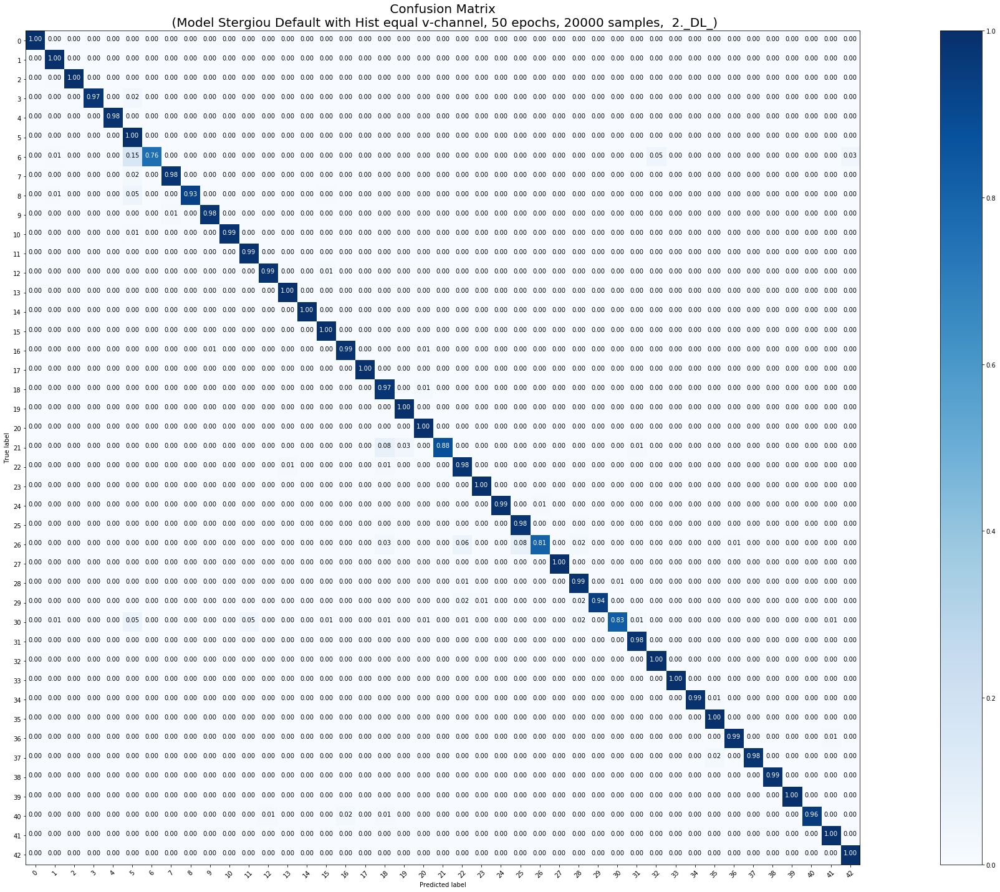

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 16s 793us/step - loss: 0.5478 - acc: 0.8466 - val_loss: 0.2154 - val_acc: 0.9390
Epoch 2/50
20000/20000 [==============================] - 10s 514us/step - loss: 0.0976 - acc: 0.9684 - val_loss: 0.1782 - val_acc: 0.9506
Epoch 3/50
20000/20000 [==============================] - 10s 513us/step - loss: 0.0543 - acc: 0.9815 - val_loss: 0.1672 - val_acc: 0.9554
Epoch 4/50
20000/20000 [==============================] - 10s 515us/step - loss: 0.0393 - acc: 0.9859 - val_loss: 0.1299 - val_acc: 0.9660
Epoch 5/50
20000/20000 [==============================] - 10s 516us/step - loss: 0.0468 - acc: 0.9832 - val_loss: 0.1858 - val_acc: 0.9539
Epoch 6/50
20000

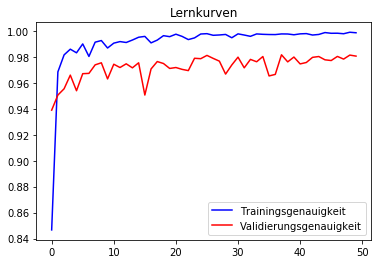

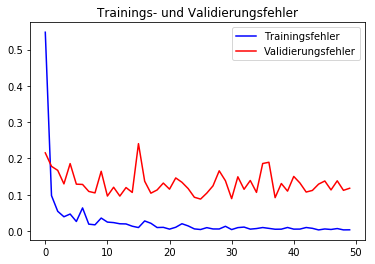

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       1.00      0.94      0.97       450
           4       0.99      0.99      0.99       660
           5       0.91      0.99      0.95       630
           6       0.99      0.86      0.92       150
           7       0.99      0.98      0.99       450
           8       0.99      0.93      0.96       450
           9       1.00      1.00      1.00       480
          10       1.00      0.99      0.99       660
          11       0.97      0.98      0.98       420
          12       0.98      1.00      0.99       690
          13       1.00      1.00      1.00       720
          14       0.99      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.98      0.99      0.98   

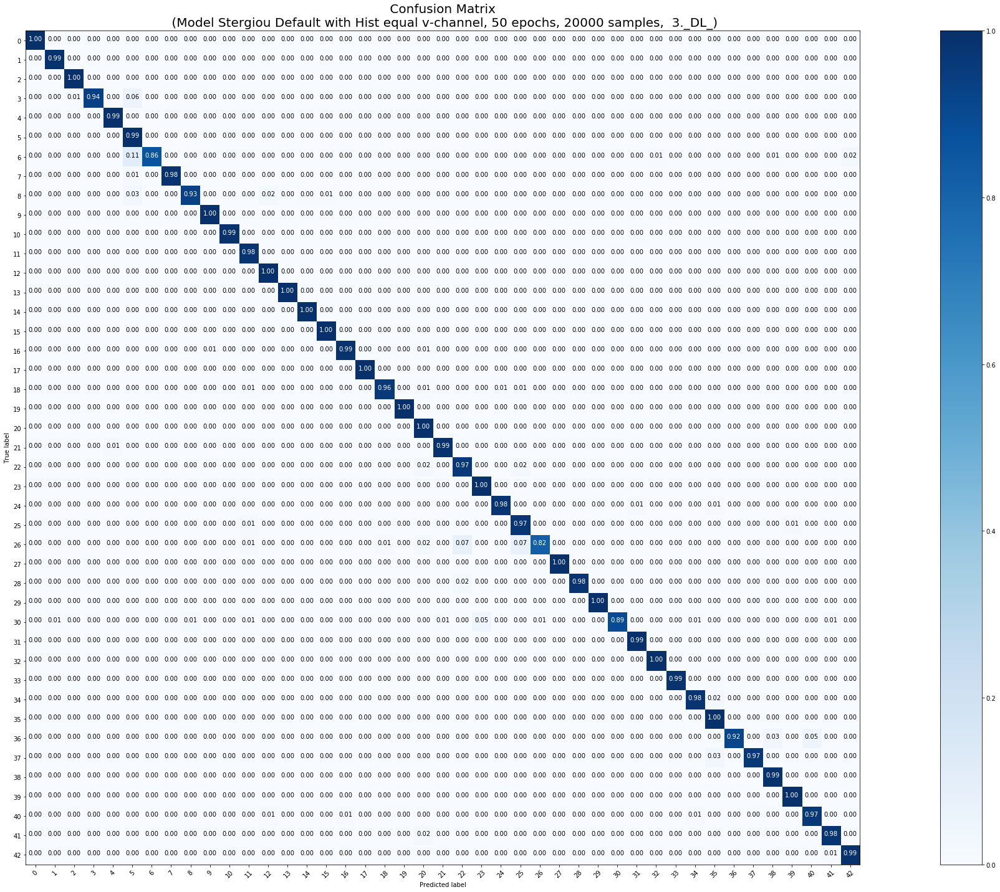

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 17s 874us/step - loss: 0.5764 - acc: 0.8403 - val_loss: 0.2145 - val_acc: 0.9404
Epoch 2/50
20000/20000 [==============================] - 11s 552us/step - loss: 0.0876 - acc: 0.9707 - val_loss: 0.1961 - val_acc: 0.9481
Epoch 3/50
20000/20000 [==============================] - 11s 556us/step - loss: 0.0527 - acc: 0.9813 - val_loss: 0.2533 - val_acc: 0.9283
Epoch 4/50
20000/20000 [==============================] - 11s 559us/step - loss: 0.0585 - acc: 0.9811 - val_loss: 0.3748 - val_acc: 0.9007
Epoch 5/50
20000/20000 [==============================] - 11s 567us/step - loss: 0.0429 - acc: 0.9839 - val_loss: 0.1872 - val_acc: 0.9538
Epoch 6/50
20000

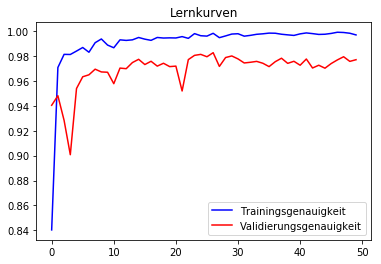

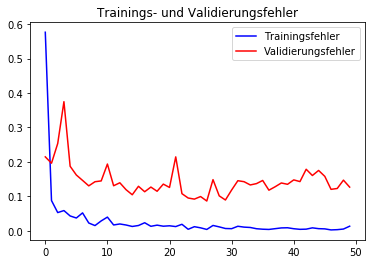

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      1.00      0.98        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       0.99      0.95      0.97       450
           4       1.00      0.99      0.99       660
           5       0.93      0.99      0.96       630
           6       1.00      0.82      0.90       150
           7       0.99      0.98      0.98       450
           8       0.98      0.94      0.96       450
           9       0.97      0.99      0.98       480
          10       1.00      0.99      0.99       660
          11       0.96      0.98      0.97       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      0.99       210
          16       1.00      0.99      0.99   

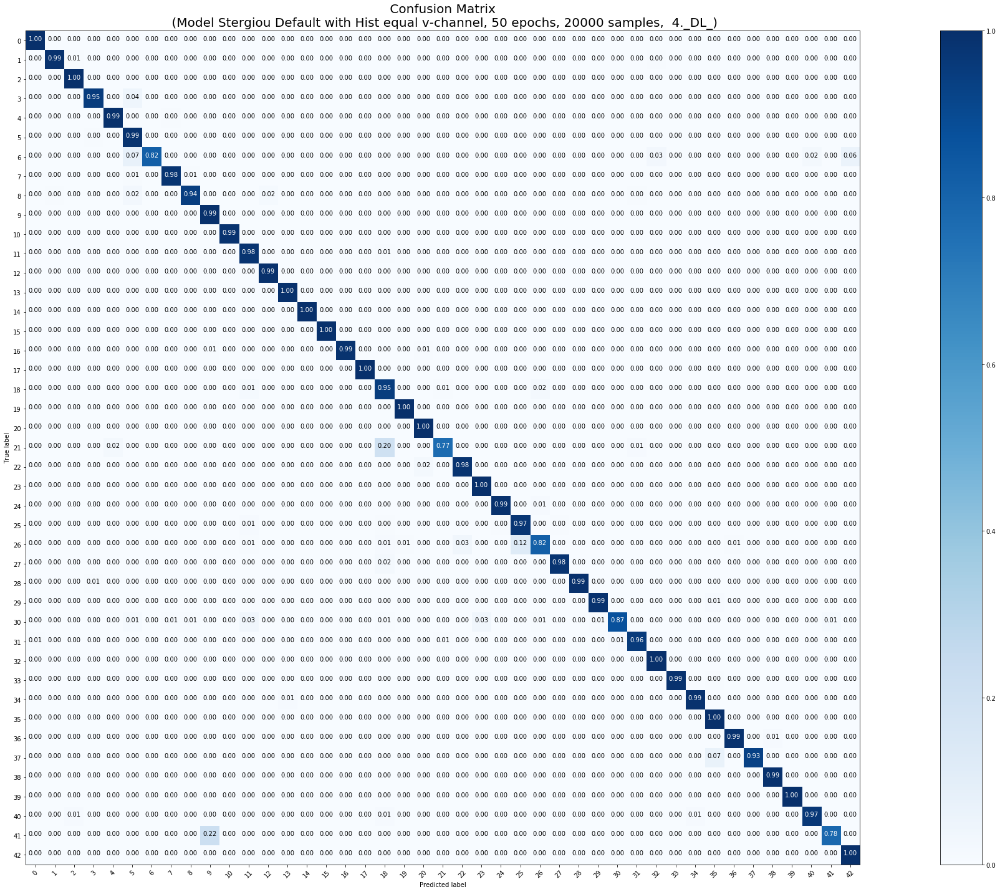

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 17s 865us/step - loss: 0.6014 - acc: 0.8367 - val_loss: 0.1677 - val_acc: 0.9515
Epoch 2/50
20000/20000 [==============================] - 11s 532us/step - loss: 0.0832 - acc: 0.9728 - val_loss: 0.1261 - val_acc: 0.9663
Epoch 3/50
20000/20000 [==============================] - 11s 534us/step - loss: 0.0590 - acc: 0.9793 - val_loss: 0.1094 - val_acc: 0.9702
Epoch 4/50
20000/20000 [==============================] - 11s 535us/step - loss: 0.0524 - acc: 0.9811 - val_loss: 0.1614 - val_acc: 0.9577
Epoch 5/50
20000/20000 [==============================] - 11s 532us/step - loss: 0.0442 - acc: 0.9849 - val_loss: 0.1257 - val_acc: 0.9654
Epoch 6/50
20000

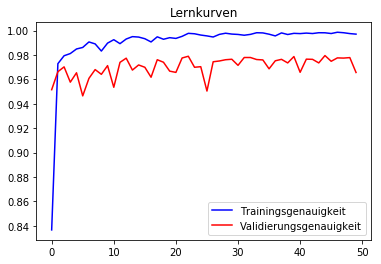

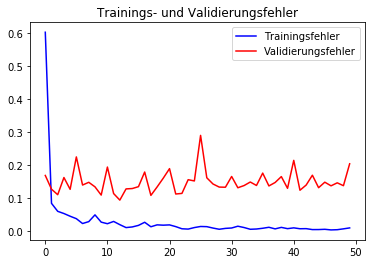

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.98      0.98        60
           1       0.99      0.98      0.98       720
           2       1.00      1.00      1.00       750
           3       0.99      0.92      0.96       450
           4       0.99      0.99      0.99       660
           5       0.90      0.99      0.94       630
           6       1.00      0.71      0.83       150
           7       0.98      0.98      0.98       450
           8       1.00      0.92      0.95       450
           9       0.98      1.00      0.99       480
          10       0.99      0.99      0.99       660
          11       0.98      0.98      0.98       420
          12       1.00      0.99      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.90      1.00      0.95       210
          16       0.99      0.98      0.99   

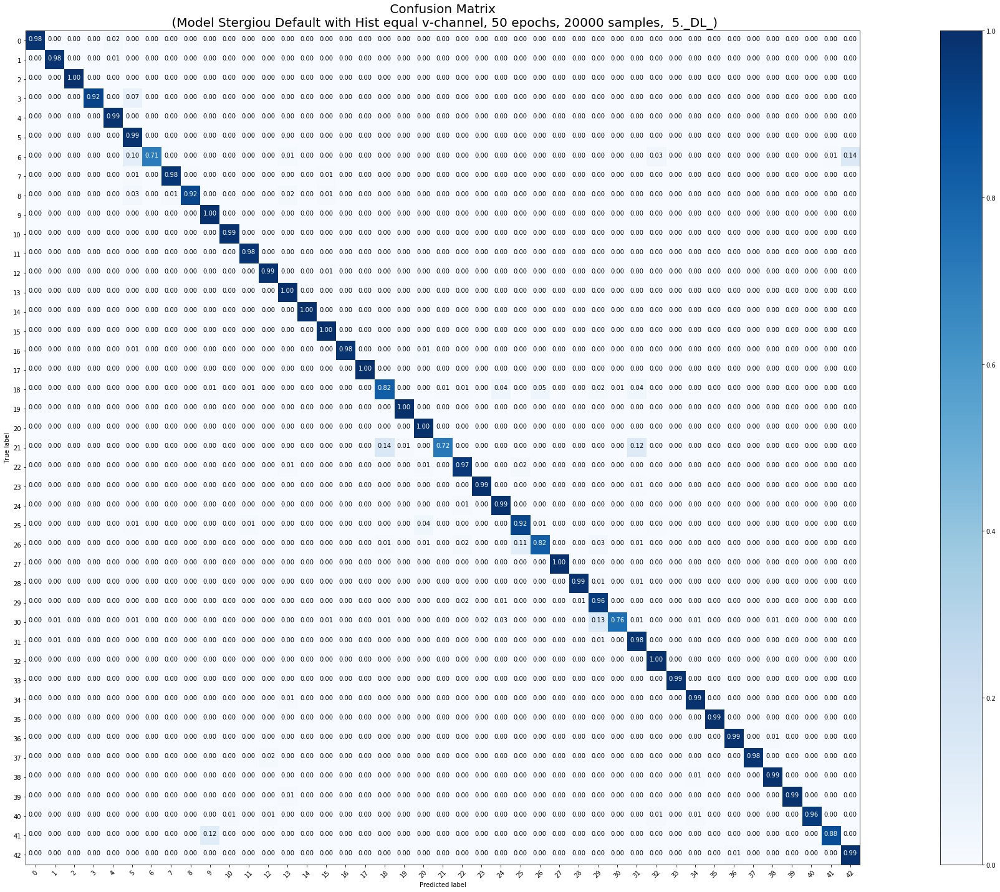

<Figure size 432x288 with 0 Axes>

In [0]:
### 20000, B, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr_20000, y_tr_20000, X_test, y_test, 50, 20000)

In [0]:
downloaderCW_B(20000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Normales Training beginnt










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
categorical crossentropy


Training ohne Klassengewichte beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 30s 771us/step - loss: 0.2528 - acc: 0.9320 - val_loss: 0.1224 - val_acc: 0.9663
Epoch 2/50
39209/39209 [==============================] - 23s 578us/step - loss: 0.0539 - acc: 0.9842 - val_loss: 0.1483 - val_acc: 0.9559
Epoch 3/50
39209/39209 [==============================] - 22s 569us/step - loss: 0.0386 - acc: 0.9882 - val_loss: 0.1106 - val_acc: 0.9706
Epoch 4/50
39209/39209 [==============================] - 22s 564us/step - lo

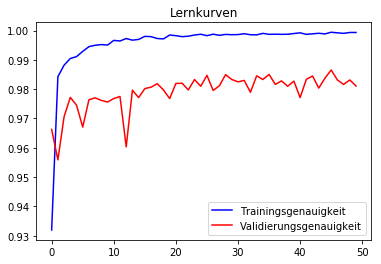

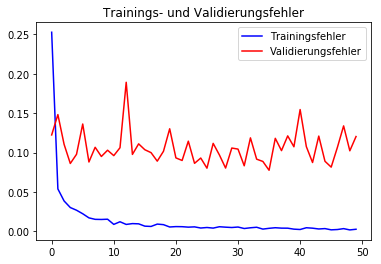

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.98      0.98        60
           1       0.98      1.00      0.99       720
           2       1.00      0.99      1.00       750
           3       1.00      0.92      0.96       450
           4       1.00      0.99      0.99       660
           5       0.92      1.00      0.96       630
           6       1.00      0.81      0.90       150
           7       0.98      0.99      0.99       450
           8       1.00      0.96      0.98       450
           9       1.00      1.00      1.00       480
          10       1.00      1.00      1.00       660
          11       0.91      1.00      0.95       420
          12       0.99      1.00      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      0.99       210
          16       0.99      0.99      0.99   

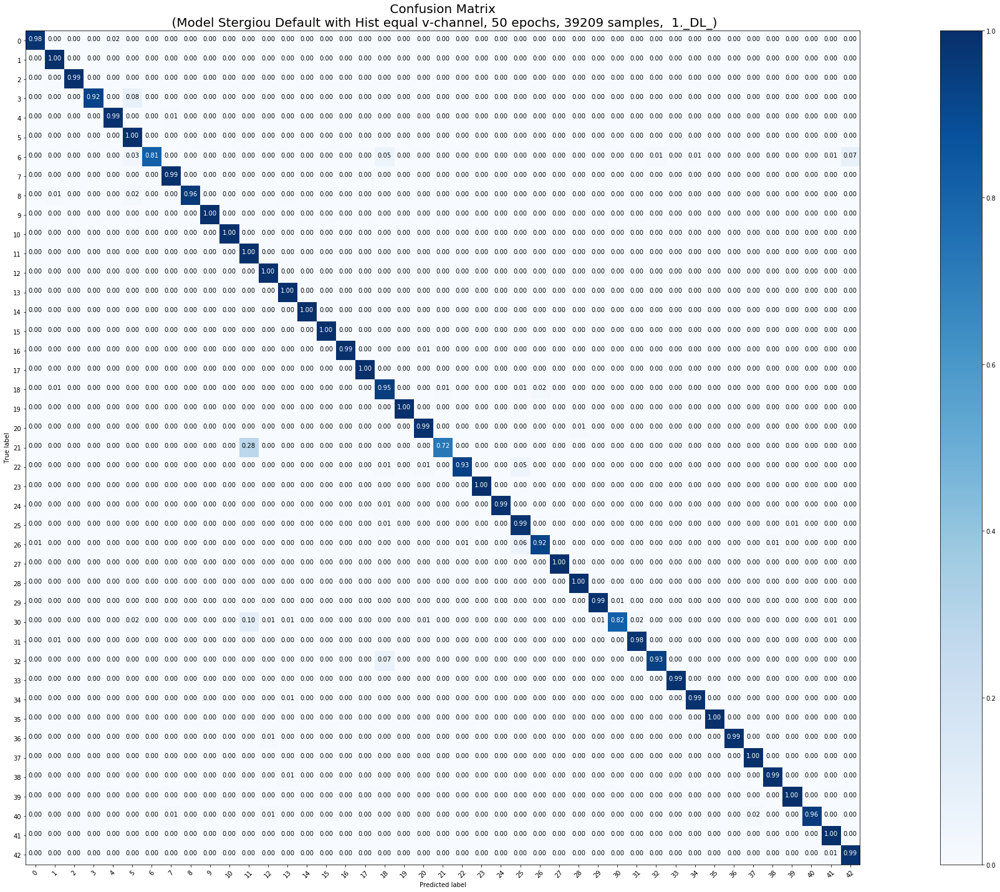

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 24s 607us/step - loss: 0.2485 - acc: 0.9324 - val_loss: 0.1201 - val_acc: 0.9677
Epoch 2/50
39209/39209 [==============================] - 22s 565us/step - loss: 0.0521 - acc: 0.9845 - val_loss: 0.1298 - val_acc: 0.9622
Epoch 3/50
39209/39209 [==============================] - 22s 569us/step - loss: 0.0356 - acc: 0.9900 - val_loss: 0.1149 - val_acc: 0.9706
Epoch 4/50
39209/39209 [==============================] - 22s 557us/step - loss: 0.0332 - acc: 0.9897 - val_loss: 0.1088 - val_acc: 0.9717
Epoch 5/50
39209/39209 [==============================] - 22s 559us/step - loss: 0.0243 - acc: 0.9925 - val_loss: 0.1513 - val_acc: 0.9686
Epoch 6/50
39209/39209

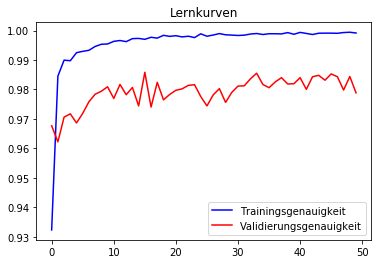

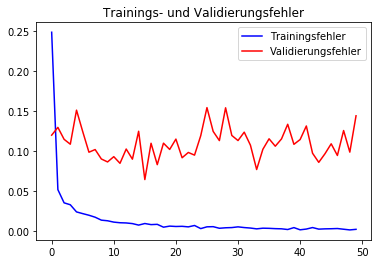

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       1.00      0.93      0.97       450
           4       1.00      0.99      0.99       660
           5       0.87      1.00      0.93       630
           6       1.00      0.71      0.83       150
           7       1.00      0.99      1.00       450
           8       0.97      0.94      0.96       450
           9       0.99      1.00      0.99       480
          10       1.00      0.98      0.99       660
          11       0.98      0.99      0.99       420
          12       1.00      1.00      1.00       690
          13       1.00      1.00      1.00       720
          14       0.99      1.00      0.99       270
          15       0.99      1.00      1.00       210
          16       1.00      0.99      1.00   

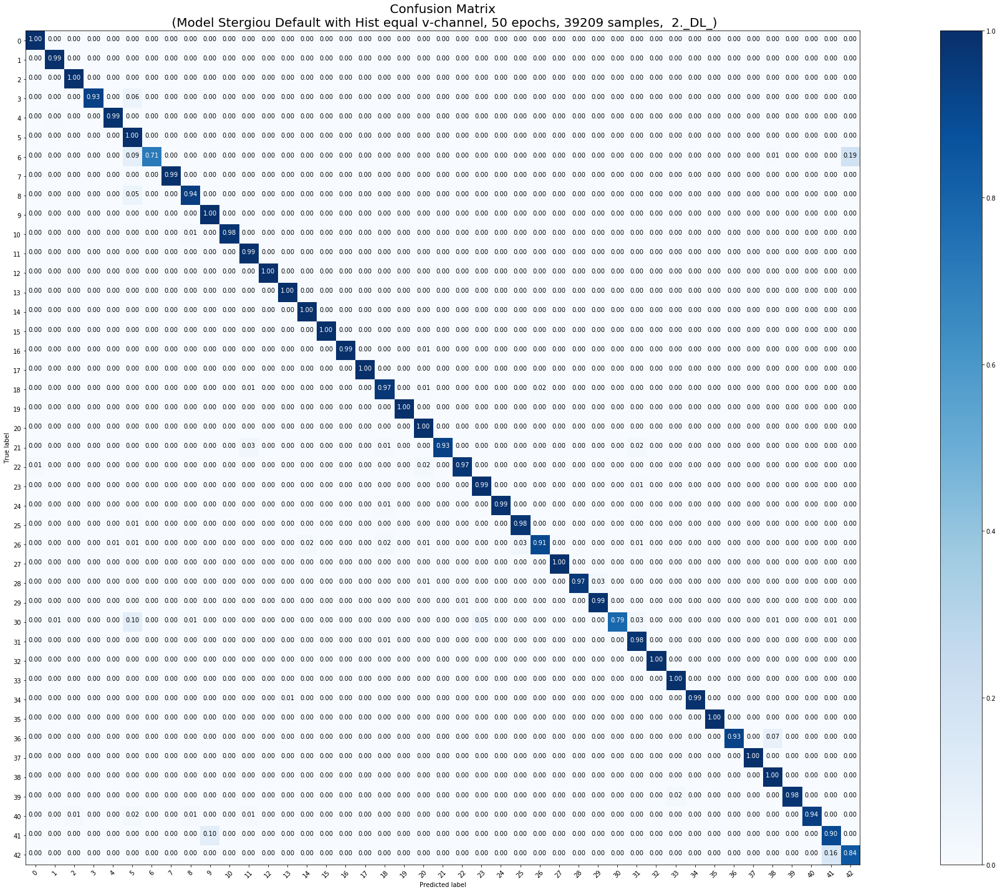

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 25s 627us/step - loss: 0.2422 - acc: 0.9348 - val_loss: 0.1060 - val_acc: 0.9709
Epoch 2/50
39209/39209 [==============================] - 22s 554us/step - loss: 0.0506 - acc: 0.9859 - val_loss: 0.0854 - val_acc: 0.9749
Epoch 3/50
39209/39209 [==============================] - 22s 559us/step - loss: 0.0369 - acc: 0.9892 - val_loss: 0.1090 - val_acc: 0.9686
Epoch 4/50
39209/39209 [==============================] - 23s 575us/step - loss: 0.0309 - acc: 0.9906 - val_loss: 0.1266 - val_acc: 0.9712
Epoch 5/50
39209/39209 [==============================] - 22s 566us/step - loss: 0.0255 - acc: 0.9920 - val_loss: 0.1098 - val_acc: 0.9741
Epoch 6/50
39209/39209

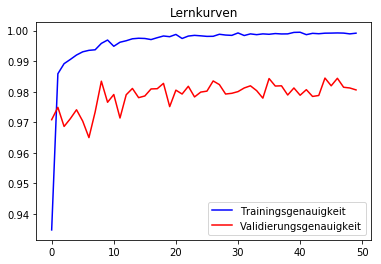

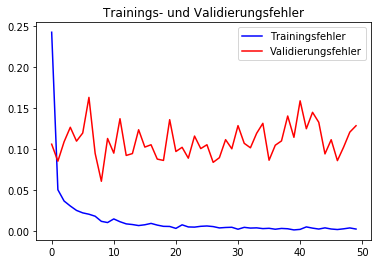

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      1.00      0.98        60
           1       0.97      1.00      0.98       720
           2       1.00      1.00      1.00       750
           3       0.99      0.98      0.98       450
           4       1.00      0.98      0.99       660
           5       0.93      1.00      0.96       630
           6       1.00      0.73      0.84       150
           7       0.99      0.99      0.99       450
           8       0.99      0.96      0.98       450
           9       0.98      1.00      0.99       480
          10       1.00      0.99      1.00       660
          11       0.97      0.95      0.96       420
          12       1.00      1.00      1.00       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      0.99       210
          16       0.99      0.98      0.99   

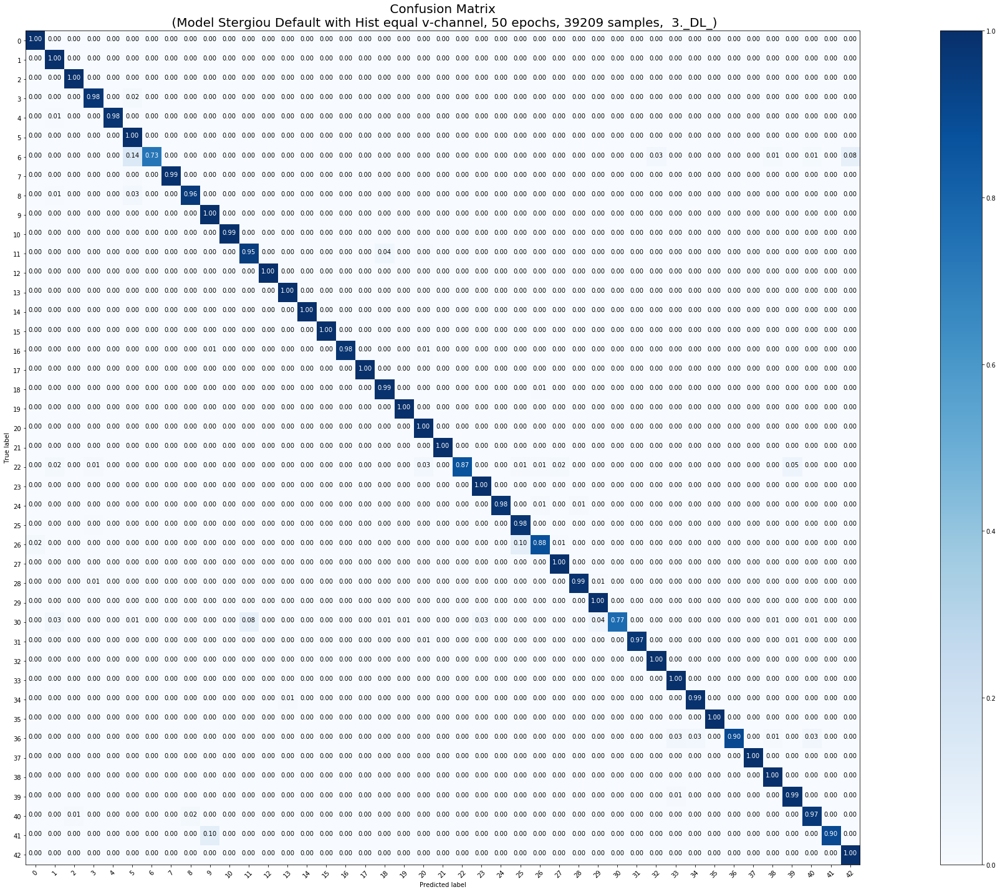

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 26s 652us/step - loss: 0.2487 - acc: 0.9319 - val_loss: 0.1201 - val_acc: 0.9659
Epoch 2/50
39209/39209 [==============================] - 22s 572us/step - loss: 0.0539 - acc: 0.9842 - val_loss: 0.1064 - val_acc: 0.9705
Epoch 3/50
39209/39209 [==============================] - 22s 572us/step - loss: 0.0400 - acc: 0.9881 - val_loss: 0.1184 - val_acc: 0.9702
Epoch 4/50
39209/39209 [==============================] - 23s 579us/step - loss: 0.0295 - acc: 0.9907 - val_loss: 0.1437 - val_acc: 0.9610
Epoch 5/50
39209/39209 [==============================] - 23s 579us/step - loss: 0.0278 - acc: 0.9915 - val_loss: 0.1041 - val_acc: 0.9717
Epoch 6/50
39209/39209

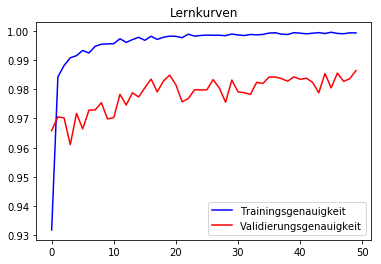

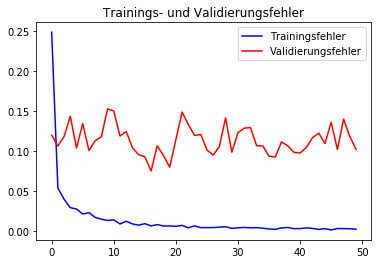

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      1.00      0.99       720
           2       0.99      1.00      1.00       750
           3       0.99      0.98      0.98       450
           4       1.00      0.99      1.00       660
           5       0.93      0.99      0.96       630
           6       1.00      0.76      0.86       150
           7       0.99      0.99      0.99       450
           8       0.98      0.97      0.97       450
           9       1.00      1.00      1.00       480
          10       1.00      0.99      1.00       660
          11       0.99      0.99      0.99       420
          12       1.00      0.99      1.00       690
          13       1.00      1.00      1.00       720
          14       1.00      0.99      1.00       270
          15       0.97      1.00      0.99       210
          16       1.00      0.99      1.00   

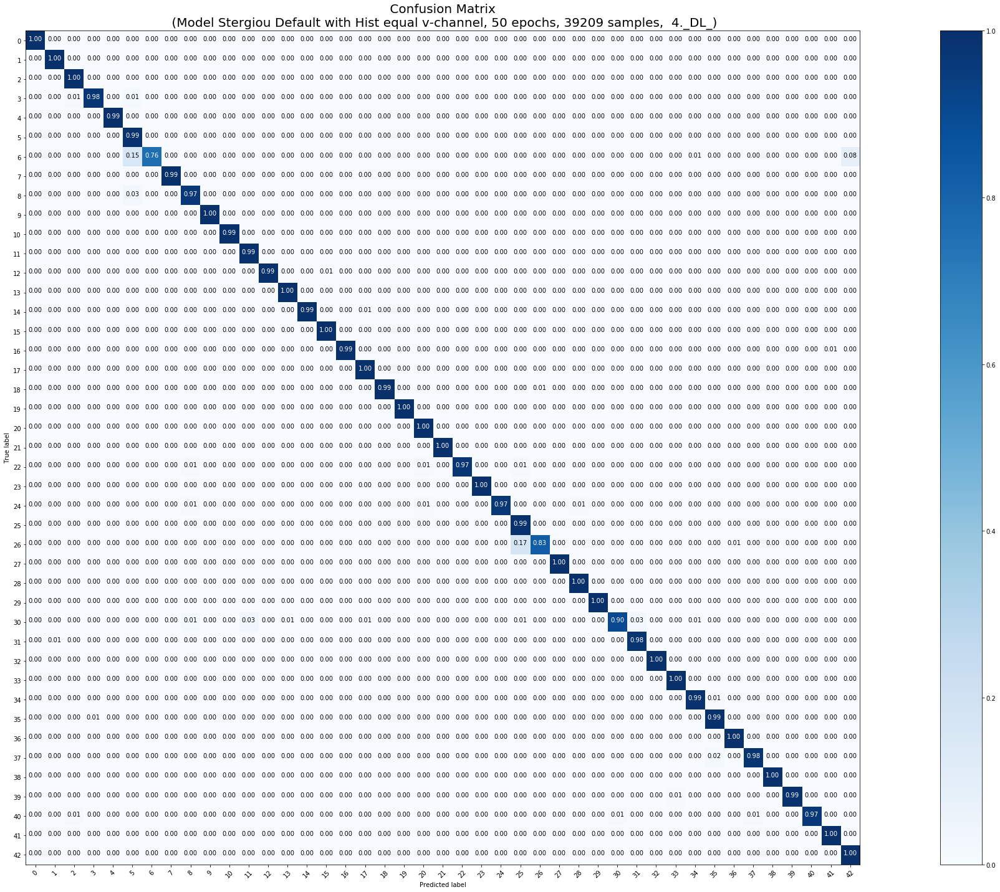

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 26s 660us/step - loss: 0.2504 - acc: 0.9326 - val_loss: 0.1162 - val_acc: 0.9655
Epoch 2/50
39209/39209 [==============================] - 22s 569us/step - loss: 0.0491 - acc: 0.9862 - val_loss: 0.0986 - val_acc: 0.9729
Epoch 3/50
39209/39209 [==============================] - 23s 578us/step - loss: 0.0382 - acc: 0.9885 - val_loss: 0.1472 - val_acc: 0.9601
Epoch 4/50
39209/39209 [==============================] - 23s 581us/step - loss: 0.0305 - acc: 0.9906 - val_loss: 0.1130 - val_acc: 0.9707
Epoch 5/50
39209/39209 [==============================] - 22s 570us/step - loss: 0.0275 - acc: 0.9916 - val_loss: 0.1080 - val_acc: 0.9718
Epoch 6/50
39209/39209

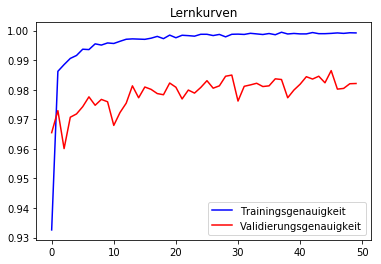

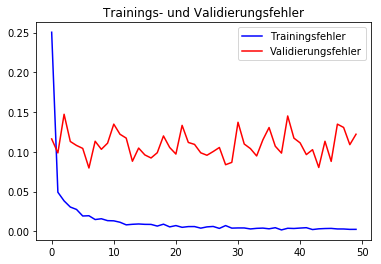

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.98      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       0.99      0.94      0.97       450
           4       1.00      0.98      0.99       660
           5       0.91      1.00      0.95       630
           6       1.00      0.74      0.85       150
           7       0.98      1.00      0.99       450
           8       0.98      0.99      0.98       450
           9       1.00      0.99      0.99       480
          10       1.00      0.99      1.00       660
          11       0.98      1.00      0.99       420
          12       1.00      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       0.99      1.00      1.00       270
          15       0.97      1.00      0.98       210
          16       1.00      0.99      1.00   

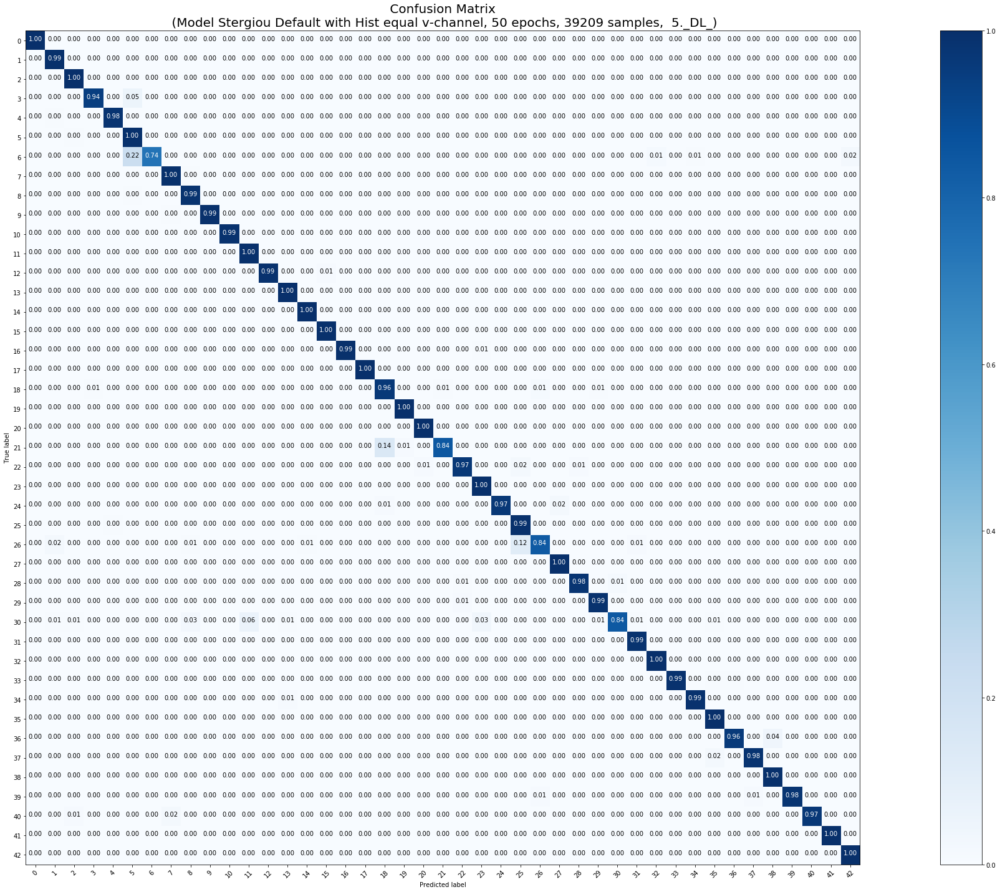

<Figure size 432x288 with 0 Axes>

In [0]:
### 39209, B, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr, y_tr, X_test, y_test, 50, 39209)

In [0]:
downloader_B(39209)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
sparse categorical crossentropy


Training mit Klassengewichten beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 29s 738us/step - loss: 0.3488 - acc: 0.8998 - val_loss: 0.1597 - val_acc: 0.9562
Epoch 2/50
39209/39209 [==============================] - 21s 535us/step - loss: 0.0618 - acc: 0.9788 - val_loss: 0.1806 - val_acc: 0.9538
Epoch 3/50
39209/39209 [==============================] - 21s 538us/step - loss: 0.0471 - acc: 0.9829 - val_loss: 0.2459 - val_acc: 0.9315
Epoch 4/50
39209/39209 [==============================] - 21s 535us/ste

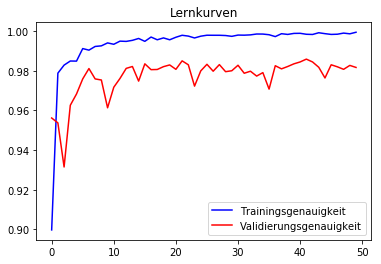

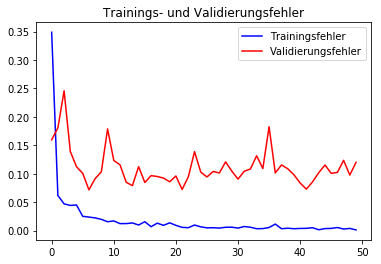

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.98      1.00      0.99       720
           2       0.99      1.00      1.00       750
           3       1.00      0.93      0.96       450
           4       0.99      0.99      0.99       660
           5       0.91      0.99      0.95       630
           6       1.00      0.84      0.91       150
           7       1.00      0.99      0.99       450
           8       0.99      0.97      0.98       450
           9       0.99      1.00      1.00       480
          10       1.00      0.99      1.00       660
          11       0.99      0.99      0.99       420
          12       0.99      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       1.00      0.99      1.00   

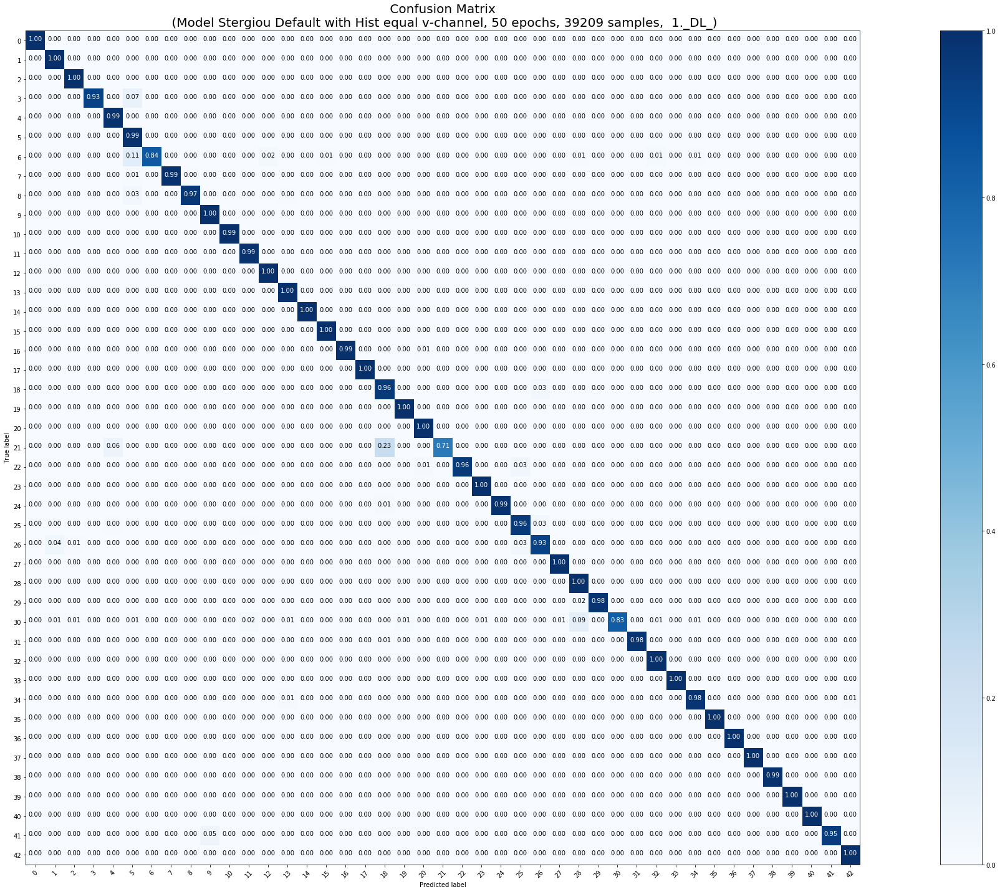

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 23s 586us/step - loss: 0.3614 - acc: 0.8998 - val_loss: 0.2284 - val_acc: 0.9364
Epoch 2/50
39209/39209 [==============================] - 21s 539us/step - loss: 0.0631 - acc: 0.9783 - val_loss: 0.1032 - val_acc: 0.9712
Epoch 3/50
39209/39209 [==============================] - 21s 543us/step - loss: 0.0482 - acc: 0.9833 - val_loss: 0.0936 - val_acc: 0.9740
Epoch 4/50
39209/39209 [==============================] - 21s 544us/step - loss: 0.0359 - acc: 0.9864 - val_loss: 0.1128 - val_acc: 0.9689
Epoch 5/50
39209/39209 [==============================] - 21s 539us/step - loss: 0.0447 - acc: 0.9844 - val_loss: 0.0911 - val_acc: 0.9755
Epoch 6/50
39209

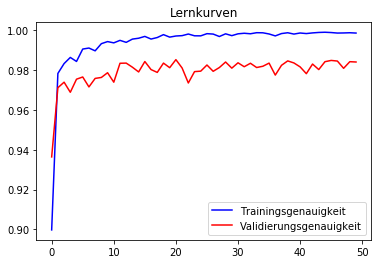

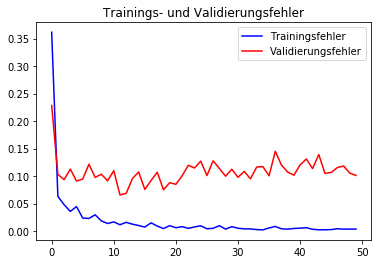

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       1.00      0.99      0.99       720
           2       1.00      1.00      1.00       750
           3       0.99      0.97      0.98       450
           4       1.00      0.99      0.99       660
           5       0.93      0.99      0.96       630
           6       0.99      0.81      0.89       150
           7       0.99      0.99      0.99       450
           8       0.99      0.95      0.97       450
           9       0.99      1.00      1.00       480
          10       1.00      0.99      0.99       660
          11       1.00      0.99      1.00       420
          12       1.00      0.99      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.97      1.00      0.98       210
          16       0.98      0.99      0.99   

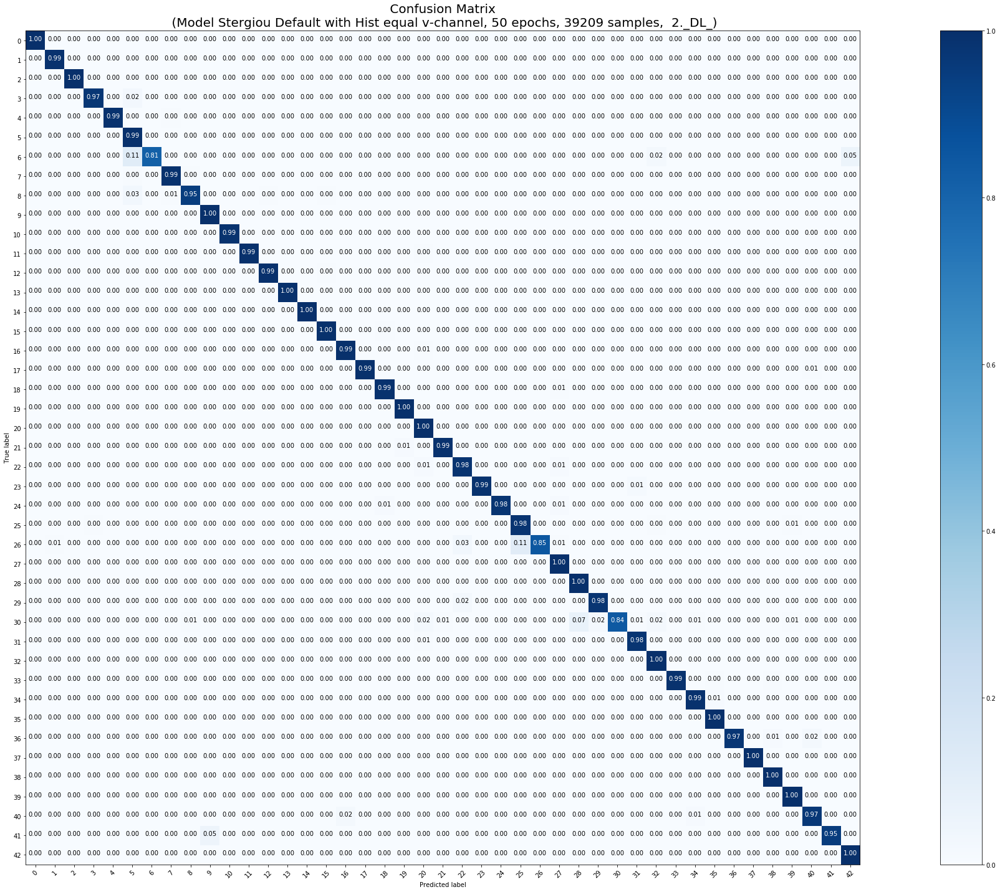

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 23s 593us/step - loss: 0.3550 - acc: 0.9002 - val_loss: 0.1576 - val_acc: 0.9578
Epoch 2/50
39209/39209 [==============================] - 21s 536us/step - loss: 0.0600 - acc: 0.9804 - val_loss: 0.1138 - val_acc: 0.9663
Epoch 3/50
39209/39209 [==============================] - 21s 536us/step - loss: 0.0601 - acc: 0.9801 - val_loss: 0.0882 - val_acc: 0.9743
Epoch 4/50
39209/39209 [==============================] - 21s 538us/step - loss: 0.0296 - acc: 0.9885 - val_loss: 0.1244 - val_acc: 0.9667
Epoch 5/50
39209/39209 [==============================] - 21s 537us/step - loss: 0.0375 - acc: 0.9871 - val_loss: 0.1377 - val_acc: 0.9634
Epoch 6/50
39209

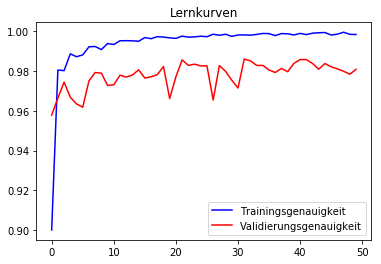

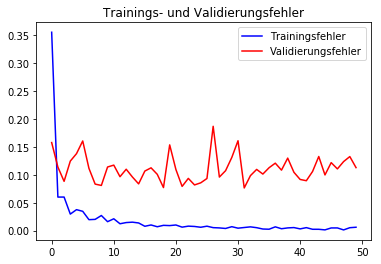

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.91      1.00      0.95        60
           1       0.99      0.98      0.99       720
           2       0.99      1.00      0.99       750
           3       0.99      0.97      0.98       450
           4       1.00      0.98      0.99       660
           5       0.93      0.99      0.96       630
           6       1.00      0.83      0.91       150
           7       1.00      0.98      0.99       450
           8       0.98      0.97      0.97       450
           9       1.00      0.99      1.00       480
          10       1.00      0.99      0.99       660
          11       0.98      0.99      0.98       420
          12       0.99      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      0.99       210
          16       0.99      0.99      0.99   

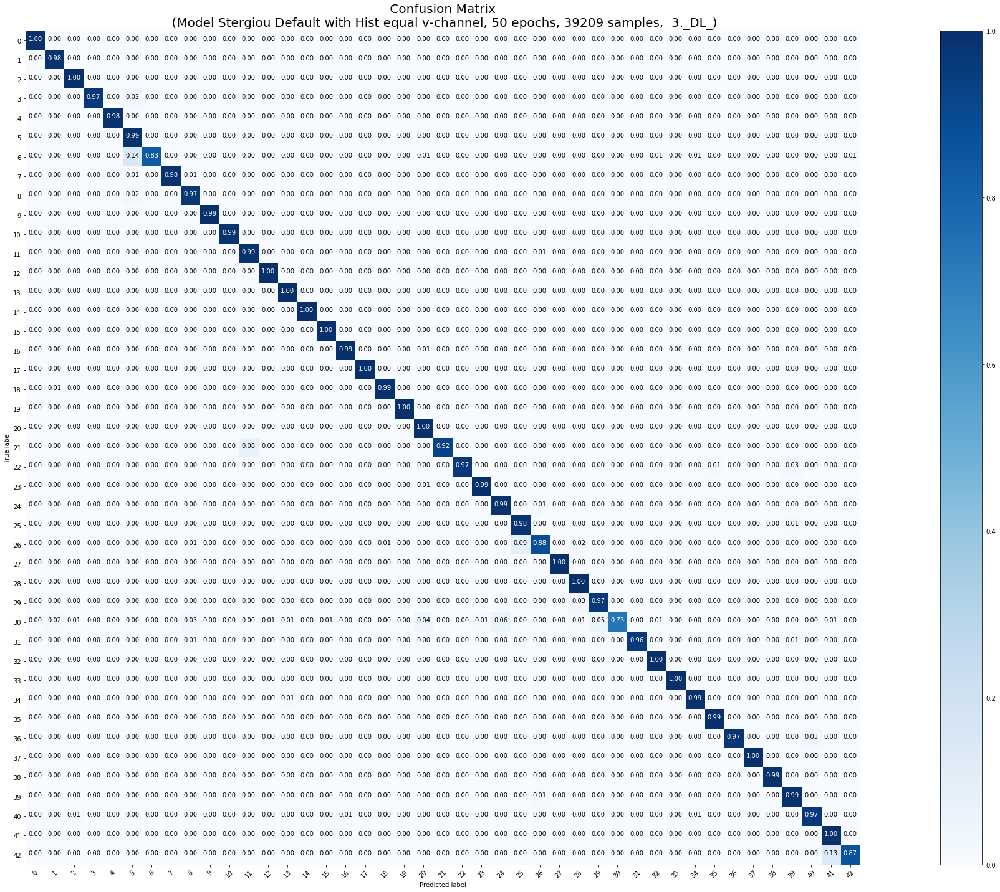

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 24s 611us/step - loss: 0.3565 - acc: 0.8982 - val_loss: 0.1574 - val_acc: 0.9571
Epoch 2/50
39209/39209 [==============================] - 21s 546us/step - loss: 0.0654 - acc: 0.9785 - val_loss: 0.1290 - val_acc: 0.9649
Epoch 3/50
39209/39209 [==============================] - 21s 544us/step - loss: 0.0519 - acc: 0.9827 - val_loss: 0.1866 - val_acc: 0.9479
Epoch 4/50
39209/39209 [==============================] - 22s 549us/step - loss: 0.0456 - acc: 0.9840 - val_loss: 0.1358 - val_acc: 0.9636
Epoch 5/50
39209/39209 [==============================] - 21s 542us/step - loss: 0.0328 - acc: 0.9872 - val_loss: 0.0989 - val_acc: 0.9743
Epoch 6/50
39209

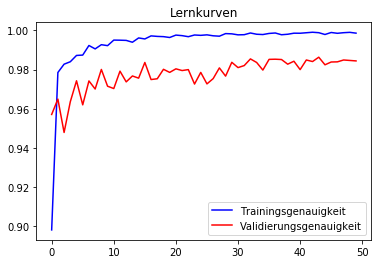

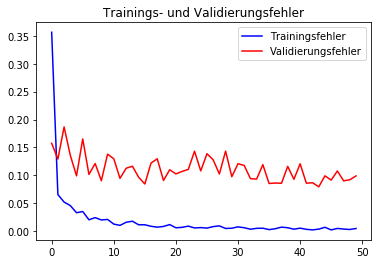

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.98      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       1.00      0.93      0.96       450
           4       1.00      0.99      0.99       660
           5       0.90      1.00      0.95       630
           6       0.98      0.85      0.91       150
           7       1.00      1.00      1.00       450
           8       1.00      0.96      0.98       450
           9       0.98      1.00      0.99       480
          10       1.00      0.98      0.99       660
          11       1.00      0.99      1.00       420
          12       0.99      1.00      1.00       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       1.00      1.00      1.00       210
          16       1.00      0.99      1.00   

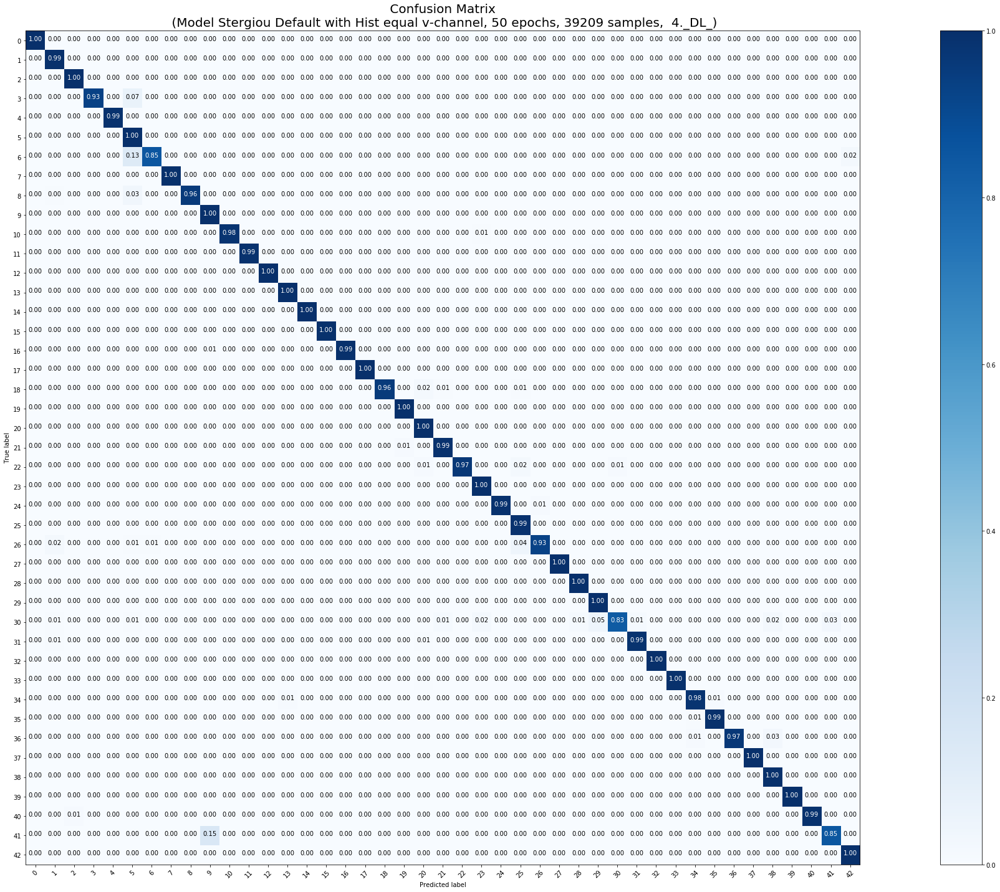

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 24s 620us/step - loss: 0.3476 - acc: 0.9048 - val_loss: 0.1261 - val_acc: 0.9645
Epoch 2/50
39209/39209 [==============================] - 21s 545us/step - loss: 0.0590 - acc: 0.9800 - val_loss: 0.1234 - val_acc: 0.9662
Epoch 3/50
39209/39209 [==============================] - 21s 543us/step - loss: 0.0574 - acc: 0.9811 - val_loss: 0.1361 - val_acc: 0.9671
Epoch 4/50
39209/39209 [==============================] - 21s 544us/step - loss: 0.0389 - acc: 0.9859 - val_loss: 0.1672 - val_acc: 0.9568
Epoch 5/50
39209/39209 [==============================] - 21s 545us/step - loss: 0.0261 - acc: 0.9903 - val_loss: 0.1058 - val_acc: 0.9730
Epoch 6/50
39209

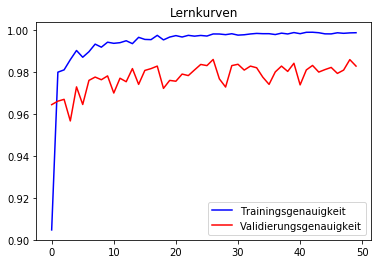

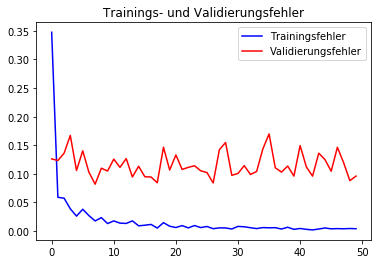

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      1.00      0.99       720
           2       0.99      1.00      0.99       750
           3       0.99      0.96      0.98       450
           4       1.00      0.99      0.99       660
           5       0.93      0.99      0.96       630
           6       1.00      0.88      0.94       150
           7       1.00      0.99      0.99       450
           8       1.00      0.96      0.98       450
           9       1.00      1.00      1.00       480
          10       1.00      0.99      0.99       660
          11       0.96      0.99      0.97       420
          12       1.00      0.98      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.96      1.00      0.98       210
          16       0.99      0.99      0.99   

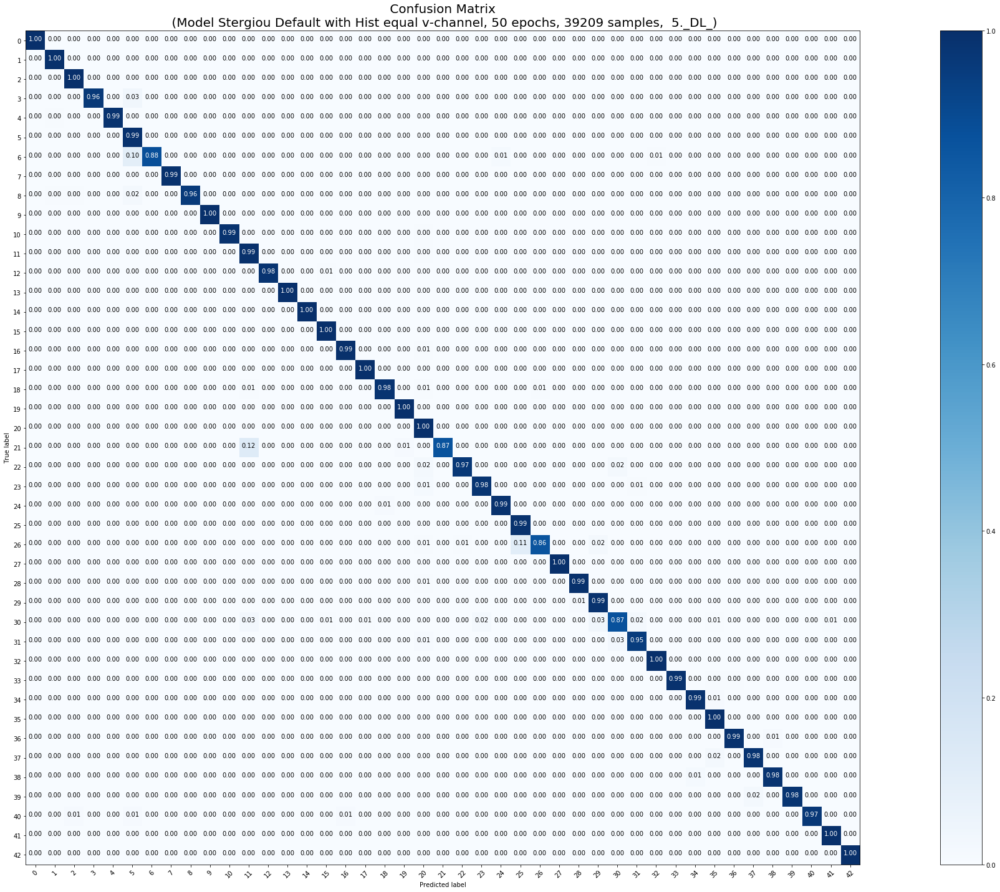

<Figure size 432x288 with 0 Axes>

In [0]:
### 39209, B, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'B', X_tr, y_tr, X_test, y_test, 50, 39209)

In [0]:
downloaderCW_B(39209)

NameError: ignored

In [0]:
def downloaderCW_B(number_trainingdata):
  for i in range(1, 6):
    file_name = str(i)+"._"+str(number_trainingdata)+"_"
    file_name2 = str(i)+"._DL_"+str(number_trainingdata)+"_"
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_acc.png")
    files.download(file_name+"Lernkurve_GTSRB_Stergiou_loss.png")

    files.download(file_name2+"Confusion_matrix.png")
    files.download(file_name2+"Testzeiten.csv")
    files.download(file_name2+"Trainingszeiten.csv")
    files.download(file_name2+"CNN_gtsrb_v_channel_CW_50_EpochenB.hdf5")
    files.download(file_name2+"CNN_gtsrb_v_channel_CW_50_EpochenB_weights.hdf5")
    #files.download(file_name2+"beste_Epoche_full.csv")
    files.download(file_name2+"metrics.csv")
    files.download(file_name2+"precision_recall_fscore.csv")
    files.download(file_name2+"roc_auc_score_single_class.npy")
    files.download(file_name2+"y_pred_label.npy")


In [0]:
##############################################################################################
###   "Beginn Training Split-Mengen C"
###    3. Aufteilung !!!
###    Trainingsdatensätze unterschiedlicher Größe erstellen
##############################################################################################
########################################################################################################
X_tr,y_tr,X_tr_20000,y_tr_20000,X_tr_10000,y_tr_10000,X_tr_5000,y_tr_5000,X_tr_2000,y_tr_2000,X_tr_1000,y_tr_1000,X_tr_500,y_tr_500,X_tr_200,y_tr_200 = make_training_subsets_C(X_train, y_train)


***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Normales Training beginnt










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
categorical crossentropy


Training ohne Klassengewichte beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 10s 20ms/step - loss: 3.3277 - acc: 0.2560 - val_loss: 2.3123 - val_acc: 0.4524
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.3355 - acc: 0.6220 - val_loss: 2.5124 - val_acc: 0.5241
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.7416 - acc: 0.7640 - val_loss: 0.9869 - val_acc: 0.7207
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.3659 - acc: 0.8840 - val

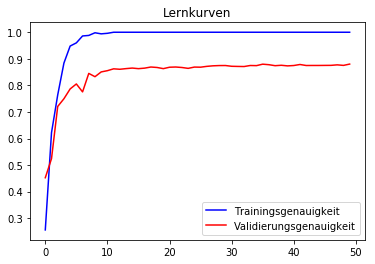

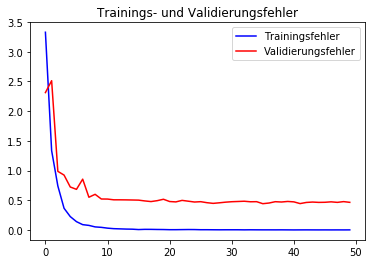

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.94      0.82      0.87        60
           1       0.91      0.94      0.92       720
           2       0.91      0.93      0.92       750
           3       0.82      0.91      0.86       450
           4       0.94      0.94      0.94       660
           5       0.82      0.70      0.75       630
           6       0.96      0.63      0.76       150
           7       0.79      0.70      0.74       450
           8       0.74      0.83      0.78       450
           9       0.91      0.97      0.94       480
          10       0.96      0.97      0.97       660
          11       0.79      0.68      0.73       420
          12       0.98      0.99      0.98       690
          13       0.96      1.00      0.98       720
          14       1.00      0.95      0.97       270
          15       0.93      0.99      0.96       210
          16       0.99      0.93      0.96   

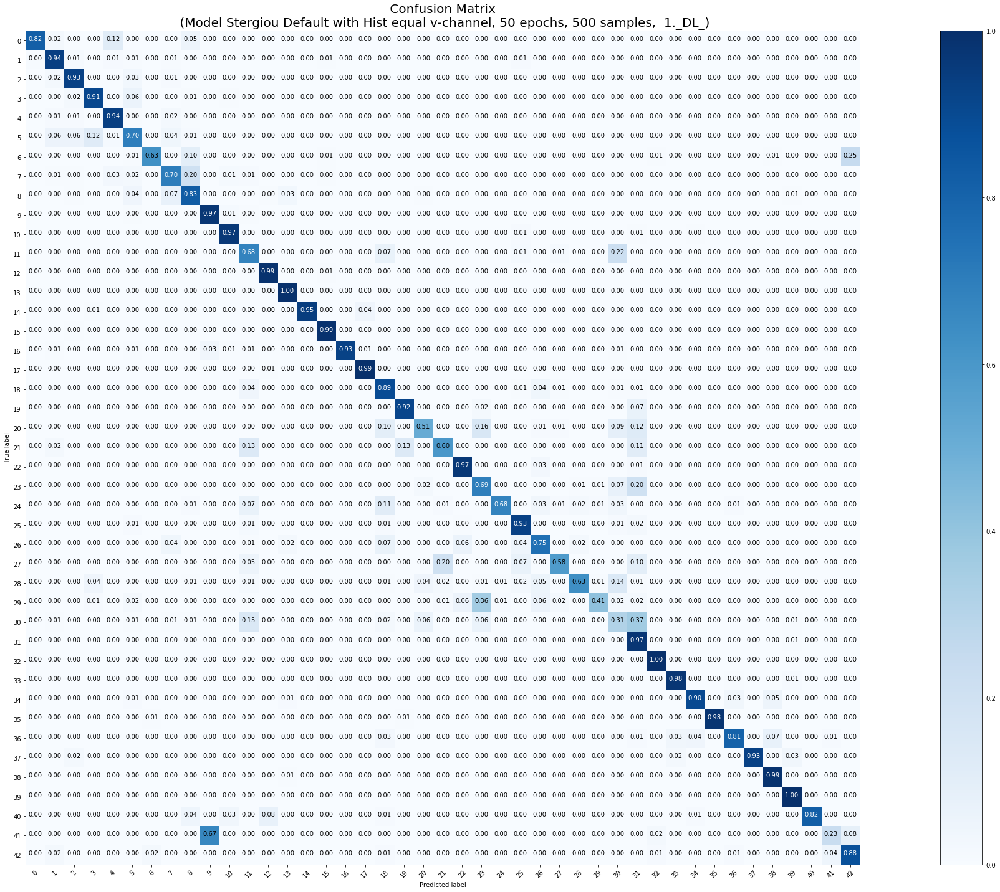

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 4s 7ms/step - loss: 3.6019 - acc: 0.2140 - val_loss: 2.5554 - val_acc: 0.4356
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.6422 - acc: 0.5460 - val_loss: 1.7161 - val_acc: 0.5656
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.9578 - acc: 0.7240 - val_loss: 1.2820 - val_acc: 0.6789
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.5993 - acc: 0.8300 - val_loss: 0.9338 - val_acc: 0.7255
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.3625 - acc: 0.8960 - val_loss: 0.8802 - val_acc: 0.7451
Epoch 6/50
500/500 [==============================] - 2s 4ms/

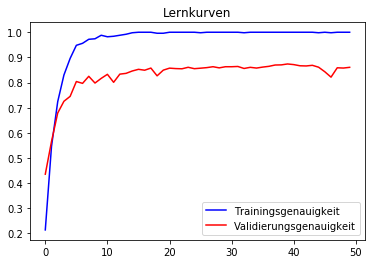

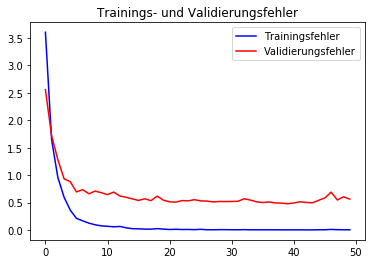

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.96      0.43      0.60        60
           1       0.94      0.93      0.93       720
           2       0.94      0.94      0.94       750
           3       0.77      0.94      0.85       450
           4       0.94      0.93      0.94       660
           5       0.81      0.68      0.74       630
           6       0.98      0.61      0.75       150
           7       0.74      0.70      0.72       450
           8       0.74      0.84      0.79       450
           9       0.89      0.95      0.92       480
          10       0.90      0.95      0.93       660
          11       0.76      0.71      0.74       420
          12       0.97      0.96      0.97       690
          13       0.97      0.99      0.98       720
          14       1.00      0.99      0.99       270
          15       0.79      1.00      0.88       210
          16       1.00      0.91      0.95   

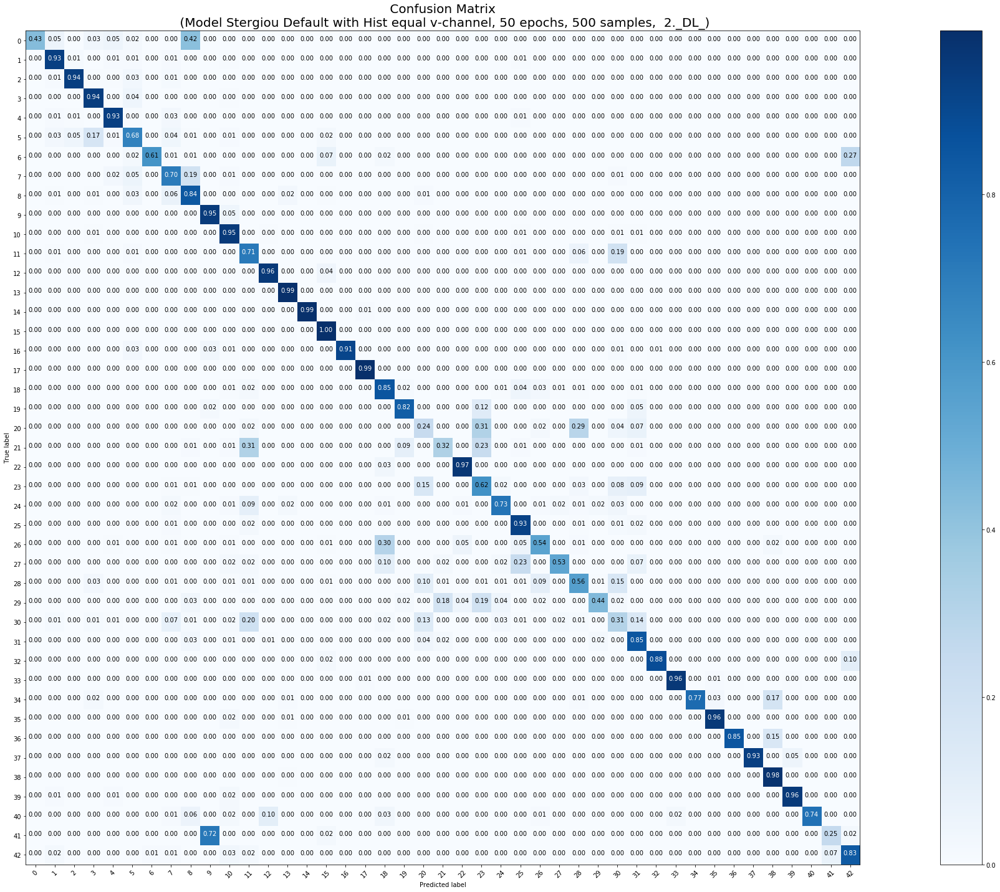

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 4s 8ms/step - loss: 3.3474 - acc: 0.2580 - val_loss: 2.2794 - val_acc: 0.4315
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.5854 - acc: 0.5820 - val_loss: 1.5457 - val_acc: 0.5982
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.8839 - acc: 0.7400 - val_loss: 1.1915 - val_acc: 0.6808
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4183 - acc: 0.8900 - val_loss: 0.9150 - val_acc: 0.7258
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2532 - acc: 0.9380 - val_loss: 0.8053 - val_acc: 0.7705
Epoch 6/50
500/500 [==============================] - 2s 4ms/

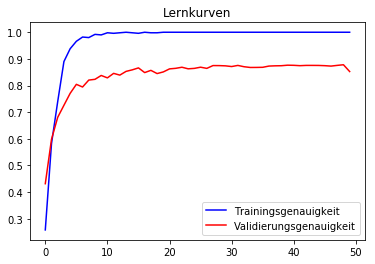

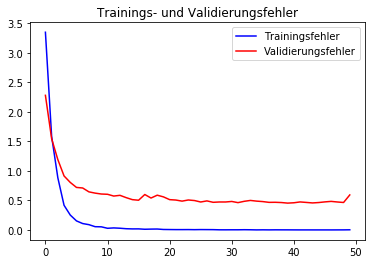

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.76      0.27      0.40        60
           1       0.98      0.81      0.88       720
           2       0.90      0.92      0.91       750
           3       0.75      0.95      0.84       450
           4       0.74      0.95      0.83       660
           5       0.80      0.63      0.71       630
           6       0.93      0.62      0.74       150
           7       0.84      0.74      0.79       450
           8       0.81      0.75      0.78       450
           9       0.94      0.97      0.95       480
          10       0.91      0.97      0.94       660
          11       0.85      0.83      0.84       420
          12       0.98      0.92      0.95       690
          13       0.92      1.00      0.96       720
          14       1.00      0.97      0.98       270
          15       0.60      0.99      0.75       210
          16       1.00      0.87      0.93   

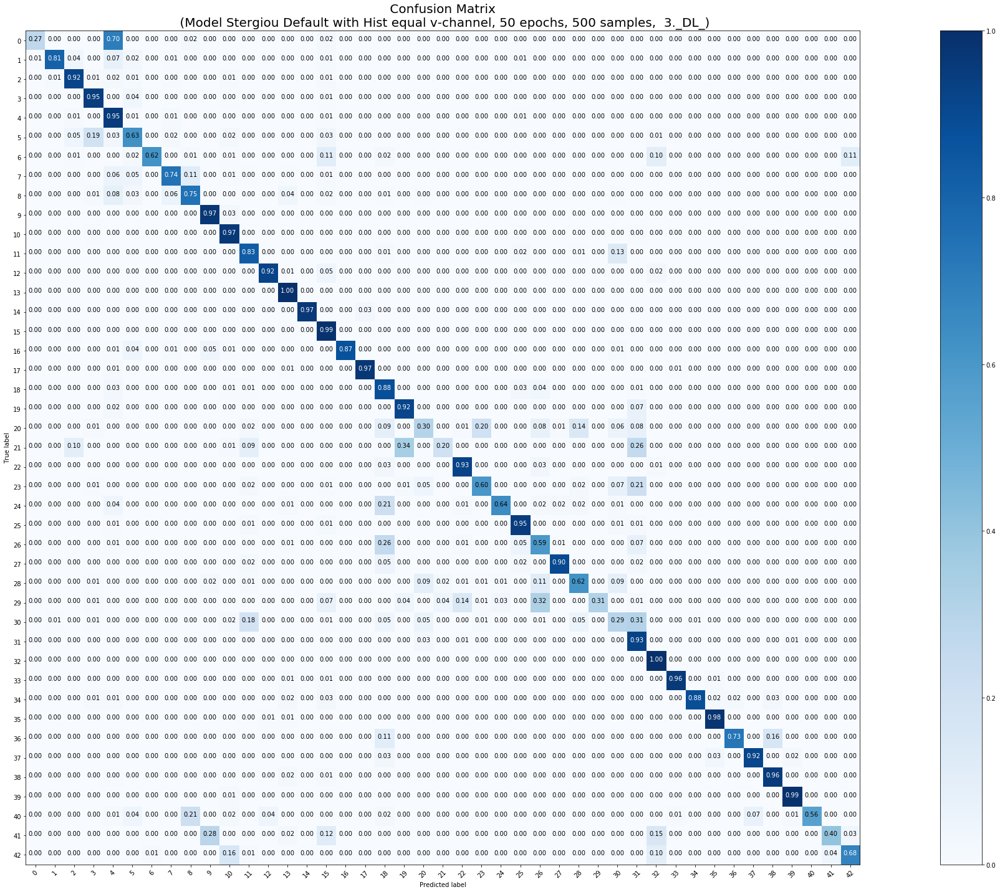

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 4s 9ms/step - loss: 3.4556 - acc: 0.2300 - val_loss: 2.2158 - val_acc: 0.4305
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.6051 - acc: 0.5580 - val_loss: 1.7688 - val_acc: 0.5641
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.8941 - acc: 0.7500 - val_loss: 1.2893 - val_acc: 0.6707
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4065 - acc: 0.8900 - val_loss: 0.8409 - val_acc: 0.7579
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.3033 - acc: 0.9140 - val_loss: 0.9339 - val_acc: 0.7561
Epoch 6/50
500/500 [==============================] - 2s 4ms/

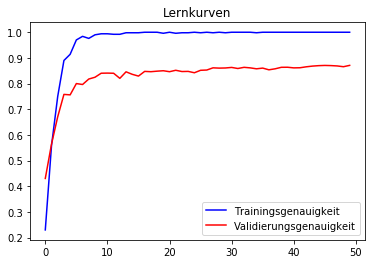

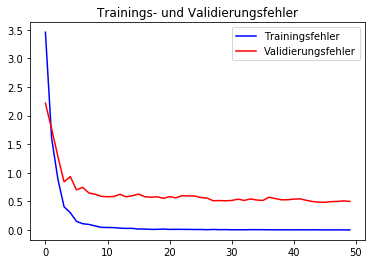

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.79      0.45      0.57        60
           1       0.96      0.88      0.92       720
           2       0.95      0.92      0.94       750
           3       0.91      0.83      0.87       450
           4       0.90      0.91      0.90       660
           5       0.74      0.87      0.80       630
           6       0.94      0.61      0.74       150
           7       0.78      0.74      0.76       450
           8       0.75      0.84      0.79       450
           9       0.91      0.97      0.94       480
          10       0.91      0.97      0.94       660
          11       0.77      0.74      0.75       420
          12       0.98      0.96      0.97       690
          13       0.97      1.00      0.98       720
          14       1.00      0.95      0.98       270
          15       0.86      0.99      0.92       210
          16       0.99      0.93      0.96   

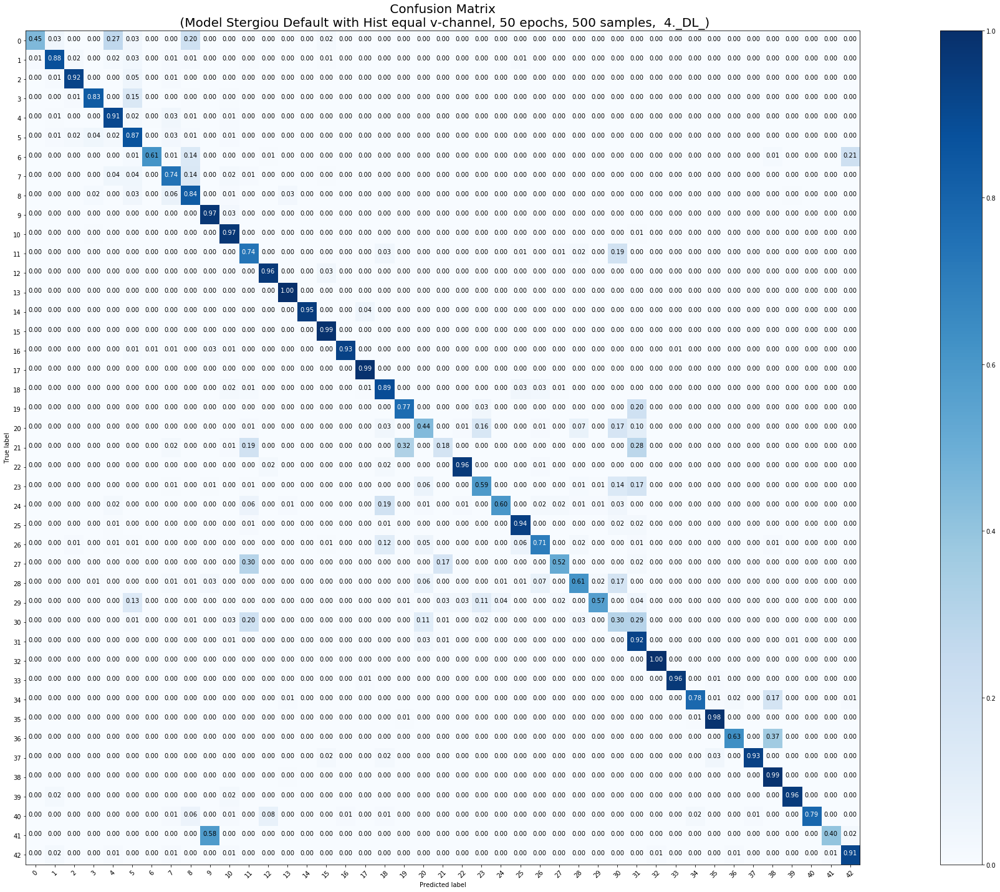

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 5s 10ms/step - loss: 3.3397 - acc: 0.2400 - val_loss: 2.8327 - val_acc: 0.4116
Epoch 2/50
500/500 [==============================] - 2s 4ms/step - loss: 1.6251 - acc: 0.5640 - val_loss: 1.7907 - val_acc: 0.5869
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 0.8366 - acc: 0.7720 - val_loss: 1.0458 - val_acc: 0.7124
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.4420 - acc: 0.8720 - val_loss: 0.9379 - val_acc: 0.7489
Epoch 5/50
500/500 [==============================] - 2s 4ms/step - loss: 0.2631 - acc: 0.9440 - val_loss: 0.7997 - val_acc: 0.7755
Epoch 6/50
500/500 [==============================] - 2s 4ms

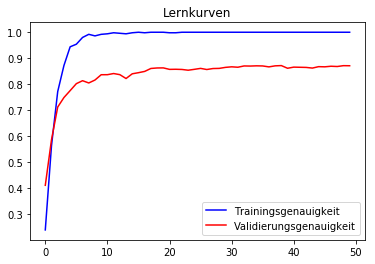

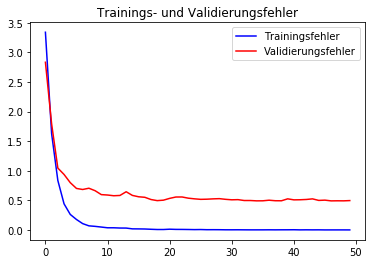

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      0.58      0.72        60
           1       0.94      0.92      0.93       720
           2       0.92      0.91      0.92       750
           3       0.89      0.88      0.88       450
           4       0.92      0.93      0.92       660
           5       0.80      0.82      0.81       630
           6       0.92      0.64      0.76       150
           7       0.79      0.79      0.79       450
           8       0.80      0.85      0.83       450
           9       0.88      0.96      0.92       480
          10       0.91      0.97      0.94       660
          11       0.82      0.70      0.76       420
          12       0.99      0.96      0.98       690
          13       0.97      1.00      0.98       720
          14       0.99      0.94      0.97       270
          15       0.85      0.99      0.92       210
          16       1.00      0.90      0.95   

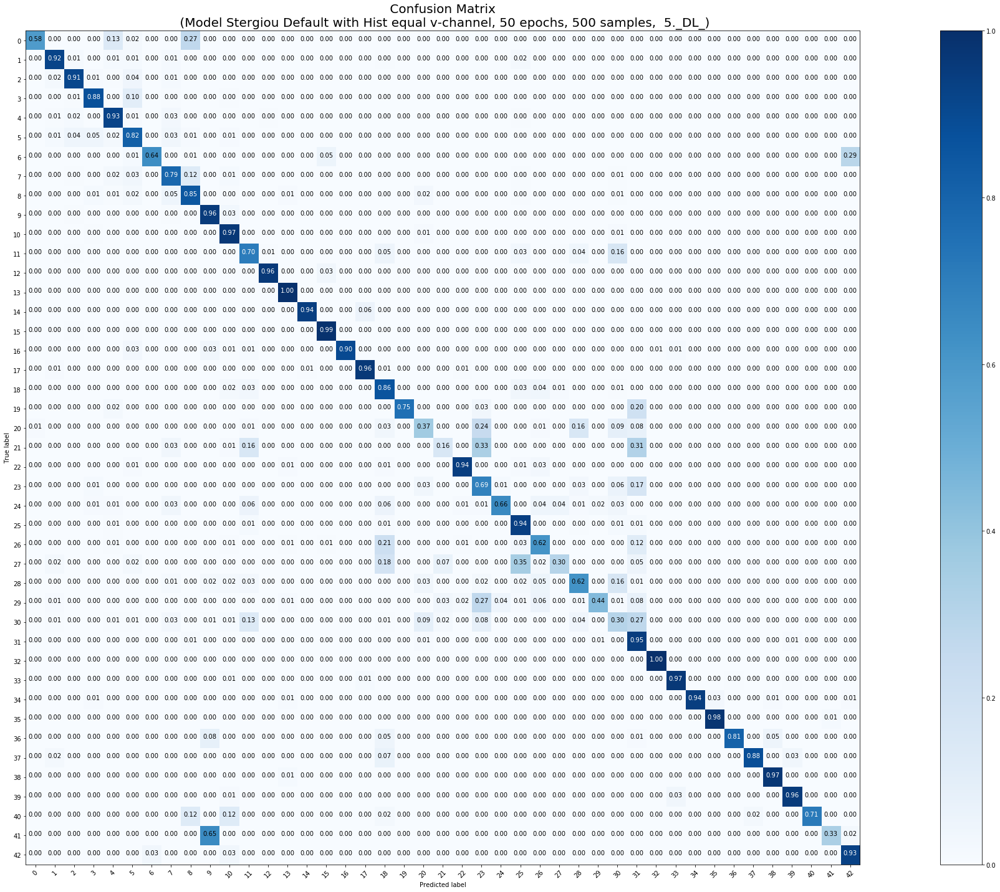

<Figure size 432x288 with 0 Axes>

In [0]:
### 500, C, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_500, y_tr_500, X_test, y_test, 50, 500)

In [0]:
downloader_C(500)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
sparse categorical crossentropy


Training mit Klassengewichten beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 11s 21ms/step - loss: 3.9183 - acc: 0.1360 - val_loss: 2.7100 - val_acc: 0.3314
Epoch 2/50
500/500 [==============================] - 2s 5ms/step - loss: 2.0210 - acc: 0.3960 - val_loss: 2.0658 - val_acc: 0.4867
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 1.0903 - acc: 0.6020 - val_loss: 1.3239 - val_acc: 0.6238
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.6269 - acc: 0.7660

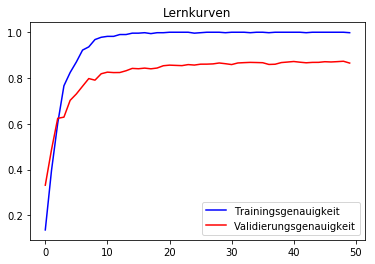

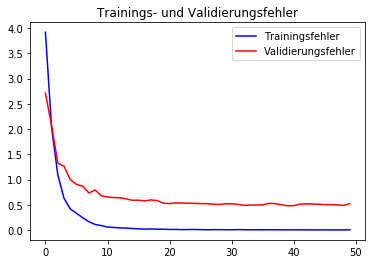

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.35      0.52        60
           1       0.92      0.92      0.92       720
           2       0.92      0.91      0.91       750
           3       0.86      0.87      0.86       450
           4       0.93      0.92      0.92       660
           5       0.83      0.82      0.82       630
           6       0.86      0.63      0.73       150
           7       0.70      0.56      0.62       450
           8       0.58      0.85      0.69       450
           9       0.91      0.96      0.93       480
          10       0.92      0.96      0.94       660
          11       0.80      0.67      0.73       420
          12       0.98      0.96      0.97       690
          13       0.97      1.00      0.99       720
          14       0.99      0.96      0.98       270
          15       0.87      1.00      0.93       210
          16       1.00      0.91      0.95   

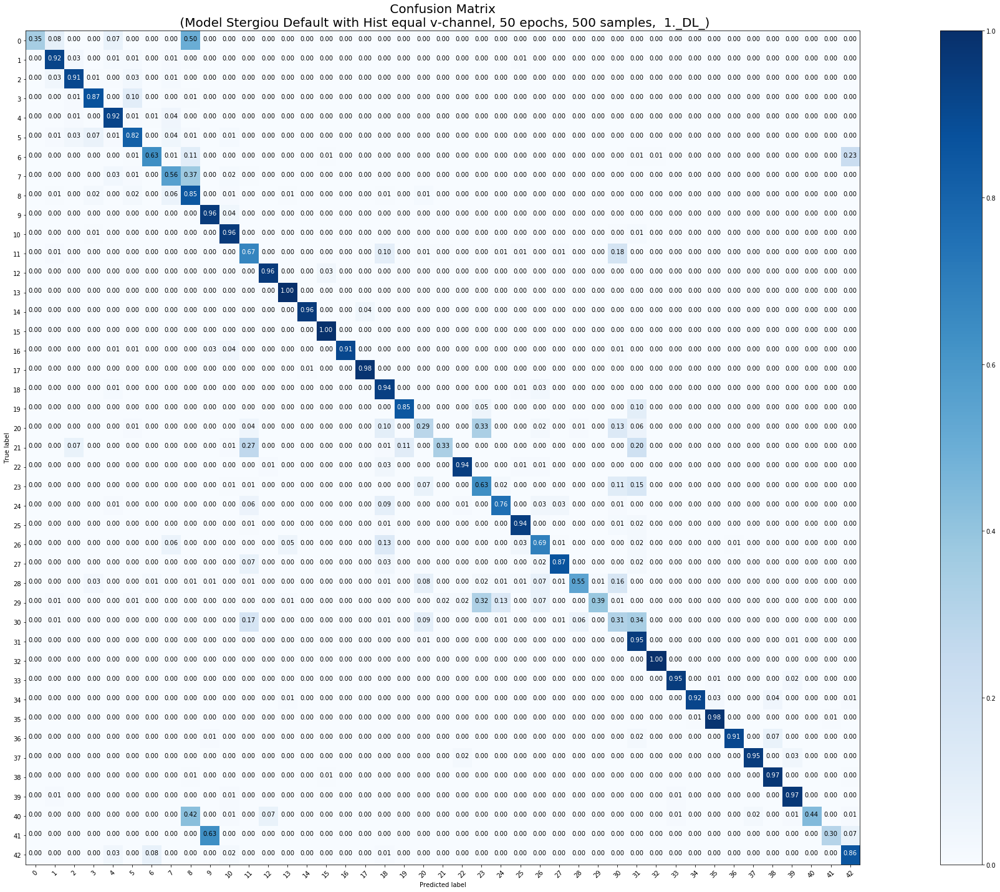

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 4s 9ms/step - loss: 3.9926 - acc: 0.1140 - val_loss: 3.2099 - val_acc: 0.2173
Epoch 2/50
500/500 [==============================] - 2s 5ms/step - loss: 2.2815 - acc: 0.3660 - val_loss: 2.0966 - val_acc: 0.4564
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 1.1423 - acc: 0.6100 - val_loss: 1.8156 - val_acc: 0.4807
Epoch 4/50
500/500 [==============================] - 2s 5ms/step - loss: 0.6620 - acc: 0.7260 - val_loss: 1.2114 - val_acc: 0.6514
Epoch 5/50
500/500 [==============================] - 2s 5ms/step - loss: 0.4176 - acc: 0.8480 - val_loss: 0.9726 - val_acc: 0.7277
Epoch 6/50
500/500 [==============================] - 2

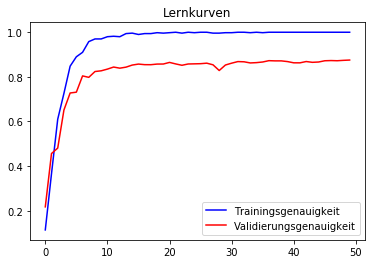

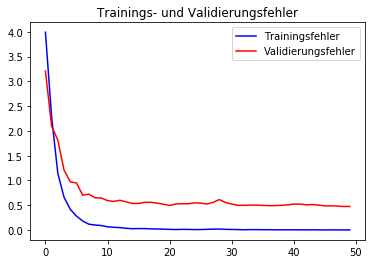

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.90      0.47      0.62        60
           1       0.95      0.91      0.93       720
           2       0.92      0.93      0.92       750
           3       0.85      0.89      0.87       450
           4       0.94      0.93      0.94       660
           5       0.78      0.79      0.78       630
           6       0.98      0.65      0.78       150
           7       0.81      0.75      0.78       450
           8       0.76      0.84      0.80       450
           9       0.89      0.96      0.92       480
          10       0.94      0.96      0.95       660
          11       0.80      0.68      0.73       420
          12       0.98      0.96      0.97       690
          13       0.95      0.99      0.97       720
          14       1.00      0.97      0.99       270
          15       0.85      1.00      0.92       210
          16       1.00      0.92      0.96   

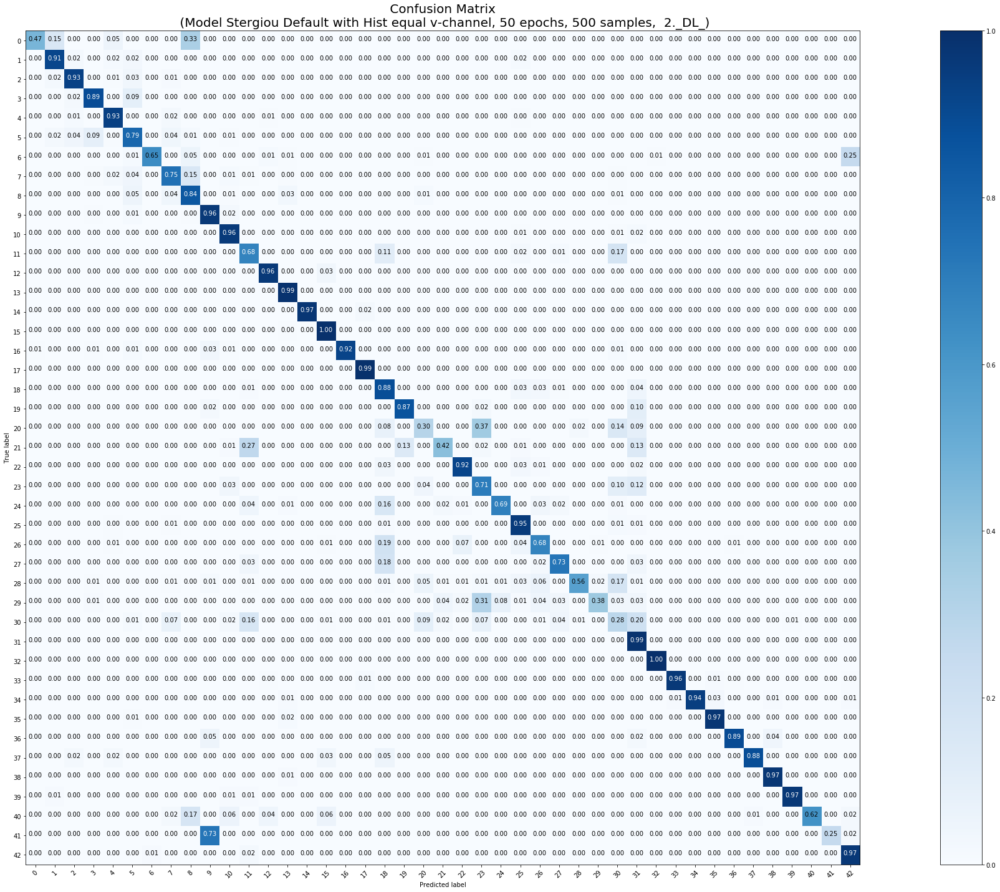

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 5s 10ms/step - loss: 4.0237 - acc: 0.1320 - val_loss: 3.0842 - val_acc: 0.2763
Epoch 2/50
500/500 [==============================] - 2s 5ms/step - loss: 2.0097 - acc: 0.3980 - val_loss: 2.9831 - val_acc: 0.3717
Epoch 3/50
500/500 [==============================] - 2s 5ms/step - loss: 1.2919 - acc: 0.5780 - val_loss: 1.9642 - val_acc: 0.4843
Epoch 4/50
500/500 [==============================] - 2s 4ms/step - loss: 0.7863 - acc: 0.7100 - val_loss: 1.3457 - val_acc: 0.6566
Epoch 5/50
500/500 [==============================] - 2s 5ms/step - loss: 0.4565 - acc: 0.8160 - val_loss: 1.2138 - val_acc: 0.6779
Epoch 6/50
500/500 [==============================] - 

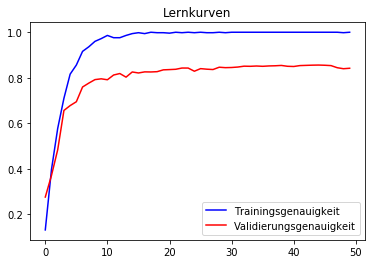

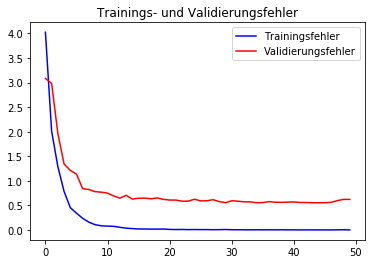

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.59      0.45      0.51        60
           1       0.95      0.86      0.90       720
           2       0.92      0.89      0.90       750
           3       0.87      0.85      0.86       450
           4       0.94      0.85      0.89       660
           5       0.68      0.78      0.73       630
           6       0.93      0.61      0.74       150
           7       0.63      0.77      0.69       450
           8       0.72      0.76      0.74       450
           9       0.88      0.94      0.90       480
          10       0.89      0.93      0.91       660
          11       0.80      0.77      0.78       420
          12       0.99      0.95      0.97       690
          13       0.96      0.98      0.97       720
          14       1.00      0.93      0.96       270
          15       0.87      0.94      0.90       210
          16       0.93      0.93      0.93   

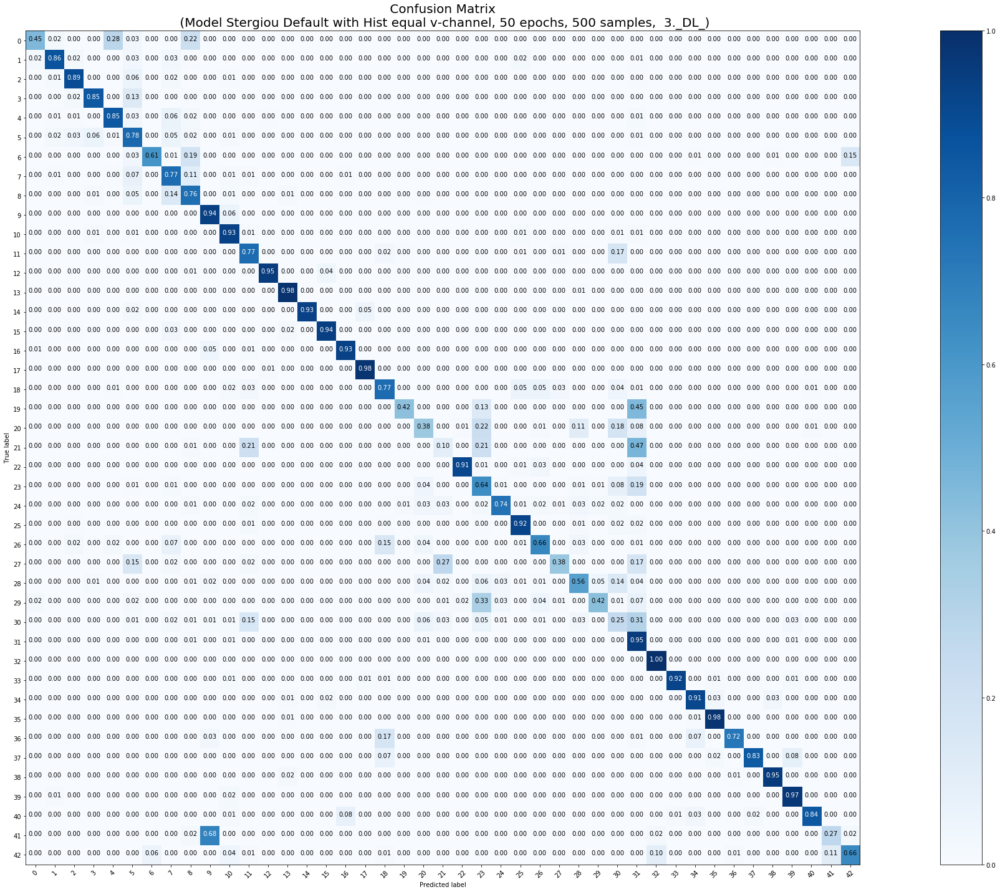

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 5s 11ms/step - loss: 4.0642 - acc: 0.1280 - val_loss: 3.4398 - val_acc: 0.2155
Epoch 2/50
500/500 [==============================] - 2s 5ms/step - loss: 2.0222 - acc: 0.4180 - val_loss: 2.0145 - val_acc: 0.4865
Epoch 3/50
500/500 [==============================] - 2s 5ms/step - loss: 1.1473 - acc: 0.6160 - val_loss: 1.6728 - val_acc: 0.5546
Epoch 4/50
500/500 [==============================] - 2s 5ms/step - loss: 0.8431 - acc: 0.7020 - val_loss: 1.4254 - val_acc: 0.6090
Epoch 5/50
500/500 [==============================] - 2s 5ms/step - loss: 0.4791 - acc: 0.7880 - val_loss: 1.2387 - val_acc: 0.6375
Epoch 6/50
500/500 [==============================] - 

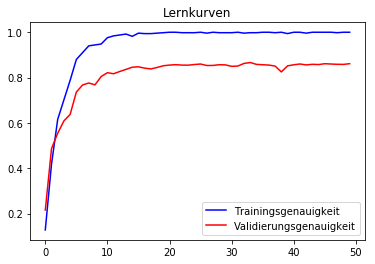

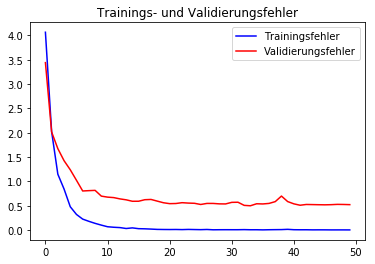

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.38      0.55        60
           1       0.94      0.90      0.92       720
           2       0.91      0.92      0.91       750
           3       0.87      0.92      0.89       450
           4       0.93      0.93      0.93       660
           5       0.77      0.77      0.77       630
           6       0.90      0.62      0.74       150
           7       0.70      0.76      0.73       450
           8       0.78      0.82      0.80       450
           9       0.89      0.96      0.92       480
          10       0.93      0.95      0.94       660
          11       0.80      0.64      0.71       420
          12       0.97      0.96      0.97       690
          13       0.95      0.97      0.96       720
          14       1.00      0.95      0.97       270
          15       0.84      1.00      0.91       210
          16       0.99      0.93      0.96   

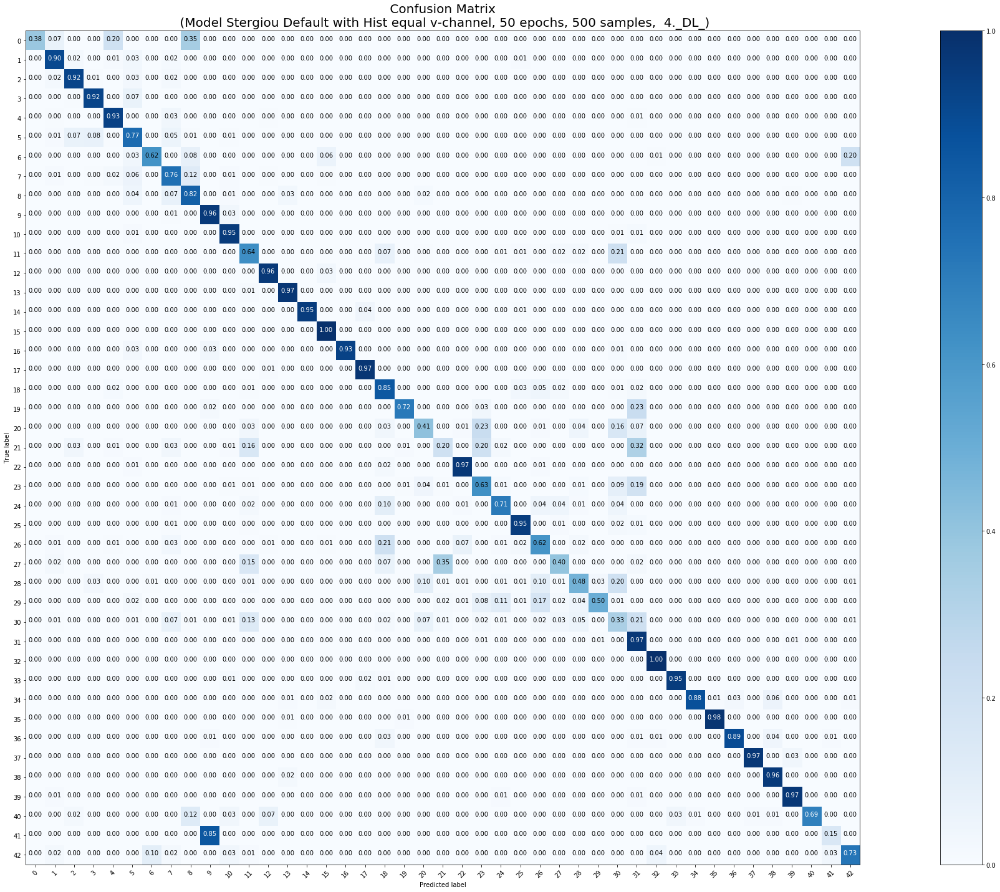

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 500 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 500 samples, validate on 12630 samples
Epoch 1/50
500/500 [==============================] - 6s 11ms/step - loss: 3.8120 - acc: 0.1620 - val_loss: 3.3114 - val_acc: 0.2279
Epoch 2/50
500/500 [==============================] - 2s 5ms/step - loss: 2.0168 - acc: 0.4200 - val_loss: 2.0296 - val_acc: 0.4789
Epoch 3/50
500/500 [==============================] - 2s 4ms/step - loss: 1.0296 - acc: 0.6260 - val_loss: 1.9156 - val_acc: 0.5232
Epoch 4/50
500/500 [==============================] - 2s 5ms/step - loss: 0.6700 - acc: 0.7480 - val_loss: 1.1450 - val_acc: 0.6537
Epoch 5/50
500/500 [==============================] - 2s 5ms/step - loss: 0.4024 - acc: 0.8420 - val_loss: 1.2041 - val_acc: 0.6690
Epoch 6/50
500/500 [==============================] - 

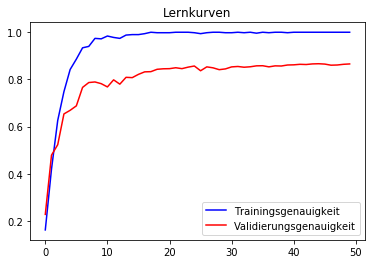

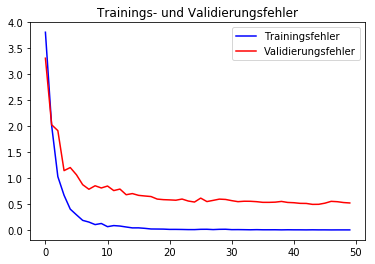

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.92      0.78      0.85        60
           1       0.93      0.90      0.91       720
           2       0.94      0.89      0.92       750
           3       0.83      0.88      0.86       450
           4       0.95      0.88      0.91       660
           5       0.74      0.80      0.77       630
           6       0.93      0.63      0.75       150
           7       0.74      0.81      0.77       450
           8       0.84      0.80      0.82       450
           9       0.89      0.98      0.93       480
          10       0.94      0.96      0.95       660
          11       0.86      0.69      0.76       420
          12       0.98      0.96      0.97       690
          13       0.97      1.00      0.98       720
          14       0.99      0.98      0.99       270
          15       0.81      0.99      0.89       210
          16       0.99      0.94      0.97   

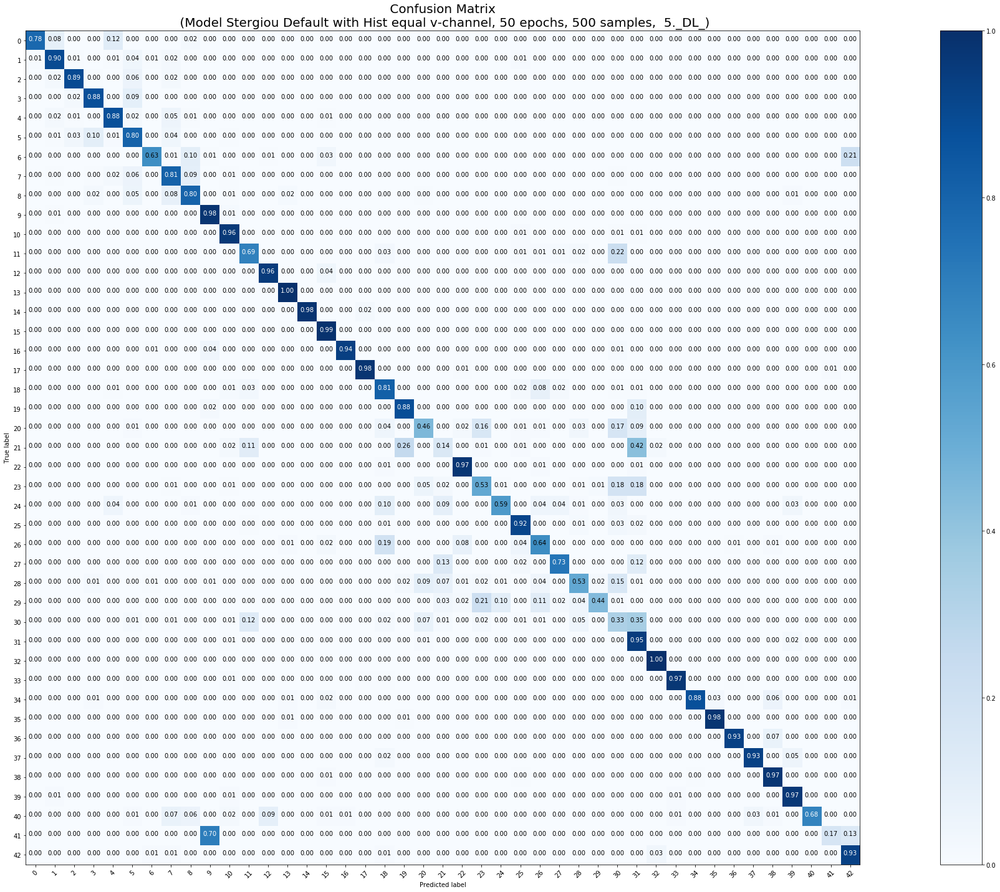

<Figure size 432x288 with 0 Axes>

In [0]:
### 500, C, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_500, y_tr_500, X_test, y_test, 50, 500)

In [0]:
downloaderCW_C(500)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 6s 6ms/step - loss: 2.6481 - acc: 0.3680 - val_loss: 1.5569 - val_acc: 0.5851
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.9558 - acc: 0.7170 - val_loss: 0.7064 - val_acc: 0.7861
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.4852 - acc: 0.8620 - val_loss: 0.6051 - val_acc: 0.8291
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2752 - acc: 0.9180 - val_loss: 0.4665 - val_acc: 0.8656
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1594 - acc: 0.9600 - val_loss: 0.4579 - val_acc: 0.8672
Epoch 6/50
1000/1000 [===========================

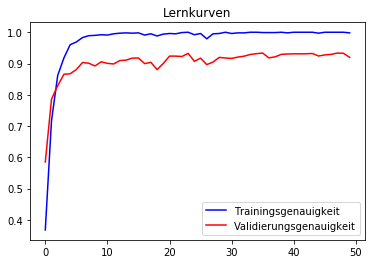

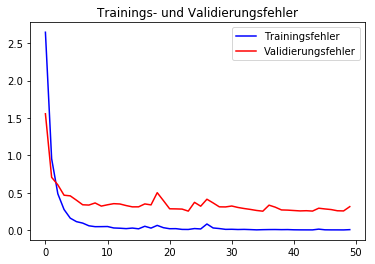

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.94      0.96      0.95       720
           2       0.95      0.93      0.94       750
           3       0.68      0.99      0.81       450
           4       0.99      0.94      0.96       660
           5       0.94      0.78      0.85       630
           6       0.99      0.61      0.75       150
           7       0.96      0.88      0.92       450
           8       0.88      0.90      0.89       450
           9       0.94      0.97      0.96       480
          10       0.90      0.98      0.94       660
          11       0.87      0.91      0.89       420
          12       1.00      0.96      0.98       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.89      0.98      0.93       210
          16       0.86      0.98      0.92   

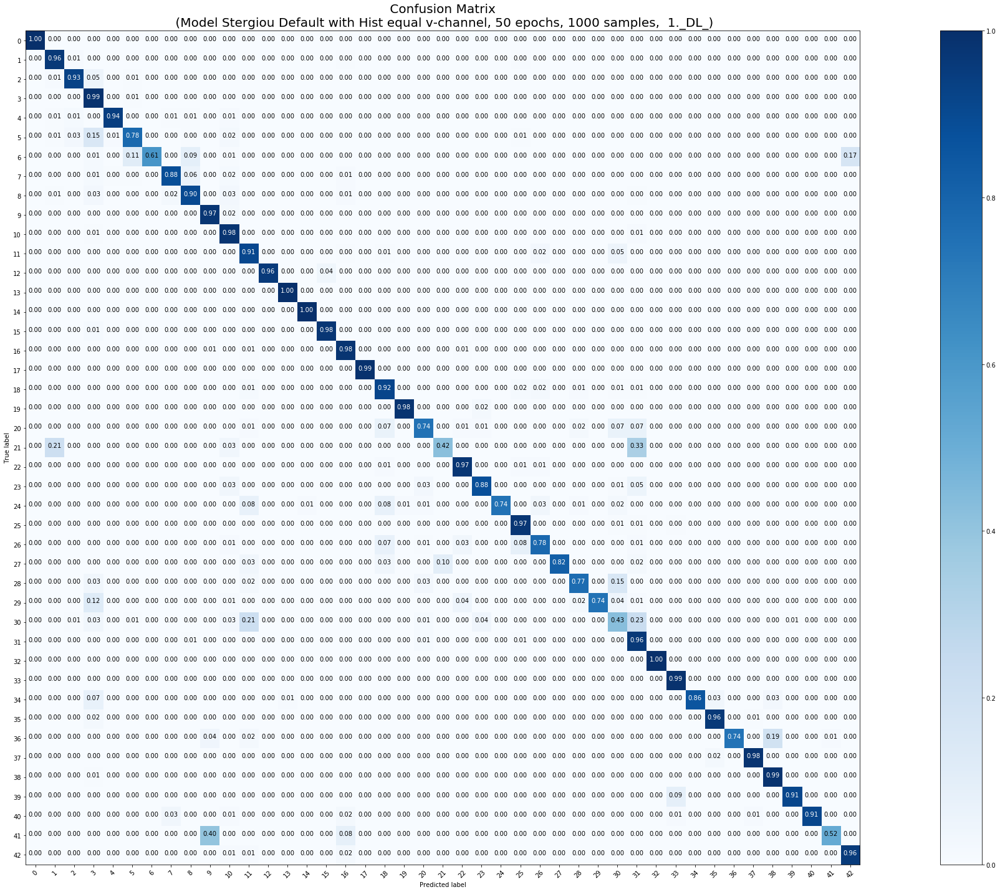

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 6s 6ms/step - loss: 2.5991 - acc: 0.3780 - val_loss: 1.5278 - val_acc: 0.6134
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.9509 - acc: 0.7330 - val_loss: 0.9979 - val_acc: 0.7368
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.5139 - acc: 0.8480 - val_loss: 0.5354 - val_acc: 0.8428
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.3044 - acc: 0.9040 - val_loss: 0.5191 - val_acc: 0.8455
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1725 - acc: 0.9570 - val_loss: 0.3960 - val_acc: 0.8880
Epoch 6/50
1000/1000 [===========================

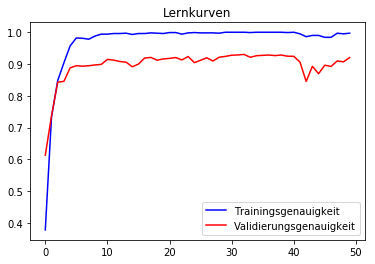

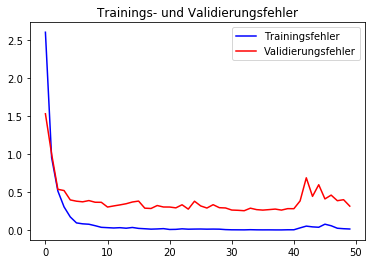

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.65      0.79        60
           1       0.97      0.95      0.96       720
           2       0.92      0.98      0.95       750
           3       0.91      0.95      0.93       450
           4       0.96      0.94      0.95       660
           5       0.95      0.82      0.88       630
           6       0.94      0.71      0.81       150
           7       0.91      0.90      0.91       450
           8       0.84      0.95      0.89       450
           9       0.94      0.96      0.95       480
          10       0.95      0.93      0.94       660
          11       0.78      0.96      0.86       420
          12       0.99      0.98      0.99       690
          13       1.00      0.99      0.99       720
          14       0.99      0.99      0.99       270
          15       0.97      0.99      0.98       210
          16       0.92      0.98      0.95   

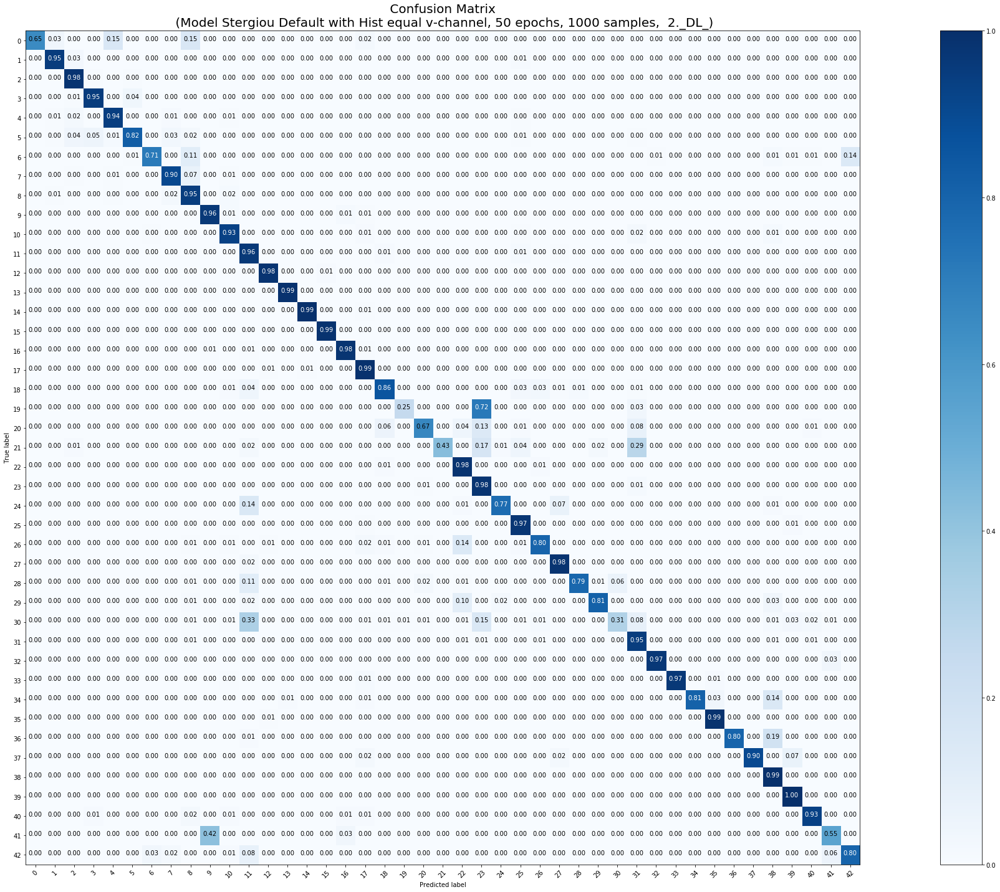

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 6s 6ms/step - loss: 2.7608 - acc: 0.3650 - val_loss: 1.3906 - val_acc: 0.6060
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.9597 - acc: 0.7070 - val_loss: 0.7582 - val_acc: 0.7805
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.4925 - acc: 0.8650 - val_loss: 0.5325 - val_acc: 0.8500
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.3037 - acc: 0.9140 - val_loss: 0.5345 - val_acc: 0.8601
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1764 - acc: 0.9510 - val_loss: 0.4726 - val_acc: 0.8668
Epoch 6/50
1000/1000 [===========================

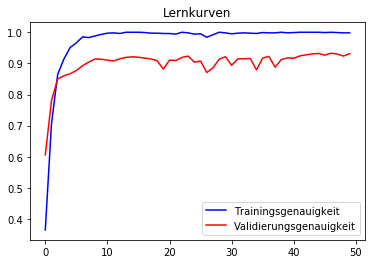

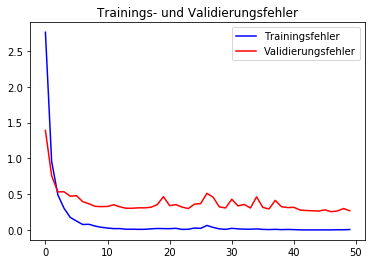

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.75      0.85        60
           1       0.92      0.97      0.94       720
           2       0.98      0.95      0.96       750
           3       0.92      0.93      0.92       450
           4       0.92      0.98      0.95       660
           5       0.91      0.90      0.91       630
           6       0.96      0.65      0.78       150
           7       0.94      0.92      0.93       450
           8       0.92      0.92      0.92       450
           9       0.92      0.95      0.94       480
          10       0.87      0.98      0.92       660
          11       0.88      0.92      0.90       420
          12       1.00      0.97      0.98       690
          13       0.99      1.00      0.99       720
          14       0.99      0.99      0.99       270
          15       0.90      0.99      0.94       210
          16       0.96      0.97      0.96   

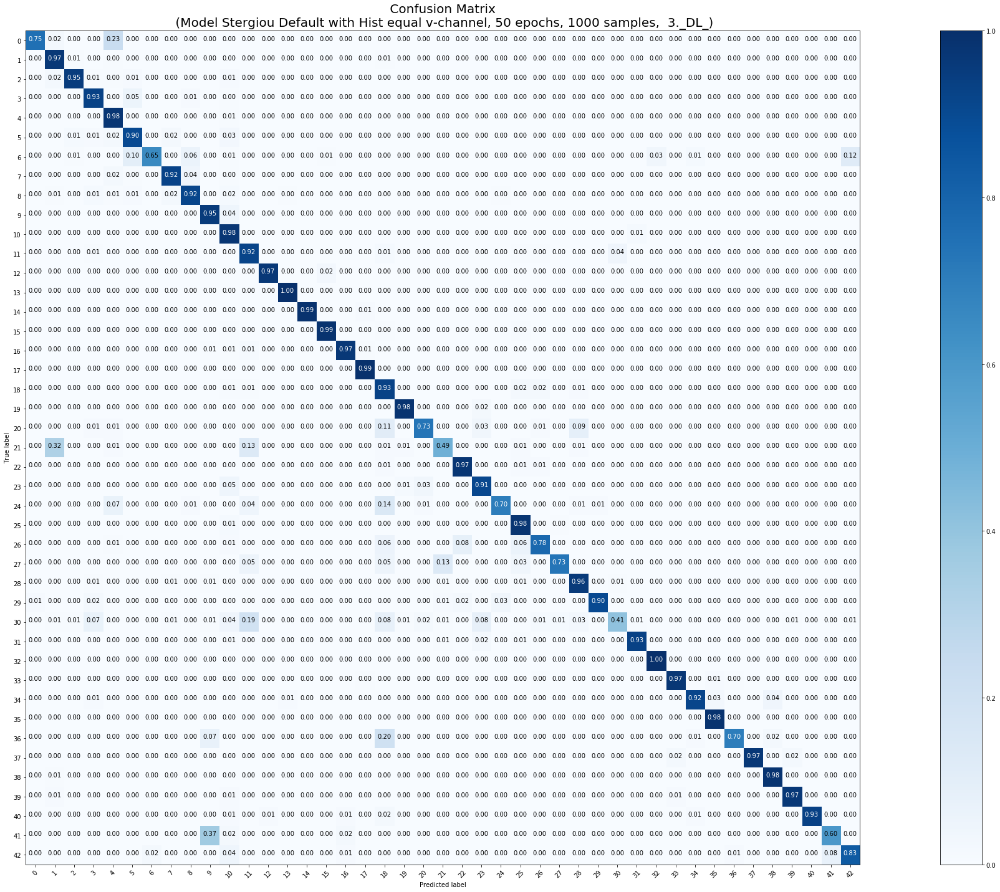

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 7s 7ms/step - loss: 2.5800 - acc: 0.3820 - val_loss: 1.7191 - val_acc: 0.5807
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.8757 - acc: 0.7400 - val_loss: 0.9334 - val_acc: 0.7264
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.4490 - acc: 0.8750 - val_loss: 0.6830 - val_acc: 0.8029
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2599 - acc: 0.9290 - val_loss: 0.4754 - val_acc: 0.8663
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1561 - acc: 0.9570 - val_loss: 0.4360 - val_acc: 0.8716
Epoch 6/50
1000/1000 [===========================

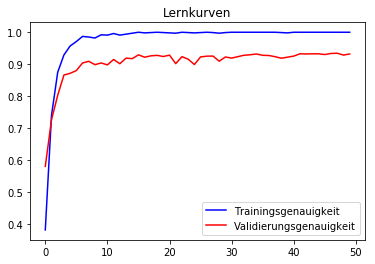

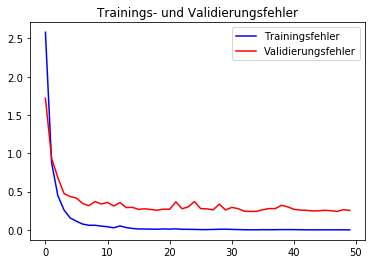

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.65      0.79        60
           1       0.95      0.95      0.95       720
           2       0.93      0.99      0.96       750
           3       0.98      0.92      0.95       450
           4       0.96      0.94      0.95       660
           5       0.93      0.94      0.93       630
           6       0.93      0.66      0.77       150
           7       0.93      0.95      0.94       450
           8       0.93      0.91      0.92       450
           9       0.94      0.97      0.95       480
          10       0.94      0.98      0.96       660
          11       0.96      0.88      0.92       420
          12       0.97      0.96      0.97       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.89      0.99      0.93       210
          16       1.00      0.95      0.98   

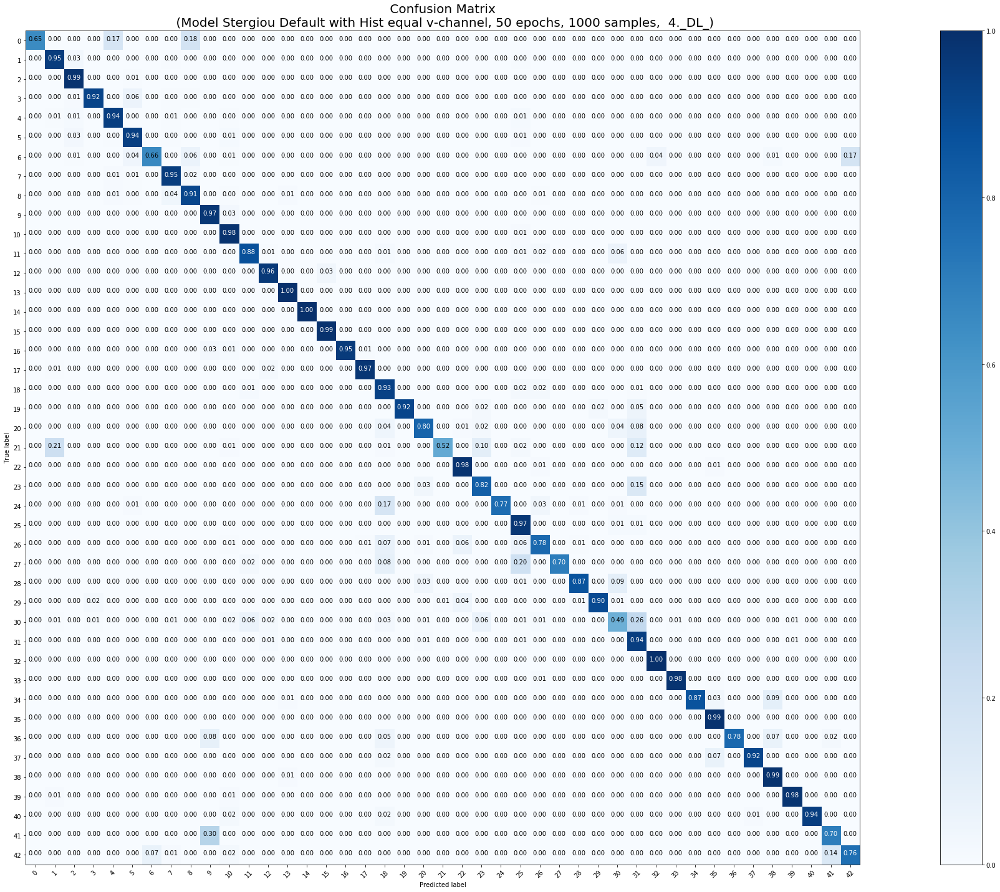

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 7s 7ms/step - loss: 2.5357 - acc: 0.3990 - val_loss: 1.6917 - val_acc: 0.5734
Epoch 2/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.9821 - acc: 0.7120 - val_loss: 0.9229 - val_acc: 0.7184
Epoch 3/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.4879 - acc: 0.8530 - val_loss: 0.6167 - val_acc: 0.8197
Epoch 4/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.2745 - acc: 0.9270 - val_loss: 0.4719 - val_acc: 0.8596
Epoch 5/50
1000/1000 [==============================] - 2s 2ms/step - loss: 0.1818 - acc: 0.9460 - val_loss: 0.4328 - val_acc: 0.8793
Epoch 6/50
1000/1000 [===========================

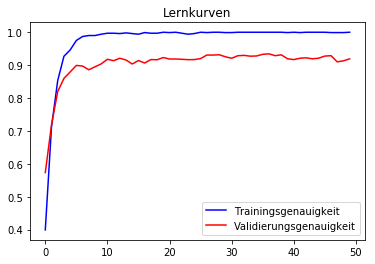

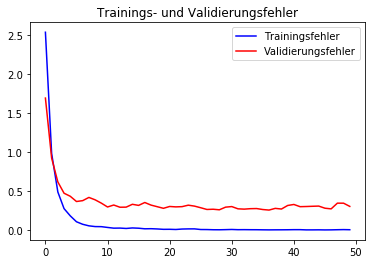

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.60      0.75        60
           1       0.88      0.96      0.92       720
           2       0.96      0.90      0.93       750
           3       0.97      0.87      0.92       450
           4       0.98      0.91      0.94       660
           5       0.74      0.96      0.84       630
           6       0.98      0.60      0.74       150
           7       0.87      0.92      0.89       450
           8       0.88      0.89      0.88       450
           9       0.95      0.96      0.95       480
          10       0.98      0.96      0.97       660
          11       0.93      0.82      0.87       420
          12       0.99      0.99      0.99       690
          13       0.98      0.99      0.99       720
          14       0.99      0.98      0.99       270
          15       0.97      0.96      0.97       210
          16       0.95      0.95      0.95   

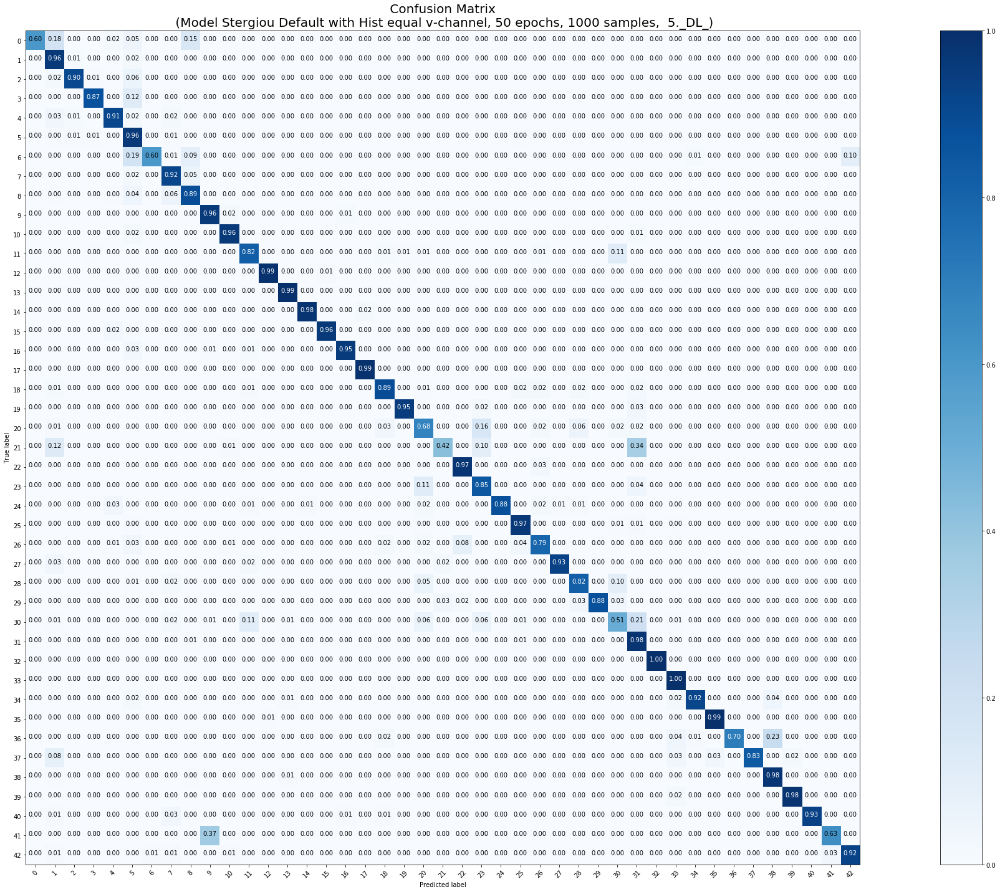

<Figure size 432x288 with 0 Axes>

In [0]:
### 1000, C, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_1000, y_tr_1000, X_test, y_test, 50, 1000)

In [0]:
downloader_C(1000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 7s 7ms/step - loss: 3.5886 - acc: 0.1880 - val_loss: 2.1113 - val_acc: 0.4287
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.6121 - acc: 0.5470 - val_loss: 1.2752 - val_acc: 0.6496
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.8367 - acc: 0.7270 - val_loss: 0.7950 - val_acc: 0.7665
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.3976 - acc: 0.8590 - val_loss: 0.5888 - val_acc: 0.8367
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.2895 - acc: 0.8980 - val_loss: 0.7163 - val_acc: 0.7863
Epoch 6/50
1000/1000 [=====================

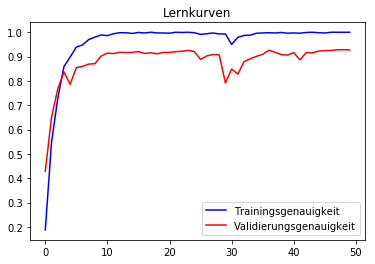

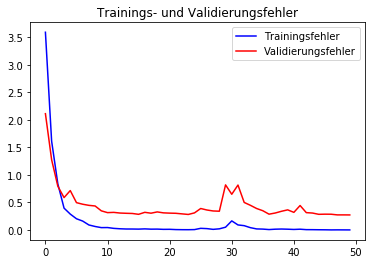

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.90      0.75      0.82        60
           1       0.98      0.94      0.96       720
           2       0.91      0.97      0.94       750
           3       0.95      0.91      0.93       450
           4       0.97      0.94      0.96       660
           5       0.89      0.90      0.90       630
           6       0.98      0.63      0.76       150
           7       0.89      0.95      0.92       450
           8       0.90      0.89      0.90       450
           9       0.97      0.97      0.97       480
          10       0.96      0.94      0.95       660
          11       0.95      0.82      0.88       420
          12       1.00      0.96      0.98       690
          13       0.99      1.00      0.99       720
          14       0.99      1.00      0.99       270
          15       0.87      1.00      0.93       210
          16       0.91      0.99      0.95   

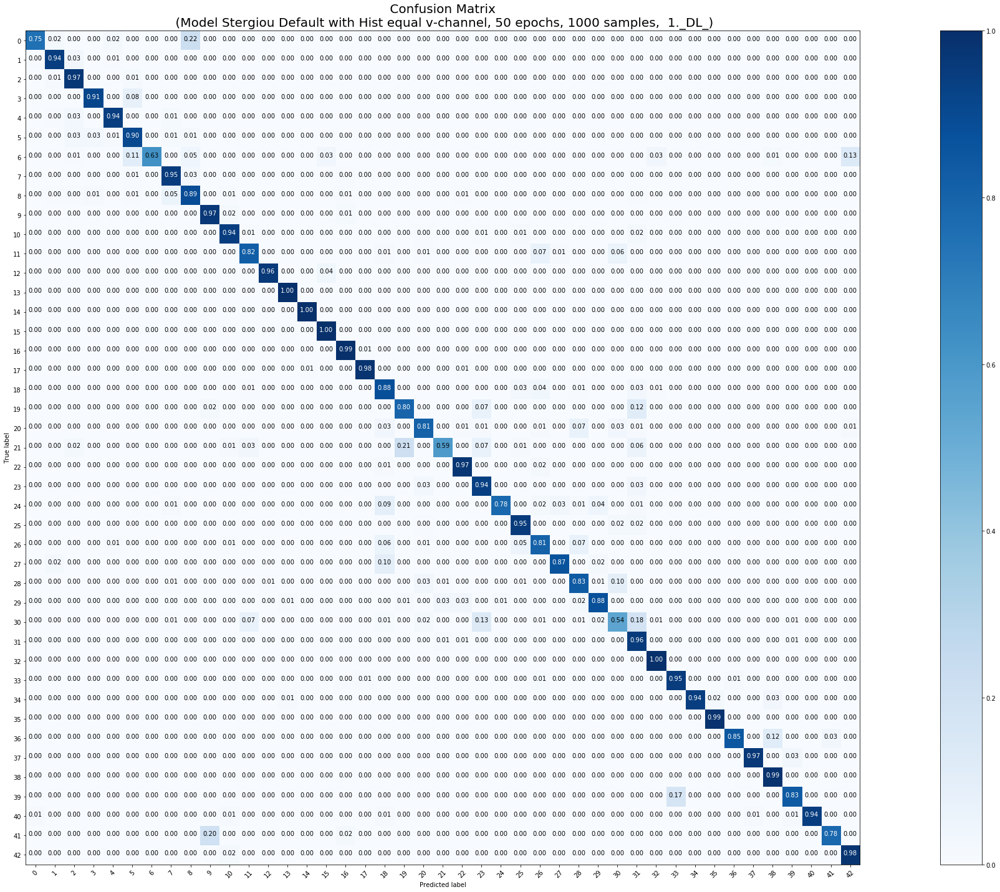

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 7s 7ms/step - loss: 3.3481 - acc: 0.2470 - val_loss: 2.0380 - val_acc: 0.4721
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.2903 - acc: 0.6210 - val_loss: 1.2765 - val_acc: 0.6654
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.6442 - acc: 0.7810 - val_loss: 0.8117 - val_acc: 0.7728
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.4077 - acc: 0.8440 - val_loss: 1.0107 - val_acc: 0.7344
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.3154 - acc: 0.8870 - val_loss: 0.5903 - val_acc: 0.8243
Epoch 6/50
1000/1000 [=====================

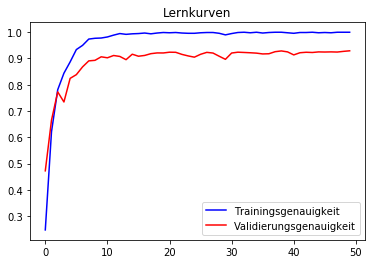

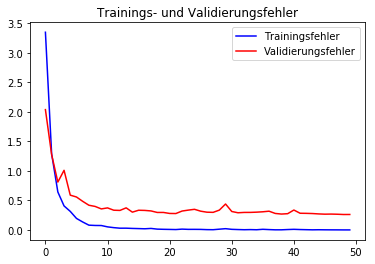

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.93      0.72      0.81        60
           1       0.95      0.96      0.95       720
           2       0.94      0.97      0.95       750
           3       0.88      0.96      0.92       450
           4       0.96      0.95      0.96       660
           5       0.94      0.87      0.91       630
           6       0.98      0.66      0.79       150
           7       0.92      0.92      0.92       450
           8       0.91      0.90      0.90       450
           9       0.95      0.98      0.96       480
          10       0.96      0.95      0.95       660
          11       0.95      0.87      0.91       420
          12       0.99      0.96      0.98       690
          13       0.97      1.00      0.98       720
          14       0.99      1.00      1.00       270
          15       0.86      1.00      0.92       210
          16       1.00      0.97      0.99   

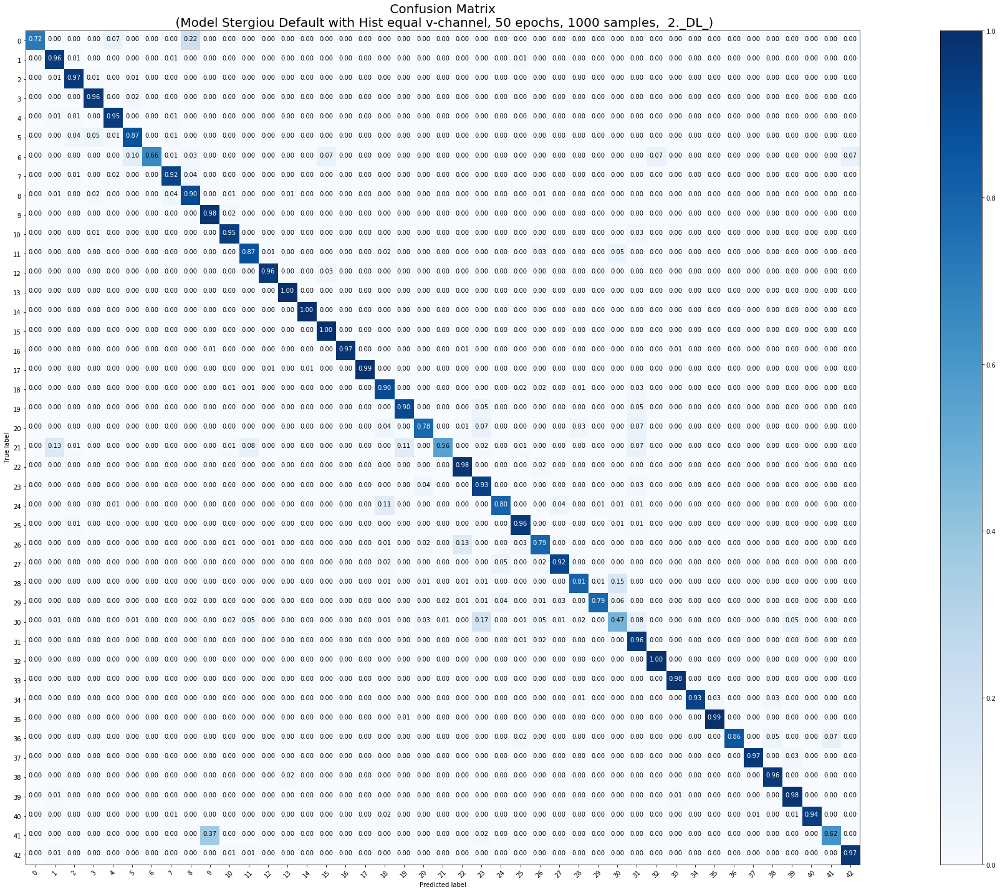

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 8s 8ms/step - loss: 3.3873 - acc: 0.2180 - val_loss: 2.6464 - val_acc: 0.3610
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.3882 - acc: 0.6030 - val_loss: 1.4397 - val_acc: 0.5906
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.7047 - acc: 0.7490 - val_loss: 1.0346 - val_acc: 0.7108
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.4407 - acc: 0.8560 - val_loss: 1.6044 - val_acc: 0.6605
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.2637 - acc: 0.9040 - val_loss: 0.5057 - val_acc: 0.8519
Epoch 6/50
1000/1000 [=====================

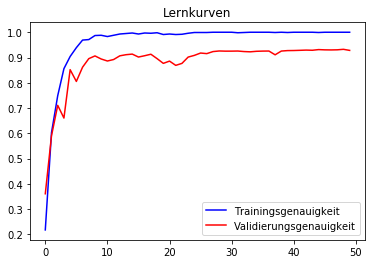

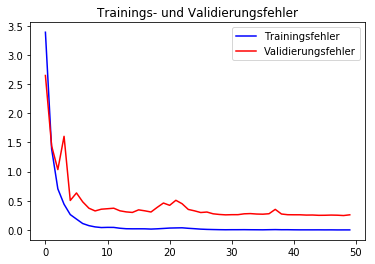

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      0.68      0.80        60
           1       0.96      0.95      0.96       720
           2       0.95      0.96      0.96       750
           3       0.92      0.95      0.93       450
           4       0.95      0.96      0.96       660
           5       0.88      0.91      0.89       630
           6       0.92      0.66      0.77       150
           7       0.91      0.89      0.90       450
           8       0.89      0.92      0.90       450
           9       0.97      0.97      0.97       480
          10       0.96      0.96      0.96       660
          11       0.91      0.81      0.86       420
          12       1.00      0.96      0.98       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.86      1.00      0.92       210
          16       1.00      0.97      0.99   

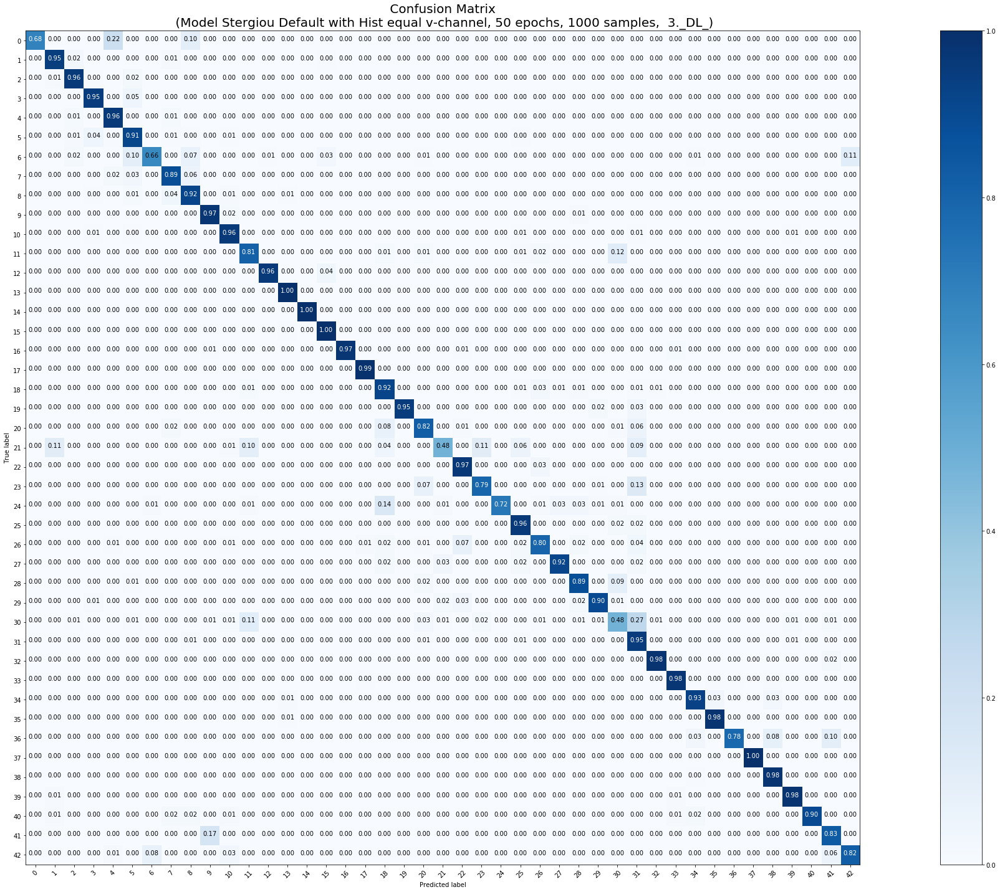

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 8s 8ms/step - loss: 3.3348 - acc: 0.2410 - val_loss: 1.8843 - val_acc: 0.4883
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.3726 - acc: 0.5800 - val_loss: 1.1862 - val_acc: 0.6586
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.7797 - acc: 0.7500 - val_loss: 1.3610 - val_acc: 0.6657
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.4242 - acc: 0.8440 - val_loss: 0.6931 - val_acc: 0.7969
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.3035 - acc: 0.8960 - val_loss: 0.5923 - val_acc: 0.8275
Epoch 6/50
1000/1000 [=====================

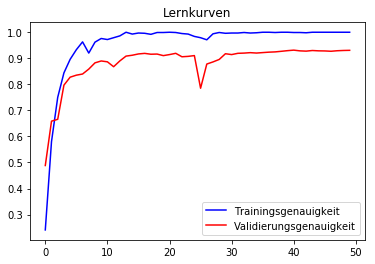

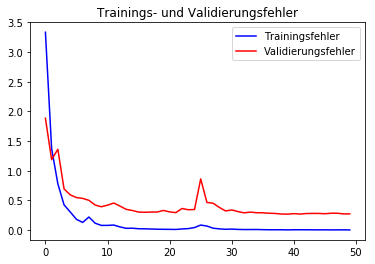

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.80      0.88        60
           1       0.97      0.94      0.95       720
           2       0.90      0.96      0.93       750
           3       0.90      0.96      0.93       450
           4       0.95      0.95      0.95       660
           5       0.93      0.87      0.90       630
           6       0.98      0.69      0.81       150
           7       0.92      0.92      0.92       450
           8       0.87      0.90      0.88       450
           9       0.94      0.96      0.95       480
          10       0.96      0.96      0.96       660
          11       0.93      0.93      0.93       420
          12       0.98      0.96      0.97       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.85      0.99      0.91       210
          16       0.99      0.97      0.98   

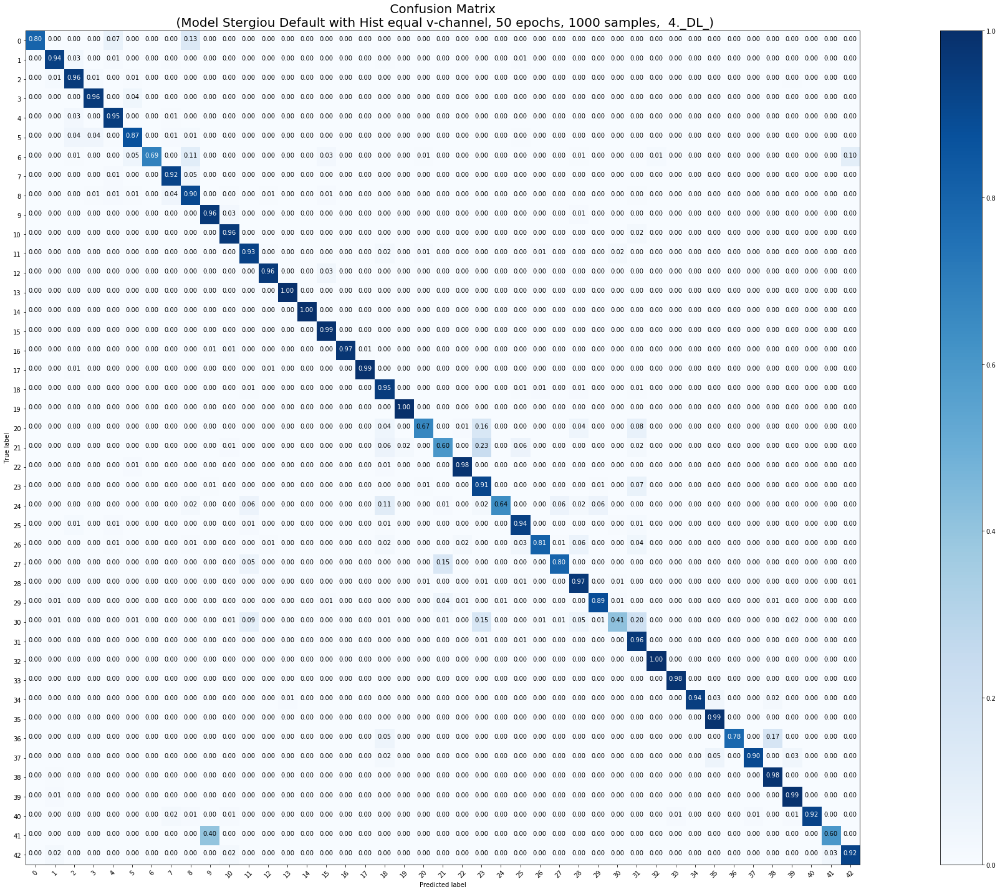

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 1000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 1000 samples, validate on 12630 samples
Epoch 1/50
1000/1000 [==============================] - 9s 9ms/step - loss: 3.3358 - acc: 0.2280 - val_loss: 2.2148 - val_acc: 0.4548
Epoch 2/50
1000/1000 [==============================] - 3s 3ms/step - loss: 1.4468 - acc: 0.5620 - val_loss: 1.4588 - val_acc: 0.5721
Epoch 3/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.7388 - acc: 0.7390 - val_loss: 0.9556 - val_acc: 0.7129
Epoch 4/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.5264 - acc: 0.8270 - val_loss: 0.6797 - val_acc: 0.8108
Epoch 5/50
1000/1000 [==============================] - 3s 3ms/step - loss: 0.3363 - acc: 0.9000 - val_loss: 0.5267 - val_acc: 0.8499
Epoch 6/50
1000/1000 [=====================

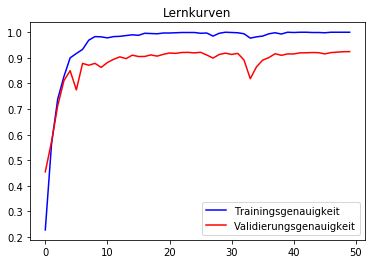

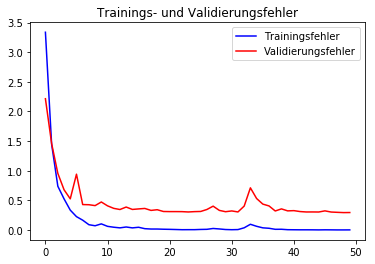

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.78      0.88        60
           1       0.96      0.94      0.95       720
           2       0.92      0.97      0.94       750
           3       0.94      0.93      0.93       450
           4       0.95      0.94      0.95       660
           5       0.91      0.89      0.90       630
           6       0.97      0.61      0.75       150
           7       0.85      0.93      0.89       450
           8       0.91      0.86      0.88       450
           9       0.95      0.98      0.96       480
          10       0.96      0.95      0.96       660
          11       0.89      0.91      0.90       420
          12       0.99      0.96      0.98       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.85      0.99      0.91       210
          16       0.99      0.97      0.98   

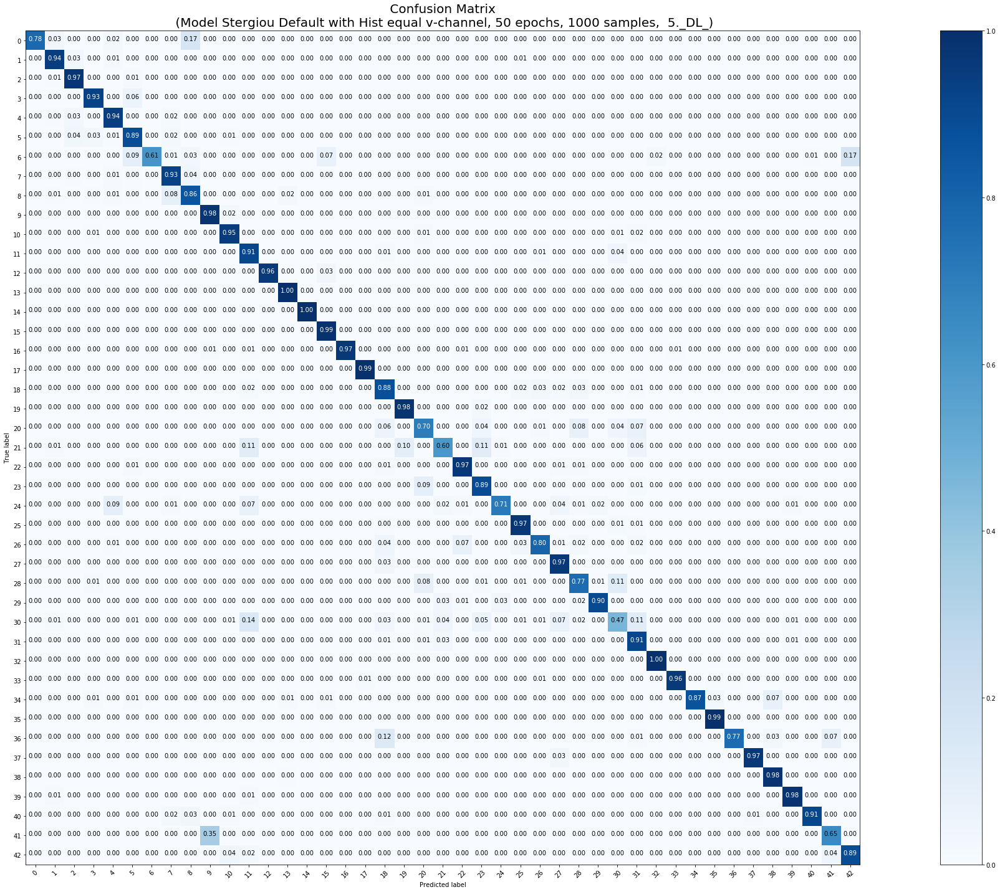

<Figure size 432x288 with 0 Axes>

In [0]:
### 1000, C, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_1000, y_tr_1000, X_test, y_test, 50, 1000)

In [0]:
downloaderCW_C(1000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 8s 4ms/step - loss: 1.9100 - acc: 0.5125 - val_loss: 0.9489 - val_acc: 0.7220
Epoch 2/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.5390 - acc: 0.8365 - val_loss: 0.5151 - val_acc: 0.8458
Epoch 3/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.2286 - acc: 0.9325 - val_loss: 0.3823 - val_acc: 0.8933
Epoch 4/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1518 - acc: 0.9565 - val_loss: 0.4047 - val_acc: 0.8780
Epoch 5/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.0807 - acc: 0.9785 - val_loss: 0.2725 - val_acc: 0.9223
Epoch 6/50
2000/2000 [===========================

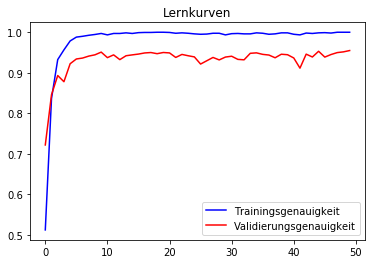

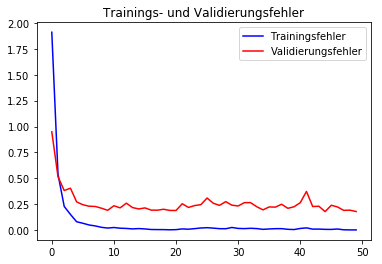

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.93      0.97        60
           1       0.95      0.95      0.95       720
           2       0.97      0.99      0.98       750
           3       0.99      0.94      0.96       450
           4       0.96      0.98      0.97       660
           5       0.93      0.96      0.94       630
           6       0.99      0.71      0.83       150
           7       0.93      0.97      0.95       450
           8       0.96      0.92      0.94       450
           9       0.95      0.99      0.97       480
          10       0.98      0.98      0.98       660
          11       0.87      0.96      0.91       420
          12       0.98      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.95      1.00      0.97       210
          16       0.99      0.97      0.98   

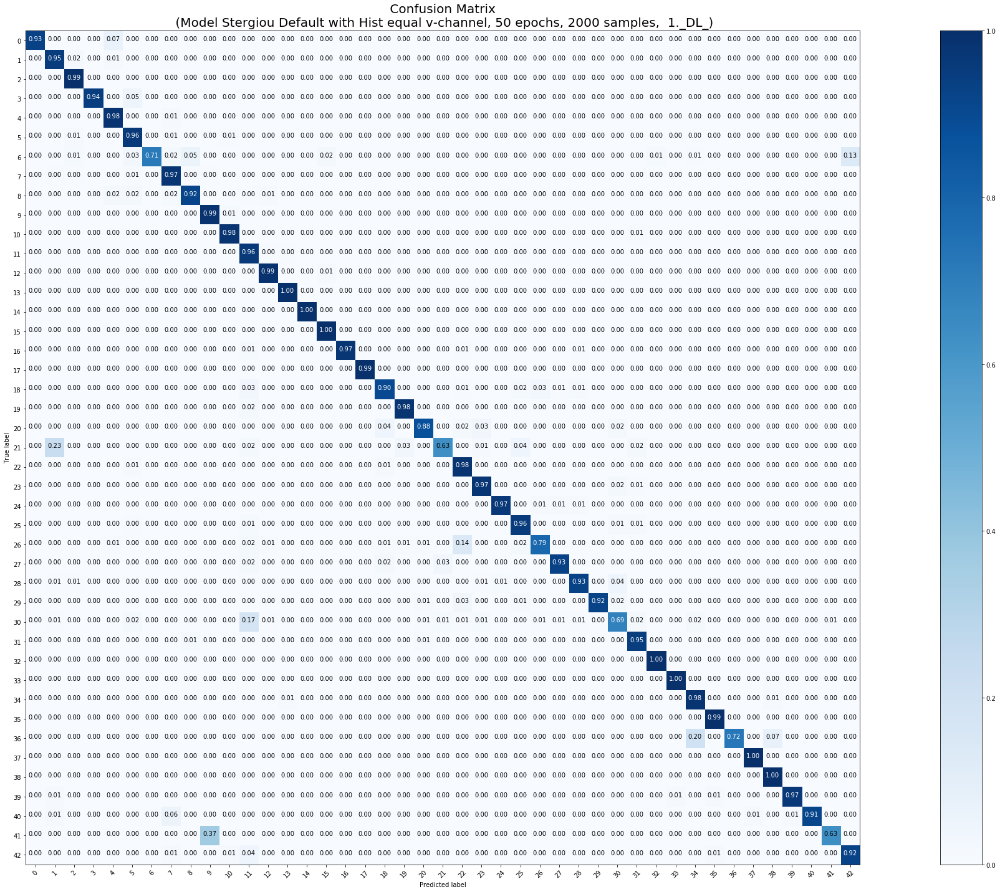

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 8s 4ms/step - loss: 1.8985 - acc: 0.5215 - val_loss: 0.9459 - val_acc: 0.7293
Epoch 2/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.5028 - acc: 0.8505 - val_loss: 0.5948 - val_acc: 0.8303
Epoch 3/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.2305 - acc: 0.9270 - val_loss: 0.4148 - val_acc: 0.8769
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1302 - acc: 0.9665 - val_loss: 0.3077 - val_acc: 0.9141
Epoch 5/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.0836 - acc: 0.9790 - val_loss: 0.2531 - val_acc: 0.9291
Epoch 6/50
2000/2000 [===========================

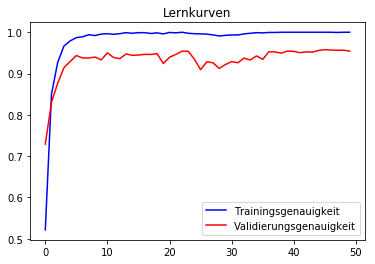

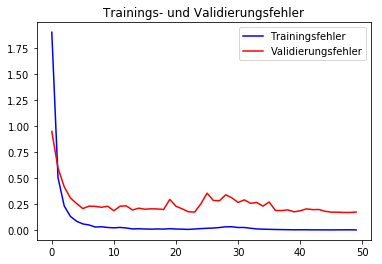

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.85      0.91        60
           1       0.97      0.96      0.96       720
           2       0.97      1.00      0.98       750
           3       0.98      0.96      0.97       450
           4       0.96      0.97      0.97       660
           5       0.93      0.95      0.94       630
           6       0.99      0.76      0.86       150
           7       0.94      0.93      0.93       450
           8       0.92      0.93      0.92       450
           9       0.98      0.98      0.98       480
          10       0.97      0.99      0.98       660
          11       0.98      0.93      0.95       420
          12       0.98      0.99      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      0.98      0.99       270
          15       0.92      0.99      0.95       210
          16       0.99      0.98      0.99   

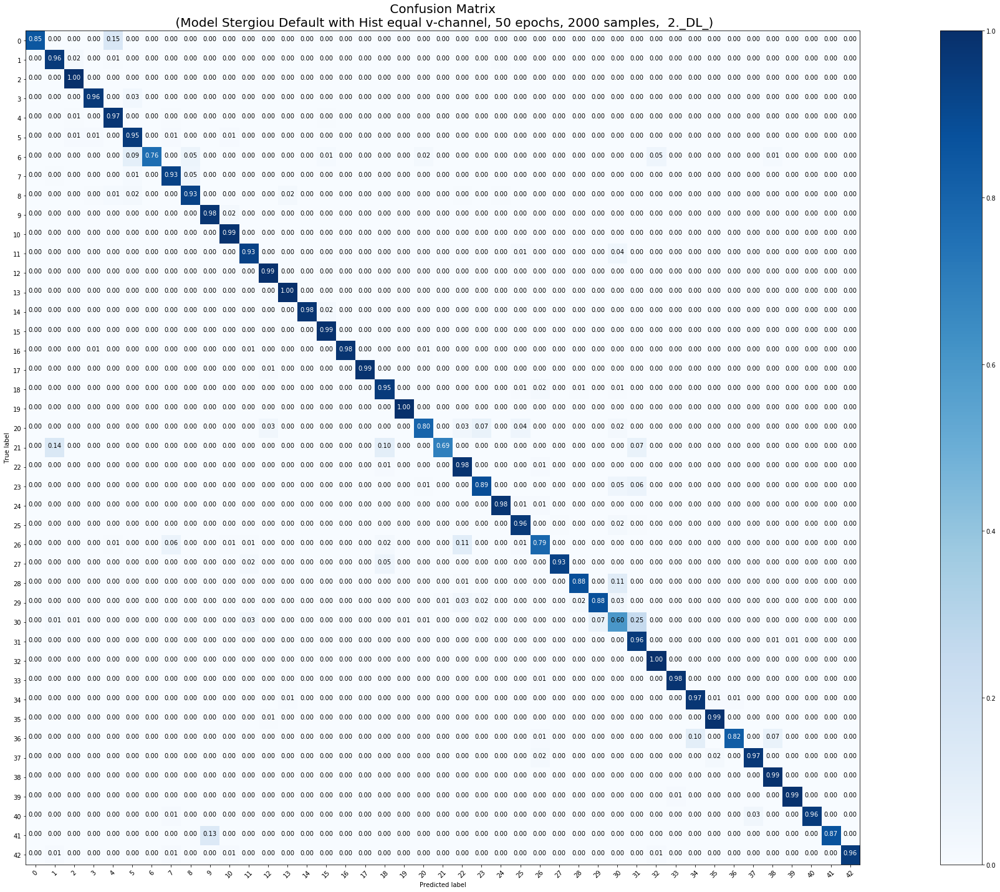

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 9s 4ms/step - loss: 1.9591 - acc: 0.5035 - val_loss: 0.8938 - val_acc: 0.7453
Epoch 2/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.5856 - acc: 0.8225 - val_loss: 0.5121 - val_acc: 0.8375
Epoch 3/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.2892 - acc: 0.9185 - val_loss: 0.4784 - val_acc: 0.8604
Epoch 4/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1606 - acc: 0.9545 - val_loss: 0.2810 - val_acc: 0.9229
Epoch 5/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1010 - acc: 0.9730 - val_loss: 0.2992 - val_acc: 0.9155
Epoch 6/50
2000/2000 [===========================

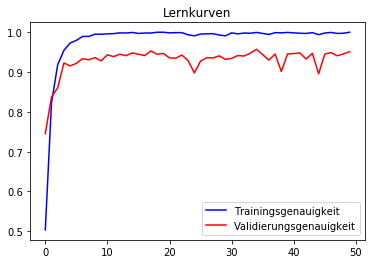

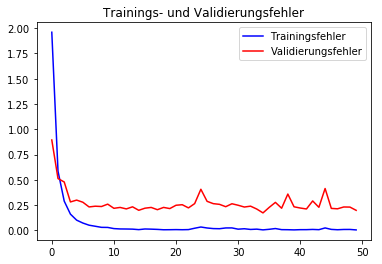

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.93      0.97        60
           1       0.91      0.97      0.94       720
           2       0.96      0.99      0.98       750
           3       0.98      0.94      0.96       450
           4       0.97      0.97      0.97       660
           5       0.91      0.96      0.93       630
           6       1.00      0.68      0.81       150
           7       0.94      0.96      0.95       450
           8       0.96      0.91      0.93       450
           9       0.94      0.99      0.96       480
          10       0.97      0.98      0.98       660
          11       0.94      0.96      0.95       420
          12       1.00      0.98      0.99       690
          13       0.97      0.99      0.98       720
          14       1.00      1.00      1.00       270
          15       0.93      0.99      0.96       210
          16       1.00      0.99      0.99   

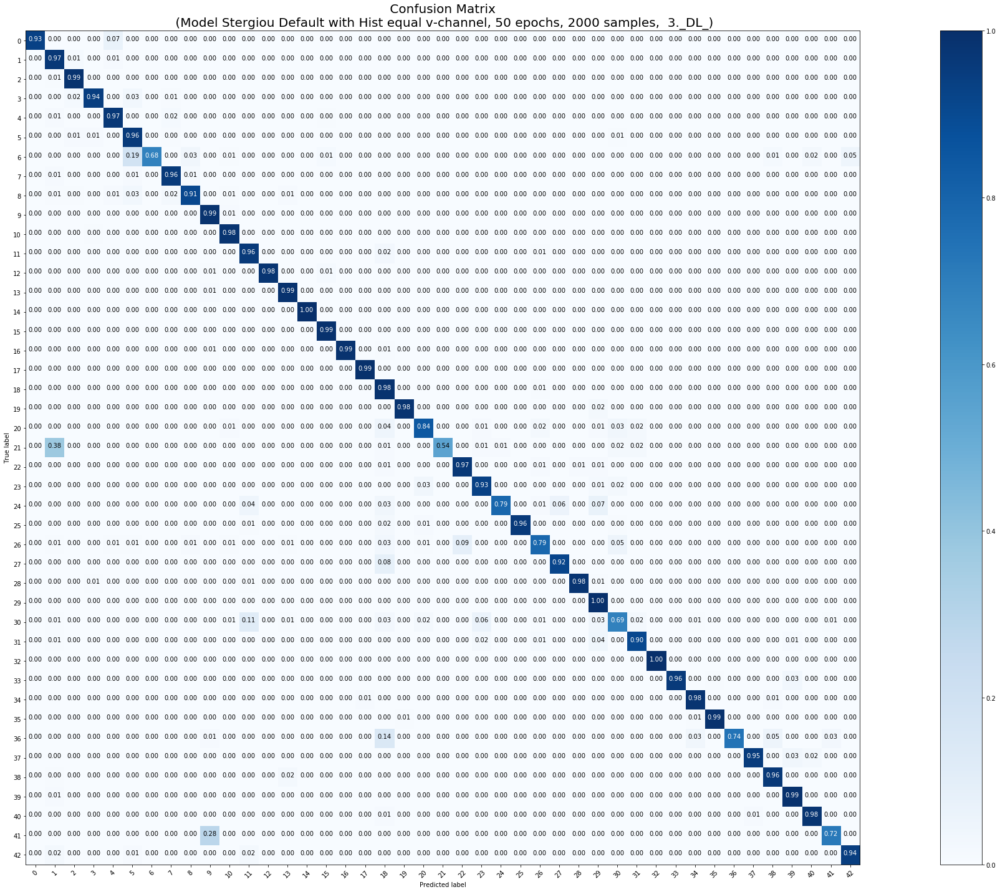

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 9s 5ms/step - loss: 1.9267 - acc: 0.5150 - val_loss: 1.1183 - val_acc: 0.7060
Epoch 2/50
2000/2000 [==============================] - 3s 1ms/step - loss: 0.5118 - acc: 0.8400 - val_loss: 0.5577 - val_acc: 0.8337
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.2355 - acc: 0.9270 - val_loss: 0.2913 - val_acc: 0.9184
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1336 - acc: 0.9620 - val_loss: 0.3346 - val_acc: 0.9092
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1129 - acc: 0.9700 - val_loss: 0.4256 - val_acc: 0.8819
Epoch 6/50
2000/2000 [===========================

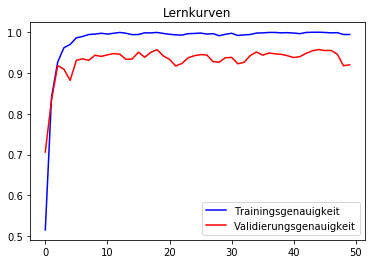

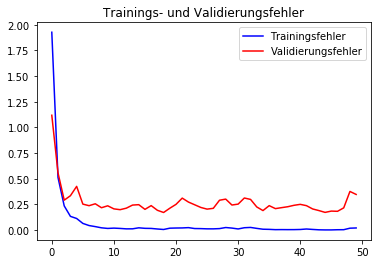

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.84      0.60      0.70        60
           1       0.96      0.93      0.94       720
           2       0.96      0.99      0.97       750
           3       0.95      0.96      0.96       450
           4       0.98      0.93      0.95       660
           5       0.94      0.89      0.91       630
           6       1.00      0.73      0.84       150
           7       0.54      0.96      0.69       450
           8       0.75      0.92      0.83       450
           9       0.90      0.99      0.94       480
          10       0.99      0.87      0.93       660
          11       0.98      0.87      0.92       420
          12       0.98      0.98      0.98       690
          13       0.98      0.99      0.99       720
          14       1.00      0.99      1.00       270
          15       0.86      1.00      0.93       210
          16       0.98      0.97      0.97   

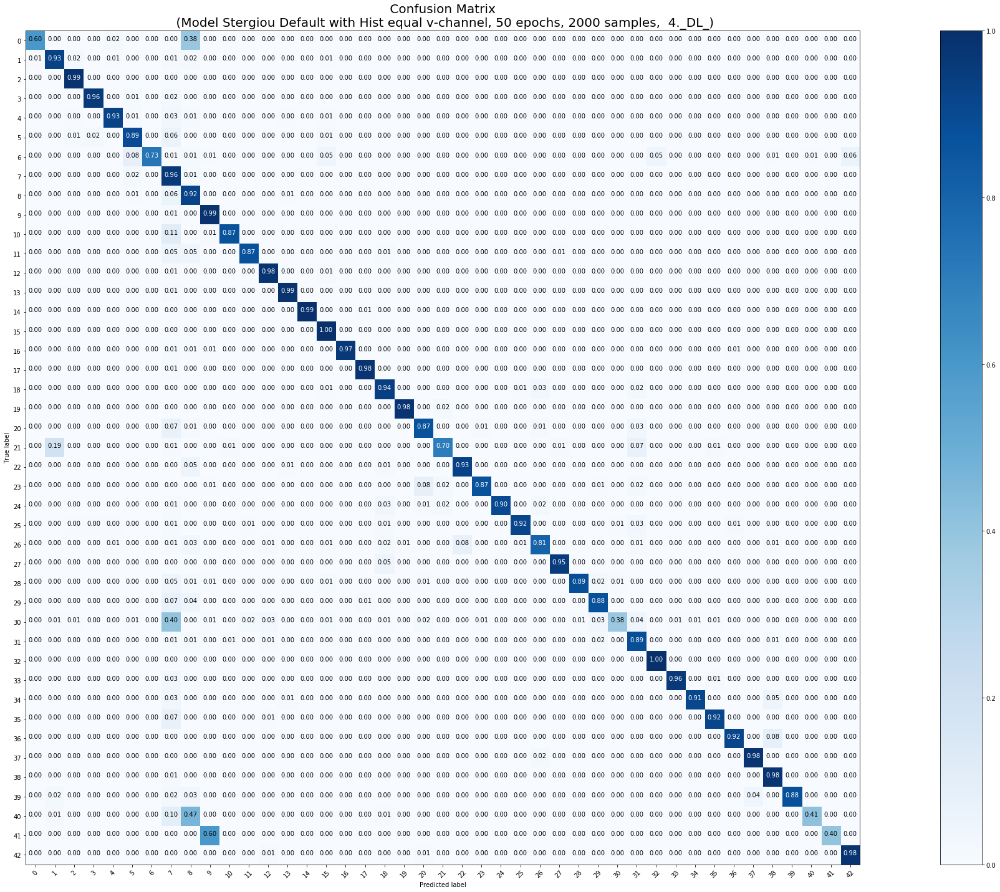

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 9s 5ms/step - loss: 1.8507 - acc: 0.5370 - val_loss: 0.7584 - val_acc: 0.7869
Epoch 2/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.4676 - acc: 0.8600 - val_loss: 0.4422 - val_acc: 0.8585
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.2115 - acc: 0.9365 - val_loss: 0.3191 - val_acc: 0.9098
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1423 - acc: 0.9570 - val_loss: 0.2629 - val_acc: 0.9228
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.0915 - acc: 0.9770 - val_loss: 0.2923 - val_acc: 0.9195
Epoch 6/50
2000/2000 [===========================

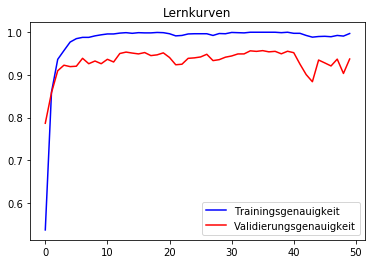

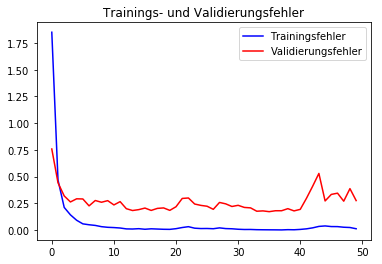

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.60      0.75        60
           1       0.99      0.91      0.95       720
           2       0.85      1.00      0.92       750
           3       0.95      0.93      0.94       450
           4       0.92      0.96      0.94       660
           5       0.98      0.87      0.92       630
           6       0.96      0.67      0.79       150
           7       0.92      0.96      0.94       450
           8       0.95      0.94      0.95       450
           9       0.97      0.98      0.97       480
          10       0.93      0.97      0.95       660
          11       0.92      0.95      0.94       420
          12       0.99      0.98      0.98       690
          13       0.98      1.00      0.99       720
          14       1.00      0.89      0.94       270
          15       0.94      1.00      0.97       210
          16       0.99      0.97      0.98   

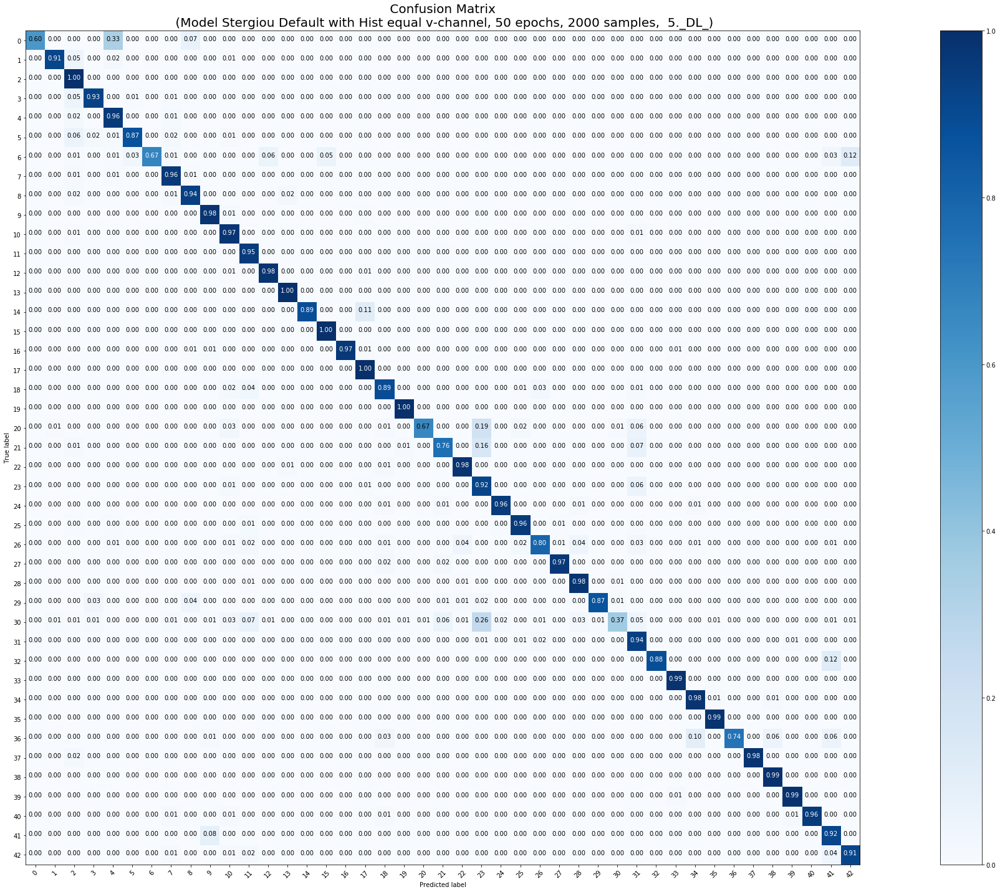

<Figure size 432x288 with 0 Axes>

In [0]:
### 2000, C, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_2000, y_tr_2000, X_test, y_test, 50, 2000)

In [0]:
downloader_C(2000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 10s 5ms/step - loss: 2.5805 - acc: 0.3725 - val_loss: 1.2224 - val_acc: 0.6559
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.7652 - acc: 0.7445 - val_loss: 0.8329 - val_acc: 0.7610
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.3476 - acc: 0.8715 - val_loss: 0.4886 - val_acc: 0.8528
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.2011 - acc: 0.9265 - val_loss: 0.4272 - val_acc: 0.8670
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1226 - acc: 0.9630 - val_loss: 0.3304 - val_acc: 0.9055
Epoch 6/50
2000/2000 [====================

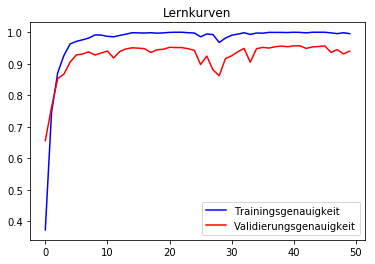

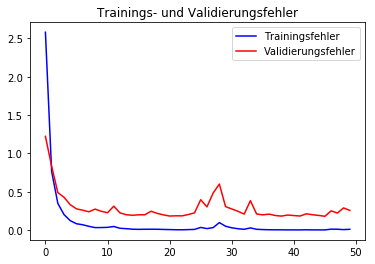

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.85      0.92        60
           1       0.98      0.91      0.95       720
           2       0.98      0.90      0.94       750
           3       0.94      0.93      0.94       450
           4       0.98      0.94      0.96       660
           5       0.76      0.97      0.85       630
           6       0.97      0.61      0.75       150
           7       0.90      0.96      0.93       450
           8       0.97      0.91      0.94       450
           9       0.98      0.99      0.98       480
          10       0.97      0.94      0.96       660
          11       0.91      0.97      0.94       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.99      1.00       270
          15       0.94      1.00      0.97       210
          16       1.00      0.97      0.98   

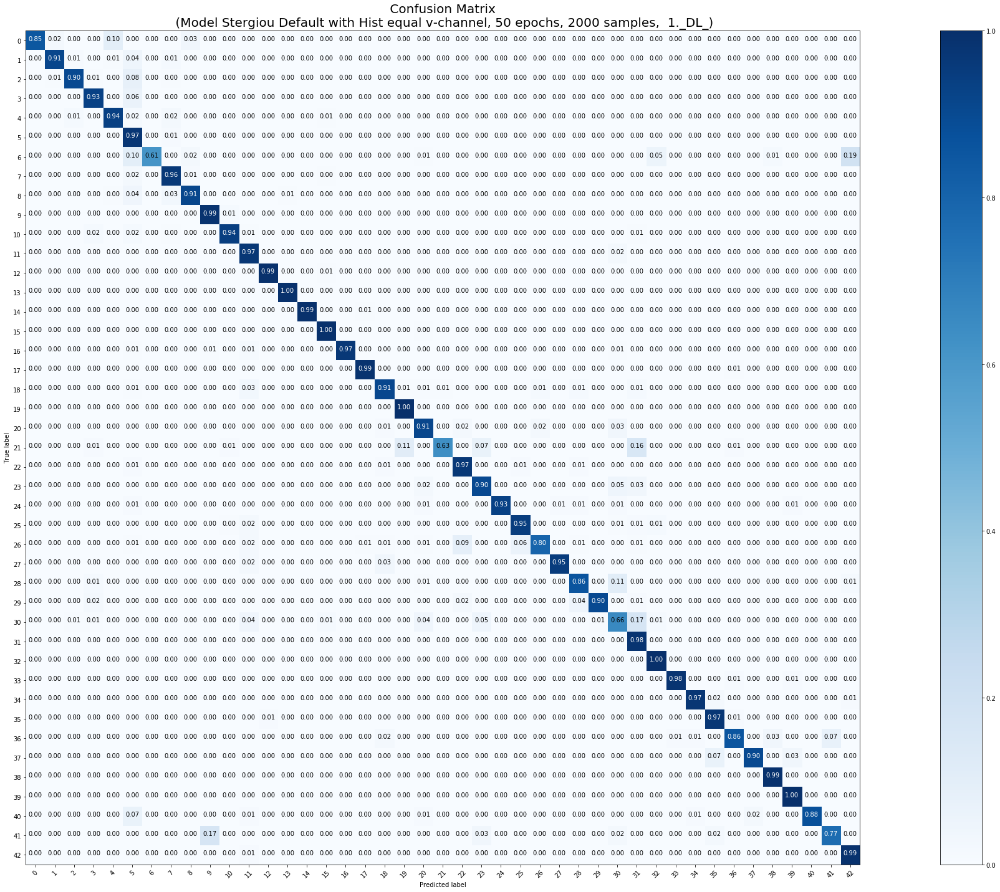

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 10s 5ms/step - loss: 2.5039 - acc: 0.3905 - val_loss: 1.0636 - val_acc: 0.6746
Epoch 2/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.6840 - acc: 0.7815 - val_loss: 0.5979 - val_acc: 0.8257
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.3148 - acc: 0.8820 - val_loss: 0.6034 - val_acc: 0.8368
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1901 - acc: 0.9370 - val_loss: 0.3372 - val_acc: 0.9108
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1012 - acc: 0.9695 - val_loss: 0.3017 - val_acc: 0.9146
Epoch 6/50
2000/2000 [====================

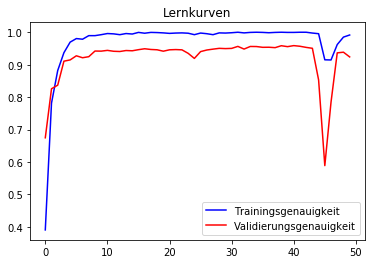

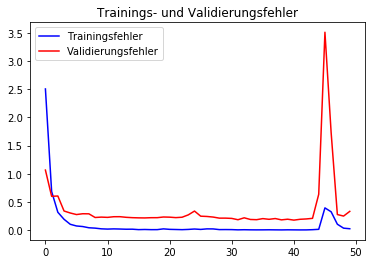

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      0.93      0.94        60
           1       0.99      0.93      0.96       720
           2       0.93      0.98      0.95       750
           3       0.97      0.92      0.95       450
           4       0.99      0.92      0.95       660
           5       0.93      0.92      0.93       630
           6       0.91      0.65      0.75       150
           7       0.87      0.94      0.90       450
           8       0.97      0.82      0.89       450
           9       0.99      0.96      0.97       480
          10       0.99      0.90      0.94       660
          11       0.83      0.95      0.89       420
          12       0.99      0.95      0.97       690
          13       1.00      0.99      0.99       720
          14       1.00      0.96      0.98       270
          15       1.00      0.93      0.97       210
          16       1.00      0.95      0.97   

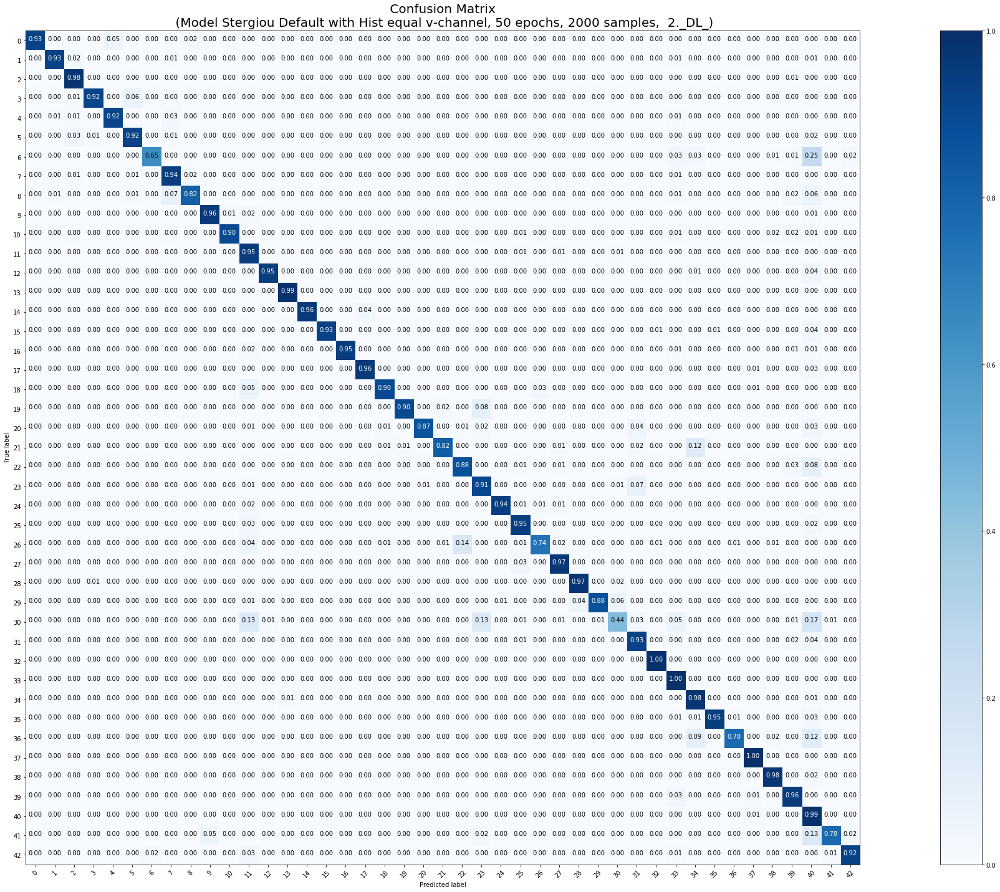

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 11s 6ms/step - loss: 2.5778 - acc: 0.3835 - val_loss: 1.6873 - val_acc: 0.5356
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.7816 - acc: 0.7480 - val_loss: 0.7461 - val_acc: 0.7736
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.3577 - acc: 0.8810 - val_loss: 0.4449 - val_acc: 0.8775
Epoch 4/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1775 - acc: 0.9355 - val_loss: 0.3704 - val_acc: 0.8919
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1226 - acc: 0.9570 - val_loss: 0.2861 - val_acc: 0.9198
Epoch 6/50
2000/2000 [====================

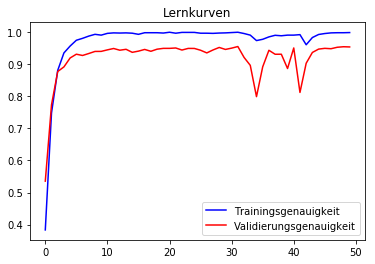

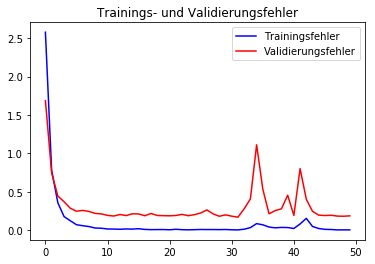

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.94      1.00      0.97        60
           1       0.98      0.95      0.97       720
           2       0.94      0.99      0.97       750
           3       0.96      0.94      0.95       450
           4       0.99      0.97      0.98       660
           5       0.89      0.96      0.92       630
           6       0.98      0.72      0.83       150
           7       0.98      0.96      0.97       450
           8       0.98      0.96      0.97       450
           9       0.95      0.99      0.97       480
          10       0.98      0.94      0.96       660
          11       0.97      0.95      0.96       420
          12       0.98      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      0.93      0.96       270
          15       0.95      1.00      0.97       210
          16       0.98      0.97      0.98   

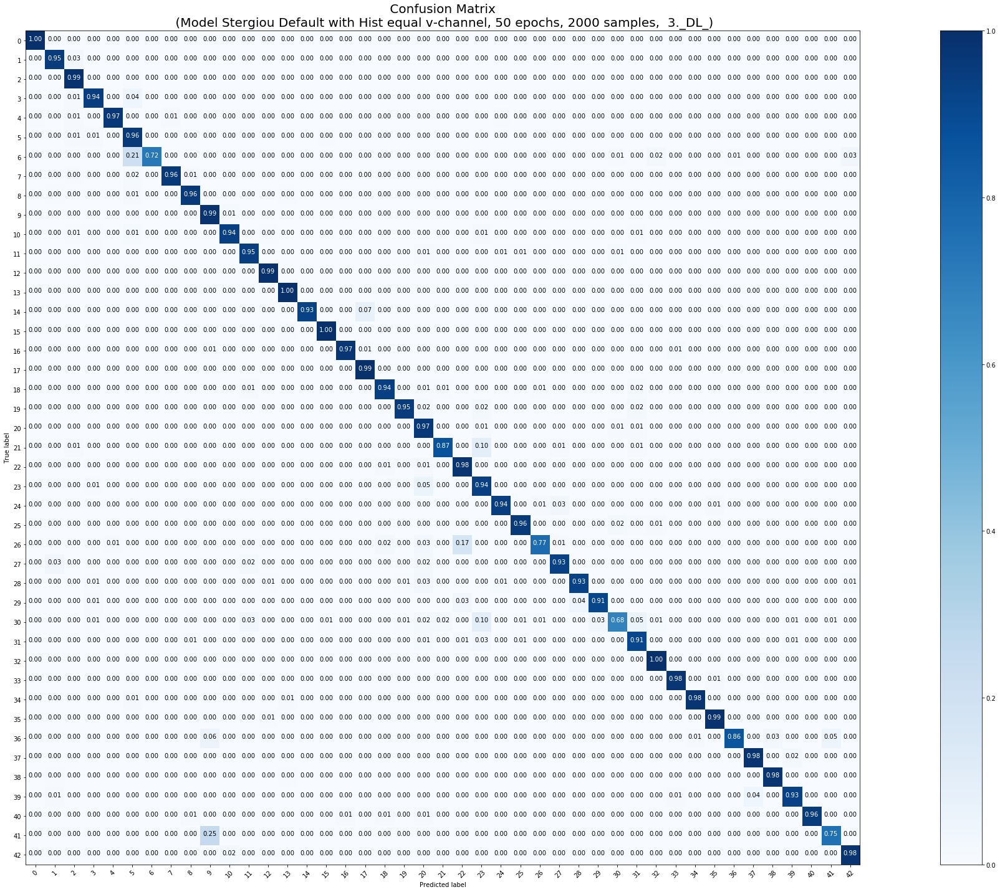

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 11s 6ms/step - loss: 2.7068 - acc: 0.3580 - val_loss: 1.6199 - val_acc: 0.5598
Epoch 2/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.7731 - acc: 0.7420 - val_loss: 0.6426 - val_acc: 0.8074
Epoch 3/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.3781 - acc: 0.8745 - val_loss: 0.6874 - val_acc: 0.8009
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1677 - acc: 0.9325 - val_loss: 0.3197 - val_acc: 0.9123
Epoch 5/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1216 - acc: 0.9610 - val_loss: 0.3015 - val_acc: 0.9189
Epoch 6/50
2000/2000 [====================

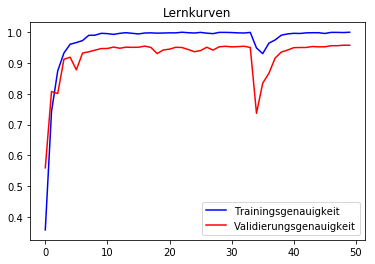

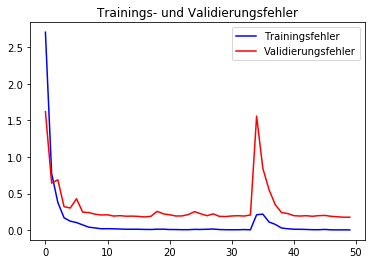

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.97      0.97        60
           1       0.96      0.95      0.95       720
           2       0.96      0.99      0.97       750
           3       0.97      0.94      0.96       450
           4       0.99      0.96      0.98       660
           5       0.90      0.97      0.94       630
           6       0.94      0.67      0.78       150
           7       0.96      0.96      0.96       450
           8       0.96      0.95      0.95       450
           9       0.96      0.98      0.97       480
          10       0.96      0.97      0.97       660
          11       0.94      0.97      0.95       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.94      1.00      0.97       210
          16       0.99      0.99      0.99   

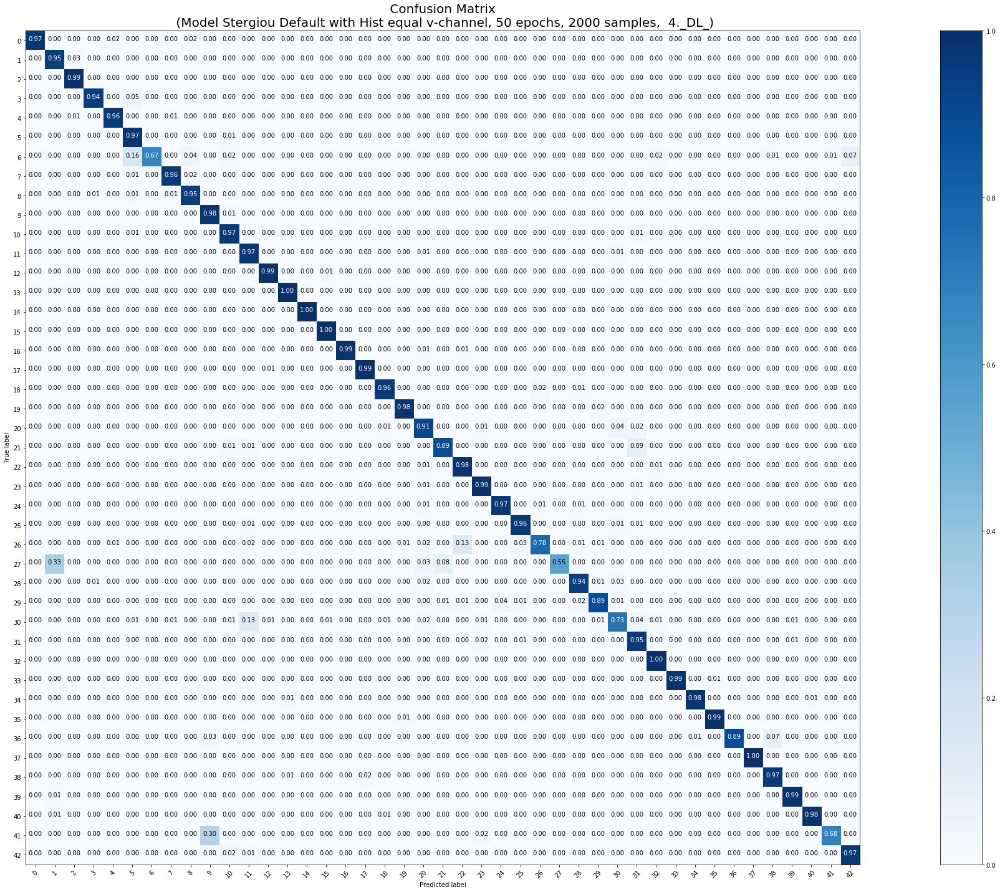

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 2000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 2000 samples, validate on 12630 samples
Epoch 1/50
2000/2000 [==============================] - 12s 6ms/step - loss: 2.6708 - acc: 0.3730 - val_loss: 1.2782 - val_acc: 0.6201
Epoch 2/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.8837 - acc: 0.7280 - val_loss: 0.8361 - val_acc: 0.7508
Epoch 3/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.4268 - acc: 0.8510 - val_loss: 0.4997 - val_acc: 0.8502
Epoch 4/50
2000/2000 [==============================] - 4s 2ms/step - loss: 0.2012 - acc: 0.9255 - val_loss: 0.4159 - val_acc: 0.8804
Epoch 5/50
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1553 - acc: 0.9480 - val_loss: 0.3306 - val_acc: 0.9065
Epoch 6/50
2000/2000 [====================

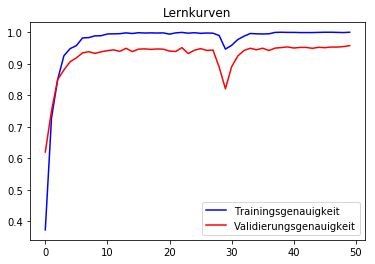

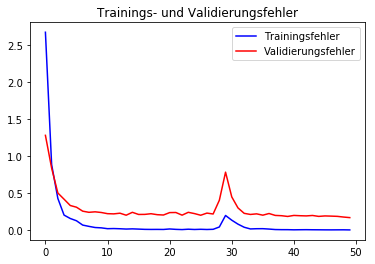

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.93      0.95      0.94        60
           1       0.93      0.97      0.95       720
           2       0.98      0.98      0.98       750
           3       0.97      0.95      0.96       450
           4       0.98      0.97      0.97       660
           5       0.89      0.97      0.93       630
           6       0.93      0.65      0.77       150
           7       0.95      0.96      0.96       450
           8       0.95      0.93      0.94       450
           9       0.96      0.98      0.97       480
          10       0.96      0.97      0.97       660
          11       0.95      0.93      0.94       420
          12       1.00      1.00      1.00       690
          13       0.98      1.00      0.99       720
          14       1.00      0.99      0.99       270
          15       1.00      1.00      1.00       210
          16       0.99      0.97      0.98   

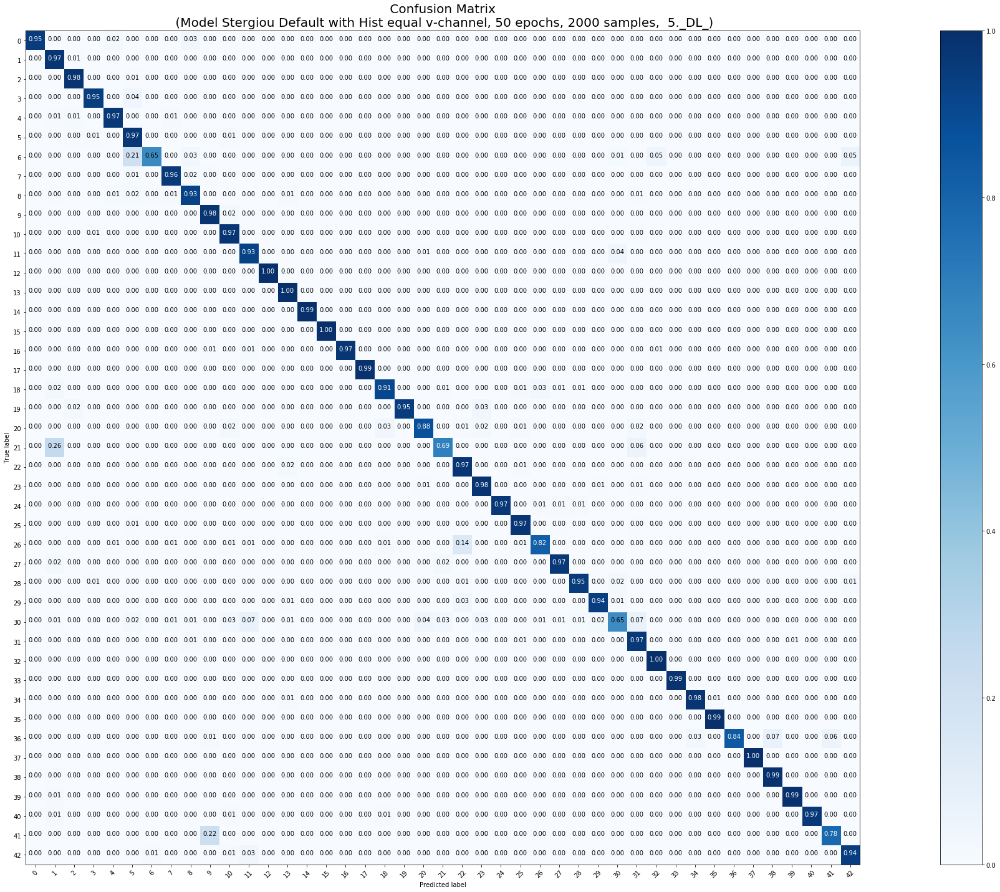

<Figure size 432x288 with 0 Axes>

In [0]:
### 2000, C, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_2000, y_tr_2000, X_test, y_test, 50, 2000)

In [0]:
downloaderCW_C(2000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 11s 2ms/step - loss: 1.0461 - acc: 0.7234 - val_loss: 0.4676 - val_acc: 0.8657
Epoch 2/50
5000/5000 [==============================] - 4s 899us/step - loss: 0.1861 - acc: 0.9488 - val_loss: 0.1984 - val_acc: 0.9420
Epoch 3/50
5000/5000 [==============================] - 4s 890us/step - loss: 0.1049 - acc: 0.9704 - val_loss: 0.2225 - val_acc: 0.9393
Epoch 4/50
5000/5000 [==============================] - 5s 906us/step - loss: 0.0711 - acc: 0.9812 - val_loss: 0.1834 - val_acc: 0.9536
Epoch 5/50
5000/5000 [==============================] - 4s 892us/step - loss: 0.0333 - acc: 0.9932 - val_loss: 0.1386 - val_acc: 0.9611
Epoch 6/50
5000/5000 [==================

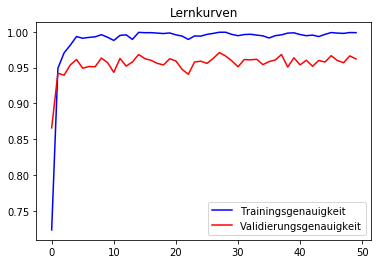

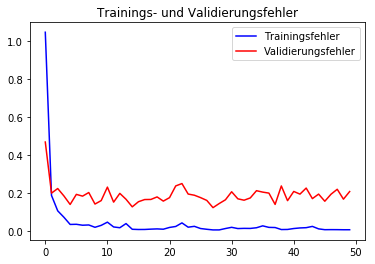

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.98      0.97      0.97       720
           2       0.93      1.00      0.96       750
           3       0.99      0.91      0.95       450
           4       1.00      0.97      0.98       660
           5       0.91      0.98      0.94       630
           6       0.99      0.74      0.85       150
           7       1.00      0.95      0.97       450
           8       0.95      0.98      0.96       450
           9       0.96      0.98      0.97       480
          10       0.99      0.97      0.98       660
          11       0.87      0.98      0.92       420
          12       0.98      0.99      0.99       690
          13       1.00      1.00      1.00       720
          14       0.98      1.00      0.99       270
          15       0.94      1.00      0.97       210
          16       1.00      0.99      1.00   

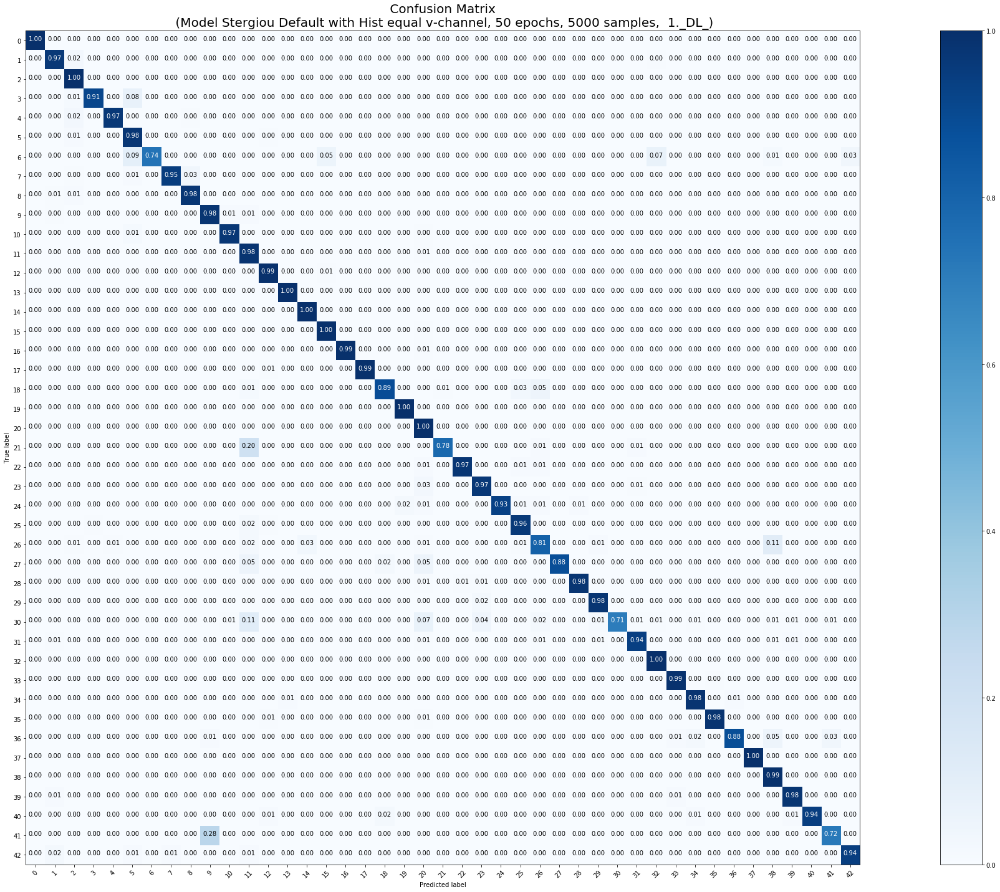

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 12s 2ms/step - loss: 1.0878 - acc: 0.7106 - val_loss: 0.3864 - val_acc: 0.8888
Epoch 2/50
5000/5000 [==============================] - 5s 902us/step - loss: 0.2256 - acc: 0.9390 - val_loss: 0.3060 - val_acc: 0.9111
Epoch 3/50
5000/5000 [==============================] - 4s 900us/step - loss: 0.1083 - acc: 0.9694 - val_loss: 0.2133 - val_acc: 0.9425
Epoch 4/50
5000/5000 [==============================] - 5s 932us/step - loss: 0.0682 - acc: 0.9814 - val_loss: 0.1751 - val_acc: 0.9527
Epoch 5/50
5000/5000 [==============================] - 5s 919us/step - loss: 0.0452 - acc: 0.9894 - val_loss: 0.1774 - val_acc: 0.9540
Epoch 6/50
5000/5000 [==================

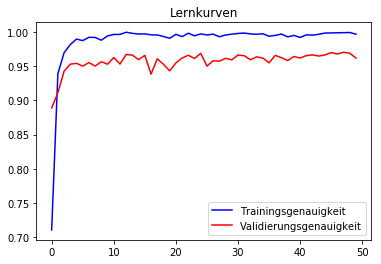

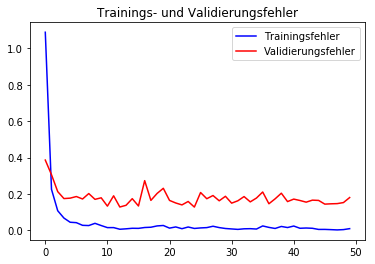

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.98      0.98       720
           2       0.92      1.00      0.96       750
           3       0.99      0.93      0.96       450
           4       0.99      0.98      0.98       660
           5       0.88      0.94      0.91       630
           6       1.00      0.71      0.83       150
           7       0.99      0.93      0.96       450
           8       0.95      0.92      0.94       450
           9       0.98      0.99      0.99       480
          10       0.99      0.98      0.98       660
          11       0.98      0.97      0.97       420
          12       0.98      0.99      0.98       690
          13       0.99      1.00      1.00       720
          14       0.99      1.00      1.00       270
          15       0.91      1.00      0.95       210
          16       1.00      0.99      0.99   

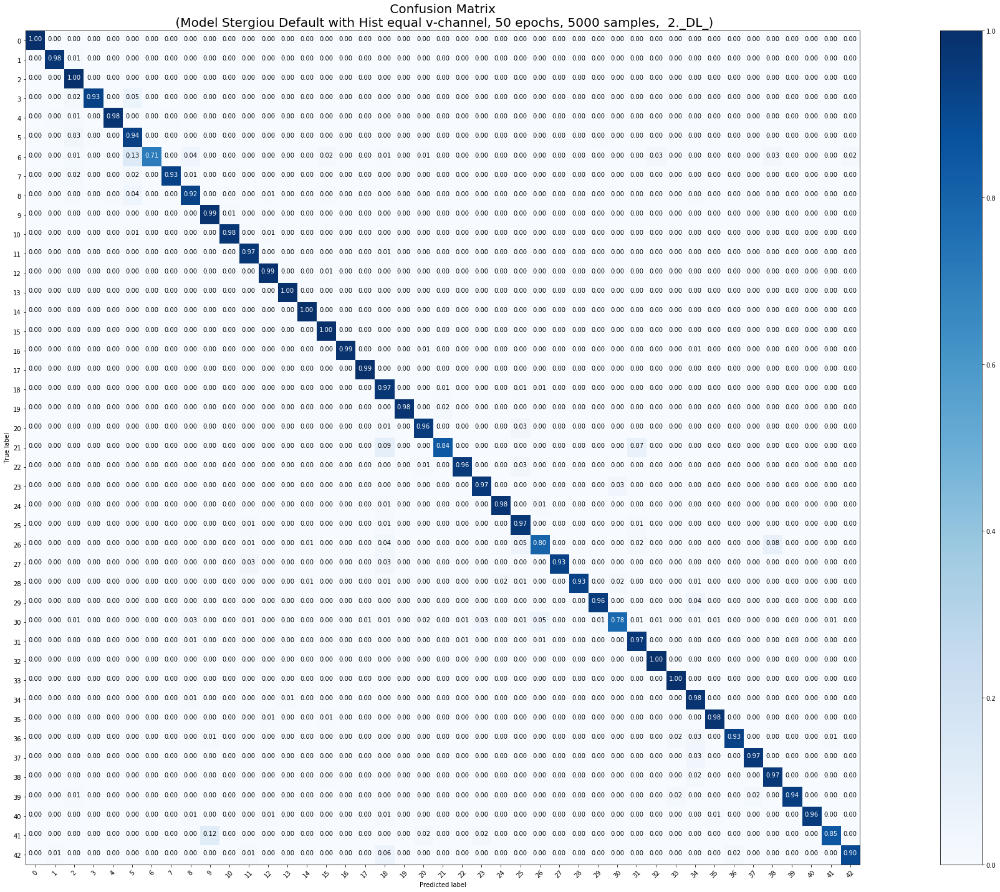

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 13s 3ms/step - loss: 1.0683 - acc: 0.7182 - val_loss: 0.4256 - val_acc: 0.8736
Epoch 2/50
5000/5000 [==============================] - 5s 933us/step - loss: 0.2173 - acc: 0.9376 - val_loss: 0.2465 - val_acc: 0.9366
Epoch 3/50
5000/5000 [==============================] - 5s 927us/step - loss: 0.1057 - acc: 0.9688 - val_loss: 0.1825 - val_acc: 0.9496
Epoch 4/50
5000/5000 [==============================] - 5s 919us/step - loss: 0.0664 - acc: 0.9806 - val_loss: 0.2037 - val_acc: 0.9485
Epoch 5/50
5000/5000 [==============================] - 5s 918us/step - loss: 0.0409 - acc: 0.9906 - val_loss: 0.1596 - val_acc: 0.9586
Epoch 6/50
5000/5000 [==================

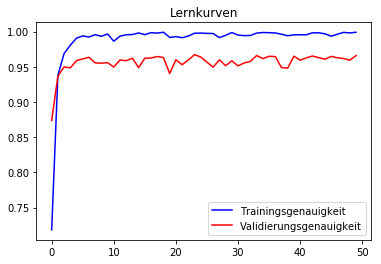

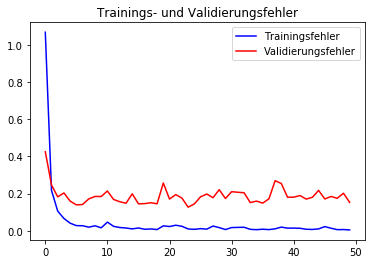

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.98      0.97      0.98       720
           2       0.99      1.00      0.99       750
           3       0.99      0.94      0.96       450
           4       0.99      0.98      0.99       660
           5       0.92      0.97      0.95       630
           6       0.99      0.78      0.87       150
           7       0.99      0.94      0.97       450
           8       0.95      0.97      0.96       450
           9       0.97      0.99      0.98       480
          10       0.97      0.99      0.98       660
          11       0.81      0.98      0.89       420
          12       0.97      0.98      0.97       690
          13       0.99      1.00      0.99       720
          14       0.99      1.00      0.99       270
          15       0.93      1.00      0.96       210
          16       0.99      0.99      0.99   

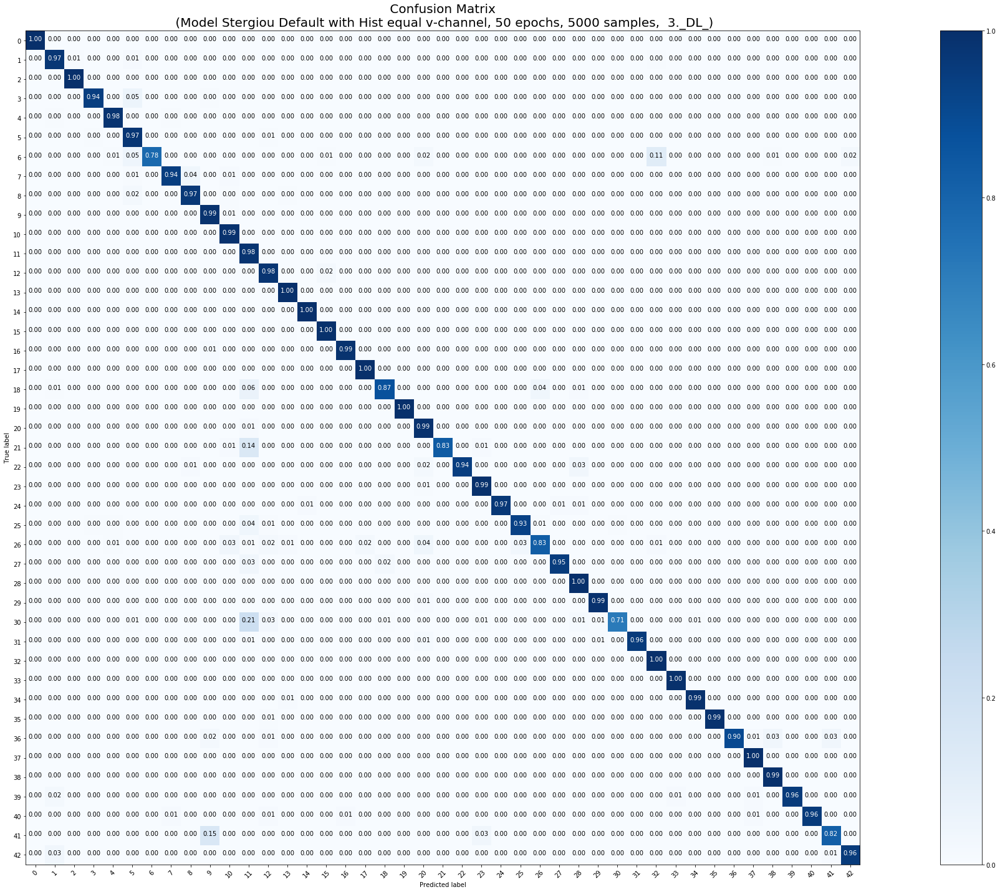

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 13s 3ms/step - loss: 1.0415 - acc: 0.7196 - val_loss: 0.3693 - val_acc: 0.8945
Epoch 2/50
5000/5000 [==============================] - 5s 949us/step - loss: 0.2285 - acc: 0.9334 - val_loss: 0.2338 - val_acc: 0.9331
Epoch 3/50
5000/5000 [==============================] - 5s 932us/step - loss: 0.1189 - acc: 0.9660 - val_loss: 0.2047 - val_acc: 0.9460
Epoch 4/50
5000/5000 [==============================] - 5s 936us/step - loss: 0.0692 - acc: 0.9798 - val_loss: 0.2059 - val_acc: 0.9492
Epoch 5/50
5000/5000 [==============================] - 5s 932us/step - loss: 0.0571 - acc: 0.9840 - val_loss: 0.2331 - val_acc: 0.9375
Epoch 6/50
5000/5000 [==================

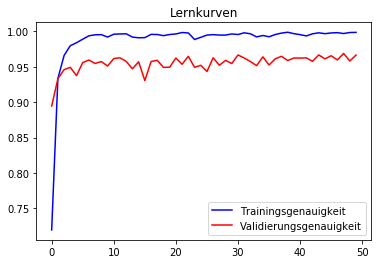

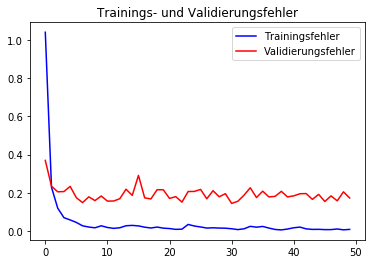

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.98      0.98      0.98       720
           2       0.99      0.99      0.99       750
           3       1.00      0.90      0.94       450
           4       1.00      0.98      0.99       660
           5       0.83      0.99      0.90       630
           6       0.99      0.73      0.84       150
           7       0.99      0.96      0.97       450
           8       0.99      0.93      0.96       450
           9       0.97      0.99      0.98       480
          10       0.97      0.98      0.97       660
          11       0.93      0.97      0.95       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.95      1.00      0.97       210
          16       0.99      0.97      0.98   

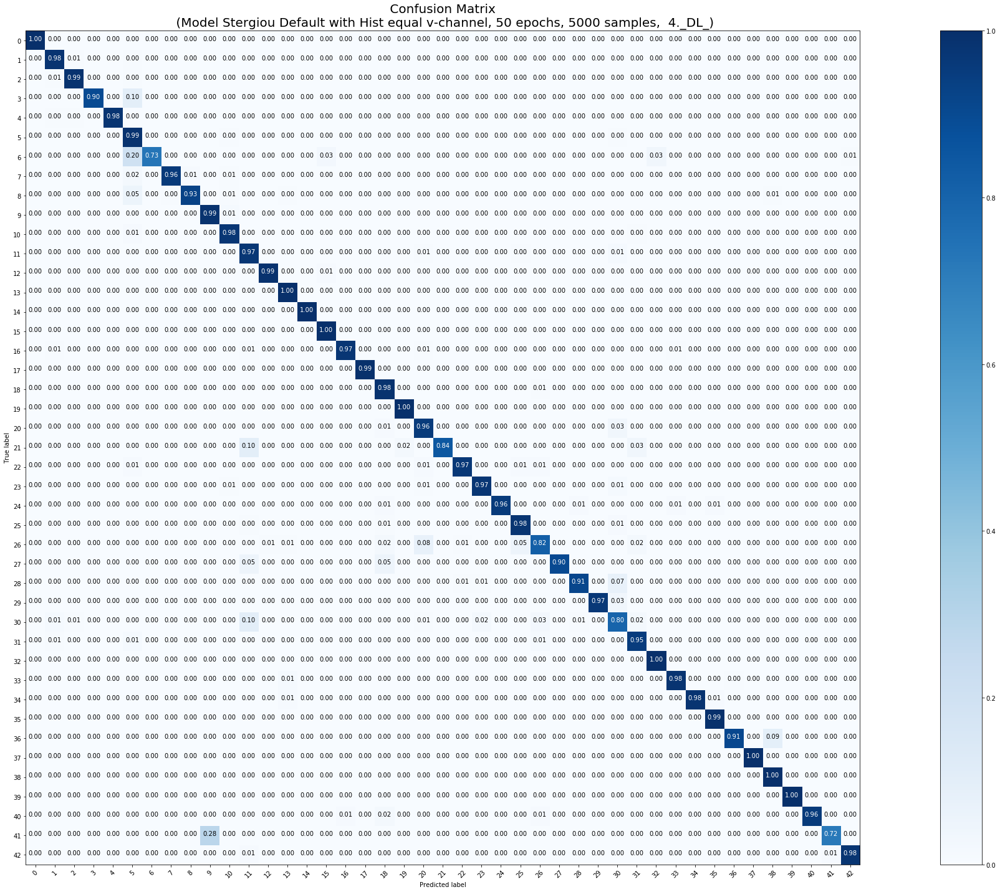

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 14s 3ms/step - loss: 1.1213 - acc: 0.7072 - val_loss: 0.3919 - val_acc: 0.8869
Epoch 2/50
5000/5000 [==============================] - 5s 941us/step - loss: 0.2085 - acc: 0.9408 - val_loss: 0.2947 - val_acc: 0.9164
Epoch 3/50
5000/5000 [==============================] - 5s 935us/step - loss: 0.0971 - acc: 0.9744 - val_loss: 0.1826 - val_acc: 0.9524
Epoch 4/50
5000/5000 [==============================] - 5s 929us/step - loss: 0.0615 - acc: 0.9848 - val_loss: 0.1951 - val_acc: 0.9494
Epoch 5/50
5000/5000 [==============================] - 5s 946us/step - loss: 0.0531 - acc: 0.9858 - val_loss: 0.2042 - val_acc: 0.9466
Epoch 6/50
5000/5000 [==================

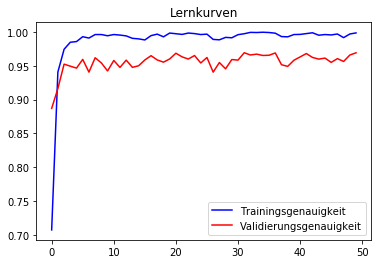

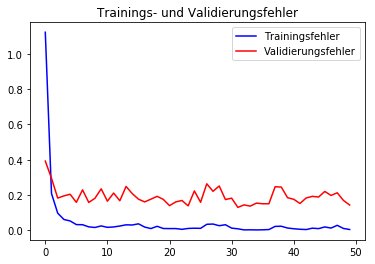

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.97      0.99      0.98       720
           2       0.98      1.00      0.99       750
           3       0.99      0.94      0.96       450
           4       0.99      0.99      0.99       660
           5       0.92      0.96      0.94       630
           6       0.99      0.75      0.86       150
           7       0.98      0.96      0.97       450
           8       0.97      0.94      0.95       450
           9       0.96      0.99      0.97       480
          10       0.99      0.98      0.99       660
          11       0.92      0.94      0.93       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      1.00       210
          16       1.00      0.96      0.98   

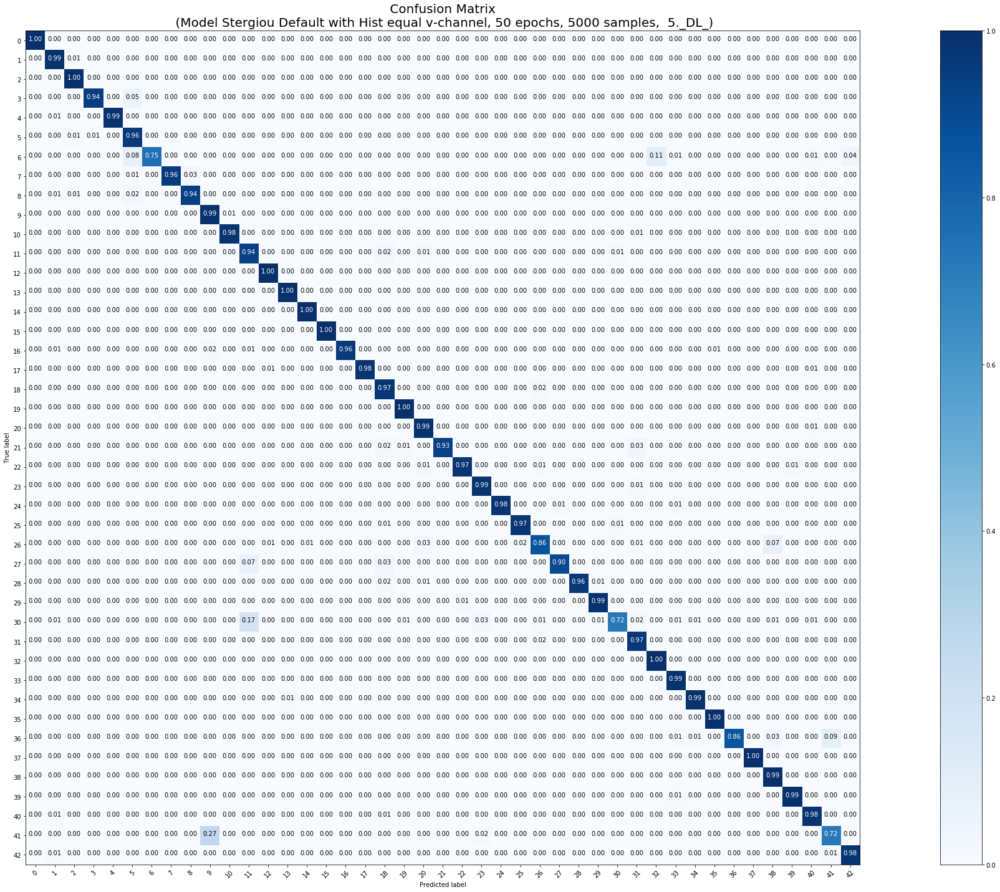

<Figure size 432x288 with 0 Axes>

In [0]:
### 5000, C, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_5000, y_tr_5000, X_test, y_test, 50, 5000)

In [0]:
downloader_C(5000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 15s 3ms/step - loss: 1.4363 - acc: 0.6074 - val_loss: 0.4765 - val_acc: 0.8529
Epoch 2/50
5000/5000 [==============================] - 5s 1ms/step - loss: 0.2726 - acc: 0.9106 - val_loss: 0.3591 - val_acc: 0.8922
Epoch 3/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.1269 - acc: 0.9564 - val_loss: 0.2303 - val_acc: 0.9392
Epoch 4/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0651 - acc: 0.9766 - val_loss: 0.2403 - val_acc: 0.9338
Epoch 5/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0484 - acc: 0.9826 - val_loss: 0.1898 - val_acc: 0.9462
Epoch 6/50
5000/5000 [====================

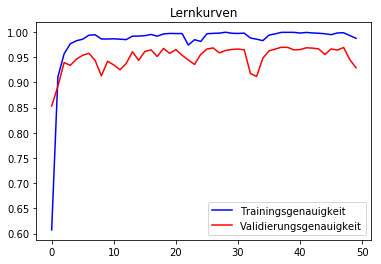

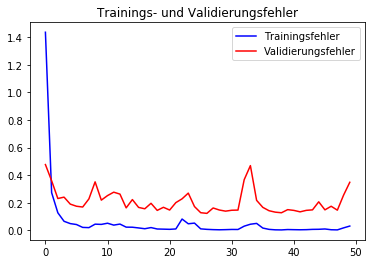

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       1.00      0.73      0.84       720
           2       0.96      0.99      0.97       750
           3       0.95      0.97      0.96       450
           4       0.99      0.94      0.96       660
           5       0.94      0.92      0.93       630
           6       0.88      0.87      0.87       150
           7       0.98      0.93      0.95       450
           8       0.95      0.91      0.93       450
           9       0.94      0.97      0.96       480
          10       0.98      0.95      0.96       660
          11       0.93      0.97      0.95       420
          12       0.95      0.98      0.96       690
          13       0.99      0.99      0.99       720
          14       1.00      0.97      0.99       270
          15       0.80      0.98      0.88       210
          16       1.00      0.97      0.99   

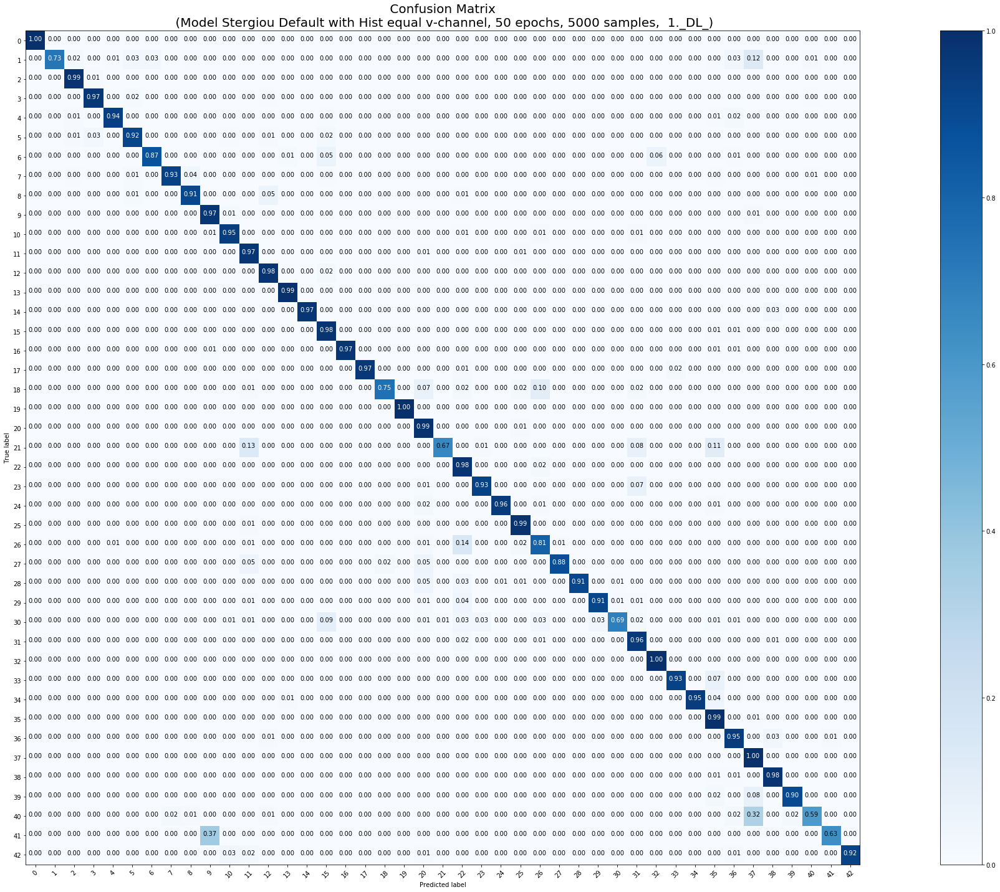

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 15s 3ms/step - loss: 1.6113 - acc: 0.5760 - val_loss: 0.7490 - val_acc: 0.7568
Epoch 2/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.3412 - acc: 0.8880 - val_loss: 0.3343 - val_acc: 0.9045
Epoch 3/50
5000/5000 [==============================] - 5s 1ms/step - loss: 0.1622 - acc: 0.9482 - val_loss: 0.2294 - val_acc: 0.9348
Epoch 4/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0730 - acc: 0.9754 - val_loss: 0.2369 - val_acc: 0.9390
Epoch 5/50
5000/5000 [==============================] - 5s 1ms/step - loss: 0.0637 - acc: 0.9832 - val_loss: 0.1736 - val_acc: 0.9519
Epoch 6/50
5000/5000 [====================

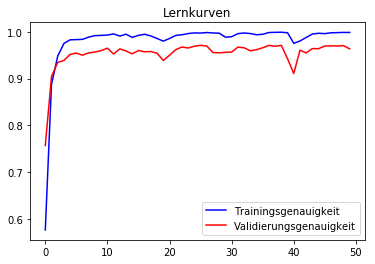

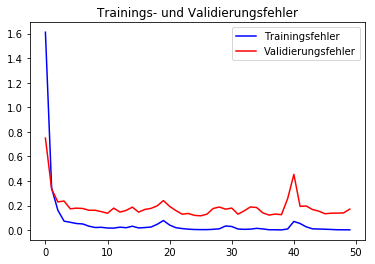

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.98      0.98        60
           1       0.99      0.99      0.99       720
           2       0.98      0.99      0.98       750
           3       0.86      0.98      0.92       450
           4       1.00      0.97      0.99       660
           5       0.88      0.88      0.88       630
           6       0.99      0.67      0.80       150
           7       0.99      0.96      0.97       450
           8       0.97      0.95      0.96       450
           9       0.97      0.99      0.98       480
          10       0.99      0.98      0.98       660
          11       0.91      0.99      0.95       420
          12       0.98      0.99      0.98       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.95      0.99      0.97       210
          16       0.99      0.98      0.99   

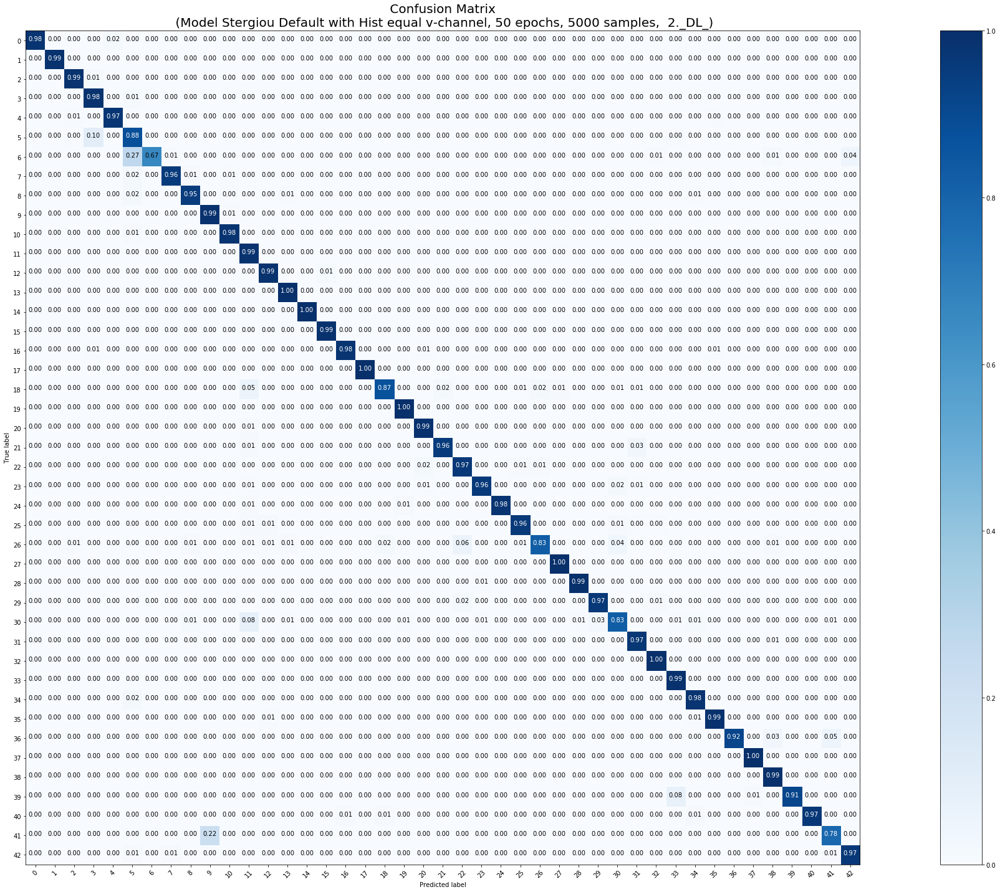

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 15s 3ms/step - loss: 1.5483 - acc: 0.5980 - val_loss: 0.4685 - val_acc: 0.8660
Epoch 2/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.3257 - acc: 0.8944 - val_loss: 0.3629 - val_acc: 0.8903
Epoch 3/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.1763 - acc: 0.9386 - val_loss: 0.2212 - val_acc: 0.9420
Epoch 4/50
5000/5000 [==============================] - 5s 1ms/step - loss: 0.0914 - acc: 0.9678 - val_loss: 0.2071 - val_acc: 0.9428
Epoch 5/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0942 - acc: 0.9656 - val_loss: 0.2156 - val_acc: 0.9397
Epoch 6/50
5000/5000 [====================

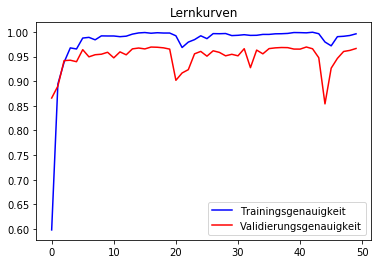

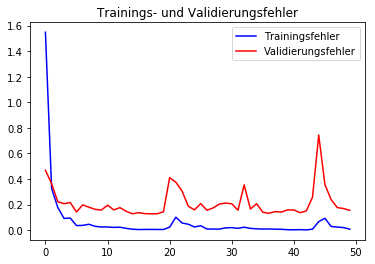

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.97      0.97        60
           1       0.99      0.97      0.98       720
           2       0.96      1.00      0.98       750
           3       1.00      0.94      0.97       450
           4       0.99      0.97      0.98       660
           5       0.93      0.97      0.95       630
           6       0.97      0.73      0.84       150
           7       0.99      0.95      0.97       450
           8       0.97      0.95      0.96       450
           9       0.97      0.98      0.97       480
          10       0.98      0.97      0.97       660
          11       0.92      0.96      0.94       420
          12       0.99      1.00      1.00       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.99      0.98      0.98   

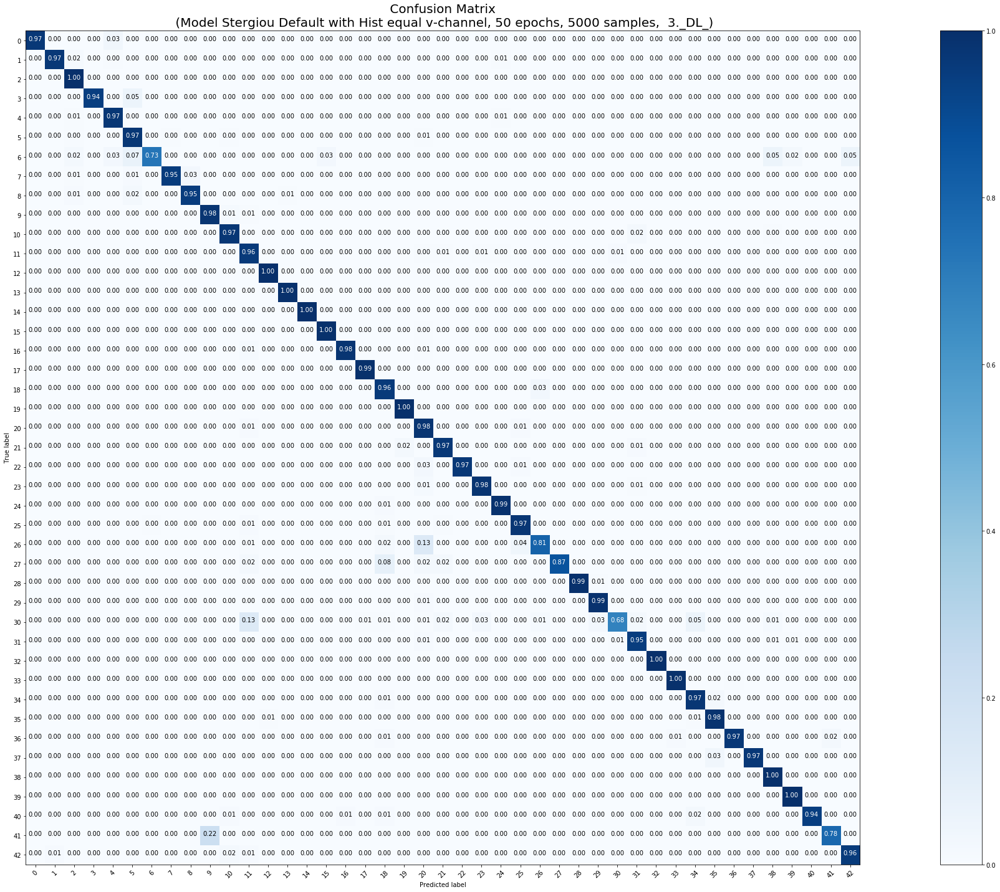

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 16s 3ms/step - loss: 1.5676 - acc: 0.5846 - val_loss: 0.5112 - val_acc: 0.8483
Epoch 2/50
5000/5000 [==============================] - 5s 1ms/step - loss: 0.2847 - acc: 0.9078 - val_loss: 0.3812 - val_acc: 0.8909
Epoch 3/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.1478 - acc: 0.9486 - val_loss: 0.2262 - val_acc: 0.9369
Epoch 4/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0904 - acc: 0.9704 - val_loss: 0.1845 - val_acc: 0.9481
Epoch 5/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0450 - acc: 0.9832 - val_loss: 0.1755 - val_acc: 0.9533
Epoch 6/50
5000/5000 [====================

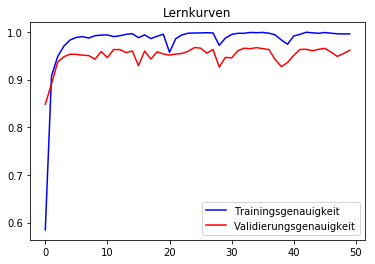

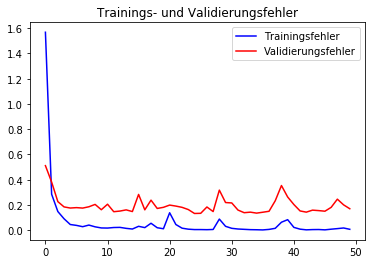

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       1.00      0.93      0.96       720
           2       0.92      1.00      0.96       750
           3       1.00      0.93      0.97       450
           4       0.99      0.98      0.98       660
           5       0.91      0.96      0.94       630
           6       1.00      0.75      0.85       150
           7       0.98      0.95      0.96       450
           8       0.94      0.92      0.93       450
           9       0.97      0.96      0.97       480
          10       0.94      0.98      0.96       660
          11       0.97      0.95      0.96       420
          12       0.99      0.99      0.99       690
          13       1.00      1.00      1.00       720
          14       0.99      1.00      1.00       270
          15       0.97      1.00      0.98       210
          16       0.99      0.97      0.98   

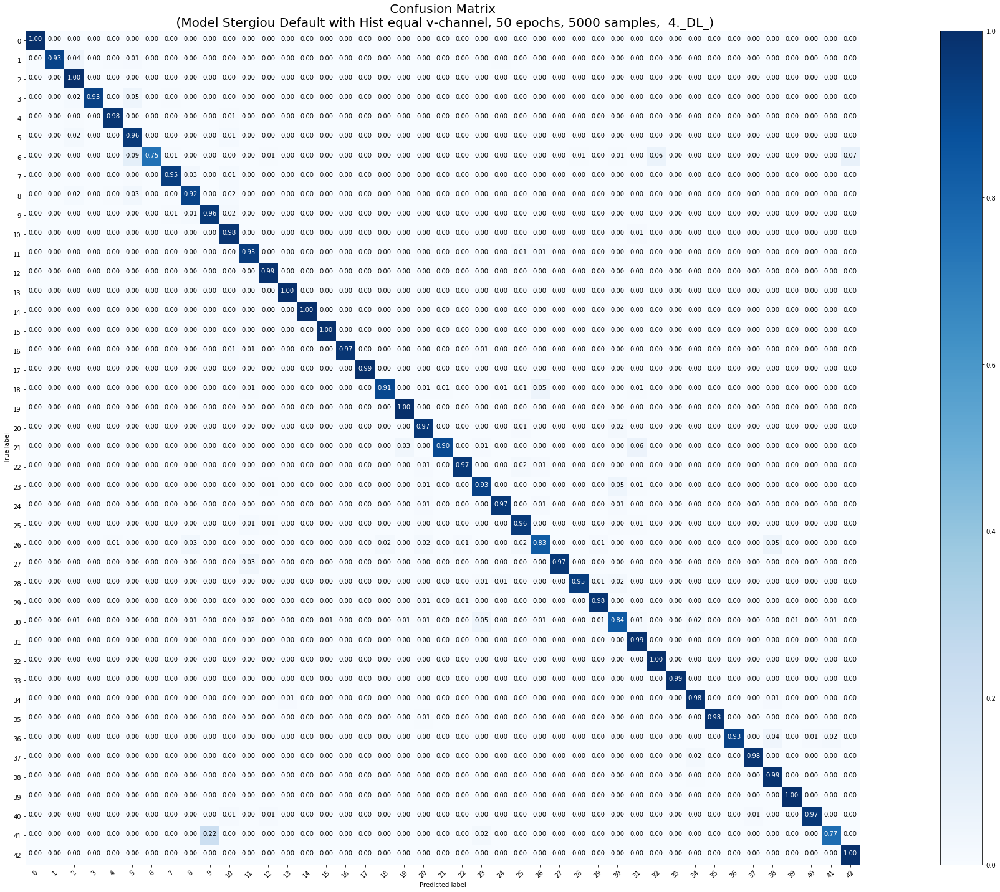

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 5000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 5000 samples, validate on 12630 samples
Epoch 1/50
5000/5000 [==============================] - 16s 3ms/step - loss: 1.6095 - acc: 0.5818 - val_loss: 0.6047 - val_acc: 0.8198
Epoch 2/50
5000/5000 [==============================] - 5s 1ms/step - loss: 0.3331 - acc: 0.8908 - val_loss: 0.3081 - val_acc: 0.9109
Epoch 3/50
5000/5000 [==============================] - 5s 1ms/step - loss: 0.1235 - acc: 0.9568 - val_loss: 0.2251 - val_acc: 0.9382
Epoch 4/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0722 - acc: 0.9746 - val_loss: 0.1725 - val_acc: 0.9544
Epoch 5/50
5000/5000 [==============================] - 6s 1ms/step - loss: 0.0463 - acc: 0.9826 - val_loss: 0.1931 - val_acc: 0.9466
Epoch 6/50
5000/5000 [====================

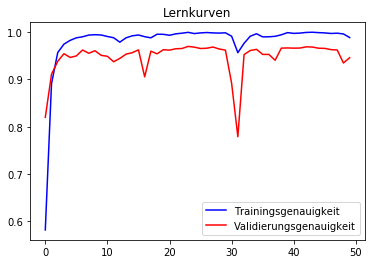

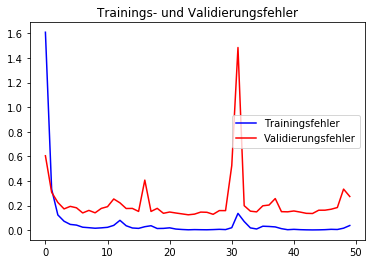

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      0.97      0.97        60
           1       0.97      0.97      0.97       720
           2       0.91      0.99      0.95       750
           3       0.99      0.86      0.92       450
           4       0.97      0.97      0.97       660
           5       0.83      0.97      0.90       630
           6       1.00      0.60      0.75       150
           7       1.00      0.86      0.92       450
           8       0.98      0.90      0.94       450
           9       0.90      0.97      0.94       480
          10       0.93      0.98      0.95       660
          11       0.95      0.91      0.93       420
          12       1.00      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      0.98      0.99       270
          15       0.98      0.96      0.97       210
          16       0.99      0.97      0.98   

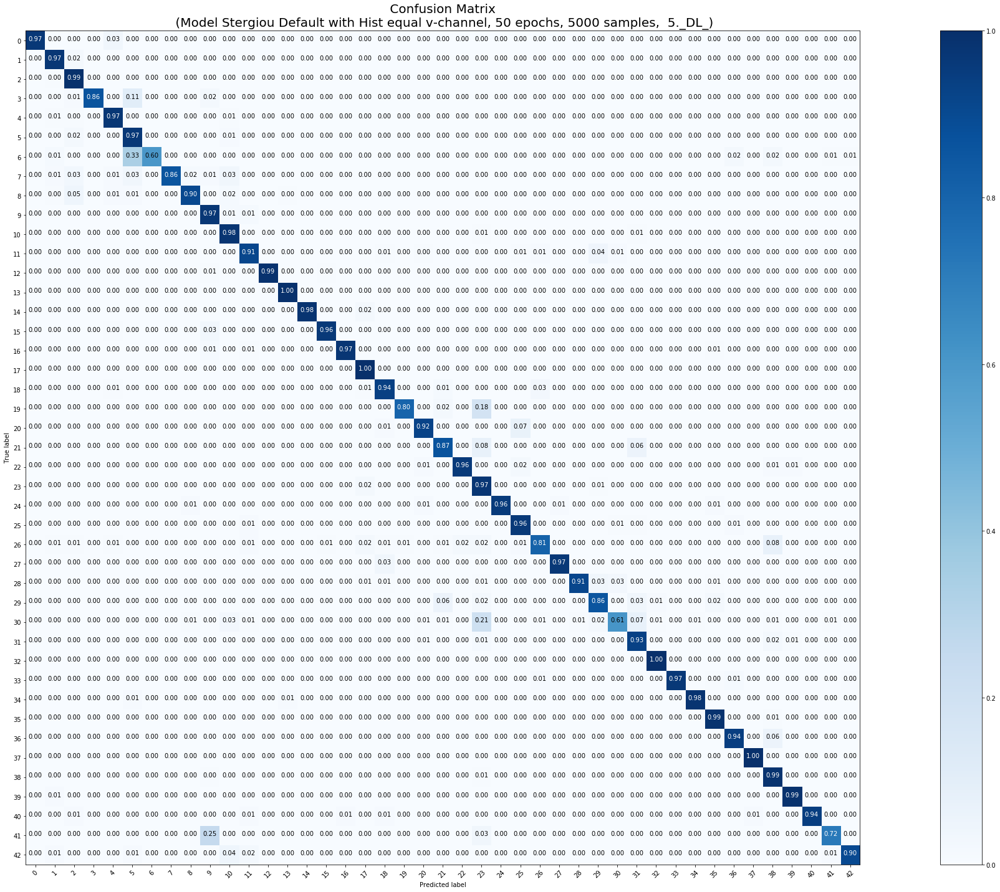

<Figure size 432x288 with 0 Axes>

In [0]:
### 5000, C, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_5000, y_tr_5000, X_test, y_test, 50, 5000)

In [0]:
downloaderCW_C(5000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
categorical crossentropy


Training ohne Klassengewichte beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 13s 1ms/step - loss: 0.6607 - acc: 0.8232 - val_loss: 0.2414 - val_acc: 0.9320
Epoch 2/50
10000/10000 [==============================] - 6s 582us/step - loss: 0.1235 - acc: 0.9654 - val_loss: 0.1634 - val_acc: 0.9571
Epoch 3/50
10000/10000 [==============================] - 6s 576us/step - loss: 0.0648 - acc: 0.9821 - val_loss: 0.2559 - val_acc: 0.9233
Epoch 4/50
10000/10000 [==============================] - 6s 587us/step - loss: 0

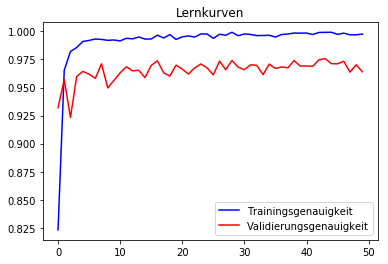

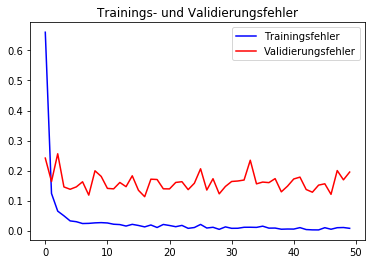

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.94      1.00      0.97        60
           1       0.99      0.97      0.98       720
           2       0.95      1.00      0.98       750
           3       0.99      0.91      0.95       450
           4       1.00      0.98      0.99       660
           5       0.92      0.96      0.94       630
           6       1.00      0.69      0.82       150
           7       0.97      1.00      0.98       450
           8       1.00      0.91      0.95       450
           9       1.00      0.99      0.99       480
          10       0.99      0.98      0.98       660
          11       0.99      0.99      0.99       420
          12       0.91      1.00      0.95       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       1.00      1.00      1.00       210
          16       1.00      0.97      0.99   

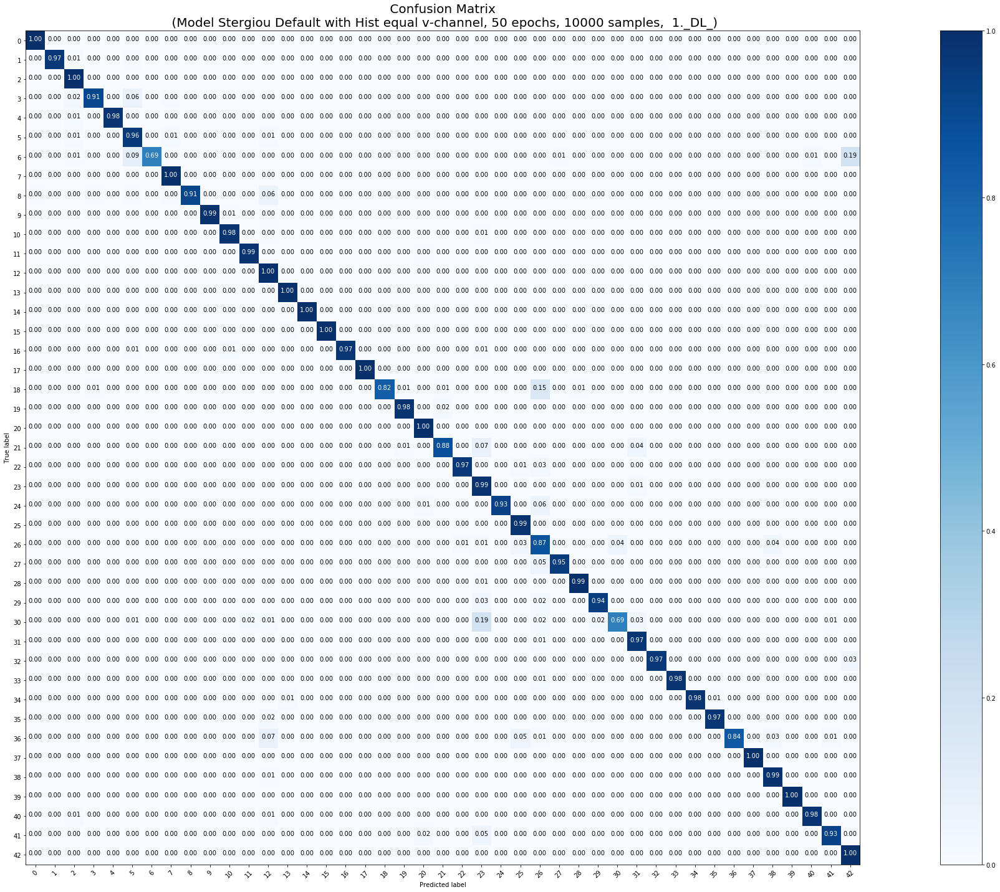

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 8s 759us/step - loss: 0.6900 - acc: 0.8160 - val_loss: 0.2384 - val_acc: 0.9359
Epoch 2/50
10000/10000 [==============================] - 6s 593us/step - loss: 0.1271 - acc: 0.9665 - val_loss: 0.1912 - val_acc: 0.9445
Epoch 3/50
10000/10000 [==============================] - 6s 580us/step - loss: 0.0698 - acc: 0.9796 - val_loss: 0.1513 - val_acc: 0.9584
Epoch 4/50
10000/10000 [==============================] - 6s 589us/step - loss: 0.0465 - acc: 0.9868 - val_loss: 0.1777 - val_acc: 0.9530
Epoch 5/50
10000/10000 [==============================] - 6s 607us/step - loss: 0.0318 - acc: 0.9907 - val_loss: 0.1285 - val_acc: 0.9643
Epoch 6/50
10000/10000 [===

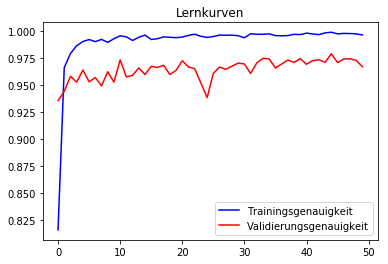

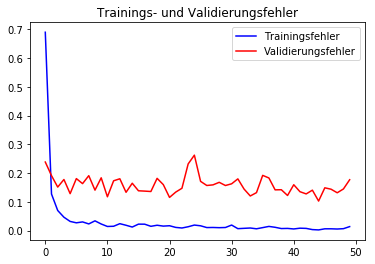

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.94      1.00      0.97        60
           1       0.98      0.99      0.98       720
           2       0.99      1.00      0.99       750
           3       1.00      0.90      0.95       450
           4       0.97      0.99      0.98       660
           5       0.91      0.95      0.93       630
           6       1.00      0.69      0.82       150
           7       0.98      0.93      0.95       450
           8       0.91      0.96      0.94       450
           9       0.99      0.98      0.98       480
          10       0.96      0.99      0.98       660
          11       0.96      0.99      0.97       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.96      0.99      0.97       210
          16       0.99      0.98      0.99   

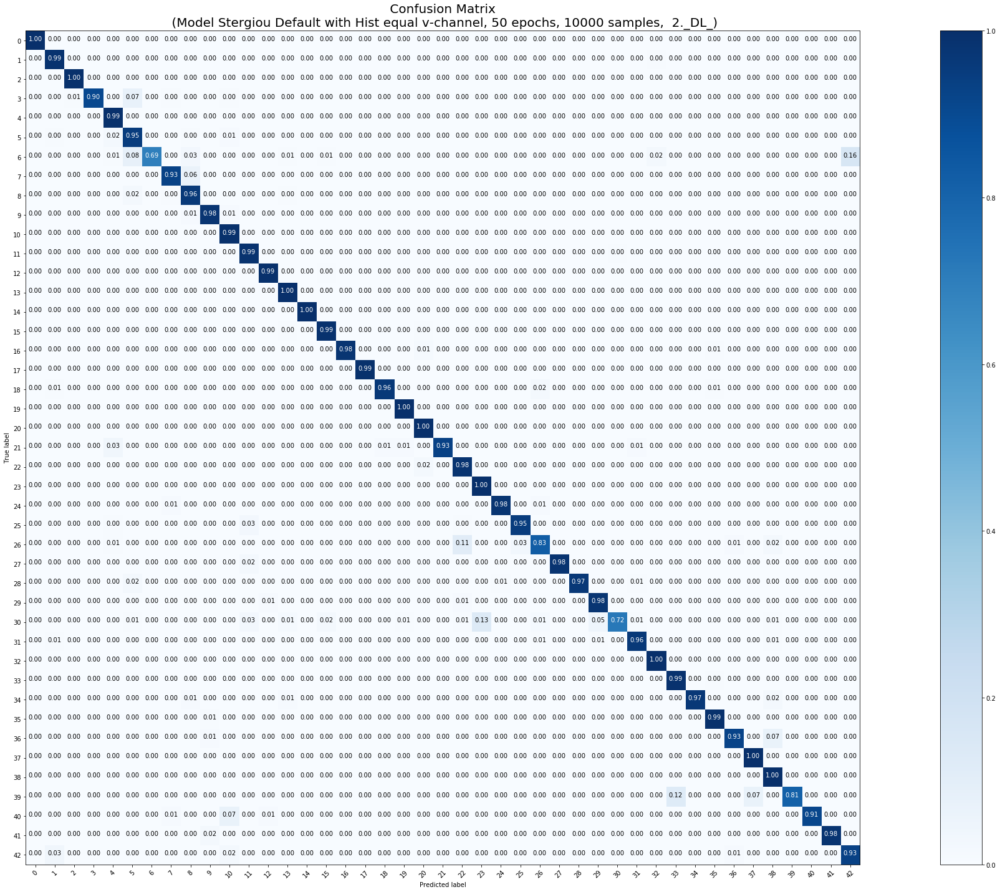

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 8s 792us/step - loss: 0.6482 - acc: 0.8255 - val_loss: 0.2200 - val_acc: 0.9363
Epoch 2/50
10000/10000 [==============================] - 6s 601us/step - loss: 0.1132 - acc: 0.9667 - val_loss: 0.1779 - val_acc: 0.9517
Epoch 3/50
10000/10000 [==============================] - 6s 596us/step - loss: 0.0600 - acc: 0.9848 - val_loss: 0.1532 - val_acc: 0.9598
Epoch 4/50
10000/10000 [==============================] - 6s 593us/step - loss: 0.0508 - acc: 0.9857 - val_loss: 0.2443 - val_acc: 0.9347
Epoch 5/50
10000/10000 [==============================] - 6s 589us/step - loss: 0.0371 - acc: 0.9889 - val_loss: 0.1636 - val_acc: 0.9579
Epoch 6/50
10000/10000 [===

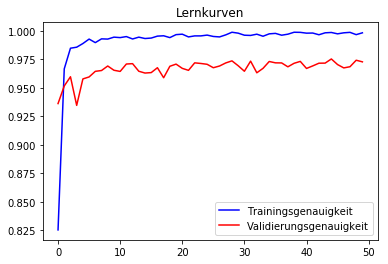

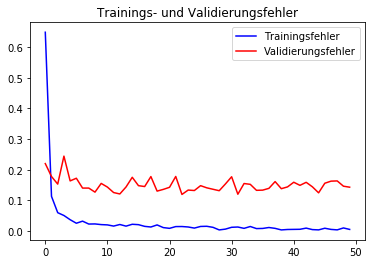

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       1.00      0.98      0.99       720
           2       0.97      1.00      0.99       750
           3       0.99      0.93      0.96       450
           4       1.00      0.98      0.99       660
           5       0.95      0.97      0.96       630
           6       0.99      0.81      0.89       150
           7       0.98      0.97      0.98       450
           8       0.98      0.93      0.96       450
           9       0.97      0.98      0.97       480
          10       0.99      0.97      0.98       660
          11       0.97      0.97      0.97       420
          12       0.99      0.99      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.99      0.99      0.99       210
          16       0.99      0.99      0.99   

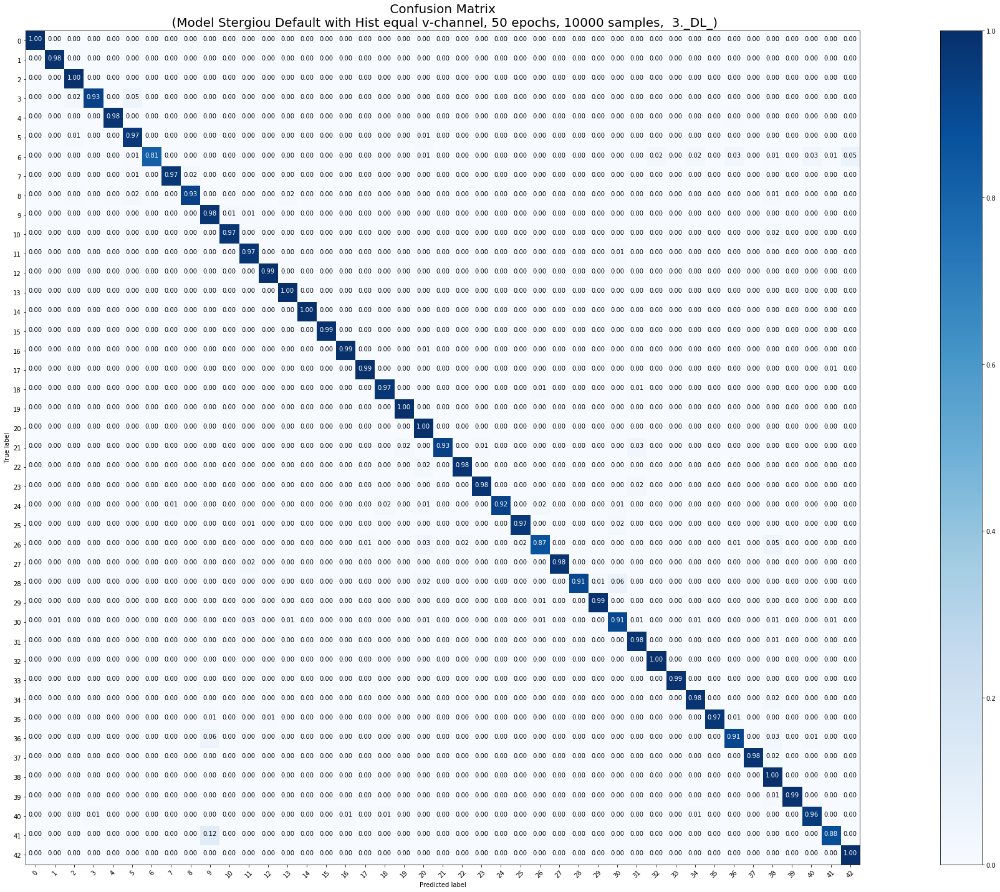

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 8s 835us/step - loss: 0.6598 - acc: 0.8205 - val_loss: 0.2516 - val_acc: 0.9285
Epoch 2/50
10000/10000 [==============================] - 6s 578us/step - loss: 0.1264 - acc: 0.9655 - val_loss: 0.1618 - val_acc: 0.9577
Epoch 3/50
10000/10000 [==============================] - 6s 588us/step - loss: 0.0631 - acc: 0.9831 - val_loss: 0.1526 - val_acc: 0.9602
Epoch 4/50
10000/10000 [==============================] - 6s 595us/step - loss: 0.0519 - acc: 0.9847 - val_loss: 0.1447 - val_acc: 0.9610
Epoch 5/50
10000/10000 [==============================] - 6s 587us/step - loss: 0.0358 - acc: 0.9902 - val_loss: 0.1458 - val_acc: 0.9625
Epoch 6/50
10000/10000 [===

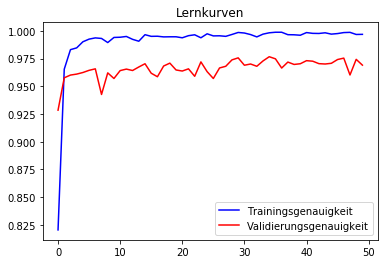

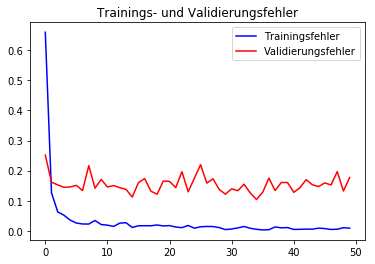

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       1.00      0.99      0.99       720
           2       1.00      0.99      0.99       750
           3       0.97      0.93      0.95       450
           4       0.98      0.99      0.98       660
           5       0.92      0.97      0.95       630
           6       1.00      0.72      0.84       150
           7       0.99      0.97      0.98       450
           8       0.97      0.95      0.96       450
           9       0.98      1.00      0.99       480
          10       0.98      0.98      0.98       660
          11       0.91      0.97      0.94       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.95      1.00      0.97       210
          16       0.99      0.99      0.99   

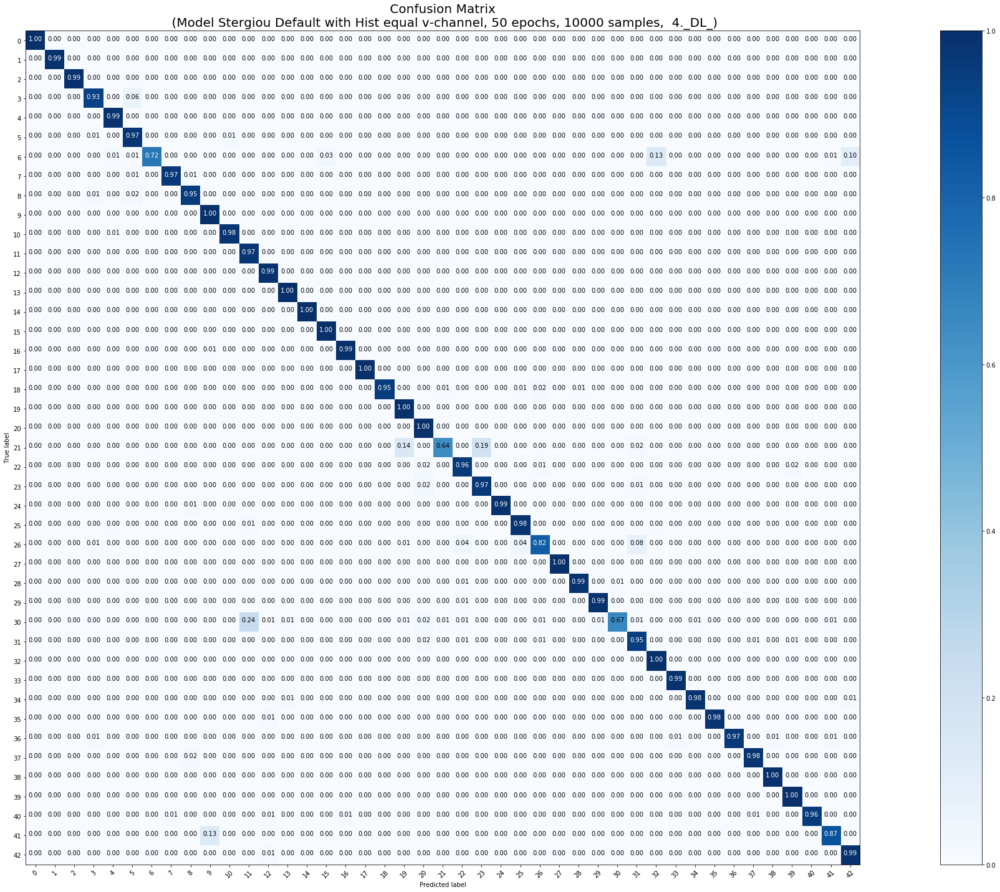

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 9s 874us/step - loss: 0.6914 - acc: 0.8133 - val_loss: 0.3496 - val_acc: 0.9035
Epoch 2/50
10000/10000 [==============================] - 6s 593us/step - loss: 0.1197 - acc: 0.9667 - val_loss: 0.2171 - val_acc: 0.9395
Epoch 3/50
10000/10000 [==============================] - 6s 612us/step - loss: 0.0619 - acc: 0.9824 - val_loss: 0.1286 - val_acc: 0.9657
Epoch 4/50
10000/10000 [==============================] - 6s 596us/step - loss: 0.0395 - acc: 0.9905 - val_loss: 0.1355 - val_acc: 0.9635
Epoch 5/50
10000/10000 [==============================] - 6s 614us/step - loss: 0.0374 - acc: 0.9883 - val_loss: 0.1509 - val_acc: 0.9628
Epoch 6/50
10000/10000 [===

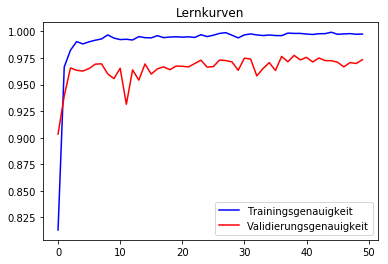

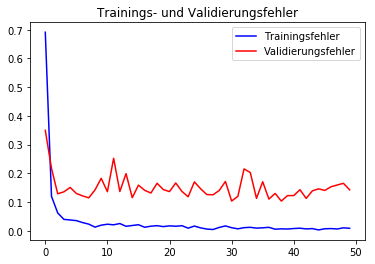

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       0.98      0.94      0.96       450
           4       0.98      1.00      0.99       660
           5       0.92      0.98      0.95       630
           6       1.00      0.74      0.85       150
           7       0.98      0.98      0.98       450
           8       0.99      0.94      0.96       450
           9       0.98      0.99      0.98       480
          10       0.99      0.99      0.99       660
          11       0.96      0.98      0.97       420
          12       0.99      1.00      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.93      1.00      0.96       210
          16       0.94      0.98      0.96   

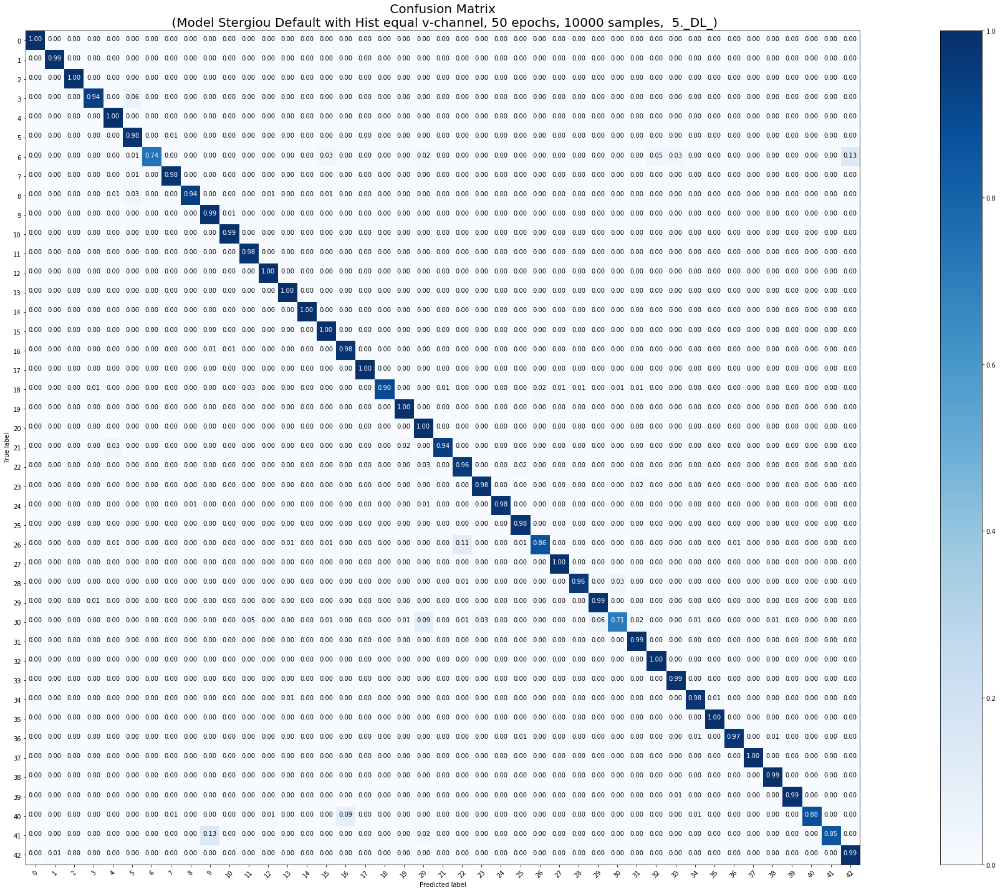

<Figure size 432x288 with 0 Axes>

In [0]:
### 10000, C, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_10000, y_tr_10000, X_test, y_test, 50, 10000)

In [0]:
downloader_C(10000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
sparse categorical crossentropy


Training mit Klassengewichten beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 14s 1ms/step - loss: 0.9906 - acc: 0.7403 - val_loss: 0.3387 - val_acc: 0.9012
Epoch 2/50
10000/10000 [==============================] - 6s 614us/step - loss: 0.1627 - acc: 0.9473 - val_loss: 0.2398 - val_acc: 0.9341
Epoch 3/50
10000/10000 [==============================] - 6s 615us/step - loss: 0.0882 - acc: 0.9699 - val_loss: 0.1661 - val_acc: 0.9542
Epoch 4/50
10000/10000 [==============================] - 6s 610us/step - l

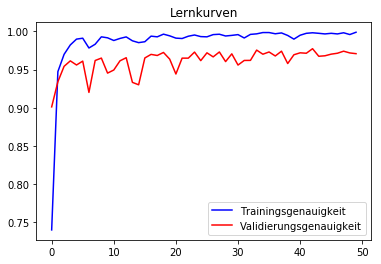

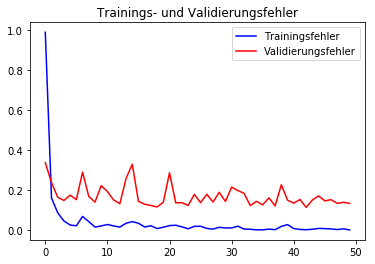

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      0.98      0.98        60
           1       0.98      0.99      0.98       720
           2       0.99      0.99      0.99       750
           3       0.99      0.93      0.96       450
           4       0.99      0.98      0.98       660
           5       0.93      0.97      0.95       630
           6       0.99      0.77      0.86       150
           7       1.00      0.97      0.98       450
           8       0.94      0.96      0.95       450
           9       0.99      0.98      0.98       480
          10       0.96      0.99      0.98       660
          11       0.97      0.97      0.97       420
          12       1.00      1.00      1.00       690
          13       0.98      1.00      0.99       720
          14       0.99      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       1.00      0.98      0.99   

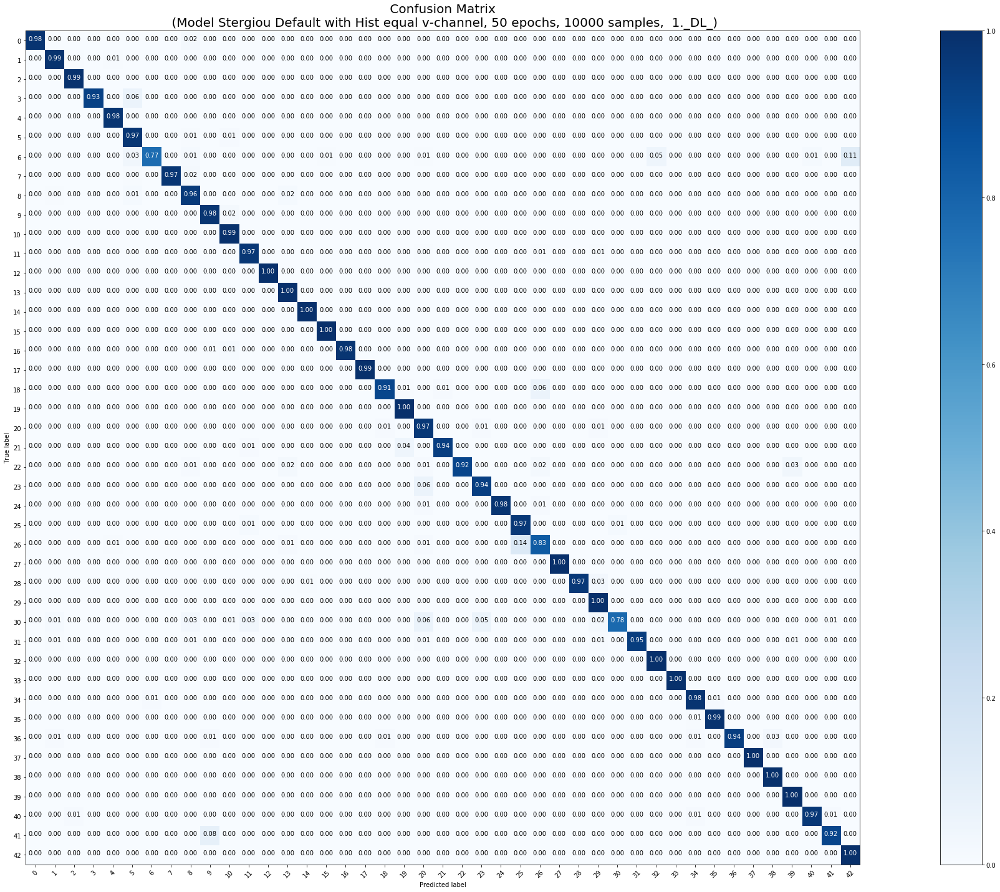

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 8s 804us/step - loss: 0.9041 - acc: 0.7546 - val_loss: 0.2669 - val_acc: 0.9254
Epoch 2/50
10000/10000 [==============================] - 6s 637us/step - loss: 0.1593 - acc: 0.9456 - val_loss: 0.1804 - val_acc: 0.9481
Epoch 3/50
10000/10000 [==============================] - 6s 633us/step - loss: 0.0845 - acc: 0.9699 - val_loss: 0.1562 - val_acc: 0.9593
Epoch 4/50
10000/10000 [==============================] - 6s 632us/step - loss: 0.0747 - acc: 0.9737 - val_loss: 0.1722 - val_acc: 0.9543
Epoch 5/50
10000/10000 [==============================] - 6s 628us/step - loss: 0.0421 - acc: 0.9846 - val_loss: 0.1336 - val_acc: 0.9641
Epoch 6/50
10000/1000

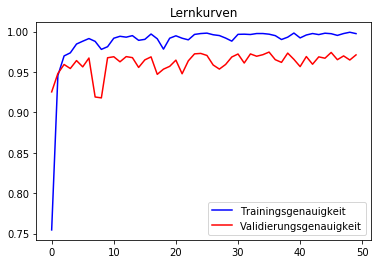

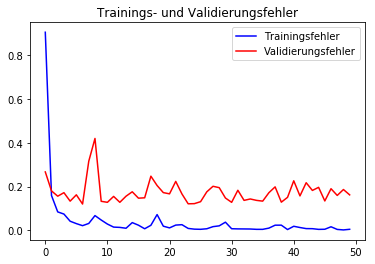

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.98      1.00      0.99       720
           2       0.99      0.99      0.99       750
           3       0.99      0.94      0.97       450
           4       1.00      0.98      0.99       660
           5       0.88      0.98      0.93       630
           6       1.00      0.66      0.80       150
           7       0.99      0.96      0.97       450
           8       0.96      0.94      0.95       450
           9       0.97      0.99      0.98       480
          10       0.98      0.99      0.99       660
          11       0.93      0.98      0.95       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      1.00       720
          14       0.99      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.98      0.99      0.98   

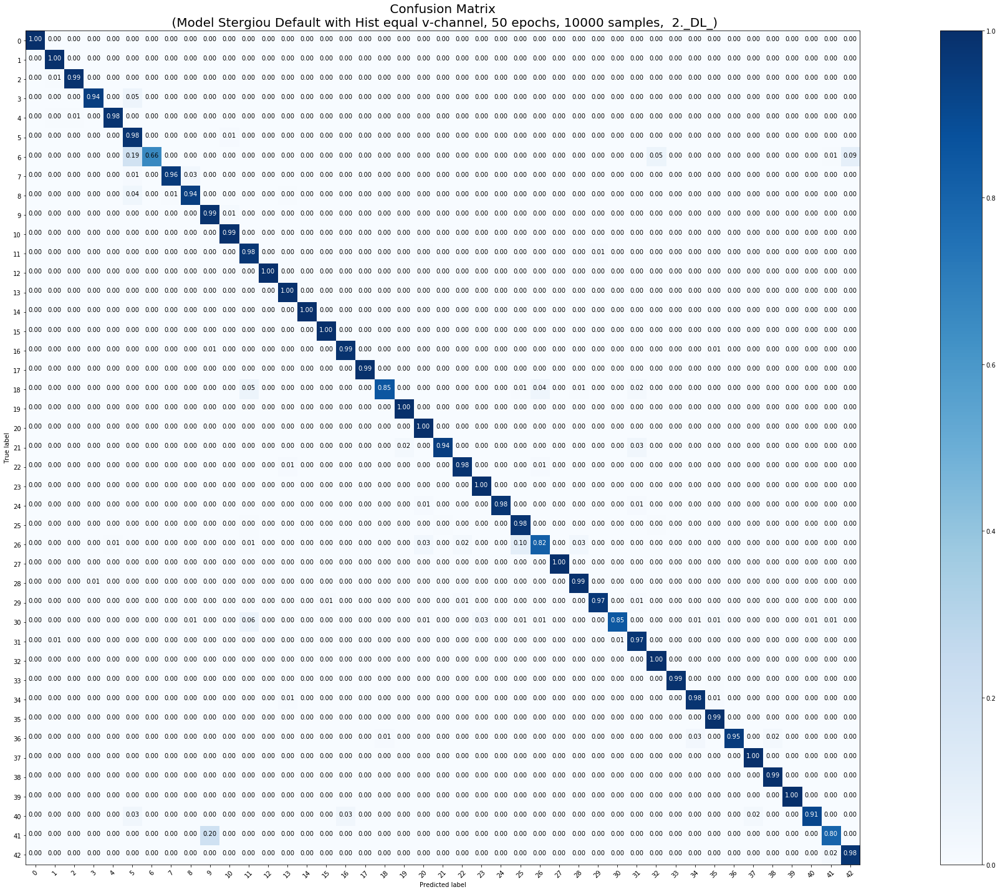

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 9s 866us/step - loss: 0.9845 - acc: 0.7316 - val_loss: 0.3486 - val_acc: 0.9034
Epoch 2/50
10000/10000 [==============================] - 6s 633us/step - loss: 0.1654 - acc: 0.9489 - val_loss: 0.1836 - val_acc: 0.9511
Epoch 3/50
10000/10000 [==============================] - 6s 641us/step - loss: 0.0765 - acc: 0.9743 - val_loss: 0.1973 - val_acc: 0.9436
Epoch 4/50
10000/10000 [==============================] - 6s 628us/step - loss: 0.0623 - acc: 0.9793 - val_loss: 0.1873 - val_acc: 0.9500
Epoch 5/50
10000/10000 [==============================] - 6s 630us/step - loss: 0.0408 - acc: 0.9833 - val_loss: 0.1830 - val_acc: 0.9534
Epoch 6/50
10000/1000

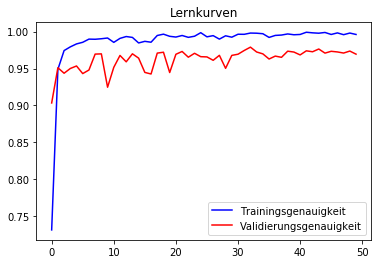

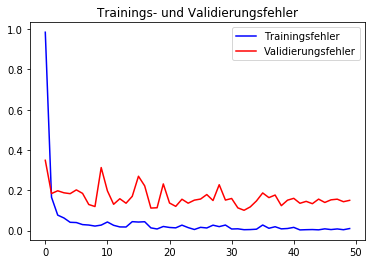

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      0.97      0.97        60
           1       0.98      0.99      0.99       720
           2       0.98      0.99      0.99       750
           3       0.99      0.96      0.98       450
           4       1.00      0.98      0.99       660
           5       0.93      0.96      0.95       630
           6       0.99      0.73      0.84       150
           7       0.97      0.98      0.98       450
           8       0.96      0.96      0.96       450
           9       0.98      0.99      0.98       480
          10       0.99      0.97      0.98       660
          11       1.00      0.96      0.98       420
          12       0.99      1.00      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.99      1.00      0.99       210
          16       1.00      0.99      0.99   

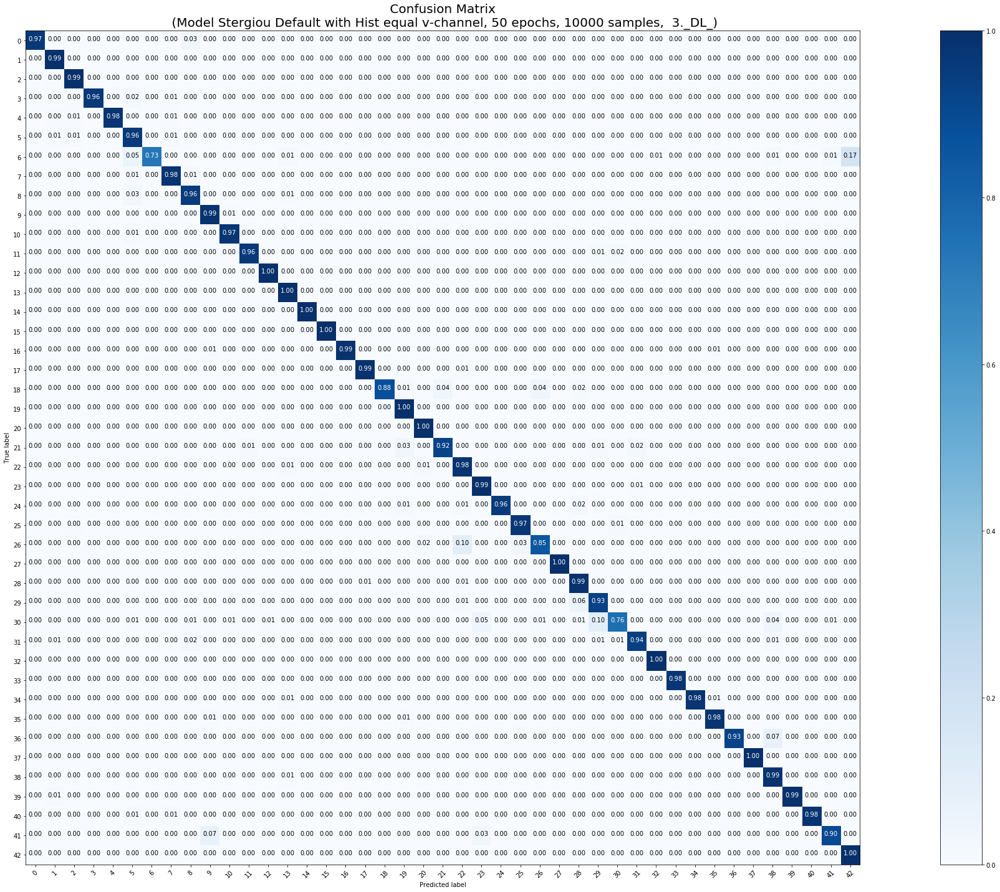

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 9s 875us/step - loss: 0.9682 - acc: 0.7344 - val_loss: 0.2907 - val_acc: 0.9180
Epoch 2/50
10000/10000 [==============================] - 6s 629us/step - loss: 0.1643 - acc: 0.9478 - val_loss: 0.2768 - val_acc: 0.9196
Epoch 3/50
10000/10000 [==============================] - 6s 630us/step - loss: 0.0822 - acc: 0.9703 - val_loss: 0.1449 - val_acc: 0.9574
Epoch 4/50
10000/10000 [==============================] - 6s 630us/step - loss: 0.0549 - acc: 0.9811 - val_loss: 0.1765 - val_acc: 0.9564
Epoch 5/50
10000/10000 [==============================] - 6s 635us/step - loss: 0.0412 - acc: 0.9848 - val_loss: 0.1619 - val_acc: 0.9540
Epoch 6/50
10000/1000

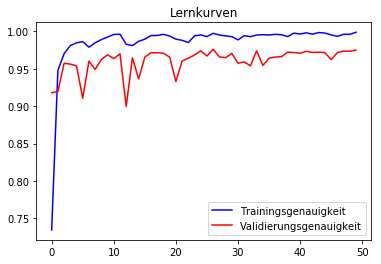

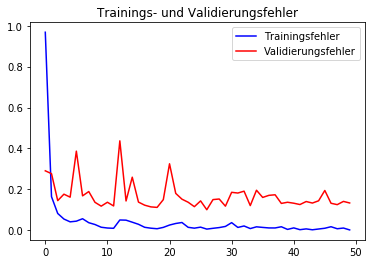

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.99      0.99       720
           2       0.99      0.99      0.99       750
           3       0.99      0.93      0.96       450
           4       0.99      0.99      0.99       660
           5       0.89      0.99      0.93       630
           6       0.98      0.71      0.82       150
           7       0.99      0.96      0.97       450
           8       0.97      0.96      0.96       450
           9       0.99      0.99      0.99       480
          10       0.98      0.99      0.99       660
          11       0.98      0.97      0.97       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.99      0.99      0.99       210
          16       1.00      0.99      0.99   

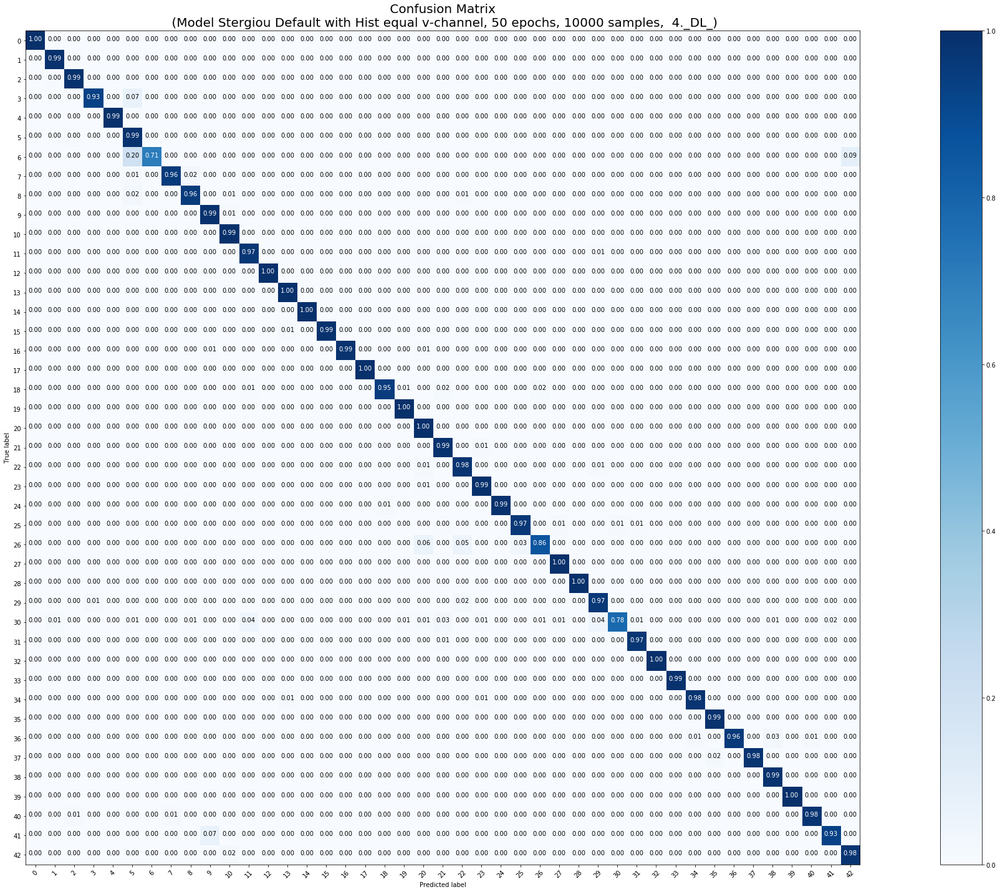

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 10000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 10000 samples, validate on 12630 samples
Epoch 1/50
10000/10000 [==============================] - 10s 952us/step - loss: 0.9484 - acc: 0.7389 - val_loss: 0.2919 - val_acc: 0.9173
Epoch 2/50
10000/10000 [==============================] - 7s 651us/step - loss: 0.1555 - acc: 0.9479 - val_loss: 0.1792 - val_acc: 0.9514
Epoch 3/50
10000/10000 [==============================] - 7s 652us/step - loss: 0.0917 - acc: 0.9714 - val_loss: 0.1508 - val_acc: 0.9591
Epoch 4/50
10000/10000 [==============================] - 6s 650us/step - loss: 0.0499 - acc: 0.9823 - val_loss: 0.1979 - val_acc: 0.9460
Epoch 5/50
10000/10000 [==============================] - 6s 644us/step - loss: 0.0410 - acc: 0.9846 - val_loss: 0.1272 - val_acc: 0.9680
Epoch 6/50
10000/100

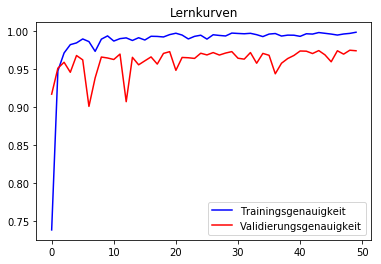

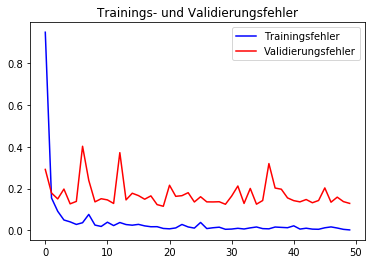

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.98      0.99       720
           2       0.99      1.00      0.99       750
           3       0.96      0.98      0.97       450
           4       0.99      0.99      0.99       660
           5       0.95      0.96      0.95       630
           6       0.98      0.73      0.84       150
           7       0.98      0.98      0.98       450
           8       0.97      0.95      0.96       450
           9       0.97      0.99      0.98       480
          10       0.99      0.99      0.99       660
          11       0.97      0.99      0.98       420
          12       0.99      1.00      0.99       690
          13       0.98      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.94      1.00      0.97       210
          16       0.99      0.99      0.99   

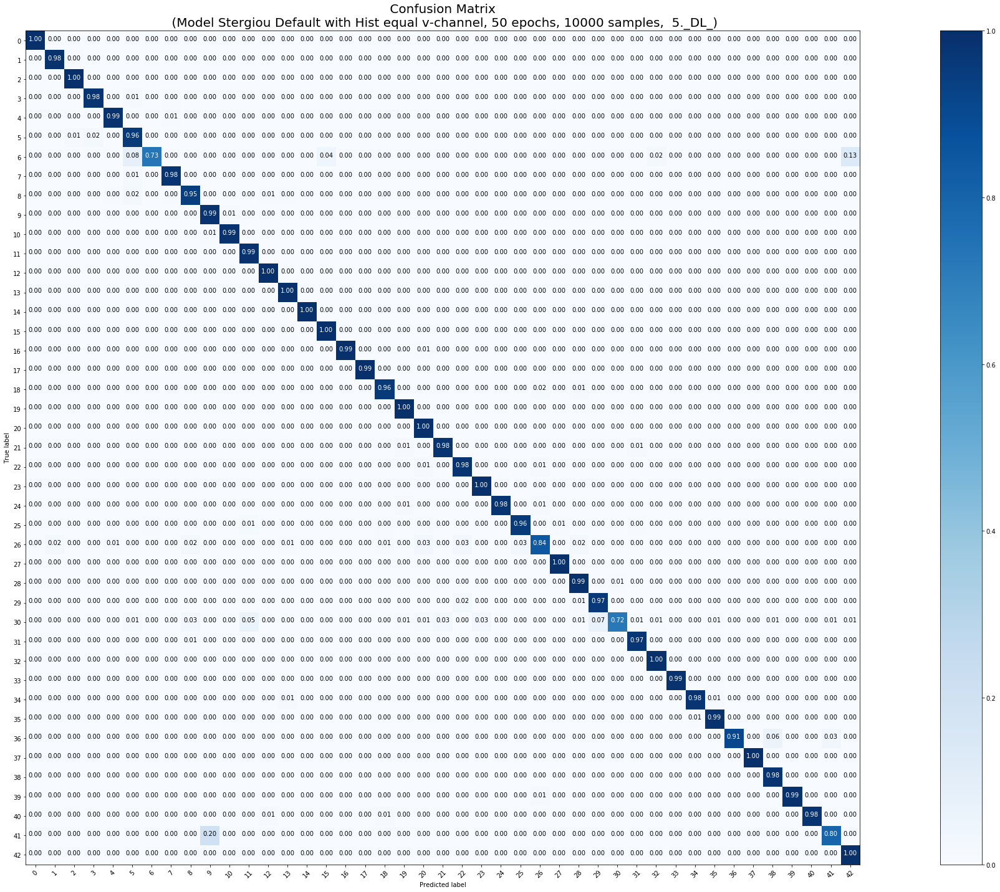

<Figure size 432x288 with 0 Axes>

In [0]:
### 10000, C, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_10000, y_tr_10000, X_test, y_test, 50, 10000)

In [0]:
downloaderCW_C(10000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 14s 688us/step - loss: 0.3993 - acc: 0.8931 - val_loss: 0.1680 - val_acc: 0.9521
Epoch 2/50
20000/20000 [==============================] - 10s 510us/step - loss: 0.0702 - acc: 0.9793 - val_loss: 0.1304 - val_acc: 0.9670
Epoch 3/50
20000/20000 [==============================] - 10s 504us/step - loss: 0.0490 - acc: 0.9856 - val_loss: 0.1401 - val_acc: 0.9608
Epoch 4/50
20000/20000 [==============================] - 10s 505us/step - loss: 0.0371 - acc: 0.9895 - val_loss: 0.1337 - val_acc: 0.9656
Epoch 5/50
20000/20000 [==============================] - 10s 515us/step - loss: 0.0270 - acc: 0.9913 - val_loss: 0.1696 - val_acc: 0.9592
Epoch 6/50
20000/20000

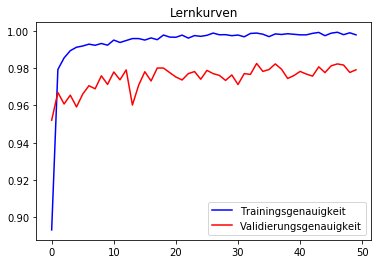

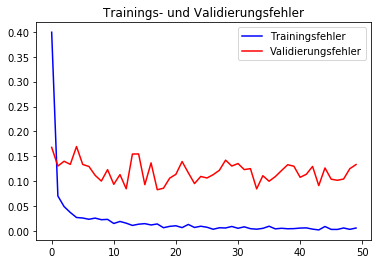

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      0.97      0.98        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       0.99      0.96      0.97       450
           4       0.99      0.99      0.99       660
           5       0.88      1.00      0.93       630
           6       1.00      0.77      0.87       150
           7       0.98      0.99      0.99       450
           8       0.98      0.95      0.97       450
           9       0.99      1.00      0.99       480
          10       0.99      0.99      0.99       660
          11       0.94      1.00      0.97       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       1.00      0.97      0.98       210
          16       0.99      0.99      0.99   

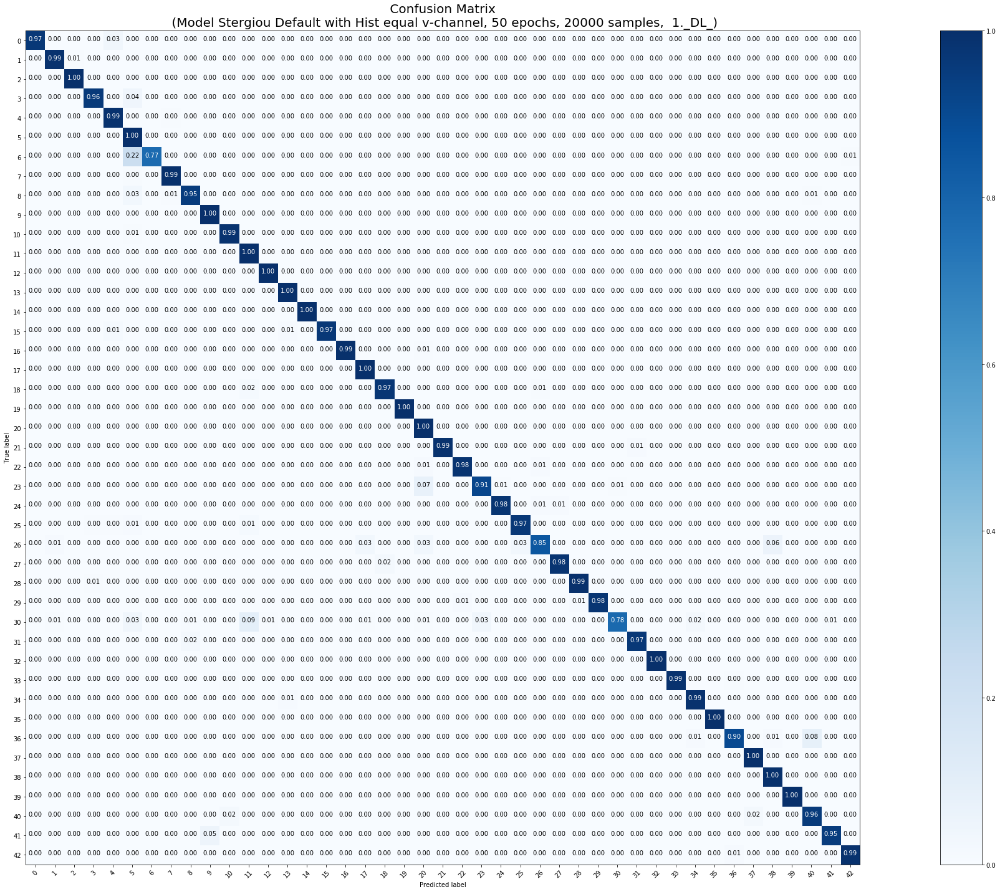

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 14s 694us/step - loss: 0.4011 - acc: 0.8896 - val_loss: 0.1851 - val_acc: 0.9492
Epoch 2/50
20000/20000 [==============================] - 10s 517us/step - loss: 0.0750 - acc: 0.9794 - val_loss: 0.1656 - val_acc: 0.9535
Epoch 3/50
20000/20000 [==============================] - 10s 513us/step - loss: 0.0510 - acc: 0.9856 - val_loss: 0.1651 - val_acc: 0.9573
Epoch 4/50
20000/20000 [==============================] - 10s 514us/step - loss: 0.0342 - acc: 0.9900 - val_loss: 0.1187 - val_acc: 0.9686
Epoch 5/50
20000/20000 [==============================] - 10s 516us/step - loss: 0.0393 - acc: 0.9879 - val_loss: 0.1022 - val_acc: 0.9714
Epoch 6/50
20000/20000

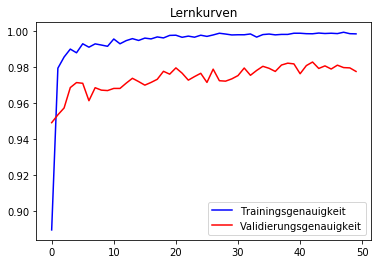

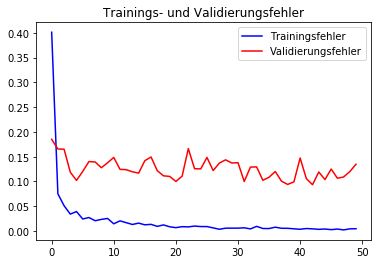

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.99      0.99       720
           2       0.99      0.99      0.99       750
           3       0.99      0.95      0.97       450
           4       0.99      0.99      0.99       660
           5       0.87      1.00      0.93       630
           6       1.00      0.80      0.89       150
           7       0.95      0.98      0.96       450
           8       0.96      0.92      0.94       450
           9       1.00      1.00      1.00       480
          10       1.00      0.98      0.99       660
          11       0.99      0.98      0.98       420
          12       1.00      0.99      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.95      1.00      0.98       210
          16       0.99      0.99      0.99   

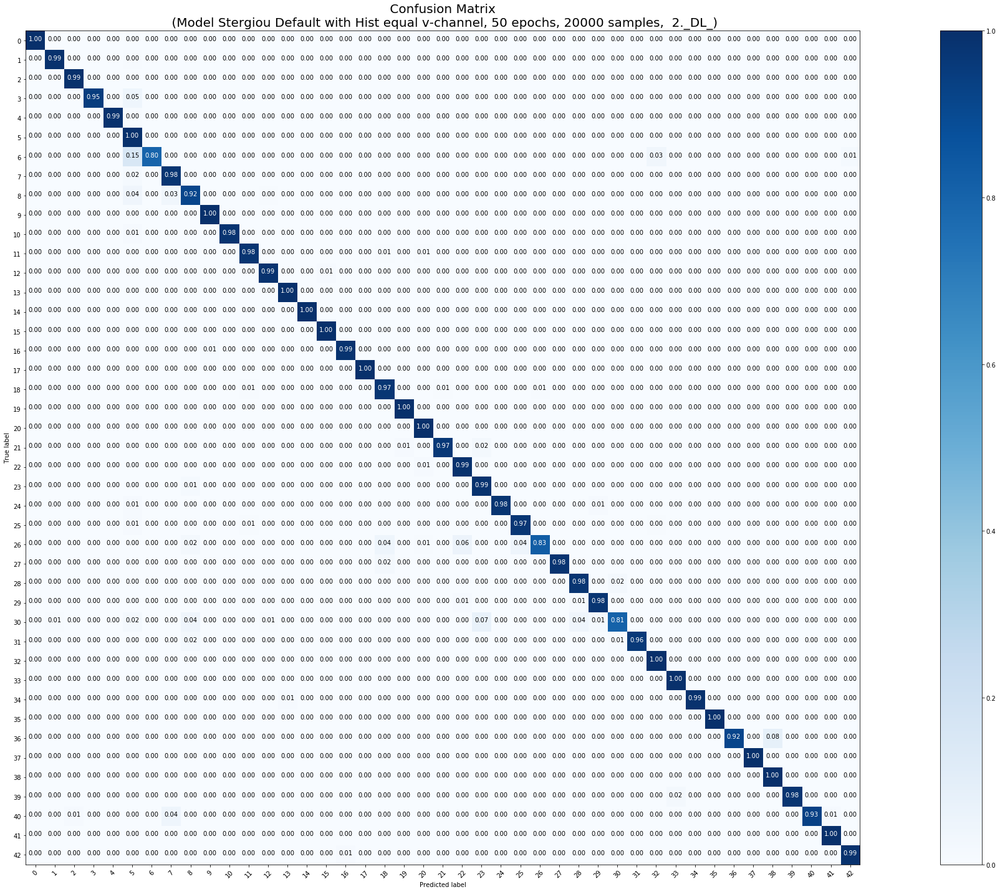

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 14s 713us/step - loss: 0.3994 - acc: 0.8898 - val_loss: 0.1638 - val_acc: 0.9557
Epoch 2/50
20000/20000 [==============================] - 10s 516us/step - loss: 0.0735 - acc: 0.9800 - val_loss: 0.1359 - val_acc: 0.9622
Epoch 3/50
20000/20000 [==============================] - 10s 520us/step - loss: 0.0483 - acc: 0.9863 - val_loss: 0.1254 - val_acc: 0.9686
Epoch 4/50
20000/20000 [==============================] - 10s 522us/step - loss: 0.0421 - acc: 0.9871 - val_loss: 0.1445 - val_acc: 0.9612
Epoch 5/50
20000/20000 [==============================] - 10s 514us/step - loss: 0.0281 - acc: 0.9919 - val_loss: 0.1247 - val_acc: 0.9718
Epoch 6/50
20000/20000

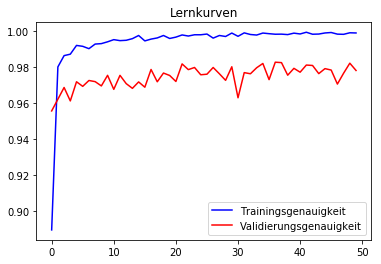

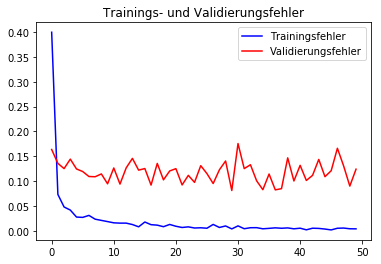

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      0.99      0.99       720
           2       0.98      1.00      0.99       750
           3       0.99      0.97      0.98       450
           4       1.00      0.99      0.99       660
           5       0.91      0.99      0.95       630
           6       1.00      0.84      0.91       150
           7       0.99      0.98      0.99       450
           8       0.99      0.95      0.97       450
           9       0.98      1.00      0.99       480
          10       1.00      0.98      0.99       660
          11       0.92      0.99      0.95       420
          12       1.00      0.98      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.95      1.00      0.97       210
          16       1.00      0.99      1.00   

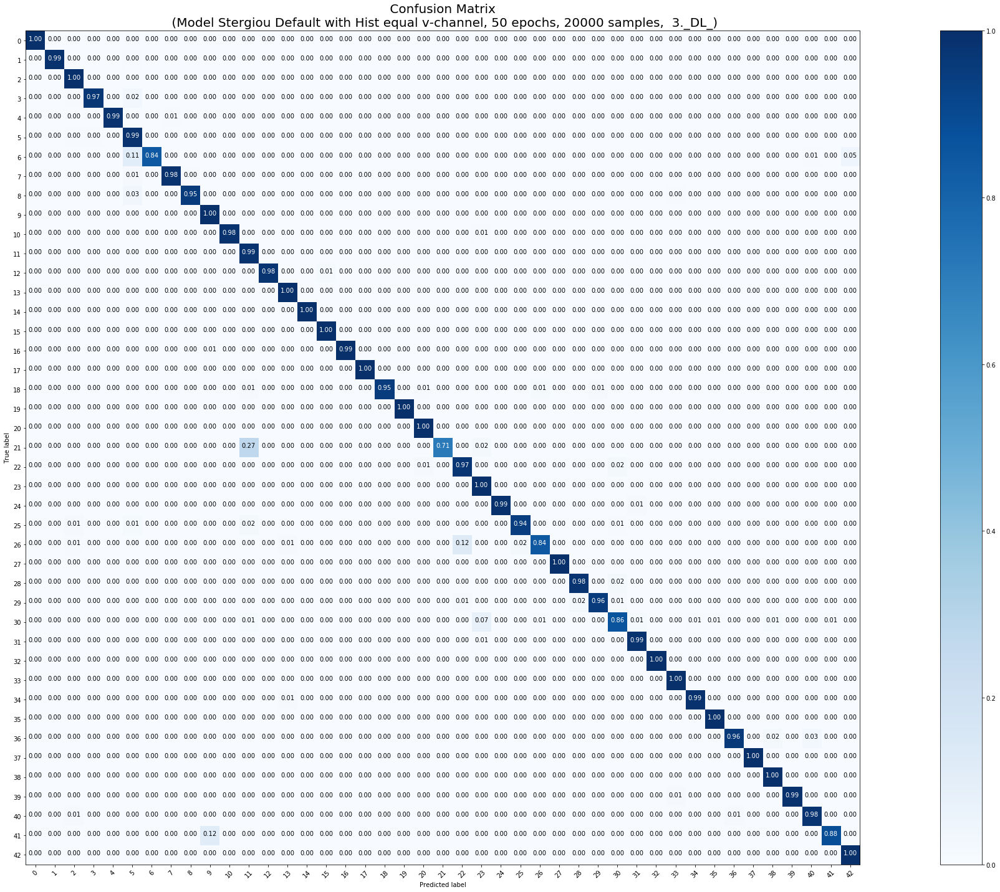

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 15s 731us/step - loss: 0.3986 - acc: 0.8932 - val_loss: 0.1634 - val_acc: 0.9578
Epoch 2/50
20000/20000 [==============================] - 11s 531us/step - loss: 0.0763 - acc: 0.9785 - val_loss: 0.1446 - val_acc: 0.9588
Epoch 3/50
20000/20000 [==============================] - 11s 535us/step - loss: 0.0459 - acc: 0.9864 - val_loss: 0.1552 - val_acc: 0.9618
Epoch 4/50
20000/20000 [==============================] - 11s 530us/step - loss: 0.0385 - acc: 0.9886 - val_loss: 0.1573 - val_acc: 0.9577
Epoch 5/50
20000/20000 [==============================] - 11s 534us/step - loss: 0.0329 - acc: 0.9898 - val_loss: 0.1558 - val_acc: 0.9637
Epoch 6/50
20000/20000

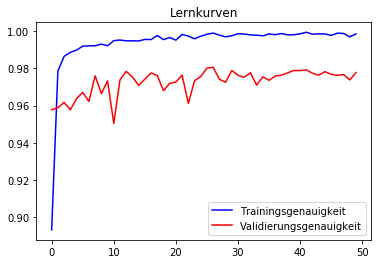

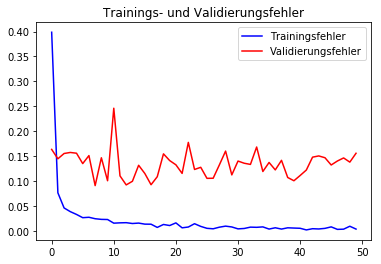

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       0.99      0.92      0.95       450
           4       1.00      0.99      0.99       660
           5       0.84      0.99      0.91       630
           6       1.00      0.69      0.81       150
           7       0.99      0.97      0.98       450
           8       0.97      0.93      0.95       450
           9       0.99      0.99      0.99       480
          10       0.99      0.99      0.99       660
          11       0.97      1.00      0.98       420
          12       1.00      0.99      1.00       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.99      0.99      0.99   

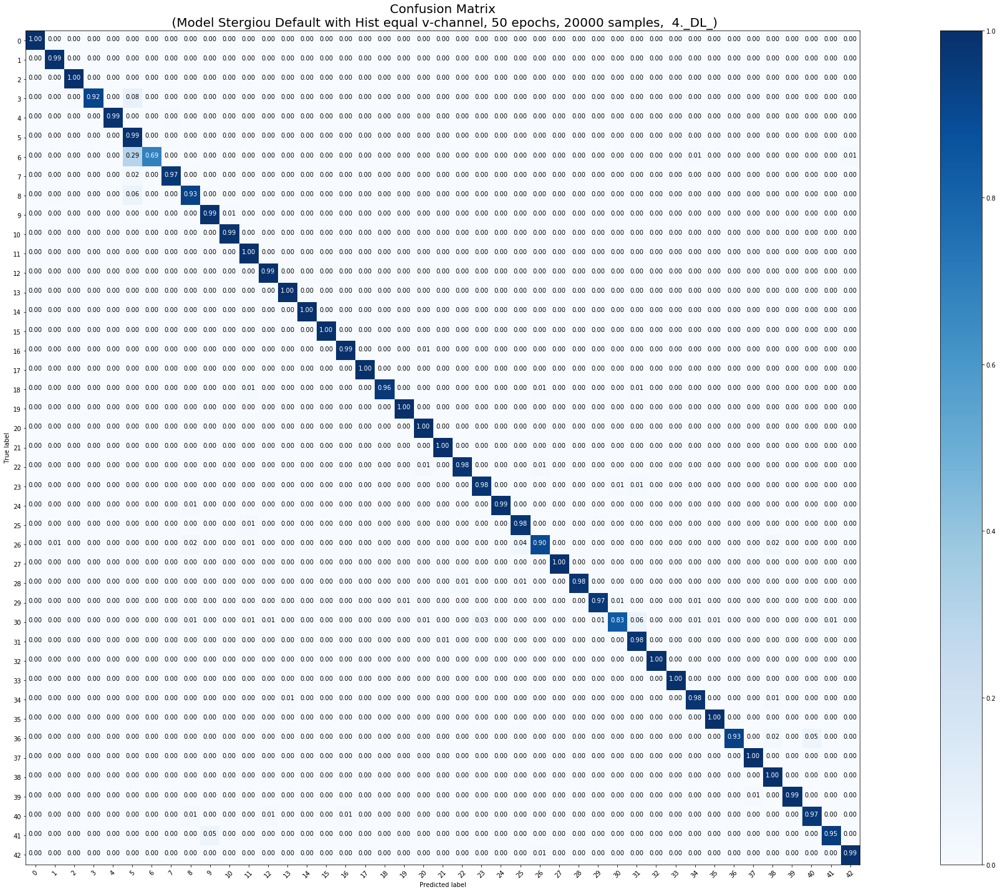

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Normales Training beginnt
categorical crossentropy
Training ohne Klassengewichte beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 16s 775us/step - loss: 0.4039 - acc: 0.8909 - val_loss: 0.1516 - val_acc: 0.9581
Epoch 2/50
20000/20000 [==============================] - 11s 540us/step - loss: 0.0771 - acc: 0.9786 - val_loss: 0.2041 - val_acc: 0.9447
Epoch 3/50
20000/20000 [==============================] - 11s 533us/step - loss: 0.0453 - acc: 0.9867 - val_loss: 0.1424 - val_acc: 0.9665
Epoch 4/50
20000/20000 [==============================] - 11s 532us/step - loss: 0.0351 - acc: 0.9905 - val_loss: 0.1112 - val_acc: 0.9709
Epoch 5/50
20000/20000 [==============================] - 11s 530us/step - loss: 0.0314 - acc: 0.9906 - val_loss: 0.1631 - val_acc: 0.9626
Epoch 6/50
20000/20000

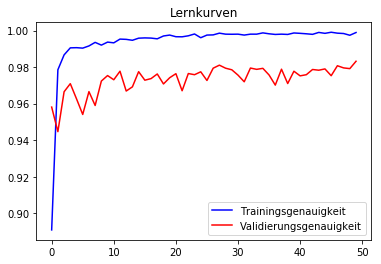

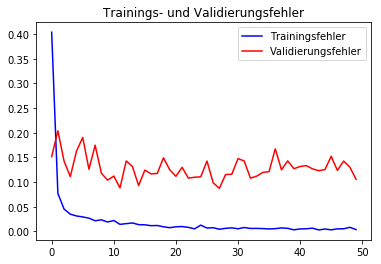

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.97      1.00      0.98        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       0.99      0.96      0.98       450
           4       1.00      0.99      0.99       660
           5       0.96      0.99      0.98       630
           6       1.00      0.87      0.93       150
           7       1.00      0.99      0.99       450
           8       0.99      0.94      0.96       450
           9       0.97      1.00      0.99       480
          10       0.99      0.99      0.99       660
          11       0.99      0.99      0.99       420
          12       0.98      1.00      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.99      0.97      0.98   

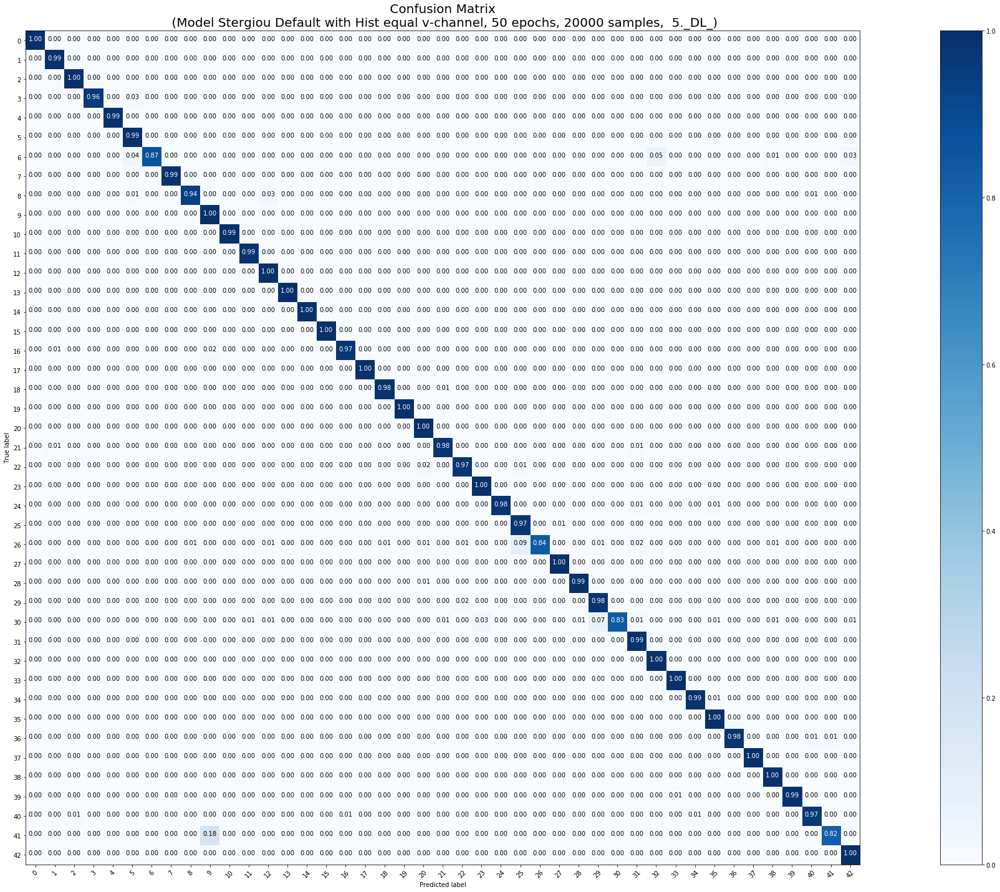

<Figure size 432x288 with 0 Axes>

In [0]:
### 20000, C, 5mal
model_params = [False, False, False, False, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_20000, y_tr_20000, X_test, y_test, 50, 20000)

In [0]:
downloader_C(20000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
sparse categorical crossentropy


Training mit Klassengewichten beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 19s 925us/step - loss: 0.5879 - acc: 0.8423 - val_loss: 0.2054 - val_acc: 0.9451
Epoch 2/50
20000/20000 [==============================] - 11s 527us/step - loss: 0.0955 - acc: 0.9696 - val_loss: 0.1059 - val_acc: 0.9725
Epoch 3/50
20000/20000 [==============================] - 11s 529us/step - loss: 0.0697 - acc: 0.9772 - val_loss: 0.3618 - val_acc: 0.9074
Epoch 4/50
20000/20000 [==============================] - 11s 540us/ste

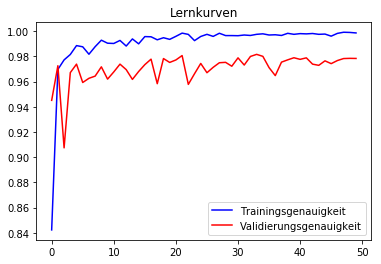

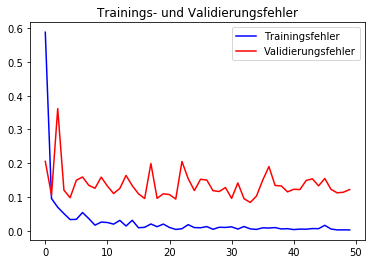

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.98      1.00      0.99       720
           2       0.99      1.00      1.00       750
           3       0.99      0.96      0.97       450
           4       1.00      0.98      0.99       660
           5       0.91      0.98      0.95       630
           6       1.00      0.71      0.83       150
           7       0.99      0.99      0.99       450
           8       0.98      0.97      0.97       450
           9       0.96      1.00      0.98       480
          10       1.00      0.98      0.99       660
          11       0.98      0.98      0.98       420
          12       1.00      0.99      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       0.99      0.99      0.99       210
          16       0.99      0.99      0.99   

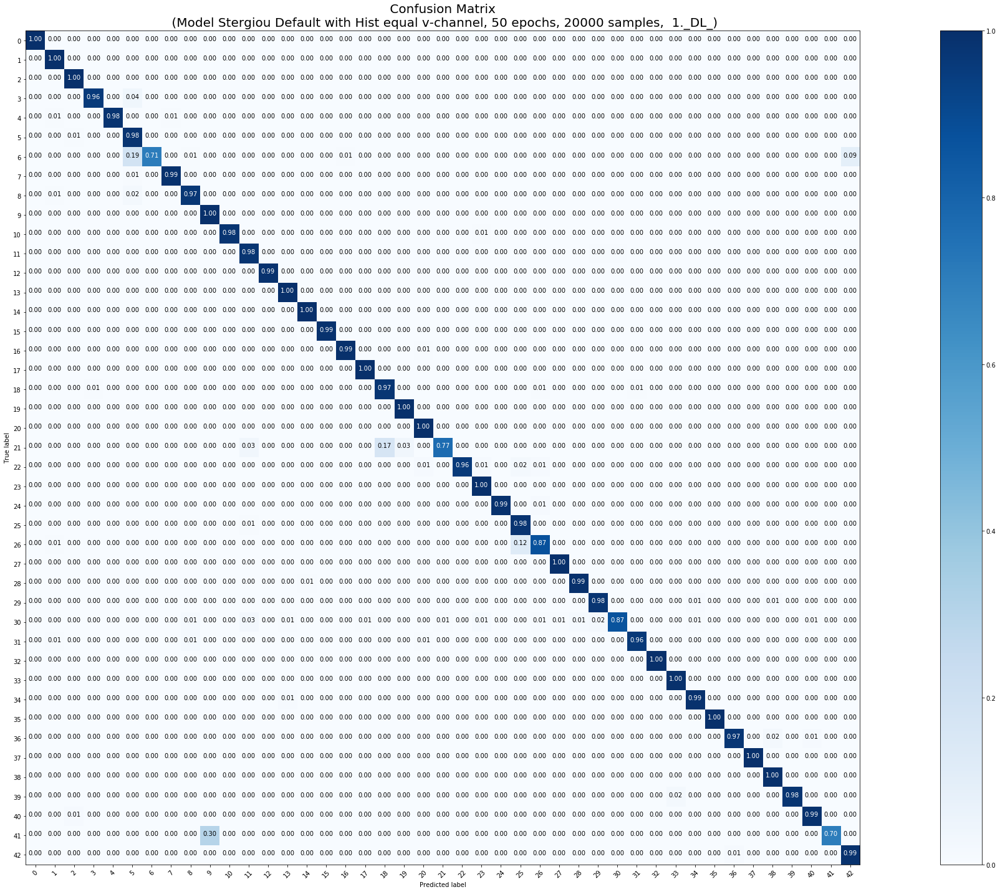

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 12s 613us/step - loss: 0.6007 - acc: 0.8328 - val_loss: 0.2479 - val_acc: 0.9230
Epoch 2/50
20000/20000 [==============================] - 11s 529us/step - loss: 0.1063 - acc: 0.9653 - val_loss: 0.1646 - val_acc: 0.9556
Epoch 3/50
20000/20000 [==============================] - 11s 526us/step - loss: 0.0627 - acc: 0.9782 - val_loss: 0.1587 - val_acc: 0.9568
Epoch 4/50
20000/20000 [==============================] - 10s 524us/step - loss: 0.0510 - acc: 0.9815 - val_loss: 0.1137 - val_acc: 0.9694
Epoch 5/50
20000/20000 [==============================] - 11s 531us/step - loss: 0.0329 - acc: 0.9878 - val_loss: 0.1773 - val_acc: 0.9549
Epoch 6/50
20000

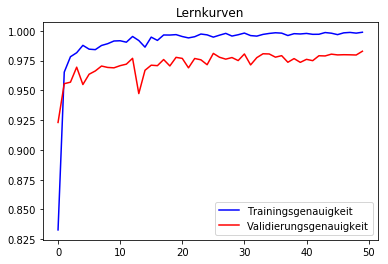

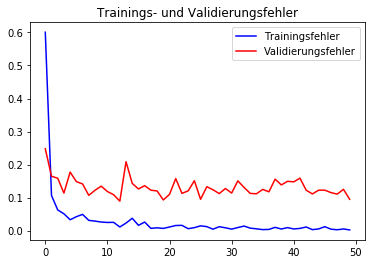

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       1.00      0.93      0.96       450
           4       0.99      0.99      0.99       660
           5       0.92      0.99      0.95       630
           6       1.00      0.83      0.91       150
           7       0.98      0.98      0.98       450
           8       0.99      0.96      0.98       450
           9       1.00      1.00      1.00       480
          10       1.00      0.98      0.99       660
          11       0.96      0.99      0.98       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.99      0.99      0.99   

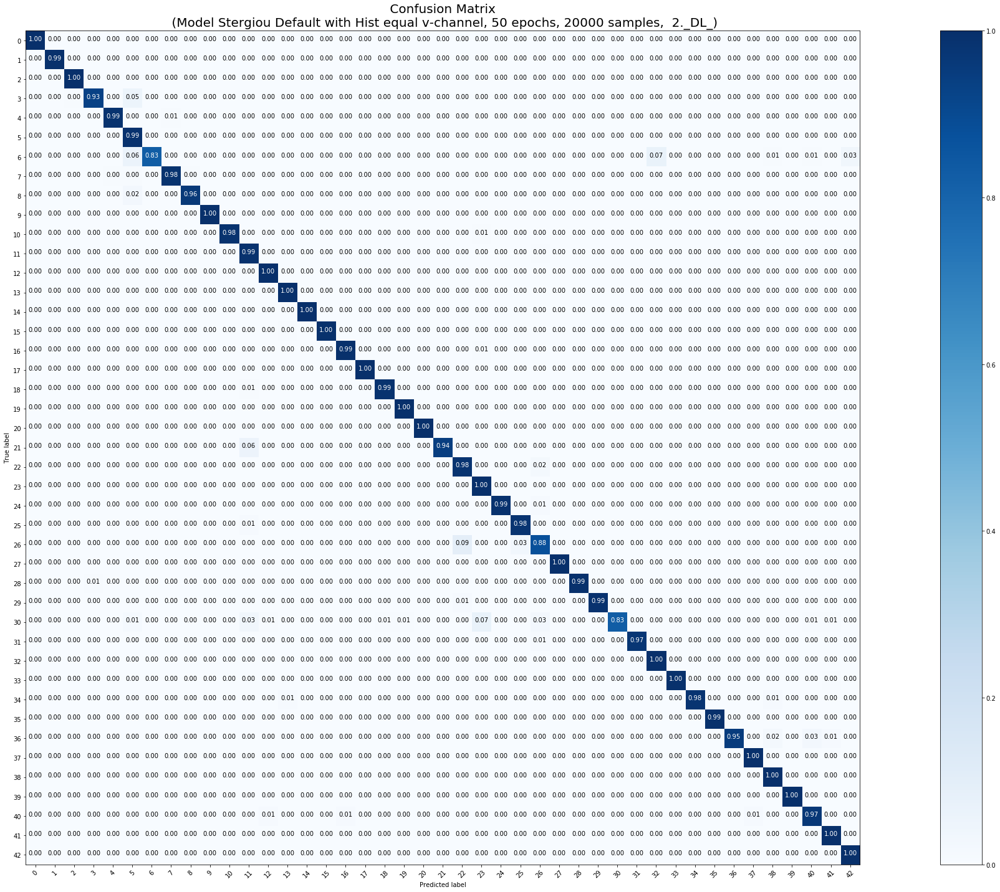

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 13s 643us/step - loss: 0.5728 - acc: 0.8434 - val_loss: 0.1716 - val_acc: 0.9515
Epoch 2/50
20000/20000 [==============================] - 11s 530us/step - loss: 0.0978 - acc: 0.9677 - val_loss: 0.1903 - val_acc: 0.9479
Epoch 3/50
20000/20000 [==============================] - 11s 528us/step - loss: 0.0568 - acc: 0.9796 - val_loss: 0.2298 - val_acc: 0.9423
Epoch 4/50
20000/20000 [==============================] - 11s 531us/step - loss: 0.0461 - acc: 0.9832 - val_loss: 0.1611 - val_acc: 0.9543
Epoch 5/50
20000/20000 [==============================] - 11s 535us/step - loss: 0.0365 - acc: 0.9859 - val_loss: 0.0919 - val_acc: 0.9758
Epoch 6/50
20000

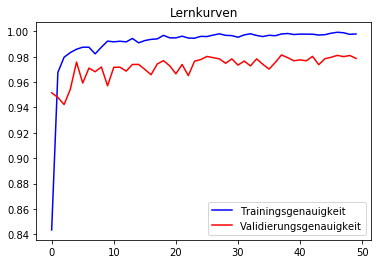

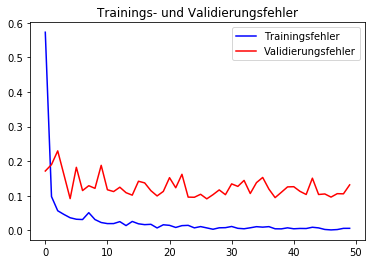

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       1.00      0.93      0.96       450
           4       1.00      0.98      0.99       660
           5       0.90      1.00      0.94       630
           6       0.98      0.87      0.92       150
           7       0.98      1.00      0.99       450
           8       1.00      0.93      0.96       450
           9       0.99      1.00      1.00       480
          10       1.00      0.98      0.99       660
          11       1.00      0.99      0.99       420
          12       1.00      0.97      0.98       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.88      1.00      0.93       210
          16       1.00      0.99      1.00   

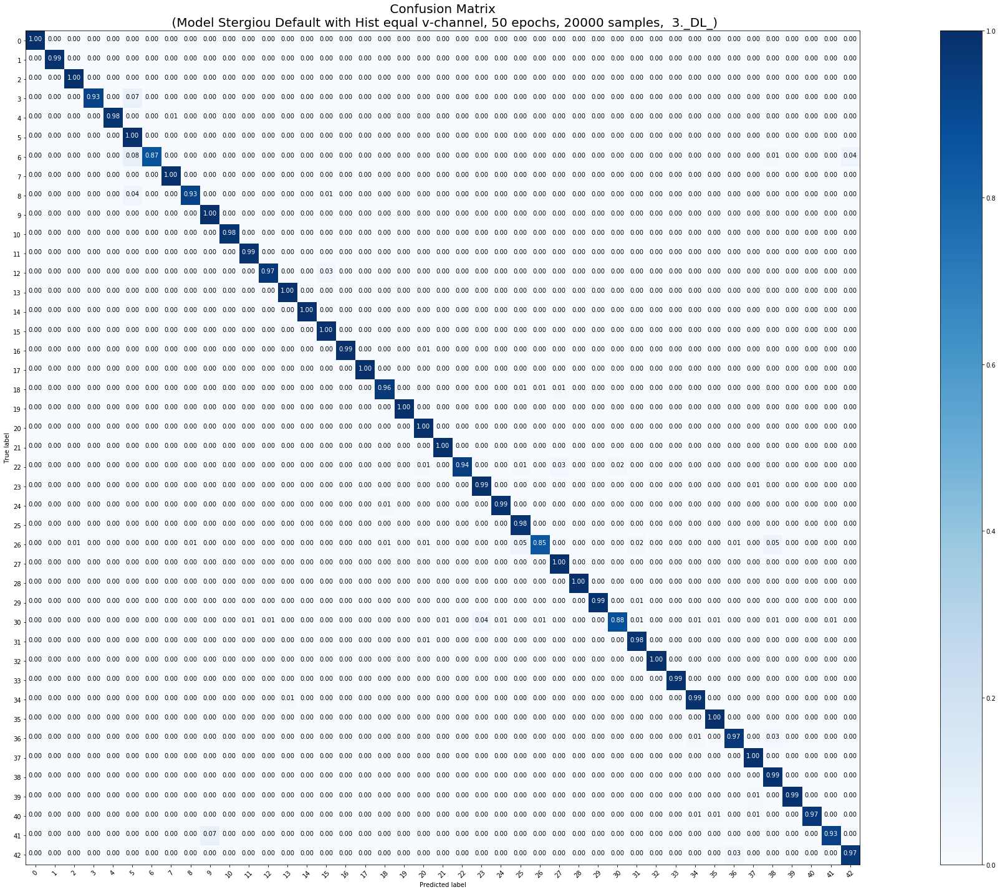

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 13s 659us/step - loss: 0.5754 - acc: 0.8393 - val_loss: 0.2018 - val_acc: 0.9435
Epoch 2/50
20000/20000 [==============================] - 11s 540us/step - loss: 0.0932 - acc: 0.9697 - val_loss: 0.1332 - val_acc: 0.9682
Epoch 3/50
20000/20000 [==============================] - 11s 536us/step - loss: 0.0720 - acc: 0.9767 - val_loss: 0.2505 - val_acc: 0.9333
Epoch 4/50
20000/20000 [==============================] - 11s 535us/step - loss: 0.0555 - acc: 0.9814 - val_loss: 0.1029 - val_acc: 0.9721
Epoch 5/50
20000/20000 [==============================] - 11s 532us/step - loss: 0.0389 - acc: 0.9862 - val_loss: 0.1436 - val_acc: 0.9660
Epoch 6/50
20000

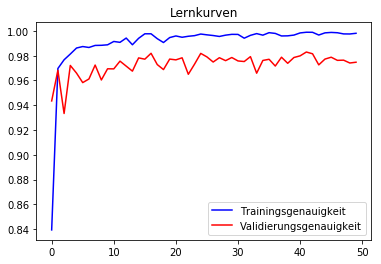

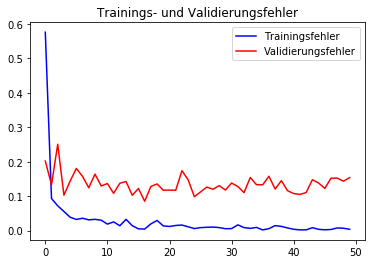

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.98      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       1.00      0.93      0.96       450
           4       1.00      0.99      0.99       660
           5       0.89      0.99      0.94       630
           6       0.98      0.83      0.90       150
           7       0.99      0.98      0.99       450
           8       0.99      0.93      0.96       450
           9       0.97      1.00      0.98       480
          10       1.00      0.99      0.99       660
          11       1.00      0.89      0.94       420
          12       1.00      1.00      1.00       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.97      0.99      0.98   

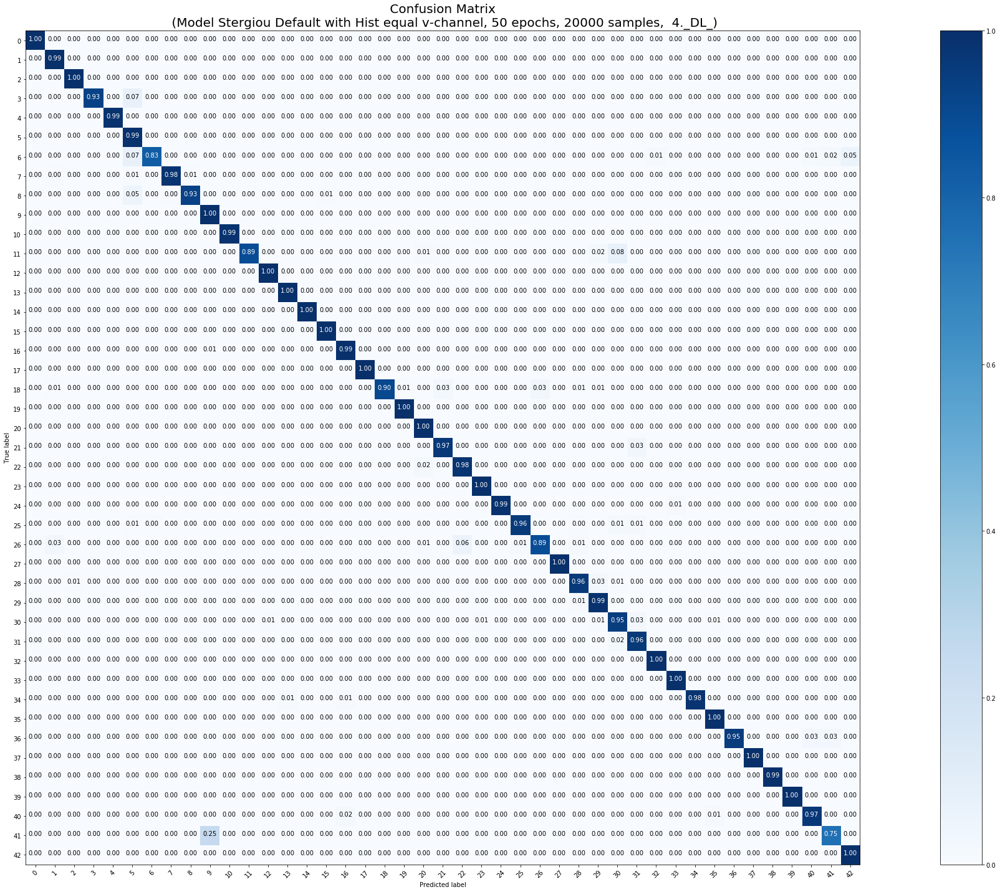

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 20000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 20000 samples, validate on 12630 samples
Epoch 1/50
20000/20000 [==============================] - 14s 693us/step - loss: 0.5864 - acc: 0.8418 - val_loss: 0.2515 - val_acc: 0.9286
Epoch 2/50
20000/20000 [==============================] - 11s 552us/step - loss: 0.0917 - acc: 0.9696 - val_loss: 0.1533 - val_acc: 0.9610
Epoch 3/50
20000/20000 [==============================] - 11s 555us/step - loss: 0.0650 - acc: 0.9779 - val_loss: 0.1822 - val_acc: 0.9477
Epoch 4/50
20000/20000 [==============================] - 11s 555us/step - loss: 0.0467 - acc: 0.9847 - val_loss: 0.1431 - val_acc: 0.9615
Epoch 5/50
20000/20000 [==============================] - 11s 546us/step - loss: 0.0318 - acc: 0.9877 - val_loss: 0.1120 - val_acc: 0.9710
Epoch 6/50
20000

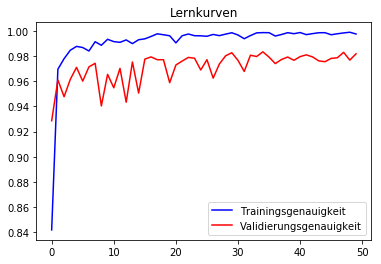

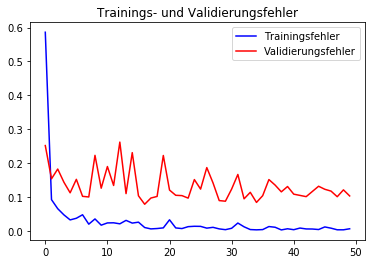

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       0.99      0.99      0.99       720
           2       1.00      0.99      1.00       750
           3       0.99      0.96      0.98       450
           4       1.00      0.98      0.99       660
           5       0.93      0.99      0.96       630
           6       1.00      0.89      0.94       150
           7       1.00      0.97      0.98       450
           8       0.96      0.95      0.96       450
           9       1.00      1.00      1.00       480
          10       0.99      0.99      0.99       660
          11       1.00      0.98      0.99       420
          12       0.99      0.99      0.99       690
          13       1.00      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.98      1.00      0.99       210
          16       0.98      0.99      0.98   

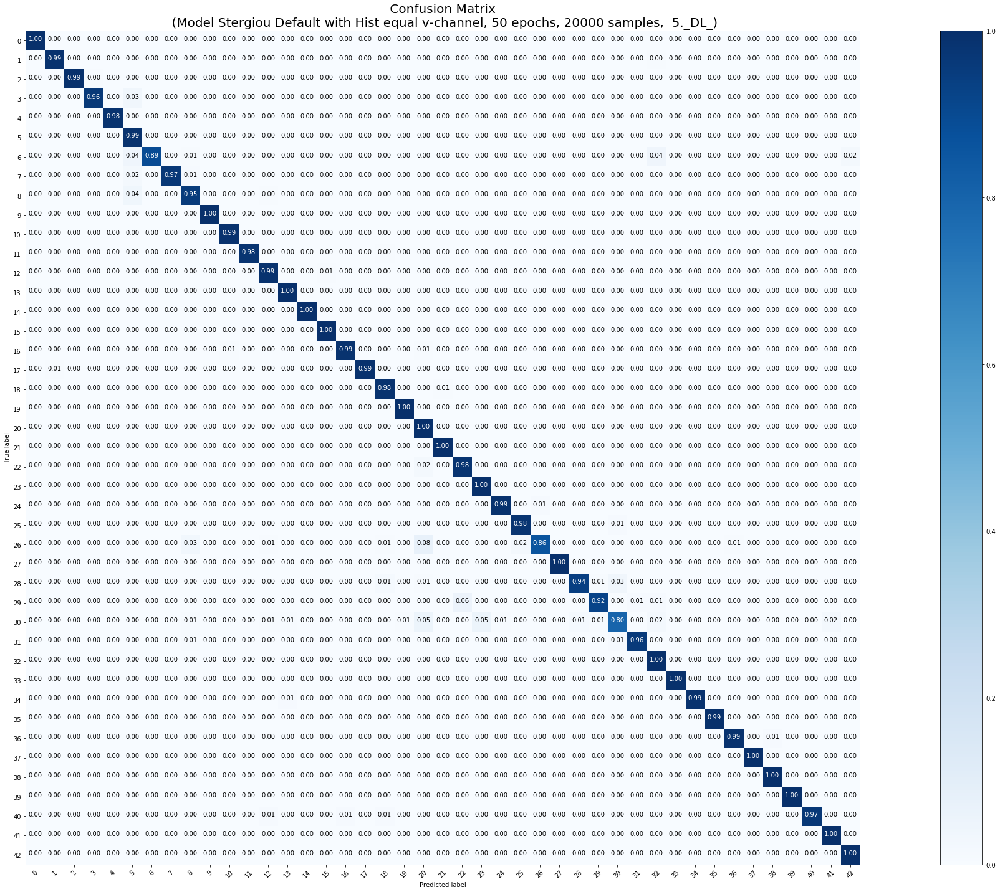

<Figure size 432x288 with 0 Axes>

In [0]:
### 20000, C, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_20000, y_tr_20000, X_test, y_test, 50, 20000)

In [0]:
downloaderCW_C(20000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 40000 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 23s 598us/step - loss: 0.3394 - acc: 0.9047 - val_loss: 0.1728 - val_acc: 0.9541
Epoch 2/50
39209/39209 [==============================] - 20s 509us/step - loss: 0.0626 - acc: 0.9783 - val_loss: 0.1390 - val_acc: 0.9665
Epoch 3/50
39209/39209 [==============================] - 20s 511us/step - loss: 0.0485 - acc: 0.9836 - val_loss: 0.1245 - val_acc: 0.9677
Epoch 4/50
39209/39209 [==============================] - 20s 504us/step - loss: 0.0350 - acc: 0.9875 - val_loss: 0.1540 - val_acc: 0.9637
Epoch 5/50
39209/39209 [==============================] - 20s 507us/step - loss: 0.0430 - acc: 0.9848 - val_loss: 0.1628 - val_acc: 0.9612
Epoch 6/50
39209

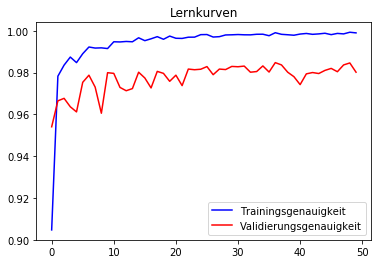

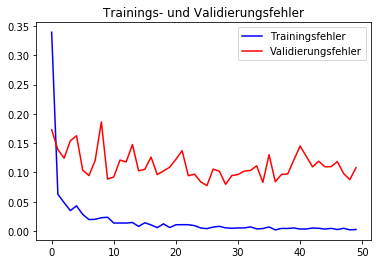

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.95      1.00      0.98        60
           1       0.99      0.99      0.99       720
           2       0.99      0.99      0.99       750
           3       1.00      0.97      0.98       450
           4       1.00      0.99      0.99       660
           5       0.93      0.99      0.96       630
           6       1.00      0.80      0.89       150
           7       0.99      0.98      0.98       450
           8       0.98      0.96      0.97       450
           9       1.00      1.00      1.00       480
          10       1.00      0.99      0.99       660
          11       1.00      0.98      0.99       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       0.99      1.00      0.99       270
          15       0.96      1.00      0.98       210
          16       0.99      0.99      0.99   

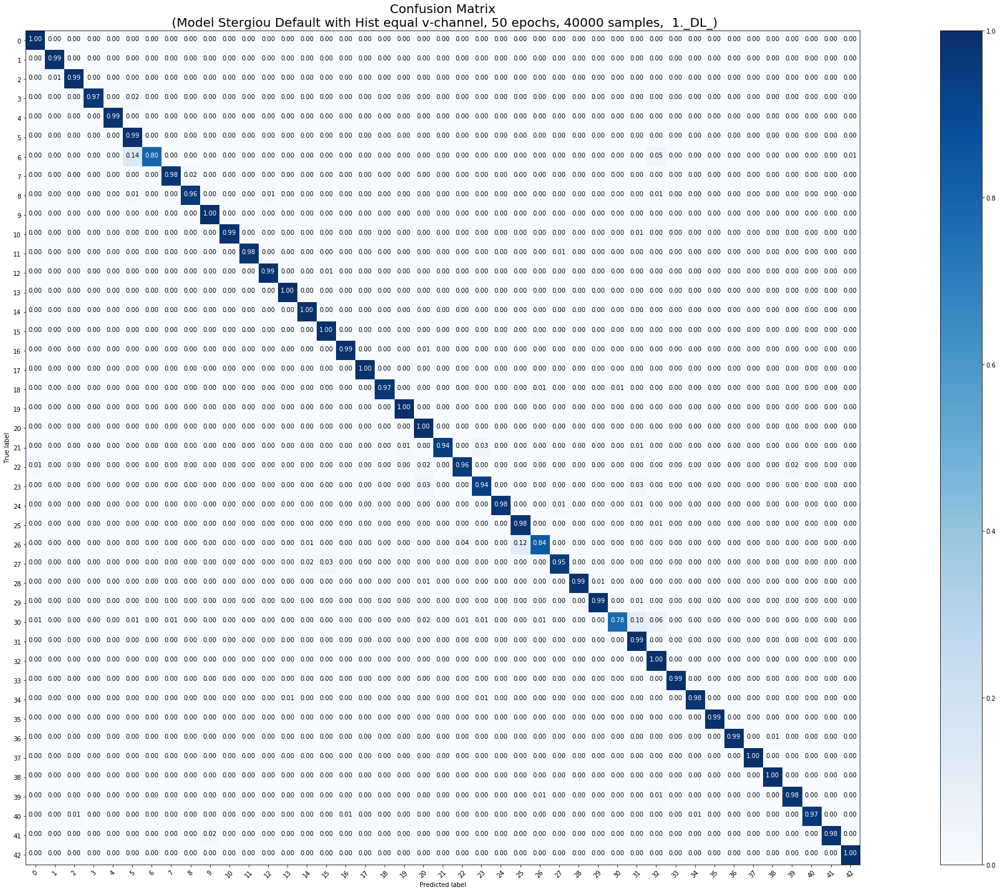

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 40000 Trainingsmuster
 


In [0]:
### 39209, C, 5mal mit class_weight = 'balanced'    !!!! versehentlich 40.000 angegeben, trainiert wurde aber mit 39209
model_params = [False, False, False, True, 6, 0.2, 0.5]      !!!!!  #ABBRUCH nach 1. Durchlauf
runningModels(1, 5, model_params, 'C', X_tr, y_tr, X_test, y_test, 50, 40000)

***************************************************************************** 
1 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 25s 649us/step - loss: 0.3404 - acc: 0.9036 - val_loss: 0.1465 - val_acc: 0.9626
Epoch 2/50
39209/39209 [==============================] - 22s 561us/step - loss: 0.0681 - acc: 0.9789 - val_loss: 0.1144 - val_acc: 0.9702
Epoch 3/50
39209/39209 [==============================] - 22s 559us/step - loss: 0.0487 - acc: 0.9826 - val_loss: 0.1445 - val_acc: 0.9620
Epoch 4/50
39209/39209 [==============================] - 22s 560us/step - loss: 0.0403 - acc: 0.9862 - val_loss: 0.0955 - val_acc: 0.9749
Epoch 5/50
39209/39209 [==============================] - 22s 561us/step - loss: 0.0415 - acc: 0.9847 - val_loss: 0.1141 - val_acc: 0.9698
Epoch 6/50
39209

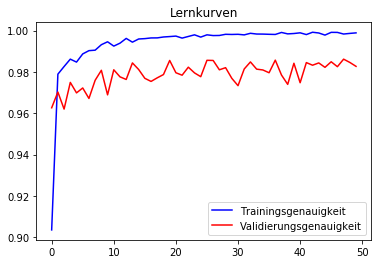

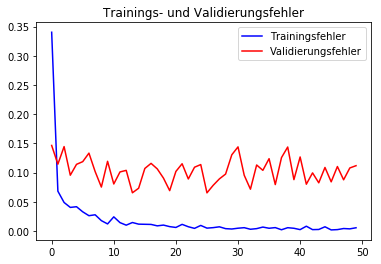

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.79      1.00      0.88        60
           1       0.99      0.99      0.99       720
           2       0.99      1.00      0.99       750
           3       1.00      0.96      0.98       450
           4       0.99      0.99      0.99       660
           5       0.97      0.99      0.98       630
           6       1.00      0.76      0.86       150
           7       1.00      0.98      0.99       450
           8       0.98      0.98      0.98       450
           9       0.99      1.00      1.00       480
          10       1.00      0.99      0.99       660
          11       1.00      0.99      0.99       420
          12       0.99      0.99      0.99       690
          13       0.99      1.00      1.00       720
          14       1.00      1.00      1.00       270
          15       0.98      0.99      0.98       210
          16       1.00      0.99      1.00   

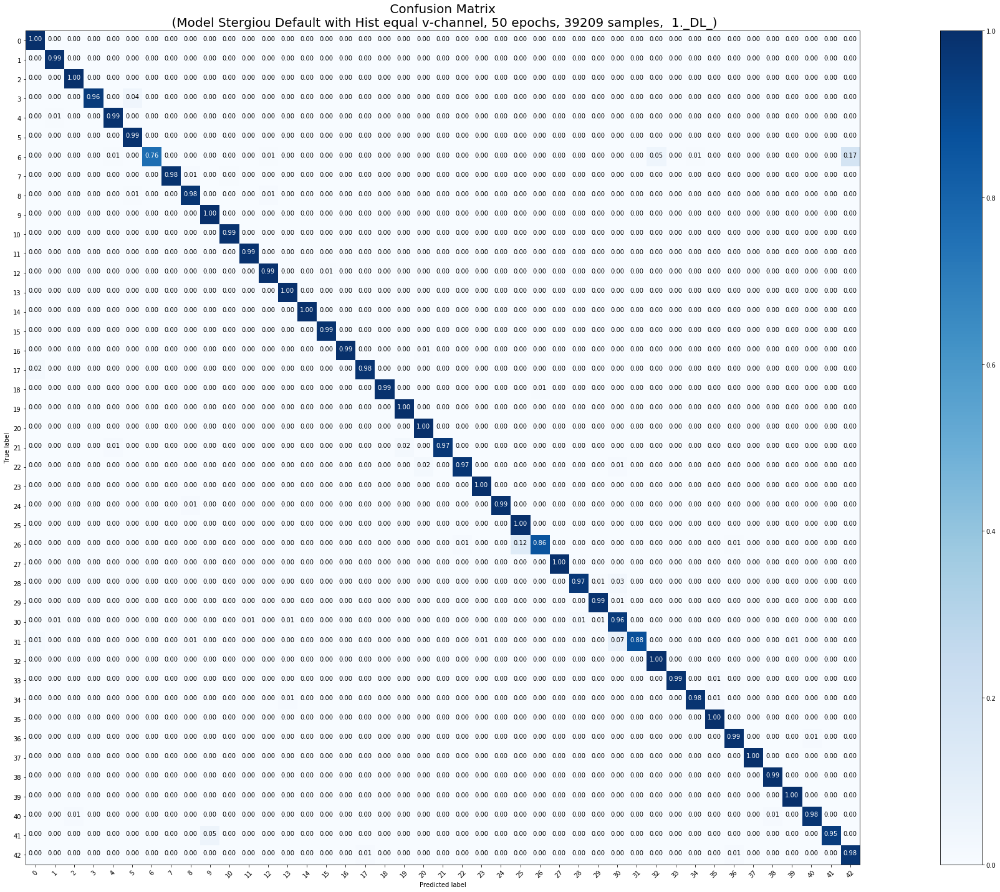

***************************************************************************** 
2 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 26s 655us/step - loss: 0.3606 - acc: 0.8967 - val_loss: 0.1569 - val_acc: 0.9580
Epoch 2/50
39209/39209 [==============================] - 22s 553us/step - loss: 0.0690 - acc: 0.9759 - val_loss: 0.1512 - val_acc: 0.9606
Epoch 3/50
39209/39209 [==============================] - 22s 562us/step - loss: 0.0512 - acc: 0.9817 - val_loss: 0.1055 - val_acc: 0.9724
Epoch 4/50
39209/39209 [==============================] - 22s 560us/step - loss: 0.0452 - acc: 0.9847 - val_loss: 0.1200 - val_acc: 0.9688
Epoch 5/50
39209/39209 [==============================] - 22s 561us/step - loss: 0.0302 - acc: 0.9881 - val_loss: 0.1057 - val_acc: 0.9736
Epoch 6/50
39209

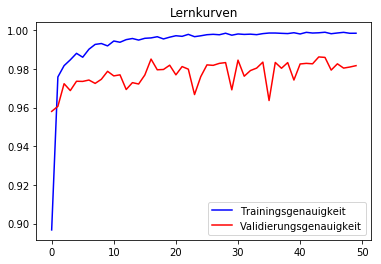

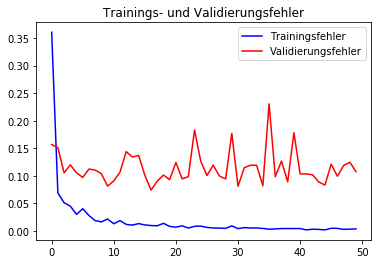

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        60
           1       1.00      0.99      0.99       720
           2       0.99      1.00      1.00       750
           3       1.00      0.97      0.98       450
           4       1.00      0.99      0.99       660
           5       0.95      1.00      0.97       630
           6       1.00      0.82      0.90       150
           7       1.00      0.99      0.99       450
           8       0.99      0.96      0.98       450
           9       1.00      1.00      1.00       480
          10       1.00      0.99      0.99       660
          11       0.95      0.99      0.97       420
          12       0.99      1.00      0.99       690
          13       0.99      1.00      0.99       720
          14       1.00      1.00      1.00       270
          15       1.00      1.00      1.00       210
          16       0.99      0.99      0.99   

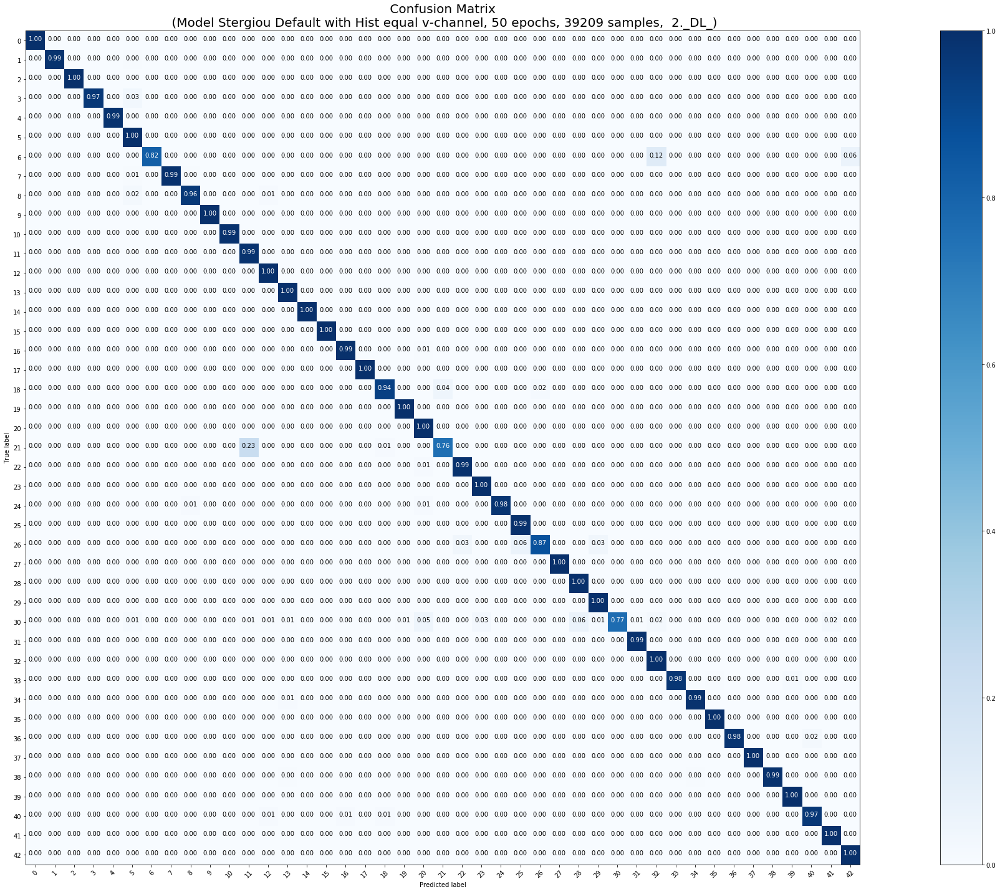

***************************************************************************** 
3 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 26s 668us/step - loss: 0.3524 - acc: 0.9009 - val_loss: 0.1542 - val_acc: 0.9555
Epoch 2/50
39209/39209 [==============================] - 22s 555us/step - loss: 0.0661 - acc: 0.9787 - val_loss: 0.1108 - val_acc: 0.9702
Epoch 3/50
39209/39209 [==============================] - 22s 552us/step - loss: 0.0439 - acc: 0.9845 - val_loss: 0.1569 - val_acc: 0.9606
Epoch 4/50
39209/39209 [==============================] - 23s 596us/step - loss: 0.0488 - acc: 0.9833 - val_loss: 0.1394 - val_acc: 0.9618
Epoch 5/50
39209/39209 [==============================] - 22s 560us/step - loss: 0.0306 - acc: 0.9885 - val_loss: 0.0996 - val_acc: 0.9751
Epoch 6/50
39209

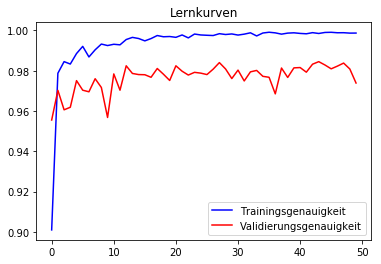

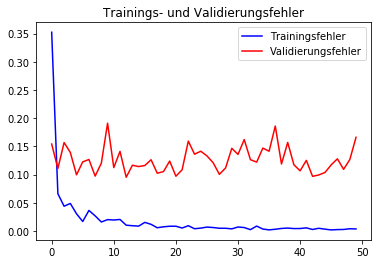

PLOTTEN
Label erstellt
int64
int64
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        60
           1       0.99      0.98      0.99       720
           2       0.99      1.00      0.99       750
           3       0.99      0.94      0.97       450
           4       1.00      0.98      0.99       660
           5       0.89      0.99      0.94       630
           6       1.00      0.73      0.84       150
           7       0.99      0.99      0.99       450
           8       1.00      0.96      0.98       450
           9       1.00      0.97      0.99       480
          10       0.97      1.00      0.98       660
          11       0.98      1.00      0.99       420
          12       1.00      0.96      0.98       690
          13       0.99      1.00      0.99       720
          14       0.96      1.00      0.98       270
          15       0.90      1.00      0.95       210
          16       1.00      0.97      0.99   

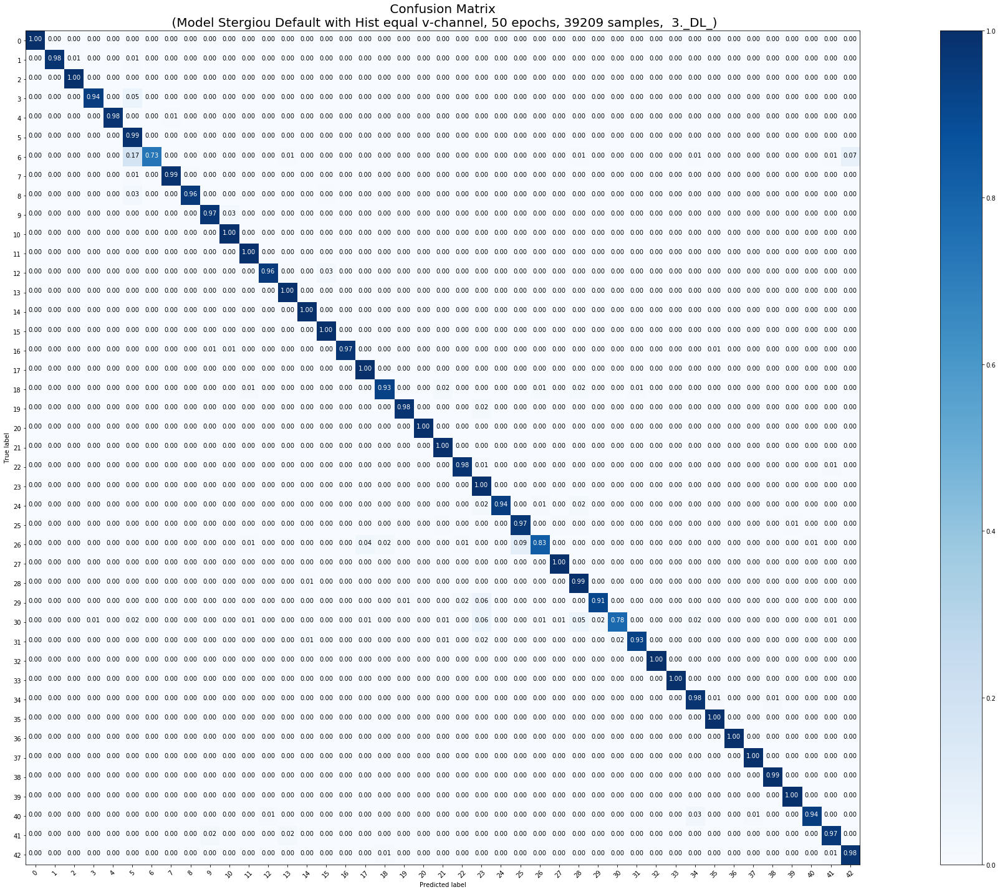

***************************************************************************** 
4 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!
sparse categorical crossentropy
Training mit Klassengewichten beginnt
Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 27s 687us/step - loss: 0.3526 - acc: 0.9011 - val_loss: 0.1156 - val_acc: 0.9668
Epoch 2/50
39209/39209 [==============================] - 22s 562us/step - loss: 0.0659 - acc: 0.9780 - val_loss: 0.1471 - val_acc: 0.9609
Epoch 3/50
39209/39209 [==============================] - 22s 563us/step - loss: 0.0473 - acc: 0.9831 - val_loss: 0.2090 - val_acc: 0.9424
Epoch 4/50
39209/39209 [==============================] - 22s 564us/step - loss: 0.0452 - acc: 0.9841 - val_loss: 0.1069 - val_acc: 0.9726
Epoch 5/50
39209/39209 [==============================] - 22s 567us/step - loss: 0.0322 - acc: 0.9879 - val_loss: 0.1422 - val_acc: 0.9654
Epoch 6/50
39209

In [0]:
### 39209, C, 5mal mit class_weight = 'balanced'       2.-4. Durchlauf
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr, y_tr, X_test, y_test, 50, 39209)

In [0]:
### 39209, C, 1mal mit class_weight = 'balanced'       5. Durchlauf
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(5, 5, model_params, 'C', X_tr, y_tr, X_test, y_test, 50, 39209)

***************************************************************************** 
5 ._Modell trainieren mit 50 Epochen und 39209 Trainingsmuster
 
Klassengewichte gesetzt!










Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
sparse categorical crossentropy


Training mit Klassengewichten beginnt
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 39209 samples, validate on 12630 samples
Epoch 1/50
39209/39209 [==============================] - 30s 762us/step - loss: 0.3473 - acc: 0.9042 - val_loss: 0.1487 - val_acc: 0.9593
Epoch 2/50
39209/39209 [==============================] - 22s 551us/step - loss: 0.0721 - acc: 0.9763 - val_loss: 0.1774 - val_acc: 0.9511
Epoch 3/50
39209/39209 [==============================] - 22s 554us/step - loss: 0.0496 - acc: 0.9829 - val_loss: 0.1772 - val_acc: 0.9588
Epoch 4/50
39209/39209 [==============================] - 22s 555us/ste

In [0]:
from google.colab import drive
drive.mount('/content/drive')

In [0]:
downloaderCW_C(39209)

In [0]:
### 60000, C, 5mal mit class_weight = 'balanced'
model_params = [False, False, False, True, 6, 0.2, 0.5]
runningModels(1, 5, model_params, 'C', X_tr_60000, y_tr_60000, X_test, y_test, 50, 60000)

In [0]:
downloaderCW_C(60000)